In [1]:
import os
import shutil
import kaggle

# Move the kaggle.json file into the appropriate directory
if os.path.exists('kaggle.json'):
    os.makedirs(os.path.expanduser('~/.kaggle'), exist_ok=True)
    shutil.move('kaggle.json', os.path.expanduser('~/.kaggle/kaggle.json'))
    os.chmod(os.path.expanduser('~/.kaggle/kaggle.json'), 0o600)
else:
    raise ValueError('kaggle.json not found. Please upload the kaggle.json file.')


In [2]:
#!pip install kaggle

In [3]:
# API to fetch the dataset
!kaggle datasets download -d kazanova/sentiment140


Dataset URL: https://www.kaggle.com/datasets/kazanova/sentiment140
License(s): other




  0%|          | 0.00/80.9M [00:00<?, ?B/s]
  1%|1         | 1.00M/80.9M [00:01<02:29, 559kB/s]
  2%|2         | 2.00M/80.9M [00:02<01:33, 883kB/s]
  4%|3         | 3.00M/80.9M [00:02<00:54, 1.49MB/s]
  5%|4         | 4.00M/80.9M [00:02<00:40, 1.97MB/s]
  6%|6         | 5.00M/80.9M [00:03<00:37, 2.13MB/s]
  7%|7         | 6.00M/80.9M [00:03<00:29, 2.64MB/s]
  9%|8         | 7.00M/80.9M [00:03<00:26, 2.95MB/s]
 10%|9         | 8.00M/80.9M [00:04<00:26, 2.90MB/s]
 11%|#1        | 9.00M/80.9M [00:04<00:21, 3.44MB/s]
 12%|#2        | 10.0M/80.9M [00:04<00:20, 3.54MB/s]
 14%|#3        | 11.0M/80.9M [00:04<00:20, 3.62MB/s]
 15%|#4        | 12.0M/80.9M [00:05<00:19, 3.69MB/s]
 16%|#6        | 13.0M/80.9M [00:05<00:19, 3.73MB/s]
 17%|#7        | 14.0M/80.9M [00:05<00:18, 3.77MB/s]
 19%|#8        | 15.0M/80.9M [00:06<00:18, 3.79MB/s]
 20%|#9        | 16.0M/80.9M [00:07<00:46, 1.45MB/s]
 21%|##1       | 17.0M/80.9M [00:08<00:45, 1.48MB/s]
 22%|##2       | 18.0M/80.9M [00:08<00:34, 1.91MB/s]
 23

In [6]:
# Extracting the compressed dataset

from zipfile import ZipFile
dataset = 'sentiment140.zip'

with ZipFile(dataset, 'r') as zip:
    zip.extractall()
    print("The dataset is extracted")

The dataset is extracted


In [72]:
# Importing dependencies

import numpy as np
import pandas as pd
import re
from nltk.corpus import stopwords #natural language toolkit library
from nltk.stem.porter import PorterStemmer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score

In [2]:
import nltk

nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Sanjana\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [3]:
print(stopwords.words('english'))

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

<h4> Data processing</h4>

In [102]:
# loading the data from csv file
column_names = ['target', 'id', 'date', 'flag', 'user', 'text']
twitter_data = pd.read_csv("training.1600000.processed.noemoticon.csv", encoding = "ISO-8859-1", names = column_names)

In [103]:
twitter_data.head(3)

,target,id,date,flag,user,text
0,0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,0,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...
2,0,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...


In [18]:
# counting the number of missing values
twitter_data.isnull().sum()

target    0
id        0
date      0
flag      0
user      0
text      0
dtype: int64

In [19]:
twitter_data['target'].value_counts() # Here 0-negative, 4-positive

0    500000
Name: target, dtype: int64

In [20]:
# converting labels 4 as 1
twitter_data.replace({'target':{4:1}}, inplace = True)

In [21]:
twitter_data['target'].value_counts() 

0    500000
Name: target, dtype: int64

<h4>Stemming</h4>

In [22]:
port_stem = PorterStemmer()

In [23]:
def stemming(content):
    stemmed_content = re.sub('[^a-zA-Z]', ' ', content)
    stemmed_content = stemmed_content.lower()
    stemmed_content = stemmed_content.split()
    stemmed_content = [port_stem.stem(word) for word in stemmed_content if not word in stopwords.words('english')]
    stemmed_content = " ".join(stemmed_content)
    print(stemmed_content)
    return stemmed_content

In [24]:
twitter_data

,target,id,date,flag,user,text
0,0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,0,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...
2,0,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...
3,0,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire
4,0,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all...."
...,...,...,...,...,...,...
499995,0,2186709831,Mon Jun 15 19:13:30 PDT 2009,NO_QUERY,holly_anne,@sleslicountmein wtf. &amp; i've always wanted...
499996,0,2186710108,Mon Jun 15 19:13:32 PDT 2009,NO_QUERY,vibzfabz,"@heyitsMade : I have no idea, I'm using web no..."
499997,0,2186710485,Mon Jun 15 19:13:34 PDT 2009,NO_QUERY,mistycollins,ww didn't work...i gained it all back i pro...
499998,0,2186710541,Mon Jun 15 19:13:34 PDT 2009,NO_QUERY,randomkoosh423,@dolphinnancy sorry mommy i miss you too!


In [25]:
twitter_data['stemmed_content'] = twitter_data['text'].apply(stemming)

switchfoot http twitpic com zl awww bummer shoulda got david carr third day
upset updat facebook text might cri result school today also blah
kenichan dive mani time ball manag save rest go bound
whole bodi feel itchi like fire
nationwideclass behav mad see
kwesidei whole crew
need hug
loltrish hey long time see ye rain bit bit lol fine thank
tatiana k nope
twittera que muera
spring break plain citi snow
pierc ear
caregiv bear watch thought ua loss embarrass
octolinz count idk either never talk anymor
smarrison would first gun realli though zac snyder doucheclown
iamjazzyfizzl wish got watch miss iamlilnicki premier
holli death scene hurt sever watch film wri director cut
file tax
lettya ahh ive alway want see rent love soundtrack
fakerpattypattz oh dear drink forgotten tabl drink
alydesign day get much done
one friend call ask meet mid valley today time sigh
angri barista bake cake ate
week go hope
blagh class tomorrow
hate call wake peopl
go cri sleep watch marley
im sad miss lilli
o

supersport miss buddi ill ny th
robluket love french tell peopl south qtr french snarl french beauti peopl
opp said still got one day remain problem come
activ selfcontrol block earli mean check new qc regular intern clock might difficult fb
hillydop oh
spencer good guy
goodlaura rees die ttsc season final next week bore madam presid crazi woman
jonathanrknight hate limit letter hope guy fine pray dog well
get shit done today screw
wanttss go
go sleep tonit
worri tire post tonight
get shit done today screw
job interview cardiff today wish luck got hour sleep
stuston show whack way wors whack wiggeti whack
djalizay realli think peopl choos way think chose accept famili help might dead
eloquentembrac go kill seen ds wait till one solid week sit
cheechbud think ur right hahaha hr
hate see spartan sad
mind bodi sever protest quot get quot thing nightmar boot
mysteezradio goin follow u sinc u lol go angel
mandayyy
twista think want read book librari
nap interrupt mani time today go japanes 

duchess rebecca man intervent soo sad
help need new boyfriend stuck rut
feel like complet idiot one get shit work help
saw ad craigslist cast call femal host g total psych realiz hoax
pepperoni roll l call valentino said sausag roll pepperoni roll http tinyurl com cec ka
soillodg ye monday
want new gg episod alreadi
miss watch rocko modern life
rip sandra sad someon someth like
keep finger cross buddi feel well
wait eat skinni vega hungri
marg inovera tri tweetdeck hate passion hate sure
benackerman btw iphon act funni die quickli freez bs admit anyth sayin
sit wonder quot ed quot still strong hold
bananafac im sorri got sick lol go bed night
carolrainbow internet home drive ox use internet builder
steve buscemi weather canada freez
twiggassssssss rang day back hope good
danadearmond
anyon read pray grandma pain
woke accid quot push push quot cri stop wet pant
home franklin street almost jump fire someon kick could jenni lost shoe
johnnybean hey chang default
final gave bore enough sta

feel well back hurt
im mood chocol want miniatur rees cup
take heat like oven feel sick nwo
nick carter come chat minut pleas http fanclub backstreetboy com chat php
boredd colddd internet keep stuf
horribl nightmar last night affect sleep realli tire
im lone keep compani femal new york
born broadway lost st ignaciu prepatori school haha
birutagm yeah realli depress stuff like get
whoisariston problem tongu cheek remark lot acronym nz
greggrunberg hey said matt gonna go ballist disappoint good ep tho mostli
ugh horribl end sandra kantu stori prayer go
danielledeleasa http twitpic com pe hate b allerg want puppi soo bad alreadi thought cool name
morn folk yawn amp away see hors hope twitter better behav today last night travesti
quandotcom miss mine
amandaenglund sorri hear loss mani year far
nicolerichi gossip girl repeat
inyourey reckon
find realli hard use twitter
stuck hous two day
realli sad realli know
thousand mile
mayb one year get tax return girl dream right
back work tire hell

good freez
heidimontag put listen mom
stuck pari even travel franc work
joannafbeckett think one close last time check closest one mile away
aaaaand back literatur review least friendli cup coffe keep compani
worri get even though paid buttload tax last year
okay still school
phoneless sleep
reek alcohol dentist morn drunk put tshirt realis huge stain dentist look disgust
realli cold
cant sleep want dream
sleep hate night tri go bed earli stay awak hour poo
rootbeersoup yeah bad peopl like certain burrito eat man exist
cronotrigg sad
found mum adopt aunti twitter check mum tessm awesom aunti tania
cannot sleep wide awak gotta go work later boy go crappi day
struggl eam law
sleep like http twitpic com ty
bout start poor linni keep eye open tire work tomorrow morn night ilovefatsusan
year old year old drive around twist want like
well suck
place day help get pack paint clean much appreci oh rip wall
open partial frozen beer beer toaster oven counter kitchen smell like run speakeasi
stewi

sad lost hn arm band disappear
set alarm wake want speak si africa skype miss sooo much
awh damn puppi tick
h ous made sad oh kutner
saffron
keep look know read gonna hurt still look guess girl thing amp need get
need hug snuggl
health uandpet saw one gsd cover could stop cri bawl bawl
rachel jessi r make work thank guy
wish time
mycaricatur bit got realli said bab bad mum sure hurt even though laugh
want go school tomorrow
use term quot fail whale quot client pitch last night incomprehens corp twitter done much lower org
rootbeerfloat hate billi
day work week fast forward thursday pleas
snaprebelx omg love show would mad feel ur pain im sorri spoil u
possibl die cough suck ill
cant believ go way barn work today instead minut walk st john wood
paulieseow hahahahahah easili make ice milo
best friend shitti simultan u least take turn hurt feel jerk go sleep
art regress
onlysweet know danc
laurwe boo im ok guess hard day
jade look new home http app facebook com dogbook profil view
damnnn 

avisionofbeauti phone like sorri
much enough motiv
missoliviaa nooo brat west coast hahaa quit make sad
oh everyon go sleep much wish could pm im work
one thing hate doze lect wake sheaf wet badli smudg note
sleepi head chanc actual sleep slim fuck none
money gone
batteri
kristenjstewart watch trailer adventureland itun look funni piti think get australia
tire get go school holiday rd time xxx
omg peopl death toll itali
thisismyiq layin dont feel well
scc skwerl aww depress
theblondetheori ditch anoth parish realli sick peopl world
yo jimo cant talk aim anymor glitch ill cya later hope u see
gave msu fan car rental discount look sad turn away
order pita nevr came say fax machin broke driver left empti belli
britney fuck amaz went back hotel hate travel cheapo
powerpool peopl tri tricki stop use twitter guess good get tri
dra sad co u r sad
gotobekiddingm tri fail
ditti look mine even get school work suck atleast u get home lol
ac dc rock last night back realiti today peopl without home

much paperwork today n kinda get sick fun
km treadi want die built run
un xnut work even night job
need help anxieti crap
chaseboogi lol dont ask nice given ride shit start bar b cue freeway lmao mine readi
azraeel got home end back start aswel
throat raw cannot sleep
ask friend piglet winni pooh serious guy
burnt tongu miso soup today
worst dream abt turd face ex ugh aw
long sew machin birthday far away
havent slept wink sever insomnia arghhhh
terryfre lol byeee time go
skunki sorri guess sarcasm hard show charact
microwav kashi chicken spinach thing put milk dvd anyon seen bet good still havent seen slumdog
got watch lil bro mom work
oh god one teacher gave rotten gogoma eat hungri tri eat around bad part hahahaha
still got headach get readi work
flip lifestyl around goodby sleep hello work
evilunicorn lt
honeyortar hing broke work open smoothli piss dunno see fix first
damn hate stage breakup process miss boy fallen love damn poop
rachaelyamagata amaz rach thank music wait outsid ne

feel sore bad idea go run sick
need sleep bodi wont let draw instead lt
secondstomar thank prayer day difficult
vanidosa wrong need inhal even know sick hope start feel better
eri goodmorn hahaha let guess cb hahaha
know feel trip gym help
comput internet hate tonight swear find usb cord sidekick
take angu check today alway quietli dread time poorli know lung function test crap
grahamcrack work melbourn victoria polic depart melbourn citi cab
homework
realiz twitter get attent mama hahaha lame
nkfish eww hershi kiss ok amaz
whoa im super hungri life cereal w granola amp raspberri call name
want go easterfest
realli let gossip girl make monday good give rerun
tri fit stuff tini bag take hand luggag dont think gonna work
sunki grown horrid
seaf strongli consid improvis miss last year sick
innocentdrink coke minor stake realli april fool give back depress favourit brand sad
said goodby hubbi globe trot away
chauv mani thing
bkgirlfriday dude snow today cant imagin weather hawaii right
upd

deiondrasand alway late wish morn person
ahhhhhhh everyon laundri except
boxe pandora useless oz boo hoo
hurt leg
timvansa yet also need finish rest
seanport thank uuu know heard your dalla
downi weather summer
karsentheslat get pissi late know make mormon joke sorri hear mormon joke feel bad
also realiz sound tad drama queen sick year hittin hard time
okay sorri mean nice
craaaaap macbook pro kernel panick lot think go forc upgrad sooner summer
pose ta b goin ta az di week hope lol
well made sad sat watch tv rememb dont cabl anymor lol
thank today
love day beach follow dinner gorgeou ladi roll work today booo
tyjanetrev agree clearli want attent sorri catch train matee
got smoke eye burn
love drupal file framework modul could sick bitcach error make imposs upload file
feel lone today
hebb wish could go bed
haha hous creepi night creak stuff scari lol gonna go bed
upload pic
ah hate flu third day guess happen accid shave eye brow need glass
zackdft like read bullshit
im confus suck
stu

cufa get lot dentist time moment stressful sore take nice easi rest day
coke zero mobil site broken iphon anyway http twitpic com xp
quot bruce springsteen embark world tour quot appar oz unworldli planet
today got shop easter lt malachi xx owww sore day
grumpi abu dhabi bore realli noth photograph one go
kel marshal tell mortgag quot last sat go skint next year
hope posti deliv pink ticket
rustyrocket sens blog come bad leav like min xxx
hous one big mess everyth cram bedroom room
like back work morn
argh open crisp upsid hate
feel realli realli ill
blaze row boy tantrum round miss train stand platform feel guilti
hot water
enibeni lol im sorri love ya stupid date coach make feel self consciou hair
joenoia wass love anit show love yet
worst dream ever usual nightmar either worst part probabl gonna come true
pfff want go back bed feel horribl today
also want easter break p sklov
sleep dunno
bike hard ya
dougiemcfli morn realli upset rabbit ran away last night postman woke earli repli i

feel terribl sick right
ugh wake ff goe sleep guess revis
wanna see twilight love dvd oh well guess suriv
r p babi girl sandra cantu prayer r cantu famili strong
like know never sleep
kremsersenf away tubingen germ ye away friend much
complet report meet morn interview peopl afternoon busi bee today blurrgghh
problem pictur
txbrad need coffe lol saw tweet mcintec net lol come mibbit mibbit slow twitter suck
well everyon super adventur day luke gone home let us morn loss hero im continu play sim
realli want puppi
quot blip fm undergo mainten quot sorri music tweet shake alreadi
jonnyisgeek cant watch suck
amsterdam unfortun dream shoe
travoradio morn blipfm http bit ly ch xr
ohonefourthre word word stomach fuck suck
hey djtracyyoung play gayday year everi year know traci night best night
money isnt suppos depress
x mrsjoejona im okay im realli realli miss best friend
breezyski pet cours last time sf ok theori knew good tool
barryearnshaw pezholio achil heel spend x dvd hmv
appletv die d

flat today didnt get everythin done amp endur massiv headach fever nausea still finish essay amp work tomori day
feel ill today
sinab think
hate money
nick thompson nick love blame oven may blame fact shed load wine watch top gear
jlsoffici photoshoot eyi im sure look hot come back brighton say hellooo boy love load xxxxxx
dentist
aww man yet anoth parti last night miss new jersey anyon anyth today
meganxnightmar think alway get
girl tjlefebvr miss anyon seen even
realli feel twitter
splont meet morn today make feel better though finish tomorrow next wed make hate
zombi mode today kid ill kept till work
peopl say viciou
missin babi realli need talk today
school errand without sad part
got lot moment doubt go get chanc book time famili easter hol
appli intern driver licenc competit cours go nurburgr may must take half day
goulandri email provid
laurenbavin hey tell one jealou
morn bagger gym work later
princessshorti aww sorri hear hope get better listen podcast debat spoke brilliantli


hubbi tight scedul us easter vaca stress visit denmark day
rickrodg kid man rim even sync client linux opensync packag suck least charg lolz
oh agent book wrong day x
go josh cours broke right thing feel bad confus
wish new glass expens
yummi pizza dinner top mouth burnt though
liter spit blood
im littl bit bore warrnambool mani anim doco handl
wordpress bitch ass bitch otherwis new silenc remix
casastev vw forum nightmar enthusiast forum alway result polit bitch
awak sensibl time alot coursework bohoo
schofe sound like great show shame work
wyldcelt read glad better
emperoremil yup work midshift na e
burjz ugh mean sign got back gone
babi head perth
uh dentist hurt today holi crap feel like teeth fall
nobodi let make one giant cooki
go ride hate leg
feel sick need foood cant find camera anywher last night good lindsay hous pretti ruin eek
omkar kurod coz creat quot avenu quot yeah made mistak choos tango zone
sometim youtub sound ubuntu
cannot find phone
might go hospit foot x ray wai

must continu say hurt thing peac ever want grr
savicev aww roommat next year
bye everi one im go stop tfan cant im fan becous want date taryl dosent want
ianmack first season ye descend creepi teen boy humour season still lt mulder moodi though
iphoneincanada wait cheaper packag voic minut cheaper substanti better messsedd upppp
suck make jelli cakeeee
swati swati omg miss soo much heard new jl song ahaa your prob jetlag right
argh fantasi surfer carnag dane marlon amp nat c fantasysurf
feel slightli ill guess shouldnt eaten mc ds
awlr dont exist howev anodis servic exist could get done
wish hadnt drunk mush yestaday
got amaz new pedal blew speaker
wish sydney
craigeld proof read defra greener live fund bid govt dept could grant applic deadlin close easter
hairpin ohh envi natalieee need new wardrob someth wear weekend
anothera
swati yeah havnt got crad unlimit text call either suck catch today sometim xxxxx
sad coz alison leav england franc tonight
need mous look like lappi touch pad 

get past flight control http twitpic com f
morn good mood bad pain love day stay bed
twitter loner
breathee hate sick
snow tennesse
dreadkey k batter bruis arm tambourin self conflict pain
wake hour laameee
interweb frake googl map someth iphon bar gpr g faster mbp cabl connect
feel well still get peopl say pregnanc beautiful time life
sam piroton hope iphon lauraoliv
feel hotter sicker ever
xguccishoesx seem toni away sheffield
mooni hugggg glad help favourit charact white hous suck steal
tomorrow anoth day damn tomorrow alreadi today
watch realkidpok daniel negreanu lose four hour real time via twitter lose
anticip slow empti bore summer
itali today starcraft coupl week though
awak sleep got work hour
karen shop sound like terribl plan hope drag brother time p
dannymcfli haha tell dont get either x
jaredleto sleep need work speech huka youth hope get full mark
janinesd poor rn yet still mobi lol
search deck tweetdeck work sinc yesterday anyon els problem
smashleyp awwwww virtual flow

andr riue neighbour world come internet lol
look like rain today bet bucket soon step outsid front door alway way downhil way today
rene oki doki wanna ask ash tegan yasmin ask nicol said cant
cough lung sinc xma
ive got poorli tongu burnt chilli last night love day yday thank guy
im guy lloll
odo snape maven owwi dictat softwar pick whisper eh know meleney dunno good sound pickup
lauraechild fine wont make check dm
quit sick go doctor
bad day
take rent airport excit earli go work
poke eye mascara love mascara god sent
michatagana shame wrong
got streetcar essay back jerri still good ah man gonna bad day
tonight episod hous sad believ left show stay awak anymor mad tire long day sleep time
sit around bare watch realli want see movi keep get distract
last day home today catch train tomorrow nice break need breakfast shower shave
poorli cat home want hold fur back pass tissu
chester see ye often take risk run dlr step today miss last step twist ankl
take long go one lectur took min give 

hope new kitten well eat drink hope stress new place
danielhcwong taylor ce gt amp amp sweet mother amp amp amp livi
elltotheic poor kid damn peopl want cut grass ahaha day lt
wish drank coffe day long need sleep must sleep sleep
feel even wors cold cough sore throat work
final vintag logo great kinda tough right w home comput oh well someday
feel weird today happi sad time miss peopl itali ilyyi lt
argh goe plan friday
heidimontag dont know im uk yet jealou
got formal invit gonna date said put quot nick amp guest quot
and sure want associ violet product may think screen name
markhardi still wait ride itm
wish sun would shine cute yellow dress wear come sun come play stupid england
well foot odor problem def back hmph
drawback everi pictur take phone broadcast sent file name text automationatacost
petemc horribl get
dontcha love microsoft corrupt open xml document
fuck shin splint im pain drug pleas never realis could pain
taratom appli go dad drive manchest audit
idea use twitter one 

rgdub ye realli wanna go bad work
work plu im sick blah
bleach hair third time four day ho hummm got go later post gazillion thing ive sold bad
good morn found need wisdom tooth
stuff find small enough pictur jsut weird face rest twitter life lol
guy sleep realli need caus work gt lt fml
wish p kid sick hospit tonight
tire cant sleep babi feed
realli sore elbow think broken
depress go abl see david archuleta
hero soooo bore ugh found episod season
kiyala aw poor donkey ever
pain brace tighten
work x
spring break school amp work monster taken life serious
redpr look like housework
arisan free day
somehow sick day till exam wonder time
prepar work leav balconi give tomorrow anoth tri niceweath berlin goodlif
want tax inspector anyway
tweetdeck becom seper program rather use air air aw ram leakag bloodi annoy
annoy amount glass dublin road number punctur get
omg super massiv bee downstair phobia kick big time go downstair unless know gone help
minu minut go home well home laundri home kin

im miley nite sleep boo
wow suicid row fyi unless profession athlet suicid
themaccabe order special inch set thingi place onlin forget still want iiiit
decid room need quirki angel gave mirror button work well either
urghhhhhh tire need proper lie
dindl manksniff food corp founder dindl manksniff disappear midnight trip fridg presum dead
mandi moor quot cri quot http twt fm quot walk rememb quot far favorit movi sad cri like babi
lghagu uni ruin life per usual
hill avail onlin yet soo disappoint
nikkiwood exactamundo reason think foxx knock idk gonna happen sorri
poor spartan
bore sun present sky deppress much want see sun
night went bar felt mar woman went home hard alon
ii crash tough nut post newsgroup http gd raip
bah immun system final gave well year throat feel horrid
crappi day far whyyyyi
beththepq blog let comment
teef hurt
headach
adamcurri get download version dvorak interlud sinc stream ban work
wwwick think tri everyth feel free tri crack loss
well wast time
hope feel bett

weblivz boot would demand one stink scone mighti haul
morn way earli way littl sleep realli drag gym mp player gonna suck
heidimontag wait album yay want
follow twitter account report earthquak situat abruzzo itali good dead photo http ow ly frj
need better tweet russ mine answer question actual love
got get appoint ultrasound doc didnt pick blood test normal prob obes peep well im
job hunt dont want unhappi work long n need leav n someth enjoy
oh weather turn bad sea predict tomorrow could caus real problem hope predict wrong
respons extrem tree murder
go play badminton walk grandad dog back revis
kankzxd headphon die miss earphon good enough
retr bar quiz hilari done twice come last time guy behind bar gave number
shadez err storm end sure devast
quartzgirl go bed wish could still work
work like pull teeth today
bradiewebbstack haha damn want jelli bean
everyth bite first hamster cat
use twitter phone
luci moor hahah lol ignor defin work caus end ju pissingannoy u well ive found anyw

realli wish could sleep
pyroroux mean
robertvrabel oh hope everyth turn alright sound like easi fix
seem black top wtf
miss chai latt expresso hous
suffer writer block entir day yesterday midnight idea start hit havnt yet sleep
oh god
zzap mean someon quot final quot love love long time
horrorhannah sound ace want go back uni
wow feel like crap
defin snow outsid
mummyofmani get anoth petit close nov type answer expect much
go dr anthoni today im sure news wont great icd gone numer time
xbox die stress relief depress middl move new apart ugh someon cheer
eye burn
sasha saliego pesticid trng region said would b less expens sf would rather b sf tho
way sale train realli wanna want learn afraid
aaamyz well hate alabast
mornin twitterl tire want get bed must catch earlier train
stop make thing tire
swim morn help back ach walk town hurt
woke freez everyth hurt good

dread assign
woke pile blanket want leav
lfctv buy foar russia hmv itun sell russia
jmcestev need someth help transcrib sever 

sick bed googl snot still understand decid take april lodg skull
thought manag dodg cold go around work woke morn feel like swallow chees grater
say everyth still hurt http plurk com p n
wow great day sun sun sun work
realli realli miss
thought twoot would twitter toot disappoint
danceoflif hiya slide mean contact photo b w minor crisi replac contact photo
groat feel like get sore
cjoneil hurrah gutter gave coffe miss today regret decisioin mid morn sleep new dad
schizdazzl actual done self jump lap tri stop
school least there day till break
sabret uh uh poor paul how weather good ole ldn town head ur way friday
kyelko lol bet want go work xx
townhallstep mayb aa show
stevengsaund miss taco bell toooooo way taco bell franchis
miss leesa sigh need move somewher cold countri amp becom florist good bookstor nearbi
ewwww present
weather serious imped shoe choic today
bore think may watch dark knight
work yay im tire
lizzi e interest much ram laptop vista memori hungri
bbutton ring fell nee

ugh big migran morn
ok im bed
ravogd spider cover im round slight phobia
suzimuppet sorri wish employ decenc let ppl know either way keep tri
lizsong amyseeley sound like day new one let cross finger
snow
spike lol know
printenbabi darl miss watch jurass park got job u know xd
weather get cooler goodby summer
get new bed today yay wait sleep level gotta move bunch stuff way deliveri guy
go clean car appar guna rain
posh totti one flash knicker amp one buf car boob whilst clean mine
worst combin ever cup coffe vitamin pill cereal milk
still upset strong bare slept last night go tri sleep miss muchh
im awak final dont wanna b tho xx
flo dog hair cut bald
eolai tea love accident use two bag block dog hole involv lot brambl
schofe fern go togeth soon miss banter
sickk class essay tomorrow last day school thur woooohhh
get readi work
snow april never get go run around
marissatre ooohh envi right
salocinten problem believ
red sox open game conflict prevent go reschedul game
exmi sorri hear f

work home day got one linger cold bug leav alon
late work still feel like poo
ew hate put lotion sleep roommat turn heater slept min full day ahead
jemcam thursday noth russbak work though still hang though easter plan
dunno
lickmycupcak oh poor puppi what wrong
hate sick damn cold
obsses weight gah stop think lb gain make upset
call retard figur see repli twitter game point
miss student day day sit book n get
offtheceil tire think petsmart may liiii
chrispopl see whole food last week hollowleg seen either
donniewahlberg think power someth show mtl loos us loos us forev
davidlink awesom see speak wordcampnola wish live closer
tri talk excit long day work
morticia got chastis kitti punt yesterday
make imag big flickr realiz mb file limit appli pro account
phoenix happen put trickili word proposit hand elector rather elect
need voic back
siiiiiiick server wont lemm go youtub sigh might yt break idk
found bloodi iplay tho hate thing passion
nighter whatsupp
anoth long day ahead think voic

got suck movi last night pay tired long work day
hard possibl give pet two move
face miss hair http paradisaea decora deviantart com art amor de mori fascin
lab earli want sleep
cjmgrafx guess would sorri
take finni vet later today lost weight worri
mholl would go read moon women would fall asleep late work work
time work im tire
ashfoo ughhhh hate jk lt
got sleep three hour work
shit think sprain ankl go km napfa run tomorrow damn
ravioli burn tongu
stuck seem quit disadvantag work alon guess need person ass kicker
joner get
quot april snow shower kill may flower quot
program homework make late work
sun given terribl headach
nichbuick quit possibl afraid happen set replac warranti lt mile last year
sunni day rain come go walk babi
wish home time sleep next husband went work
domcism might consid remov studio mac pro tommorow sniff
em ang l g nh sao ko th tr l nh
miss breakfast caus suppos snow inch today april januari
hurm way feel last day night think confick tri play opossum didnt wo

hate student teacher mr roll
graem unproduct morn
mamamus thank link keep next time alreadi order glass
sit offic colleagu abandon
cold
matt still understand get date pleas
sound wrong say miss alreadi cuz
tompierc gaaah monti stream head thought kick habit
helenszon unfortun non nkotb section still tri figur spin
tessaschraven sure would work fli west want though
harleynk nk play
idayu away phone bent
rexnebula congratul glad job went well snack perhap get qualiti snack
roseformyros oh feel today
time tweet sinc hour ago
thatswhack hsm premier one day us premier time happen
sickk feel like die im gonna caus lovey
eye hurt
kusasi sure phone check go weekend think
hmmm twitter sent phone last night get post
coren erf listen work
tanmcg come flashlight
amnewsboy love im work
world suck
ergh feel like crap sorri
look cafe toot common per baseblack suggest end wrong one
want see saw mhhhh avail germani
work soon
duncn stormi ness move
suppos better anoth post slack latley
crave long weeken

jilliann ow
believ snow
beuh mon twitter gadget bug
sharkeymalarkey oh shawkey comment quot myfac quot sorri send big envelop heal glitter
alchop gonna get wors day get shorter shorter
joanneskywalk realli depress teas work fine tri save peopl creat hell ahh
feel like death throat hurt
thecrochetkid poor
realli sick go get bunch test doctor today think might lyme realli excit
stuck bed day yesterday savag migrain absolut tortur anyon els get someth similar
workingggggggg ughhh phone wont let twitter
hate colleg right
nowgam dan xbox even hope disagre next week get game
realli miss last night
watch cannib holocaust last night screw dream movi squeamish kill real turtl
hope someon spring weather snow tc right
sittin glook window work amp rain wish sunni somewher exot
fakecedr oh hunni use applianc kitchen love cook bake alway someon eat
snow
stupid daylight save end cold weather exhaust
scare one sent kiss yet
loz xx didnt drop tabl yesterday krew
still got coffe done help
wish benevol g

kendellrene week u gone need catch
rain vacat day
oh parki http uk tv yahoo com blog articl jade punish brought poor
scroobiuspip name made sad want twitter com scroobiuspip
cyclesoci comment neg stori http tinyurl com cgqajm uk societi seemingli want slow
rabbl know other even mention paper case unbeliev read stuff
think ive got wisp eye
kinsey whearti put much milk coffe chicori oh sad ala
kal penn hero realli leav hous
want syke back realli bad
ok question need answer dream hard acheiv x
dig fact degre less hour ago windi
threw away water bottl annoy one level
day seminar paper spanish exam play go lt want play mario kart rubi lolz
warn physio tell want soft tissu manipul fact mean want kill evil
studi earli morn motiv bad dream
coffeemaverick brick err laptop thing condol
day set drag ideal shift
work day long
ellielock day till easter fair two day two exam till easter break
super tire realli want go bed much h w omg uni drain life
rehears make head hurt
trivia triviatast home work

got way back oc land
andrewcareaga tri listen hold steadi way tast song purchas
understand thought process behind yoghurt pot lid would make someth design lick sharp foil
head get shut eye need
ugh feel good morn hope goe away
school
itslacey hey girli sorri much troubl get home safe trip
work
terribl headach
french vanilla capp sound realli good right bad dont one
hdnet pleas put roh show xbox channel get channel get see roh
still cold snowi work late
jenniele blog rss feed post seem broken googl chrome
tri wake check email go work rest world husband still bed
work
think good april fool joke waaaaaaaaay didnt even fool anyon
go doctor anxieti
gah sorri aboutt
wash home nap slept crap feel like shit
mistressmatiss link work http ff im yepk
first lie age given headach
woke sound scrape frost car windshield work page play review oh today look fun
hamperladi innoc longer custom
got damnit itchi wateri runni eye leav alon spring
bed alon lol
vbscript foil chang manag dam chang manag anti a

dirtya lolll nooo back protein diet mayb cheat day
charliehedg im glad good second day spent nd day garden mani bug style
woke migrain today even put contact bad wish could call work hope babi fussi
everyon
reason bough macheist bundl espresso howev app receiv licens key yet
good morn everybodi hope wake snow ground like arggghhh poor tulip see shiver
piggi ill
r sinclair gonna go bibl bash get time round way
matter much time spend sun ever get tan get silli freckl
tnkdiffer
klovehearn awe girl im sorri hope feel better
kal penn episod broke heart even though specul come miss terribl show
freshfel prefer forag buy richmond fairli far zone ne london
throat kill
meet time friday yet
auroraceles aww emerald dream look forward quest later
belladonna well unproduct morn
bore look someth idea xxx
pattigibbon ha good one snow miss us complet
deep papercut mile go listen music
last day health class sad tomfelton pancak sound good
sick shit realli want drink water
miss best friend hope happi co

dig tast water right
babi woke quot hey mom dad time chang babi diaper quot hmm mouth
give babi cracker gingeral sick
hate global warm hate snow april ff
way class hate art histori psyc class work rest day want sleep
oh got woke mornin bad thng hella sick today realz
mah head hurt advil help amp work go today gonna fun
starless dark
version near live
parkav either full expens space home
imrui feel noth http en wikipedia org wiki mount vesuviu near hous
val wait wife youngest flight leav long drive chisasibi
fun morn get new server rack helper time afternoon less fun write document still hour go
ugh tje glass pull foot still hurt
pc eras random file sound good
tire headach
love singl except sick
jpbrancati omg hear ya horrid
frenchii go studi point finger shame spent lunch head kill mockingbird
dad insist carwash friggin hour tire alreadi listen sit wait
miss honey bunch today
brittvici alright tast alright sticki collaps damn altittud tri
grrr home sick depress
geolog class super tire


ticklemejoey read freez think degre april wont stop snow
occur think biggest problem kind reliabl support system insert suicid thought
jackiedai love carb much
heathershea sorri hear um unsor shit soon stuff
inga ro get wors live temporarili us european issu visa card buy anyth onlin
holli dougiemad mum could drope home
throat sore nose runni time trip abroad typic
thenamesmeghan good luck meghan test suuuck
feel like head gunna explod
forgot bring sock gym bet get blister
readi go cousin five
take tak test today also one year
serious need sleep
shoreditchtwit foolishli chose cad scoundrel list comput design geekeri
ninaneverknew knooow tsk im feel urg move huhu
tommcfli starbuck never tehe oooh want one
think gonna good day
love late night work dont go noon go back sleep dunno
tittch oh tittch sorri get say goodby hug
still airport wait ground min
kevinruddpm where im poor uni student
vacationhol know twss mean
snow montreal
look clock good god still minut till go home
youu
mialutz li

lhirlimann yeah know also put quot make guy suffer quot list googl web access also pain slow
nancypub mikeneali jessicalemmo actual saw site http bit ly exwin made sad smeep
alex mack yea time god cruel bastard sometim
sugawright sooo windi like sign
hurryupnbuy lol long day yesterday back grind gotta play catch
got take kitti back vet afternoon garden look worri amp grumpi murder u honey xxx
tire stay late watch sabrina dwt look love usual
davidm fyi case look new chicago manual goe
wake late first first day back
rubicund go get one
baveo actual prefer twirl seem issu new updat doesnt want instal comp
woke gonna perfectli shitti day
drool thru physic scienc
colleg noth
fashiongrail close san diego yesterday
write report uni
got orient new work gym excit excus work lol fb
bash well gross rest day shock pictur
take son get month shot hope hurt day long let ya know take
hollymvg tri work
god
gah even close tag day man skillz non best get job frontpag win
pennyxlan exactli grab sheet toni

rock swollen eye sexi haha
zumafir rare game still need sell
pc bluescreen near end
jessicawakeman heard want volunt
kvaina like jaqu lu cont linki work
great flight tokyo bad miss connect bangkok wait till morn
want sleep
longer drink coffe jem doll except hous co count
end england horrif
lettuceb nice last cold seamlessli fade first allergi season love
robsthel tri best deter famili shit storm nichola cage fail
appoint barkley serious need dog cancer anyth expens let die
lisanoelruocco someon went ruin picnic
go anoth busi day work
createsean marcusneto promis proper look gs got round yet
danabrit quit disturb dream
annoy phone today
mathi wow custom servic tri post photo none appear twitpic know
mojom season five around episod start like bailey feel like cheat sam seaborn
alm stperfect drop crack screen
class studi test tomorrow blahh
feel yucki morn head kill still four day
stitchin sweet woodgrain print jean today tonight parti week
crashgrab would nice pant either big short go dr

girlsmom thank much get w us lack sleep caus wrinkl amp wt gain love job
jason nott http twitpic com ybib sorri bad weather hate hope still good time ohio
late work hope troubl
laptop act hella retard
frypilot ye happen everytim listen ftsk listen ftsk dont want happen kitt
nappypoet oh good student realli said
omg clock damn go looonnng day
cold wear enough layer
woop got chocol milkshak white top grr top lt
drivin teacher say drive faster dat seem scari drivin like mph
boreddd revis
go least favorit class today ugh hate tuesday
wish cold watev goe away soon dang allergi wish bed right
realli wish make html email newslett peopl like stuff
mrscdonaldson sorri one lc abl open link block access bit ly domain lc comput
ukoffici beta tester os iphon get mm enabl moment
uterop ocram twittea la sentencia estoy en clase
greenalley vfactori fan caus french answer
ay nag onlin sandali dahil atat sa grade unfortun di pa rin complet ang grade ko sa cr http plurk com p n exb
custom hold contain cu

work
today offici cuddl day person wanna cuddl
arggxdanni sorri thought lanni knew
colettebennett ouch wed morn
week gomzi short enough well better noth
tactic
petewentz stop around asia believ never die tour believ
dappi init im guessin tinchi gona u u recov yet ur voic sound pretti nasti radio one sunday x
work ridicul tire though appetit lucozad help
offici strep throat
nepatriotsfan aww want join
ever feel like god kid magnifi ant hill im start think
reel news year old charg attempt murder mayb parent dock
time court
sxytim medicin alreadi sexi time delight way lol
rememb like yesterday miss
dinadb
snow gt dernit
head school sister sick
margaretcho hate go specif store buy booz especi far shitti hour
go work
j ss meani got excit today cha
leewat dog apart realli afford move want lifestyl conduc one
chillin n listenin music sitttin sun bout start bore uni wrk
wait summer come snow car morn
u chf got stop morn loss pip swiss errat pair
want go see boat rock got one go
give thank anot

fourth day holiday im sooo bore
believ attack allergi sneez twice outsid morn nose got runni eye itchi
tortur weather uhg wish cure migrain littl hope grow sinc mom suffer
play iknowledg facebook question difficult http tinyurl com dn ot
play abit quot left dead quot scare bit
tour harlem nobodi want get pix deni
money hid golden squar long gone
tire dont want hr left
woke waay late morn make afternoon
tweetabitch come greensboro minut ago sorri bring fish
nudaydream remind repeatedli perhap call renter insur hivemind trick appar
chabl oh ok cali kush lol wish never experienc yet smh
poor mother countri itali
shelbii oh believ never new
localtweep list yesterday still show
instal new derailleur need adjust headset discov steerer tube long raptobik tomorrow
gta iv rington download first hour wherea mobil rington download sad
cndavi still disappoint ride sprint long time plan r best handset
fail stat class well danger close meghan rose lt
hubo big bang theori otra vez hasta el
today put 

start worri java exam
ugh go school bye bye
ciara danella carol gun held head book flight ciara made didnt choie lol
sick today stay home watch chicago lt
paypal tell look guid ipn guid tell look anoth guid nd guid tell look first
young men suit tie door talk god jesu took second get rid poor guy complet lost
invok quicksilv bumptop beta be window poor window quicksilv
bird e seen cuz last night traf brother miss u
onlin bankovnictv kb je offlin zrovna kdi je nejv c pot eba lak tref grrr
hate wake morn sinu infect worst
flipmcneil lol slim goodbodi wanna see pic reason keep miss repli
tonywad lol think twitter behind minut check ur e mail shortli phone insur compani
bore anyon want talk
horribl dream one sat die first dream properli rememb terribl
miley demi pleas repli
kittybradshaw shock thought nyc cock full qualiti nail shop
enjoy beaten wii fit game
kirsti lee batteri life two hour internet program open die even faster
annietrevino miss sooo much come back home
interest night say 

went dentist drive lesson start pack tomorrow got appar
hate watch tree get cut depress
rehab fairi sorri
dreamt own gta
mom sister watch johnni depp film movi puerto rico right work
plsdontgogurl ok found sorri hot jk still hot lava dude get lust list damn win
oh gosh sick today
realli want watch new fma internet fail hard
wish ill
kennelruth total agre half way done want complet today
ok offici feel like crap dunno allergi cold hate feel phlem back throat
joeycrackt cant find ur old video money key success anywher onlin search errywher
john papa sure everytim tri r slow vs
sick someon come take care
wickedtru boo work unrel news get highli paid roommat contact sent email last week respons
anyon want buy dear unemploy friend darryl austin citi limit day ticket guess sit year
caught cold
amaz big head made lose balanc fall face yet love much watch happen
back work boooo
wanna root canal
bradshawm snow hit eye liter made cri
phone new number way reach messag number pleas thank
arrrggghh

christrepz dude doubt carolina would whoop man everi game averag point till next year
coffe amp cigarett blah
want friday lab next semest
hilaryannduff wish could view phone
mac n chees thrown cover fake chees
cannot chang profil pic aaarrrrrgh agent doubl
ate chicken nugget way though chip time tradit swiss easter cake pud yum much fun
want go back bed
sad http tinyurl com c bt
sick ventur anyway gave ro second pair glove realiz kind need today
piggyrod shave arm pit hurt
cold tire stress annoy irrit get sick ugh hate life wait till weekend get see peopl
wow home alon
churnal defin order day
gassi girl new girl aw want cri even coffe coffe make better
ciger petrol c bollix petrol care cig
damnit slept
localtweep see list tri twice
got phone call mom mine djcurlyon great grandmoth pass away today year old rip abuela fela
good week
pain right expect pain due time
bd today wish instead
boywond sorri
three new follow space one minut kid appear spammer
realiz doesnt copi novel empir tomorr

sick bring soup hug pleas man cold extrem
work sat
done noth use today watch futurama got bit teari need work feel bit know
come back bore day work noth tire bore
feel pretti icki today
noth sprain thank god lol hat get vaccin hate lol
ughhh tire blahhhhhhhhh
cant even look formi apart cu site also block boo
looooooooooong day home chillaxin shane
studio taken bloodi musician leav stuck offic
april use fav month
cram exam
come insid cabl reach bit garden sun sit loung instead
rb wait long queue
gah want work work hero autism housepetrelli
rachelnixon better stay time guess
jmcknight
point offic f bet lot peopl ahead coz bet first race
got laptop taken away jc say get back test abl post much anymor
hasmukhkerai know highlight tuesday break revis essay oth
patch today wow mayb next week
stare comput screen
grrr twit pic never work x
souljaboytellem omg dad took laptop im piss mayb bruh let use
bsbaegirl feel left
pig wisdom teeth
wonder getpeer also mac tiger find info fear leopard
summa

sexi boi u fli wish could give u tri manz home waitin fone sri cant get groov
kim bad sunburn kind sunburn need put lot lotion look pain
see realli cool app iphon commerci look app store dumb game
wait wait wait jani dye hair
ottomaniac cours excit pictur know lol john work though bummer
sit relax feel sick
talk cameren jfarrel amp laughyladylora amp wish could sixx nightclub instead stuck work
wickedbitch close friend one profession say mean enough consist
wren reup yesterday full price
ddlovato ahhhh wish could go dalla show wont near
happen peopl ditch quot woohoo friday night quot friday
rabbit ran front car
want work weekend
head bed long day meet sushi wine plu cold
dear amp get act togeth coachella webcast miss hold steadi end http music att com
le master ohhh say face fugli
tear x hey matt u h
got home kind late chri recit dinner liz amp cathi long day
mattrupp unfortun think long rek get u im stuck watch comedi central
omg got went uri today drove around ri went outlet went vi

weekend selma reenact tomorrow suppos rain figur
tri sushi first time open mind sorri
jaylastarr hous md still ahol chang charact yet lost track show month ago
zionxpress soon though join road
epink yea bad didnt come us
gzwizzl thank ya forgot one friday
found wii homebrew channel today wii alreadi updat instal hack updat
time say j last hurrah kel tonight beer tear
exhibitdarfur disappoint mia farrow cancel support genocid awar month event dc april
laylakayleigh oh jeez look mirror guess reflect look like tall pale et
donnaontherock lame hope improv whole gothictani yeah gonna fun pictur would good share
littl dead bird mat outsid door today fell nest came world sad
octopuslung topsycret get see guy back
soooo feel good suckss
wunmic
btcla yet anyway look though
chel v good leav fork look foward flight though
twitter get bore dont know hype die
believ paid five buck damn fri clearli lax recess
tag lj entri amp came across one civic tour last year portland autist boyfriend amp compani

janetast thank tip ff us weekend
want go watch footi one go
igrac anyth paypal sent hardik last time kangal
besti ran away home
work saturday definit fun
bed much later want work tomorrow til ughhhhhhh
hope great weekend home
still major belli itch bummer dagger get haircut tomorrow cold aparty toilet stop run
end night work week wahoo long day tomorrow famili stuff volunt local pb tv action aution wine day
headah scari nightmar ahhhh wanna fall asleep
upload pictur keep say quot big quot maximum k pic waz k help
final wrote upload attempt go bed hous tomorrow
sdresser know feel better
heep tire easter show devo lesley gone miss soooo much x
parent wouldnt let go movi
nobodi put folollow friday week im tight lol
bore wait get nashvil day realli sad one best friend dd
nick carter http twitpic com mmmm girl think mr carter leav us lol
offic right
ckcyn haha drive bore havent drink
darealbelinda okay guess
suicid get root canal treatment sure encourag final ahhhhhh candi promis
lmao get t

could go love right
iamjulito dang sound fun sadli lol
candi trick us pull us bright happi colour rob us money
complet drain suppos day drink
go today im mad
olga bondarev wish could home easter
call asshol jay brannan oop
still gone sleep past feel sad
gv xam know enough gener oppress student must felt way
twitter mr michael ps see june
weekend go suck hate junior year
mronetwo u como u drink enougj n ull understand soanish song r sayin lmao ima misss u puto maricon
got home work overtim yawwwwn
wer http twitpic com hxpf hahaaahahaaaaahahaahaaa oh sorri wtf think
tmo fbasebal thank look info john lackey inform want hear though
demiprassa knowww alway happen like everi week damn see regular time monday
fuck capo gone
sooo mani final studi better news pen lead
find friend
god pleas help know father like
sad cereal hahaha lol
way lakeview realli sad make ifightdragon concert
wait go onlin lucki eat ime offlin dayuuum
ii feel past model show shud upset cuz femal pop sorri blame tyra
anyon

wait understand stuff go invit usual bore someth
salmon good nigiri sushi disgust way find
former edu phil prof teacher critic think ndari liver cancer announc reiki master qual want shoot
tire yet still look forward spend saturday mumsi
fushuj ye begin like man friend made amaz serious go home soon
rebelchicnyc yogi tea girl done lost mind solut tho get right back track
sparkskincad good ken sorri still realli get whole twitter thing know respond
half medic test done today go china fun experi
canuck seri quot blue quot feel blue hahahaha
hennartonlin kid use id slide regist id check automat cant get vote right
alon silenc dark make bad combin eeek helpp
youtub feel like someth miss possess
hate live feed need texa c span
woke pm philippin hot sweat hell
us girl alway know unfortunatli
ohfosholb stay awak girl partylif
arm huuuurt pooor vain
mcrmuffin yiu want right youy make feel okay
got ticket mail boo
melissamoog die visit unfortun happen economi pick
feel bad dad got fractur rib o

edward cullen b la lugosi spin grave
wait hour seat hour get food food cold tre agav restur
freak glad gonna warm monday hell ya sad ryan move novemb
coachella watch roy orbison bluray instead
kiahk happi birthday love sorri im late hope u great one love ya xoxo
chelletast
brittneygreen sleepi though
fabwrldgoodlif tell love much congratul engag got la gone entir weekend miss u
monster com websit
emili rizzo omg omg omg omg made happi suppos go game tonight didnt awesom tho
actual quit good tweet fr ph cant respond directli
tri get fu page
man mani peopl watch hockey tonight feel like slacker miss game therebi bad hockey fan
plane crash neighborhood
tojoha lol well si scearmt everi time run yesterday nie hurt still wnat scear fell
oh top sciatica act think wear creeper week ago
http twitpic com lu boo disappear
appar wrong cannot st loui
friend say ur gay stupid jona brother
summer cannot come fast enough unfortun think ever obstacl separ warm weather relax
buy new charger ibook
watch 

xkelli chaosx omg place realli sad happen
repli feiticeira pout she prob forgot phone still
cutiepi ct miss u tore whore
random night ever last day birch tomorrow
hate go bed alon night
still key sigh go cost lot replac
cutiepi ct miss u tore whore come back home
may accident kill armadillo last night ran way back rip poor thing
vickydol place eastlak got rd copi concept lt
ohhmegg wonder amp plu know sterl sing ive stalk youtub video thing singer
prepar ofr group discuss utterli bore task
poonamd yup dupar chi match baghel sandhyakali class ahe
work shoot traffic school tomorrow
carliecarrcrash feel pain three bff date one ask
dodo conundrum feel like could fli noth happen everytim tri decid whether go
go father emerg room
kgmb wish hawaii food bank food drive alway close letter carrier food drive may
st ride done follow pugmark sadli leav trail later also found fresh pugmark berda cub that good sig
conn like ya noe wtd hope ur grandpa ok least happi china trip
colleenlindsay literari

talk design squeez design juic brain person websit
raini day
complet fail upload cute pictur format big
hrm scanner traffic diminish greatli public servic strike
doesnt singl pair spring pant fit
tire swollen hand feel good
goodmorn lt wish sun would come cloud tell go one day
spring finish go back school tommorow
dizzi feel well today
open day commerc bank quot c quot mascot walk bank chang name quot c quot lose job
rain outsid forecast say rain day crappi start weekend
sinc annoyingli earli hour saturday lay bed attempt fall back sleep evad
could offer one tip futur sunscreen would read mari schmich book ouch
softbal eureka rain mayb eureka rain fun sun
settl enjoy cup rooibo tea tweet miss captain c alreadi
morrica sorri hear hope get well soon
know twitter screen name short englishsenseicaf quit fit
donniewahlberg want outsid work garden rain sick
oh crap came back walk comput hung black screen restart corrupt graphic even post
argh hate forum let delet post
urgh im tire impati boy

divinepurposemv jealou snow australia realli born north equat
novium hope carpet poor littl guy type puppi
car still readi
fuffl go see decad get taxi next time
nooooo one day holiday left still much work
stomach upset morn think treat would help may barf stand mom say tummi sound loud gross
easter egg left
lilbit good luck cuz made round track
blarg hate wake whole bodi ach bad that less everi morn
well bullshit dont know fix sorri guy virusi
aiannucci go go see film michael portillo said like sorri armando
kati srri forgiv us
okay ridicul print photo kodak charg wtf end print
seem tweetdeck show tweet chines
mangeri account
elliotminor tour littl barrow time canteen miss ya good luck guy xx
hate ppl hate ppl tear tree hate ppl tear tree unnecessari construct decad growth gone ughh
dopemaneazyecpt type work u darliii hangov
gig tonight sleep seem like good idea
nobodi tell differ hair
pervetast aw aerial
njoku sound good still work thru easter choc
look like find anyon host tonight br

gonna miss first hour game poop
kimelli oh kim trust main issu would love hire someon folk want ya goodi
kati went home bore
never expect chennai would lose match ipl
jamandappl hallmark almost tho
fuck weather channel said suppos rain today
johnrobinson realli bad
lie bed wish home miss honey
loriandcurti sure plan employe quit work good time
mandyism canada suck
doesnt want anyth chang damn grow
green tea lemon yummmm wish peach detox tea
find good pic twitter
tarynneg gaahh soo earlyy
gonna get hour sleep
nurs rather poorli dural tear inact sacrum
mellyg like cut purpos wish feet fit pair sexi design shoe size hard fit
map hat larg head
say taipei cyber citizen registr page buggi http plurk com p ouux
feel like im realli feel like im fall drown got idea feel like
extrem disappoint abl go dez tonight guess meant get damn hous
buckhollywood fun im studi sunni outsid
tbauer sorri hear
averyholden got new place west vil hang actual oh wait work much
hi ho hi ho work
tire walk around sta

go plan end see boat rock hour half later
kill beer two
saturday wind blow guess walk river
gah preciou boy miss alreadi someon send spencer jon pleas
alyagowoosh hahaha rajin lah realli stress go parti competit realli nice show mom forc
jggggg eew driink morn
davidbey realli even
want possess identifi still level nethack mojo well truli gone miss
g g morn warn mikeyi back care one ppl follow infect
lostinmiami bad camp wish could campier sigh
call quot suboptim quot sat night go friend studi exam till fall asleep somebodi pleas cheer
weekend goign exactli thought would yippe
first cup coffe wake
leewat well honestli bariton built camp
doctor leav
good morn nice day phone pay bill right amp empti bank account
record ep hcg drew last show
go skate show today weekend
excit go ocean citi im go polish ice
missin so havent seen month hope soon lovin si found pearl lovin life im go pamper
saturday work
still bore cool peopl onlin busi away
bah delay anoth half hour weather condit sfo
omj jon

jankyslamsworth wish next wknd tho
work min
go work til studi final blah
chri daughtri
know even come
work saturday
wish could go see varsiti fanclub today
sittin breakroom eattin meatbal sub wait curl back bed looooong sleep hate sick boo
total need toilet got told ben jerri fail life
damn miss f qualifi fell asleep
tomjnewton see http www dogsizedcat com miss vid
siski yeeee work min waahhhhh
yearn see jona brother movi sinc yet sweden im die
went new room big one goin take new pic gettin bigger room stay longer
gnarli blister pinki toe
missloki sorri kitti that sad love time away though
med help im sick sick pain stress suck
woke think allergi start
tina sorri kid sick tri enjoy day
ugh highli dislik morn
wanna go park ave never get particip record store day
done night shift hit gym way home wish darbi wkend bad someon call er wkend
rain sooth weather beauti work day damp weekend
embeast went bed like pm last night well pass sofa
church build clean earli
joesofresh quot video suppor

tri catch wound bird outdoor even fast
hate sick want enjoy weekend know need sleep
would love write w somebodi germani nobodi use twitter sad
tireddd
discov annoy flaw uiprogressview cocoa touch way anim standard core anim method
want cabl back watch stuff comput wait till come lolz take ever load tooo
home realli feel like anyth
want relax
brianmckinney bunch good place mass block look stuck leas august
clash demonhead virtual consol game
vacat almost
shit blog friday ill suck
bore nice day today want outsid like day
ant ny law student studi friday night well saturday sunday feel love
stupid arthriti young crap
tomboonen tom worri
zicklepop scam neighborhood mom stop
one day
lainaarora tri text btw congrat congrat congrat im sure rob feel bad im sorri
hope eat naartji ward sniffl
alexa chung feel pain boohoo us alot apr
bore get readi work
reedoh lol team alreadi play lost da week x nice chill got busi day moro make da xx
car way boat mommi bad mood
guess whose back l charg ipod coz 

boygeniu lose worst
school gonna long ass day
damn fuck brain search slab serif type call lubilin someth similiar
cant go nyc next weekend
need clean room point today booo neighbor tag sale everi week kinda weird
call anim control feel good kitten pick option point
time clean kitchen bathroom shower pretti head shower piti raini day mid mo
sangitashr accept breath throat stomach never ktm
theros see consid live hour away
nasti raini day today
best friend high school come wed bridal parti anymor
go work cannot bother want stay home sing hour famili guy tonit woop
clean bathroom gross poor jack buri
got back eldridg work gate yuck
crusad lead
hong kong goodby guy
susan boyl com ask hold susan prayer face mani challeng mention unscrupul peopl
finish biochem exam question decent enough time given complet miss mark question
sfresh know need someon save take park
mcrmuffin thought quit twitter cant leav simplyal
everyon els get ton subscrib work hard get get like day
raini day push senior sh

ziodyn ragequit die like time haha good luck
bio correspond sooo bore michel piss school saturday bit ms grekul stupid bio review kill
hour sleep somehow still tire
myronc sorri know cousin live san diego love
sick child great weekend
die stuf nose gotta get groceri store food afrin breath till
id go madr commin
feel soo bad fell asleep miss call last night thought hurt poor babi
keteket aight let dumb ars tri call phone
need new mobil phone lg ku viewti caught eye seem find anywher black
fieryfood ooop make australian welsh
read amp cri eclips rosali alway get
feel piti sore throat blahh
got new desk today got hutch laptop open properli
think need unfollow cricket guy coupl week
wait someth hate nervou get sick
rosi ye drive go one glass bubbl
len revers py
fresno suppos reach f tuesday blah
finish wire sculptur class bring pain
got bleach favourit tank top noooooooo im good day
parti weekend final paper suck
go work
hall brand medic throat lozang
chrismnix first time ever wanna go cr

fearnecotton good music bad live uk anymor
find brown shoe
spend whole day matt leav wisconsin week anybodi wanna cheer
madinalak idk new cd still love old one xd listen one last kiss atm
realli want go rollerblad lake one around today
sorri guy youth meet tonight cancel reschedul next week
flashingpir miss chase
last day lazi
dstanek get lost ast stuff tri keep mote test pass test super brittl
two week holiday im realli look forward go back work monday
need coffe
two less
arrgh thickbox bork design
finger hurt
micalynmil sorri micalyn tri feel better enjoy day
womanonyoursid jealou bf show make time go milonga de laura tonight
xninjachrisx lost one gain xd
enjoy movi thumb
co mon aut thankyou hobbi thing laps sinc children watch tng run seem nearest get
tinytwit cetwit work
feel v lousi mess chines literatur never seem valid reason spend hour
say im scare mock exam monday http plurk com p ovdw
lol bug either duplic bug feel stupid ipb
former miss north dakota journalist roxana saberi 

didnt get
reverendvinc great show last night got late see fuckin light bright
coreyownsm homework day feel pain andrew day sinc work
got new chapter book thur spot prob fri await replac yet anoth weekend work still payment
still horton today gonna ditch someth els b c know would haha jkjk
box sort v v v tire know dinner either
look cancer treatment lymphoedema treatment
gonna go shop kingsway
get yukki chilli outsid well outsid enjoy left sun
sherrieshepherd hi sherri love daughter diabet almost love said someon need today
get like follow day old usernam day im lucki cant find anyon interest gt lt
timeladi real bummer
believ footbal flippin setanta
anuragu ohh quot mean im undesir anyway
waitt follow fun
phenom ii wont run ghz
blah warez bb atm sigh use spotifi time
brit wish comput work
sorri well couldnt wait ooommmmggg good promis go togeth get home
order new imac ati videocard upgrad could take week arriv say jeez
san diego airport flight delay
ohsoretro trade day mine today work c

didnt twitter day yesterday
hngntuff meet today woke eye seal shut conjuct
need new jacket cant find one
look forward lunch b c brock bring show forgot bring dvd r suppos
woke stomachach hope goe away soon
ladi anna never experienc scrotal infus sound awesom sure magic wand afterward would excruiat
tire
desk complet cover paperwork none relat program relat tax sadden
leoncen oh well damn
gulf biscaj tast luxuri first time think fuck photo http bkite com bjn
headwind muscl fatigu keep us mile today
themba yep magic gone geek anyth anymor
krystalnichol noo got wack ass iphon
asf studio hungri want starbuck
record store day bad die breed day miss blue dog
cleaningg
woke sound tree cut poor tree
slush still come look forward shovel
wanna callin money grubbin beach girlz
enjoy research discuss isoj cut earli make flight great catch folk next time
tonyhawk like disco awesom metal skatepunk
im lone keep compani femal wichita kansa
studi losee one chapter two go
annoy sister pay half phone bil

left babe airport go meet fabi brief lunch back home mum sister visit
inthisc hear ya due week ago
almost still asleep yet although wake tmr
melissaty moment silenc ur boston celtic
aww alreadi
feel invis right time give go home
gonna ok
maori chicksta stole stuff work even wors sorri hug insur x
need food noth hous
therealgag find truth hope true
ugh whyy still feel like mm gonna eat breakfast amp stop think haha
xueyin fag douch anoth news awesom let go th hope get cancel
raini cloudi follow
flash due wednesday
nouya sorri troubl
littlefletch oooh like make wish go parti
philafoodi ahhh stop wine isnt philli yet guy said tri later next week
feel like she war work mann head feet cane
willcarl knew doom said go drown sorrow
rugbi trip went bad wors guess someon listen said readi
ice cream
katyperri go grad night hope see u ecuador love want go ft lauderdal sold
youngtruthism fun without
four full hockey game today although cbc hab v bruin chat pm pacif
think vega viru amp sinus issu
ah

hofmann word twist accept quot manmom quot word
kasanika alway snow around hubbi bday th
lock insid davi degre sunni
trypticon seem like ever learn
wish enjoy weather ugh hope go littl later meanwhil allergi r full affect amp doin thesi
hey peopl work homework suck worth end phoenix
oliviamunn must filipino dish
ugggghhhh que maldito hangova blast last night good time good time good thing must come end eventu
well somewhat disappoint like place danc babi first bit bust
frankmusik ooh cap
sun hit hat develop blimmin cold stuck bed back hardcor dvd watch anoth night
bloodi iphon go net get email send text refus make receiv call how
final decid buy oyin burnt sugar pomad stock curlmart wth
iamjonathancook soooo mad go tonight yall like fav band thought work
octopu explod microav
follow
carpesomediem aw man shame
yay imag upload onto wiki markup
courtney wow realli excit music video pretti lame
bertawoost think
hedda k want cri poor thing tri hard get way got hit
fluffi white rabbit beat
b

wait day differ call voic great
oh cannot believ miley demi go london want go soo bad
jakepjohnson say month go believ nufc
feefeenah sad anyth
antsjp way f complain anyth would tantrum ok get xoxo
money mommi check put
mouth fire
brazen hussi tell kiki wish could made last nightttt
ugggh go cut grass write english paper forgot much platinum today
fun time work hour begin
bang headach grrrr
headach day need coursework cant boverd
cours go outsid sun goe away
uugghhhh hate gloomi weather
karaliann kind mom put muzzl everyth
auberz prom scari hahaha
bookpush freak depress knew would happen still
mention anoth one kitti die
want someth go right today
damn today aspca wag n walk want go damn sucki weather
sassygirl wow minut sinc twit someth everythin ok r u feelin right worri p
srsli go quot rest quot day hmm look like colleg work
xxbiancaa oh what happen messag myspac need tell someth x
today realli bum week ago today britney wil vega wont abl go
msporkchop allergi r actin
work fix code 

sfrazer conclud w detail anyway could bare walk end night ye prob work hard
breagrant never even drive movi wish sound like fun glad enjoy
brookearchiefan miss crazi sister hope fun iowa
hello got lot new follow thank tweeopl watch ur updat though cant tweet often
clean da hous
teenymunchkin cd save money done within minut
theme imaginari friend alien pirat self portrait last one much problem rest ugh help
go support aopitilidi also voic wors ever
farrhad wont b abl anyth contest today night tu bzi car ryt nw
sockseii know two week went wayyy fast see mcfli week today stupid exam come realli fast
got hour sleep hand anoth bad drive dream
someth done age woken bk suppos manhattan onlin scrabbl morn
woke feel naseou headachey went back sleep hr woke still icki
tire stay late last night kelti mariah still sleepiong want wake niow though
get old go thing
waht twitter
first post rant inhal deepli damn korea hurri unifi prefer tomorrow hand essay cont
peopl depr beyond reason
hey way nce wor

great weather great day last one
steveage damn spammer kill chat room set well still watch suffer guess
wish follow
zomgitzlauren awe wrong
mileycyru fun away america haha
god think bird shite nose
hurt ankl answer phone
coffe crave round two miss gt roman
sarahftw well thank say would rape style think anoth jibe lack manli
listen old russian pop group tatu blast pass car benya asleep like loud music
inka one basketbal bottom totem pole come sport yeah good tough win cav tho
dashkitten mum say wrong www pikipimp com cold autumn paw sorri pussycatisland
classic homework listen le miz listen susan boyl amaz get tomoz
tiffanystarn halfway home bbq midciti one
dare jodi talk nick like
sad know arsen lost chelsea fa cup
gen rock yeah well son like year old time therapi hope help
want go bed read
sophiaannabush well im upset houston weather ruin plan
sad way end game citi pretti citifield met brewer
thoroughli disappoint tonight britain got talent noth like last saturday miss back nz
knikkol

nice stuck work
recov long night set csi new york season final
home bed cold life suck
peopl forsaken icq make sad pant
bah go pub resist longer hate home alon
make taco dinner make taco remind taco dia bangin sad close
rawrbeccah come
wish could wake today bad dream
pretti good age hand suck realli good
video audio noth nooooooooooooo asot
rememb quot guy girl pizza place quot hilari show hell dvd
hang casa suppos go shop prom dress katelyn feel good
aconit exactli short bu ride away either bah useless
survey say use facebook email contact featur
pastor david blew roof place morn messag pastor tom headin home time
need go bed die footbal
petewentz awww alreadi left come galleria pleas
super duper sad go vanni michel mall
hey artygirlr u wanna talk someon
back accchhh super bad film superbad ach superli bad ok realli bad confus
mel co awe babe would broke
cant find earphon
angel ugh unprofession punch pharmacist teeth
ms lain feel need know much odiou tit jodi
follow w probabl seo spam

omg sister gave flu hope get fast
alic hale nope amaz ruin ipod touch
franni love sorri afternoon didnt turn plan
flameyjaym
decid tattoo promis agenc made chang new nose count
pretti darn good time work
mileycyru ahh sad day ago
walk autism took nap ugh back homework
ddlovato u even get know messag
reinstal phone softwar comput hope charg oh http ophi lizabeth wordpress com
dont feel like cook tummi growl cri
sathyabhat amongst spammer bad news
ddlovato miss toooooooo xoxo
soooo hungov still horribl night last night
soledaddi start feel better
ddlovato hey demi come austria yeah wish good flight
im lone keep compani femal lans michigan
joannademaki hey game glad
xosophietweet yeah would cool life complic wish live londen
mileycyru flight germani austria
k call feel like talk
watchin throwdown w bobbi flay wish could cook
oh noo major headach
back urgent care daughter broke finger yesterday softbal practic thought jam
ddlovato hey demi come austria yeah wish good flight
http twitpic co

saturday night tire bore
tommcfli anyway take comin home tomorrow weather rubbish today well newcastl anyway
f beautfi sm unfortun stuck insid behind rig crank salesforc
yeah nifti think right lol cost moni though
blackpearl thank look radar go get pound later tonight
best pic better noth suppos cell end reset resolut x
janetlo excit get go seoul appar fli beij hassl direct flight pricey
work
k anelundi wonder time tough peopl kill entir famili get kill children
britishjen doesnt youtub video donno would stream live video sorri help
good god account bore btw tri mac prep amp prime refin zone thing today amp mad tri tomorrow
believ fourteen year today sinc move liverpool
hit head last night ouch
instead run spent buri code websit epic nerd fail suck
matman heck fat cuz that nice
think done someth quit sure oh need
get clean pack groov today want coachella bad sad guess listen music bah coffe
friday bike mile minut www logyourrun com tri anoth bit tran pennin got lost
honorsocieti ii min

pchintsntip way promot ad get consum yt partner take away view earn away
matter time gpa n gotta
anyon want navig boat stuck back
saw old hous first time long time beauti done ton miss
finish eat crawfish watch rain
steak checksid dish checkpropan whoop
michelleann oh gosh
ninbroken friend lot scar make love get glitter polish nail
exam time
go grab pseudo food attempt get wordpress shit done
water heater exsplod
forgot tweet import thing ever voiceless moment voic even abil say quot beep quot fun
noooooo one day freedom life get tough want go back tri everyth stay home
facebook amp msn bore tho xx
wish peopl know irl twitter lame
petewentz tell find pleas help
ok seem work comp one midlif crise seem everytim quiz
pav nom hate mother fuck irish peopl suck l ur lmao pav mean
birdchick glad safe worri prairi chick
grrrr rememb best go earli belfast kelli
bed time stuart wembley tomorrow wish go good luck blue boy
markygk think mum help suggest jude law semest abroad dunno though seem lit

reallytruli zeitgeist far away
lost creativ bug start great essay letter bf sip wine
watch highlight villa match mani chanc villa need b score
work
race day unfortun go work live race watch amp twitter
tweet much today
officialdylan aww dont youtub account youtub gonna less fun wiothout
lene tn tx miss thunder home
feel craptast today pretti outsid
mendicino wish
updat wordpress plugin ye day without new artwork
laura cr neither wy stuck repeat stuck bar sad
ill test want gotter get comput
petewentz yeah suck right
ninkompoop link seem dud
gut lost fabianski balls bad
psych exam tonight
got done hang soni benji stomach make disgust nois b c hungri make stop
thethirdrat aww damn suck us
get
nice hotel room restaur remodel room servic late lunch
missa usual way cooki crumbl bs man
also hbo want watch grey garden
bryci stuff alreadi hous haha wait go usa week immigr
drove ekota miss playin ball thurr good time
mneylon fault unfortun two day late ff
flowseek timelaps still folder oran day 

think love trueli come blank
street reach finish anoth yera jst heal sun burn
stefansbel annoy makeshift defenc behav like makeshift h injuri defens think
head rain search haircut wish could find teririmcculloch daughter inclin drive north
ilan peer unfortun tel aviv right
finish season friend two month go watch
go play literati even though probabl tackl even revis
noth sound video
ugh im wait hear back uni ive appli realli realli realli wanna get much sad time
gailport liter left build left arsehol
luck video yet asot
go bike ride avila beach put phone abandon hour
gailport oh
suiteheart hear friend
wow miss thai songkran
jenmaa bad weather today rain poo ala fach
saralovesblink american idol goood last night miss
feel kind rite
omg cute wish miguelstd
mlblog run basebal game yank might get
bed long day work ahead boo night night x
ah round two
god peopl get silli
ny yanke gettng clobber indian
still feel bad fun go eat dad stepmom
jeff got call work earli bore
isoulq shfeek u tweet a

saritaonlin like regular sleep insomia realli tri fix good fire back
shwankuverymuch omg wish could part timer work
stay home saturday night
truck car quot brave quot flood street stall think awhil
outsid wif laptop work playlist outing mike pollen makin throat itchi
im lone keep compani femal virginia beach virginia
daddi cuddl abandon favour mummi cuddl signific improv amount upset yet
back quot work quot
go tonight mean miss quot grey garden quot prem tonight sigh
fragil ok chang youwhor youiwhor right want iwhor goddamn beauti gadget
cough lose voic feel pant time work monday
cfdj lollyjay ah come u alreadi got oh lonesom like bgt sob stori lol
sjorsuk went pure groov rough trade rememb name band pg make space record flick
watch tv mom babi jack kennel cough
bought game ps haze skate buck buy better game
jeje twitter let send facebook profil link
neilmcdaid shizer
ugh tire
ny lose jst keep gettin wors
nmyer first time whoa nick surpris get addict earlier also tri work thing pain
ms

get watch spell bee tv
nevermind life guard dollar class
dang think get good deal ebay make sure read fine print got poster damag
cschoenfeld know ya feel bore moment one go pub
ugh babysit
seriou code issu blog tomorrow get sort hold sorri gang
terribl nightmar fail june exam worri similar nightmar tonight exam stress killin
ohmichaelandrew puppi finn love puppi
lost first basebal game today happi
hate bore alon someon go park
ddlovato wish would repli mee
vinni vega didnt see merch tabl
gut arsen result especi half chelsea fan
gizzl gave white rose time tell
god need get life new low ad twitter endless list way avoid work
harmanjd nope bad ever
gizzl gave white rose time tell
king tut exhibit pretti cool bad mummi cannot
wish someon could whisk away studi xxx
pretti terribl drive weather austin
headphon snap
tomfelton hope goe away soon
koolhipchica never got anyth time text got ahold least tri
rethink goal read review canon realli need help http tinyurl com cowsjq
still sick worri o

allanxpress well okay rain bad got lake yard
gailport oh hun hope okay ladi porter cx
fun day back home bore
justfeckineef prodigi play xxxxxxxxxxxxxxx
ok ill back slowli sorri abt tweet post luv coz like gross stuff peopl dont like
oh also want reiter condol pirat bay guy good luck appeal good luck jail
xokari pretti much die run errand earlier like wtf april juli lol check month
nick carter feel like right tool co prob one get joke lol realli stupid
ami lou expens
cathybaron sound like caught flight get well soon lot honey amp lemon drink
great see lover caralinezeizel gone
realli bore right ashley miss much
piss wanna see friend anyth world right
dont think mission complet tonight nick wish happi bday
zanado bought oakley funni enough blue tooth
josh hate love himmmmm
today pretti even feel like leav hous funk likey
arutt hey aaron bad invit birthday parti tonight
becam shade darker play soccer
want access viru ti like grand
blitzen trapper sound issu boo
kimkardashian sunburn ouch


cover sweet tea
mickycook yeah would fun time movi releas miss propheci toronto
go get earli finish work present much still
ahh accident bought spici chicken good idea eat
jayi let logg u believ want song aswel
abaloo amazon co uk say avail yet fed great themer level although html css php familiar help
best nice weather start rain worst sell lotion
xtasha x miss u woo woo
joeymcintyr donniewahlberg guy get shout us uk girl
serious almost die twice suit good phone die
nice night gig get ruin pervi bloke humph danc fun pervi drunken bloke
wanna see hannah montana haunt connecticut lexi
willbat yeah lol go thru everi day unfortun
wish hair hour long endeavor
xelenix echelon holiday depress u
nyc celebr street vendor gt poa celebr http streetvendor org media pdf side pdf
total nark recent barber experi far short comfort bald mayb hate flow lock sigh grr
lilyroseallen yesterday wonder come philli new jersey tonight dammit
strawp silli girl turn away cottag loudli call black doorman ni er go

quick scribbl pleas stalker lt start learn illustr
okay come post build event work last week week noth
feel bad babi n kid r cough head littl boy high fever mom worri
giant lost express train back mountain view believ nacho game good good
arseblog couldnt agre upset gibb theo real posit even that look hard silver line
last game thaw way home go grab hot shower get jammi mention get sick
need exercis need lose weight difficult fatti waaagh
librari pretend write paper social network
rain pour tryin get rock
stop ulduar progress boss guess igni need tank gear one show
insomniac dot insist go bed dare start fun dinosaur
made tamal gotta clean mess
roxiidiva oh realli sorri hear go northmont show tonight
pauldal fair
dumblondepk ask santa bring xma fail lol think cuti
omg go yanke
gonna horribl sunday think hate think
liamh uni better
madamrosmerta sorri ship cheap canadian med afraid get stop cross border
art
cold bedroom
ebonyvixen yeah hope pull cancer hard get past
pushplaycj friend lik

bird serious hit bird
itayhod
spent entir day phiroz lt catch homework studyinggg
delet wordpress confus switch stupid cutenew
sad rain
mad home memphi miss africa april dub car show
mike actual game unbeaten streak think keep
got order kentucki today
deandrea ooohhh feel pain hate theyr slow speed lane
tkfourtwo ah work suck
joey team lost today good game though pitch mph middl everi time
cathrynmari lost bag
miss new york
watch heart famili maryland sad
miss spring game rain realli want kid see
omfg hate texa ridicul
feel good home fam
want b babe work gotta make paper us tho
ah lone go formal angi come hous watch movi eat popcorn
babyshowerington mom duki hungov sick
jennifermf aw got excit tweet write hehe yeah miss full servic ga station
slept badli last night
bought purpl shirt plaid short go w aeropostal today tri buy alison rule book find walden
doesnt want go back uni moro think thing quit lot easter
night believ go back school monday past two week flown
mad agre work tomorrow

hate way blog look
syreta damn want see
walk rememb sad beauti
luke addi wow fill whole page aplusk twitter king go search tweet
lovebaro youtub page second video though
mari left gotta move fierc tonight graham prolli bed time
msvitch aw hope make feel better im pizza amp movi night remedi mood ice cream sound good though
wait special phone call
jbfutureboy album gonna releas sorri bad english
paulinacolada dude time low acoust show galleria area couldnt go time suck like crap
tayfan b gah hey sci fi low week tv chuck hero medium everyth els mia
today good day lost one fav hat parent hous got flood lot stuff
game night post pone sad
googl appengin support jaxb resteasi client socket allow servic bu cloud
hmmm think movi night bore
good night tomorrow plan sidebar everyon pregnant kinda miss
ennanella appreci remind
teeth hurt sooooo bad
pray grandma
wilfordtibbett happi
much pain back fuck know happen feel like someth place lower back
saw littl lab puppi commerci want nichola crimson 

sad found rob low fact twitter
marsacademi oo elect touch right want see tv radio anounc page
im lone keep compani femal chicago illinoi
nhlflame lol know get em c red got prayer wish still live
ugh feel like death warm us sick bueno
love show bad live
nick carter shout told joke made laugh haha
ericturk haha hi darl clue
alon saturday includ anyon plan moment wish summer three amigo
afwif sorri friend read
meeksi oh wow dont go poupe anymor mag call sweet
tire teach shilo play texa hold em yahoo addict still cloth church n morn
hungri tri lose weight late snack big
wonder deploy go fast time hard think anymor especi night
meli loverrr girrrl got bodi hahaha shiiiit hire anywher els
sad wont abl chat american friend age
surveillanceguy yup tweetdeck brutal sinc upgrad reason miss lot tweet
today tri let go hell guess gotta move along road without
shakey much fun like alway good time come end
awww leav earli even get catch bouqet gonna crazi hors nite come ray j perform
samnz believ too

swayshay nope last heard left comment say love better year close
natneagl omg got love twitter everi thing live get twitter awesom guru like
wonder realli coffe sleep
rock shop texa holdem hope good luck good bluff
upset sick want run beach asburi park tommorow
mtsucountrygirl
aaronshust yeah nh pretti much soulfest year summer christian concert
leahchu ghost
sit home borrreedddd amp amp sick
would nice could breath get sick
know get skin camilla bell
roberg flash bug got lot complaint today vote section show www tr im cube copaco prob relat ie
test test
feel realli hurt
bit worri sun come amp sleep manag yet despit temazepam
roxibear got ditch
deliap sound like seri unfortun event
thatgirl back believ wont get licens back til end year
karenstl mine rescu dog think stuck outdoor cage sad
sore throat
jensayshi told u get boy u broke rule
unfortun confirm hypothesi wine make sneez nooooooooo
afternoon tea fan soon jealou got dean shirt woohoo poster sold check silent auction ahbl
good da

flame lip come phx leav detroit
andiruleu love p f chang wasnt invit
realli disappoint see rock rap collabor
hornet room freak brother kill mom deathli allerg
probabl forget get farewel arm english monday bleh work tomorrow
alexwhitman boo look forward tweet race
patricknorton earli sf busi know know someth cool get bore
miss teddi j
householdhack bore love household hacker
patosullivan rememb tenni partner
erin hope good look hang
asher roth good voic sneez hella hard
ugh hate ppl use throw asid dont need u
walkin home footbal co could ticket
mussomitchel love much mitchel tri answer see
talk didnt didnt mean agh caught
swayshay know ld
go soon vivo think tire amp complet homework yet hatehateh homework
feel kinda barfi good must pancak crown combo give worst head amp stomachach
exoplanetolog sound fun hey read nanotub news today oddli unsatisfi
one day left spring break
realli want kitti probabl gonna happen though
everyon bore
oh btw qt firefox plz
thatwemightfli sorri town
zoeee g 

traceyj call tomorrow afternoon nudg link find hmmm
im lone keep compani femal cleveland ohio
raindx know know
intervent one closest alcohol great get worri
tire work sun
ugh manag project back tech tomorrow go miss puppi ton
cell phone dead life hard
realli crusti feet ah awoken yet loud drunk even summer love shore
youngdefect hug
hmm im usual dead right night ugh skool monday looong spring easter break ugh oprah ellen kathi lee hoda
see one tweet sil qd concert gonna happi sleep bu ride somewher leav tomorrow
wish objc namespac
boomboxheart come seen
author
final
way citrin brianedelman meet cayleyd good time realli wish tarasilb us miss
jonathanrknight wish fli wall room danc sing wishin famili came first god wish
made flight land dalla tri sleep sunday start feel sick
anyon els watch got mail right rockstar need pickup one hit anoth ppl last coupl wk
songzyuuup wat name ur mixtap quot r u perform quot amp quot u kno la pearla quot lost music mixtap
cat fat lip
left ruin night bf r

lonesom mum gone well least k turn hour time read pack
feel like crap go bed
bananawong hobe ah joey cat lost two belov cat less year
leav england
everyon hous want sleep
didnt play tournament lost playoff goin bed soon
everyon gb fv area cool stuff good weather today jefflast say pleasant sun amp mon
bobbinrob low squee
giagiagia yea would realli cool tivo quot gt gah miss tivo
jessikaw yeah said saw rash day ago warn
iphonedeck forget blank post click wrong button
lomobab log onto internet twitter twitter websit think got applic like iphon
wow month quot may quot complet slip mind vacat got push back day
back school tomorrow
love sweet husband sweet feel
wow ashton demi tonight anyon heard miss
zenitychen miss
drop macbook
fba want delici salvadorian dinner salvadorian food sadli high demand
oh daddi yanke u whack listen playero old reggaeton work till could wors
amazingphoeb yeah think mayb unforgiv first place could hurt much could
poor son put bed tonight get read new book bought 

bore much eh might well go bed http myloc
darthcena write tutori hee sad develop anymor
tireedddddd miss hilton head island amp beaufort marrweeeenni
angeliina ouch glad ya otherwis poor kevi would aw lone lol
superskimmi hahaha cant find mine well also old probabl shit like dam flamit
mslujan fair w e night
nick carter miss dog much
pointer rudi tonight
realli studi right need motiv caus tmrw
tri learn css need better concentr memori memori year old person lol
head hurt
michaelkwan ugh yeah suck sorri
good night world oh tire
bore weekend feel left
chromachri clean
reatla clean
reatla hungri
jeffreecuntstar wiiiiish love costa mesa stuck palm beach
eat today bag swedish fish delici think bodi mad provid
feel left co readathon must organis next time readathon
thought kitti would like playtim backyard deep gash hole tummi take vet http twitpic com kwve
mpbonlin rebroadcast clash live show record whyy pierr robert wmmr wish ms good radio station
wish weekend wasnt short
feel bum everyon 

sad jule sick mean cant see
want know edward
im sad didnt get go bowl sad day
easter show feel nauseou
still love blazer tuesday tuesday
maddyfdez
drangeliqu kid think may final go past bedtim gonna take night sato
miss ashley reason thing feel weird us like
damn splash mountin night freez
lesli hurt regular basi even first date
ugh hate sick
odd sadden state shock grandpa pass away
forgot watch best ami poehler snl cri river realli cri
xx lil jozi nd day googl think might video site explain
bought second sf shirt ebay didnt realiz seller ohio got hit sale tax booooo
liver offici hate tonight amaz met sweet peopl laugh ass chip freakin tooth work
staticxag
notic day break still nt work sucess get sound run vb fail
start long drive home
wanna sudoku shit
said would call sometim tomoro let know thing everyon okay still worri
ok car fix need new batteri connect clean kind panick awhil miss uhnet bday tho
follow go pleas follow pleeeeeeas
freakshowmikey fsbigbob snuggi bar crawl look amaz 

say goodby today
torindeannlov sorri miss finish mommywood min ago love
back mj luca stag amp doe win thing
watch slaughter im scare
mommytoaprinc yeah si anymor though good live life what name sn might know
keel yummi lol laptoppp offici dead until dad get laptop cant go msn lol
feel finger pluck bird mean wont onlin long
ok realli restrex said sent link thank dude feel kind dirti sorri atebit
okay stomach pain good week idgi also pussycat doll new favorit band
bore outta brain
lure lost chanel ring
gig st got cancel appar someon want line us
nvidia card give fit pull p e vm hard time believ x
blast austin kati six ashley back dalla one night texa tomorrow back pa
cold degre outsid dang air condition wtf
sunburntdo like tuesday wednesday check tuesday amp know long go take
chelsea playboy dont know fix
joe jon butt danc togeth n thought record push button way get
unnecessarili intox sruff
thought new noisett miss crash drum screech vocal
great day overal miss babi cuddl morn
uhmmm vid

ktcabral caus hecka moolaa hecka wanna duuud say mom
belli asplod fun w patti nite new verdict life quot gonna sit around amp wait u anymor quot attach fade
bayouqueen sorri hear
anandkarat tom papa hilari sitcom one point obv got cancel
omg feel like jerk great guy think craigbi
surpris still awak work madonna fell hors
want find good guy
put pdf thingi twitwal anyon
mattg one dude scare sleep crazi dream bahah
haha sooo incred bore dont wanna go bed
back chees ball
aerosniac im dont count sad
erli lot heavili sunburnt yesterday
crash long week poor hubbi happi blazer houston better next time
dustygay fooooool saw dachesterfrench tonight wish yall could make thur show
bithack sadli realli look forward crimson sky also l orig game work
peopl assum drive way home frequent mistaken
ugh got work tomorrow morn need five readi smile lol
succes land surveyor year field offic spent time unemploy employ last month
watch girl next door haha noth tv
aksheridan gt thank open error keep occur
alex

come land women glow men plunder
finallli home loooooong day accompish alot tho weekend almost def readi go bac work
wish quot good quot friend know kind trust matter
got shot
richmond sad panda
waaaaay earli sunday
go airport hour
edit take toll brain
still sleep
ugh littl break ooaahoh ador sing aloud hahaha
brianangelday forget hater dont delet twitter
missyglen even want hear
judilici ridicul hot lock room day qc cool familiar qc though
tinytwitt suck
oh realli wish still snooz gotta go work
pdxvlog littlepandaexpr oh total miss got like hour later
sometim wanna home
rebelut bust random parti pq
redchines mean gave amp ms
tire go sleep well guess could let relax reason kinda frustrat
day went giantsgamevsdiamondback sadli lost urgh oh well fun atleast amp soo hot sit lol
littl box hope ever live one
artoni swindl could probabl sell fanfic quot low low price never notic mani innuendo actual use
newbi twitter sure make realli sleep
spot cortneym audienc get say quot hi quot
yeah half

feel like everi night
beastdj sorri know like lose
disappoint never hit hard
pull couch get near enough pizza dad thermostat mid eighti sign turn
thing get busi glad thing final get busi
realli need friend right want cri
man watch tv week wrong
aki hoshi talk like day might expir
sashabonet alreadi twit cosign gesh
manxmidg sorri rude
troyeatsbrain sure tell make feel better soo mean
smell pot smoke suck concert lung hurt
earli watch gp today dodgi hamstr still dodgi abl run morn anyway
good god finish watch make band gotta kick sad dawn
oh noe found con skate shoe hard find financi issu bought nike
want even tho alreadi wear boxer amp therefor didnt need search amp search could find
wish mp player walk
radiojo yeah happi season bad look like might cancel hope
im crave sort dizzi
aww logan got call
realli scare hell
miss miss miss cant even tell
dalziel facepalm sorri might go delet last tweet
badd headach
insomnia
awak sunday readi f grand prix
lost gold necklac
ugh earli awak sunday


tri get day
check everi hous tree neighborhood loki cat
pack want go hahahaha day
gracechin boy sound condescend oy vey
bc reason
formula blog ya watch quot insid quot commentari yesterday radio transcript make zero sens dunno rain
dickiemaxx sorri day end suck one
sugarfairi oh sorri hon
bigshinyrobot sorri
ohno wang
want back
find beret thickler ballpen hanki gaaaaaaaaaaadddd need tomorrow
didnt tweet today bc noth sleep tomorrow last day break
fiao damn dat realli hurt im realli cryin
tire loney yep that pretti much
jasondinn lol tri quot oop forgot id quot stick
dynamicimag amp everi els sorri repli batteri ran yeah happi shogun silva could finish leit
finish watch hannah montana movi sad almost made cri travi cute lmao xd
maxim poor babi
flist need stop talk digimon want watch time
bummer year macbook pro batteri final blink power suppli die min
sarni bring car shop today car ride fun though
nyckimidtown omg total get slack twitter stuff hope ur havin fun thanku invit
miss yanelo


issteph think never saw man kilt whole visit
jacket make cri least made playoff guess
glowbuggi start agre got bad headach late
short hair hate
brianangelday feel ya well best ur person life miss twitter
nicolerichi want watch movi tonight one rent boo
jamescarruth sit watch gp would rather hcr go matey
hate sick stuffi nose breath
greg sheryl sorri hear parti go well time
nicolerichi good movi funni sad
guy garden eden retard tonit least tri pretend dont asian fetish
dezsay cant watch long wake five tomorrow morn
terribl disappoint home sick saturday night fun probabl sleep either
backstreetboy hey think nick love fan brian howi aj use twitter bad boy
wonderjenn got laid one shitti job back jan
slept lot today feel well bad stomach pain hab lost blackhawk woot play game brother
head home long drive
krystleperez tri test wpm let without instal applic
want car
ulovelac aww poor brian feel bad even though didnt anyth
home sweet home sickl bed eye fight stay open time crawl bed function a

freez buttock
go school sunday middl holiday waah http plurk com p oy
caught guard sadden confus action close friend wonder due alcohol complet bewild
leav park go fast food wish go ice cream w cc amp deni instead tho ugh summer fall till see
epiphanygirl im sooo mad ur autograph def rub laptop
ashl ynicol happen phone got cut ya
gonna cri club hop tonight suppos ugh hate
jonathanrknight feel better month love wish
think sick
amberofcours ex lydia drummer drum band le sigh
trizzo never amp realli want go
safeti car start boo f safeti boo ing rain car
sleepi time back work tomorrow avoid creeper
oliviasten im sorrrri that fault
happen cooliri result limit compar past
konlao work still go anna rubi fall
darker note drop oakley radar got littl scratch bottom len lt yeah heart broken
rand new twitter finish listen steve pettit download miss sun morn group break til may
head hurt bad psych nd year thnk god ohh brain hurt tew realli
ixlr jeff say slang could see your right anyway turn win an

questlov hey questlov come delet myspac account
kick top friend
ninjaeema sorri nut dollhous week blow tv part
right make blog post bluehost take site mainten
oh btw case wonder profil pictur coralin com like button piti wait movi
mittopotahi awww sad saw lighten storm soon came stop weird
king men rule pray pray
shnicolerz yeah ahahha gross
grrrrrr sick rain got watch race parad
time shanghai f grand prix work work work
desireedefi ugh kill worthi listen brandon heath though want youuuu
min rain f
crysonlin hey thought follow must suxxor
zacci sorri least fault
twimail twitter say twimail email work anymor see easi way fix ur site
veget rice lunch cost quit alot still hungri http tweet sg
wish could fall asleep grrrrrr
jimjonescapo cdotversi get ti jaylen thing settl
f cant believ set alarm watch traffic jam
hate peopl coachella jk jealou damn recess
ugh none friend want get twitter least keep twilight peep yay guy awesom
bout take ball famili dinner bar wasnt much fun there alway nex

thought someon parti ep right wonder right second oh
sockcreatur happen sorri come left right sent first messag see til got back
bike shop next week half
realli go miss nathan next two day
head hurt think drank much
amberrhod said see post caus twitterberri isnt work
shockw yeah blitzw unless one account
man get phone david
ryanseacrest love song fear get much radio play
roobi idk mess sob
izzabeta play http blip fm kmor
hit head earlier n still hurt
iamdiddi im lock sleep
sleepi plu studi chapter stupid envo cours dunno finish
onlin like min go bedd
doesnt want work tomorrow
sun cloud rain sun cloud rain
kevin anr shine mobil web wont let dm
marcochan sad
load coursework
tiffanimaln got back today
gisellenguyen rs undergon chang know longer deputi ed
doh ring hear right want go away
longer watch movi
farewel internet back thursday
look like pink eye left eye get shampoo
go sleep hangin th gf tomorrow still need fix bike
somehow thought work sinu infect would make feel better get stuff

whole stay till later thing realli make hard function late cant sleep tri everyth
wish done much garden yesterday part bodi feel broken
worst year formulaon weather alway suck hope okay watch septemb
one talk
good movi
cynthiay quot get back hors quot coupl time fall lost confid ridden year
get go museum ankl sore must overdon gym though notic time
daveday actual rain day today live kinda suck lol
sarahsan welcom mine amp billipip world lol wonder dream dr never come help us lol
osohollywood im home go bed social life go hill
think slept weird neck hurt day
sammiepixi know told might daili twit glitch think need follow start follow peopl
im mood work today dont wanna go
im fill brim good thing workday tomorrow though think go work
lazi sunday stare screen
piginthepok oh sound good
want someon come home
feel madori sick drink fell bench spite
last hour twitter next week
http twitpic com l bruis arm
wonder countri husband hmmmm wanna hear
scottfre awh boo sorri
whyinthehel cat longest ti

youtub wont let chang damn icon
circulatinglib sorri crap day hope nice wine hand
school tomorrow want holiday
piggystink sad
sadden kisschristi first person twitter
anniversari success behind scene everyth disast
sleep tight everyon real world tomorrow tape mud great rest weekend hate reno
bigemrg tell en rout longleat day abl even look pic get home
wonder sunni day learn today al day long
need time test poor maddi paparazzi must asham
msn work
decid come school despit disappoint experi
look forward tomorrow scare
awesom barbequ today wish degre day miss degre southern california weather
nothin interestin tv tonight lol
woke go see friend play footbal game soccer earli
limeic told yoooo ask ur number well pictur comminup week
brave west quay today need new power lead macbook
want say goodby left cant wish stay friend
wish peopl would follow
work last day easter holiday back colleg aswel tommorow
mossant ummmm afraid
jordan thegreat honestli peopl parti loud music yell sex appar loud
h

petewentz sound
stupid school tomorrow hate guess shall good see bestfriend ahh homework
super tire want home bed
danc
nintendo auction might hv paid bit much
wot bore start ipl
cntt sleep much mind
jtoth hmmm wall alreadi damn hurt thru hell back never thought would
suppos jessiah dont know jesiah cant fix phone
thank magslhalliday markclapham great day yesterday feel bad play divin comedi even sorri
cold someon bring nice blanket overs jacket cuddl freak bonfir
almost put dog sleep yesterday shitti day
good night sleep help recov fun day yesterday today take l stuff back plymouth summer term
go memori ride tomorrow rip steve one healthiest guy knew die week pneumonia
drink coffe parent come home tonight
ginilovesjona hi noo sign must fallen wolf whistl today gee perfect evil stare damn
back school tomorrow
tri new mexican recip dinner twa shabbi get thing readi anoth start tomorrow
babyjew smile keep tri get pictur smile stop
liamyoung what liam work
bustheproduc slept earlier go vac

ive lie bed hr still sleep count sheep everyth noth
god feel rough got k run
baovo oh answer earlier
get raja stop cri sick
fiona u like run dont u wish like u struggl run
back econom hell
mani thing chang noth say left like other alway talk
happi mainten happen bathroom past min hungov good
mouth hurt
mariahcarey goodmerntin work make happen amp someday earlier yay sore tooth also
mariahcarey got work home lay bed sleep
good morn aahhh need finish homework
aestivu even know
miss
oponoo corri asleep lesley prob well know alway work earli
manag get blackberri today mayb next month
get readi go work
go bed soon get pretti late lt
captainflashman normal would son snaffl last bit bacon
tatini friend clean nylon least
feel well think gonna spend day bed
need put music ipod
amazingphoeb alright talk mum talk later guess love
cannot come back skype pretend sleep get troubl guy lt
dead tire outsid baker hardcor goodby take long wanna sleep warm
ate easter egg breakfast ahhh good much today lit

got sunday night blue realli look forward return work treadmil
hiccup goodnight
siredwardcullen e gt disappoint
twibbl phone real troubl see anyth newer also got featur request would like abil delet dm
shamsi sore broken leg http app facebook com dogbook profil view
face numb lol pittsburg ca http loopt us qka
chavi lol niiiic sigh want proper fruit
ethanonli uni exam period asot
hyperfludd need less age restrict
good morn look like may anoth nice sunni day see much though dang uni work
cant think awesom riff
enjoy f whilst updat fs profil back work tomorrow
mortenrovik longer ago submit even answer thx thx
sommani let love
mariacatanzaro ur home wednesday ill come weekend dude realli dont wanna go back school tomorrow
hungri food ill probabl sleep wahhh
wow get much wors
amp nd still hear right ear
got home watch quot know quot much potenti good
daisyplusthre great compliment wish told look like alway hear look like pari hilton hate
ahhh tissu look like blow fish cri ahhh stress fuck


mileycyru school tomorrow booor lesson hum breakout gonna breakout let parti start
listen quot amar sin ser amanda quot song describ
still awak
joelmadden soo want see movi love jennif aniston refus watch know die
think gonna tri use often today set alarm instead acid
lilylauren mean start websit recip triall experi pic amongst stuff need host
snxi asot miss
umm home safe n sound girl worst night ever
work sunday
sleep differ room tonight
isnt feelin aircraft carrier lifestyl moment
ditt decid week week away johan summer argh flight ticket cheap right damnit
one last day full work back school tomorrow
steviewynn lol rare breed today parti wiv son quit windi might chang xx
schaetzl oku lost concentr game lead raab got chanc either sadli
cant freak ever sleep except american idol might well play ffxi play new satchal
awak di hour cnt sleep
wenger magician tactician
want go school tomorrow
brandi would side kentucki drove side illinoi tenness miss bourbon
viva la sue sue u hurt right
wast

tire
storycorey hey lt gotta go offlin get sleep stuff total call tomorrow someth ili congrat mac lt
stay night gecko playtim insomniac go sleep bakeoff tomorrow studi http tinyurl com dk gda
visit friend rel tomorrow may battl peakhour traffic highway yike
sleep go tire church
last day spring break au revoir
fionnkidney hope goe well annoy worki
want ipod tuch x
robertbrook get abit today go take river wander dread gym
jordanknight realis talk cruis summer tour great make us fan europ sad xx
melstar know amaz feel bad sean favourit
like littarli shivver cold amp amp kind hungreyi
ate jimmi buffett dinner review island grill chicken salad thumb chix process fresh grill
unfortun work
hate damn allergi mix cold asthma oh joy sleepless night
natali bassingthwaight done hair tonight
someon somewher like factori ball http tinyurl com
talieshablacki nup
kinda devast sean didnt make back team bob sharif
prosperityg damn seen messag day ago could great coffe togeth
ddlovato germani baumhold ne

okay tomorrow school today lot schoolwork hate homework booor arrgh
bradiewebbstack aww poor bradi hugsss
head back depress vill hate
lapetitedam ashleyyy heyz ya omg school tomorrow suck big time
english essay
look forward school tomorrow
never sooo tire shift go
good news bad news warm relat havana good cigar tax though one
room want revis hate exam
got butterfli stomach goddamnit
graem arghh sound fun lazi day today got busi week
got bust drink
steffi aww know piss imi mucho
sit listen ami whinehous think life could happi what next realli like
one babi turin cat sick need take vet first thing morn poor littl sweeti pie
suewat lol mayb idevic set except freoman perth time becom avatar noon want sign consent form
flower yet though nativ strawberri plant probabl earli
heart let sleep night
think might eaten bit much mum appl pie stuff bit much cream
joshtast ad playstat still find level yet
cherubnkotb im sad went show got afterparti tire hot
seem sleep bed big empti mother fucker
ilaa

mattbeesley twitter promocod giveaway
one onlin time
almost b bummer oh well push lot coffe redbul crash hard around pm
go look oscar rest night talk later love muchli probabl find hard believ
cousin tell quot life besid internet quot know far true
cold rain
bsg complet seri bluray avail pre order amazon us though bit price rang http bit ly r ep
huyz pleas bring size one barcamphanoi
bk school moz usual cram hwk day oop u would think would learnt chanc
pretti sure ruin chanc good relationship brother futur wife wish joke
sebbi peek believ love
vlad dracul call twice
recov well night girl
ewww work yay much effort get bed
would actual like decent night sleep grr
cannongod sadli nottingham floodplain way hill tini
cannot get sleep
feel sorri
need summon enthusiasm clean cupboard put back though
english homework
blister finger dog lead hurt like hell hunt tough morn
viviansessom hope aint pull sober love face believ dublin
karenn feel bad right wish u besid hug inst cri alon stupid cruel 

portabl cd player decid give ghost day holiday frantic search amazon last night replac
hisenorm oh get meet mayb find udo garden care lawn mower
wonder alway stay day unbeliev sunni
hey morn gig last night fun apart bad sound uni boo may close get oh well xxx
gotta english essay ive put age
cold
bore raini sunday
yeah phone stuf
noth like tri coax littl un top bunk vomit hand poor bubba
gr bday w year cum
fyi last time went park sat babi swing realli get stuck
jennymac took phone ad group could tag fab
coupl hour longest time till wkend weekend realli good thank wick picnic keith
grrr center div safari reason use width em margin auto work fine ff align left safari
webbi wat typ fight xam r near come onl much wanna knw
laugh someth facebook homework school tomorrow
wish choos sew shower
tanyanc bein stupid somethin shouldnt matter total cant put haha
johnianmarshal realiz mind sleep
freddurst think buy new photo machin fred faster tri panason lumix dmc tz thank anwser topic
make feel si

got home church tomorrow would last day easter break
chewiella hahah ye rush mikasound noth disapoint
dvntownsend frequent forc watch utter pap high school music due year old daughter
haz hangov walk dog see clear muggi bonc
helenym aaawww poor thing first princess fishi
poppetshop second ipod heard went crazi month
need anoth word free anoth assess friday exam hope fun nz tristan
rip mr zane mi darll
need bit schoolwork
mani idea brain sleep
oh hay fever season start earli year
back home frozen north hope podgod get munchkin today think tomorrow
headach
ok bk work hate studyin
hey yall man homework sux big time wellwel c ya
thecraigmorri hmm got ps got ps also psp old atari still actual rock
drive home chicago
mean hate passion
argh speaker macbook screw slowli die
cherrybear good let other stuff
sunni day homework
weather nice outsid ok littl bit cold windi still pleasant wanna play outsid forc sat home
busi realli go dog bad take
pc diseas follow u work tomorrow bye dear
ran outta g

stuck hous nice day marc pick sick bug
bousertron miss
omygosh end holiday math exam tomorrow billion oth week okay six stilll ahh
tire peopl live tire allergi tire gener
soo hot
wanna go astra awar allow sadd
believ earli sunday
reimasa crop drop dead forgot log one day
whogetsgladi oh realli hope come disappoint come
damn l stop blip fm stuff gain spammer
dhughesi give jason mraz kiss
good oppurtun give flip mino hd good test far unabl get flipshar run properli due ffdshow codec
greenwizard thought would lot
train headin citi sleepi hell
yannleroux quakel com quot support mac amp linux along altern browser develop quot
old twitter ui
finish halo war sadli end warthog race
woke nap starv mood cook
dude feel horribl hate sick
lovley day side noth
punkrockkid eva even go back noooow realis word urgh fail kbye
rayretali know hun know nemo wont lie someth like know gee dealer
draganababi sympath work tomorrow
sunshin across chase love day download sever hundr work email
tommcfli heeey ple

aha aliv back yet work
slept well late go fam lunch minu grandpar want listen uogb song
step dog crap went walk
tri stay awak night feel ill
get night
wossi wife get fed better nurs effort nice sunday
retribut seen srinivasan jain mile away glori
ecstasissi phone wednesday sorri wait moment
start play left dead pretti good except suck fp kick time danger addict
want leav sharm el sheik flight ticket left till tuesday
woke earli today dont wanna go school tomorrow
oh noooooo french test
bad headach hurt wrist want next saturday
mariahcarey bad ntt luv u
natalia bella much buy woolworth close
kill pleas oh crap school tommorow
chriskeat labour gener secretari meet labour pm aid post facebook bbc gone downhil
whole day homework ahead name
hamlet romeo n juliet radio activ live wembley mcfli tour dvd money
charleypearson haha lucki got told one loube happi
specialemili aw say thank yea lush got dress amp flipflop broke sunni gettin new one beach tho
bruno ohhh much ohh feel terribl
inspir 

yijiee start slim regim lol v fatttttt meet dinner
want sleepi time
filipinowis see quit busi work top caught bad ass cold week studio yet
bore look photo upload put fun
zero data anoth memori stick get rid recycl viru quot protect quot school pc back tomorrow
shotdown hate hate hate hate
stonesimon aww thank colleg tomorrow though lol
thejeffst coupl show bj week got vote
road kinda suck coop car gorgeou day
feel dead shitti back ach
said like could put ebay return shop cheap
bad throat much shout sing pub oop
conoro unfortun make due prior appt skib would realli like gone
chrismoodi afraid mean final episod get folk send comment voicemail
swelter irrit friend cancel last minut biometr passport tmr wooo
ylizabeth see happen took advic slept guy blindfold lol
think kenshi told month ago
stefania tell
listen itun song gonna realli annoy song frm quot greatest guitar song quot tht bro download
nathenmckenzi season opposit current spring autumn
tire hour work left much yawn stay saturday 

argh booti shiver timber argh piti pirat bay lost
way home gloriou leed london nice though gonna miss hugz
macmuso theatr fantast like hope abl see though may abl afford
celiineelis well better studi
good morn nice morn take natur pic unfortun got laundri
wish creat advanc wall doom ld work stuff got way
spend whole weekend kern
grow tire asot
school tomorrow histori past paper grrr hate spanish civil war stiff
nlojohnnyb know serious still beat pmelt score
miss grey anatomi
jono
ddlovato know feel america europ nightmar
nelpix yea hate support suck donkey ball lost
heavyprint yeah pretti aw
wanna go see crank high voltag today im cash bank close today
jordanhowel yeah sorri look like gloat
carfan crv lead wife decis test drive price negoti yesterday
made amazingphoeb fault
eye hurt stupid cold weather
rompompom unplug base router unplug wireless
way earli sunday morn
come home pr today school tomorrow ew
traci austin bad expect news come surpris still make sad
get bed sick
q safari pa

queennepi oh sorri work weekend busiest pain
anybodi know good websit download songsfor free
pictur big
bleh feel emo right even want tot talk
work back arff
luvin weather bt annoy im stuck revis booo x
get draw matt tuck art assign fuck shti scare fuck
back home look work know want cri
back class
triplesix never send huge messag
hi fli alcudia tuesday morn thought nip work paper work offic look like bomb gone
earli sunday morn twin still sick fever day crimin look like ear infect
feel unlov facebook peopl wish happi bday sad xx
omg pannenkoekenboot allreadi seasick embark nice day ahead
nightmar preserv intern link export pdf
dkerswel rach ask come know yet think im go though tweet love
wanna watch greas
today ill like everi student studi
ok nvoracl gah ok wreck
enjoy chines f good race decent result win tho
pigeon reigat yesterday launch sustain shit attack car clean
nahgo like rat sink ship kind make wish make newspap captain hat
realli essay due wed sooooo bore
discov canon pixma i

missmonni oh qq shower
sore ankl calf stoopid bitey fireant type thing
xo mcflyandjb nahhh hate
want talk peopl gonna tri updat today
bum mj worm dnf olympu
rain mean tandem ride today chore come
ok live show tonight pm uk pm et link post soon long one tonight hour max afraid
acaciaavenu rag
watch rove back school tomorrow
miss cosplay sooo much
former presid bill clinton famu commenc graduat speaker spectacular bad maryland
davem chuckabl factor pretti high right good sooo hot
former presid bill clinton famu commenc graduat speaker spectacular bad maryland
maryjanesuckaz realli
need batteri
disappoint damn get hope
ddlovato u come itali
druiddud jss woke go sleep hahah well good night
head hurt feel like got cold damn
alex park offici websit disappear hope mean given career music
steven leav today sad
get readi go work imma miss place
silent brad anyway half way raid
feel sad madonna fell hors amp hurt happen patrick swayz ok wonder twitter
bed feel like crap stay watch ufc need sleep

beauti warm bright sunni spring sunday devon bird sing amp butterli flutter back work morrow easter break
want easter hol end
maliajona oh love song
must hard choos salad burger
sat paul wont let seat x
today go hell
nothink realli pretti bore sick
tysonjayritt dunno wat time u hope ya hadda gewd day hhmm u say somefin random ta cheer wen ya tweet nxt
wonder hell get dread sleep cycl exhaust sleep aargh
want go florida love
piratebay let go hate record industri
ok run get food well feel well go miss church x know know pray conni
good night feel quit grim today
sukickwong oh well hope feel better soon hug
wish weekend longer less day turkey p waterfront hotel bring ya habibi
cubez exactli want anoth cat know first cat
look like wet ride home day
mrjonti got repli lip ye good game peopl go whiski mist
love day stuck indoor housework
damn first day alreadi offic furnitur act stupid drawer jam
rickyhorror super jealou still seen season
bed tire tri revis spanish oral question
blegh start t

head achey cold thing meeeh good fresh coffe pancak breakfast cheer littl
fuckfuckfuck hotti weather
simon mac http twitpic com h seem one seat
temposhark rent movi itun requir one newer video enabl ipod one earli one compat
mrbenzedrin saw trailer day ago think ill let film read synopsi wiki amp theyv chang looooad
missvlovesy lol look think found faker
like degre cooler
poor madg week http viigo im kyt
jonasbroth chanc could guy go vancouv june
download load cdc data hour still done
waaa joe scare rain http plurk com p ozic
sunday mean lost tonight love sunday reason also mean work tomorrow
reach home take nap thank nyc anoth great weekend ari
jonasbroth hey ticket sale uk date world tour check everyday noth come
want leed ticket like
offici insomnia midnight night row
hope well kill hannah camp
homework last day vacat want go school tomorrow
leydon ad
wish move usa canada
didnt get new doggi call alreadi adopt keep look perfect poodl add famili
lenedgerli hub say buy one xma tri aud

iamadamsullivan peopl ps bli ray drive break
midterm exam tomorrow bless
live tv iphon
chrisslight aw hun realli happi bunni cuddl much longer tho get see brandi xxx
got super tire weekend total longer
want cycl lower pierc reservoir took wrong rout land old thompson road could gone zoo
tomorrow back school
beverleyknight sorri hear u feel weather could pleas follow sophiewilkinson bravest girl twitter xxx
done watch gossip girl
studiofairi say unavail countri
feel distanc increas friend known year suck realli relat anymor
tire bore lonley max puppi cri coz put himto bed go mi boat mmorow sleepova xxx
ywii sunni still bore though sister gone park without
cure hot pixel canon camera http tinyurl com xnn work
leg hurt
kylemcc unlucki exam week
think im lose follow bcuz updat much
math sat
willislim
listen pet shop boy new album second time got yesterday last still think much cop
ah rc ubuntu releas pc thousand km two week away miss upgrad
lucykd ohh honey sorri give hug
go back school to

cat look bereft take away food get teeth check tomorrow morn anesthet sad kitti
sheryl nosi lib open till nite still easter hour apper
want get fix right away http plurk com p ozp
sebbi peek sorri agit shit want wont tri amp fight anymor
airport time
listen hair miss friend leav tomorrow utah
awak amp eat b fast bread amp fruit next day alreadi sick egg
feel littl better today wait love sunday dinner lol eastend soon iv got load work boohoo
oh rain go away soon
must unreal thing properli want
grizzlycullen emmsangl werewolfjacob nessieccullen lovin new pic ppl lol havenothin c ya l r
kristylentz yesi wish everyon could come
back everyon without
jacob go offlin go church
smeyen cu tuesday jax unfortunel cannot attend monday even speaker event ekk
wait morehous cafeteria open
sebbi peek understand
new
ah reason get onto dashboard dailybooth wtf
kinda upset tho deer eat tulip top sorri mommi breakfast great tho
hate cold
littlewindmil whose funer
girl go ray game go work
new fame teaser t

comedyqueen nope dont wouldnt good thing lol
awesom time beach suffer sun burn
need motiv school write paper figur option next semest
think curs today
tire sore head bed
arsen lost yeste feel sad fabianski bday nadal better pull magic declar weekend lost
realli want go back school tommorow
emoltzen spent tax refund catch cc realli want new shoe
hate feel bung feel like breath properli
whole citi dark look like power plant fail
think done craigslist ppl e mail yesterday rent appt respond obviou scam
feel like lost best friend
back home one best holiday ever brilliant weather yesterday afternoon sort thing
stress day offic
like lost translat
ipl damn jayawarden suck big time u dont know play cricket u got yuvraj
kineras extrem lift break
get sick look forward tuesday love best friend ayo miss cousin life pretti damn good moment
kat ny guin whiskey bailey amp chocol way cupcak shd made bailey batch kid
bulli littl sister
pchere qot load
morn dogwalk definit go need rain gear today lexingt

hour layouer min flight lt
shaktigurl gonna send sun dammit rain day
well tire doesnt want go back school tomorrow
ahhh back scholl tomorrow
wast whole night youtub past britain got talent audit work design project fail
eww rain outsid pretti yesterday
romaintrillard play twitter speed type game http fast com fast type gt good score
xshmodi yeah sent mail
get photo say big
new episod hannah montana sonni w chanc amp wizard waverli place school tomorrow spring break
ugh live arizona hyper sensit sunlight easi avoid get burn
want go back holland
quot touch quot keep freez
church eco fest work sadli though circl jjesu
emerg think laptop die sourc life
awak think exercis
fingertip feel numb amp red guitar kill finger bewar fuck hot look forward school
woke kinda bum nice yesterday
back grind tri get earli morn exhaust get earli night tonight though school tomorrow
fsuamanda kind syrup folger morn sun mine
tri find real pictur put hopeless good pictur sigh unhappili
sutton golf club aaaaah 

boy newcastl pretti much go championship next season huh
home alon wish hand jack could clean
go church im feel well
hope finish paper ccd monster net agreeabl
bexmith ick spot soooo sensit make everth stiff
ryanseacrest awwwwwwww poor madonna mean
guy dont know put
hurt hip knee beach argh pain wish time take pk get load seep luck though
need sleep school tomorrow gt lt quot goodnight world even though peopl see sad rambl like lt x
enter last week florenc
mac crash twice today play video work
home right realli want watch slumdog millionar
insid work wife amp kid fun sun
good morn way earli sunday
last day work mystic sbux today least get see good peopl
mad pay get number chang
jerrybroughton hmmmm like quot spend half life discuss event love eleanor think she wrong
checksarahout im fed work dont want
write killer child studi essay wish magazin placement would fall lap
weng baht left day left bath day kubbb
back netherland belgium gpr work
joelmadden whoever cri watch marley must heart

mayb cut tie best thing sad tho miss
sometim lack faith human proven right
im blead nooooo lip
happi sumdal twitt friend windi cold golf today
bug bite alreadi weekend good wait til next weekend weekend
good morn twitterland go daughter woke busi day late night yesterday
faff pic faceless nowe
cranberri reinterpret death metal
go miss laker game sleep lol
homework groan
voic shot
give drill chines literatur test tomorrow morn one last shot
tri get bed ach back wanna cooper
wish chocol pecan nut fudg
mirket yeah yeah yeah suppos go game last night end sell ticket
wallac reid mine gone text complet unus go ffox
realli sad cuz need new shoe got wait whole day get
adam major cake crave hayfev kill though
go bed get realli earli tomorrow go back uni class sibl week left hol
domcok actual understat back amiga day program assembl straight onto processor tri pc
robyceas still abl figur
pinksugacupcak aww well special reason gotta work today look forward
srah scottydog would wonder idea mum dig

nat xoxo gut nat xx
sveen na know good high hit peak gonna smoke gonna keep head straight
vinko youtub current block mainland china check
tonesteruk omg dont curs minnesota suck caus snow like month
love layout colorarmi com time enjoy delici breakfast henri made today day
jasonadriaan unfortun piraci part live onlin
wickedlm twitter logo show anymor either
nice day today noth
go cram load revis tonight tomorrow test believ first year nearli
gonna great messag northpoint today find journal morn
petercrouch tri get autograph son birthday portsmouth fc keep ignor email
miss babe love youuuuu
esm cullen irl wisdom teeth babi pain
cnetnew ye piraci big issu sinc one right control internet noth realli done issu
pain uuugh shitz weak
maxxi mean idea lol well done im graphic
livismint join club
hurt much owowowow
smell bbq outsid go stink work great
feel sick paaain bleh hope tomorrow better day everyon xoxo
watch spongebob
phanxhunt wish im leav church soon next time could call would ish con

delhi daredevil finish six ipl preiti face look happi
scoop poor littl dawn wilson yr old sistah arrest stalk ya boy tyler perri chick outsid studio
forget time need go hurri damm al sunday go fast
gonna relax day today return work tomorrow
hi tweep damn agoraphobia took kid park bare fought tear could drag away via mcd drive thru crap mother
give
anyon know buy magnet counter skein winder googl help
everyday check gmail hi facebook linkedin meteociel googl reader much inform littl time
eat hot pocket final call night gotta hour lame dream bunni dream bunni
stun day ill bed get hous clean delici sexi visitor instead lie
dannywood hate make summer show yet none close glad see twitter
ughhh msn keep cuttin
swannieann rain two day
wish cure bitchass
mario rori hey kerri nutella chocol hazelnut spread realli nice load calori
awak still sleep
stephenfri know shame well
taxgirl yo oh heck way young parti sort messag send
pricelessrock kinda throw whole schedul today may skip alot cool thing


dissapoint ticket sixer playoff game nd round go lose horribl first round oh well
tire oh god foot kill
happi ive work two hour alreadi devin tire
screweduptexan grew one year sunni spot never came back might give anoth tri
ughhhhh back school tomorrow ok lot day summer vacat
hate sunday
still stiff sore lose fight car yesterday bike need inspect race today
realli want cred go phone unlimit text internet april may
made thirteen mistak morn servic count sorri god
jazzyobabi tell sad school schedul fit work schedul quit
reset laptop cross everyth
quimo morn head home sad
duketrott ehhhh probabl certain know banish saturday night probabl
love way paul sing year penultim clinch also want phone
man school start tomorow
must slept weird posit last night caus back hurt
need ticketmast give good news soon
sigh stitch yet bad day
bbc yea realli suck
headach
today took first photo len flare
rain make sad
morn come soon
need help reformat driver instal audio crash half way
girl sleep bed prevent 

sad leav dayton
guess laptop soundcard die
orient special chicken quot highli recommend quot special
mizz q daili download
ipod pleas work need
feet hurt
want girlfriend togeth
hate earli morn argument make frown
leav indiana soon ill back weeeeek
sad day make think lot wanna
im alreadi start get bit sad gonna coupl hour asot
missldn aaaahhhh miss
ok well time head bed uni tomorrow bye xoxo
fartfre lol least girl iron maiden p
done two chapter today go
forc appli spanish learn school gusta comprendo espanol cuando yo escucho espanol
alevel geographi revis
church wait friend show peep
joshgist hang josh send good vibe way
sunday dinner yummi max time studi histori
find creativ vado hd belfast shop
sankofa shit funni lik anymor
darkaeon likewis hope get soon though sure fan
angiesweethom
done homework fool
mayb go french quarter fest today look like gonna rain
feel like zombi death work oy hate work everi weekend life back
sad
georgewezsley good morn church prais home morn
god everyon ro

alancolon alway discuss fun
wonder sometim cursor becom alias happen smooth edg shadow
feel nauseou good
weekend go
rawdawgbuffalo love dot right get rain tomorrow
get readi work
skitchilici hate feel bodi start go protest alway start gut wait till done
work see lunch later
laundri get readi lunch civic homework
raybeauti word fair want job tell monica hook
finish studi chem readi sleep yet sleep haha parent back yet level camp form still unsign
dan greenwood nope prepar championship footbal next season
harriet aww sorri bad day matter mind ask
wait reni
there way go invis children ralli short notic shit upset
damnit caught favourit necklac kitchen cupboard strangl self snap chain
god hate
ahhkatesheridan hahahaha yesss oc watch marathon season one omfg hate oliv much
need spend rest day finish media studi coursework difficult
sigh go church soon
feel well today back super sore
good morn world hot sunni day socal indoor slave away
blahpro stori everyon think yp
edinburghblog sheep heid

entir sick unwel need get assign blleeeuuurrrggghhh
cut lawn edit london stock photo hmmmm lawn guess
lazi day sunshin feel happi wonder miley didnt accept myspac
melzxoxo u go last nite got accid there way meet u pancak
pretti day today want plant flower alway put smile face much paper work
sorri cute girl promis would go back buy richardsolo iphon extern batteri ran time gadgetshowl
warmth sun return transplant strawberri today may stori show lost daphn winter
sore go bike today
ugh lot today french math line next semest class organ present mon page paper tue fun
zenworm think ben meant quot one quot hurt lot damag though
count buris lege
wonder derrick rose everyon talk hahaha sorri wala akong alam sa nba http plurk com p p qmv
ugh headach go away wrong bodi today want joe jona
need memori card reader
tri figur get time studi
home sick go doctor tomorrow
spend day common ground studi mediev lit woo hoooooo sunni wahhh
brianew
brunch cancel shop cruis
major migrain must stop smoke we

watch taken alex nice movi total ignor dead blond chick rude
tri figur thing lay particular posit realli tricki
pictur puppi ex belong seen month http twitpic com ljt
pob oooo good bb got
finnish histori coursework nice sunni outsid
liamjordan wot itun
hungri thirsti feel nauseou except wimper alreadi
sadesdabeast yeah done twice noth happen
drealoveslif miss alreadi sad see show anymor amaz close stage
aspirin tooth remedi work tast like shiz
sore cycl
dont call phone dont anymor
blog entri feelin mojo late sorri reader mayb later today
feel like hangov realli drink alot last night
today like degre colder yesterday hate u global warm
sheryl stephen nope money split st nd rd came th
ughh worst lower back pain
ouchi head
doesnt want go back school
head explod updat today
last day whistler snow villag one run think
hook fanfict gah wrong time wrong time
newbornskyfir amaz cant watch without blubber imbosil ok msn clock last night
happi greek easter wish celebr fam
hang around hous today 

rain drench wash cloth put dri wonder keep dri room like alway
still sofa pj fell good
giannivt good morn gianni op bit late sorri miss tweet rude
johncow yeah hate thing sorri get auto dm hit un follow button fast enough
ok found themmm go home soon clean day
producedbym sheva magnum slow crowd though
http twitpic com lksu less still master frost
thereal louiz
tri get warm weather cloth even though still qute warm wait til finger back normal
phantom rox aww well hope enjoy whatev go watch
got exam timet exam day
sunni stuck studio justiceee xx
last day
oo good desper housew tonight edi die though bit drama never made bad tele
youauction sadddddddd
gah feel like someth stuck back throat sore best get uni work suppos
rain rain go away
back euston done http twitpic com lktq
church lunch time miss wife kid
guess
dragonflyey idk wish stop broken els suppos besid stalk f list
dont wanna go work tomorrow sunday complain routin blahh
bk skool morrow readi exam
hunni gonna fix car day look lik

pocketwitdev instal pocketwit map show least germani munich grey area without landmark
suck brickbreak
nessi lmfao omg cant get tipsi give pint get tipsi lol
rather sad open tournament overlap sat block solari mele amp quot w catalyst quot gencon want
run around today feel like get good lol even though want lazi
doubleedgesword hit even went bed last night think way get
take tater back today
day left school feel like forev never go end soooooo much
avoid spend entir paycheck next two week
listenin alica key one vh makin depress remind x
miss abund readili avail climb wall england
ow ting ting got take trash chase stair bring back apt
lay bed exaust
vaughnloweri michigan breed man take sun toler right us
leshawn funer hour go sad day
doesnt get
tweeeeet much late work moment back uni tomorrow settl home realli wanna go back
reallli want iphon
enough relax time studi final
ahhh one wicket ipl ipl
final home fantast week wanna
dakota seizur morn thought phoeb seizur
zappo websit load set 

mollieandm haha nice easter mr evan soo nice outsid im hous somth right
freez could someon pleas turn sun
selenagomez selena live minnesota realli wanna go see perform may think suoer sad
hate extend essay anyth world right
shayman somewhat lucki note work block locat know still sad
wait get told clean amp watch american idol thing gabbi sleep
wish get bed today
told launch delay day http tinyurl com clqja
meer done first proper level villag field amp tsuta ruin bn stuck hr stupid log
harvest moon game keep freez thing
coccinella wish could made
beckybootsx got bore haha hard type proper english
go hospit think food poison
put away fall winter stuff amp rearrang wardrob sigh
wow one cool tattoo stori behind well sad yeah tattoo cool
ranjanv thank ranjan guy technolab ill weekend
play world tour dam cymbal
oh god im stalk peopl poor
kellyrichey minneapoli indianapoli without stop milwauke
day offici start fast week
ooomg realli inconsider
kul ure hard time friend find fund non profit li

bleh school get tomorrow got homework got courag haha screw bore
applehockey idea
katecameron oop meant dad gone amp good mum miss import bit yr still
bluub tomorrow back school
heidimontag brunch friend homework denmark day almost pm
dragonflyey oh come nice thing
relax sunday
studio music synth media ethic mid term probabl stay get everyth done due tomorrow
breathingdakota twa good night rememb left coat car brought mort russ lost camera also
oh bugger mike riley guarante red carpet red rabbl
djjayce us never even plane thank
se photo actual idea jst curiou ur profil minimum lol mine pic info etc ur bare lol
tomorrow holiday end school begin oh that stupid
averyisbamf vagina bodi part women men one suicid bitch love
serious cant singl thing monopli worth uneffic im annoy
readi go back work
gonna clean studentroom mess alreadi miss home wanna go back school tomorrow
laundri laundri laundri grrr rememb use new stuff ran clean cloth miss day
kelsey roxann okay look like go back school t

oh fun weekend time work
imamonsta yup thought e ta like next week apperantli mi tine dia di april manjan
lli got quit follow updat day much caus miss firend sorri
realli tire bein sick tri watch king nbc feelin snoozi see choppin block
bang bloodi knee run stair hope that bad thing happen today
straighten hair clean room
amaz night bad end
annoy go wash hair pain cuz half relax amp natur
aime sam glad hear ur enjoyin weathr good north wale ring u wk gt gt stuff sortd tomoz xx
one longest day ever day
thebishopoftwit u post earlier beauti see miss
sunday even get much better iron work shirt whilst gloriou even outsid
find great vid radar diff angl settl watch one http tinyurl com h bc
never realiz much miss someon leav alreadi left day goodby im gonna miss
lost phone number silenc deafen
today go back ny without
back mass amp lunch go nc librari work paper distract feel inspir sigh
rain swear never abl get kayak river high
moostafa whre avatar
burn finger realli hurt
cruis around local

mike dodson meani want cooki
eat twister lolli first time year chang
ilhm soul children chgo sing quot america beauti quot iphon batteri last hour updat
miss rob someth cronic left two min ago
violent throw kinda freak sinc even go last night one sip alcohol
rahm said quot chang way dr pay rather servic pay outcom quot dr refer away hard case senjohnmccain newtgingrich
littledotti aggro includ middl name follow wherev go life work uni everywher
bharri thing thesi exhaust bookmark page alreadi
revis soo bore aft set past paper
oblig lmao kink meme need lot varieti
target ish like visit brian taco bell back home figur kind school work
tire feel realli sick may go target way later
work morn nearli kill complet drain
aplusk tri bar mitzvah drain bucket point line
sleep alon tonight http plurk com p p br
rain chicago today
boyfriend left without set wii lazi
hubbi got vacuum sign good housekeep
sleep time lotsa thing think tomorrow reg futur
light went matrix scoobi doo cyberchas gotta clea

bethdo ye pm start pm
one watch footbal hate holland
bout leav di hell hole drive anywher somewher hmmm boyfriend hous hell place call home
follow
read http bit ly vabol beacus want back ex girlfrend
simplyshannon good luck band loud accompani joe part hear word
breakfast london yay footbal game tele busi look like might miss pm q amp
theblueparti tri call busi n e way yall gotta play one week barenak ladi
libbi alic mention even thought fact eaten thing day hungri
doin home work
one hour local clay court worst tenni mani mani year sun low angl leav tree terribl light
blackberri bout die still hard rock documentari shit
back oxford look forward school
kimberlyramo wont home
scatteredmom thx curiou hear think blog use wordpress carri forward
go go sit loung room watch tv watch sunris backyard call kati night sleep feel special
comcastbil connect drop liter dozen time day
watch nfl replay charger bill oh miss footbal season
lawn time
sent heaven fallin rememb amp lastnight stay repeat fe

leav meet friend brunch think right head back home feel well
appar effort save depot work place friggin pacl line door might bail plan
sleepwhenimdead fast lol alreadi peopl mall alreadi even open yet
would gone tomorrow school hate go back bore old teacher
gross weather today realli look forward go outsid
poor show man utd front home crowd gonna everton vs chelsea fa cup final
mussomitchel argh wait see hatch pete realli know come portug anyway hi mitchel r u
laundri groceri shop lead excit life good thing ride bike keep blow head
snake like jar tri figur get think might trap take jar amp wall
quintupl bad sunday
got back eat lunch son sick lt bone gt
plane blogg mad vid got mute
maketa gut
amaditalk thought realli healthi know vegan knew martha apprentic didnt watch
ran smarti
monday pl nice
lincolnchan nowher hope come soon haha rain night best
trail terror page facebook fan group still
eww math project gt lt argh go bakk twitter later finsh see guy around
peppermintcandi yess think

happyvinc figur activ would never rememb other
dasfamiliar yeah crappi weather bleh
think nice coop insid work alway like work day go rain next
warrenwhitlock ate bunch green one got result
http twitpic com ltuz sqworl sad
outta church rain fq fest today http twitpic com ltv
love dream daddi hate wake happi birthday daddi
rawberi shh ruin happi
cherrybumbum lose video camera poor thing
want laptop dammittt
go see mom cancel anyway watch realli great movi haha
celebr take twitter kick geek asid http bit ly xcjna exactli twitter special anymor
wuvi wish drive could better cook sorri make
song look alaska gunna make cri like book
aww im sorri lap top die
restless bore dish done
imnotabox yeah get lol want bb aswel good one atm
hubbi work today
aw win aar ticket texter
video offic finish ad bit amp bob speak need convert mpeg wma bother
snow cover mountain pictur justic alway look smaller pictur http twitpic com ltvr
sageingenu yeah go seem interest fantast stori sideway untouch
danidocraf

emilyvalenza hi emili keen veg garden england love recycl plant pot manag sock cover though
landymann two chapter revis still got odd page music theori go
gather sign flyer go open hous one list bad rain
toughciti day photoshoot wasnt glitch fuck disast
updat pm miss
soooooo screw school week
satanpolaroid ok x
last show
ceil cold stone drip
bookreport stalk subject dutch make senc know
parentstud look biog congratul sustain major organ mine prob shot bit
erindunn make think oppos facebook
suck nightmar
mileycyru leav us haha part fan famili okay good look hm premier germani god bless luv ya guurl
ezmiley stop
msander know hate
treydockeri poor dog look like amp kati match anyon know kill shelter desoto counti pleas help
gather expens
jimmycarr cat go start get bore night miss show
timalmond deadli seriou old boy
harleymac rate yo go minor miracl make past without get pregnant
train sure destin right
yuyoun good time shop sorri taeyeon
still awak headach
jlughh hate outlin
nicolamandi 

realli want dig argument bore boo
bought wii fit today wii age ye less real complementari bmi though
confirm bbc rip ballard http news bbc co uk hi entertain stm jay
clean room like crazi u still sneez timee
wanna go circu
forgot take applic landlord yesterday fail
zombiestyl fail must mean time trip warehous
back home half hour ago prepar dinner absolut energi left finish secur doc
fair ride tilt whirl bad santana play anymor
zzzzz pack clean day pizza glass red wine paint th room ggrrrrr want must
sad win ticket brit heard great quot farmer market quot love
glennishamorgan know haha feelin late noth tweet anymor
selenagomez hello selena im huge fan pleas follow im soo bore got school moro pleas write back thank xxxx
joshscanlan yeah slow day head quickli toward monday work
ann yeahh hecka homework
back cbu much work
tri write thesi
tomwhyt want leav much fun chat quot polit quot leav part polit
still work hard launch sportiesonlin export data amazon straightforward
omg feel ya stink 

manchest u fa cup
lonelycompos littl ash far screen citi
oy piano tune last week sound terribl
caro bone condol hug sure
lexitronavenu hmm yeah close end mayb chapter
wow dad brought laser disc player basement still work lol bad still make laser disc
dannywood wanna burst bubbl much enjoy today rain tomorrow
im much mostli bore
cut jace hair ahhh think hehe look like littl man
crazi hot crazi busi crazi mother gonna long day
c b h gonna eat brunch soon hungri habit eat weekend morn xd
rohant still didnt escap known result somehow got fed result yah miss one next one perhap
saskiawalk poor stinki bbq fume fun
tri download are limewir wont work
believ bought pocketwatch today train go back essex edit essay night wanna leav
hutchi pub work lol pleas go yu yu want realli haha
trip california wrap soon hour till flight
dad shout scare shit angri
elis lock lock tight girlfriend miss boo
wish would stop rain
justjennyxo cheer couldnt get though saw date top cool outsid uk date though xx
happi

bass easi play guitar hard
got wendi instead taco bell
doesnt want go back school
right quot goodby quot quot see later quot cheer everi got go work asot
work feel extra tire today
home church pianist show today prais set get readi parti throw
craftymaddi unfortun prob last laugh us buddi
feel upset miss hot stuff goooood tennant
asot min left join fb group http bit ly asot
rapunzelchen http bit ly anqju ace prize win fan made vid best singl releas pleas keep retweet
relapsereact man still sorri
pmeanwellralph man u lost footi
cold one moment sweat feel shabbi stomach hurt usual
take break work realli want ciggarett day smoke
susan boyl perfect singer find sad sing call quot ugli quot
forget twitter
neilhimself guy name eric sr yr uc seen sinc got read ballard huge fan loss
tiffslambleg itsonlyami hr search cell phone light call give
alexcaseybabi sadli picasso close door coupl month ago
followwatch want stat lol
mickey wit girl want kid meal either
disregard last updat account hack
la

bird go sing sea rush shore know end world caus love anymor
get dark depress come like flood carbon monoxid weekend tear
back colleg tomorrow
bday time pack
mileycyru mimi cant come rome even live itali im soo sad caus ador amp want meet think could cri
rle stupid child know someth bore life
enjoy last day holiday tomorrow school
aww dog got favourit tanktop hole
futcerco http bit ly anqju ace prize win fan made vid best singl releas pleas keep retweet
ugh sunni day allergi boooo
mainohustlehard mad cleveland know mad
purdysmum dont think alancarr forgiv hunni lol
year old one think peopl wanna play make super sad
serious get nervou find stuff anywher cri threw away see could done
im sad
want school start tomorrow
keir lyon know argument produc someth heard anyway hate dave weirdo
postcardfreak http bit ly anqju ace prize win fan made vid best singl releas pleas keep retweet
mdwaterfront know work couldnt come
go mayfair hope come back new purs wallet iphon charger ugh love spend money

worri thing never go
mani spammer pe twitter
feel strang today think sun agre shame coz love sunshin
hot water run continu c wk ergh graphic poop gotta wait water warm
lukepasqualino hii ok follow ok havnt got mani follow
embark week mission work till everyday except tuesday chillax
selenagomez spain premier yet
kateniz much darker cloud cover east end
leannejlewi cant find want want doesnt fit dont enough money list endless
lacon wrote lol z even wors without one
gland swollen muscl ach tire time use bodi mayb fall apart good
anoth afternoon wake pm
feel kinda bad cu sean suppos leav earli think stuff today
wish could gone buddha exhibit downtown sac today last day
selenagomez suppos see today
back desk work sunni beauti day feel like work tho lol
power nap work boo look forward school tomorrow
ladi twitster oh poor
eyelet true wish bed
dog ate usb mic
want finish essay right sooo bore still essay go
uh oh pout minn detroit strong
dake thank rub
ugh later guy might well enjoy last day

muskislyf lol model anymor day get figur right aj work week nashvil suck bad
alreadi miss puppi hope see weekend
boundtogeth awww sound horribl made ok though
extrem tire long week sooooo excit go back work tomarrow
think hard
troytaylor awww mane realli want see
long day look fwd hell week
start get bad headach
dont want go bed still much work
ooo fix sink tri paint tabl ran paint store close um stuff
miss ooh ok txted zillion time weekend soo phone talk move anniversari date
bum go back school tomorrow
shaundiviney wish could come see live queensland sure suck sometim
get readi get shower back school tomorrow
tire wk tmrw
alberto said date singl stupidli agre
breakway kelli clarkson radio disney cri
last meet semest week
back think none friend sad mk night skeptwiit
wonder megan amber neva said word actual first follow lol
ethansteel mustard ran
weekend alreadi grrrr left hous day
show kinda suck
boyfriend came yet say one nice thing eachoth help text u suggest
pain lay bed heat pad 

iamdiddi come
ahh back grid
wyliestyl trust feel like im never go finish due tomorrow
sooo dread go back realiti enjoy time wonder mani e mail upon return work
le tire work http loopt us ynzgxa
fall someon like
work feel exaust
tummi ach
ilovenickj sad
jeffschwerdt yeah got minut drive home still lucki bed fault bs last master
headach pee laptop die fail
want go spongebob big wave saturday http plurk com p p
billimari ye beach allow bonfir suck get start someon shut
che wors part get older sometim get wors
mbaltusk alway say go bed get caught action time zone stricken fomo
jordanknight know seend pc sorri
noth ever simpl four day go till mcfli edinburgh nd friend back
sew dazzl night night mom miss u bunch today
sleep realli work
go school morn
still work
keel nowher im current depress suck
blipblip suck old
headach pee laptop die fail
roddybottum hey dont forget sweet dream u cant resist creeeeami white lol plz poke mp cant facebook x
back offic sport fill weekend sad miss watch ipl m

shenaniganjenn plz die total need may th would miss amp dead would suck
ohhh myyi good wanna cut toe donno hurt bad
celebrittney awwwwww poor babi
jimjonescapo u hittin west coast u alreadi
nicho kingdom everyon say monday
ahhhhh someon came room drew fking poster ima go bash brother mine
dube yup
weekend went waaay fast
ice cream soup pleas feel well
two show wood cbh done miss everyon
go gasp soon grandmoth funer rip go miss
spring break offici im think venic vega weekend ugh lt
go work full week
hnav wrong
phone almost dead
chaite info much crazi changeabl mood
search featur seem work stuff come hour seem lost twitter
jackyjn ill come stalk sike live like hour away
final bed miss nuggl next day wait timeeee
nobodi give fuck
watch spiderman mom bro kill harri osborn
downsid visit parent eat day long good home spring train take l tonight
went bed good earli get sleep till insomnia bitch
still wake earli work
urgh like earli mean one thing school
home sick lousi cold
wtf gorgeou weeken

woke morn sun shine curtain blind kinda nice actual still get sh work
aplusk twitti pritti cool think like tri love broke network set doesnt work
setothetech hey nathan car gone sympathi ur car troubl mechan day amp keep ovrnit
still feel great today
mwtsnx saw new hp trailer look amaz go london summer afford stay extra week see
wow myclippern follow that say laker guess theyr busi fan
read read read um read need drug caffein
look forward drive back az
way earli want go back bed realli want go colleg soo unfair brother got inset day
ladyg n area lol
work tax comput sheet break calcul one hell
tomorrow school suck
caitlincribb spent afternoon bed
great weekend wanna work tomorrow sad
got headach cba today
quit cough sinc sick gotta find deal almost two week sinc healthi
work morn hot still
never get see britney concert wawawa oh well mayb next time
poor sandi tail might get cut medroxyprogesteron
want sunday
hubbi go home
sometim life seem like chapter goodby
drop contain acryl crystal 

wish everyon go sleep
taramasatala miss alreadi
light bulb
cold
rvtlze sorri help bore
go bed tomorrow go along day
ughhhh feel asleep woke wors
denisefruto total
leafybear head citi south coast gone sun cloud basingstok northward hope get london later
back work today hope children hyper realli want go want housewif watch morn
soccer drill tire bodi hurt right
paigelovesrene didnt repli lmfao
perezhilton wish miss america would air philippin search everywher cannot find site pageant
ugh could
realli want go work bum around home bit longer
michellecpa stupid gone see bald ass britney today knew could convinc kidnap donni
bad heartburn
tweetdeck pick tweet facebook mmm via scbutler
sooo jc come
skelet r mostli rather cute small instead exactli opposit
ice hazelnut coffe mcd sound great right bad given caffein guess stick ice water
get sleep
wish coachella
sweet emme get spammer follow us keep block real name smart e card creepi
miss laptop went laptop hospit use one note place go amaz pr

love laundri much fan fold laundri especi tire hot
maester sad true societi say life alreadi
tri sleep somehow think jason
tomfelton mattdavelewi littl sad work deathli hallow know book
work love day eckafatcat go away tonight go miss wish could home enjoy weather
never thought coolj could get old hap
procrastin leader tomorrow tshirt umun inc esprisini anlamam ne kadar uzun surmu
neck still sore stretch ibuprofen ice
stephenfri crumb often purveyor mini obit shame
ughh woke train like hour equal death
meh half hour late stupid hayfev kept sneez night
hard water place complet ruin led faucet light http www thinkgeek com homeoffic kitchen
look forward go back monterey work
ugh dark circl around eye
anybodi rememb quot want cup quot song z canuck wish knew tape
debat quot talk quot first year quot siirrr reproduct quot
rip jg ballard love read concret island mani other
perezhilton miss week everytim vega
multitask get dress drink hot ribena twitter time school
gr got late got gt lt hate 

jdohi yeah got feel monday morn week got store us
light breakfast head gym love camera longer work upset profession hnt plan
offici lobster bad tan line though guh pain
wish still bed mal c
sad thing lost final walk away silver medal
ramber alreadi make b everi class come back next semest
snowwahin total miss would love
fallenstar prob got caus close ucap assum gonna ucap setlist
sinc jonathanrknight tweet go back sleep rd attempt lol must hr work
write paper ugh back winston morrow missin mii nena gt wait weekend
r lookin cemeteri n headston n grammi die
ahhh fack stupid chocol eat whyyyy
oh bell ring like minut guess go yaaay math sigh
aubreyoday damnit miss call session
schofe miss good old st jame park green park especi daff fabbi show today
feel sick tire wanna sit outsid sun day laptop
got work car die complet
gosh im gunna miss mac n chees im gone
themichellejoh oh beid deb said vegi bar brunswick fitzroy realli good get chanc tri
sick live citi
ilikeportello realli realli reall

ponk ah suck make cooki
ipod ran away want serenad sleep lmao
know noth
flossa noooo bloodi idea upset thing guess
lisavin sound like fab day hon hope work goe ok today back realiti n
back work id rather bob log iii knee
appar fuck hogi yogi open sunday go bed
wow shock sadden learn cliqu loung covington close great electron show
wanna watch movi
cat sleep comfort im stuck littl blanket
rememb markjoyn say summer riot cospiraci theori tamil affect london right work escal protest
bad feel someth wrong
feel littl bit today
whose wanna tlk cannot fall asleep
well suck one fb one want talk anyway
like time morn
thermal mug make tea tast funni use paper one
omg hi tweep miss tweet
go school minut gonna long day
get sick
time go work get tan
good day today
deepbluesealov seem work comput sloooow today
hmmm get recent pic one seem justic
hrm guess hit sack work hour hour later get studi gmat life suck
clareiti know
tri eat keep video vixen shape forgot eat dinner im starv
back realiti today g

mohakprinc thank link ill effect blog get
msphotogen love mine move seattl hi miss
also suggest well price good qualiti hair straighten old vs die
matter posit tri alway someon wait drag
geneon miss
fuck berfday alon
school work project day night tomorrow sall good though
mileycyru suck come
manag hr sleep last hr stupid migrain queue surgeri switchboard
day without mommi miley sad
vinni vega yeah someth nice eight letter word distanc gah
two death one day wtf
valonthecoast workin
problem seam base websit forgotten remov depend jboss com gone morn
learn u feder intra state railway integr travel planner give schedul data googl
laundri washin lot also watch spain road hate gourmet diari foodi play phx pb
mikearnaldo respond even see messag till twitter iphon inform msg
ashleeford daddi got mani kid care
http twitpic com naz pain chest wonder
everybodykiss mai meano today
awak need go back sleep still hour alarm
anoth week day job begin
exactli one year ago drunk bake cocain mom call ask


tri find happen scott unsuccess yet anyon know pleas tell
wonder suppos go without pip point could still go home n sleep want nah press
bothr go back school tomorrow
beejensen aw actual text ed one want
coldvic
hope problem team solv right away realli cant play without coach sad day
damn pneumat tyre unreason propens deflat
hot sleep
brighton confer nice beach etc tanatalisingli close stuck exhibit hall
dog may cat flue stay vet
ns nl ideal safari fail
atebit asleep franc
aargh mous need batteri
task present
elainerrr day hanogv suck
ggrrrrrrr nearli finish first knit row bugger end take whole thing needl start
klminton monday thank follow love saint cafe amp guess therefor one counti north
feel miser go back work tomorrow
put red skin ass bed anoth weekend gone
tiiiiir suck
dinner someon find mylo peac
jennstackhous nope back yet leav maui monday pm east coast time take hr get back back realiti
drive home la freeway close exit wthell work ahhhh http mypict
melgal omg hope true suck
so

minut alreadi hate school teacher
time school work week start okay think posit see brit soon
treehugg see us girl fake comment peopl like quot look like clown quot hahaha
stottett total agre babe sooo want come today lol xx
still awak ugh offici feel good
caninez haha find empti place put cept neighborhood would live
donniewahlberg howzit pleas tell forward plan includ south africa never even merchandis sanction
blergh monday morn sunni outsid work
way frankfurt search book look good
woke lol england got skewl moz
time get min
everi time write sm still rememb hate person stole beauti touchscreen phone
noth much school tomozo
debratan jealou much hw work
krystaldian way
awak wake three half hour
tri fight support bandag shower fankl hurti ow
vikseng afraid role pay littl keep post though
djbrandigarcia smdh isnt like promot new game dont know dm back followin
doggi die today poor stoki
go post craigslist job someon smash car alarm outsid apart think would violat tou
dangit twitter im st

miss regularli sew buffi week tv great show great eye candi seri fanali suck though felt
spring break cant june alreadi
ohhh sooo tire sleep
chaminasin swap richi jimmi cowan think anyth improv life
watch dh cri like babi
one last thing know high pitch sound electron make alway hear need tv help sleep
total psych go school wednesday went shop today buy anyth
sun beer bbq make happi happi man result indigest
googl name find uniqu thought
anoth work night shift day
jimwebb argh whole world thrown upsid confus sinc whole santa debarcl
wahooo weekend went back enduro bike rather bumpi ride wick fun back desk offic
chainsofgold hug depend said afraid
princess omg stole gp that cool name everyth aye
school bore
work form hour alreadi wanna go home
tonight never even sick
brucel like post emir onlin check read cach version amp want read post wut bummer
man u lost fa cup semi final everton pen unlucki might turn man u pen luck end
beauti day outsid noth clean hous
monday alreadi
ugh sick mummi

kimkardashian loven cute similar thing goin current w sun burn oowch killer smile hide pain
hiccup
work till sunday monday night almost bad eat glass
tarapilipov ton funn hmmm
bah never get sleep rate
still yet receiv issu dwm order month half ago irrit
joul cloth holey moley anoth one one disappoint amount men stuff british open
uh os itouch happi sorri itouch sure sorri tri reset time
aw concuss basic made forget wed thank you finish laundri ewwi
yoli station make sad
jacquiox makeup disgust ewwww cross dark side im afraid cant save hahahaa makeup gross
impact wisdom tooth week day surgeri even priv health insur that long cant take panadien fort work
jami oliv realli stuck assign
struggl thru work today bloodi cold germ
misshollyhock wonder idea
morn tweepl how everyon today busi allway
philrunslondon happen saw year shame
damn seem sleep tonight
last day easter holiday
back colleg
oregonkat thank think stop video end tomorrow far behind tonight sure get sleep
swan u sleep suck start

sun shine bird sing fund meet
dltq inde much sadli misinform
go bed cant wait wake greet day sunni outlook overwhelm need thing other hopeless
morn love sunni day tweet much today cover recept work realli busi
great time head bed
dahitman yea got track juic suppos work shit track got aint done yet cant drop
lkutner ooh good idea wreck wish still london love
alexk tri look ok exr layer maya whenopen photoshop
work pile tabl today kind day
hgoldup work till mayb actual probabl hangov kick milk tea
harri potter seri world know think suck know read
maliajona yeaa want download dont wanna spoil premier
watch leav work last time sad
earliest doctor appoint could get back wednesday even hot pad painkil day
hubbi week knacker sore throat idea start tip hous
learn final exam much
got home nearli fail gcse psycholog cours got extens tmr morn know due today
back futur gener woodstock
samantharonson thank order quot quot noth go germani
tire x factor audit cannot go hour without sleep
media lab c 

panic day left per modul revis final exam argrghrghrghrhhhhhhh wish hadnt calcul
grmbl good extra function php function find alway gt php
nuttychri lol dont think hear shout cheater lol get half morn x
e develop mind would start reason nokia care ask wait day
britneyspear came back concert love itttt malfunct end
time start work day
sahiraa yeah japanes version giordano hope nicer stuff hand everyon go wear uniqlo
hide window cleaner interest gone nooow fun ovaa
peterevanschef hi pete im sorri fresh gone realli enjoy
miss friend
scour internet idea tri lot thing impress total xcode seal project refer
peopl wake time even gone bed yet hr
fwd hope get rest
saddd go bed sad witha frown meee face goodnit
im realli worri mathemat subject im realli number much
sit comput kinda bore bit scienc case studi
blah dont want go music
love roll fax poo think daddi impress though
feel like crap tire littl feverish
want go home alreadi still qc http plurk com p p ynm
chavi decent kola get spinach sick

timdisast thank man
twist ankl
cant find mark
way doc first blah need love
sander jwt good
type report hate part anoth dispatch write
put back badli enough inconveni pain
sever river chocol innoc egg hope pain journey feel guilti x
digit girl crazi u even
ugh feel ill luckili kept away weekend hope gone travel long trip miami flu
real sad go anywher today oh well haha
omg tire cant sleep
understand struggl fatigu much day shift compar night ach
loz slap round face wake
lick skittl want crash die
alecvinc know know
jennashworth would done owt deserv hide play footbal sorri touch btw essay time
kirstysmac oh dear would confus
run glue
realhughjackman envi rain sinc yesterday
wrote anoth song
stress night final headin bed big math test tomorrow
woke morn feel realli ill nice outsid cant go stand goe realli dizzi
back work wish home laundri iron
oprah glad twitter live europ need oprah fix realli miss watch show
rip cotter serious gayest death scene ever connor practic made face touch shit

nmb aww colleg today
feel well
toyo ito berkeley miss anoth starchitect
savamaloy certain age jeez make feel old
cup coffe still miss bed
interweb work twitter via phone day cost much
free lesson bore school
went dentist morn put blue stuff teeth
aso julia got back usa realli nasti cough cold lurgi got shiver cold sweat
realiz sometim never expect simpl thank anyon nemor
birthday feel ordinari day
baneen sorri work offic suck
pay bill admin
found today love ladi road die weekend
woke
knacker even though molli slept sleep look chore never end
phil fern look great great team togeth go realli miss fern
wooot first day school secondari offic pencil case thank muka italian dood x
daynahart horribl feel late today well lectur tomorrow prep rd year stuff
im watch grey anatomi last episod sad
cinematt andyandp stop guysss
firewal comodo bad boy instal softwar
perezhilton way veronica lip sync sure sound like
bk colleg week feel dead went see john wasnt tho miss miss friend much esh lol
perrohu

cannot warm morn realli warm freez
futiaexpo nah front judg front bunch scalli lawyer wig cool nowt wrong hate work
anoth manic monday
want get bed
feel like throw think get sick eye ichi teari nose sniffi gah
found happi slaveri p oh still cold
leighgoodwin good drank ridicul amount wine last night school night gonna berocca
quarterqueen oh well fine jeez colleg
ive lost two follow minut im obvious cool excit enugh follow
xomb wish could go
morn quick fix iron hate iron
stop blog notic due wrist injuri
oh ye cflo miss kitten terribley somebodi find milo
realli suspect woe cure feebl decaf coffe
guess sleep isnt option tonight
go work
aimss hungri type feed feed
tweetdeck color purpl fav color luv except work right
envi guy gal use tweetdeck
totallystump josh chiropract told gonna grow even
go back colleg
aw fail order close damnit want one
got new boot todayi wanna see short stack astra award
monkeysean qmuser guy nice could justifi angrypuppi reactiv want put nois
ugh monday rain los

school prob cool thing
suss twitter hope two way thing
darn fine cooki twin peak marathon http www twitpic com ne ye one get pick school
yep guy know look like im forc play ps oh horror
nicbeau oh nice
manag break tweetdeck work anymor mayb reboot help
want home eat chocol chip cooki constantli twitter
wooooww tweet attept assign get laptop pm point start reallyy
renailemay dinobot come http gd tqch
aiden gonna
got home megan sleepi still sick
anoth beauti day enjoy insid librari
homework
stevec nice shade confer room death powerpoint present today sunni outsid though
go back sleep hope feel better tomorrow sinc sick entir weekend music love fashion bum
love day today apart there noth
fine paid cost cheap lunch damn hungri alreadi
cabrissi start websit want plu make print public would ideal job realli
ugh fuck nightmar friggin scari horribl mind dream
im liter get gray hair thank god ill work outsid sun summer
got work
miss old hous mani memori lost hate room
kill beauti hydrangea week

loveshockx oh thank
anyon help get help resolv one sent email compani friday still repli
get readi work
high work today
got conjunctavitu
good morn head lunch today last day go back school tomorrow level week away
awwwww wish britney spear would follow twiter
flori left balconi tri jump fenc ladder fall panick almost fall floor meow
umm guy would like point lawn pic realli lawn grass garden point u may misunderstood
lybb eh still hurt littl walk stair better miss run alreadi
danlarsen damn jealou spent saturday wait wind beam scotti http bit ly kpoh
even mediev knight problem itun
crave angu mushroom swiss xxl burger king
sick possibl stay home school
oolamoola ooooooooh love size either
candi africa live africa
sleep tri hardest sleep
lokgotz creat dupe let nipplelesshors win mana tau dupe dabao main char btw dupe call quot neneh quot hahahahha
clean room parti still costum need help asap
watch favorit movi princ egypt
kept wake morn get wisdom tooth kill arm still bruis foot bandag w

work fu lt k
ugh run late look like crap basic threw anyth hate monday morningssss
woke earli back sleep
aaaaa guua mau black parad dead sooooooooo baaaaaaaaaaaad
boss vaykay amp go work matter absenc tire look forward today
remot meet custom locat sweden hour time differ happi us custom worst
grrr job applic suck fed
super tire even done yet
miss first train wait next one thank sudirman traffic
uh back school today work school back realiti
bobhallam fender acoust use ovat tend neck separ bodi
wav save gavin alisha flood msn blush omggggggggg
im hungri actual feel sick
realli need tone biggest girl class need look better cloth fashion world pressur
way school rlli dnt wana go
realli enjoy back work brilliant weekend sun friend
normaltusk udipi garden btm layout peep k cant think anyth els
grr annoy work like hour noth eat hous sooo hungri annoy
lazlow piti kubica hey
month without friend sasha sad
helga hansen salad
nicolemm nut like yet go sleep wake
got migrain brilliant
dammit got d

royalt rapqueen lol aint even get
gym must mute day one admir manli form
martinhiggin although done math level think ok though
first day back work tediou wait data convers go
drive countrysid stuck behind tractor pull trailer full manur oh joy
typic weather love stuck school
ownedbyacat back england week work sadli
way work
tire bore friend contact noth home
atebit site fastspr com take sweet time transact internet payment g way
time read legal doc
back work
talk well rest downfal hear rain pour
rain pour im drive frederick
back work today week baptism fire morn
suncream make look like someon jizz face
nice weather
omg rli student school awkward creepi
finish literatur mid term tomorow still exam gt quot lt
want go home buy bread amp milk jam l get stupid project finish
wriist damn sore
hmm sing practis cancel today got home earlier also gonna get bad bad grade math test
ja c know right age though asian introduc last yr
bwilkin hey realli sorri hear grandpa horribl loss
love sunshin sh

homeandaway true j amp c last month afraid sooner check http tinyurl com reali suck
phl gt pit today pit gt iad gt den thursday den gt phl gt pit sunday back home phl
scarlettash sad
aarosan bummer festiv beer saturday
thirsti
sick china food
late find spend break think cute thing write twitter twitter turn girlfriend
alexgervai say aint
bit upset suck bejewel
raini windi day northeastern pa
gothayana miss hope go onto chat littl soon
sun want alon bugger
shame project consid pet simpli unsustain
back almost whole day twit felt disconnect kinda scari also miss monday lunch first time ever
go pick cap gown today colleg realli end
molli need walk serious cba
stephenfri oh hate dentist scari inde numb worst
revis would go much better id learnt stuff first place
lone
im scare dont know
patriot day south fl
drag foot round jog earth im sleepi
sit st hour gonna longgg day
come home washington today
good morn nashvil look raini amp chilli today news wifey feel flu ish
beadevil great time sing

way work nj yay
school till
tsarnick tire dad comput night
stephenfri oh pleas get rid old taxi newer model
blackberri twitter app updat locat base gp data twitterberri lack option
head school break
leavinggirl unfortun get practic like kick rib night bounc bladder
coupl day sun back rain
swinginyoyo hahahha oh time go pru tonight
good morn wet raini day southern ontario http bitli com gheh
honestli stress month head alreadi dizzi feel great
tommcfli wish live england could c like zillion show u dnt like live australia cum bak soon
chavi also want see video
watch quot famili guy quot want sleep
life without internet like live dark age
zackalltimelow im cut guy play pub melbourn mean cant go
wish go spain test vpn work boohoohoo
twitpic ging nicht
think get sick
dskwerd waaahhh miss
hey week start low got cold
wobblybob naa famili issu
kinda sorta realli awak dread go work
back school tomorrow
bigal prob publish gig list thursday cardboard car brilliant well done
bambi mean
marcflor hop

mslafay remind gotta laundri today
r isstat ye hampshir weekend amp camden pm thursday friend gig
got go unemploy offic tri final school morn h ate place mani worker unemploy sad
feel good
minorityx year though
stay home two sick kid
jay f k im piss cant find ipod
cakiiebakii awkkkkkk got til like ten past need set booooo
markpolchleb messag luke fail
cant let fall asleep that im eh almost school dont fall asleep hate pop wish mirror
stupid flyer flyer sorri pen better luck next time u pen betta whoop der next time
ticklemejoey aww feel sorri
get readi school dont wana walk rain
damn take pic sky poor camera tell differ huh
zarathevegan work deliveri day tomorrow
think bloodi typic weather love stuck indoor
glad realis still rememb french prepar spanish class week week excit last
bu dont wanna go back school
binarytweeddeej oh welcom world fight problem week fix yet either
damn min left sigh miss u
jewlzinfl happen nick father
stalkerh sorri man noth know special
gcn run v last stabl v

ok feelin littl sick today gotta finish day grace
couldnt sleep last night excus get hav excus still bein pj howev
quirkytaverna think work either want lurk wast time
got goosebump miss much new friend
miss bu second
back work today could coupl day sun
sammythestrang lol damn straight harri tho guess left
jl legend way
finish morn devot raini day look like excus housework
wish could afford everyth world
aubslac also couldnt sleep suck doesnt
deli lucki monsoon rain wind pleasant pictur sunni terrac
mrsbn poor rowan idea yet gener viru
incred want ride berlin cost need place stay someth eat sad
mileycyru big hug sorri crazi feel lone promis time gonna fli
dylan fell asleep pm want cheerio
head station
jencitn world come even children safe
listen confess broken heart get readi go school soon mi comput
geet readi stupid school rain ouut
luck purchas bag amp shoe
deabush hah ditto
home school ill bore honest someone signn thii plz
waqaychay lj well
derflash bot auto follow question dm acco

drru charger miss actual
jcroft download say avail find download link tweeti
ran final k sunday ok readi london marathon next week go hot though
sick day suck
back singl mom guess mean cereal mcdonald cooki dinner
anyon repli actual birthday
owww tongu hurt
broudi yeah tweeti fairli nice far bad mac iphon get mac work
back school
blissfulvanilla thank honey certainli feel best xxx
imsiouxz puppi miller keep trainer biz long time best luck patienc amp chees boy
exhaust bare got sleep last night weather radio go everi minut
zachtumin zachtumin aye rub critic quot soon quot quot one day soon quot turn
lost mosh pit left haha worth ell close like rd row
selenagomez pleas repli would mean world us even repli period smiley face pleas repli
ste good luck probabl miss
hour til hve wke skwl think mite cri omg gt repli frm sister hvent sn sinc februari
world ueda would relat nakai look
think like
dont wanna go back tonight
eric chamber ye rob remind still stori best good lol
tummi hurt day busi 

work water text tutori publish hour
kidrobot work test yet
doesnt fuckin feel good want go home
sleep mama nite good morn
great day greek exam
pberri sniff
oh pictur big upload signatur pic well tri decreas size
seahorsemyst cancel lj thought post night
hypnoticzexi siiiigh need stupid assign fix
jgaribaldi phone take send sm appar get check soon
therealdogblog us wish like chew mom newspap bring one home wont let eat fair
bought dress shoe though gonna hang sun hope get bit tan
wife get relax drug get watch
offic stress
okay think new celeb crush want actual
oh go pretti
wish wear flip flip instead coat
hellomul yup see mean wont authoris second account
izzyj morn curs last night fuck count whole curs bird
carpexnoctem pay full attent
enjoy marathon monday confin cubicl sure runner go make without cheer
go get soak new york citi today high upper rain rain rain wind
lost follow
deeesther yea like last min went n dinner wit nath fam n got back later thought would gross
phi rock oh poor 

say boo hindi tuloy gig ng projectfus sa sayang http plurk com p p b u
need buy roll black white neg ilford hp sheet x quot expens
wish blue would last night
week go blow sleep well last night two test look forward
work today oh well month left
good morn twitter raini day connecticut
awak amp suck
home hw
rd day row feel littl sick uhg
hey sseeeeeeessstttrrrr back work miss fred
colleg work
hate morgan feel well
bad case monday blue
oh man el jay slow
antibiot day mean beer day subsequ bedtim day
adam buckley ditto
leav virginia peac weekend
get readi go work much fun
back home canada bad sick well
calilac awwwww everyon good end taken gay interest
heartbroken say grandfath pass away yesterday morn miss much love grandpa
everysandwich seem talk point push uhc govt wast respons anyon mgmt
zgirl mention cold
also realiz almost everyth talk neg go dedic one whole day posit
one know much love pork roll egg chees bagel whyyyy eat feel sick dammit
new adapt draw power laptop actual charg bat

aww peopl ignor make fun peopl views differ total wrong
woke migrain morn
class endless
raini monday feel yucki
keleatscupcak mexican yummi remind moe miss moe
ah oh sunni wheel motion prom skl mow
look good macbook pro disk util via target mode fail finish disk verif
sad terri kat leav today kat back see terri till school
cant say im happi im go school soon caus teacher aw cinema bizarr
wilw hahaha problem sometim fun
amisu sorri morn chaotic
go doctor
go studi nonstop next week
think gone make till end term let alon rest school year
morn tweet babi tire usuall
lycandid quit opposit nyc sadli
virginvolcano know lost la touch say know sad disgust virgin
got dnt wanna poop
feel like zombi enough sleep much snot blockag
monday go lose quot partner crime quot work today sent dark side tam
uberaub get dress still one excit foxfield
need stop procrastin
bfhero mac cant play
work look offic window dull raini day
gsucheer yea im kinda dread thing call realiti amp school miss
howardlindzon sti

leedrak hrmm meant quot quot sort break follow comment sorri leedrak
yoghurt yummi
andamooka sorri hear
digistar less email ye time metric
dekidorji yet gt gt boud happen time
mseckington cbetta pm work day
missnigz colour btw forgot bring banner amsterdam
sick past day count blah
rain damn treadmil come
rash someth hand
exaaaam exaaaaaam exaaaaaaaam exam today tomorrow exam ms kelli rowland pleas adoptadm
back school vacat never start
im work back hurt bad need magic hand right
sick job sick alot thing
mondayyy want next week go fasttt
idk feel sleepi today suck huh anyway soon way syracus ny rest day
never thought say hartley orang flavour jelli sweet cant finish pot
whatdoyoudo aw dian sad week
found fractur wrist last wednesday plaster unsur ride bmx nation
coffe hear blahblahblah monday grump
sleep well think alwr ba final
sitn n precal lost hell
thought havent even smoke yet
think alreadi gave day start
thejambo stab kieran go jail becom someon bitch
alaksir cours wish still abl 

soo excit babi neec week yipppeee docter talk whiplash ouchi
awesom weekend mom aunt bb shower festiv parti though mom aunt head back tx today
crecenteb wish bethseda develop
bcahniacnka cours haha
twitter next day nba playoff next surpris sixer orlando easi win hawk heat great defenc hawk
tweetstat appear broken
missyahya man want sleev man gonna hire look like
current listen talent work mcfli boy sure sing work bit hate monday
head second last piano class actual gonna miss lot
ugh work hope wkap presal http bit ly xrtzi sell get home lunch
allerg reaction otherwis yeast infect std life
tayrawrrr stop that mean
think boob shrank sinc lost weight last week look
day b yeah mate mine own villa whirli bird expens got fantast cheesecak though
mattjo still swear noth
motionocean thanx yupp go hairdress hour
tweeti mac awesom best twitter client far miss client linux
juror loung cool make sound websit
grrrrrr cant sleep
awe monday morn raini outsid
physic work still think im gonna fail
jfenn

antheia awesom unfortun even watch game keep loop game round
monday
sick sick sick urrg miss friend
realli want today
im stupid case studi sooo bore
wish sun would come
wake lax grab coffe still dog tire ftl
stomach hurt lot though
jamiepott tri twitter search mine think may mani charact though tweetdar
ugh monday
rodwellian unsubscrib spam central mayb target market
good news field work tomorrow bad news wilbur
got dash get new trainer boy manag destroy holiday
school today im readi summer
need someon finish mathemat statist take home test
got class rough draft paper bleed
cat peed friday shove take get rabi shot poor car
make move comfort
nina kate make sure take pictur first mum boyf thing open oyster day
hope mess extern hard drive perman
tri stay awak feek yucki
never thought everyth wud end way take blue sky turn grey swore u wud best chang
vicchi nope expedia locat go togeth weird true henc

tri tweeti mac pretti sweet unwant distract probabl use much
say bye plurk nakakatamad n

ladyproduch knew tast funni im upset
happi
ibenn paint set studio clonazepm oil pastel quot call quot must get drop cloth
tummi ach
think justin ruin
tori thompson sun kill typic vampir hate sun
iov second flat tire month time week new tire special order ft
unemploy jump window
discomaniac text everyon group messag
total buggin learn new cision onlin feel powerless without old version know well
joebucci dude like forget kid horribl
nsalassi know shame wast school
wish could celebr holiday
curb car alloy refurb new tyre plu vat great
still tire weekend still feel
phone got shut
jordanlogan nahh that aberdeen aberdeenshir sad time
springgggg pleas come back
sad record video kid vid camera guess miss whole year tho
im cut pic magazin ppl nice hair cut co work forc reeeeeeeeeeealli bore project
colleg realli bore dont know pcike pre voc im regret wish see mcfli th
monday booo
autumneffect miss although talk look promis today
damn class today noon better long
woke dont wanna work today
karr

get readi hop flight booooooo rain mscrismus com
bleed stop wow pig food stuf snack afternoon
lovin pre summer sun wish one enjoy chang
monday well atleast race good weekend chri jackson pick win woo that talk bout
belgort yep still corpor standard
yippe monday morn think mayb might bad case monday
idea still awak well strictli true
school first day back spring break
hate comp sci teacher
revis last day easter hol life suck
kellyclair home depot stop low discontinu june
busi late entrepreneur spend life phone email seem
day without mommi miley sad
feel today make matter worst super nasti raini outsid yuck
ucl hospit
wifon hate tweet dutch alway end read least half realiz
bradau ye difficult undo acp suck happen oppsi
tweetdeck also suck lose api call counter make window column narrow
go home hour earli effort stave mysteri ill get sick pay see
feel tweetless
studi hall boringgg pretti sure spanish homework oh well
ceciliaa class bad
psynist brajana sorri say longer function without qh


makef true still tire follow getagreatd mrktgman ect like billboard scenic highway ugli
ouch think broke toe home today couch bit
oracl buy mysql achil heel databas competitor http tinyurl com coojpl via om
marco cali neither may far away
colleg tomorrow hate wake da morn
sad hear silver slipper close
work sad monday
toteandte wow guy get earli least anoth
knew go escap april shower
celebr th birthday last night much closer quot big quot oh
perezhilton damn cover aw ladi gaga need learn sing first scream
alreadi feel stress week
start littl five week readi parti bad stuck librari
think fix comput yay see break anymor music
morn hasnt start great
yay uk peopl come home school burn leav like forti five minut
realli gonna miss pal love
josi mcfli oooh sure play soon best rock fm rock dd lie lie lieeeeeee
alien go studi wish wouldnt
ryanschartz aww close monday
use finalcrit com web portfolio work well upload graini site unreli back draw board
miss alreadi
wish peopl would learn type legib

anoth night insomnia almost time get readi work
homework
pavithri aww thank hun hug back anoth one day mood swing realli low bi polar kick wrong time
shit miss damn
oh cannot tweet pictur
turn vh
heysonni captcha provid altern sound option know meet ada requir
school head histori
think elbow fractur
monday back spring break alway brutal
tri find artwork paper stomach feel uneasi
year columbin imag footag still make cri littl
stevedanger mneh got auto respond good news
banana rice applesauc toast
rain make want go home much need nap
good morn twitfam alil cloudi
tire want start day earli
turn love outlin round object love like
ah nightmar wasp come open window help
ah humpf home amaz weather stuck insid revis ah boo
kelliplasket reschedul yet wednesday ahh
back work missin littl man
sit work day
ajm kind work that horribl lose mani peopl
nose hurt
wish boy home dont want son go back
penguin lost wish peopl twist word could go pull word mouth form barb wire
pixiequeen thk nice pic hon ki

need cash gonna buy soccer ball wish
think sick
gleepfac oh nice
maynaser never heard coffe bean starbuck aplenti much shut last year new hous
awak tire think move ass bed morn sport
made blogspot dont know
yay finish paper night great book bad paper oh well
get earli cours cant sleep
caliboy im sad duti tomorrow babi gonna day wifey gonna miss love
huh tweetdeck seem miss friend tweet
neighbour spill bleach jean noth fix bleach stain
iamnewyork big heart break easi
thecraziesfilm joe injur badli lol bust thumb good
sometim say sorri doesnt help alot unless u make wrong done first place
apt smell like ga
moment silenc racehors pass away yesterday race wellington fl realli devest
cant see himym hate winzip
msguidedheart sickkk
well volcano project come anlong think may overstep nd grade level scienc project son start
amb ap mad hell sent danger home rest show suck
wizardcm go go school soon
assign
pretti upset doctor said today
pristyl neither nice know one awak howev
heidimontag lauren

michaelmuhney look also iphon
time go sleep long day long funsiz leav six tomorrow morn goodnight
diner ranger lost need someon consol
oh great food poison fave
wish go school tomorrow hope b abl get
oreolud drop button dont work tri text switch back blackberri
liesforliar oh tire
go bed fuck got worri
ddlovato fun london shame gunna though coz school id love meet about london
notic lol kn kn gonna b nj day th
still hot bust lil fan hope get comfort night sleep
evanlowenstein jealou want juri duti never get pick
meenususanna hi long time hear c boo hoo hoo
sleep damn pm
tech lay off scorecard good go get prettier http tinyurl com ocnc
tom kennedi ripper friendli shark car mani other drown http bit ly n vx site blog http bit ly j mc
kianamartin said joke joke fix everyth quot babi come back blame quot
billkaulitzlovr horribl day realli horribl want repeat know happen
even want go tomorrow go miss soo much
sleep right got behind schedul lil work
good morn tweetworld bit dull today
twitte

sonic vision aaww get better soon sorri hear well
stephenfri wish could stay see game past go sleep good luck voic
caseysevenfold miss bbi sleep without talk lt
princesssrosie hang soon im go sleep soon cant wait till summer dog haha
rain cochin
binit copuldn get hous link site u told
rain afternoon hope like tomorrow need exercis
reallamarodom still hot right dyyyyi northridg
exam happen sad
danielshillcock nope think weekend good weather vanish spite
ddlovato quot quot
superpopelectro tri bit harder noth come across preplan
percycarey awww boo boo good talk minut
weyhey birthday amp love amp sunni outsid go offic today mayb get thing nice even
way work suck depend man
cant seem fall asleep
gum bleed feel like chew log could impact wisdom tooth play
tatianarjo think irreplacebl forreal gt dnt care abt busybodi mzdavi
artmak yu iu cziple share gonna eat
want go bedd
ugh manag test wednesday go suuuuck wish day noth except studi
get least exam fail cours also beg registrar let take cour

dish
mshollyolli hahah journal
rain thunderstorm middl summer wish way could revers global warm
head bed much walk nab huge blister feet
final suck went dentist hope fill came home one tooth lighter
got later train today hr bed far slow ride wifi
big rain kailua town mind slog ankl deep puddl could without splash speed car hamakua
r bank offend comment let chubbi peopl bridg night club chubbi that nice
nitacashmer tell lol aw shuck
much social psych homework cuz test thursday well midterm paper histori boo
lebomba want end
klepon alreayd know suck use wrk loung height quit find work
repli text
im kinda said ray j show
orgvol yeah check earlier need run
clarissamishel fail sleep dont
mckenna face sleep either hard sleep chad gone
pariskennedi wish could make la mayb someday
alexaramo im ol gah
l niterowwl onlin want talk u min
oh god phone serious dead pay buck insur deduct ugh
rasmusboserup suck bring ointment dev need salti itchi quot dev scrum quot
adrienn j good stuff unfortun touch

feel well go colleg coursework due today
tire still finish hwk sad
sign babi
tinkslovesj seen sky app let control stuff iphon badass gossip girl ok proud
intern beck worri poor thing
kick us get finish pot
half hour run today damn damn meet
look cool gt http laweekend laweekli com work wknd pooh anyon goe tweet amp let know goe
back work
get readi go bak skool
kri tina ohhhh gg yeh pretti good lol ye agre worst hw room ever life haha
need blackberri order twitterberri
first day back skool fun
jamster bad hate brigitta
avatarpress book probabl version
wackest guess gotta ju wait til rain stop go jupit
sooo miss gryphon dorm room
srettagliata yeah know caught end episod lol
last tweet suppos call attent inmyp high machin twitter bacon bot ala imp caught
post polit rant delet mood discuss
michaelmidnight crap free pass even heard event til fair
great anoth one night
readi take ceng midterm
shaunzi good morn aww sorri hear
meh hour total hospit today still answer sigh look like colinoscopi

crave laugh cow chees slice summer sausag yum wheat thin cracker
wow day like today remind danger workahol
frankmaresca realli hope would win time
blind headach go back bed
allergi found develop time get settl new geograph area
hate home work work school enough errr
mattimago he marri isnt
omg tweet miss bone cute even though feel like agatha christi omg http tinyurl com cdyoud
effyouseekaii pfft go like feel anyth
go rd season fotc super bum
jenreynold ok hungri fri nearbi though
shikhabirdi lol dat great congrat yet tast season
stephi whatttttttt u watch co idunoo wen im go free u go skool day
boston montreal arg
need new boyfreind isnt work tri get freeki girl follow
accid clict link went miley mandi show woah saw second
delet ellen
fakenico omg samesi lol fake celeb ftl especi fake seth rogen
alanpereira respond twice find go poke boy see care scamper
anoth round edit leav grass help would appreci
bed time bed time back daili grind tomorrow crappi vacat suck
miss sun stuck windowle

alway realiz gone bed hour ago hate work
curfewmus hmmm nice one thank think
andytallguy well perk work rota went yesterday week
djanonymousdc keemi come bacckkkk
catchthesunx well glad go though butireallywanttogoaswellandihateitwhenalltheydoistalkabouthowmuchfuntheyllhav
got home leav tomorrow
didnt realis ill mother need gunna go colleg go hospit later x
weather look good piti stuck day today
diabay kid could drink milk like noth adult lucki charm aint
time back home ish feel like time home caught
sidsavara thank think tri whole ordeal drive crazi bad comput stuff begin
wash clean wee eaten pack lunch iron past amaz rough night sleep
high fever c rest home
stuck traffic got iphon unlock maintenac light cameon xd http myloc ni
got work porridg sun gone
awal go shower usual probabl get someon way
caus wreckless spend overpay work look like tough
heatstrok good
dwscovergirl sleep problem lightest sleeper feel everi movement hear everi sound
selenagomez sorri youtub video accident delet

miss much last two week huge web project launch final catch mani miss tweet
twitter basic legal stalk like even though follow
austin irl busi usual nice weather rotten perfect day work guess
jannejann far specif question answer even charg mod tib
school btw doesnt anyon tweet
look forward tomorrow
sad finish sbux water home water isnt
chat cousin wait rain stop
starv tummi crave burgerk eat day n trap traffic thx god hv faith driver
insomnia
late sleep
get headach
blechh ive come conclus sick yuckkay
eat shape school gay got spear tackl amp amp hurt like hell even grass danc
uhhh awak hour finish stupid homework worst dream ever michael
cant sleep ughhhhhh
jesu take wheel ouuuch headach dink punch inth forhead
poor lilli still feel yukki keep overnight monitor see figur fever issu
hate comput blockin imternet
fight loos battl weight gain hope loos fat
say plurvana hang precari balanc http plurk com p pb zd
educ video make babi http bit ly pupxr tell
solorunn good morn dentist way work


back work today
tri load pic work
car batteri flat stuck car park racv arriv said hour
alreadi tuesday essay edit
grim bike morn freez foggi
iba fux shippin label guess som els gettin autograph l word dvd
antiqu roadshow onlin addict show tv might someth sell
knfilter site due back onlin soon miss automat stock check
goldel show run april june sorri clear keep ear open show
okay someon got hook littl game keep lose pleas follow link make brute http bit ly vsuu
bubbl bath time feel like shyte
larzshinobi left day
want get stupid work tomorrow
first elect year go holiday vote day quit sad miss campaign
chrishbbq chrishbbq onlin bb
alway winter never christma
wollah freud morn much handl
hay fever kill today
miss friend benji pleas come back us forev heart love babi boy take hurt anymor
bayboy real hurt feel even anyth
mrjaydeeon chicken bb pierc parlor shut hair trim restyl grow
speak nobi nobi boy throw one solid
lackyanni send xbox repair nephew got dvd player havent anyth basic cabl w

like today sunshin coffe jaunti ubuntu dislik get earli three day row
weather good struck offic today got door open least
went km run pleasent feel lot better
weather good stuck offic today got door open least
fail drive exam hope get sooner later
darthshalom belong front camera
anyon know nick j person twitter know k danger one find mr presid
hour sleep fun fun
seem ppl r today includ tri get happier
dentist morn rest day day
nap turn oh well
ill amp want jl come back plymouth x
finish class tire math alway kill miss jona brother
slept hr alarm set sunday shift late work
udaibir rank twitterhol com bangalor http twitterhol com udaibir poor u
ayyodaph whooooa read midnight sun im need sleep cant stop lol
finish write monologu drama exam sing kill embarras
jamesnaylor stand nat west bit chilli though hour got coat bit incognito
http twitpic com pe wanttt
poo singstar trophi retroact might sever parti place
drink water hope throat feel better
ashsimpsonwentz http twitpic com pdzd that di

soo tire half four call ambul mum
twitter news
traffic jam close home
pour outsid
mandyluvsjbx realli wish live america
need advic life
pain aghhhh someon save
upsydesrella anyth beat sit offic look sunshin
http twitpic com ped realli want boba right
sleepi get school morn goodnight tomorrow
cassiewho like noth work funer bf hang bore shit ahaha rememb day use cool
skipbronki bideawe town close damn recess
paul http work
found john madden leav end season nfl oh yeah bear
tire go english lesson
home ill bore
vacant stain send later pleas
tummi hurt
aw noth like fart face lol grrrrrrrrrrrr boy
danmerriweath join club problem
wish wasnt cold
janoow home earli dt gay
teamdangerrr still put pictur make fun
bellothika heard dane cook two inch cock well guess read blog poor guy
coachella weekend
miss flight
miley rome demi madrid go london franc sad
wyndwitch oh would bronglai rememb well
jenijenjen last day spock na
shelleybookworm sorri hear boot get repair cobbler
meet milk quarri bay dinn

sherizan twit behalf unca jo quot manag find video cam cabl anyth without cabl quot
got avalanch qwitter email mani repeat minut
believ colleg ban facebook
long weekend gone far quickli believ back work later
lipgloss promis would tast like vanilla tast like lipgloss
oneluvgurl im groovi escort duti day town bit blip broken
train today bike incred backach
trevorrrj oh ye im dumb got thought got
milagro hmm weird know bout turn still see preview
work
karlbright phone
acorn http gd tc cyber spi hack joint fighter develop program
got earli
frustrat men yet cigg free hour offici one say quot yay nizza quot yay whooo
tuesday morn awak sensibl time drawback head still hurt get thing go back sleep
kevin anr shine good sleep
shop turn drink beer turn hungov
tomgriffola think rumour well underway alreadi wildcard shout aw feel cipriani lion
string guitar broke play guitar year still know chang string haha
b ars studyin guess hav sigh
fuck cabl broken sudden
exocetau exactli want even tri drag o

wait next week thursday work stuff aint
cheat hmm feel awesom everyon sleep blah
oliverg true explan http redir ec tylz good honestli amaze amp amazon sound fam kinda like asterix amp obelix
nikon x say error press shutter button
think colleg work utter shit
storm jakarta gonna massiv traffic back home pleaseee sttoopppp
minasmus sound awesom
belindaang realli bad chang effect go multi direct hit everyon suppli chain right end user
ianmasterson vwri summeri today shame headach th morn row
cuddl goodnight twitter world
oh lord someon brought rees peanut butter cup newsroom bye bye diet
pout sad opal favorit ring gone think go cri dammit
sabet argh forgot drop gem tonight thank tell pm
rough night struggl work
katdafti aw naw hope feelin awright u love
rawr woken dog bark caus door close
complet oq test funni cohort also onlin none us live obvious
mcflyharri tommcfli dannymcfli dougiemcfli guy updat miss u xx
ether radio better dont want bald danger sky
wifv taylour amp lou skill
wish hu

fall asleep
cant sleep even tho want soo much
itskeat tt tt late sorri
god damn art frustrat idea come tome
tommcfli good luck bet amaz total wish money go one date
fuck whole day like alway
kasiopc yay one els updat anyth
memor memori yur friend left u friend forev friend life
move snail pace http plurk com p pbo w
wezmaynard oh dear
develop idea program os x clue code
trip fantast love usa bit sure timezon work earlier time squ termin
ill revis exam
love way wake scream fuck match colleg coupl hour joy head thump talk
andrewspoon polit fool must old age make less accommod
rsi left hand type
claud inee guess wait
nala nat ahem
cmburkin poor sound like hell
oystermag new mag tomorrow need oyster fix long xxx
still warm insid outsid hate broken ac stop think two amaz girl love death
fuck look like bugfix result huge rewrit origin implement accord spec first place
start cool hate heat anyon els still awak stupid tire right
miss someon appear blue eye monster dream lol http plurk com p pb

nicolaherbert goggul bad busi day today xx
anoth beauti day stuck insid atleast pm work
abcd taken longer switch
wossi glad someon win offer still wait prize holiday photo quiz
need new topcoat one get goopi suggest new one keep get goopi
foralifetim right tri quot automat ip quot thing tri manual input ip address get bit lost
back sore tingl
friendfe accept link copi even though follow instruct ahh well
highdigi yeah look like may rain though
jimbobjoho sick need want probabl afford
omw client kenasiu ye right tuesday easter vacat screw bit get old
ireland http bit ly cbfu rich welfar work hard middl incom pay
never bench adrian gonzalez http tinyurl com gfew hr rbi last week made mistak bench last week lost
sophi sad coz feel e music fresh album look like im go miss coz leav uni min
tuesday come end work week start
oh crap boss put new year eve staff photo fb wear skintight jumpsuit tight may well nake
oooh salti think went overbaord soyasauc
lize kay that fantast im tire
strobegirl 

cat brought live mous last night tri save late http tinyurl com ybo
mandyyjirouxx want chat lt
still realli bad sprain ankl hardli walk
got home hous hunt much
oracl buy sun java fun top ten reason java develop fear oracl buyout http gd tzuu
access work think ireland
today weather allow activ like yesterday
crayg thank kind word mayb one day friend right hard
manuelviloria hmmm probabl never stop school brain almost gone
lose money poker
geodriehoek think
carlaclass
dualiti boo must frustrat esp like amp sew warm weather knit otherwis room take
gailport miss mine
work suck friday yet
highdigi mingin lol like
math class start
get low speed bsnl broadband today
work almost non stop feel touch rest world time tweet event
anyon want dog actual hate right
sugahplum friend angora bunni got put today
still aaaag go til new brad paisley album need go get readi work find someth lunch
woke jono awak
chiropractor everyth wee bit achi ow
eighth bit job much excit phd work boo
elleykat ok scrib sup

work until gone yesterday today much better busi whhhyyi
man flu hardli anyth els wors
msbaileybabi miss alreadi sorri bday want want
job either
believ one last time tram class gonna miss rome
fancyfembot yeah got ced
back hurt need holiday
phone broke anyon could send chri mobil number brill
gnakaz red bull put sleep
r ppl twitter
munkimatt found tht dont know real name evil plan foil
work st night shift holiday yoohoo
anyon get mouth ulcer know anyth one sore
aaaaaaaaaaaaaahhhhhhhhhhhhhhhhhhhhhhhhhhhhhh e crash set chang back data prep reflash tonight
want alex come home
pull muscl left side neck yesterday still stiff sore
teenag much hard work shatter girl rule book mess
late night sleep day bodi clock wrong anyon want help sort grrr school day
much yet know tech week alway bad u trip right middl
attend geek meet http tinyurl com cj j sad work time frame
love twilight dvd realli want go britney concert x x
geez holiday goe fast
last night town council meet water amp sewer fund go br

hate sick one ear soooo full wax get might visit pharmaci today first shave n shower
app store incred broken right releas date wrong look like updat date flood slidepuzzl
got guitar hero cramp finger
heysophhay havent dare check bankaccount yet gonna horrid know rachaelcrow cant believ cant make noooo
know suck sun cant rise
lovelymari k went parti afteral didnt get chanc get list
dv cafe great said union shop dinner today tho let im miss erc like amput leg
stephenrawson get stupidli earli guy replac boiler
fair world differ time zone one talk
forgot monday insid sport night iplay want logan job appar today rugbi player arthriti
iizabella lol know
go work
liluckylutz horribl
mileycyru almost see dream dream voic insid head say quot never reach quot
movi script long complic think rather write web miniseri write movi class
sunshinehollyyi hahahahaha ye ye absolut right shall never doubt
jakicullen angiesheep excit set visit well aww suck angi oh jaki damn alway forget watch
interview raf

http twitpic com ph e carolynwebb nice sunni much work though well im back uk monday
felic satisfi lol man havent done handshak age cant wait see buddi tomorrow miss
twitter alway lagsss damn
wake stress suck bit kid whine boyfriend complain wanna go back sleep
skeleton hous chicken vegetarian come
ben amp jerri free cone day get booooooooooo kiasu singaporean unhappi
lotu note suck spent hour schedul reschedul meet
one regress intel graphic driver use compiz anymor sure intel fault
school work hate
love weather abl go rd long bike ride mani day back brum tomoz though road good
time tea clean instead
misscay glad fine sorri eczema arm anyth particular u r anxiou normal
squirrelytonk ramblelit fail never shown doctor anyon discov british
fafinettex n bday may n dad wnt b abl gt ne mac ting cuz deer lyk nth tuse luv ur vid xo sori bout de short word
got home check broadwat marin resort defin geraldton need love want buy one
work home wait deliveri dream new hummingbird book diet
human mo

take ib islamabad zoo start rain
georgia c lol wish long stori short friend sat next got talk didnt im upset
almost amp still homework freakin entrepreneurship amp appli manag class hardest quarter yet
mikelmonro good night fell asleep
graemeyorkston good ta although would rather outsid sunshin
oh man wast th updat upset
brandyandic cudn get batteri hen end chook great laid egg today roam garden
head cold feet crold cold eee eee achoo
bank holiday comedown
nancetron sucker happi meal
tire want go back bed instead go school
oh panda oh babi girl die alreadi dead hell never tell
casual intrud snedwan xxxxxxxx
sleep get readi go grandmoth funer
realli dont wanna go insid work wast sunshin
hour later wan magic back one say went came back awesom
wish park london sun shine im stuck insid
work
well papaw left back normal normal mean say quot bye quot time take abnorm day
school class start
bristol great made new friend sadli caught littl cold
feel realli bad right
ugh sleep
onlymobilenew full

interest articl bout secondstomar http tinyurl com cn js wish could go summit wait new album
woke like minut ago go long day work p today
watch episod gossipgirl amp site told id use min amp wait min could watch
ugh gettn readi class
bore damn blackout tv mac chocol though alway come rescu
need practic program anyth work toward
raachelnunez sorri hate friend bitcher
awak gotta take dad doctor work go doctor back work
wayyyi tire xo
day work come end much ministri vega wed work stone anymor sad
yay got ps back repair morn unfortunatley couldnt anyth fault mainboard
missgiggli happen hon
tummi hurt
insomnia
staci wg ever want get old love sleep night
tire made work get noth accomplish
wish wolvo tonight stuck portsmouth
english sadli
sjkdesign well inde pain physic disabl actual walk upright etc
jordanknight time ur island alway miss u u tweet sad
hang univers wanna enjoy weather
ddlovato munich show omg want see munich soo near pleas repli
babsalici sorri miss last night migrain
wow im 

lose addit minut sleep make saaaaaaad panda
pl happen jump recent lost recours owe much money would receiv nowt
welfrey hope sleep
pray parent say ye http plurk com p pcdlm
jarrodwilliam uni tie certain supplier unfortun option suggest pro tower notlik
im homesick miss mummi
samanthaperri damn damn daaaammmmmnnnnnnnnn regist jhb durban hmf
wonder yoga book disappear
make year old hyster afraid gamma camera bone scan fail also intraven needl got loos
taylorwild hi shantel great job lockdown sorri didnt win titl xoxo
exam kill
weather wonder tri come featur machin learn
would done lie detector test win trip rome amp meet rob amp kri actual need listen dayfm work
blah woke stupid bad dream
misslmscott yeah darker shade skin illus nc would love porcelain skin
went dinner chines restaur like chines
makef glad rememb auto amp made pot last night forgot turn thr auto
well take new set ball give reco could brush except first time gave reco
still rain http twitpic com pica
still word new tire a

still togeth lost rest peac kittim sherrod never forget
mileycyru miley miley miley miley send hi wrong fault translat haha love much
final abl get bed tylenol took fever went sleep afternoon still feel aw
aggrav right feel like break comput
neck soooooooo stiff play piano non stop god got get life
said tickl mortifi life
sick anoth kidney infect
aoaaie call answer
lkenner awwww wish could
wow think everyon kmart
becktubb awe run terribl
pretti sure tooth issu dental insur sweet hate dentist
daprbmchild still almost hour away eachoth
flipsidestor ah suck
jkey whereiti know ima big dissapoint lol mood tonit sorri jess
phone taken away text
miss justin
oh yeah wall fixtur
work http gd w th forev sooo slow need wheel wait settl
drop scooter
larrythewineguy sad situat around hope victim fulli recov
im still kind sad phone put new ring tonn awesom
meln got jordan got donni twist danni settl poor jon joey left
real busi si nike call go prtlnd next week new project june st confirm call allan 

xkevinx almost lost headband peopl rough
plz explain direct messag twitter cuz figur
lost time flush
friday night nd im stuck home
writeplayrepeat probabl wont make tomorrow due fact go rescu friend later tonight sorri
anim rescu show made cri
sad griff lost hold lead start third
love see friend tag pic miss hope weekend
dangit almost wish record could fast forward commerci lol nika
got done work sore
caoimhetracey drain
dessey nefretiriii mine version pjyenn saw wanna see one nere saw
miss halo
outofit yep wors got narrow window soft amp hear slightest bit loud amp hurt
cold
yellxxoutloud need sleep babi xxmake us scene wtf xxmake us scene call yellxxoutloud forget im sorri
staceyvpofwc
nanci left feel empti till monday
russ whitelock bro jen wantd ta watch dnt unfollow
jordanknight well leav runner sinc fav
think camera die damn
waledc fail drug test today
r boogi without
know late come everyth tv push daisi sweetest show ever seen alreadi cancel
everyth tri upload big idea crop crop

mikayla xd think ryan guess haha omgosh miss youuu
wish someon talk one understand anyth
feel well enough wolverin stay bed watch poseidon feel like pull short stick
somehow manag pop knee work
snarkymommi oh man comput spybot sy
lilyao im excit tomorrow
tri figur make custom design
officialjobro ye im sure send link
bleh place mess devot monday clean
think need potassium head bother like hurt lot ugh irrit feel
gracielove whyy fuck life
ok chang plan feelin well stay
man got page paper due modul quizz need know fuck bi trinomi math shit next week
throat killinnng
super kesel lbi ui sangaattt gak organ gak sistemati clearli wast time
r p evelyn last origin chicago sicilian
kaylaan le super late amp see let go peep blog top spot
mia journal project almost hr plu feel well guy think sniffl thing get wors
alytietz sad miss
screw
camel last weekend richmond
drive back montgomeri
miimiisweet sound funn
wait hour nap come think night shot
watch gossip girl realli need millionar
nicol odel th

wish eric draven real
exam time
gettin sick damn go figur big weekend plan could feel woke morn amp ignor grrr
leav shoot st song death cab ben fine form hair shini bounci like prell commerci
tweetdeck work
holtonhj show biz chang peopl live one gig time bad miss
funni heck tweet go suck
kalebn help feed addict
marley amp bad thought expect like beethoven
avaric morbid meant loooov part oh screw made sens mind hahaha
life fun sometim friend dad use extra prayer tonight
ronm xico movi want sequel origin sadz
there noth weather depress im alreadi depress
rodinimaximum wow sad
jerridkrus ok kool unless agre alex guy thrive ivori suck
nautiou see strait apper babi appreci wing get preggi pop morn
amandagb airport miss mega pain
rictusempra poor thing
soon drug
saturday work work day back
find ur ecolog footprint http www ecofoot org mine said take earth support lifestyl everi like
watch golden girl hallmark channel rest peac bea arthur alway favorit golden girl
wow godaddyd suck http tinyu

argh awak way earli saturday decid patrick bachelor parti start breakfast
feel bless whole famili asleep safe bed pray pate rine famili griev tonight
idk tomorrow
kgvsdramak gotta work
lay want go parti
kenkenthenext seb song librari
shape next day gb download day
kofibabi love u besti miss u longest spoke never
heaad beeed face hurtt
fullcustodydad thx link know hear other would let know plz thx amp good luck
rural univers hope miss bu would lame
wish would get fulli staf alreadi tire interview peopl job
kinda sad never got chocol milkshak today
cwthegam felt way short
whisk food blog oh nooooo plan see poo
canageek oh sorri imagin love way lover smell cloth hand
adarlingxo http twitpic com dv q that fricken cute want one
want follow peopl
colin got elimin make supermodel nooo
best movi ever oh brother think end world want sacrafic
enterbelladonna bad caus want chat
springandautumn yeah felt bad terrifi know need lay enless tweet hehe
susiehomemak ye flu swine littl one
wow movi zombi

distractionz ahaha lol srsli plu prison would make sadfac
zwenn look like vomit oklar bit mayb hehe realis dont recent pic tina think
ugh hangri need food soon
finish school assign bore
realworldmom sorri pain
surpis still e mail lockhe offici hold life hostag
greatli hurt
im trip great show week sad time wrap televis season
modelchick thank miss waaaaaay
know bone skelet system present monday
warm http sv gsfc nasa gov vi
highway head north unfortun searchtour aug st wait
imiss
http twitpic com bxrx might recogn pic http twitpic com ykfc suck leav hope time
burnt arm day cook quesadilla burn littl blister ouch
park far away
arcanin aww good night
wrong happiest person world right noth complain soooo wtf
glass ive sinc high school broke jl
miss pup
wow min one tweet one bore home
got hotel hershey pa somehow bag decid stay dc layov go hope get tomorrow
love leona naess amp found last fm http tinyurl com dz g find fav song quot un name quot though
krzyke amp yellowto sad get watch dvr h

addi like use old
zombiesnckz andrewwp dosnt look likewegonnamakeitout r drnk ham andrew enjoy earli mid allbout contempl
im current fan hair
fun night philli go back sure way back though
learn new languag hard say quot como esta quot
join twitter friend sad
rosepin sorri hear
spend weekend aliyah nightmar poor thing
seem time twitter late still wait hubbi get home work gotta love hour day poor babi
styleit right comp shaki time stay connect internet
possibl end wound die boat hit rock
heidimontag watch first nd wish warm
janeetmb rememb song goe listen
cant sleep aw wish someon would knock unconsci oh learn dont know spell unconsci
thank real friend kap jackieinchgo sorri sick sorri sandana even
shellspliethof wish
reach amomnt aw fun take word
well day back work today
jaredoverton takin way back huh lol miss hip hop like much anymor
nearli done music assess uhh english essay studi exam
headach
night went sideway maritim labour center event tabl next leninist
girishmallya client updat

kamryn clean
realhughjackman snuck school watch x men origin nice movi except see toddler storm like preview
jessica clean
luv clean
b kohf clean
watch fred clau hbo good movi hour much
yokpwk hungri
yokpwk clean
lissa clean
women bathroom floor alway wet fuck gross
noprison clean
imranajmain eh enter got quit far tau anyway enjoy audit wish host
want hug kiss
wtfwouldericado clean
wtfwouldericado hungri
thegarnercircl aw bad sad ye cant wait hang xoxo safe travel
km njo clean
mandastico clean
busi busi busi casino get slam work go fast woo hoo hour go waaaaaa
eva clean
qejp b clean
moneytotravel clean
listen daniti kane ride jam hahah yart
genaromano ahhhh bummer got new board dec still use
sunbak feel nice brown lol went shop morn work
love see friend cat best trip ever dont watnt go home sunday
um cold la alreadi miss sun
hate ted
hey everyon got new sunglass twilightluv ev awww sorri natali
awak becus boyfriend text
jackyj wat kinda car doesnt car hug
stress day john leav bamboozl 

ohmygod gone bodi let sleep damnit
marley make cri hard lol watch clueless cheer
tarage fate wors death drink share even okay
lehuaa that nice care feel
cocktailvh love realiti star
flash torch desk tri find damn mozzi find whirlpool hair gross leg itchi
weirdooo hmm well suck log
read quot ill ignor everi one want quot oh
utemkezz hey hunn call u see call yer hous one pick call yer mom cell tooo call asap
feel suprisingli lone tonight despit cat
joelisgagafi like taylor swift enough would pay see hahaha wanna see jo bro
lilwayneweezi cocktailvh love realiti star
davecazz email appl week ago still respons
cycl sittin hard seat degre temp polut tire ach leg
lindseymadonna know realli nice tribut news sad amaz
fuck man hate work suckss
anybodi want pittbul puppi right make wana run away
afraid check mark evo
danbrettig funni jacket taken us jacket tonight
quit drink watch sappi music video get arg http tinyurl com u
ninjasarah probabl brook would go peepz doubt anyon want go
final home f

davidarchi im pretti sure tweet ill access internet twitter oh well c est la vie
hate earli work bn ish good ever ff
befjam warley forget
xxsheryl get chanc talk mani peopl actual got kick good reason
dn entri www indplay com remov
debba sorri hear dad crave cigg late smoke
swine flu china hk report st case swine flu mexican man arriv hk via shanghai http twurl nl ffz h
need full bodi massag
braintwitch boo project due meet tomorow work night
attempt get pctv work vista premium box instal fail
video kinda sad djhiro video awesom minimalcha meant end kinda sad http blip fm efgi
bore mind know tire hungri need smoke left
wait land lap dont graduat ever excit summer total readi grow
djjazzyjoyc want watch u ya thing coo home soon enough
kelli straycat well shayminn hang one oy friend peopl en rout boston im home
still work sub par develop happi
help andrew pack move back home
got home play basketbal miss play daili basi
misssmith hope tomorrow better
feel tire eye hurt
hunib amp fiona gon

lexfletch hate happen hug
joeygirl without upset
day thought sleep tire final make bed wide awak
read gallston flush look forward may yet chicken
exhaust sleep listen radio wait advil kick depress friday night
cat snore get old basil
swine flu hk get close home
swear someth hous give worst headach
big chanc school open monday want see though fate life cruel
confront onlin ad recess offici first quarterli declin revenu uhoooh http viigo im v
find wee beast worri
thedailysurvey haiz radio portal suddenli work pc abl listen show hello anyway
techwraith oh dang
night hour still sung
go shop think crappi mood yer
pee reeeeealli bad
eww saw cell comerci w chick extra long armpit hair wrong lol blow behind ewww
bah haahdiqniancka rush go go see new xman movi danni cousin work late
quot slap babi right crotch quot alvin quot go punch beaver quot samsam help
hellivina busi plane cruis buy stuff design door decor fell roller skate hurt last night sad
get frustrat work
good start today slept sick

grrrlromeo hear dismiss like robberi gone wrong felt like stomp us
mitchallan bad thing mitchypoo betta step forward step back right luv ya even though u must like
phew harley made stinki
want go town
saw new x men movi great good day today tomorrow get start pack ya go move
land seattl work flight boston layov long night tweet ya lataz
changroy left alon lolll
pikastarrr naw want nice one sister fuck unfit whore photograph
bazanna r u talk swine flu joke scari wverytim friend say sick freak lol
angieodt hi hon good seem mi everi time xo
eric lv feel better
head sleep everyon suck alon rain goodnight everyon
jason know right much mushi tho sorri
awww lil man gone actual chang mind alright lol
rowdyfan oh noe send good wish also
rabi forgotten friend world
ate slice pizza huge bowl cereal browni crush tummi feel hot
total crave ice cream
leav beauti town eger hungari go southern hungari train get new atm card week
mornin anoth shitti ay work
selenagomez selena whenev close eye w open ey

morn everyon look forward may mani extern exam month includ earli math gcse sociolog
mialabel kid much hope na amp keli
boygrundi good lol realli care sound conceit she work lot gotten chanc see
kinda mood write get go besid dr freak today depress dnw
homer supertast everybodi supertast
thewoodyshow http twitpic com e k sad leav still sad show gone
go away sleep need nick order warm much fri
watch tv alon
cranki ricki want time togeva one wnt hapnin till tuesday want fun
know kinda dissapoint wolverin movi lol
rove nope
watch chick flick someth jane austin book philosoph approach relationship someth cold beach
dont think use twitter properli sinc use long run convo dagger oh well
prep hit bunker dan julian wheee hope wake drive tomorrow booooo
great someth wrong ughh sorri http plurk com p rbom
think make bed
sign hootsuit splitweet let http hootsuit com
tri catch zzzzzzzzz hope catch lot lt
ladylonlin wrong
need start cel lab report today
kabii w dat mean interestin
carebear hope scar

steffi whaaat earli thought like earliest isnt like keana
lexiepixi yup good thank blip almost time bed
hour shift today ah crap
feel good emerg vet
got busi day morn feel like never get time see movi obsess
hard comeback holiday
omgahitskasey yeah help cuz love want get infect hurt relationship
broooook bore much brook golli gosh ahaha im home alon watch footi bahaha hungri
got realli excit sad saw rob hoffman tweet name thingi sumon repli may convicin
ocean plan srri dude plan yet coz friend r date today
wish go catwalk tragedi tomorrow
jarodvhal whattttttttttt next year omg wait til next year
realiz bad suck tap yap
terribl unexpect got brace lower teeth bionat
liberalview live learn get heart stomp time make stronger right
summer jane tri send facebook messag send love goodnight beauti
mileycyru sad u add
pasta disast aha need get fri hdd lil ago get onto live download
realli sad someon stole phone today realli need sleep realli tire yet
peopl msn school night
zombienichola thought

eisen ye recommend twitterfal hang
awesomeos dude fyl
finish movi r hip hurt
platypusduck
stevebanfield quot practic quot night almost wide awak
atomo pretti funni great room love old architectur sing
head sunday un well bodi darn
swine flu thing get scarier
beauti night walk big ass steep hill bed want man
still download imagemagick go die
mcdanielnc know feel crazi insomia never realli sleep
left laptop charger icebar pretti much readi commit suicid right comput hour
mikegentil aww well least concuss help sleep
wat gonna got roommat cuti zang alway happen
state would like kill
phone convers im bore bedtim
jaycsanto code right hand
period pain la plak adehhh xdpt ah nk ngadap internet lelam isk sick http plurk com p rbtum
one play music
retrorewind sorri nope never bought
arrgggghhh fev mark miss hawk win pt
khloekardashian lucki minnesota pack bag next time
bqbrat gonna without onehitterrrr how sista ppose smoke sli wit
emqwert never call back want someth weekend nobodi bleck
water b

sat tomorrow want go bed
phreakazoid still got nurofen plu go come visit p
soooooo bore work wish guy friend time night need convers right
forum make neat guid follow run fix although take lot luna time
ugh riddler reveng
miss wife kid last week vacat chicago right got back
oh oh oh want http www ticketmast com event dec dd littl money
loooong day morn realli miss chancevondoom
willemjc ok willem
feelin sick hell wast saturday sick tire
way work noe work today
stephencoop r throat hurt like want hockey god happen
like phone watch notori
hate peopl steal give back purs im overwhelm everyth stolen
love night pasadena oh miss dear citi well sleep good sinc tummi hurt good news
xskylin leg stiff
erica www helikeswe org greatguy
jakobi let hope brangelina anymor
rather da busz u den coop dude bare kneww soo truee
cat sick whilst run kitchen may time
jsteven well kinda fault took far srri
aaah saturday gotta get watch gf curri hors show thing damn energet ppl wknd
tire vocabaulari word go be

know anymor confus goin crazzyyi
hit ankl desk major pain
bum busi card get time
guten morgen zusammen mein blog ist tot quot error establish databas connect quot
record last night sound sweet wait get work
marmedman
camera memori card quot corrupt quot could make bad day attempt recoveri
go hospit someth bad happen knee clue ambul came ughhh much pain
watch scrub haha there noth els
ohashliima wish
telesuh none celebr hope guy enjoy though guess
envi love mona lisa smile oh got text actual download music legal help depart
ton work lazi lazi
escal danger caaaar peopl
edit zenith photo still never end unlik senior year
bigtweet isnt great
want kuya lol http plurk com p rbydk
silkyninja night go amaz graffito tho
bethlano ouch mani level
bit lip swollen realli realli sore
lindsayslife
davidelli thank believ review anywher yet week
listen jim jone dipset think pick bob dylan new one much great music
pro tip eat food sold truck even smell realli realli good
heart sad grow isnt
sit bedwait 

comeagainjen hattt
hard time grasp fact gone come back miss daniel long ass crazi stori
woah guess swine flu becom worldwid thing
serb man prison break got baaaaaaad fast year
last pain thing graduat mcb lab report
bad weather go get plant that make happi smoke haha
woke co nausea bad
crequ wish drunk amus instead lot blatant ignor rude remark
mark schlieb sad
sick though
forgot prison break friday night miss onlin yet fuck man could forget fav show
mad blog drive
today saw polic car six follow
dylanjob yay new game boo mosaic screen
macbook appl hospit week await hard drive transplant appear shortag suppli
sometim lsp babey make cri
shit still headach feel dizzi oh nooo aspirin
wish could gone rescu stupid dad
yesterday neighbour dog almost maul bunni lilli death
skighwalk lol couldnt even tell im
gone day would nudg
aww freshman year done much fun tho
silent brad elbow bout week
hang cure clean
lawrenc poppin go home got wake work dayumm
wish knew want wish wasnt inscur love one head

argh fx uk drop colbert report hmm thing watch pay channel could cancel sky protest
mzi anymor
roobi realli gross
chasinsuccess n pe san dieg
awaken string nightmar gonna pray amp hope get sleep
que la mama el gear war
serious cold cant play guitar properli
surpris wish period would find way
papertissu haha rofl soy milk haha oh god wish understood laugh
oh monkeyfight paper cut suck batman bandaid help ow
fever way get face well realli
ziqu yeah want abl cash paypal
colleg week
earli rise plenti time get bolton peal say ye thing ashton tomorrow
much faith human mass major let rckstr
staceymeow aw yay buy one lol go optu prepaid screwd gt lt
want go bowl parti studi busi inform system exam
derrickjwyatt forgot sweater
despit week discoveri studi confirm final sleep late good stuff saturday tomorrow
sure hope noth seriou lose file
mix feel mumbai place chaddi buddi well dentist
http twitpic com fqq view uptop crystal blue bird day gonna miss next month
attend vodafon mobil widget camp t

cat die
azblueey realli bed though sleepi
bad go colorado tommorow oh well still jona brother thing look forward
think broke rib hiccup yesterday
get readi go bed tire studi week three test dead week three final week
internet anymor spend night find yet still know fuck
angelivxxx yaay tyvm hey list get review copi right see list folder
scare batt go die need power sourc
last push daisi episod left feel rob
cant see way feel
ew meant use need go bed soon x
convers sister boyfriend im sad
good twitter
drunken ni er arrest yesterday compani today
check cartoon network schedul omg sad miss chowder epi wanna run hous amp rapidli turn tv gt
home sleep left work earli urgh think anoth kidney infect
play game onlin finish chat close friend live arizona right jealou lol
catesong miss next tuesday
want travel within countri want save oversea trip oh wat decis
overli tire cant sleep gonna great compani tomorrow assum get bed reasonal hour
hood night dog last night even loos money
dont know bad mo

degre wellington moment jealou
mother son bitch
done myoplex origin yeeechhh
ilubmus u updat text u send updat sent fone want iphon
good night friend miss marti though night peep
hope find saif healthi think anyon would fall colorado river godbless famili
think still ear infect
hollyferguson
god morn think could light box anyon tri one
diet realli take toll
damn lost abil sleep saturday
miss alreadi goodnight
ever get lie seem
guyclapperton good chanc told topic saw newspap billboard shout local grammer school
emmybunni hope feel better soon
deemaah oww yea couz told like yesterdayi suckk
aww found disco night where gay didnt say someth cld round go
anyon want contact tonight cant phone
slump chair work sigh lack sleep
peopl intent break heart seem unintent find secretli intent
feelin good
woke post call ach
got confus thought mother day au tomorrow til next sun wait anoth week chocol
find key go landlord need get borrow spare
bpt lost team taint
gosh rain hard thought summer mother ea

go make decis contribut fedora linux unfair situat
prateeksingh
earli get back diss dont laptop work sun
dont like doubl elimin round gah okay bac phil studi chao xx
ugh like pay night coupl hour rest amp feel sorri get pressi friend bday
amazingphoeb father fight want tooo
well hope good night sleep realli match expect tire
anna goddard worri swap anoth one equal cool one third cheaper btw sign jean yet
gonna watch man u match gna laze abwt soo triedd rele hurt leg futi last nite
andibrown oh gosh saw today cri much cri much movi
lilemoboi ur lucki u concert late
wish live near coachella lolla
headn wed think iv bin one sinc natur im late
bpt lost pussu lip made top though thank colleg dropout
homework whole bodi ach
ok time sleep forc sleep zzzzz shit work
good morn guy today work
feel funni tummi ina bad poorli way
knew beer could get drunk
want play gta jessicabott wont let
get back home late freak door insid garag lock lol look like ill sleepin floor porch
noth
oop hick up oop nop

awesom fun defribril today cardiac arrest made fun p shit sound like med student say
hit two hundr updat amp notic go shower hair amp get readi go shoppin mayb get quick nap hour
bore work
feel lill ignor
kinda figur wasnt gonna see besid blast velvet room atl booti got swag
suavewreck smh ju got u kno im slow
im tire need revis
watch amandapalm music video youtub littl blood sigh lone
miss friend
rush dog vet fit
justinevil see anyth wast
woooo watch kid tv haha littl si wont let turn boooooooo lol
helllo hetearch beauti day test valley norman court school fete today ruffl say attend mandatori
nooooot wanna homework kill nowww
tastemeimemo shite good
chung garden bushey chang hand
http twitpic com e oe new shoe peacock got return dotti p one buckl dig ankl
stay way late gonna pay one
john mayer twitter alot lol omg im knackrer
monabarri still work hr shift next day
god hate ladi gaga sold fuck minut
truemanqld woot didnt get medal one second
erikabel yeah sux figur someth came anoth t

morn clean tidi await greet reluct headach
ugh randomli cant effin sleep tweet
shannonminion awwww happen circu
probabl get work
expectd sleep span cut short want sleep till pm day god still need
eternalaegi aww tarantula furri bet even pet one
oh beach flood bare get home
chines yumm soo full ate tooooo much
thai place got order wrong want noodl
uh oh banish crate bark mean old cat
toni istanbul yesterday wife felt strang miss tonyhawk earthquak
watch pacquiao hatton fight tomorrow sm megamal alreadi reserv seat get free movi pass bummer
got feel like crap
phone broke bad time stuck use brother old piec shit
oh sun go
join twitter idea follow someth dont feel alon
justinevil suppos take train itali watch mcr concert didnt visa
miss pipedream ye urgh like size normal bread live flat break rule x slap hand
lone everyon went offlin eath watch quot plumm summer quot
sorri realis tweetdeck give cold shoulder even midday
saulkza even mb line upload real bring back earth event
bryan kavanagh

thisislavi haha stop year ago burn whole seat two week old car
treasaint spoke appar origin iphon sim send new one still work
lisamrandolph work accept offer inspect monday big deal hous built pool
tummi ach ouchi
back bike ride allow peanut butter jam sandwhich realli suitabl time
xseifer yep fail big time interest come said direct
arghh eaten sinc yesterday endoscopi much sore never underestim feel normal
michelledodd well still
reject supermarket within month good need jobbb
good night endin day didnt start want thank guy busi day tomorrow probabl get hr sleep
dont much today join twitter bore day
frustrat none friend join twitter
stephenkruis steve ray brilliant guitarist like mani best dead
holla one girl one quiet
wonder today bring forcast lot clean tidi
zedenn graem harrison katewood thank opt minc egg onion garlic thyme breadcrumb outcom
jessicastrust kirsti h mizzlizwhizz damn fun without
michaelgraing late noth fragment slop lol xx
sincerelybri hope parti fun sorri make
oh r

hate wait approv check code
come window make littl slowdown instal vs k nod tweetdeck adob premier suit come boot slower ubuntu
ninimarini think might truffl
elderli dog incontin lead lot question
guysebastian strong get thru planet far cri harmoni habit creator intend
dream last night brilliant real
osinachi annnnnnni small littl info give mee pleeeeeas lol
work min
studi
monopoli time still sick
woke wanna bake cupcak today shitti day know
hope ulb realli get much think though
tv remot work
helolos record night clair sorri
shaktij haa illustr pictur pleas gsik rule helpless
goaudio pleas tour come exet bristol yeovil said would
telkana ooh color box get hope desper get black one got red awel still look cool shelf
new dollhous episod line wait hope show cancel
hour sober head alreadi feel like explod someon rub
didnt know get earli felt good psych studi h
kamra today fri bad weekend probabl ruin
zuzu th day mine
sup twittski sleep
anyon idea garrysmod crash eee pc even though said com

wanna see sam lonesom right lmfao xd
real cba go work right wanna hang drink orang juic sun x
well last night holiday hour drive tomorrow back work monday
find annoy bought head phone dont fit ear properli
dinner great im full fit dessert
burnt toast
bum look like mustang readi thursday diff part need order dorset saab
oh tire pillow blanket work yuck
shall go zurich alon shuld stay home paddi write back mean paddi wanna go alon write back paddi
jasony oh biyatch potato waffl n scrambl egg big empti space swine rasher
paigeebabi oh bad haha sorri hard keep xd well hand andi go
sad lost one idol danni gan r p
get hour fml
ryancarson oh man make fowd luxembourg
studiofairi mine end th june wait haha xd
alway morn headach saturday morn
hurri vote concentr studi
last night movi know interest crappi end
cannot concentr work
need go get food french revis suck back later xx
tri patient disabl girl next difficult pull chunk hair
want tambay
get readi go work oh well least bank holiday monday
m

ju got er car accid
think mil thing rather doin right work saturday
princesssuperc quot feelin quot one favorit u took
slept away till
fcbd later today comic game florenc ky suppos see wolverin told bummer
today prob ummm noth yay oh better homework
iluvjbonli rsvp mean cuz attendin last wat hav scool th may
song remov window media player gonna take year put em back play count
watch much tv learn tweet tv caus loss follow ah well ditch cabl servic soon
slight headach never ha ha yeah right x
charlii awwww love wish older brother anyway mum like skirt haha xx
kakabel got yet hope come tue wait xx
im awak job today count money
frostyinle meh probabl work day got websit build anim well anim
kittykar ahhhh sorri hear
well awak get babi choru fieldtrip got dayum earli morn tho
bore revis cricket soon sure want play though
sleep
chickacharco awww miss babi
feel bloat get anyth eat suck
wonderdidi haha didi let tell u someth skip gym week haha get fat
whatsdafu nope cousin want go
convoy also

mayora talk face
oh tire believ everyth need bloodi challeng
torilovesbradi acro heep strength im realli sore wbu gt
skinnyboyevan thank link get page error tho
zzzzz night owl
librari sinc pm
stuck tarmac sydney airport storm approach eta cptn
dispos novel would like give away puppi someth
jesslovespan nawww what matter
snkysndsystm gahhh guy like km away home sit comput psssshhh bloodt show
see best friend true face forgot puke
mad caus post pic alll bigg
get music catch load
gavindegraw oh hey haha sleep
gnite twitter fail mission
mia awhil busi bee reward go fl sleep still pack
med tea amp sleep ny day lame let hope get sponsoreddddd eeek
rokmi minut ha ha via helpmerick funni thing ish internet phone
read langford column sfx jab asexu cool
love london awww crap travel san diego wed shower listen blipfm iphon zohar action
bore saturday ngiht
watch cnn stori race hors starv
famili war begin shut divorc someth
final got citi step train piss rain
meg hope win jordanknight contest oh w

sat time
annoy ping fm gtalk account mia
watch scari film
janniimau want
mum said travel swine flu
leightonmarissa need password
back fleamkarket marathon bake egg like gitan acut wish
everyon left lone lazi lump
feel realli ill happi nice outsid
juliarosien hey alon loop peep hold though love em
miss jim wish snuggl till fall asleep shall make winni pooh
stress nervou worri want cri
watch marley bed time like wish someon curl
maxwel fell broke today sad day need get anoth one tomorrow monday sigh depress
time run
shoe get success amp relax day far feel total know
howlingeverett simultech nah time machin interweb get app restart assign
busi day miss lot
must go work b h
connoraa ye im top hot though haha
lauriecicotello http twitpic com e vk guy sing miss tweet
andi bloch good flight xox
write second law essay blah blah blah
tri avoid revis
feel good throat kill
much food ewww
buri plath goldfish hope roo dig
sat time new jersey like second see beth play weekend greaaat
bamboozl day ho

unlucki today got accid ladi driver hit car revers park
thisiskraus aah dream date josh holloway woke anyth interest happen
defin hardest night life
go work
alyssa milano that great pictur wow realli that sad
bord
next last ever push daisi
mattsmind awww sorri feel low
wed parti tonightt trealli feel like go thoughh
broooook ye meet greet im camp place lol friend kiss
say miss much http plurk com p rcxv
nevadaslim seem like three hour yep someth must wrong
talk enni get readi work toadsuck way spend saturday
gini ughhh coursework got load
get three extend peni spam messag minut
msshoegal uh oh good
fauziab late night well yep suffer hayfev
ah sit alon one like one want talk hangout lt
djferrari shall one night sorri random nois embarass
win ticket
sevenoak hate internet
chelleytan time month feel hungri time noth seem capabl curb voraci appetit
joelisgagafi aww go pride realli want think get
fm doll lol watch jool holland afterward amp felt old sonic youth look like zimmer frame
cant w

jeez need garden
still ugh insomniac
differ alarm would
want go back bed wanna gonna long day
alfredcotton oh man dont class togeth figur grad school hope
work pleas wish luck stressful
eliohous everyon unfortun someon pick copi ok
zee ill
trishatorrey ha gard agenda except notic rain mayb enjoy day sleep tomorrow
mathewferguson way burst balloon
chill tire work tonight
ah lose voic
gonna make soup start homework feel like watch american idol though boohoo lol
nickmb damn sound fun
lotsa homework got snw buddi dvd joa brother cd
go shop
mitchelmusso wish could
primark begin minut hate job
back paper ask went caus serious know disgrac studi mice men
bore sad piss
plan rest foil deliveri driver call say shop remov van
guibb laptop doesnt work would sad happen first laptop spill soda ilovedit
sweet boss boss check shit im gonna nervou wreck
sat suck
wors though still word back poetryireland regard pat cat macaroni poem rhyme someth jeez
lost game
blahh gorg day im maade stay insid ff coul

much earli hour sleep
realli dislik brunch gut day row
im bore tire
bff ha hate love dont want kid xdddd
annnd heartbroken
elonnarai mention
tire even funni
im go book theatr ticket time next week kerri elli last show
saturday night awaresg
ezde awwwww keshian onyii get well soon ezdeeeee time next friday ok hehe
life part hard could cri right
belli hurt
raini saturday matter go work anyway
mingaloon kissi kiss im bore miss studi fasterr
hope find alba tomorrow http plurk com p rd v
sit ambul way hospit check heart condit hope noth wrong let
well long ass day
tri upload pic last night onto facebook aint go well
iiluvdannyjon haha cant believ nois inal l seem late sleep inal l im ill
photo yay first copi edg arriv slightli bent though http bit ly apkv
ugh although know h n bad still hope class suspend next monday
didnt gymine lie
tunisia sat front sun ultra workstat
klesmith sugari drink good
whuaaaaa help
sweat shower hate warm weather
poor teeth babi awak amp dog cpl hr morrow gonna s

snooker evil sport ever pleas jeebu let footbal better
still wait band get next session thing meant start around midday realli wanna get track done
hi ev quot twitter quot like week comp problem anyway go www youravon com joysmith get free gift offer end tom
studi next one xxxxxxx
blob cat scratch finger last night hurt
hous rob last night one car cash watch amp laptop stolen asshol
headach
checker ah bummer marina sick week may see tomorrow
sip banrock station moscato think develop full fledg flu dang
milo ventimiglia hot even know exist haha
earli
mikewest jealou total love white asparagu hollandais nobodi sell awesom white asparagu outsid germani meh
aussi nicol dont think live yet sat nite us time live show might one back
beverleyknight come taken age u cn u let know expens roam charg r lot wifi
vanessamadg know right knot back gone straight head boo
paigexc money companion
anoth loser lost game http tinyurl com cyeekq
lindalopez srri never got back u
gb bother crow lose
christay d

madeleineanni japan june juli still end year though hardli see year wah haha
omg go back sleep
sun way work
woke tri sleep stay
pin needl right foot
hate cricket season alreadi bank hol wkend amp play cricket wkend wait til sept
dylan mason kimbalici hope right reaalllyy want cheryl solo album reaalllyyyyyyyy want girl aloud end
hmmm sun shine sky blue noth els spoil view except pc screen work indoor
favorit cart dude found
saw ross nobl last night pretti good tire though
rain go valley eat asparagu buy wine hike yesterday fun
happi physic test hope everyth gonna alright
wonder finish homeworl
fitful night toss turn er go
ashleywebst went bit gooey tho purchas work tho
scrap acoust music ye loud drum guitar make head hurt
u know love u go get money cash machin find u dont b c girlfriend taken amp u smile
cant believ
j ai trouv un superb th mai anglosaxon sur theme forest
want halifax today probabl better
long weekend mean anoth opportun revis lol great
anyon seen wallet
pretti annoy ri

tri workkkk aghhh come stage actual need work
beth templ fair wanna everyon stuck home noth caus everyon art dofe k town
hate work weekend suni outsid
thecoloni binari data proprietari commun protocol rather complex mani differ data structur
sit sun son eat coke bottl sweet offer one yet
landscap hous rain
uch im old ill duno one im less happi
soooooo tire hare morn especi later night
forgot bout ellen th show today sorri ellen
unit gigg
piccolo gone exactli year ass
unfollow bunch folk twitter quot good book quot
three hour
work pm boourn
good morn tweeter laptop back appl store hopeulli go get today miss
vet thor mention facebook told kid yet look good
varrenakababyv lol never keep still tire bring jacket potato pleas
busi chef essex breakfast still open anoth month great food use local btv vt
hate fact see britney spear sweden
awkward never happen
worst hangov date
mcjayxo poor nick also dont let lara idiot poor nick lmao take stori serious haha
spitphyr wot u plan tweetup saturday


supernatur http twitpic com e q poor dean make wanna give big cuddl
key lol know right hell drug lol idk what wrong
im bore tri figur profil ive made net cannot rememb bit brain dead moment
look someth mayb studi
myersthebear
ooorhh also wan sanwich
leav liana go ap psych review till
want get get dailyexercis weather changeabl gotta get
work till three alot mind
set prom need earli
wireless internet still broken use inqmobil modem work incred well much faster expect doddl setup
alexattwittur still sure anoth fail restart got quot boot filenam receiv quot msg epic fail
feet hurt
limp around sprain kneecap
back geocach cach fail last time got one fail
lazi weekend rain everi
woke earli get back sleep race later
although get offer http tinyurl com c w b
eyebe like use feedblitz free
god hous busi got guy put new door revis tooo noisi
got new chair ebuyerdotcom miss arm rest hydrol pump suck
agreenspac wonder swirl think miss last orbit
dad got that said
sick seein clair nvr make time
work

wait go work pm
thetreelo might bit tomorrow mum go oversea ten day regular access till th sorri
hope ang pray past qualifi exam sana tlga
fionagmr quot gaga quot dont mean quot gaga quot oh well club v brother th im stuck home
look like spend entir public holiday paint commiss univers market materi foo want code
laaaaurenn holi crap lauren suck
pit stop q min till ariv jeroenhoman place nasti fli cover car http twitpic com ee c
god pleas forgiv oppress sigh
revis last exam uni
dinner cancel cousin surpris us visit ugh mood good
laser tag bit snug harbor prom tonight last snug harbor parti class
jintanut good idea thank babe hope far away numb stage suck
went groceri shop got home nobodi home home alon
hate fact start damn twitter
th brithday poor mother devastatedd lol
kevin ugli stupid fat amp destroy brit
born c de haha idea bring blow megaton
afraid go corpor colleg http plurk com p rdiym
jaydem oh realli hmm see red niiiiiiiiiic mourn
want eaaaaaattttttt http plurk com p rdizr
ear

alv make way onto pitch oh
tell bore cant go sleep yet saturday go back work nite fun insid
night night kitten turn yeah right kitten never sleep
wish go back
clean dish amp sweep never seem end oh mention basket full child cloth wash ugh
omg stomach feel right feel blah
take care brooklyn boy sick
ever tri call bt expect actual talk
good morn wolverin awesom summer movi begun work
melbourn given sink feel return hobart even though miss thing realli like
noo pussycat doll ticket go sale im manchest mcfli bad bad time
petrolhead believ
glad froze last night amp woke alreadi headachee
argh hay fever
gotta catch week road prepar law th anniversari next weekend time fun game
strang like auto timer set insid toler decid remain unknown next reach struggl
coreyhain worri weather thunderstorm last night mayb today
train tonight great realli struggl
never sleep past weekend
morn bitch day get nake wash bike ugh wanna sleep
never mind swine flu look like might dose chicken pox
check googl analyt

bore coz one realli tweet tweet coz everyon us im stuck australia fair
laptop crash badli right hope file rescu
acidicic pleasant walk must tell seen dog cage
awak earli saturday unfortun due work
wow bed hair look like rooster also split headach snore loud blueberri muffin amp excedrin
use ie someth wrong ff browser
good morn go anoth raini day east coast anyon els sick rain
co way act yesterday wish could turn back time wanna outsid im stuck insid
grandfath lose think think roomat replac axe murder tri steal gold
ashleyltmsyf babi gaaal watch hsow youtub coz u neva gonna performin itali follow u web alwaysxdili
mabeswif feel like seen day neck feel better
flaxxxen miss pop video go concert hometown get back home ish
fernandadepaula dont know sad well gonna bore day
enyoj love day london insid wall
thisisrobthoma australia actual know talk sad
ahmm dont even work twitter shit sad lol
walk dog work
last night fell asleep nap appar end sleep night
hmn mi im xo tire xo guess il abl get s

hm work min lunch break boyfriend go test drive might get lotu thank respons ugh
go fail qrter feel
caraandclo ere drop full tub jellybean floor pmsl
chipsterfl think make hope get great turnout newt
exam exam exam wrote paper mark today finger pain
catch anoop fix miss anoop
work
katietati hope revis im get readi work dread half
wish could bamboozl
dream last night daisi love person kick
hop back bed see tv look someth funni son want get yet play mommi
ahhh sunshin mean garden
maddork aww suck
mojo th dodg went busi
listen sad song caus feel alon today
gloomi weather make wanna stay bed
st basebal game season rain
soo tire need entertain though
thisisrobthoma rob pleas say hi miss
cant ever sleep anymor
soooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooo soz twitter feel asham
stephenstohn rather upset
word felt like
eaten mcdonald tummi full calori
earli saturday suck realli sleepi
miss aya amp stuf toy name bulca chong
riellaelis oh freak god hate
im write book app

ahhhh wait leav bore
hindmezaina ks look need button see world right randomli wrote
home tare want sleep lot
earli cant sleep
give donkey rest plea visitor tourist site cruelti http tinyurl com c w geez
ack woke headach
head bed earli morn tomorrow big week next week
kaskad oh man crave poutin
arisaja know man mom one moment sigh realli worri want leav yet
work meet seven fml want sleep week
allergi kick ass right studi
lunch ang back work
allergi wipe today
sexychi nope bro everybodi back home
pathan ipl
angi need send train info pleas come onlin today
aw wanna run haterbmotivatr
see tweet boozl bum
ughhh kid stop cough im gunna end sick
x x earli morn train late stevi night stevi hair day
gotta go vet shot morn http blip fm eyd
ainzneal knoooowww realli hurt right want cowork see like
suddenli rain good
hate move lol
ohh look anot raini day
final exam biggest nightmar
samjallen kill one dad chicken heartless bastard
didnt get meet bradi tonight sooki come
dont peopl stop drink much h

heyi everyon sorri havent writin extrememli busi thing arent work
would love noth go bed right sadli place go work
plan bout wat tommorow think swim im tall enough
seen nevil let call sherbert instead noodl wow actual think anyth els good
audrey know terribl thing happen good peopl exam miss xx
sirjhenri nd place
ckenno oh final figur use properli feel may bad studi product ratio
boro let get tight
there never right time say goodby
pittsburgh final go see sissi lt unfortunatli bitch girlfriend err
school saturday ughh much studi salmaali patient wait u join
thescottweiland im miss panhead he busi guy right
chillin mom hous minut chore
katiet fuck
made french fri stomach ach badli
final go bed ughhh im tire night twitterland
work ju found bad news job sux b time start look goodby summer
woke eye infect
woke wish could slept
happen well mood
shellyshebad face girli hot hell
woke empti hous
hubbi got laid month realli get better
need work sunni outsid
beauti day enjoy window hate feel lik

puturhandsup sorri
smoke alarm went shower n stop risk life disconnect da batteri
gotta studi day final go
frustrat get twitterberri work phone
maudini still wish gut say loud amsterdam
feel sad go eurodjango
mr ew rap radar
kirstenin certain mr self recent develop come across worri number fake twitter
beauti saturday stuck dark room
day til jona brother nickelback ddlovato demi gosh tour uk like serious london far away
youngwond damn sri left u hang lastnight lol tri stay u hang
work sad miss annual castleshouldt skeet shoot duti call pocket book haha
gonna miss dc fun caus leav bday parti
foodcourt
bought kg vacuum seal turkish delight pro stay fresh con eat
environment chang could wipe world well known travel destin http tinyurl com c nx q
dialogu wolverin suck sad hell deadpool one fave charact marvel univers
head cheyenn softbal game extremli earli
rosieeejon ohhh that terribl tooo im like tell us
sit work confus hell know heart torn
scherz offer cake
work miss miss monster
farmer

new blog entri go wrong lost friend somewher along bitter http ping fm g b
watch last push daisi ep tear eye manag keep complet burst tear though
bangalor b lore anymor
r way vball game sad bball tournament weekend next weekend cxld darn swine flu
deltahick rad rain nonstop least hafta work like
fuck tire wanna go bed
bamboozl jazzpaig depress xd
noth left let get done bye
areandbe sorri miss guy last night crazi weather xo
iluvmytc thing anoth neva stop pray hope weekend littl calm gmourn
jimmyinferno german mag didnt see
home tire final go give laptop amp start use mac full time
spur footbal stoke west ham result go way
goodmorn twitter land get kiddo readi head eat shop summer cloth fun
omg realli need go shop soon actual purchas anyth sinc feb girl ahhh
hayzeley sorri tweet lot
jennipp sorri bring phone bad idea
de flea littl persian kitten encrust flea pooh poor thing
dazzlemethi inde everyon except us parti
im tire didnt sleep well last night im work
wish bamboozl houston
germank

snuffleupag right consid follow favorit ghost hunter peopl need get friend
coconutsolut instal beta x bug intel chipset made downgrad
pixiepaparazzi ask question got
got back gym
marco cali sorri fb that cool thank rain overcast
easyspac gb ram avail addon alreadi vp guy
theellenshow realli dont like woman anni duke fake ass poker player sux wont watch show
shout sister ruin dad bday breakfast wast hour get dress piss hungri
disappoint realli tell sarcasm time reevalu
sayheycyru jealou
feel great work saturday probabl one last saturday work long long time
rcasantiago go friend reserv seat section
quick coffe mom starbuck gym first day back gonna suck
plan b bu take long miss first workshop drive expo least get latt way
belong total song right still find music video
build new site
lou probabl hitlist bunch drug dealer fuck live
casual intrud want
lose half time disappoint far look scare make mistak need better nd half
neilhimself hate tea devil brew
get readi anoth fun fill day work yay

gone bit pete fratton park pompey
realli wish midwest today love fun concert weekend without
kick butt sleep late product sleep
jieha gonna watch oth first episod season final fair belgium far behind
wanna see miley saw quot hannah montana movi quot premier realli beauti like look tv
hate much good time friday night
tempestdevyn im boro fan look abit dire us
hmm lung hurt tequilla cold wasnt best idea ever
realis nice sunni day yet ive gone outsid yet
tire super busi day
laundri save
damnit dish
katjrobertson upload video youtub took long
got ez miler shower ride shadow quiet w famili
realli hope get see nephew play basebal today gonna hard get cart jail
glad jeff back school thursday gone yesterday without lol ima miss next year
feder lose djoko nadal final bet
watch hubbi weed outsid hate broke spade
anoth raini weekend
miss regga fest littl upset
ivanpashov ye pleas
rob cohn check set havent found put damn url
stop eat oreo
wait line get licens tab
pberinstein sound like fun hope ev

think lion bar declin qualiti recent year
took make titan ton ice sink make movi well fun
teeni love
cameback doctor work hour dead http twitpic com enbx
soak wet terrifi drive thunderstorm
robluket said page request found
enjoy ice coffe gonna start drink less though
robluket come went error page
earli saturday morn suck never get sleep
alway exhaust
miss mill recumb bike wax therapist dear god let nd june soon http plurk com p rekuu
wanna go mall
given golf golf given
ryangielow make today
put fresh pain patch think need sumth stronger vicodin good drug pain bad liver
ddlovato winona hometown minut liv never sen
catch friend tweet non broken lappi still search fix
woke go go workout still sore thursday
hannahgeorg makeup joe fresh sweater uniform im excit star ice amp jona disney
need get life two day till freedom loyal follow two day get updat
cold gloomi day may suppos warm
last weekend ringl
bastetasshur sad hate beauti spoil destroy entir irrevirs
everydayjan wish would work hard

applecoconut noooooo sure taylena true thought alreadi confirm
parti tonight alla gt vrm toso polu
jason yeec feel grand tummi still hurt lol work realli doesnt matter lol
flamenco given headach
except bad nail varnish applic despit gender
tmunni hang morn girl bueno ray kept clear vodka tonic feel great morn
jensinemay ahhhhh go see quest amp beatfreak jealou haha wish goinggggg way miss okay bye
cnt go back sleep
unproduct today
gym hr work day fun time
one patient pass away tonight make feel kinda depress also heard babi baptiz die car accid
head go shop daughter th birthday go expens sinc fli tomorrow birthday
bad
fix crush home pc lost invalu doc daughter pic n other
worst waffl hous experi ever made order wrong tri charg top shoddi servic smh
appar need invit snag user name dreamwidth money pay right snag user name
go bed soon soooooo tire ear weird pressur thing throat feel weird hard breath
im wonder heck sun went
twistedhelen forgot happen end eppi oh fallout yeah happi eden
m

list pod slept neck wrong hurt mean cant go swim mom im bore right
anni silli silli that got tissu wet patch hoodi hold hand free hug free hug anyonr
brykin awww close cigar ay well shall tri harder see pictur
corybenjamin long time haha forev day lot fun miss
rove whaaaaaaat meant sunday nighttt
want hubbi come home work ugh lone right
wish wahoo today want cotton candi
look good shaker
still mad
scene daniel littl charlott lost sad
need money
black rhino true big rare anymor use white rhino place
dust wii fit day sinc last use lb heavier
nate delet twitter littl ass fuck kidney stone pissig vagina lick shit monkey
train feckin cram
got hour ago woop slept
wwwjeffmayca kentucki derb wanna go woodburi common shop today rest sure work
wethetravi http twitpic com eniz damn hate live brazil noth like
http twitpic com epp one miss
sleep last night horribl
stay insid yay fun
haili butthead go nice walk
go mall look dress alexi sweet parti later cell
mikef sorri mike need consult boss tweet 

nix beach backyard much around hous today
docker beat eagl
liztuft cat oh sorri learn onto rainbow bridg
forkynikki pero hassl eh kram everyth due na sa monday ugh
cut hand open yesterday cant move thumb without open icould see insid hand cant wait come
best part absent day go school worst part catch ayyy klingler hmwk long
deacon spray starch cup coffe
note self buy indonesian south central american coffe expect anyth remot good africa offer
current work wish bamboozl
latanyav kniw see ur repli ignor u yesterday ju see sad cali gir
haileycobb alrighti babe catch soon enough last month roomi think need par tay month
hate rent day iz broke
deefab chick go cali soon without lol
realiz rare card card
two softbal game last night horribl
want school tomorrow
daddi daughter danc rehears san daughter sick
watch last bit eleph man sooo sad
wish bamboozl right
sister evil ometim sigh miss dhivya
oh god sex dream woman
gloriou weather shame chang monday
mani thing day cpu lock tri decid first le

least fun thing today want go movi shop new thing grr
may st shower bring flood water flood fun readi spectacular saturday
calzer nope agre one cal dunde crap win noth dump
dr zu damn tri
dave mcmurti delet friend mayb consid cool kid reject often cool thought
wish dad would hurri fckin shower need water im sooo thirsti
jimmeemajor aw haha wont drop one want use line andi dblais
back soccer buri fc fixtur went need win automat promot play time
naughtyeliot naughtyeliot naaa im england u teas fair goe away sulk
belindamay g g gr speak u tho thnx lettin know bout adam nicki luv u enjoy bgt xxx
whysgirl familiar magazin also tri follow limit tri later
word monday argh start earlier lol
cup coffe start code els
sick cold
want ice cream
thumb sophysophia pic love lookin other pic wore dress last wk n zipper broke
feel littl lazi p worst nightmar life morn dog poo teeth campground bathroom
damagedscen art exam went fine although sore back
shall run oslo k tomorrow still fit
pm weekend start 

think mediocr sat
sack weep rain mine boy let know
wish balanc ball sit look fun amp comfort also f sociolog
sam e liciou happen last night
adecemberist good luck hope drive car pinol
kevin amp bean pass high hope promo interview oh well girl mayb eat worth pud
kpkane bamboozl
decayd jealou wish bamboozl
bore bore nobodi talk
sick home
go sort laptop exactli stu
clairerx clair gotta someth im sick becomin routin sit saturday ha
accident kill garden snake lawmmow sorri littl buddi sad
park today
cancel treasur hunt part bday parti bc rain
studyng basic electron test monday
omffffg black butt porter bend oregon favorit beer univers get nc
may figur twitter thing cept phone regist yet
wash machin beaten tri philomathickat look like plumber tool need
fearnecotton lil wayn fanci much
basebal today hate rain may right
crave dave aww lol know end get higher never talk lol
dividepictur ala nearest comic book store hour away train
kristenjstewart think twitter turn huge competit quot celebr quo

swear korean ent industri open hospit injuri accid get jinni ah
jenn tate wake almost home need sleeeep
englishros shit aint good news
studioscentr wdwcelebr tsm great miss millionair walk
yucki
bought new ipod mine die
get readi go job knee kill three surgeri alreadi think need anoth one
hate pack sad feel mani thing put away
hungri feel famish killer headach
delshor jasondottley heard last night gay grapevin mahaffey decid event carolin sadd
nicoleeeeeeee realli dude merr well shal makeup nowwww
well wife b day daughter gym meet hot rod cruis work boat
alyssa milano that aw poor anim
g mini cartoon pale comparison
greyareauk yeah plan next week appear go drain someon pleas shoot
pagedol happi ye motor wait
fletcherday fanfic addict faz falta
eddieann mine mean neglect bb
blue
sleep day oh cuz fall asleep like yeah
miss hubbi alreadi way n c day
spend saturday best buy happi
amysav forgot shift work
made chocol cover strawberri write essay boo
wish bamboozl
need friend im lone
realli 

barron grouchypuppi hanseebunde thank followfriday good friend mom let comput yesterday
typo hate typo especi make
miyagawa oh seen nobuta wo produc iirc
rain heavili wind kinda howl scare
go guitar withdraw two day desper need get travel guitar
worri stephen
davidarchi hey david today studi final nice
order chines argu ladi im worri food
day im still work hey good
parent lawn care peopl full forc parent dog defend territori bark lot
ahleesonn bad fell asleep
wait longer see chuck save
farmass oversleep
need help im die breakout
steffanwilliam love mac design im quicker window realli annoy tech goe wrong though feel pain
kick ass social psych final relax work damn dippin dot make miss jona premier
leav ella alon keep poppin stich alon
stuck home sick finish last touch alp book go calendar rest term
linda sgoluppi sunday
x kve sick ignor tweet
peter minut kcal hour burn well eaten lunch first
joy phone hear tone wonder gone want friend back
get bed amp get ice good possibl capres caus m

sore throat fun
somebodi mega buck amber amp pudga
prom dress expens dont wanna pay ticket
sad like worth
stupid essay day take short break
want live present
cours final buy diabet tee fivehuman store close sh
mandyyjirouxx u miley made video month
eriiclopez ugh
realli realli realli bad dream wow glad woke
crispi thumb index finger ow hate burn
long night got home read nativ son tri get rid headach
courtneycrav bitch
xcraziichiicax aweeee bad
jendelarosa jon decastro know abet sad part probabl talkin makeup jen use mac
blahh window didnt instal correctli got bsopd right end instal
mouth numb likey gonna sore later
woke headach morn even drink lastnight
good day love rain im ground ugh ap examsssss
jamiewle omg twin awesom child lol
rain forecast monday noooooo go ground day
mortgagechri much could work finish mon week though
hoptonhousebnb love song shame use real singer video
hous tidi readi famili visit tomorrow got get stanstead airport time go ride
type see mayo one dont everi cou

bunnyfuckind hello hahaha noth tv
wish could see taylor swift tonight boo
jprose block coz youv upset
nickkaz noooo ask ben chri good vb yo
sooo delet aim kno get back
leak gym recent weather way go nysc http twitpic com f e
may vaca day today wont know get phoenix az http loopt us xngqvg
still revis saturday night bad time
cant find colour pencil
miss grandad happi birthday never forget
tri cloth diaper hunt feel success yet
comput crash use old crappi one buy part per part pc mac ever
reinstal desktop machin window open hear bird make loud nois fight close window
xloubyx god well posh im go live box
gut car got vandalis last night prick
got twitter follow colbert
cri listen american life dan savag stori mom die sad
pavelegorkin updat beta quickboard work
breagrant aww poor pup
bulk phase week want bulk anymor feel fat urgh one hellish month go
pastel fight stuff hard get face
omg believ belaru
miss ross sleep shirt hour go
surg work mayb tell somebodi twitter
went scuba dive cayman g

broken camera
set mild rain outsid boo
jaysonbarnden get messag pleas send text lost detail want show unannounc
wish type rosemari would surviv alberta winter last year make quot afraid
seth rogan u pleas come save find u right deal year old mosh pit go
oh mistyp someth waffe meant waffl coffe jhurst
noth coyot search continu
rosieeejon said oh fuck nooo
sad bamboozl peopl keep tweet
okay get work hold certain slight angl sadli need keep hand place time
twilightfan seem like mad date taylor matter brittani realli like
okay realli bore
paul enjoy nice weather went canari wharf stratford today go holiday sinc
saturday work fun
emilyhanlon forget cloth bag almost everi time
yonteia know read awhil
feel emo sometim wish friend
ladyrotten well pretti good suppos better stay home fun place close anyway choic
god fuck bitch hell think ahhh gay
penguin score power play left third penguin
pre order watchmen dvd sad watch goal go wrong net
wish bamboozl
mkxultra want go
updat track look good
wor

need get dress total motiv fee fat
timlovejoy work lovejoy
dezdaniel wonder realli suppos got call someon els ask want go though
nekronurs dooo im close
hang chinemelu elonu besti go librari beauti texa saturday
bah eve start wake realli want hold use laptop time crap telli come
jonasbroth realli excit see unfort live brazil wait see youtub
go lunch mommi get stupid aim forgot stupid ipod dad sorri
sooo pick win trifecta first race churchil down place bet time happi derbi day lt
way work realiz forgot umbrella commut involv minut walk better rain later
andrea could see christof drew right like depress instead connect piec literatur abook
wtf ikea weekend bad plan rockin bowi someth minu bowi
nap want oh well librari junior year
got bit anim face interview conduct tomorrow
thedavebatista hope none forgiven knock liverpool
peepingne lol pass tweet miss though round toward lol clean go whatcha got blast
hang chinemelu elonu besti go librari beauti texa saturday
cri hyster past minut britn

still wait nap
yo amd nice gotta stay hous
jigsawhc surli soldan sick peopl poor eleph ear
broke phone last night good
game ef suck
joeymcintyr oh joey joe gone oh oh lol j k love ya tweet im sit work
came home empti hous
cassieventura cassi freak cd come cant wait longer
im bore still like
jennybeeean aww yeah go way south carolina nyc def go
predict today good day
made pancak afternoon syrup hide lack qualiti pretti well ran syrup
one user workstat http yfrog com wj
chibialfa gaaa hate forget thing kalo mau masuk jogja ada tuh soto yang enak forgot name sorri
realli wanna bamboozl hey monday king metro station cobra starship amp forev sickest kid
sadli beer festiv must end
find anyth wear
last show tonight sad
kid home food denver co http loopt us l hicw
nice today wish go work
petsaretalk janetrop know anim commun uk workshop let mine amp yr wrong time zone
grandpar town interest weekend like puppi
white leg need sunscreen alo later
smart ja yeah except mine
clean room
today storm t

shit forgot britain got talent
hour left sparkpeopl convent great time thu far
luch time back work
know dd upset realli eat either
realli feel shitti today
pick photoshop tablet tonight nowher white stuck black look shitti w macbook
wow homo noth eat hungri
booooo work
nose head stuffi
beauti day tandem ribang blowout rear tire mile home
mobil addddd didnt go
hell hole today hour left
wish maid mist right
leav clemson
sheryleeb aw sorri u guy r sick
chest pain
crazielilho dear crzlilho tri
kriszombie sorri u feel way wish make u feel better
seriou thunderstorm tornado warn roll north dalla plano allen weather
heromanc mexico movi damn swine flu
ffffffffffffffffuuuuuuuuuuuuuuuuuuu lost half sampl
fun katherin work tonight
noooo exclus extend commerci
daintyd see
plane goodby ny
wanna see helio sequenc today tmrw palladium grove late buy tix peopl w hookup help sista
chate homi one might never hear she great girl cant make twitter thing idk
bad hair day
want much seem time miss day seem 

shop close tomorrow go shop
hang bore
high get someth good eat right tire miami sub
nobodi want talk
seem like use like half bake
soo movi chinatown kinda bore disappoint listen music get readi bed gonna pray mic
shoot dont want tmr
still think fair gizel idk spell disney princess
megzytr leav part vehicl scene licens plate
aw close poor trish
celenee omg help find someth prom im die hahah imi thur
got mend tb raid array file server dev sdc know physic disk back file first
selfmad k mannnnnnn better damn bull broke heart tonit wu good wit chu amigo
zebrafish want kill right
poor sweeti actuallynevi sad read articl peopl like one ladi love radio etc
postin late think lost nasti skill http www wardrobereject com
ass hand yr old girl tonight mario kart wii game
sad dalla cowboy
ugh like paul werewolf imprint rachel shake audrey
silent want talk myspac comment pro photo x
sarabeth aw wish miss talk everyth noth beach would amaz
daniellediamond howev play seattl day would easier lol think c

alon last time like wish girl
belong video got taken youtub
beauti beast usher show pick grandma sick miss gonna head forev
go go visit new moon set today start rain
thebeast yeah need hug real hug internet hug
aunt took ipod still given back ugh give back right
trishateca ok enjoy though mind simon enjoy
rayretali realli want colour draw websit
miss michael
phonographi aw poor spencer hope ok
amount paper amp ink go
goodnight bbl tomarro http wpd com notic ad googl arg
cybi k agre utterli fantast domin impress wow go sad show think far
still hungov last night
miss fresh u miss
doesnt get anyth anymor like exampl nick kevin arent australia joe australia dont get
want sleep first pizza run min kid grow work stupid hour drive yet
hate cold raini weather perfect night cozi pj drink hot choco x
jeanettep know
tydi dude awesom album quot walk away quot
march dime event awesom today bad didnt win car
istat iphon app remot monitor mac seem pretti cool think use prod server weak pass though
wo

altwheel someth hip leg turn around get car tonight yelp still hurt
facin octomom new news
studiotwin realli pack fudg eh
two hour built road game
beer bad idea appar im dehydr didnt think charli hors could get wors earlier owwww f l
hungri
mashaaaaa dont make fun dead actual okay like gonna cri feel sad wouuld creeepi
vegabruin aww shit woulda known woulda rode ya boy
joe drove hour randomli make supris visit lar wasnt oh well danni steve complet supris
studio girl fun im miss rave though
listful aww sorri bright side go back right
miss mommi
highhhh madd fun hotel parti although miss
get impati friend stil feel sorri bcuz stood mark sorri
singa love empti gym get warm weather arriv ala fewer hunk lockeroom though
woke amp go nowher
http twitpic com gqin feel like alway read antholog write someth wahhhhhh retain amp glass
dave amp buster kind ghetto mani peopl babi much stimul kid year
miss guy sorri gone day guess see morn figur get live chat w u
mom came back fl today w xs ann taylo

snobscrilla singingwhoa omg jealou seen jona
start read harri potter seri although get credit school lameeee
therealsavannah lol watch jona also youtub caus live canada show air like week
quiet day oh yeah accept speed ticket
neumen lol nope tri dm never tweet anymor
itsjustm bleh much princeton review sat ground alllllll day
gucain sea cruel worri
tri studi stat exam tomorrow bull lost less inspir
petewentz mayb singer dont know sing think sing good peopl walk away sing
boredd hell could stay l
bbyash lucki duck wanna think canada hear song st need go canada
miss honey mi eva
appar commun whore alway talk someon phone comput text person alvin said
ohheyitstodd car hit dbag back mine day
think shouldnt come begin
teanah blog contest open us love canada
twitter week depress cut world week gonna go cri sleep goodnight
feet hurt much work last anoth day
nice chat juri artist artana photographi creativ arrest quot hidden quot particular sold alreadi seaf
spencer smith panic disco
look like

trent reznor
plu car wah wah
r albboy know know im stupid thought hatton would pull
silentxcollaps work well though
haha parti got bust taco bueno want jame text
grammargirl ooop sorri hear write goal
dear williamjamescox gabeatkin amp craigmil thank much pass along ill
keep tri upload pictur keep say pictur big
ok convers got bore
gonna tri go bed much mind one listen
agtherealist your go back houston
larri underwood ye real unfortun
abandon pbr shame pic http bkite com k
shineonmedia creepi asian ladi sleep snore lay make think mom hat tho
total forgot watch jona premier today
gregorygorg need video
still hungov
move new room buut kinda sorta miss sister
alexnevamind kaz iloveicecream move miss total still lot peopl
get tire think im gonna lay fall asleep watch greas get drive back evil tomorrow
king kong sad movi awww
itun boom boom pow need race tomorrow
everyth still hurt need fall asleep alreadi
im kinda mad jona brother werent wen suppos still fun alway go casa
alohaarleen thoug

auction fun enough glad home though sad codi call oh well bed mayb movi first
super bum take anymor bad news
bugger bit lag though took minut come oh sorri yarn sale suck
morn gr nite rough morn could wors could ricki hatton
paulrobichaux us non msdn subscrib wait may th rc
flight conchord excel wish gone safe hous last night
took shower blue berri vodka tonight choic fun dancin
feliciaday rock band want game bad live bachelor therefor room
nap ont couch cold
may concert never cri much love teamgirl
cri nickelodeon movi idk pretti
tish tish oh ur respons cool areadi pick someon
bore condo nobodi home
realiz filipino therefor great manni paquiao sad go manni
matt drudg fail tonight jack kemp pass away stuck flotu tenni weak rethink worth
evananda susanholsing thank much ollow friday present confer total miss twitter friday
oblessa nah work wont abl see till monday
pikappaphi parti work work work
hahaha bitch kid natzi kid piss time ugh complic
vercar nope realli enough jordan song lol
n

nux lost time sleep
throat hurt even bc scream haha keep need sneez hate feel sneez wont come
youdig wait went show
anoth awsom night nati safe flight back truli gonna mi
budget boutiqu today caturday ritual disrupt good advanc fix bedroom kewl
sanaarshad wtf hmmm yo u gotten
consum today cheeto orang pop coke healthi appetit
wast whole entir day sleep im piss
hate say goodby
cant sleep
lolanalysa said
net fuck unstabl today keep drop
wish newport
diabay sentenc japan time learn littl know
sharlalalala die migrain lame want go sell merch damn anyon merch
lay nxt someon extrem special jst bummd bc dnt feel well
peed leg littl
feeeeeeeeeeeet hurt
want watch star trek earli never got preview invit
eetwiz ur sober everyon els drunk
heartach two thing term school work otherwis everyth deal cosplay oversea busi
wick nice wish someon would say name
nobodi like us well nobodi follow us
mood
got back show damag enemi insid moral pestil awesom tire funni snarki
taskinillus ye graduat water
anntr

newspap didnt lie let hope stay way
mcrmuffin tbpid awesom miss
mileycyru could come brazil love much
chrishasboob wish could
turn xbox caught swine flu unabl chainsaw alien via gear war next week
tire need learn script vid school tomoz
old quot arthur quot project iain seen activ sinc th juli
son laugh pic twitter ok shave hair sleep tonight
chain darren yup except weekend wed thur
feel sick go back later caus im miss sway sway babi tour thing feel soooooooooo sick bye x
hugobrown lol yeah tryin find catchafir like find
lboi oh amp wonder wine slightli hung
tkati oh dog one time got room turn beauti microsued fouton cow print
ladi ransom got insomnia suck noth good tv
anoth day school tomorrow matkonet math
boulderthecat sorri suck
jessiealeea jessiealeea awww yea mom pain time kick everybodi
happi birthday josh sorri leav parti earli
mr fuzzi want show pictur took left suck
kelli straycat whoa tell
start week mission good grief seem stink hard make plan follow easi sound
ff came hope

home safe lot hw wait
alwaysmay found uncl name jame wilson howev larg eyebrow
realli need full bodi rub quintess woman
jamesman back thumb drive
wanna go work wanna finish movi
kate muchhh kinda upset cuz break hunnn
feet r cold
ignor
look upcom weather forecast feel
mtothec haha gettin stuck flood way ross thirft store run lol way day lol
cat spaz charact got get bed soon caus got work tomorrow
shitti weather thwart plan regard kazbegi
labellasim lol u gonna come get ur plate
mi vs rcb fix
tommyoroguestar sat guy pretti funni
suck miss someon much
pandarkay weeee g luck
life fuck
gmonster cyot mountain lion sad sad sad haley anim
caitiejayn yeh guess well foot bad pain shit
see mickey mous today
nabi powwow almost well next year gatheringofn next year haha v
still awak
damn heart stop beat im get pc
fuck love fairss ahh soo much fun energ parti
svenymccarthi sorri hear
eurgh give
push knife deeper soul monday anoth day
vonster ask clever programm say realli think
face reallllllllli i

last night nt feel good
erinoutrag file delet
omg phone broke ii gue im forc get sklx razor
gnarf woke mouth feel like desert
alexalltimelow never came great show though way though jack bra thing bnd tour tuesday ha
ugh great think got food poison
wont pic show
fuck situat hope courag come strong
maybekt woke throat hurt badli probabl ap gov tomorrow ap art due fri
dcma collect http twitpic com guki aaaaaaaaaaaaaaaaaaaaahhhhh wanna wanna
poor hubbi cleanin bathroom shower morrow new place pretti dirti wish could help back bad
adamleb hey adam u pleas post tour video like sweet dream break ice anyth els miss brit
damn music starstream tonight
feel bore friend drink choos sober rout benefit hate left
say wow bad marri guy http tinyurl com dl wd
rove tonight coz logi
like wtf font japan germani aint lil box ever wish knew say
got home say goodby friend wont see move
night work like want bummer
miss boy
wtf tire
throat hurt may also swine flew oh shit
go mathemat test monday pi anyon help


tryin figur feel cold come got one week ago damn
c yoshi dingyu imagin next anim con
hai evewyon mama kick bit say gotta log come get da bed pawpawti
bella face stink
ride go work rest newmarket head guinea
sunday slip away sunset ordinari humph
hate get train platform late night time see train pull away tire skate
sunburnt start feel bueno
total parti tire want go home one let leav
ridicul hour went bed hour ago
damn choos make game engin thesi
ana sleep afraid nightmar horribl sound insid cat scanner aagh
chopsuey e wish still
aarongalleri great need crunch number bank account enjoy
mrsprepjerk tnt good version hella edit
cant sleep bleh hate wait
may rest peac
parti clean time
everybodi cept
musiclikemerci glad came watch last five year anoth night board meet monday night
fueledbi http twitpic com gvdf
linesandvin miss applebe make even sadder
point still taken
want run away final
shouldnt earli sunday morn
want sushi
katytx yeah final project finish school due tomorrow start lol
ri

doin onlin colleg class right woo hoo
got hurt work today
today get readi pack eurodjangocon also finalis tax return
back work wash love hand sanitis realli want uniwork sigh
extrem v headach
sastokc watch unpack still lot
kelli clarkson gain bunch weight poor girl
hieplt h qua coi mu ko l c mu nh ang nh th ch ko coi c
got headach
want boyfriend
im sad look age im fuck
lindserkin thank god ok
mr pester portion tire
nice weather go
miss partner crime sad day boo hoo stefi
guess go sleep want ipod die night darn want stay forum oh well dream land
kpappsmear h prob
pradaprincesss tweetd forev
bath run uniform readi still bother go work
tri watch hannah montana movi internet suck wanna watch
mitchelmusso cant believ rain
fallenstar play
morn feel pant hardli slept
okay ricki still next time
miss father b day
ju got n pontavedra came wit tha w end bad note play horribl game oh well paz spain im goin home usa usa usa
sinc bad except went bed
workin graveyard shift
jslutz brother itun comput 

pauliniunia kay poset cant post news minut im gonna get cumput
coffe done toast done work
prateekbhargava heh look electrician place lot work done parti
griffmiest total miss opportun get photo togeth synchronis scarv
lizluvsjk teacher sure safe work dealership safe lol laid glad miser
akelaa ask would make non comic reader interest someth like stop read two retir
gurski ugh like one worst nightmar insur theft
got back disney land second day row sooo gonna miss
sad pretti much wait die horribl think gone poor dad poor cousin
denzelburk im listenin luther vandross im scare im home alon hate bein alon night
gotta vacat flat today auto person vehicl bf bike car noth eat hous tea sinc morn ooh acid
grooveshark dowwnnn
alinamisra love much
doubl bogey
lauragitt laura im stuck school dont think realis crap
mihaic danger thi turn ga back
kiwislic miss leader pack watch whatev video find rock rage one
return hr toothach time mimi tomorrow big adventur day lalalandia
last saturday night lmu
tho

best place
get readi work
home bed dan brown decept point audiobook gorgeou day wish sleep
right wrist sore rake
andi samberg funni cast member left snl miss victoria jackson chri kattan ferrel spade farley hartman
steffiiib hope feel better bub like feel yuck
ladymaryann oh sorri mom
realli good write jag realli go bed hope finish tomorrow
aww rain sun gone
uglynakedguy hope drink nake
believ hatton went second blah thought gonna better
mrsaimeehorton un babi proof took stairgat yesterday sad time xx
sometim hour gone balloon pop
headach
finger hurt much guitar
worryi nissin vote guy help promot nmn http plurk com p ri yc
need sit fix shoe work tonight realiz somebodi vomit chair sat
omg think life cant log ha incredi devest think karma want work art
heard dad hack loogi ew
thousand probabl best phone right iphon
sachz one told birthday
still studi cant stop think someon
racquel xx wont work
need stop settl less right serious stay fuck away spend money shit want
ps broke play disc blu

binnyva lunch done didnt mine yet bck
jonaslovato gah know that two day row
think go start new torrent megaupload link avail soonish
tri find karmichael hunt sadli dont anyon name
pretti sure girl could hear argu got heart broken cri like crazi much sleep
klutzi yea u quiet coco kodi miss u hurri back u bring nigga cheesestick jack da box
ttaasshhaa viru back someth throat bad bare speak
atiqah omg go away want ham die hair fall
got eye huuuuurt lol
pass fuuuuck work tomorrow
dog miggi waahhh
feel rubbish
want stalk
j wont sleep creep wrk hear ghost stori ward other
hate aim buddi sign middl nightshift
feel sad dissapoint unlov forgotten ignor alway get left
onlyisabella love fred
want darwin holiday end
need deez damn ticket
total get bed eye hurt much
moochergirl compaq shini amp black pink
pellism cook meat grossest dinner tonight
internet keep goin n grrrrrr gd
ran duck tonight perfect end day
lift home ambul earli morn sick mate
wait cold bf pick late

think crawl hole right ugh c

work add privat diigo note tweet bad
got home im fuckin hungri there noth eat fawk
opeb ii im bore entertain w song danc
calvingarn sad u wed
wide awak
wait fanboy encod burn
joelsk everyon keep say know find tool plumb ancient
scottmeinz sorri hear happen hug
eajosh
finish fun night friend wake work hour
thought go nice today bit chilli
snaphappi oh poo need buy lint remov ace hardwar kasi
bugger team show fun hour
ahhh almost cant sleep oh ya mayb find key hmmmm
sorri merlin sit fifteen minut grab attent make sad
djmc hah happi ihug voda custom paid much attent telecom delay instal hous month
weekend halfway done
watch die got year ago
nintendowiialot like new nick chase game http tinyurl com auxmk hell time play today
jonathanrknight kill us know need know rattlesnak leav us hang
az amp littl drunk parti la feel like text one weekend realli miss hwood
go work
find besfriend twitter
byronrod ouch suck sorri friend
make soooo tire fli fun love younger
denzelburk lol yea im crush someo

want brad twitter
still make video
need wake earli tomorrow shallnt
wish ccp right watch ballet school perform cinderella http twitpic com gy miss ballet
alway work weekend
weekend love work sunday
jacktrind know want tootsi roll last time went anymor
word teas come go pleas http tweet sg
think sick
bull go home
duchesssamantha know unfortun one take
offici bed kiel late night drunken heartburn
final wednesday final end user test wednesday everyth wednesday wednesday
hate freak accid especi someth get broken
ohthehumor wrong
vicchi find orang mobil broadband v reliabl signal get home hobson choic
want bf leav even anoth week
offici
what weather sun go forgot countri got dress morn im gonna freez death
parent thing bit boo
goddamn dicul im wide awak wtf guess im gonna get laundri
surpris parti aaron today fell skateboard hurt surpris parti aaron today fell skateboard hurt
press side mous expo realiz pc
worri good friend joe suffer stroke yesterday
pleas read journal friend lj realli nee

iamkiara roast lamb yummm wish got home alon
tire complet forgot mcfli morn oop hotel either
homework bore
rebecca tell pick chick
copi parklif scratch skip lot traci jack
must rememb talk poodl loud public place cannot help read map sure lost person
yourmrbumbl aw thank ok busi work work night amp day mo bodi tri adjust lol cider neglect
sooo tire wanna sleep day tomorrow
officialtila everyon sleep come haha
stephenfri reason look photo web address found say
crazyhellokitti aww realli want go
beeslikezeebra oh lucki four day us
woke greet revis realli wanna go back bounci castl
sooo mift grey clod ahead grreat
kyleandjackieo http tinyurl com cx glt crack
put puppi today he doggi heaven
ok well fade fast jonathanrknight tonight
ugh homework
celticknot awwww im way cat woke littl lovey boy allow lol
anoth bad night though got hour sleep feelz dizzi
aaahhhhh signal tv gone
sydneypadua awww grand design kev stuff home
discov tweetdeck sweet follow
niabassett got good neighbour bring coffe

total deflat check ticket price kenya gone sinc last week
jizzistheshiz cant see tweet anymor confus say im longer follow
omg slept tomorrow xam feel sleepi
blakeirl chip wouldnt cut need meal
whyinthehel oh shit one apolog lol sumimasen gomen nasai
grrrr seem hayfev return thought got away
drink huge mug tea nurs sore head
kirsti point dissert finish
ive gotta get stuff readi school tomorow eewwww
dearpacificday cool shit everyon birthday la
memph right mac love broke afford repair get new one
evanbirch coupl week im sure cheeri
twitradi cant find one damn
day till leav
andymooseman well done found swollen ankl good k run week today
long weekend end
absolut gut lost save file anim cross ds amp room full exhibit museum amp nearli furnitur restart
finish pack thing cebu work right thing
tommcfli realli want get shirt hoodi huge crowd hammersmith anywher get xx
ill alot pain
jonathanrknight good interview mr knight nt hear mention london england tour list
peopl africa gango srilanka live

fouzalsabah shaaar min wain u download
jonathanrknight good night think still hour work sleep
catlatham omg im bout french x
gillianr shop good though plan mow lawn oh buy fish littl pond
tyres real u gon part fast amp furiou sure hope u caus im gon realli realli disappoint
puke rhubarb custard amoxycillin mix aaaargh
danspac blah clean mine day damn rent inspect
urbanexperi noooo spoiler dammit wait disappoint
hate comput old slow
start get slightli frustrat alarm go least hour
miss shirt
watch logi gotta work tomorrow
floraisadora sorri sweeti though hugh jackman still cool wolverin wolverin movi lame
surf net friend place modem spoilt replac next tue
done visiti javascriptkit word count ars think overdid
think may slowli die
need sarah connor chronicl
rustyrocket lover fighter wonder made feel sad send big hug amp wet pink bit x
janicellamoca got lost anaheim bare found way back sad u soooo done eat time get
lucascruikshank want go new york live way singapor far plu money sad
good m

logi moment
man hate song radio quot thousand mile vanessa carlton quot
friend zone suck
kyleandjackieo jessica marira hot dress dannii look nice hair remad
miss boyfriend
fistynut ha use twitterif alway forget chang tweet repli
enter state theatr see dylan moran photo allow unfortun
saltyshutt nut hope got awesom shot make
damn play crappi music
last day long weekend later go citi need xbox live point
soooo tire mexican fee go home put new pj sleep work tomorrow
listen nice piano music draw new mcfli pictur love sunday still homework
omg twitter bein silli
marcthom go bed alreadi sweet dream
timstewartnz mayb need new case skin cover
feel sad husband suppos know wive obvious
johnibay believ miss rob
mai thi
anoth night shop time rock stupid nerv
oop spot bug comment rss feed meant flag spam comment would get includ
catch overflow offic inbox
rouxifi http twitpic com bhzw come australia
final home doubl shift today wrk horrib wrkd hr total today
old one year half hate big crack screen


emmythecat just dm frougaldug answer b c dm pawpawti
morn fun l nyt wit girl wishin could go nyt get hammer much tho
waaaay mani pick mix last night gym time think
liz azyan know u mean miss fight realli enjoy fight last week month shame mess hand
dasha bad temper alway pick peggi rose upset lot sometim
allerg reaction flu needl
wish life like bed rose
hoptonhousebnb insur fudg old ridicul
sod law look like wind get make interest time cours
believ mate plane delay third time best start holiday
coffe time miss caramel macchiato
dcfarr miley never repli
work second consecut sunday loong loong time
dxsel weekend short back work sunday
run total failur bodi will knee anent
plinkk christ must terrifi prescrib pimm sunshin larg puddinf choic
woke meet elli provid bubbl stop make throw uncomfort night lastnight boo
financi tip follow around lost envelop contain money state overtired twice year
scene appar suck
press enter instead backspac phone
drewryanscott lol bride war want watch bad dvd b

happen habbo last year old consol
cold n hang wash pjssss hot sun wind come shiver
majick find anyth abc news riotact sorri let us know find
almost date week behind isnt fun
tweetsg hey help sherylpz take url behind also lol dumb anneee lol joke
iholleee oh fun
bit headach need greasi breakfast im lazi one make
anniedafg morn nah didnt go today miss train morn went church london instead
gloriou day im stuck insid write dissert finalis essay gah life suck majorili moment
wil anderson yet tv
shaundiviney b abl see till tomorrow gah pleeeeeaaaseee tell keep secret
go gym min still got headach tho
chersi man would talk second mileston tonight night happen
go sit littl corner
find hard studi nice
cough lung
kurioustrina lol dont know iz
im super tire argh hate work
cook day
go en famil darlo v allstar fundrais today sadli beardsley drop main reason go
sweetp xxx n thank sweet argh miss u mannnn wait till ur done im goin bmth tomorro n none u
damn still sleep
think continu plurk regular basi

newsnbuzz thank ask brother think alright dad somehow convinc pay money
headach bblaaaarrrrrggghhhhh
hello anip pawpawti go soori could join earlier soooo sorri stay long
airport dad leav today calgari
got back church feverish twit cellphon
xocazza lmfao nah would imposs would get time time lol uva wise cld probe lol
way last argyl match season wanna cri
misspari bf hate
sigh crash gb harddisk diskwarior manag mount beyond repair sftp ing tb raid drive
realli bad day
feel like car foreverrrr bad day
callan mulvey
train run well sunday miss previou train min wait hour next train aim r picnic
gpsed com softwar realli suck ride record
still cant sleep fml nervou
barbiebibiana ju wake like whole bed cloth fold guess im occupi next hour
gone back bed migrain
luci uggh shit
gee hard recipi follow cant even send direct messag
mumbrella would wogan eurovis last year last
ladydi still appear twitter like chang usernam delet restart whole account
go see ladi guinea pig v excit week old take home

throw pj pant big rip cruch spell lol dont got
sunday alreadi time fli fun
got home work sleep think
im still quit grasp twitter thing wish could tho
nurs uneasi bodi saturday night
ahhh man jonathanrknight delet dm show tweetdeck
annoy bread hous
tv suck tonight
shortest lunch life guess find somebodi get wast fast
pretti sure aaron need laptop form internet usag mayb even phone call credit live waaaay far away
toaster broken schwarzbrot breakfast instead
know oprah fault ashton cdx get verylittl tweetlov day
yay sleep church tire tomorrow
go work
homework
final bed though comfort night sleep may still luxuri
kyleandjackieo thanku jacki letn us b judg lol hubbi bak home channel chang tune tom xo
kimkardashian ur earli bye bye home
crazymechan thank sorri broken link
mrflossi aww late
cousin come round sleep today oh joy guess better scratch lye
sun gone away
gm thinkin bout whole week though ridicul mean mo quot us quot
bbq beer even still found new car though
bbq weather
felt twing d

tequila give fierc belli ach day afterward use ohhh da belli gettin old suck
tooth hurt sinc wisdom tooth pull
omg fuck hate spanish tire school sunday
haydenonlin ah miss
follow wow good haha help twitter er lol
dougiemcfli come back australia
work done page tho go board present oh wham look unlik
okieanni may need lot lt hug gt crazi glue ice cream alcohol put piec back later
buy mani book book read
day noth
dougiemcfli wish u ever come greec
hanaabanana well heard rumour dont want die never come back like mum
wish time everyth hate take shortcut
miz ling mayb telstra probabl wont bring new hiptop anyway new phone anyway must save
bu morn good
want mcdonald stupid ladi line said stupid peopl busi
breakfast full though need wash hair
stink stink hangov today
bonniebix crap crap miss
way look jess bamboozl today raini
oneluvgurl ah hope feel better
cant find anyth wear need go shop mum wont take
still work sober still twoddl bollock
txdistancerid piti didnt realis write individu
http t

half hour seven pound left get anxiou end
guess good afternoon
pleas peopl follow peopl follow say follow pleas follow amp want
alison taylor phinea jame broke cruis furnitur
good morn gonna leav beach amp head home soon soccer game
internet access quit tortur
swear never get anoth damn licens suspens inna mi life caus di real fu ry b sleep damn
back walk buddi around villag pretti sure dog disloc wrist one day
chuckl brother outsid flat im stuck uni sad time
say yeah self proclaim writer type full http plurk com p rj wt
updat come twice pleas someon tell wrong
eve x thank hun kinda prepar come home still eat walk much
bluenilequeen weather wet day walk u baaad blame lack sleep sorri miss ur tweet parti
jeminabox waterfront place
never thought say realli miss featur video youtub frontpag
championship final day make rememb footbal season finish gonna tri finish histori today love weather
mmm site get hammer iphon app got massiv coverag somewher big cant figur
coast hope rain alway rain 

jess heck ole wild west done soapi way love exterior shot miss ride hors around appalachian mt tn
work wishin could brunch w fam
sinc dryer half hour away though good guess
ruxoz sound like food budget week
spent morn new game hour got game gonna start though x
wake back work
thorney kind impress like send
best imageri ever seen http gd azam listen cypress hill feel like teenag work sunday
sunburn hurt
noth today
omg nooooo work wish cud go back sleep
realiz bad tweet
peopl like us exam
takazajw matt told email forgotten big enough comic free moment yet
rowdyeh anymor
phone let make outgo phonecal yet anoth iphon hardwar replac
starbuck starbuck someon kidnap take starbuck want starbuck much ask appar
higevsotaku yeah look raw file go pirez sub stutter live stream annoy unless dto
could use knight shine armor last night
miss could chat peopl withought someon tri sell someth
pet sick dog poor ode realli old
great time costa fun must come end bc hw time
impuls purchas book good book call

rememb myspac login email address password
ill ohh holiday ok ef ill
coffe cream
indrawati without tab public wi fi oh im offici total tabber hah miss
quot dead jim quot
twitter wont let upload photo oh well guess shall uneven eye flat unenthuisiast mouth forev
last day better hour nyc good morn manhattan
bum need partaaay bday
love taylor swift new video sunburn
idk els say sorri feel like complet fault sorri
ayeuplaura omg remeb use go everi friday saturday drink feild dont miss haha
earlgrayhot sorri abl make today end stay w dh help make back time
http twitpic com h feel good today guy
clean wash basket seem overflow darn
brr cold noth wear
xocazza hate haha
kallio back th
watch saddest movi ever defianc good sad
olivijavan babe miss know want see like right well moment im roster money
torr hamstr act featur today
calbo think show goe anoth hour least
bamboozl come wish
went shop mom pm feet poor poor feet
ugh anoth night aw sleep could even
someon follow
natatre aww nat hope every

wake feel tad sick
damn cloudi today
camilleway one one
die short hair bad
hella effin tire morn stay extra hr took alot outta
cant go back sleep therush
art coursework
oh feel like wait tomorrow play cuti pop ahaha weird wonder nafisbelmont kiriyama kazuo real
sit wait shift start bore alreadi
lianhui haha eh funni la let updat stuff forget finish coursework head pene alreadi
clerksrat great seri thou anoth one cav laker final lol
disneymadxx know aswel
amblass watch milk last night good sad end even though knew go happen
look like im roast look like im frankiethesat style pot noodl xx
vashtan ye golden hour b th may london camden head mebb u time sri fb link
velvetmorn start realli miss hope time msn tonight tomorrow sure though
yawn busi sunday
want see commerci
ran white chocol
insan muscl ach friday guess go inch inch shoe without seriou condit first
back mukah tomorro work day happi holiday
brisaya aww bless hope feel better soon chick hug xxx
lyin bed tinkn bout peopl ive hurt p

browniz cook ton goodi dip tempura shrimp pig blanket etc pretti nice today raini doo doo
sofdlovesbsb allow yet im start worri wont get back tonight darn forum mess us
oh poo new bylin logo shockingli bad pretti gone app even log delet amp reinstal
ipod less commut go littl less interest
came back ayurveda centr realis mani problem
cupcak success ice make alphabet sprinkl messi argh one idea
set alarm hr earli accid good thing would late church size usual snozz hr pior get
fit instructor coursework next exam follow bang meal mr music
finish short film feel littl wrong second
earli work bed lazi sunday stupid work
think would never go back india month last year gonna go next year suck eh
ugghh mountain homework complet
want join skateboard clinic soccer
want shaun micallef leav logi
kaleenka ive never heard juli chen either lol like bb even went amp saw live evict cancel
hate sunday
hmmm tire made feel like bitch thing never chang mayb truth realli one
fail
finish holiday bad news good

onelittleduck nightmar game look like see next season
vkelli ohhh nooo
make mocha hate
http bit ly wo b gt great intercept done harrison sport fan blown away miss nfl watch buddi
cant concentr
tommcfli go intern english miss
bucketolog yeah know
chan work
novemb xover nin time could get next day take day recov
photograph k extens swell post surgeri feel like take babi bump progress photo poor littl k
buy haha mayb next time twitterif weekend anyth excit happen
princessskil happen tonight date seee alll niiight poooh
blip suck wont post listen
sinc hoover iv cut lip fell sofa wtf lmao
miss mom
want go someth im bore anyon
kitti awak way earli got h sleep
want feel better
sigh hope back soon
spawn took ten second fli yesterday ad breast still took nd event
hard say good bye friend time know see soon still
feisti fighter miss bitch happen date
retreat hate midterm
tommcfli dont repli xd come germani realli
mileycyru wish could
alohakaitlin thyre show rerun check whole io schedul
long slee

samanthablew yupyup near eastern creek today
redok titrasi hidrolisi elektrolisi piec shit
fed abl concentr
anamoorz hey beybiiii miss sick pleas come room haha peluk dong mor lg sakit nih eug
boooor
way harold need win torilovesbradi andyclemmensen cri xx
realli want go back realiti
dream last night someon stole car wreck school got suspend
http bit ly nm f want wall sold
wake nasti sinu headach
chloe carolinex lol im illion jst illion u
nurimanina itu peopl thought bestfriend turn biggest jerk earth
borrow chri bass guitar learn orion metallica amp
worst part live alon one rub lotion back
damn ton work finish flight djangocon much sleep tonight
come home today
allow big slide
brother ps fuck final fantasi disk
get readi work bit booooo
lost anoth coupl pound describ monument jobbi hangov offici set
kristianramirez guilti peopl fight beyond normal
tire
taylorswift sleep neither amp headach present listen amiina album kurr fall asle
noooooooooo harold bishop ian smith suppos win gold l

alonalona stepkid boy girl quot unoffici quot boy close enough stepson miss
desk van readi go http yfrog com appuj
amdliljon that bit obviou sinc never pick phone lol yeah man got kill want win cuz thought
whyyyy bamboozl yesterday stupid distanc
squeakyne ohhh bbq wish meet today go miss jazzfest amp bbq wow schedul meet sunday smh
ipod crash view imob
hang woke morn strangest dream time scare go bac bed
back kill
azninabox took pocket stuck halfway open
bottl patron broke suitecas everyth smell like tequila
brocraig yeah suck get hot fast
chloe carolinex
still remain one task tonight make present new custom
last day austin gonna head track guy see keep
earli bed earli rise make man woman miss night life nite
illuminatebelow oooh could grab one well bake cooki
way airport fli chicago morn
erindev wait still thought left
church probabl spend afternoon love op librari micro need studi help
qualiti manag
supersammi depress especi sinc got complet rain busch garden yesterday leav earli
an

marathon cancel stupid stormi dalla
goodmorn friend goodmorn rain
melani susan omg right hahah lucki charm long booo healthi cereal
weedoutofthepot bring
big jim ye bit better today extrem sore shoulder lol
rememb got day suspens punch ugli fagot kid face meant punch face
went boro jazz fest yesterday forgot umbrella
free easi list http ikikiweb com tri problem drop messag lot interest categori
sad bamboozl
baud tuxdiv thank link use addit uln udn chip dont unfortun
xtina aww wrong
video net anywher els pleas hire profession hate bad video
r p uncl pauli bill miss xoxo snow oxox
log quot work quot fianc still snuggli bed hhmmph
bodyz well life soo pethet
hey guy know sometim msn someon send msg link viru mom got one instal
realli wish away read stupid exam
benjobubbl camp day yesterday
dude ya cant get ur money back ticket even sell ill send money im gut cant go
back citi home ill miss ny
shipwreck best episod far final next sunday http tumblr com xne pah
bamboozl look good
tigerspirit

bore shit
wonder print paint famou old movi star sadli laurel hardi http bit ly mkado fb
still recent sight nessi
youtub seem make sad c
andyclemmensen hope would show perth popular demand there
home work
alonso hit crossbar poor guy
geoffcraft awww go coach
missnisey til nxt saturday
amykachurak lol realli like wit deez kid come need tad bigger saw someth nice stonefal think
right gotta learn latin exam tomorrow realli hate latin languag dead dead
bachlorett parti fun make sued partner crime bail instead chill home fam
mom mess hair cut even though practic yell say understood want cut
alexmerc could type last one gotta new one work yesterday work later option yet
woke throat hurt
nice girl letscm satisfi women still want time wish sex drive
felixsolon matter
queenkay twin pain happi valley sorri hit back chat anyon time
work till scrapbook life away
stupid cat woke go back sleep yawn
noodlebrain mark hour
micahlyn fml fuck life caus mean hug
stomach ach
delanahenri bare sew seam remin

hayli ecker new babi someon els replac first violinist miss hayli
ugh crush jack barakat definit time low see thur
nuu zanardi troubl engin second race start last anyway though
good mood apart achey pain
make prepar week come head back work long hiatu miss stay home mom
hope thing start get better
go work
back work
om nomish anymor still tire
x tinkerbel im like turn devic updat caus read shit make sad
sad rise jersey weekend know
depress tmr workday week leav gone like
kill spider woke poor thing squish face sorri littl spider
whiskyd understand
tire
drink warm milk honey help sleep well tonight exam overwhelm hard sleep sometim
start revis
sick rain luck
ayeuplaura lol still got age wait till get car cant afford insur lol u aint got tht long tho hehe
waitin nd flight still hr til home ppl slc wear church cloth airport sun day special
last scene push daisi ever http tinyurl com dci oy
work littl sleep oh dani
ad readi church gotta start pack today realli start think much gonna miss et

seem get homework done may need extens
whoop use first ink cartridg livescrib pen hope last longer page
yay guess http damdevil org birthday com w cant beliv soo long
kissthestar pretti pretti pretti pleas pakidownload ito reupload someoth site like mediafir hindi mgwork ang mu skin
meu domingo n rendendo bad bad
kkyung agre sad funni lazi physic comedi poor kevin delici floor chili
go shop mia madr lt get home homework yesterday reeeeeali interest fun
ink heh yeah make load lost time intro neverend
uggh bore miss bestfriend sleepov least festiv day go graci xd
ddlovato bozl dont understand
miss mike much need spend time soon
switch chrome browser firefox mani site work chrome
morin ohhhhh feel sad two peopl
saw ideal man train chicken talk
miss lotta peopl
ayprul either
sad think laptop broken time final
sister say attempt make feel better rather top pile crap bottom suppos
ottimisvico nut unfortun usual hard hide smell ah well alway chocol
awak cant sleep think
right thing
dog rush e

usher today first sunday communion sunday
hate revis
ew woke mad earli temperatur soar throat med konk look forward fellowship today
feel sick need proper food
rain rain go away come day
work work work slave desk today
jc blame sick
brookeadamstbg congrat win cant wait see summer miss much
mom dad car got tow
sound whini children nice
write creativ legal brief nyc explain pay park ticket got last night
believ last episod push daisi last friday oh well wait till new seri come x
jug mojito orient taipan foot massag chri stevenson jhumbl ahh life feel good sadli work tomo
dhotti wish hair long could like prettiest hair girli girl
robitussin naprosyn coffe feelin bit less crappi sun nice stuck sofa watch tv
letzmakeup thank monkeyfac littl poopi today poopi amp miser miss bank holiday fun fair
angelagunn want make expresso alreadi made reg coffe
fuck shit big day ahead us boozl even see doubt take back sunday
sunni amp blue sky perfect day work doubl
gak die desktop comput mean figur repla

strangetikigod yeah think might racoon sound huge evil keep tell landladi listen
porksmith messag allow repli silli twitter rememb name told email x
sampan final work twitter thang think make next sat cheap hotel fulli book
think anoth sinu infect
owww arm hurt
wth sachin gone
major tooth ach http plurk com p rkmv
kandrew shut fuck miss quot love john barrowman quot
red sox last night tampa bay jason bay injur love jason bay http twitpic com hc
umm yeah
realli sad pastor goddard last sunday yukon first nazaren
thnk might tonsil ughh throat hurt go zoo
alexandraxox know right go septemb get job
mileycyru wish could go love see play live
manchestertitan boy get go pretti half time talk well done titan
homeworkkkk
teach lotu hand day love work believ insid beauti day milwauke
man miss th updat lol misscri
wonder follow get spammer far lol back peopl auto thing cannot stand crap
spokanedav run bloomsday year good luck u run pleas let know color shirt twit pic
micfou lucki want degre weathe

everyon go bambozzllleeeee wanna go tooo
swell hand ankl offici set finger turn sausag
go breakfast gma sonoma get car miss
teachakidd wonder brain find cure hd save sister mani other
everyon hate cat
sit pool wish melissa hudson still hang us visit short
connarhea oi say pugfac meani hehe get ass gear
awak tummi hurt ruh roh raggi laaaaam get old everi freak morn
im well atal one wee person vomit much black sludg nice
dude fml knew deep lie
trezur morn si degre wanna come back rain
jerbarr sad read hope well seem yesterday let know anyth
call paranoid either got food poison swine flu
tallicarul manag watch box last night holi cow punch knock hatton
offmessag geekdad question fit isofixen seat across car tri cram x saab bu knacker
im start twitter addict
swine flu h n canada report viru jump human pig pig egypt order slaughter human safe
ya know pumpernickel bagel day
back home exam day
http twitpic com hd im wake dark room rain outsid
mileycyru wish could go cannot go weekend
sad long

work today request day deni realli hope miss ian graduat
like demi would say throat fireeee
prettyravegirlx mock peopl though taylor height etc probabl make show funni non demi fan
dinaupd like sveta though upset time rome go get em dina
news today suppos homi homi
prepar clean session isnt want
aw wow l come heart score
man goin realli need make mind
finish clean room studi scienc test
lisachuckwood nice pretti bad servic good thing good compani
veronicaluvsy ooh good sorri get eat much well
realli suck take video
fulli depress
ahh lunck exclus wanna work day long
brodyjenn sound good
ugh sick today need cold med
mileycyru day th birthday wish could go uk suffer anxieti condit
forgot gross tx coast cali anymor
sallycinnamonm hope babi get better fun
sallycinnamonm hope babi get better fun
erinmusicluv happen recent worri alon lt
night work wish go last night min
shepi wish got rid enlarg co want start
blast alarm accident set pm instead amp realli want go church today well time person

hollywoodintern b church next sunday
back tenni gila news slow today procycl
read book nice lazi sunday bliss though thought leav book go work r disturb
tatiana seem great today noth lol bad
handl anoth game today meanwhil blew win streak espn streak cash previou long three win
ielli love thunder storm dont get much u r lucki
yourstrulyjlh think mine final week
weird last txt tweet went mia anyway gonna tri nap caus hardli slept last night
wanna work todayyy
phone fell water crappi old phone text internet
eat grill first time year eat much thought mouth
lost phone downtown
low qualiti speaker ruin everyth
holi hill hope go gurne
assign work colleg
hang realli till go work
hope summer start feel better day today get sick night
good match today shame alonso though
hayley left great time hope beach baptism wootwoot
alisonkraus yeah got use yard live soror hous bring confin apt
feel bleh right
hatton lost sunburnt backyard need mow
tri sleep got start doh
lucaszenhannon hell hear warm
stud

hang put fam today wish rain
princess mo ielli wish right storm rain
sparktographi one ingredi granul garlic go market day
mani paper
dang today go suck work nine hour shift back alreadi kill yesterday
say goodby lake one time
might niec dad potenti brother law he wanker grrrrrrrrrr
awe sunday morn cannot believ go monday morn soon
made pittsburgh marathon feet hurt didnt come last though older gent sped past finish
angri make song never rememb get hook begin mental block
stephintoronto sorri hear migrain
hate fast time go
falloutcookgirl know final heard news sad
keep dream journal lost great riff came slow get write mat guitar case etc riff
kimberlycol work till pm tonight
dilloncoop mean amp amp miss twitt bout lol
mom took home school stuff hw went friday still car wont home hour fuck fuck life
work till
norwich citi got releg boo
found david cook brother sad
tatianaom abr
sasu th th anh ph ng th nghe nh c hay c ch nghe nh c th c ch l th au u
smurfberri oh mani want lol alway way
m

askelf order readi say coupon code expir
rodafowa guy rocknrol band lol like pm
ashleyiswhatsup haha idk
barbiedi r cocojeezi calidro nicelookneesh taygotthejuic caroliinablu miss u guy
quot dougiemcfli katpoynt love quot lol wishh haha
h myspac block projectplaylist commit song hard
anyon know go disc golf tournament ellison park today call feel alon place
resumecandid contempl bbq look like rain think make mexican food instead bbq indoor
left bham wick night earli night methink readi work tomorrow grrrrr
denisedmg know goe leftov
amp e yr old damag knee
cant believ tire feel like fall asleep desk
chanla sad hang spot ya
dog die yesterday im realli today
forgot twilight withdraw
sun gone
soooo happi tiger even tho penalti kick
mcflyfan prioriti aswel get defo aww wish go see
think go cri
back cc brodi hand foot mouth diseas long wknd w sick babi
shatter
squidgahol mhm guess
boston eventhough fight went round love watch someon get knock
finish lunch yumm cheas stake burito poor stake i

awww shyt soulja boy sick gotta go hospit
wait mom get back go shop camp sad cuz two guy like go
brookedarlingg yeahh suck
know
get readi clean
librari workinggggg page
msi stuck head thank brit
end result remain http blip fm hkft
jungl quit adventur last night littl sore hair smell like swamp water still drive back home
wear favorit ftsk shirt sign iamjonathancook djknucklehead marcftsk austinbello sadli signatur fade
rachaelblevin haha kool btw didnt mean tat text earlier bad way
impress first half final wrote actual good finish turn work paper
southstpimp oh miss sad
tweetdeck tweet deck keep crash idea
watch school day feel littl bit like itou miss
get readi go friend funer life short live best
find someth eat starv
go miss heat game caus go opera see madama butterfli
ummmm corb longer see getz twitter love
emzyjona outsid yet im freez
pixelbas wish luck mine product week
oh think kill tomato seedl fallen wither
ok nevemind comput far old support l
realli pretti day im stuck insd
s

em next exam studi subject anatomi
donaldclark great time donald love norway til ventur outsid oslo altho lofoten island lot go
kengillett forgot take wif
realli hope go nice day dont want rain gotta clean hous today need good morn everyon
studi test sunday
busi day work tonight
believ sore move yesterday still finish
nope never end speak work right
thecheshir want pancak
twitter get excit like hope depress like yay text tweet meh lol
sad leav chicago return real life
beauti sunday im bad day
coffe never affect today hit sleep
pure dread work
want wednesday come
mark cunliff haha wayi jilli tiiim go tonight babysit aha x
aaaaaaaaaa day chang finish studi chem yet ooo sweet jesu forgiv lazi
tjholthau get link dh
akinodorama post
yipe updat fb photo fun mt st helen laundri
blimey thought come back better weather long trouser requir time next flight
danypepin sound cool sadli abl record anyth laptop bust amp old desktop bust sound card
paigeragi well quit nice know short time earth
freak


final home wanna stupid nowher land wanna go back
go mall peopl alway ugh stop ruin plan made
omg mortifi grama talk anal sex damn health channel damn hell
paramor someth uk someth believ actual go tokyo
sometim think fish tri kill make realli sad
jbarsodmg go check ur inbox facebook asap amp tell hope feel better
supercomput mess
grizzlycullen v neck shirt
sunday hate sunday
tri think tuesday procedur
thought gonna done school week turn last final next monday
get clean famili parti want bed cant bed
system difuss quick anoth chase quick
want go beach
phatlip oh keep updat bro
apart dark right curs rain hate paper cut
tire quot broadband quot work sporad pay priveledg speak call centr india
peacexlovexdani tooooo
larissa ion well know certainli usa today best seller lol awesom
wii realii bore today lol
thorney forest end season high cant celebr tonit earli fetch son gatwick leav
misternoodl mani ppl incl blairwarren agingbackward laughitoff debpuchalla nellywait miss kayballard presenc

home alon kid dodger game
tiashaa miss
xpamros ever want genr plot rd person sadli pot bunni
get readi go work
pinkberrygirl mine doesnt wonder new featur one els cuz u use powertwitt
issu aunt also older bitch ugh tell mom meddl help poor ang hug
anoth one special kind bath last night
go go work tractor cab main wire har time urbe paint xbox tonight even beer
carlo came spent time dog http yfrog com ktj
mom hang phone quot said go chicago next week quot mom quot naw said could get phone quot
meinj curri whimper
coffeeplu ye love one appar last night n miss
sad hotel take eclips stuff
hous clean love wife garden today darn rain
insan think
drinkin tea cuz bffaa say cant drink coffe tea isnt
revel beauti day bad deck need good wash enjoy
buy new shoe unfortun son lol
monday
need get readi work
monsanchez think go littl doctor appoint earli tomorrow morn
mani email today interest one aeiko rest sell viagra http ff im ycza
nervou today nervou enough bitten nail surround skin hurt gross
he

leopanda hi blogger want make money onlin newbi
get bore work sunni sunday
carlosevia student appar sunday psst answer get messag eventu
oh good work suck
drop one nice handmad bowl inch floor shatter
got lemon meringu pie done jam weekend make curri ketchup pig blanket sunday experi day
go home depot get comput desk best buy get iphon case erock recommend walmart
ref game st oh well heat lost
ligadoemseri eu li que ele morreu super trist
safe home derbi bet long shot
freak hungri realli want get food swine flu outsid must go hungri
hockeyfan wait fli lol hate wait dont patienc
home church hate rain
omg notic havent hung bffl like ever itsthefal
tire everyon fight matur adult suck gosh matur much set exampl
math homework realli suck math ugh
dchi ye l il caesar detroit busi last yr amp kept see commerci never saw locat tho
carb devil make happi logic mean devil make happi oh
thebottomlin hahahahah insid joke part sorri sorta blurt
animallif born rabbit yr rabbit rulezzz sorri dolphin a

cecemckaycol hahaha saw im mad didnt go there
honest babe chuckl hard time trust right
steph william quit good far anoth day go ye one end may none end august
michellezink feel bad kenneth poor guy realli rare sick im surpris got flu late season
readi go home end day bad hell hole tomorrow
aaaaargh illustr hard use
tire tire
mediapeopl left bare miss
feel good
work see guy around
tonight came wayyy fast
grrrr cant blur come la
fant know carolyn feel thur night
mrjaydeeon saw pic caryn pretti realli wish would join twitter
imon oh well that away wish day btw great new saula stri love
davidarchi sweet pray cook well song didja listen
promis guy wait call fell asleep abl talk flight land
aww lost follow
chri daughtri that sad hear twitter
fml want go home
bail skateboard pretti pain walk home mile good end night
got burn astrojump freakin slide
rachelyn program script paper due
ciel roug ah get rememb still work tomorrow help miss new york today
homework
plan build confid insid break
krii

cake sama went back day tweetlin find
achillesmama like made smile hopeless overanalyz help anyth day
night night rain outsid though
sunday dlc brutal wish int eh sun
awww read david cook brother die
back town realli worri exam head eat hit book
get ice cream feel well
glimpsesofsoul want hammock
davidarchi think matt giraud vote idol week big fan bum
tri figur much sleep imma get time go sleep work local dread morrow
thejamesblunt u mean go go bed
noth mark list worst migrain life
home im still hr away
feel
someth realli want tweet got text messag forgot
went kat chat one
nomoremarbl oh bailey actual delet
amber went home tomorrow day
one soul work report work
got back shop sad cuz get tht flannel shirt lether belt delia leather flip flop hco
brrrr cold tomorrow get earli morn
ilyriley school either today except feel sicki
ohmygod noth tweet besid burnt face
want go h
shoulda gone tinchi stryder parti gonna say though might hurt somoeon feel
stephenfri sad news inde sir school exchang

worri psych exam tomorrow
guh suck like chilli willi mayb time homi
sarahkatrina omg kat watch foster shniff shniff
tumultu see forgotten oh well happi birthday
dobrydendavid hope expens
happi quot x men origin wolverin quot trueli aw cgi place complet savag one favourit charact
tri stream stupid movi megavideo sooooo annnoy
ugh ate yet still hungri fml
ryantaylor pub pub
alli came chat left lol aww
laid tummyach headach end sleep hour feel like wast afternoon
open hous rain one show get em next week
amyleeedith hope enjoy l starbuck miss almost famou self come home soon ly
cat social hous granvil island hole next us feed entre cat disrespect
joeterrel work
donniewahlberg jimmymarsh sorri guy bought tix tonit come w enough flight denver get
mcevoy rachael abl watch order x
chloe ye miss becki faith zune
albinoazn fuck stoopid phone
get healthi nosh panera bread sweet tea
erin brought hoodi feel much better feet still cold
almacgregor seem pull plug
go algebra homework
ah thought say re

headach like n much
anyon issu feedburn feed link suddenli work http feed feedburn com modernmami
take freshman cours give light workload leav way much time
ahhh horribl headach past hour go away
bum got back shop empti hand find one thing like buy budget
day sf raini great biz trip virginiamerica delay hour
stacialov rememb still start
mr boyc think im gonna contact twitter
awesom day gonna miss choir much
shaneheadboy stone advil cold sinu even anyth
phoenixlik guy like said pearl one look like dog collar stop wear
nomusicnolif fm tokyo awesom truli righteou dude
peopl starbuck ident
nephew make want eas daman jr
spent day er son gonna tri get sleep
cmaplesyrup ya u friend
lvernal thank invit
trishtoxin u kno make feel ppl call
vmucha heart beast powderhorn miss year kid oodl homework amp show prep
think broke back
vickicla cours wee soul
soychees want go see xmen
miss b cant wait see homework blahhhhh
kuyaz ahh bad anoth time ad thing tick case tell lol
chocol chip cooki stare day w

martin work hard brit accent bad enough meet chicagoan ask
socilov dorm prison
shooneydarapp lol man u miss drug last week think come week
oh pick fight mom breakfast sigh see parent listen life mess fml http tinyurl com ca b
way home
joecamnet know live think need go slit wrist
miss kooki awwww babe bore hmmm shall u txt lol
feel like look like guy today blah realli realli wanna go school tomorrow gonna sooo awkward
went past elevat saturday seem close happen alway look busi
abil send mobil tweet die reason
jaineen thx meet greet day chamber commerc pleas forget next event
jones hard ocean know continu live far
look like ms go make athlet bottom th sad
wish famou person talk alway want b like hannah montana guess dream never come true bye
yay midnight due date boo slow search engin tire research paper
chiliemartyv ughhhh im sorri doesnt drama bite big one
know bad know episod hous first second show holi shit social life
home thank desper need good neck back massag im uber sore
show mo

thepistol oh probabl cutest thing ever play drum bamboozl amaz bum didnt meet
sunday nite amp mad men withdraw guess settl rerun
see cari thur wish feel love miss mani peopl right
longer use facebook stupid piec shite
janeetmb know flight delay wanna come home
incred sad anzozceo leav us http tinyurl com capq c
asmaki guess alway fun home
walk nail place find close back feet hurt
believ wait friday
want weekend go bamboozl weekend shot hell liter ask
queencupcak waaaa sad
http twitpic com incl tini porter plane took ottawa toronto wonder delay bad weather
work live air tonight head home go bed feel well mayb cold flu
shower school tomorrow
scicheer congrat sound like amaz inform time http tinyurl com rej go meet author
omg im watch someth soo weird
tummi hurt
look ton spanish word
sick cold thank hubbi
partybusmichel oh yeah forgot go offic week back gone
even paycheck still broke put k save hit k boo
black cat foll lucki rain rigth make sad ralfthehamst went bridg
hablaaaaam oh well t

took quiz proven offici sadist dont enjoy watch pain
ten right tirredd need essay studi
someon text im bore lone
michalabana hey michala watch mcleod daughter yday miss kate manfredi
beatrick well somebodi like fourteen page write dice
pretti disappoint weekend keyboard fell phantom hard type
dee ok u ad milk mixer dig matthew dont know doesnt hairi chest cant get
knee hurt
headach
home readi go back school
chaoslydia ws get shyness
back home hectic day man cave homework
aznandi eye drop u use kind seem help
pma farewel ceremoni lost homework
ea apoc thank luckili read articl houser earlier also twitter web let dm
redwithamap good luck sorri exam area
evildejison weak premium denim im slore paig shoot feel make target nordstrom fli
stress much pressur need focu histori final havent even done research eglish research paper yet
codi k get gonna cri
jillianprado hahah oh well ohwel omg swine flue
headach
workin librari paper must get done
carocar call hous phone die know hous number dj nu

blowjab look rhythm inc trip huntington beach last summer need
work
serenepoet aww miss lt come practic tue pleas
maryxalicexhal cri babe
dammit tomorrow monday alreadi
jason mraz aaah im jealou share care lol
home home chocol cover coffe bean almost miss cold gone
kevinam noooo miss
wish laptop
book next trip flight air asia taipei ticket alreadi sold
langfordperri cousin ask lot question kevinpollakshow never read anyway awesom x
crave pinkberri
chillin lol still grill lol effn tire gotta get earlyyyy
help eat chocol peanut toffe insid even though allerg peanut
melissa marr miss ink tour add stop fragil tour bring jug tea swear
rockphotogirl sick must rosebud thing tell ryan tell swine flu love
bathhttiimmmee finish clean room bleh
go organ studi materi class get readi te work week
rain rain go away want play tenni week
tri chase hot air balloon time caught alreadi land deflat roll pack away
oh great broke anothwr piec cage rate four clean till buy new cage cicer morgan
langfordperri

readi anoth week begin ad hour two us
back school tommarrow tri record remak old mo def track autotun came soundin wack
kelli rowland dang kelli ur good darn good plz follow e good like u plzzzzz
awww mermaid brand celebr apprentic
rikafod awww thank wait till get meet lol close see eachoth
mlssa ew call live far away
letdapartystart thank talk
hope still love
shampoo smell weird hair soft use hm option soft hair good smell hair hate choos
studi psycholog reminisc terribl week want make feel better
hallapunk haha know use place mall sold chees fri die
jordanknight sad didnt win say hello shi pleas
feet cold toe cold nose cold
prosperityg pretti much shave place bath old get tub
wont anybodi talk
imraphael alway
hospit watch nephew take pictur everyon
lbjj hey didnt win u knew tink that fair
brutha well hope u enjoy rain day today maryland
jobrosluv aww suck lol
raidstar aww aid come miss xox
miss mighti boosh flight conchord
littl dissapoint cant get ibm ration softwar model work ubunt

joeymcintyr ahhhhhhhhhhhhhhhh wish could
work hate monday
nopparat also feel slow
arcierik love though
visit amaz sld sad know day
need new job
omg came back store knee feel like wanna break second ughh felt like sinc earlier
got back friend trailer nice campfir dentist tomorrow yike
guyhagi pukalani light wind voggi heard landfil shut due bio diesel tanker fire otherwis hous chore
target dont see jonvictorino
im go bed hannah montana movi tomarrow cant wait im go cy knw night ight till tweet xx
tummi ach
adamleb pleas pleas add usa tour date
chocolateheartx profil still mess
fun wit boy drive back
podcampsa unfortun austin day
nanaistroubl great fone horribl batteri life
laundri tri get readi work week
want food
angenettewfrv shock victim oshkosh flood last year guy collaps heard cat
realli suck apleaforandi apleaforblak apleaforaaron see tomorrow superdumbretardedgayfest
final morrow wow im excit
markhoppu almost hoppusday
sittin home watch tv hang w hubbi wish mom ed way
wow comput 

wanna face school tomorrow great weekend
wow readi school tomorrow uggggggg oh well gotta get educ night night
true annual leav suspend indefinit goodby juli vacat
mayb reason cant move forward never realli dealt past gah tire wrk hour hour long drive home
help sister look job dc
bed anoth long workday tomorrow first day without cool cowork
think get sick
ceciliamad hope tai come soo bad go univers next year might abl go show
emilyryandavi peopl smirk trusti old guy love button die plu bulk travel suck
mileycyru wish could school
wonder ever need probabl
way work anoth hour away home
bad luck
think cant wear manhid shirt anymor wth ill still wear http plurk com p rmyd
emacul lol okay one time went club di dude took purs
carrieemmi sad say desper time never know peopl may
depress kick graduat
stupid nose breath
desper housew realli touch
dr appt get play pin cusion greedi blood hope draw less normal stab
want love
x please need ticket call sinc friday nothinngg please want see patd
sara

fine get belov bull bow playoff oh well like chicagoan know wait till next year
annaversari get better get anyon els sick hehe sad wine gone
italian websit like connect us
weekend went fast jule crack say drive crazi come kid woke x
waaay much mexican food
watch quot final quot episod final season final scrub sad realli bou
go bed school tomorow fml want make video
numberrss know right
space mountain line retard min wait wtf
tireddddd monday
hate hiccup
one answer phone
dmbsfgirl um camera isnt work dont wanna tell hubbi either eek dont know happen
panacea ohh nice cuoriou time sleep school hour nighi nigh talk soon
curti miss much miss long talk alway
mac
jetgirlart yeah yard work gener bite alway worri lawn short enough
work start tomorrow go go bed miss oklahoma friend
horribl day found someon realli like like someon els bestfriend mad fml
woke rain tri sleep rain wish sun tomorrow
wish could gone bamboozl
tire
week final last episod tudor tonight pm hbo amp final episod true blood 

blown hurt sooooooo bad
need figur make fact miss chri isaak tix onsal due lili dr appoint
stladyel u dont neva invit ya bklyn boo jersey girl kno behav lol wear button leav gun car
purseblog inbeliev freak accid young trainer w wife children think friend said
realli piss end tough love felt like cri read toughlovejodi bf work
b genet toward gpa realli suck got class b
paulaabdul r u go ne thing special dcook brother sad perhap portion idol give back chariti
jazzienicol uuhh hope pray like hell
everybodi enjoy lemon beast cnn brought bryant gumbl everybodi went dead
davidarchi hey love episod min u awesom love ya
willi day aw show bringin back sad memori im sad lol
belov ferrari suck f year
mommasalti thank could use hug
tire alway tire
datavontees awww sorri wed fuss let peopl get want
watch brother law last time tv tonight
issu get bed morn keen start healthi person campaign today
sergeantkero hu um belom nimbang lg nih samp sekarang tp cannot stop eatingg
birthday hour
toribel kayyy

salli hansen idiot spend dough brazillian
tdlq know still feel good miss
tri compress gb pst file compact bit sec
fun weekend wit girl lt tireddd sunday night blue
sarah alford either even go beach found boyfriend time
dolcegrazia felt hugz ilu
feel good gusta nausea
pushplaystev good see today miss guy much sorri couldnt make guy set leav
danamlewi thank heard yet miss barcampbham year mayb make hsvtweetup thank head
omg monk last season love dat showw
maadonna love sennheis fold up till left train
anoth great weekend never want leav delawar
dont feel good dont want go tomorrow
oh natur start rain go hate bom p
get angri caus everi mintu internet decid stop work restart back hurt
cri spilt milk cri fall face first infront tafe kidd
stumbleupon
aieshalovesu omg im hatin hard rite wit luck prolli wont make love
thelonelygnom yay good want holladay alreadi
qwertyman depakot ftw http tinyurl com ck yfv except make gain weight better laugh amp cri span min
acvgart rusti nice pun metal scul

shine ew hell time leav hous get earli
drop phone half brick
anyon know singl men avail may rd escort wed pleas let know lol wow sound soooo sad
much alcohol
aplusk live atlanta ama huge fan tweeter u time u respond
maryssfrompari would gladli take prom im girl nd im junior lol
lilllyy place anymor sad also
ju got home work tire
thisishel rub
jonaschicha noooo cant fire love life haha would carpool hahaa
buffalolass feel love tonight enough forgot rest song
get readi bed sad hear friend dog pass away today
jonaschicha noooo cant fire neighbor love life haha would carpool hahaa
stephspenc wont even cruis summer tour
hate throw
joyceee know right scare crap omg sad freak new yorkian guy ughh
phone need come home
lolololololololololol im lone wish someon would talk oh well
us appar pull
tough loss back today definit could use dogg defens right hope sweep la
delanijay haha lol havent tlake forev miss teamjona chat day ugh new day suck well much
wish could g back time die danc
workin sunday

wethetravi wassuppos go today im heat
work lame powerpoint colleg english miss california alreadi
movi trailer halo gi joe confus http bit ly mo w
miss london alreadi
person feel like steve realli hurt crazi amaz right
seahorsemyst sadli say thing
well anoth stress bore ugli day
uggh hate brok dammit need damn job
erm someth babayi gnite tweeter class
feel well today
melapoo wish nci last season avail
one day lonng hair chop miss sick nae
b bear noth sad puppi dump probabl someth ate
ahhhhhhh f ck damn phone keep die sorri tweet promis ignor
r p adam cook
ryanseacrest sad think cook famili
lamborghinibow http twitpic com hvz yeah made lost josh smith cocki hobo
unkamengift ye worth traffic home see cher weather vega awesom hot lost
emmryann lol life need develop life plan idea start
man tire wait cupcak updat g wish would took road earli root could run dev
dawizonlin know truth
final exam tomorrow pass pass class dont dont nervou
wxsie know roadtrip well
sleep depress monday tomorrow b

bravesgirl serious realli look forward see
go bed soon back work tomorrow
hate feel sick stomach
joeymcintyr u bring sorri cant come show love
watch daughter sleep cant believ big alreadi
monday morn
joeymcintyr u guy blast enjoy show home
get readi summer good thing warm weather relax drink littl umbrella bad thing lack live dj
never felt summer almost alway rain
talia speak price rang ship ick like said pretti low
mixedbyali that dope yea im bout hit sheet work
worri chooey cat bladder stone procedur use plu med work back doc
gabbiege arkansa bit time year miss bring abl spend summer gram
donniewahlberg wish boston right could get twist man donni mayb friday tho
rock steadi hay hun sorri hear know feel cept mine friday
rain
desk jar pencil one pencil xacto knife one yr old use draw new macbook pro
still feel like hit train
wraith oh
bed spring semest start tomorrow much fun ny nighti night
megan sorri type one hand busi hold warm compressor jaw
cakelulu like amp turn yesterday
make l

nescaf coffe make voic hoars
yawn get tire prob make follow
rli dont kno come u havent txted back ju wunder
went hunt chines food fail eat wendi instead
play nba k onlin still winless http twitpic com j nx
jdaldou well doctor think worst part drink
nanisocrazi aww damn bad bro bad bad bro lol damn lookin nice check weather gonna rain week
would write paper trend pweas
melinachan aww plan rememb monday night danc night gt lt put calendar next time
goin bed twit fam wish babi share wit
ugh terribl screenshot make sad
mac start
wish heath ledger still around
desper want go shop except feel like see money go drain aiyaaaaaaaaaaaaaaa
guess oliv garden moscato wine look sinc move itali tri
charmedjenn guess follow could dm hhmmmmm
final tomorrow care studi
wish stop bump pretti fanart stop remind play game dangit even get bad review
aw man dedic bea arthur hallmark channel sad bummerrr
omg headach hell amp wont go away
anoth good weekend work yard garden back realiti tomorrow
parri total giv

aro grind final end kick ass anyway lol
hous full peopl conduc actual gettin go home memori anoth night still workin paper
ok twitter get littl old fast
get sleepi one long day gotta studi tomorrow think stay late tonight
babygirlpari oooooh romant island vacat get sun pleas absolut sun rain
fashioncak know amp sorri happen u ever come back dont let bomb keep u away
need sugar daddi daddi warbuck lol kid
need sugar daddi daddi warbuck lol kid
leetmari even drink everyday alcohol
sorri reyn accid
paperboyfab want invit live session
stephanieblak rememb buy thought crazi expens colleg wors
psych rossi got first win motogp season amp glad lorenzo hurt still bum nicki hayden season far
look someth lot peopl twitter sad day
fortun cooki cynic quot would wise seek much other time quot
hatee back work monday awesom weekend gotta finish project offic
unbeliev crave tab energi right fuck take away
ok song delet comp quot game quot amp quot didnt blow ur mind quot wanna email mp cant find box cd

busi week church dress rehears spring show thursday amp friday miss mix fest amp wtk
train dog true usual owner need train dog sad true
nicholasbraun oh sorri haha wait princess protect program sure great
friday made awesom video well youtub reject coz song pfft that annoy video soooo good
alic keep talk russian deadwood make want watch deadwood
done
much wanna go sleep
move car
cunderwo accomplish th one rest go like cake idk frustrat
joystiq seem miss min
think get sick fuck worst time thing
hate go bed fall asleep hour two wake get back sleep
im miss fren
made strongest coffe time goal get sleep around five
huge fan new famili guy much live tv wish sleep matter could talk long could someon
good morn sun sky time go work see tonight xx
ughh im b red gotta live far
sore throat
japhun yeah excit coz next month u holiday
globalpatriot wine week
fill void cant seem grasp hold matter hard tri
tomorrow busi join quilt group gt pick medicin bunni vet gt groceri shop outing day
leoromanovski

sort stomach issu injur reserv day
headach
apcoyn got girl two left still work last paper believ pwn final
darkest tv ad seen awhil law firm troll assist live home elder abus case
watch pound sad
bakingwithplath holi fuck say aint cat piss prize possess tempurped put clue
joshuahobb want see work tomorrow
im home english paper
look forward school morn
ilovenimbu found group yet
cool twitter facebook tire
nanilani born radio year wake dream almost nine year ago got better
take care sickli dog jack poor thing
lot myspac friend never log anymor though
headach bueno
watch special steve depress
home palm spring soo much fun
find celest
hate deal imag java python pil properli save exif inform
sad unhappi
watch role model khloekardashian go bed earli bc wake goodnight
whitneywoowoo dang
stuck work bank holiday
bgarrett damn morrow could north less hr get sick cinco de mayo vega
haircut short realli like keep also nintendo ds addict got dsi today
final tomorrow wish charact better studi habit 

lonnnnnggggg night well sinc yep nap uggghh guess must deal
damn didnt get anyth done today miss bube sleep alon tonight bummer
taylortighten love punch evil bu ladi
peac p knock door see want go kfc guess sleep lol
realli feel well
musicdenv tweet someth use check see anyth interest say move latter
timothyh haha aww issu needl
school comput slow ugli haha
cmschnic haha still never insid informat studi get best
realli go class work live tomorrow
seven singaporean quarantin hong kong
back work
sick car live borrow time
goodnight fellow tweeter get readi yet anoth monday
goodnight fellow tweeter get readi yet anoth monday
goodnight fellow tweeter get readi yet anoth monday
goodnight fellow tweeter get readi yet anoth monday
goodnight fellow tweeter get readi yet anoth monday
ugh safe mode get error everytim tri launch applic done quot
mean much licoric make sick
almost monday man
dbo lyf never lol breath nose
need new journal
thebigr yeah could
want hot week
ensetsu im crush lol im proba

benjamintelf ye ye might get one mail
miss weekend alreadi dont want work wish homer simpson lol
countdown bff leav day
climb stori stair get room elev broken hope fix tmrw lug suitcas
ann hathaway realli good rachel get marri like rest
msmizzl well must know go get new iphon ipod cord one cat chew
take deep breath need calm go sleep
nisha lakshmi list school noob

last period go doctor
seep
erictheazn true
someon stole good short laundri room today im notic suck big time
need someth better alo vera help
boseeenss
hollywoodainti yr ago switch would go back discontinu slide sidekick want
yeah desper new g labret think wait friday get new one hope
quikkash lmao aw man thnx hmpf
soar throat
come know one twitter australian time
first weekend vacat go
good news cloth done dryer go bed bad news monday
brit ye tambien yo get attach car fiestamov brit ye tambien yo get http twurl nl q x
tailsn sad panda could alway tri post
nauseat
akingdom omg u pleas come fix radio drive crazi
parti say don

matterhorn close
weird porn site tri follow twitter mayb need chang updat profil block site
go groceri shop morn need think yummi cheap meal idea fast hate broke
go apolog previous ping pictur bit incorrect
killer tofu holi shit sandwich highway robberi
sleep excit place go week wish hubbi come
leav librari ugh even done
omg see close fan storm b stage get scare minut http tinyurl com c sfuv
time start prepar anoth engin exam th suck
dang doubt tix alreadi sold iota look like sell time lol
mrsddoubleu leav
think sick hope wake feel better tomorrow
hope seat left summer class reg date late
final time life
gdog well quit everyth
hot tommorow vega suppos hit b end week soakin ac degre crib next week
mcrmuffin get two confus sometim
find vintag knit leaflet thingi realli hope lost
get right night tryin figur
fuuuuuck tomorrow monday mean looooong week work
captjhark musiclovrrr feel reject get hug back
abim phone die
accident rate parodi video star
lickmycupcak sorri everyth go shitti em w

dorayoung thought thing got confus saturday night boo
chest hurt
sometim eat junk food watch chick flick cri want go home friday
geopo java api well implement languag implement wast
bulletplug seen yet
sweeeet sunday nighti night ohh uh left
ah almost done finish paper read class tomorrow go miami grandma maga funer morn
feel bad miss good friend birthday sorri
mother kill babi cold heartless person idc anyon say effin ridicul ughhhh
superwomanak hi alicia get pleas tell chicken vindaloooo
feel good think back amaz week end make sad
go nightmar die worm tessa amp saw even pearl st walk save one hundr
fun last night happi slept contact screw eye
nz joomla user group feel lone
goin bed definitli studi like want
tire work go sleep
still work last assign
jame deen noooooooo bueno
sad face jacquilin jodi toughlov
allyxox lol yeah threw night smoke look appar develop allergi nicotin
followpeterpan mine got thrown move tx never late start though
jahna sound like last year sad time
gotta go cl

wearewin know suck kill drew wont let move
yuh uhluh kept yawn drop head sleep like second jaw pain want mahari
sunburn possibl even hot today im tan tan peep get sunburn
trishutup call dont wanna interrupt last night nilla
telishamari lol figur jump tryin cover cute obvious work
power outag roomat creepi
work intens freaki tonight peopl scari
say wish would rain http plurk com p ro tp
guess insomnia tonight
cant stay asleep night long constantli wake night long
readi workk bleuugh
sad hear boston globe
peter still fuck midterm
hot u hear jb webcast facebook wont abl watch school
headach suck
iamjonathancook definit support hate twitter get cut
crissyexplos teehe honestli think brand like mayb rees cup
kbranch yessir stay final
aye believ hung friday alreadi monday
hard sleep tv giggl blare background
drmanhattan ye actual good time round wait taken though
leocia ahahah soo tire
french fri
adeelahmad tahir still jobless safia dq dada ustad also job somewher imran also jobless
want open

wish peopl would play pirat sim game facebook
none author chef restaur like twitter
hayfev taken stop pollen spread like swine flu
devangel took far long deciph said understand gener
thisworkinglif ideal want join twitter amp oh commun train room
nicolettemil ok wow think realiz uve mean uve said
bcberri stare comput screen tri look semi awak work
hate sunday
monday time realli fli head gamla stan cloudi outsid
amp c switch schedul tri get zzz wide awak sigh
sing fun fun cram ap gov test fun
wildboy cinec total agre wast time terribl movi
r p grandmoth pass away year ago right front face worst day life birthday today
like interview
wulanhandayani well parent allow
beabank lucki
brightondol sweet honey lt realli hope one biggest fear die alon
arnii omg man bb rli need tell someth forgot go annoy rememb
david kaufer hvnt wine sick lukewarm shower good tho mmm ice cream klondik hide fridg
ahhh im scare im sick dont wana get swine flu
brittyhayn mmm bet homemad hummu tasti bummer store eug

bealov haha yeah epic fail least pp move week dnt fli ny hs amp pp haha
soap ok sound good get sleep tonight appli job want job one
simonkirkman bloodi need hey x
crap spent afternoon write crikey column post inquisitr
oh curs nasti peson share headcold snuffl snuffl sneez
readi go languag school realli need privat teacher anyon ok let go old women teacher
im bore fuck need someon talk oh btw franki leav hr laugh cri ill cryyyyyyyyi
good morn feel like today
rumblepurr mummi tri pet belli floof afraid get spikey swipey look touch
bank holiday monday uk work littl bit morn anyon els work holiday
got head ace much think
school bitch procrastin needa homework
thuhtha must connect
agh sleep
read last book break dawn
need form motiv get work done
nick carter twitter anymor fault gave number e mail miss
amaz coffe sushi shop south citi construct http bit ly dowf
think broke hand somth fo shore wrong
best buy mobil get pre stock june th engadget unlock phone better stop think palm pre
tire af

ingridgarc iphon seeem figur thing
feel old yet graduat
radelaid realli sorri hear loss friend hug hug hug hope okk
ugh dont know tell quot im realli go miss juwniorr hit today cant anyth
lenyajon hiya lenya inspir determin mission updat wardrob use n come design tend excit
call nonstop lovelin talk drdrew oliviamunn got guy told get good question
mani homework accomplish feel suffoc
meow stay late suck like day row im get sick go bed sun com
dizzyjosh page dwarf fortress like game know mean
gonna head bed school start tomorrow
found next dunkin donut berlin oo far away
realmarycarey right x hate u find someon u truli trust seem lil disappoint today
nikicheong yeah suggest iphon appl terribl price plan chanc
look forward wake kid earli morn
iamashle oh sorri extra ticket winnipeg minneapoli show interest take road trip
mi head hurt
go sleep gome cutti aye lol jk wtchin hawk game replay sportscent cant sleep
want funni n pretti profil pix n want evri twitter like
hubbi went home
macoske

chickacharco miss much babi
final bed hair look amaz gotta look good dream never know jermi one knee ok mayb
wait tram
studi exam tri finish paper professor email us want tomorrow
oliviajane u wanna
hell pit work monday morn bad enough without horror deal mean end mean end
btw sam scott abl make im sever bum wish abl stay get goodby leav
davidarchi write song song titl quot morn quot sorri know lame
think
sux one patient calcium oxyl crystal urin specif crystal form antifreez ingest
exhaust still anoth day pack go
oliviamunn cut could tell us kevin dream hahaha
jimboxiii tri find buyer put storag miss interest
chaculvin damn suck
ryanseacrest sorri david deepest condol
emaci danniphantom sebastian
empti without
rain rain go fuck away
need place live
dark blue bad idea
coolm one right nose feel like im stalk
sllepi bad left vanilla tea home http plurk com p rokqu
sea holli best ever sure wait go back wish one close
feel well mayb that good thing dont chip
macbook want turn
anhonestmista

pretti much done everyth still hour left
come back san franphsyco twass veryyi fun except whb trip planter ate shit http yfrog com viij
whoa offic total lie thought
mileycyru dont love french fan miley
ugghhhhh never updat itun ipod want freedom play minesweep anywher
last night wynyard earli start tomorrow look forward rasberri farm
airkarinabx g one cute thang look like lol thing ok end trynna get new car amp job miss reggi
gareth jame fi well bank holiday today cours tomorrow earliest
time leav happiest place earth bye mickey spooki friend
bank holiday blue
davidismyangel oh ok thank ugh know went back let chang
good mood
want dye hair light brownish pretti sure sister mom let sigh
hertfordshir england plainview long island ny ahhhhhhhhh
booo hoooo call work day bank holiday
discov append interest word twitter url peopl grab account never updat
crazi surg follow hmm automat check see mayb celeb repli luck
pacman ate hitman tsk tsk disappoint accpect tough fight hatton ow well yehey 

masonedward hahahah email pcd tic anyon els
go bed long day homework ahead tomorrow
carlaze miss
matthewmoloney sound good hope bbq look window got chanc
moanyboot oooohhh noooooo pde day behind onlin today sat news day im go get one shortli l let u know
unholypass ahhhh cool bum far
hate fall asleep pm awak sharp readi
isisjo kinda late thank realli need hug
watch tv tryin bore sleep without husband
boogaloo morn look plant flower matter coupl day alway die
sofiavalentin ye tooearli agre
know could actual lose sleep someth
saba mohtasham lack fund mean sasquatch mean must go may continu live vicari
great night he feel good wish could make better
bed last littl clean tonight done due obsess fring caught episod excus tomorrow
orcon make speed faster cheaper offset data price increas nd price rise month shop around unhappi
realli place like home alway nice back home famili back irvin stay amp hw
jewelsmyfav good usual chillspotatl chef great guy yea sleep pattern mess baddddd bodi hurtin

edent yet find unpack box set
still understand twitter need someth els aid procrastin besid facebook
sick avoid germ carrier week
downsid night infomerci watch one door pullup thing fat ass even pullup
last day pink
abl sleep wish could eras time
pushl know
super duper unmotiv work
one tweet forward phone
extremli itchi wind get allergi brink hive
miss love boyfriend bore ever gt lt
go bed long even look broken mini disk record still find
dannygirlalway know watch seen movi think need start look tv
jamanji rekon taylor swift seduct eye real life barbi hope call tonight dnt mi gorenggg
garystag would love come cmk year work travel plan
geeoh tire
sore ear
know u cud actual lose sleep someth
go darley abbey today rehears drama exam moro shiiiit
scour phonebook peopl invit batanga trip argh reject idea outright
nitot better got bed woke fell asleep woke still feel pound
dont wanna play netbal
dannykurili hope fell better soon
xograceox yeh
babysitt k realli go bed lost ducki foil beth out

naiadrisa aiyoyo fall asleep bu sth sorri hear day crappi start
annyo annalisa excit cours system complet shut morn lol move like old goat
much later get ink bodi rebel everyth cant find garrett
tri buy ticket killer oslo luck though
sleep
homework sooo much arhhhh soo much math lol
wide awak think earli haha hmm day shitti liverpool weather
jessymar haha horribl think lack sleep make cranki
refus sleep sleep mean weekend noooo
technic monday weekend went fast
bank crowd think cannt make
bank holiday work
urbansmil oh yeah sorri got two tweet mix p easi spider like
seblefebvr cri unknowingli found eye wet sad marley die
prateekgupta hate alreadi thought may onlin world would bit differ crazytw crucifir radha
fli delawar need meet dot
well begin new week guess offic day till friday
hotmail facebook hack im stuck okay wat
thunderror play ff love spellforc seri must tri
wanna go friend hous
moonfry hypochondriac one sinc kid terrifi flu stuff
contract action sleep hope get back sleep get 

davep twit server
curs engross troubleshoot cold coffe bleah
sadden hear pass david cook older brother adam fought brain cancer long hard rip
wish call
hope fix today alreadi know
go java applic school eventhough java definit bff
doubleduec terribl hear
toongen noo went said embed disabl request
morn weather forecast right rain rain might chang today plan
typic bank holiday weather raini cool plan motorcycl ride substitut pull weed garden
back work week last day school class
andrew idea rest think ben princeton could fun lol go late
miss philippin want go back
kazzba hey chick work today may day bank hol major suckag xoxo
ok good night sorri chan flake make juli
cigolio well stomach hurt keep
final done studio worst cold ever even enjoy free time wish home mom could help
monster migran feel yucki
hate doctor especi dont tell wrong
think want music
wow got lot spam today good kine either
dont want put song
shannonminion heart miss youuuuuuu amp know make tara friday boooo
whyyyyyy devel

feel good feel dizzi weak
problem yoga feel realli weak stop day co work wanna yoga energ
diventar hungri
forgot take photo today go improvis
iri goo goo doll make cri
littleradg ohw amount tweet p
think love
made faut
avoid go bed doesnt wake go dentist
pair croc shirt style diff colour us bag organis big small tri best spend tri
found sunni ive lost headphon
stuck indoor rain like crazi sad pouti face
lovee lovee best way
work day till sunday great shame weather tho
woke realiz eaten slice toast sinc saturday cure toast sleep help nerv
realli hate flash thing appar reason
knee still hurt go bed soon day noth w nobodi az made life lame
blergh shit day shit peopl shit food stuck insid shit offic even go outsid day
quiet duffi land soooo bore
cold wet grey must bank holiday
mom suppos invinc suppos get sick
cantttt fall back sleep
feet freez im tire get get socki sad
tek dana sam probao amarok fali mi jedna opcija u collect ad today week month
mmmm first offici twitter day although actu

rtzmb ran around everywher steuben find
bank holiday monday olli hen mine get kick
http tinyurl com c j uh upset video fan jump stage britney ever see boy x love u britney
train hour left go home
dri mouth http plurk com p rp gs
back work aaargh
magpi guy honest make differ rain work pm tonight
sad keep updat even though follow
damn headach back think caus heat hot ac take long cool place
school way earli
wanna boyfriend
bore death math class
scoobi mean
hope lie mama ji uncl call need help move stuff new hous
omairzahid oh ticket noooo readi
home alon extrem bore lone whoa weekend went fast miss ladi alreadi x
suffer insomnia
decis wear jean top mistak though much fancier parti imagin lot wed style dress etc
start work bank holiday monday bah
awww woo sh link one twitter account separ registr need bummer
smoph get
napsterxp today weather search ivi cover tree nettl bad enough dri
dneez sorri hear loss
marteyo mayb think america though see think
lozzz suck prescrib tasti food bottl win

david cook brother die pray
sooooo much
work hello good peopl
okay neeeeeed sleep get earli work
headach wonder talk jon make dinner
need studi real hard
feel realli shitti research popular support holocaust repeatedli attack help
feel depress suddenli dunno
taylorswift oh say hello miss london england
holiday back work rain outsid need umbrella
fail earli sleep happen im probabl gonna late work usual open
trent reznor suck appl remov nin app
morn get readi work sadli holiday us
get lone hollywood apart http tinyurl com c h ho stop air show mtv
woken morn go back bed wide awak slept hour
katsun good find user post link
garri fab time festiv hall perform successfuli complet cocq rock head back home tonight
giancarlo sold lemon ibook year ago
isnt luck find dress
plant surviv flower
save moni shop spree london enshalah want spend hate go wel http tinyurl com syr
giliaki
oh dear hangov much today
fall asleep
must amaz thing happen bf im sleep
ahoytesni burleigh hous gilmor time today
yawn

luvablesol lol know dammit even wait like forev see im caught cant take lmao
freak cold room toe gonna drop
matt freedman melbourn half train run melbourn harrow cours
meerkat cannot suggest insur kept nice pet http www petmeerkat com rain make us bore
want go home
jahm none solut seem work might take appl store tomorrow
weather great lot sort job today well made weather yesterday
academ kill waka
u go
nathanfillion castl go cancel
sorri rather cut teddi went cute teddi silli
spark oh anyway happi know come back
woke abit late today feel refresh gunna tri get revis today
morn nice day today need work though
sad day mark nyt memoriam made wors earli travel dca
instal new firefox tri use portabl
realli hope tesco stock aisl today need ibuprofen took last
school becom german school task
tomi chest bi go prairewood tonight mez amp rosso tomorrow kinda upset go gym
studyiiiii sick
candyma probabl
smaulren ricotta amp spinach agnolotti alway overcook co get distract tv lt pasta shame tast ba

cannot sleep believ gone jordan rest peac truli miss
sick school woke dead tire
need work
tri allur danc wife got gay r u tri come luv lol
worldmat one problem though tech support non gold member mean outlook crash might get fix
dam weekend realli wanna go back work
berryve hehe soon see anoth sale want buy nice hoodi
drop creami soda top gt anyon clean rofl seriou cbf
wrist sprain thanx mitchel myle
woke eh im ubbar tire
anywher go maven
hear close speaker gig
sam talentless omge ouch sam
forc kill time maya
kerri louis lol cant look like much appar bad realli bad moani ahm though l
upgrad laptop ubuntu ubuntu lt enrout ubuntu lt black screen morn though
yeeaaaa typic bank holiday monday blighti gonna rain chang still gonna get treader get wet whoop whoop
nessi thank good ta sure like pic notic slightli receed hairlin xx
couldnt get ticket lili allen plymouth novemb lilyroseallen releas littl ole x
oh like facial hair could fun disguis back old fashion way fake nose glass
soooo much f

shang think
schaeferj russel said idea didnt tell us sure
eujinvoon like
threefromleith awww sorri hon
ugh realiz get hour enough sleep oh well guess take get goodnight
pleas got work today shame weather better
last day alkmaar soon go back real life blargh
weather slow sleepi lazi weak school
sabrinaooi thought famou
gym total kill energi
lollyjay done job
serious though put peopl sleep heat food orgasm tv els b c think realli insomniac
overtim
current rather frustrat flip mother annoy good said flip instead swear mediaconvert work
bank holiday weather england alway let us go leed waterfight that
sent tweet pic top hill saturday km ride nowher seen charg fortun well
death newspap take look newsosaur blog
brunoleandrooo oh dear realli bad
restless night sleep cheesecak
theyoungdiva aww like join like theater unfortun
cat smack around till get feed anoth beauti raini day
jonathanab get virgin mobil screw around late let call sm arriv day late etc
watch commerci tv zoobook alway want sti

xmyrth get dress appoint ortho
yawn still need mour sleep
miss duy much see today made happi extrem sad one year wait lt
might make comfort soup
thakkar tarunchandel problem town th let plan photeetup end suggest locat
cramforc wish
rova sub burnt weekend mommi forgot sunscreen http app facebook com dogbook profil view
bisforbecca get scare anyth
urrgghh imagin pathet right even think pathet
lgw flight delay
pinktribbl feel dread
arch earach go away much pain
want go review class bummer summer
think get sick
theasianpar even get marri first place ppl feel trap societ pressur sigh
earth awaken volatil organ compound sulfur dioxid among pollut
juliecj cheshir grey n miser
damiencripp heap pain mate shoulder kill total incapacit
got upppp shool littl woahh think weekend day
mystic sorri hear alreadi due neighbor
gotta go work soon damn would love stay home bed lol peac
judez xo throat soooo ruin right dont know im go sing thursday ahha play xbox missi
sore hip
good morn st final today cra

week day uuuuh
everi time sneez tesco get dirti look
awak sleep properli anymor gah
yberryfurrealz quiz http tinyurl com c b g high stress level perhap drink pfizer
oohhh sneez thought throat might explod hurt alot
one surviv coffe without sweeten howev tri mayb caffein potent bitter
jennimil absolut cat might tri steal breath sleep wake way earli
emzyjona haha yea littl bill use cri christma episod grandma couldnt come home l x
anyth without worri trap
twitter stuck sigh http twurl nl hhsuo
swine flu realli scare dont wanna die
ddlovato wow rock much wasnt ive seen youtub wow keep rockin rollin xoxo
magicbert know especi
lost follow
back real job today vaca went way fast
bake bread yesterday first time year turn cakey
like realli cold earli morn oh realli sleep much
stargirl im sorri dog die cat die way
never felt bore huhuhu wrong decis
noooooo almost mean school sad go take nap school later
phantom menac came ten year ago x
freshejay miss four tri save fifth day ap exam
starwarsday 

realli wish damn hot librari old bit like greenhous
desper want iphon
im fill littl better yay pian fuck chest love much matt xd
spray paint littl car silver want purpl paint tho aswel go outlaw later look forward tomorrow
crackin colleg work
barri island day
disconnect cyber close hr updat possibl
need sum good tlc
still noth say
realli mood work today hard get start
couldnt go sleep caus leg hurt walk day yesterday
flexiscal server quot start quot hour ever come onlin
sarahlovesmicki omgggg awkward guy suddenli show hous lololol im freak wear bra
feel sad today
darrenhay hey darren u ever tour anymor iv seen u live twice u rock sock lol
bee swarm sometim last week load queen cell need work next
amzieebbz aww week ago enjoy much lmao lol l x
deadlyhous lost soulmat much nicer rack
woke stuffi nose throat still hurt hate sick
time bed pleas let less anim attack tomorrow last week
shawin sorri java base
amazingphoeb phoeb lolol hang sec
ahhhh great sleepin weathr got getup amp pull weed

wizardgold yep money expect didnt come overdraft pay first day
think revis time
wish still sleep yawn feel like sunday short weekend
realiz moroco close monday though time guess sigh
beebeon place pay decent b amp b bit much cooler today http yfrog com subuj
awww ks moment
sweetemmaxxx lol yeah make hungri well
suzyspaatz hope feel better hard breath sleep well make sure take care
wat hell goin wid printer
atulsabni best
stoneyfield farm organ peach smoothi amp pear breakfast forgot water bottl
slept boat soo creepi cold couldnt get anysleep im realli tire tt tt
realli soar throat hurt breath n swallow
buck left bank accnt oh mighti fall
hate class want go back bed
someon come tonight
aplusk unfortun link complic understand
feel realli ill carri think book doc
sick sick sick gotta go doctor later someon call mcdreami
use twitter first time ever upset weekend
mornin twitterbugz man hate skool miss fav morn show ellen today miss oprah
fli home make rain stop
omgitsxliss hope feel betterr

amazingphoeb oblivi never show like someth silli want kiddo
dinner ga eul pretti gave gaeul yijung happier end like get engag stuff haha
burnt hand boil water
justjaz hehe yeah guess thing enjoy work rather fine line work play
get sympathi sore throat
taken kid bu stop man feel depress sad today
eaten soooo much ice cream amp feel well sick got art day
sleep forev need school
guinnessdj ah
ottimisvico sound pleasant kinda sound like squash nerv someth glad feel bit better
fuuuck epic headach nurofen even touch think might get checkup tomorrow happen bit late
turn monday happi sometim realli hate work
traceyhewin ooo suck lol
aw pretti crap weather today
wish time celebr starwarsday ala go see fightstar tonight instead dont dvd neway
damn sick fever
http twitpic com jesq yenbearr look
piginthepok anyon rememb callard bowser butterscotch think get anymor
meant leav forgot charg ipod
headin school gonna miss mah best friend today
today day pretend keep hous
made home wanna go back darwin


noooo sore throat dont want get sick
lotssss work catch today payback time realli want chill film
ladystaci awww feel bad hand pile sympathi even lt
rather math assign program one math bore tho
headach make feel nauseou ugh hate feel http tweet sg
dannybanani swine flu joke know friend
feel like actual someth gym today forgot shirt mei life suck
adamgresti horribl similar experi flight last year make want weep humankind
keep get excit peopl follow twitter turn spam bot
beckaroon found anyth len like gone thru meet
twello foodi tweet spici spici spici lunch im much luck food http tinyurl com bwjw
forgot lunch today
today gonna booer day
there much twitter realli need log facebook im hour facebook week
robluket tri watch sorri page request cannot found
luce promot record
start work full time today look forward
nileylov si made mistak pictur delet add someth
ear infect hurt bad
onlin store offer instant deliveri physic product yet make wait busi day bad patienc
start summer class
drupeek 

probabl someth day watch nation geograph half isnt well though
hope someon get twitter soon
slow start morn need coffe
leemifsud hahaha oh um sorri pretti horribl sorri look big night last night went home
work havent ever want back insid sinc ten year old still bring back horribl feel
good morn tweeter man feel like go work tonight gotta play lotto someth lol
may th starwarsday still feel rough
donnashi ye guess right shame though
two week bathroom remodel dollar later half way
tire world differ happi place tire
nighter lead send project committe upbeat optimist email sometim bear get etc
got food poison ar chili last night well better swine flu
jump shower still cloudi raini disappoint
one shop lunch staff room love http twitpic com jfqo
cat test today
never use twitter
day graduat carolina
get readi excit day work
colleg would done done year still one year high school
dont feel good
rosaliehalegirl aww sorri hear wrong
chelsea playboy happen miss wake check twitter see flood
truedead

sadknob naw hub guam realli much go
much
meglyn lame way use sick day
eggwhit caf
weoll good night xoxo wish luck busi day ahead tomorrow oh well lol good night
monday least favorit day wanna stay snuggl
work tonight doesnt know sing cold
sit work feel littl weather hope catch swine fliggedi
bcarend yeah get
hungov class fun
tire sux work thru weekend b c cant ever catch sleep
realli realli want go school
today last nite home full week
take mr burgess home oooww see tomorrow haha xd
class duuuumb want summer
lisp drive insan especi say lilith
im tire didnt get back till midnight need sleep
work
vinde wish abl includ outsid state
last night sleep bed mth gotta p x breakfast pack rest shit airport la
anyon want offer exam moro concetr understand
firinel know yet horribl accid front home info yet outcom
babygirlpari yeah hard huh respect privaci bad lot ppl dont
saw breathtak pattern sunris jump rush window take pic get good one fast enough
left lunch home
ugh tire train od pack day n im


phoenick wat expect fear
worst night sleep ever felt like even sleep neck kill fuck class want get swine
manohhhman well live anymor steal internet cuz wanna pay move play l onlin
cgi fastcgi keep crash
woke nd time today dont feel well
miss lot peopl
think famili guy jump shark lauren conrad show disappoint
long weekend go
back regular life ace boon coon town miss cousin alreadi
see david cook twelv day think brother rip adam
say confirm swine flu case town illeg immigr mexico citi http plurk com p rqnxb
omg monday alreadi grrrrr
amieewhitney lol xd make size im ok dank apart wake headach today goin bk uni later
two final coupl goodby go
see leavin drunkin comment agin lol sleep last night bipolar suck ass time must manic stage xx
anim studio imm blogpost miss amaz race tonight
gain pound howev abl exercis realli well day go attempt start back today foot seem ok
feelin sick better still sick
enrag mum vip tckt see foy vanc tonight belfast jealou much
rememb said would quot quot pig fl

want readi smell good
mum holiday work resort buy time magazin
start lab record last much write
straw
stuck pyscholog essay bore
bleh hope start basketbal today
go back grind lunch almost
offic raini monday fun
wonder time day webhost decid eh need work much
wicked sorri feel well
sunday race still post result come peopl eugen result post hour later
attempt write dissert
load uni work littl amount time boo need someth fun take mind prob best
real edwin dont know yet go next week paperwork assign locat
freeon need nest sequenc w nest
cbrown alreadi work
great weekend k dub round overnight begin hour see day
miss lunch bcoz meet miss dinner also meet person feed bun
googl fail anyon know anyth like skitch avail window yet miss mac
liababygirl awww boo hope feel better
nickpandaan know right
catchin damn cold
ow hurt back sleep
wish tummi hurt
thinush dudee follow hurt shall go cri corner
natashacairn il leav soon tummi ach lol mayb fill food gd idea
icouldsavey oh hope feel better soon l

adamandev didnt meet awesom wait beyond awesom
hate oh blow buy brain somewher spare part divis lol sound retard
thecraigmorri miss ya sorri see u later x
ate bit much feel sick
grrr code work see grrr cold shiver
deejaybooth learn lesson ago wish caught one ahead time
kesoo shut meani lol wannab fail fine
mcantor crap total thought blink first must mess pub date brain
chocol
amsic manc time
im gunna get go sooner start sonner finish dont think finish bad time love updat soon x xx
susan adrian hug ice cream feel better vibe child mommi make better
want asleep fb
someth morn like color hair
haha phone wait
someon hurt someon soo much aspeci famili
go websit www dl download song video free realli dont lie websit german
look like day offic hour meet break boredom bonu survey cloth instead tie
feet hurt
anoth annoy monday
anoth raini monday
found new hatr system analysi design question thing never heard
vacat kansa includ mother law
laptop good
core appler noth dri bore weekend get much sl

pass final yaaay def studi hard find st show cancel
daradu think wow addict brew even though
still tri work twitter
rolando haha gatorad sound good right serv gym pe pe today
final zoolog today
cant move till stop drinkin cant stop drinkin till move clearli wont work dont like scrutini dont like judgement
wish live la instead grey gloomi britain
anoth day work tough week
got shower sit towel hate twitterberri repli tweet
monday suck
basebal make bodi hurt
cdurham inclin agre
didnt go fair friend didnt call oh typic gt
feel like unemploy person noth whole day
feel well today studi get work alex game
home alon hour bore
rapidli come conclus way edit film togeth look good look like cut chimp
start dread revis despit still three assign get done well less month ill done
dull stormi today hope get better afternoon
one exil stori made well train station tri cri mani peopl around
da damn driver ju shut da bu n went insid cook ugh ju wanna sleeep
camp awesom time school
hero chuck
head work sup

damn sweeeeet u b fine need sometim ashtey
great weekend clean tidi hous
flowersho life hard
joejoecastillo blame weekend go fast go school
unfortun get wish last night monday sooo readi today
wonder wrong program compil phase alway fail http plurk com p rr
quot directli upgrad window xp window quot
ajq good action seq esp bet deadpool amp wolverin sabretooth tri hard pack mani charact amp gambit disapt
gmorn twitter woke head cold beauti daylight kill right pankcak w turkey bacon n potato mmm
head achee
miss ipod
tommytrc think travel guid good sat outsid lunch yesterday niec love
heromanc havent feel good last day either ive realli tire week final school
amaz show weekend saturday sunday sold respons sad left
go bloodi insan listen buzz sky box get stop arh
leav school till nd period miss ride ughhh
dougiemcfli doug wen fall love singl emma sed today cant find
outdoorcampu sidewalk countri think ground live much clay also hous sit use
back work raini monday morn
sad karma http plurk 

brittnyrene oh fine busi men everywher might marri gay sorri
nuttychri naughti boy lol mean
awakk hope chri feel better today hate see upset http plurk com p rr nw
barribaskoro nine cours got week free everyth rite got week huhu
great keep car run year amp year sure money sink
anoth raini day brooklyn
tire man haha know contest work give away ticket often never though
aimecain hahahha beere boeng stagga tori man
sugarghc day bore oh u finish miss edward realli u continu twilight u finish u readingit
readi summer may cancel atl trip
haha dat sad tinkz minez either seed da alez bennet da phone
laker make final dont think would excit j r gt smith nugget bench make game fun laker dont
back school tomorrow break last longer
nannersiam dog everybodi sad back home
pack stuff move byeby jelapang
sorri guy lost
finish r e revis still know noth
tummi hurt
may th hahaha went border today came book hm happen ew work hour
alitherunn glad hear feel great suck rain though think head way well
anoth sl

wait year movi
stu great haha game boy surviv open dri w cotton bud pokemon gold die though
ahhh tummi still feel right
mumbl rosi know
sethdanzig co pilot sparkl stuck low
go theater spend almost view possibl good movi hour preview commerci cell phone
realli feel work today
oh gonna hate camp think posit ash least camera take photo oh well good night morn
snowbrdng video first time ive nostalg snow sinc move fl still board closet use yr
wonder much sorer knee get cri
fall asleep class make time
isssssssssssssssss go class min
brantkassel say friday gonna tough day
want ftsk demi lovato jona brother atl wtk hey monday come play korea pleas
drink coffe wait next big storm
feel like hit basebal bat bodi ouch
fuckerrrrrrrrrr math test today im sooooooooooooo readi dont understand math hate stupid
sometim realli wonder realli panic attack
taylorswift pleas come back ga concert keith urban alreadi sold find ticket boyfriend
say laineygossip hate peopl
puggylici aww poor kitti booo ever
hate

van shop th time poor beast
wow week start super sucki need shake call power blackberri sage tea right
kendallbeckley yeah that pretti weird idk mayb monthli gift dumb make depress make feel like blah
im go sleep cuz slept last idunno hr
christyfrink block send spam leav twitter ignor like nag mother law
dagadong english creativ write strictli graduat th june
one finest pleasur life pierc golden seal foil fresh coffe contain pleasur stolen today
go go daili boston news sudoku addict http tinyurl com cy brl
song alway remind ov ep scrub liek everyon die
sorri hear superboi di kaya insecur yang kapatid mo inggit sayo kaya ka niya linalait
worri app
stalk lover ex plurk account make stop
got lot work ahead appeal z statement tribun work stress travel
go dr shop clean
work want play beach
rainnwilson stanislau stalker well stalk stalker kind quot synecdoch ny quot work fav tho polygami dex
heylegz ye girl saw today show two littl green eye
busdriv almost hit car today
veeekay rip adam cook

migrain
dougiemcfli peppermint mocha frappucino live thing last summer best thing ever live near starbuck
limeic aww hun miss yaymen without
everytim get vaccin get sick realli want chanc new vaccin theyr make
raebo haha find internship advic haha yeah follow blog guy gone
want go home
catch email unread
mean dream audit shirley mclain sing acappella rip shred
ohh school today boooor
simon look like bout piss
kneeon lost pleas help find good home
want go somewher
later twitter im go school bye
risqu tonight smut night guess birthday need drown old age beer
kid r crazi thunderstorm outsid
killer headach one yesterday wanna go home
swine flu fals alarm strep throat
go work rd time day drumlesson even
last day l
nezza yeah send one pleas noth creat window media wma
http twitpic com jm pick gabbi school dr appt carpet dri stink prolli replac
pussyprevail ju woke u never aim
im skool cough im sick
done undergradu
hummingbird wooden thingi need tri use plastic fork today one tyne broke egg
a

sad kitti
ajroxmywhitesox go white sox sorri dank get win
olehippi poor thing imagin like start peel
hate th start x men thing remeb movi year old watch x men start snt good memori
atlfan torflattoppin convers pleas lol realli hurt self esteem alway think get text
adamleb gari britney dedic song peopl start rumor
got sooooo long modern warefar come
resourcefulmom get anyth year miss lot work crash feel pinch sigjean
muh tummi hurt work soon
cubiclequeen must say littl enviou live close springfield wish love place hour
famili style one final two go
bought pot flower amp jp mom wish yard could buy bunch miss flower garden terribl bad
justinmgaston go home sleepov wateri eye
jsuplido even seen dark knight much wife fallen touch watch movi
thank stewart amp lisa wonder even nd cut love
yessireekristen oh dear mind mine horrid still need get done well
upset greek chocol gone
sorri havent twitter busi homework week
prize big gay bowl banquet
arti sodmg lbeezysodmg josipondeck missesoxclus ge

kid bed one play chute amp ladder
inmypinkpanti miss boo
oh shit rain hard saw lightn heard thunder drip drop drip drop
wait dinner deal comcast
oh hurt ankl stupid cross countri lol luckili still run prob though wear brace
never want see never want drink anymor damn feel insecur
heard nugget game awesom anybodi tape want watch least one game
way sick parti
need bob dylan syracus pay check come soon
make awesom ice cream sunda ice cream
mow weedeat day im nice shade pink
pack trip hate pack
got sunburn cali alreadi left mark red v back
damn twitter lostthegam
strabismu link sent come
http twitpic com w lr babi bird one far left sinc lost one leg due accid tepe hut
hollywood bowl get anyth time cold wait concert start
ot action miss alot game brother joel good buddi jason gotta say go pen go
awww jason go bar
wish sunshin headach would go away
essinem dangit saw hallway alreadi left day back die pm
cackylacki
ddlovato h yaaay u back g w rri f r u f stupid rum rs saw n utub ur bamb ozzl 

yao rest playoff
laundri clean place sooo much fun
kirstiealley find vcr tape still look
tummi keep make funni nois
djfellifel cat scare run see kitten aswel lmao
day beauti weather perfect water temp surf
gonna go lay sick
tenthdoctor
sarafish freak hardli show anymor last want abl attend cancel
krystl hill liver diseas cancer eventu go okay pray everi day get
tri quot take easi quot instruct happenin beyond much physic work today
dmfp head think read subject open messag write back
adampokesy
ph lx yao rest season hairlin fractur left foot snake bit
omg straighten hair pinch ear fuck hurt ow
foreveryoung fine get pick
mdillow gta game want play gta vice citi never play
vomvom lol sound amaz sad miss
aw one want sushi lame
elena lost balloon gave stop cri chazz
wish wango tango
kimla yeah miss visit often alway want excus visit lv lol
sick
miss waldorf randm girl
joke might disgust readi fuck tonight anyon boy girl think relationship boy slip
dugyfresh three hour correct noth fun palm 

look lethal weapon even call dad tell hard time
miss si ami see soon la
laughoutlarga awe know want go next time
headach
heidimontag pizza crave pizza day got money co paid deposit move van
http twitpic com w uz miss babi brother
wanna waltz court funnymor
idk write wanna post someth blog
way nef late
scanz lol
yay skype honey korea internet bad video chat
wish better dancer
pug pain unfuild
bab one struggl job market told yesterday enough experi companion
well fun stuf bore home comput
never thought purchas new car would feel bad
tigmh gonna stand rock
certainli seem like make sad noth els canada bff talk
noth kill saturday like migrain fever
frustrat app link twitter facebook work
hope somebodi mad get email today
watch dc clip youtub ugh miss em
watch x men iii feel bit blue gt car problem
lovelyfuturemd lucki finish work mine
everyon text last hour complet ignor im bore go attempt sleep text anyway
fuck phone total broke
someon tri approach danger
noo see new wolverin movi today ev

lost game
heartbeat thank pari vacat coupl month back keep follow xo
great day daniel howev ghostsofgirlfriendspast pretti disappoint
gagal deh sunday work
jasdmey hawk play tonight
sit almost yr old son still feel like squishi soft babi know much longer
hit week next week last week american idol
good public email lobbi hotel bad fricken lobbi feel like watch entir time
missdeni lol damn call ugli
ashleybrook dude sweet except sit free wifi
look terribl
blueeyedbanshe cri hubbi still work amp gotta go earli moro mother day stay nite
krissimariexoxo ye
gah contact blurri order need money
realli bad headach ouch
wtf store stupid im idiot shop late day mother day
finish geographi draft onto english think hardest work year hahaha
woke p today think last night would like tire still studi tonight
hey got back camp late post new comic post new panel tomorrow www drunkduck com dot dot dot
wanna wake earli tomorrow two day need sleep sleepi got
lemoo aahha well boba ball get stuck straw amp alm

wish enough extra reactiv netflix account
thatcher know would one second knew
final leav hospit one piec car
moon low orang tonight think mean feel well
mysshersheykiss cryin goin burn fuckin comput drive librari listen da show there pist lol
head hurt
yao ming rest playoff
blacnic know u luv u hittin
philli tonight instead home split headach
zachtib sent mcatherineblack fave fun class start monday thought ref vaca class
holygod ihopenotchkmyblg http sminaja wordpress com amp tellm uthink skindastrang callugod butumightactuallyleaveacommentonther
jackalltimelow see ask pictur aid later
sorri postg seem unabl help anymor
collhugstre wrong
salt river amaz tan tire hang clbreit tiffani pm red eye back east sad leav
gonna studi hate
grahamcolton east coast feel uncool
skipofweloos shell ga station
ambernahley love youu
bartend told man lol
got ditch sister go go shoppong mom guess anymor
getoutofdebtguy owch look like fun hope come ok
okay awak earli anyth
gonna post mother day special wen

hendrata realiz delink account
xdirtyburdx didnt read
say goodby bergstrom
n right drakkardnoir weezyoffici think songzyuuup lamborghinibow amp
jordanmess ok know ive tweet time today got note wrote sad couldnt come
realli sad
edwardvirtu agre politician turn back peopl
woke long nap feel like go
bed soon wish us good luck rest drive tomorrow hr road left
email box somewhat slow today must everyon celebr mother day alreadi
watch joey
sleep stop cough need tlc
earli go work
allergi act
want move hate wait patient
go miss quick coffe summer
wanna go
season oz came today bad abl watch tuesday earliest
happi mother day mother weather look place cold raini sydney
mabetini made cg gm sad face
new lone follow
lone apt megan move
go min whole lot peep oh well still gonna rock
oh amp hustler shirt final came yay damn windi k nighthustl lt
everyon text stop well text ladi
yao season bright side least mav fan
depress day cleveland hope lebron leav cav wahhhh
annwillmott wow guy keep go sorri stay

bunch homework
sad graduat
alfwannab wish known sooner alreadi sweatpant drink beer couch
taisaintboogi understand sorri make talk cherish posit memori
hate feel sick want see star trek
neeffresh chioma im say neef gotta alway us tho shoe wig suppos afford stuff
th mother day without mum
discov put movi seper folder wmc download synopsi file one one
cat love macbook pro winter didnt claw keyboard settl sleep
miss babi
hilaurenjohnson pick phone need scoop
charli
http twitpic com w yr remain dress tore
hmm goodniiiight allergi act make feel like crapp
jennettemccurdi oh man wish could episod delay canada
final home realli need new hairdress tire cancel appoint pawn someon els
amp oh sorri seen help ya
need everyon start pray good weather wed
get tire tomorrow take math test finish intern stuff
last night og miss guy
keytaj aw naw say ju took money
misss puppi kitti im gett home sick
sore eye eye red icki bleh
couldnt go see ladyheat
real world lone wanna talk peopl day
miss bbygrl next 

lovinmykid lol u crazi almost outta work call u get home miss u punk quiet hous
ugh hate pinkey even month sinc last time ha even week
finish still cri read book
went red robin swim team final soo full feel funnyy
sleepi work aga day tomorrow
themaguir sorri cav gonna stomp magic sleep next round
pass wake fun
love twitter havent friend page
homework quemestri uncool realli miss friend mon angelita al n
babe home buddi place mother day tomorrow miss mom
today anniversari
tummi ach
boo class want take summer full sad panda
woke owhhh head
basicap u miss hear shit talk day lol haaaa give mike slap head tour go great miss u
huge paper due monday start
rossemm ohhh need take nightquil everi night lol
ahooooo lol jk jk trailer movi awesom
savingeveryday pretti good son mri knee day hope know result mon probabl surgeri
pedal run power gotta get ac power sourc thing drain batteri easili
realli dont like dog right bad especi gu
tooo hot drunk phoenix sure know boogi wish mommi
jtimberlak ador 

nenetteam hope find wallet know
heidicortez get sometim grill chees protein style w grill onion although grill chees tast much better w bread
williamyan wish celeb boob follow
backporch cant get twitpic work
feel sick allergi smh want take care
none friend like
still feel like crap last night idioci gonna stay tonight amp watch movi alon movi suggest anyon
suppos go think alli fell asleep alreadi dress ish
hurt knee work badli go home still swollen feel bit better lost hour pay though
petersantilli said lot thing il accus racist point peopl got want
hey guy like guy total suck caus he good friend
nh c ng c gi tr l ng v ng oa th n th nh
hate oh help find quot trust quot catchi
miss babi sammi
im go miss cool mello part got move bariton
tori enjoy mine brain damag past year aliv howev quot quot know mean
ksward dang sound like fun wish
feel like havent talk tay bear forev would say miss would fix cant
lawwddd hate hempstead termin smell smell poverti
danc recit final studi
hour break alm

crystalwithase addl note self make sure toe nail polish fulli dri go run
tmofe skype cranki mode
poohnin huhu ti c da ng thi anh ru u thu c ha ng hi n
playboym awww beauti love song send mom
tiffanymlow text like iphon though lame haha oh well
shezdopex hit u n u didnt rememb lol
ninjen ohhh crap stick butter forgot followfriday sick clearli best excus
jesu fuck gay guy bar are hot fair
lost brother feb sure miss
cant find big bang theori itun
zombieashley omg that crazyy stupid peoplee
sleep mind race need get good
switchfoot perform quot meant live quot close cant watch
h notic sent anyon particular xxx hope mean xxxxxx
bnjmn know poor chippi
ailynony seriou dammm suck
feel like eat ice cream
ahhhh uabblaz ran turtl
cough hack cough cough hack cough hack hack hack chest hurt
cat cho cathieeee fluffi withdraw come play soon
myralash digg punk ass nascar race final b bout wish vodka late
tri take realli aggrav know better peopl think made
thejunoreport fell pocket puddl save
ime cass m

final watch hum tum alon
fail stupid hair dye use color treat hair
sad caus jonathon mean
analystalterego yeah back home cousin stay grandma anyway give minut thing
know worthi anyon attent lament hummu bag carrot left
movi night step cat
headacheeeeeee
seem figur add txt twitpic post
damnit canuck tie
yeah drizzl cold
wish knew someon magic heal power like coop
drowzy comin back amp tooth ach
night twitter peopl work
gotta read mice men
dangit anoth iphon bite dust
fuck piss kayla sarah sneak
tire think bed time oh wait still thing
ac broken
hahaha total ef chines man long
afternoon everyon nowaday less less respons plurk realli sad know tear http plurk com p su ga
noth girl sorri hear thank lt
time new phone mine broke
jenalaniz gotten spend weekend taho weekend famili oregon darn want go
think might skip church tomorrow
what go tonight ppl want someth
sandihockeymom good news known treatment auto immun diseas attack digest system late teen twenti sorri
everyon someth fun tonight stu

fell asleep work friend dog comfort pillow smell like wet dog
r p chuck nba great coach sadli miss
ellychick sorri hear sucki day
damn illeg onlin movi need work better
im workaholiccccc haha txtt
noisemak yah hubbi anger issu
p swiftech cpu pump develop leak mayb bye bye cpu nd motherboard
know eat would eat sensit stomach sick
courtneych come train nottttttt ahhhhhhhhhhhhhhhhhhhh
fuck life
readi back home hubbi almost week go crazi away
miss becki
heatherpayn got car accid cuz guy ran stop sign onto main intersect luckili got concuss
kae lol suck go camp take
justdianaaa ahh pleas check textss
miss babi rink f u n missin short perfect
brianbeck make sad get
sexyspunkransom sleep girl talk ok ilovey death
dead phone know forgot much hate live home decid cannot stay home school next year
yanke suck
justsail feel like seen
hmtangx omgsh pb lincoln die alreadi hahahah poor self
cambudo like stat war never got star trek
appilici
keaneiscool wish characterist
tear doh http plurk com p suab

mess mother day onion dip
jonasbroth agh miss oh well mayb nxt week
love craft brew aand game except someon break tabl
hannnnnnnah wish could go
lone twitter way peopl talk myspac
feel like crap wast whole day much never go get done
wish johncmay would get twitterberri onto web miss almost tweet twitterberri
never eclair life
im realli bore night though wanna go jog unfortun cant
mitchelmusso come updat wango tango get go suck want pictur new hair myspac com
lkenner miss day
waitin reec come hast wherev go cant sleep without
ohvicki boy work work doubl shift night
got home long day work tomorrow sorri mom
rexbarrett love life
think could somehow made hotel internet suck even guess time bed
window live ad facebook cool look altho made flash
alohazen u hav garden bunni prob r decidedli uncool thank link
knee hurt turn old ladi fuck like fuck lmao
stupid essay would leav mother day make chocol pud go take ever
drylll fair u get eat pepper lunch today
feel realli weird
one want see hour do

miss daddi
catoblepa lt chaosofthemind lt lt lt
still hour plu till get work
rougier precis susan bba comment commun forum go downward
gone total bum perfect
seharusnya berada di gi nih huhu fun ya beauti queenbeehunt finalist http plurk com p sufav
morganmari serious make realli realli sad
sore throat nnoooo
bore lazi stuf
think ipod break
nooo canuck goddamn
wanna see
buxfer sign love graph us distort
past easi forget think keep come back happen time haha imposs
realiz bad need save money car go die last forev sick
spent much money drink tonit feet kill go lovelast nite call good nite
ephram ok mayb littl funni dont stop follow stupid error
therealjovan miss two friend particular rite choic pride prevent revel
alarm didnt go gonna taxi work hate taxi
meganwrapp knowww amp amp drove road today lawl
realz figur way make work well worth lifetim miseri bring back flame
invalid realiti dude cap lost sue
com soninho
boy lost
look like make akchicago gut complet
lezpeac said im sorri
aww he

feel well headach worst
love girlk w mom soo wnted home mother day nyc settl outta morrow even see day c
hate doggi nightmar make sad nois
dr b chromeo http myloc fpf
printer ran ink
diefenbach found bit piec net python expert exampl http tini cc zyszl
milesjl imax far away today
realli high hope paramor hope corinn bailey rae disappoint
marcscottemeri type name love what go u seattl eff make pot bigger issu
therealtiffani sorri your sick pinkey cant wear contact day
engineerwif thought big deal tumor odd growth noth would hurt
listen envis cant beliv miss see live
go home tomorrow
day miss rckstr
getcha swag said fat eat low fat salad lol w vinaigrett piec bread slice chees that
spider room morn never found kind want step floor
rayshandmb hello wish
ninjaclutz ouch know feel like
canuck lost still alcohol ban lost voic want punch someth mani mani time
holi awesom leonard nimoy also thought spi georg takei googl proven wrong
chiaraval rachel refus go tonit appar beecaus dey lt
home tim

tehrashmin sure havent check
dodg charger cop car evil transform
paramoreband new moon wont without music guy
dad think hypochondriac get sick alot mean shit fuck mean sick
rhorhomckinnon go brandon leav camden go lose littl sunshin
got brainbon daili question wrong http bit ly af
miss friend
mariramo ok fun great mother day
stvj traffic suck
tarynann go miss
saturday bed bore lone
miss minessss cantsleep ew
wow thoroughli enjoy loser
watch twilight nd time even suck
wish went tonight
perfectdeni swear accdent fellow like stick shit say guy manger drop pune sol right mop bukekt
woman get marri age insan bad kid
hatr everyth right
simoncurti hahah im glad ur fun im soooooo bore dont clue
miss mom hate mother day
serendipit sociabl day end bike get stolen opposit metreon star trek fun movi anyway
girl cold case exact face maggiehorn tryna take pic phone batt low
bake mom cake readi bed
lawne wanna see imax still tri watch dlp screen seat left need
captain janeway ooc understood call mum 

got home flaviu graduat domin volleybal ping pong sinc ten eleven im sick
newmanzoo eh im drink stay late work movi
bought flower friend recov colon surgeri amp flower ship til week
grandma law told hair look like old auburn car today color yr
kjlhmixdown ya alreadi air interview wit tila found ur onlin live air
coderneedsfood ugh
pack car cri couch think leav bad goodby eh ahhhhhhh
sunday http blip fm yyix
sri actual bad lol
oh ju got done ballin damn suck happen u use go ballin everyday http tinyurl com r jz k
petewentz awww sad
go lo angel visa join rest south go chicago quick
back kill
final home home useless modem ugh nice internet lol oh well glad home tire earli day tomorrow
fever saturday may th suck
wake someon tell root compromis like tell mother babi die
sickli piti
got home flaviu graduat domin volleybal ping pong sinc ten eleven im sick
ngansens sall good haha
bear thx rockin parti last night drum seem good enough ion drum ftw
ala bed time work morn hour nighti night
haha 

vietnames communist war aw aw dream
lmao jona sooo funni made day even better thn alreddi includinf one thing ju found
foot wait feet cramp that sit solidli hour oh cheek hurt fag break
chri leung would love move apt weekend pack yet
yao done rest playoff broken foot
lithquita posit fill
joshua eh good anyth construct today
huer went sleep left alon anyway still love haha
home atlast mann get go mall
start say goodby spent like hour mark room peopl exagger omegl funni
drakkardnoir u amp wayn make aliv frm n show nite hope music w u guy
feel today probabl earli morn
head burn bloodi bleach thinq ie soo blond
woke well precis say quot woke quot wake determin sleep sleep
wish headach would stop
like weekend caus chanc meet
work nearli hour dead tire ugh tomorrow
excit oh david
qoinq ralph
bluapp run window beta bottom app cut see bottom icon
ruin codi night
owi head hurtsssssss
pussi hurt feel bad pussi hurt fee http bit ly fulsi
aydiosmioakia work bold
miss cooki monster
justinmgaston ey

still runnin arwnd ju fun realli realli handl
get wors go bed night
disgruntl viru tiwari turn shoot time today min late alreadi
worth mention bottl new road sparkl make home one piec explod hit ground en rout
restart comput sound work better
hungri time asleep sunday feel like chocol good bran flake instead
miss bear alot right mash
home b asleep caus visit gramma n cemetari later mommi day
cheychey realli miss
lilmssmiley us cri like babi
takedat twitter thing interf sleep ppl interest morn hmm
saw legaci ben j post myspac ther video shoot sad cant go sooo sad wish could go
sit home noth realli went tonight
min until min left
gotta get earli that least favorit thi
oh throat mayb down much vodka last night
dewdropp lost pleas help find good home
mhall twitter thing interf sleep ppl interest morn hmm
quot stackvis tv quot final finish cookin knew would take hour
stay home chillen hudson river cafe sad miss taylor parti though sorri patricia
nicksantino go play warp oregon
jonkido andih

nksusedhtweep dedic song facebook
ac suck set degre still hot
mileycyru realli suck one best friend break heart get
stuck work
pah still feel like crap
twitpic eras pic accord go boycott soon keep uload n humbug
biphenyl quot kitti friend apart complex abandon owner quot happen bff meow
beesu abl find everyon thank tri search bring name
didnt expect niqht end earli
cold bed
feel wreck get bed time
librari good come cocktail help also caus fine line ha
hilli wa meant closer jake level mental intimaci cannot compar also sound bad
wish go new york
maiki part consol report read quot error read pcie lane config unabl check pcie slot chang quot genui bar tomorrow
acidburn im sri make u miser im sri im ur babi
manag last month without chicken katsu curri today downfal
still find anoth cinderella stori dvd aku mau liat lagiii
want day end
johnchow wish tell wrong ala canuck
got done make mother day card thank card tire idk long day hubbi fish
never go wax caus caus rash face
akshatgait initi p

today good unexpect day full surpris soo sleepi wait get nice warm bed bad full crap
happi mommi day wish mami
muhahaa finish doc seri three start last night hour sleep done
tri sleep final wait hear babi miss much
home gotta work
think realli okay event took place earlier tonight mental scar ftl
umm super fuuucckkkedddup pong sorri scott danni
heart ach
give want ask anyth return want hose three word heard nearli seven month
hate yell
psychobeauti origin ny live kansa
bye home back sooner think
bfloyd nooooooooooooooooo say mean mine month left call get life insur polici
stomach hurt drink water
housenbabi think work year old tri talk take video camera
dumb hell way back jon suck love u thash amp tiff fun girli lt jess
yesterday notebook suddenli die buy new one buy mac window
epwright know serious pr suck want kradam wonder symrin muhahaha
ryanmwilson im feel great feel like deal peopl think anti social week
despina friend took obama pin lit fire
baxterburgundi go wast get fake say q

prob offici realli dislik today
fallenstar hannanananana work
go church ann preach toldto anticip good time time best behavior
homework stress surgeri stress exam stress gonna die
realli wanna watch skin take forev load
oh man head hurt
truxhalo nvm ttml imma sleep ili amp tytm goodnight bf f call need anyth
go crappi chines tuition bit bleh
need studi lot tommorow test music physic oh also art homework hmm think make optic illus
anawil dramzzz blahhh rubi tuesday nom cheddar pack would gone got lubb niec tho
show last night great best preform sad
worri nadia
want ap magazin
lisathoma weather damn hot
struggl tri get peopl survey
kaysmal wow repli amp wat link u said id like amp miss harper island
tire
sooooooooo tire forgot pillow sad day paragon dynam http loopt us j q
itouch work work fine minut ago
want see bmth
lunch ugh realli watch go home yet
think harder thought
hate bein late nada freak shuld sleepn im guess ill hav tri harder
realis time heard carrier pigeon back break go wo

arrrggghh look forward lazi afternoon produc call come show new talent
madness
twist jo wear today still leg
quit sure go right realli realli suck
hoooom homework
lay bed drink corona sad night
goodnight san juan casino hotel
saturday night fun haha like weird public eat like pig restur miss gurl gabi nunez though
web design bed sick best way end mother day
weep angel want sore headbang
spend tomorrow alon mom live far away
bradmantv omg sad rememb
watch haunt conneticut samantha sara poor sara keep get sick ili guy lol
confuss geo assign
oh night haha kasey stay downstair give mom gift work realli earli today
get comp
fallenstar lol pleas
michellesfamili amberstrocel pomomama raspberrykid tuesday work look like rain
chaotrix nyx know want see bad watch youtub qualiti terribl know french
huge problem know
got go somewher got back bon fire tremend headach load fun though
officialshew lmao saw messag hahaha gooodnesssss earli n weeek get mess hmm montu mabe
dont know cant read
download m

day tweet good caus build new site bit busi
feel lame figur put pictur thing
hate u leysh ar
rubi twitter gem depend nativ dep twitter r twitter etc nativ depend
stuck watertown n amp repo mom car idk home
eat nut past day whathashappenedtomydiet
arrojenkin aint got nobodi drunk sex besid
erocc know littl sister st birthday
think im gonna sick ggrrooooaaaannnnnnnnnnnnnnn
desk look like disast zone yet get sooo messi fast help
zeenemesi wow mean alway want hang u fair
cramp killlin parti mood
find coaster mother day
saffanah like nih tomorrow zka
dinner went expect stuffi suffoc plastic arrog bias vulgar inuendo bo amp co real comedian actual sad joke
musicmuch lol know huh shoulda smart amp gone begin season least fave still lol
retrorewind next u mean one present play heard ret quest yet
sad say even tiniest thing
got work ill work fir next day wooo
twitter bar dont work
christyluo fell asleep keyboard pm local time jetlag ruin vacat
wait ladi one gent leav privat restroom look proper

east anglia want hen www littlehenrescu co uk home end june
want short stack vid clip
like new twitterif iphon app sleek amp bought twitterfon
tri find friend twitter much luck find lol
get stuck pc last night get freez lost half data even internet satellit set
hate stay sunday
work realli cba day
go w andria last sat nite island
hate come
blog full blurbootleg http tr im kxiw remind remov em itun booti allow
shaundiviney sonni damm miss kid
hubbi tri fix iphon froze zap contact everyth gone text number u know u
got brother geocach karoak leav tomorrow
hoy cre un facebook realli hungri believ
dezz mcr hate though
morn children rather cold isnt cnt sleep anymor brick exam
naia know mani thing
iluvium eat mani snicker coca cola actual gain weight
epic day nay eric week sniffl like crazi need let plane variou countri
kateusfac hahahah snayup soz
nataliefish fli broomstick
work first five
sorri peopl experi success must b dreamer
want ask went date weekend mmm hmmm g head ask
oh man centra

namii great movi littl sad though wake meet joanna hope see muah good night lt
chill michel andi steph carolin phillip david tire noww ahhhhhh school tomorow
oh finish season quantum leap plz
raini morn
niteinggail search quot pomeranian quot twitter saw post thought amp prayer pearl
callin night wish would hit town got drink danc happi mommi day wonder love momma
nathanieleffi retard want watch
well wash hair dri look horribl look anyth like hair dresser day
longzheng softphon softwar work work x could use xp mode proc support hard virt
freakin miss snl sorri jt one last essay finish freakin senior project
woke back im feel good
freakin rain fb
ember xoxox unfortun answer hotel phone
offici accid prone person know slip bathtub
mmmm food glick dinner gefilt fish krautweigel latk best boil bagel melbourn wish kreplach
freakin headach eeeeekkk pill got rm elysianfieldz help
donteverthink think glove mitten quit challeng lol
jp oh love that realli nice si got back work abroad tue holiday 

melissamagicx lmao noth wear anyway
nickolaimathew tea parti cake involv http ow ly ow
spoonerist oh suck mayb text tell talk question
ahah well atleast tri came heart realli meant guess mean anyth u go bye
oh dear ill ill girl
twinatlant awww miss guy wait come back album
go home yet
morn tweepl everyon rearrang bedroom yesturday got homework today
sore shoulder
ambermaish get bed toe stuck duvet made massiv crunch realli hurt
rocket doom yao done super sad get better soon yao
either gna go hospit today wait doctor moro
fadedmoon yea pretti cool suppos hk trip crap
snap deck today
wash cloth bore
go bed damn tire
oliviabee h h h u mom make shit like live minnesota
hate wait last min finish damn project sleep tonight
excus ive day rest poorli shoulder best go exercis think word harumph
oh great myspac give choic german italian french hello googl ucan put ur crap ad f let choos rest
merchant banker actual ruin educ
aliciaway must awesom love shoot star
wish texa mom mother day bed sweet

wow recent group addit ppl follow make look like extrem geek fangirl shudder
phone act crazi today miss tweeti updat fix
markyoung yup back alreadi kill garden yesterday doh
get readi work although till tomorrow
natali brown exam well expect studi enough daughter still cough seem ok
learn american bulldog kill border colli park last week put sleep tragedi owner fault
ed cornwal school week confus
wolfcat went look fave chocki dessert creme caramel target fatti diet
look like im go loaner morn caus noon txt back say go
feel bad peopl mother life today happi mother day though
manypancak
nataliexann miss orang counti
fiercemichi wow zq trend last long
interview went ok think find next week get hous tho
layni hotel soooo sick extrem ill day fever nausea heard tegan thing
final get housework today anyon care help
believ kick last woman allison iraheta american idol book
wonder kill time law place last resort turn
sendchocol right love horror movi probabl seen wifey hand ban scifi channel
br

noooo skwl morra week go slowli weekend finish flash answer beg know hmmmmm
henni omg miss highschoolmus land gotta go lt
hi ho hi ho back exam go
mickdeth stop
sleep
boreeeeeeeeee
think got h n
spain mother day alway good thing mani nice peopl around wife
church alooon huhu
naomilouise piti oooh well huge sing along tranni sorri mani r question
herotozero yeahp justinevil gonna bum
one mine b com graduat exam ca charter account exam clash one choos confus
need focu organ today though want mom mother day
sleep want
maggadoo jack gonna miss u much ure gone one tourett syndrom babii
spider room need leav right go jacki chan ass
go church today pray poncho rip
albertsth yeah tri recov jap seri corrupt hard drive
got brainbon daili question wrong http bit ly af
think readi bed tonight waterwork mean gonna wake puffi eye ftl
mother day dinner postpon phplurk com http plurk com p svksj
eat least hour want duck breakfast
leonmichael happi birthday love wish could see
total gorgot mothersday
i

tlaszuk nice peopl got see outdoor
realli wish work right
juantwothre u happen find glass pack stuff find anywher
marginatasnaili oh yea spontan good mean wait half hour tabl restaur
loos everyon
break chin dont like
damn bronco lost pt good ya todd win silver logi award yay awesom mother day
nwjerseyliz realli want weekend hope u love sunday
seodojo rie link work
weekend weather get fine best idea right studi work want go th dog
cant sleep
well ood morn well good mornin think made mistak
break chin like
zosi took hour back hard drive
wow still eaten crazi night big ol fat rat
sunday drift away cant get anyth done
okay appl onlin store onlin haha noth new
flisste bright sunshin pleasant go spend day outsid think next job clean chicken coop
want think wednesday help
sim nieuw thank must go offlin bye
morgz tell
maschad begin think scare jon away friiggin sick amp bum cruis amp miss gutter talk w u
show end
jacobmetzn well mayb realli tri ass hole point sorri dude
spamot pizza breakfast 

areyoume omggg want leather jacket
came home prom kinda disappoint
wish pizza hut didnt make sick tast good
ghost punch gave boo boo
worm work xp mode window
ive tri cheat way round drink get drunk shandi guess that drink cheat never prosper know
want outsid hawley arm bloodi mari roast lunch ask much
drolgerg srsli send name check arrrgghh ppl worhti old back wall readi aim scenario
damn govern studi god damn bore
sarahcyru wanna learn mooooor
mother day aint ya mum aint around anymor
lamebirdi xcraziichiicax fuzzi yo ppl jst want say bye tweetin anymor til exam r pray bye
love much want love much like suck dont want hurt
want lie go sleep soon lie brain start spin head comfi
jacki sinniah oh god that soooo aw poor youu
ohh dear brother gone back armi miss youu xxx
download twitter berri work
error wish would quiet hangov dont know fli home littl time get
hoptonhousebnb dread mine get age three hous time
dont want leav
go cri math go fail sooo bad g smart inavertedli make feel inferio

turtlebu poor babi school tomorrow
tire finish essay go
earli oh wait work univers stupid stuff
everyon gone
dam last link broke
voic screw talk woke better though bad studi day
back w bool still sick cold
holli neither come back cast
everyon arugu hear everyon downstair shout bloodi cat start outsid
go nap take care mom
harriot someth weekend much better last week nowher near hot simonrim
hollyoak rob soap award someth grrr doctor win didnt
feel defeat thing work
commerc studi dull max hate test
mum snap reason feel unlov melissaohh lucki mum love
question nobodi answer
gfalcon wish except live stupid australia come soon yeh xo
weekend extinguish fire
kwerki morn outsid enjoy fine day co know luck go rain later
revis psycholog english time aaahhh hate revis damn damn damn damn damn damn revis tip
elemyu know st scrub next week grey offic
mistressvarla email address work im go call later cell number
jhetfield sorri win tri wednesday
dubarrymcfli aw suck hope theyll arena tour next year

redtechi bahh bookshelf desk room mac mini also buck cheaper heh
eyalshahar
stn wast apolog
coldclim tri avoid wherev possibl sometim choic
work handl need new phone
hope brad messag morn realli sad know love lot right sigh
want weekend back friday night amaz yesterday l danni jone love
jeffkang whoa kid eat butteri popcorn get check phone
sushi tei ing see discount except panin worth meal famili
man famili belgium norcal hous quot sleep quot say stud muffin got kick room
slept put coffe find set delay brew
food tiem believ tidi get readi studi man miss social life may th come fast enough x
ooooh forgot downsid drink asprin anyon
ugh meet rashmi want auto fedora
r p coach dali absolut miser day basketbal
lookin forward tesday
mileycyru follow one
guess take anoth trip quot home quot uncl pass away
lil nic let stay bed longer normal ace got bit headach come
realli want go rotorua
got get train realli cannot bother still realli tire
selenagomez follow one
http twitpic com wtdi nobodi wan

bye bro use harhar
damnit internet gone sleep want scour ebay
miss sister imagin birthday without
maja raja v penniless guitar player either way girl die ahaha serious moulin roug made cri
davidrhaslam realli wait watch star trek guy watch make jealou
give go bed wonder someon carri room leg hurt
lizwick awak ye know ir earli cant sleep
feet start swell kinda hard stand long time
sit huge librari tri make work month tday left need get twitter get work fun
yaquahol matey got
dyin without comput
loisheilig would love come put feeder wish live street ala
back walk dog upset sun gone
someth stupid happen min ago spill nail polish leg foot bean bag floor
damn uncoordinated
thefreebox j arriv pa le fair le easter egg
given mum present yet sister fell asleep think mum reckon get anyth feel bad
give friend relationship advic thought perfect coupl
debbiefletch sister ons got hand stuck iron quot wasnt good today debbi xxx
danlavi yet classic song tri year get hand midomi fail
hehe twitter aweso

wait dinner hungri
done exis beer duti return nearli cri
found one oldest mate turn rage alcohol
still voic day rotaract work ahead dump
freakin oprah make stay late im go get hour sleep forget mother day lol
everyth hurt especi head
adamrebel whole phone hanger upper busi busi
nose runni need good sleep caus bodi sleep like god damn nocturn
sad cud forgotten like kach
got back circl bar santa monica buddi got stab nice ruin night
stupid rememb stop store egg breakfast oh well ate loooot last night need
ryohakkai shampoo stori good like hate love thing go find ranma baww
vincestev amongst thing make perman thing find peopl clicki insular actual
feel well heartach hurt much even know caus feel
zomg total came work min earli moron could use sleep
step sew pin darn textil
rainni day
darn check tfl lu closur next sat yday includ exactli go
may take trip supermarket cough syrup
sspideymann everyth wipe even vid funni thing thing wernt wipe twilight note xd
work
ell model agenc http twurl nl

miss parent hous complet quiet day
sometim curs fact hr amp food shop door resist temptat one strong pont
lefti hungri right
sent peeppeep work send posit thought warm fuzzi
spite yo alarm clock abl sleep
motherday germani cold cloudi
woke abl breath voic cough death much pain
homework
petewentz aww im realli sorri dog
want see new star trek seem everyon talk twitter howev even watch chines
revis get readi start month gcse exam drama tomorrow go second thro least get quickli
made playlist mom wasnt suppos cri tear joy alway love appreci mom
gnomeangel thought link paint want see might come week cook veggo
nick carter hey nick email utub link groundctrl
marleyuk say want one
ive got math test next week
aimzx x co earli yeah havnt done either fail lol drive today
ok sausag frozen freezer get knife chip away packag eat hour
cartilag hurt like hell today get ring
actual like think staidear like sunday time mag book open besid
need pop roy
classmat betray said love movi angel demon love tra

shower battl piec hair stay think win
ball eye watch grey anatomi show great depict human relationship think power music sigh
povman poor fish dont know
left pillow ashfield sad
hate huhu
need food
malevolentlala get coffe mine even like coffe
thesouthernstar hiyah baru sempet bale skrg aku tak liat sponsornya bu tak sempat intip huhu maaf
matchesmalon use thunderbird decid eat read onlin bit juggl act
shower got left condition still hand mani done well
think got spam twitter ad wefollow com good idea
addit time chang bodi reject food
mime easi
famili went panera bread without
wish ipod could hold music instead
sharlynnx ye took drool smile dont know never forget felt realli aw
ne clair sigh price booz high bet end garden centr
oli white yeah know there nobodi good
kirsti alley think drink much social week go week without booz
feel sick
adecembertruth awww id love go cant
dmje tell boppyer next train manag bring someth plug back hol
marcusjrobert
urgh wake morn order mother tidi room p

tommcfli hi tom miss spoke portugues googl translat love much man pleas answer need man xx
know give mom mother day gift
hour minut wii fit feel like death damn jenna valentin talk donut bagel
littlebittwistd miss fun float stratospher
wish mother huhuhuhu
mother day
mother day know children
becstar omg aw even got plastic dinosaur hug
blogflat hour
love day today work mother day happi mother day
gonna watch prison break coupl episod
thefusionkid wrong
sharlynnx go bed soon haha school tomoro xx
want cinnamon raisin bagel breakfast
watch kitchen confidenti tv comedi base restaur kitchen recognis face fantast show ep though
sunday homework test tomorow ahhhh suck
fuck start think record pre show
wow finish read break dawn stephani meyer last twilight seri know
waterdolphin chloe miss youuu
siiiiiiiiiiiiiiiiiiiiiiick feel realli yuckyyyyi
still jammi chillaxin watchinn shipwreck letter home alway make cryy
good guy bad planet
went bed cat woke kept awak ever sinc leav work broken
lilylau

want go back home good night http plurk com p swegu
aw alreadi want next weekend
wait till tomorrow
revis
nooooooooooo there wasp
anoth fantast meal greet slept like rock last night must margarita today though fall asleep
shaunjumpnow aw poor shaun fun yesterday xx
eeep way late thank mom surgeri screw intern clock catnap schedul next two week
chimamex tri firefox safari ie lunascap sleipnir unfortun support time
geishka come dear want go today particip chariti sooq told u
parboo lawn done akshual mower bork anoth quot temporari quot repair affect
luke oneil crap innit sometim much sleep keep sleepi
think deserv much cozi http plurk com p sweka
jeddyh face make cri
hip hooray daili countdown day believ altho read expect storm bahama next week
hmtangx yay excit spoiler better true
goodnight twitter univers hope boy dont tweet im gone byee xo
enjoy live messi hous clean mess
rain
omg nearli hour math exam tomorrow hour long geographi exam gt lt
arrrtstarrr sorri miss parti amaz everyon r

hix coi h nhi u qu c ng ang ngh
ainsley k finish til late n gotta work wed pic finish night good week
cmbv yeah thought book
last part shipwreck
listen scrub music gosh miss alreadi
http bit ly fyssi death star destroy enterpris sad
gonna revis point today geographi econom
check rihanna lol slept better look girl shame rihanna
yeah kitti nelson fluffi rare bellyrub aw scratchi beast http twitpic com wwoh
ef what recept get late msg
icarusford cani one actual sick
feel like crap urgh
vishalgadkari drink day time pathet joomla fireshot lol
could gotten screen flow free leopard
week term assign go shit glad go cruis co finish everyth tomorrow night
write essay got page
mistywabbit nope sad say quit common almost norm
angelade could like work six day row
good morn happi mother day long day travel ahead hour precalc await
twitter act get weird action
pmc member medyo delay muna ang gift kasi hind nage success ang transfer http plurk com p swi b
feel decidedli lacklustr pretti shabbi effort 

way kc see grandma mother day lot studi
tissu ear ear get blackhead pimpl hurt wors one nose owi
laptop powah
vimoh help hot mobil tech
dear brain ih u never let fall asleep decent time without sleep drug amp broke rememb ugh
oh great lizard jump scare poke crap eye
beffi k lost pleas help find good home
whew finish grade class mani peopl make tweet messag today
sigh anoth event death rip bailey wick pdutti appar ok physic
judyobscur wish sunni
back dentist
priscx work get tire day leg feet hurt real bad wont forget u la cours haha
oslerdoesem yet get school soon amp finish read dev book gimp
revis com
yesterday bad ate much abat pop eat somali food chines arab food belli hurt
time bed partli tire partli intimid women haha nite
crack phone screen help
gonna go see quot famili quot rome man hate goodby
today awoken aim
appar cat miss wow thought feel loneli
orentodoro ye site server issu kazoo
triblondon buy happi mother day even afford one woe
crave cold chines thai food cute box midni

im home miss mum bought rose mum child rememb one big kiss mother
oprah given jenni mccarthi show oprah http bit ly bodq
ok work time hour least math exam tomorrow could realli without
havent well weekend
ameliadass heidi lauren like talk
go visit mom happi mother day cat one last time last music south columbu ever
justdust pmsl tri capit went wrong
got exam mro ooo scari cant wait
tweet tweet work im sad
omg dnt wanna go church poor rev joell amp children moment lamee ehh lt
cant sleep im sick
n dle hug need hurt anyon
kid sick
work today
evelynl oh happen
trvsbrkr http twitpic com uw z scari lol get scare
play wii game sister involv thrash one hand air arm may never recov
nice tweet everyon even though one tweet back stori poor littl life go joke realli
liljjdagreat wow u wait tioll go bed go live lol im mad chu
break heart see dog pain
interest race today driver differ amount fuel make interest next year isnt go good stupid fia
hate banana sooo much smell textur tast blagh make bana

work tri pretend roo dog get home
woke wife breakfast sleepi eat
wonder domino pizza perli http plurk com p swuf
ugh need deposit check close bank atm broke
melissamapl see someon alreadi told
xjerx haha thank dude got new stream good
flawdag bad im one
first time black box venu seem nice place brought cash cafe bar tho hank marvin
tommcfli amaz tour liter shed blood sweat tear haha gut x
bradiewebbstack haha everyon school ppl wiv swine flu drop out lmao tell u would cool u repli caus bore
harri cole got take opportun everi time go wear mine either rain stupidli windi
back work tomorrow gonna miss mommylov http plurk com p swujt
hard sleep earli honestli
tommcfli clarifi last comment sent spanish oral mean spanish speak exam got teas say
ever feel someon like
crave belgian chocol someon buy
neeeed thyroxin two day forgot pick prescript ti foggi world
nice play ronaldo let go throw
hope seriou
idea monday blog post http tosinpedro shutterch com might last week photo yet anoth week
laur

go ikea art fair sergey ohio miss
mint go home feel like year time
mike r beak testperiod end new download version tell go back tweeti
whoa feel sick
mrssweet u what girl keep lost blackberri
wii fit age look like work
stuck love day revis grrrr
mcloub im much pain wanna cri xxx
say goe rain http plurk com p swyfk
brianmcnugget u support hamilton huh support raikko en sad
find rock hey least
hami tire shot
wonder n abl make pm tomm
play organ last time somervil
staceymeow ill batch
gut shipwreck finish aha need colleg work wanna go instead though
fun day yesterday even boy beat bowl enjoy wolverin movi well nice long run afternoon
sorri extra news b amp q get new shower switch fit work fri back work
love boyfriend love best friend could love much
cramp
catdog watch ten past two afternoon race
homework studi bye twitter
caspian c oh half ur msg show sound good tho
forgot close resto day reput drop low custom http plurk com p swyo
bethmcgrath im see tonight know gorgeou
wish could go bac

aggroboy problem first time year like driver dull care win
go revis geographi exam soon
jamiemcflyx arena tour novemb go doubt xx
crazilazigurl good miser lol abouy xd also man got alot coursework finish tomorrow
hate revis much rigwhi exam grrrr
realli regret sign hr cater work today wanna go back sleep
morn wish awak
pkollar nsuttner miss fm thank memori short may
oh dear manchest citi liter good
breakup ultimst grey ep good combo
acir lost phone last week
happi mommi day spent like minut mom work til
ouch burnt hand get chicken oven flip hell xx
five stone today check peopl myer day gonna great
im work fuckin tire right
work earli sunday morn
woke late mean church today
ckmonster booern well tell come home
mikey u alway mean
rynsk xanax made anxiou end take allergi pill work better great gig wish
see knew right alex pettyf tswift show wednesday maria amp marli never believ could met
amberconfus phase
jackosborn make jealou mr
go church
stole logieeeeee
hpstrfggt never call promis
ug

rain gone need help find way around st andrew wednesday
happi mother day mom mother go work
sit home done car paperwork sad see littl purpl dodgem go
realli strong hanker mega man anniversari collect yet
tri type fea hard
f massa th fuel problem kimi failari
clair davi follow like app
elizapatricia girl miss like sky without cloud empti blue
last shipwrek today haha
alreadi amp outta hous today mother day even see
tomeglenn iphon game idea wait code much leisur time life long u develop
usual crowd scc coffe good resist temptat p
wow block everyon follow account frozen follow
robinson gonna lunch mani want anoth time caus feel good
get wrk mommi go church alon day
sooooo tire train last week ate bk loung last night groooossss
ilovelaurajan oh noe chanc see til dvd releas unfair
wna play acoust bust high e string yesterday
want iphon
ad ipod cord broke brb buy superglu im bad mood idek
offici www captrack com pretti nowher go
energizedmofo yeah later go gym unfortun get hurt leg
dont fee

panicfan mid term ok next start week studi luv ur camp pic
back wet tennese got round
sharontweet ahv good night sharon want corri win best soap year though
chargarrisson yeah know feel poor thing mayb noodl haha
f wonder hamilton think jump ship never heard neg post race interview
excit spend time amaz mom world mom bestest soon amp cant wait golf though
come today topless day
say still yert eat http plurk com p sxbod
homework
cristinapuent im sure think thing
might kill squirrel
anoth day need put pedest right
realtylerperri make sad sinc huge fan
aww jonni evan lol ronaldo throw toy pram child manutd
rewatch zettai kareshi riiko mean long time
want grow veggi patch flower nice beauti garden unleash inner green thumb shame yard full paver
enrout back new york love btown
sdryden fit one tweet ran charact
meester oh noe terribl guy okay
jenifererv wish anarborslad rememb time either also love format shut
anissa b http twitpic com wzpa lol pic wayyyi better mine pp look forward holiday 

shooooooooot broke laptop nooooo soooo dead crap ahh ugh
moth infest appar fruit moth w tast citru larg protrud probosci penetr skin amp foul fruit love citru
agent alic total poor month pay wed stuff
uhhhhhh tomorrow monday
happi mom day send phone comput amp home sick take care mom enjoy day
hang great second grader sunday
damohopo ow tell anyon
mcspici fri dinner feel guilti
toomuchrac notic tbh want peep annoy comment though
hang phx next hour
sore lip tongu throat amp tooth next haha
sydney
andrewgoldstein wow travel far day
abl church famili mother day home sick littl boy
reynold x cant find
first mother day spent mom year also first spent without boy ever
hate feel sick goodmorn right bleh
ok serious need good birthday idea need keep get bore time cmon people idea
good morn mommi work mother day
sydneyxvampir miss
laptop kaput back toshiba warranti repair
realli yummi breakfast strawberri banana english muffin cut finger process
thomleaman oh poo leav croatia day els well
pinwhe

work today booooo
crimpomat know v sad mate busi well tell lt
realli noth morn
arm unbeliev tire practic drum pencilin hour fit use need exercis
srkar lol lol leaug lol piti liverpool
feel fulli reject late bad bant altho love sun
kevinprinc understand tri command like buy tag sell tag
happen sun morn shini warm nice grey cold windi
law stay till monday wahhhh
vacat need church grandma home load geometri
r p mom grandmoth happi mother day love amp miss
woke run late
quintesc tri dm follow let
anarborslad ok rememb someth rock jane addict bush dev car cv lt
mikey emm well one left one hous haha mum want keep sorri
hate im permit go three concert year
hour worth exam paper sunday idea fun
fish fish heaven
trevor murdoch sorri miss mr murdoch
watch merlin second week row must say hook week way long wait
armin asot aw pass sunshin raini weekend
jimmyaquino turn news saw air turn toxic ga that come back sad
sarafaz ye cours year cant decid colour get choic cream red blue blk roof black
ever

dont know leav first apart sad good first apart best roomi ever
travln oh noe give littl munchkin hug
ashleegaston today ye much today pass yeah good studi thing gone week
make new friend instantli lose fast
kevinprinc understand tri command like buy tag sell tag
tjhunsak want go work today either boo
ralphbassfeld wish knew tweet could credit click link got back tweet gone
cassiocassio enviou gave idea actual u ppl prob offic
feel sad wrote inform new vice presid skunk ultim need know want hand
bore
slept alarm get make mom breakfast
nessi jake hope feel better
darud ah phew dell sport two xeon core ala cannot run mac os
go lunch dad head back brazil everyon els alreadi left
graduat year ago holi crap
tea time sit sun much cake
chriscowderi ooh lucki miss anoth group meet crap
omg love aben forum make b day parti ben huhu want join porr
realli need sleep bodi still stuck eastern standard time zone
drink coffe burn wrist
woke giant black cat face eye red
walk around outsid barefoot kod

sprinkl next question pass away dispos bodi kid want buri backyard rent hous
need bring camera soon
wish mommi town
oh damn hour loft till finish
mani draw
woke yo feel sick somebodi make soup pweas
teamjahaira sleep apnea well fun
plastic closer thing commerc bank piggi bank fell pick bank chang went everywher
still tire time final day acen
nongl idea becam catloverr account vanish altogeth never said anyth
ohmygoodgrac note poem
gorgeou relax afternoon back garden ginger kid would shut climb lamp post
jaynewel answer big fat got shatter man good result u guy get homi
possum make weird nois outsid window
play guitar gonna miss bruci whole week sniff
littl upset kitten get card
incred bore http myloc gp
hate peopl talk behind back hear deni face im sick
pc crash grrrrrrrr tryna get shit back
cri
curri dark berri mocha frapp sob day almost complet oh well least may baon ako tomorrow
still motiv anyth god feel lazi
wish could duke today happi mother day mother play make til ps chang suuu

blegh studi mathemat mathemat test tomorrow
make gravi anoth way see easiest yummiest sausag gravi recip annoy eat anymor
johnstrong ahhhhhhh
like strict parent time wish went ap tour fob one yesterday one friend got
wake wish sunnier
grandma miss boy
ca realtor sound bit yucki want ram hamburg
plan scupper earli flap stuck could
got showerr mind run loos icant realli say feel
mileycyru c decemb uk london perform
got sore throat sure walk rain yesterday
listernin music hate revis
http twitpic com x yp kitti cat got eaten cyot hope spell right
past hour complet amaz pleas make end come
hanaam like lazi keep make wake get two afternoon week quit job
breakfast w son mom day daughter slept late return nyc spanish class trip happi mom day
guy got anim cross friendcod write im lone
ok sooo look forward friday ict exam ahhh
evaaaa x final twitter hate revis
soooo hot move box pod pray god strength endur god hand arm lift
freeeeench cant concentr
noth
school next day bore
aryanmain aw ya geord

home chill nackerd fuck still want radio big weekend
realiz guy life chicago turn thought chicago prick appar
find chicken soup shop
lhannaford ah never mind found packag comparison page expens one want also poor hors
east texa vs west texa permian panther loss
need sleep naw enter net still hate sister steal mojo laptop modem
call mom wish happi day amp didnt answer probabl shop im go back sleep
ahhh laura leav time art
like new account lost follow wait old password sent come twitter email meeeeeeeeeeee
citi see hair back np final
sleep weekend die ickkkki might turn nocturn
sun go look like rain happi
talk mom celebr mother day famili gather wish suck far away
nessa
mad want ihop pancak breakfast hubbi sleep told make want miss point
markpet haha sorri im jealou still raini wet
jimbob ever michigan id love go state would amaz
done decor day garden
fabritzz quit scari lehz movi
zarathevegan happen pc
raleigh safe sound missin char town friend like crazi
want peopl watch youtub subscri

woke coffe maker broke
happi mother day wish enjoy mine littl migrain start last night let yet
busi exam week soo nervou
joonieb afraid tri eat bit less unhealthi stuff
happi mother day despit cloud rain
hrheingold whenev color outsid line nun told make babi jesu cri
ruski fren use liv near cool hang place around eastldn line shut dow make easi go nymor
retrorewind stuck work today air block parti
wait till next weekend see new star trek
help dslr work af take pic blink lot sooo upset
isbbq yeah alway hard lose pet never get easier one ty
ceceliafindorff poop open comput ugh
go postpon english assign
rain cancel trip templ guess tri next trip new delhi india
said quot dont wanna big kid bc miss u quot
wish could mom today
jamesogradi noth american idiot old album five year wait thought would well better
finish talk cousin miss
thelan best lol get tomorrow work take hr get
allyr deadlin tomorrow cant bare look work hope ur work goe well
sit magic throne think two thing mom best mom ever

anelka goal fantast alway miss goal like stupid revis next year sky sport
well might well post someth exam actual quit easi anyway pc die play cod dunno wrong
blicci jacob bought mix vodka sinc coupl olddi tire drink pm
bye twitter erz updat somewher week wish luck
go look like wont get earli
tomfelton fell asleep train due alcohol miss stop pay quid taxi know know feel haha
weekend look forward long
mollotova ugh miss erica michel sooo bad like guy idea ake realli sad actual
wizardsgirl hey sup got pet ya one care well ok know would die cuz
lethaarg perdeu elliott oh nao
foreverrlov awww want cheeeeel youu
went garden today wash dog smell wet dog sufiaa beat
get readi church realli wish work today miss nana hous fam happi mama day
dissapoint derbi get work
rip lord ring poster tear
watch movi work
miss niec nephew
therealhavana want lunch
fuck fume right cut massiv shape middl fabric
ow littl hungov go back sleep
jpizzl aww thing free
ahh got headach
hope set j fear needl life
ping em

wonder buy year old nephew birthday suggest wolverin hand sold
suzeormanshow come ameratrad invest build month incom woman site
man soo exhaust could sleep day think may start work
wallet
jackfaulkn oh jealou get iplay
cross bridg back book amaz weekend mike
photo postsecret morn realli got happi mother day everyon http tumblr com xgd r
got back cardifffff mummi spend like yayyyi guiseeee gotta draft english essay
aunt went home alon live room
omfg cri brother realli bad go emerg room walk home alon
celebr mother day tend bronchiti suffer momma made carrot ginger soup honey oatmeal wheat bread
stupid camera delet good pictur
head moelwyn today hope dri cloudi day climb fat chanc fanci slimey rock came home
ahhhhh bore wate till mom get home
panic time exam day oh oh
brandonhenri yah saw columbu ap th think paula best
last day art therapi internship
ok bee wasp got caught hair proceed sting crap neck
time head work
sad everyon left miss roomi
damn revis nonsens
omshivaprakash weatherund

like entir final draft histori paper lame
good way start mother day
jeweljk roxi wish fun
reeealli walk mile tomorrow
good morn good night weekend holiday soon
wish friend demi lovato haha
offer quot ladi bar quot nice ladi quot five time decid go back hotel play billard shawn pwnt
feel like might cough lung
witchwithkid big hug xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx
realli feel like nine assign would much rather pm servic
krucial hey k rock night got ya messag damn blackberri
drop nugget owner becca gone miss almost hous see dog boosi
mom realli mother day thing last time tri bad b want starburst
babi shrimp
enough time
chelsstarz permit sinc march one want teach drive theyr scared
want write anoth sod essay research bit alright
sailor jerri made walk plank ow head
tom pollard know feel dear thhink lucki rs morn sat hall hour
wonder cute outfit go time raid closet sigh two minut floor go cover cloth
dinoch hope cross channel review write age thin

schaeconspiraci damn
aleenia teleport ronark land base k xper wait town decid give game
hungri total need food right aww tomorrow weekend mess
everyon leaveinggggggg
doubt parent buy vfc merch adisson stuff bday
newmoonmovi gee thank link rob thought dead god forbid updat
school tomorrow dont wanna see teacher
ate someth dri roast peanut mistak
spent afternoon attack tree brambl garden onto coursework bramblesfightback
need color pallett ugh want bright kawii color pallett use one find
hannahbop arsen arsen fc greatest team world ever seen
happi mother day lt stress homeworkstudi ahh despis school much mor day feel like forverrrrrrrrrrr
im look new cell get eep want keyboard txt friend dnt dnt unlimit txting
miss mom
sit around prbli gonnna clean garag mother day happi mother day everi mother tthere
mother day sick bed
offici say work everyday week bad today unpaid haha minut
meant mom clean room
happi mother day exept mother happi
one whose got updat
chrisgscott noth help
matt samstar

love littl nap go get food drinki footbal seem domin street though
pain feed
almost finish draft clean start
anyon want fund research summer
enjoy time mom morn last night crazi dog sick whole night
f go well finn tonight im watch hockey russia vs canada happi face
organis pile work
realli tough day
cogit x get stupidli sentiment to caus friend introduc world trek dead
homesick wish could home van weekend
rain heavi mildli moist
sleeepi mom kluska mom coffe cheesecak togeth today cute
mom left home cuz mean
meh miss nephewit
arsen manu che home diff arsen top team obviou sad mayb next season
local beauti spot
way topeka ks
devtesla didnt mean hurt
damnit woke late make church
want work craft project pack studi come first
enigma didnt get chanc see either
devyyydangerrr aww sorri car die
revis go plan cannot even forc revis
look kitti cat
happi mother day wish could w mommi got flower amp card
give mother idea
hannamonsta lt hannababi miss
must read someth stupid school
liihyam still go

bye homework
riski im risk taker haha pass guess leav hair black thank help anyway
school hate monday
text jack day long watch cold case final team lost amaz race
bronchiti unemploy side peel sun burn favorit combin
gosh im corni sometim think relationship
patrickcentr
ic lab ust bore
soxanddawg well rememb mccarver smile
horribl mood got ap prep spanish grammar though
mssmithhh nd full
finish chines food never order place
feel loss
stephcyru lmaooo hate
probabl appreci around bump coffe pot home kinda hard like
wish danni go home week
realli want go see star trek right
mskwiniren show tonight alreadi gave em away
realli want exam alreadi still week
craziest mother day ever soo sad right
make gonococcu bacteria bio ewww need string though go store laaamm
know twitter twatter nonsens even borat product life
pack last four year life
never fail alway forget someth head back va smh lyric need u fed ex hat
pleas wish luck
tluckow feel bad ask came told dad
finish lunch im start eng
wtf ouch

brother nooooo brother nooooo follow brother nooooo
missi that depress
hurt heart suck
wanna ftsk atl amp cobra show right
ugh man depress day full death leav escap via movi music food food heh
aria di mezzo caratter make baww hard
hate movi like one tri hard avoid watch eeekk
bed listen archer sleep
lindasmith follow u lol u last person could
samtx oh shit verizon haha come dont g speed haha
hate get like channel tv room suck
jakemoseley r p
alligirl lost heart breaker atlanta airport wait select show see go region
gettin readi say bye hubbi til wed nite make home
relax one last night get back realiti
wash machin final die new one tuesday need new tire car guess iphon wait
cherm even smiley face
clean room throw away lot stuff high school earlier depress memori faint
frencheyfrench video play phone
im miss
dudelov hahahahaha omg tick freak love cartoon super super super miss
cant sleep nearli
man come wait til see tron sequel want
hope dont make trip hospit boy fever
ive got flu dnt w

hate sandal
back hurt chillin brandon crazyfortheguy
nick jjp love blah miss miss cute stori miss kiss
lenoxmage wish could stay well
coley yea
brazillian food great icki cramp
idratherbeski think k connect faster got
jpacittimus u feel im sri
ex h hungri
start detail food intak dietician ampang putri want report card three week help dont feed anim
immort alic moment talk alic love
im sad miss small rinki dink town call sugar land tx home cri cri
wish peopl ignor
quot wake quot hour yay
great mother day went abbq end preparin amp cookin wth
love money reunion hell yeah beckybeckwild frenchi amp everyon els frank allianc miss saaphyri though
secondstomar thank hum afraid plane go cali kiss marjori
nick jjp awwwwww ugh forev sinc ive seen blah
wonder mother day make realli miss mother life quit without
kate omg know
fincey miss
screw page done stupid research paper need prayer
go someth
get start hw
juneshindesign jealou girl think trashi chines near cnn futur blargh
haha im laugh hyster

wonder seed made honor http plurk com p
rorschach last scene alway make sad http twurl nl yyvu k
photographi fi andrew work school
wonder andrew wood would sound like today http blip fm n
brtlightspher sad news
gotta get kid bed great mother day back work tomorrow
jog fowler ate tooo much happi mother day haha
bloodi tire tomorrow school im hatin alreadi insert bad word
get stress apart thing http plurk com p jq
believ vaca work tomorrow
lay bed feel like crippl
geez realli hate sick cant even talk properli wanna school friend
want blackberri sooo bad
sinu time want great remedi http bit ly nv
augh keep wait get easier think instantli cri miss p
head home dinner great weekend hubbi daughter babi sad end
home fuck school tomorrow read textingg blah
ai ai rubi dm parti address like offer slice brain young amp tasteless shame
iamjersey
go eat stop eattt
lipstickspeak
darn found im get one tooth pull tomorrow gonna hurt bad im guess
system recoveri comput internet wtf
zpxlng updat much sor

sad cant buy birthday tattoo year mayb ill start play lotteri
start finalsss
mydogatela sorri hear happen star trek help
zombiejesu thank even like done tho workin workin workin
rainyxdayz lmao offlin want talk poseur even funni peopl actual like
synderella x alcohol make one
miss dan alreadi
lanadawn awwww sucki time final
mizhal want go japan
planettann lol oh yeah where muthin fuckin pictur uh miss lol said go put dont see
redchines tire
cut stabe accid time today total sux
nice mother day spent best mom ever also car broke today nice got tow
ok exhaust need sleep back work tomorrow pout talk latah good knight
keeptheheat need get express juli say much
oh goodi work third shift alex puke even gone hour
must get bed much want sleep cuddl would nice
isnt gonna work pinkberri much longer
ruidelgado know right
lol carolin unfortun
bed weekend alway goe fast
mariaho damn maria thought panda express item plate chines nativ eat
tri comfort sick littl girl stephani much special mother day d

link faild sorri upload tomorrow
laurenannebak oh hell yeah better joan river celebr apprentic tho donald may throw twist end
flick floor cleaner coffe thorough consider neg outweigh posit finish
offic never earli play flyleaf green day full volum
atomicherrybomb im go summer possibl move januari say possibl cuz anyth happen im sure though
woke nap bigogotswag couch howev still knock snore whole nine much hang nite
tatiana k look like summer epic one movi gonna steal cinema gone
feel good today lay
finish see keep kardashian love hilari watch end sound music school tomorrow
hungri familyforc
happycassi well cant believ weekend almost
anoth random chat page dam chat hw relat hola pm um math test jay http tumblr com xl r l c
gotta finish work photo go bed sooo sleepi
slantsmcge likewis mean kid unfortun hip hop aptitud test requir success music
well go bed dream nice escap world bad last longer
get readi long week work
feel good sit abl famili today
southernbet littl life lack excit sad 

http bit ly ac cz grow hair back pleas
want popsicl real bad
hotfortweet need chocol feel like drive store
ksutt ye didnt stayd two day row assign noth confus anoth
mackenzi ann knowww fun miss summer suck lol
im get u know u know get im start isol one care im gone n e way
raid tonight enough
forgot take pictur today
plan redwood got cancel even put oli style cloth
ha got rock band suck caus tri
sdfrien happen taco bell
actormt wish mommi
secretli wish go florida tomorrow see shuttl launch mani month ago plan busi
camba mattetti score gotten
realli want lyric mother day song pb amp j otter find anywher
finger hurt idk smoosh go cabnet oww
still talk believ want feel appreci hard
definit stalker
marybvasquez year commit need much convinc go fli kite throw frisbe coupl time month
arenachik love rose lime juic great idea final went away like minut hurt
finish dinner littl upset orlando lost boston
work work
love mother day realli hate work mani demand peopl plu alway need hurt
tiffskidmor

ughhhh hate sunburn
ughh tri pissi mood peopl annoy
celz know blog becom iffi look sad make sad
shoot magic lost fear becom twitter addict
lolaam im gonna cuss loser sooo gonna get one ah well like bb im use iphon cool
ughh im tire want go home alreadi
surviv anoth mother day feel sick drop car thursday keelhaul attend
offici exhaust squeez last bit energi left
faceboook dead
mother day blow add fact home worst headach hot flash bad day
cri
travisbedard
lost datakey like lose favorit pet took littl fella everywher oh fun data share
comcastcar chanc get dvr work throw one window huge lag respond command
ant room come
break up suck
tire look forward time wait still go busi trip us time
goin bed loooong day lookin forward work week kenna shot tomorrow afternoon
look forward school tomorrow morn waittt summer
get wheelchair fix happi
havent twitter day today bad mother day sorrri mommi love
apprentic sooooo good sad
mimomanzil bad thing say world may selfish sweetheart mother disappoint he

kindnot cheeriokeep crave milki way lol sure unfortun chocol hous
quot take longer though stronger quot someon thought love
cant sleep
one hardest moment oif life today
awak alreadi still soooo sleepi must get readi work
well wash phone today phone number water damag
jbmaremarejb nope got b though realli hope get grade school year end otherwis jb
home final relax day hip need break cant believ pop
crash earli got class vacay def long enough
final finish lotf paragraph inspir gone
scotthoma realli kinda lame wish happi birthday
tummi still hurt thank god go late tomorrow
old st gen ipod longer hold decent charg
well yea new album bndpd though mayb awwww nxt year
miss quot creampuff quot wish littl busi bodi
javilovespizza awww pleas hungri
strabismu mean
apsalvator possibl didnt get msg call milano soon
taecyeon lol tablet pen
procrastin solv noth histori
pass ap test one fuck miracl
got back atlant citi lost fun tat town
tweeti glossi chat bubbl look place big time especi pink one http

go sleep realli tire lonngggg day ugh school tomorrow
super tire go bed
djlissamonet want pasta u order hungri
wish dead could see u happi one day emo xional
hate progress meter go wrong way
want mama http bit ly muvqv
joyofzen mmm geniu idea want one
realiz permit expir tomorrow ahh sad day
finish last high school theatr product
man tire right home tri fix phone shi suck
computertechi ye expens nice
mother day delay submiss need updat databas submit appl tri tomorrow
tinkerbel lmfao alway easi feelin bad sometim time dont idk depend approach lol
monday road still km go
mpieroway yea need move need money im super sad dont get wrong need done waaaaa
great mother day lil one slept hour straight hung lunch play beach bak home
new post http twitpic com yo h accidentaldiva see put mac lustr http cli gs su zeg
think fill wrong caviti owwwww
miss mommi
finish french project p still internet tomorrow gonna hurt big time
dhsmostwant took friend babi venic beach kid love swing bought new flipflo

andreicaaat aww damn watch vid bb feel lazi go pc xd
frankiebabi damn wanna fuck hoopz flav hit anybodi lol
spilt spot remov dog gone
absolut hate ca
grungeronblogtv haha idk blehh itchi ugli atm
sell car help pay american exchang mani good time togeth
hungri lazi get food sloth
miss daisi love man believ get hook trashi realiti tv show
got flu swine go nitenit tweepl gnite
text codyyi dk rossi went bahaha im still awak dk
zacharyxbink oh hate time differ live live neva abl see blogtv
jess suck darl park want meet coffe
hungri tire
way itali right
haat thorim
abirtmo saw twice alreadi make think grandpa though
look forward work night shift tomorrow
badboybroadcast econom hate studi complet alon never stay task like im
go bed neck hurt boo
didnt even get mother day card
still wanna watch spacejam dont dvd
poor patrick swayz want see pictur make sad love swayz hang tight lt
well good weekend plenti rest work done back draw board
turtl ag aww man nosi person bug
gonna grab snack go sleep 

tire sleep
tosucce help way wait till tomorrow want cri
xdirtyburdx lol head kill
electricut myslef owwi im go sleep arm hurt
sister took laptop charger well actual know mine guess comput night
finish chines homework ill morn night
great dollhous
manycolor kyle braket us
miss home
ubershmoo shiza that one thought saw babybump oh man mayb show go end season breakingbad
feel well right
realwizkhalifa aww waitin see u lmfao morro cant get cuz gotta pack bermuda im leavin tue wiz day
sooo tire tomorrow school
lili parent protect kept close watch us guess realli trust
studi studi studi final tomorrow studi
sad monday morn alreadi jason flint go home
chillin sunday night weekend realli almost
dysonrul yeah fragil appar get viru
refound hub page amp cool hub challeng start today publish hub day think yet
ginni jumpnj miss talk u im bro comput
euthanaut day friday noon time
make work schedul sa fam stress charg fun sometim
luvd heyi awwz sick suck hope u feel better soon
aznkim whoa seem bit u

hope call
ugh feel sick
bb complet die
impossiblewish turn anoth option laaaaaaaaaaaam
langfordperri watch canuck game last cdn team gone
kelleylcart
brother place forgot bring wireless router set
kinda depress vancouv rut
www tecnasti com mrbigz ouch wonder sold mrbigz http bit ly dmmbl
day
goodnight everyon rock babi bear sleep right poor babi feel good
twitter isnt workin properli fun ur stuck couch
twitter isnt workin properli fun ur stuck couch
tire
mikefoong avrilchan guy go ali maju drop firebomb way non pay photographi client
suzeormanshow tell folk mint get twitter tell add new bank jst found found mint
timcophoto hmm true true head japan next march count know
jump shower class tomorrow
remot tech support frustrat especi camera owner read manual
tire watch rest game go bed goodby sweet dollar ha
leak duke nukem footag look pretti bad ass oh well bad go ever releas
watchin tyra show tlkin phone miss ucf famili someon come get puhh leasee
czarina huckleberri finn excit book
cant

super bum canuck
work underground mine
finish twlight saga good bad finish
elainexin oh kinda cri want know she gonna okayi
mikejle actual end go bbq fun much leftov food want strawberri
sethdal lucki one final wednesday class take next semest
lisamricci oh sad
beckiann ouch sorri hear ur finger hope get better soon
bad stomach cramp
frideswid believ went mental ward miss wed word spoke cutti
ac apt neverend problem sinc middl april mainten need get right ugh
tire
cooliphoneapp yet june soon
msgood go mother
pull nighter w jami never done exam morn
veronicaramo ughh tooo watch big bang theori instead
rudehyp
star go blue
came back pre lvn class studi jane even studi
polli whachoo laughin ladi email moyamuhl use follow twitter come around much anymor
super incred bore right even usual thing realli amus right
mari ellen hahaha ok test
beeuti true must wallow
cheekygen goe call heard
damn lost money want go home
trent reznor oh
back hurt
bellaleyla bel follow tikauliya like twilight much 

xdidi know mean xoxo poor chuck fall guy like
lost bike bag
andyshor voic throw empti pigeon tomorrow also dad friend hero imagin hockey
shinspearl go drive lara car move perman get passport time
sweetlexo excit
stomach keep awak hungri
jaaaidi know haha go make post last night though blogger take pic draft though hehe
scrufu pleas file bug report probabl broke someth recent js perform improv
nickcannon iphon best phone also sorri
need go orthodontist
think elbow mouth deliv tangieb made hideou danc us
yungc that u cedric
must get pain like earli morn least interest day ahead
http twitpic com tau anyon know chang dash clock benz sl dunno mayb miss ca lol
work tomm
sleepless pari think much bad nap play aw gig last night rubbish must tri harder
abbigshmail thing happen work perfectli month one day liter fell apart
dad lost highschool diploma good bye free
way work wish still bed ps hooikoort een bitch bless
stand meet one hr
justlikeanovel damn girl let men hurt like
heard song remind e

work stori guatemalan lawyer left tape blame govt death gov reject claim know spanish hurt
back ach
still start homework
darcrid sure like name john henri name yet john henri sound littl stiff dull
realli wanna see aaron
upset season final hous fuck sad offici lost mind
ughhh want raid lc closet least enough money buy cloth cloth line
gallopingsalmon hope blood work turn ok go miss hear voic tonight
mefew know sad last season kind tell
iamspectacular hey spec u havent gotten yet u would put u would b twitter talkn
iphoneincanada amp allthingsconnor sorri loss tonight guy
pmabray agre super sick part bunch alreadi good work get back sleep
still hard believ robert palmer gone
ashleybella abl go go taylor swift concert
miss jeremi u besid hold onto darkest part still tri let go hard time
xtelleclassiqu chaela blith smile lith limb winsom win depress song guy
take miley cyru serious someth right
pretti sure boss navjot tri kill work today indian food wayyyyyi spici stomach
tommcfli hey get

pleas give tix harlem globetrott show
good chat friend tri find someth watch never sleep well night
jazzahh danniel talk think gone
spacelysprocket hope ok could asthma allergi
twitterpornnam first pet name street grew minni ida sound like bad diseas
quot late tire uninspir quot mah
lilibat gonna watch stephen fri
dezz mcr emot night lori
ricksanchezcnn thought th est valuabl today cnn report stress clinic troop iraq b c happen
want go bed cant sleep
rillamrilla mmm ill look dont wanna wait accumul ebay want
doubt good gossip girl bad littl bit
head dalla tomorrow need sleep tire yet
charitymylov ur welcom still wanna see ur face miss
stress ball explod know happen day ago still sore http jinkiesglassesshenanigan blogspot com
katyxbeth get watch engross true blood haha
mrow done time today though attribut earlier hunger sinc eat today sad mrow
livingdeath tr v l n
back uk miss weather alreadi http twitpic com uea
omg massiv head rush almost feel wake damn anemia
tooie feel way feel pai

like sick
mysterejon know prob run around
sex mom got sick
anymor
find copi latest phone bill home seem broadband connect gonna postpon anoth day
way school four hour math test
snearcat know work dayshift today miss guy
hell day tomorrow splinter come finger
rhi thank hun rough time gone chang life forev
work hour
thoma thompson random guy ever met sad gone back boyfriend canberra think
lettycheung heehehe dun realli get seem cool hai seen yoooh nowww
hi everyon behind tweet apolog work biz get push lower list especi monday sowwi
fuck dont wanna go soccer trainng
woah crosbi number contract sign million per year reflect birthdat hate number
bill get bad sell laptop damn economi
caramelhoney right
chat c syang miss badli
missssssssss entourag
still fix webcam darn happen thing
devar sympathis get cold
noisydogstudio feel bad sinc cassi die
funni much less updat sinc twitteroo broke
mxjustinbond sorri rememb noth miss life learn live find take care amp good
crazytw want one soft amp roun

answer long list email sorri everyon late busi
thank terribl convers sleep tonight tomorrow go hell redbul run galor
twitter password sinc friday
anid mahafre fav exampl use http www nsg gov updat recent knight rider music still bad though
work tweet tonight x x
minu hour till work
evil kinegro true mean agenda like accord im pretti busi mind get mad cuz dont spend time
damn nintendo pokeman gt http bit ly w mft play head repeat atm
sheblobb sure touchscreen keypad want tri free phone time
stomach serious hurt
miss wwick hope feel better need half
daniel beckwith msn work
els raini day besid stay home go bike ride cousin
know u need talk knife heart everi time hear
noel friend sleep woke find two peopl room idea wait outsid apart cop
lost coach sunglass sad
spent hour clain email ugh
miss live twobeerqu twobeerqu com amp noth mayb time right
candicekei like want success possibl higher ladder get farther away us fml
everi part bodi hurt
illlest sorri feel bad
kristinemarieo hahaha might

studi power nap studi alllllllll day tomorrow final suck much
sicckkk need work barli sit floati darn niqul ewwww
caldjr thank see tonight go miss graze box today get later
got soccer train like min back sore
sinsir lol didnt mean ban promis love go way fast im sorri lol
ok pictur yet web page drive mad hard time
ericaleigh hate much daili noth work might tri ambien go
back portland see sunday debat whether stay longer day ask stay week
go across countri overr hope none peopl swine flu
myucan fiiin
ugh work meet someth look forward long give chicken im cool
think must person appli place get success respons back
feel wors hope cold gone june start
stacey burn sound like list ala still
got phone stolen lost
guy witti foreign languag extrem difficult think insult someon tremend friday hebrew
kid school feral spread diseas cough spit everywher soo im sick hate kid
oh utada promot tour cancel due acut case left relaps peritonsil http tr im utadacancel
woodenboat buck thought free dock day
g

bellsg unfortun
um boy crazi singl
im full got tomato sauc shirt
sip cup hot milo wish freshli made pancak breakfast
wow health histori project due friday possibl go wrong oh wait everyth need help histori
never want job work experi badli ahhhh pressur
lost appear hulu abc com anyon know bare saw thru storm tornado warn
yesterday thought japanes girl didnt gossip
want ice cream
noth haha
like keep check alska repli suck
feel feverish
baf um eff milk tri reduc heartburn
cute
argh assign due tomorrow make websit paperwork done aswel wait habbo load
dvr tape last coupl minut american idol upset readi see quot quot go
sleep w mya room
chopblack
hate tri go sleep sky start light http twitpic com w
greenecrayon log come whole ton aim bot real friend
mom broke car window
hmm seem chang twitter made appeas fixrepli crew royal pooch system
cant get profil pictur
one tweet hour
realli quot possibl quot quot unconfirm quot quot tini rotat quot one good reason stop show lost sigh pleas onlin soon


need bed damn insomnia
phonetrip tri noth
http bit ly qz love girl lt famili team nika
londist initi copi kill postgresql londist skytool
scare feel alon nervou tomorrow
klaidz aw went somewher saw
woke head still bang work take lot painkil drink pint water
neece yeah saw wth tweatdeck hasnt work hour like
uggghhh soo alycia key date swizz beat wow wishin hopen pray lowkey man common method man
nine day sinc last post doooingg ohh yeah drown work
still root mumbai ipl
storm rite look super spooki feel sri birdi
scare thunderstorm
go home tomorrow back rain back work
open jar oliv want one
home sick today
left school earli got phone bill reallyreallyr need job
one get twit see post dissapoint follow twit hour
shortchica definit sad last countdown
last night friendsss
lost phone fml
dylanwin day text amp couldnt realli text back b c ive work none stop sorri
iammous girl see anyth click ur name suck
graec gah crappi hotel connect want wow tonight
feel like shit nothin work cant b happi ri

secretli fight boy secretli jealou flirt hmm sick go longer sorri hun
miss lalain oh that sad
realli want see guy crush hadley
sound like bad day cheer chicken babyblu send u kiss mwah
stress boyfriend wont even give hug
shiizuniq
pleas make drive madison tomorrow morn
day
http twitpic com yym im miss long hair
next book hard time confess hope lighter read
ok im free get rest collag week happi life suck still go work
asmishiphop im go bed dont forget go tomorrow amp nail mess
sorri folk blip fm creat link quot serenad quot even
go bay breaker sunday sinc costum alcohol allow year fun taken away
jadezel know forc us lol u better
mailesmiley hey ladi studi micro midterm friday
herbal tea doona music mix stine get better hate sick one day til anoth year begin
tri upload pic seem take forev mayb storm affect connect
kimothymartinez kim hope everyth turn ok
hatz dont webcam haha
allergi act
danni got vote f man b danni amp kri likey adam poo still kri danni kri better win
omg car start sad 

miss someon
toewithoutthe im jealou
gonna start real job hunt pretti soon great time maket degre
tjok wish could come see one awak
sophiamil im cold iphon good
soloist bleh
philgoodstori still tri wrap head around lost season final believ season left
wow hot raini
still studi hope well test
feelin better bout knock last page final morrow gonna hard last time see crew tear
andev tv
ugh feel good hate nauseou sp
meaghannnnnnnn oh hello megssss dont understand twitter lmao
noelsabrina weekend found work wknd went albertson spent guac compens
miss oregon damn invitey jk drink
phej sorri hear least get closer real solut pleas give hug behalf us
american idol disappoint lt danni
feet feel like go fall
dear twitter wtf put repli peopl follow list back one expand social network like bah lame
realli shock see danni go pick begin
wonder laptop life support home trip san angelo guess lack internet
husband left american idol
took long nap go back sleep might abl pass english
sleep wake airport ahh

watchin rain outsid
saurik cydia come along way beta lone without
forgot spell kao w e kennethxvan
criss basement water mine probabl
retard nt even know spell stalk
ihrtdannygokey ok tonight
still experienc abt half hour lagg time hmm much entertain delet fb guess start wash cloth
itschelseastaub chelsea littl earli sorri prob listen onlin someth sorri
yup give cant homework im gonna go crazi test tomorrow paper due workbook ughhh
damn tubbi must sleep centr foot bed sleep comfort
clingi needi yep sigh
adam lambert hot real shame gay
spldrttngrl spent day attempt studi realli wast time final tomorrow complet unprepar
shower b go c star trek live long prosper coz u u b abl afford ticket price cinema
krystalauroraaa feel dumb krystal pull pipe hous car fml water dad kinda mad
forensicmama still watch sorri long yet till watch
elizabethth tweetdeck work properli mine load tweet updat
irrit abl send dm twitterfox
pack crap today last night ciw room last night live dorm kinda crazi
cannot c

surpris thing forget sometim convo three time like stroke sort disturb
semicaust well fun
go sway sway babi film clip kristi got grung punk cloth
urg somewher realli want right
ditavontees yay dvd hope see perform live someday oh oh perform east coast usa
morn school brother im gonna walk school road alon half term
need start take pictur need new charger camera
dammit miss show would love see portland hour http www dougfirloung com cal php
hollyadderley havent asleep sinc wed ive got exam hour
jhayu lol u creativ na tone red streak last yr expectng meet psu client happen twice
blah blah blah busi day
favorit thing lost someon die actual dead none hero shit oh lock devil
marisaalexi got month wait
needlekinev haha unfortun get indulg avocado milkshak
joshgracin footbal season dont rush basebal season
much anyth good noth even happi
priscillabu urgh exam til definit abl tweet get back home free tix
bittersweetm day long havent abl hit tumblr
watch david archi eat bulaga friggin awesom wi

okay last ever exam two hour far difficult one total underestim nervou breakdown happen
last gener studi exam today load crap
current wish wait week new job start
nicholsong wish knew dog sorri pooh gone mine doof love wonder greg sad
want anyon go home gonna sooooo sad
back pain frustrat feel disabl without extern cue show peopl cant stuff
feel sick today go hate oreo ice cream tonsil
dennismartinez ur air movin ah small world work recent tri go back slippin hire
page page paper write dumb ass oh new blog http lurki lurki blogspot com
jayachandran jc could vote though voter id
earli im go late school oh well parent even tonight quot
heart break http tini cc lbf v
sad miss lost time sleep
dottedwitheart way repli email
listen rememb aaron carter wth
kristineeenf hahaa cool gt tire went meadow mall got flannel sadli wasnt hollist
gogreen
titter let play last night oh fixrepli
musicalchilli miss b day sorri got dm w address ok mail tomorrow
vivzi tht sad part ahd pln cming der nxt one mo

want meet david archuleta badli cri coupl time today http plurk com p tp da
f ckin hate account dont give twit itz good caus gt gt gt spend dont kno track twit f n suckz
say job done bitch immort caus headach still
night think made day fun think good friend wait lost
ugh hate migrain
princess lyne got scooter accid friday hung day die sunday
need know
got home like hour ago layin bed lil love fuckk man got thee biggest fuckn headach everrrr ive day
jealou peopl get see hear
hr work lost due tool crash
appar one twitter stream
drive bad storm
miss famili take home pleas
favorit charact seem dead
alohabruc tell everyon say hi feel well
simranthadani ahhh talk dog skin problem
fever realli bad headach sleep feel like thing nicaragua
jeannemariep go gotta finish assign sad
cave log msn promis better
final go bed need find someon im crazi singl
saw archiv footag lsd test cat thing unse
readi read ton book huhuhu
frecklejewp shit log onto twitter today argh sorri
even rant without cut whatev

morganhug aw dateless prom well least go never went prom myspac myspac com joshuadang
energi
anoth exam revisi enough shit
hello get readi bed look cast friend found everyon
miss sweeti anyway swear go job hunt tomorrow want job offer style
jtf citcon shirt wife let keep yellow one
hate dish pasta bake night
razirazak know time get proper rest honey next time xx
simonrim oh simon upset humbl man u fan hubbi l pool sy right u one tsk boy
go bed miss sweetheart goodnit tweeter
power amp flash batteri dead
gn download yet
guttedgrac sorri forgot get today bet someon let borrow car wink wink stephi
sleep look recit rep
heraldsunscoop hit australia yet kate peter brake sad
get cold got sniffl sneez nooooooooooooo
watch strap pull thread knit unravel
kitta awwww babe sux sick bed gotsta work
sad see anim begin age pup oldest cat feel old
nushaaa panzer what confus
miss friend
mandyluvsjbx like realli slow someth work comput gaaah
french oral exam today noooooooooooooo eith extern examin grea

azizansari saw buffet vega hungov say hello bad
go go head concord lafayett hotel meet unfortun date fb
tara let go twitter
moebiuscascad good luck
damn amp blast broke finger nail
brrr cold today weather ism everyth weather nice yesterday nice sunni much cloud
definit morn wake arrgh
storagebod agre especi seem get action
sustain competit advantag ye downfal hate hate hate exam
micatandoc ikr ab
need apart month util includ would nice ahhh dream
sitten bu war lauren skl bad time p
wanna go dentist
today first day studi leav first exam tomorrow guess day today yup revis
epic ellen couldnt wait im sorri oh pleas come would forgotten time come tv pleas tradtion
want night hour work though
sick bug feel super sorri hope hour thing
missi hard night say fuck missi b http loopt us gilgoq
lindabutterfli dealt w fun sorri
everyth studi afternoon
http twitpic com miss friend
rose bodo made cri bod stop cri na long time think anymor
anyon idea firefox stall view websit load rest page
bed lil si 

lolif life hey broodi ye im fine tire wish could
seat
final review draft report happen pull late one make chang tri clean hand word
hour
adam version quot one quot like make cri joke ilhsfm
rosiereap l horribl mother
goodnighttttt final anoth day birthday ahahaha
lunaticsoup bu live mile work bu
oh love hors
tire drunk best way fall asleep room still need shower
hilaryjp booooo
love two ever know miss fuck much
say eye shut take anymor brb sleep http plurk com p tpe w
exitx u call triangl
say got word friend cancer stricken son die earlier today http plurk com p tpeaj
straygoddess say pink croc small size one lurk dine room
see taxi late school start min argh
meet moment best part hour car today newburi warrington cheshir
kevinspacey thrill anticip still seen well congrat night show wont think that stupid enjoy w
crap get new job manifest get time
sleep hope migrain goe away fb
hate sub dinner
song feel right bad day jame morrison
pleas bring back sun need sun feel like autumn like fee

im sneez lot defo swine flu woop woop exam lt lt edexcel done us
go ni ni someth serious miss
hour bwr funni guy xd
head market research exam
think avoid
star trek made woooki look bad arrgghhh chubaka
star sky tonight
http twitpic com z wish hair look like still
bonel yeah finger cross think sleep though caus feel realli crappi head cold think
hard sleep think pour rain hole hous night yet
hamishandandi that put resum point go home dont even like andi
realli sad gokey show huhuhu
corkyiscrazi mine
likeamovi idk travi would like fli across world
heard bad bad weather moscow
wait doctor clinic open cold develop someth wors feel like lung squeez barb wire
morn feel tire bit today
omg woke stillllll drunk pass feel like shitt
knitgnat oh go
zbabi gasp woooow boy u could never eat food onion garlic thing ima pour henney corner lol
lawrencebrown afraid leash roaster long enough new member staff start monday need look af
still sick antibiot need work right go bed
charad lol realli republican

guyberg dm sinc follow
kdaigl shown ad poor credit fail
http twitpic com hw go hospit last nite cut piec pink prepar food juicer
shelliwazzu highdigi lesley tini ador want http bit ly ib j
interview go bang headach n sore thoat
jesu ever go get back yovil visit time look guidanc never
here hope get hang rooter pooter tomorrow night last weekend citi miss
jackalltimelow aw poor jack ever get back
jaybranch hi bad thank spent last two day london today quot catch quot time unfortun involv pay invoic
go bed fuck work go fun
sad http bit ly crang via addthi
good morn eye look ill
psssh alon offic
dress summer amp typic look like sky gonni pish amp colour dress welcom glasgow
mornin file room wonder fun could mound paper photocopi shudnt junior
robpattinson omg happi birthday total miss glowbal
still feelin like shit need sum drug keep goin sumfin
appar worth long distanc relationship
watch weirdest bone ever hate wait septemb see next one
worri weheartit forev
success get dress depart eat b

knitster r fake
final antm tonightt live america
shaunjumpnow short stack mean cant find vip winner
almost readi dentist funer would rather gym run get diet back cours
well im certainli quot good quot start found big splat toothpast stain sweater gonna one day
chelsea mari oh u seen yet havent agoraphobia somethin like hard
sue morn abandon plan ride get back sunday think get bit edgi
robinmeur probabl good luck though
never excit wake huuuuug spider bathroom almost accident step wear sock ew
clean morn pih well boy lot shelv
first traffic jam alreadi
dirumah bosen belum mandi male chat buka fb apa lg yg gw bs lakukan selain itu http plurk com p tpp
evilsu camera mere mp stitch imag larg jpg format
saliwho death ray laugh seem vibrat camera harrow scene
want lost lost lost lost also love lost watch lost talk lost lost
krishgm watch documentari film degre bodi cut post mortem st thing hungov
shropshirepixi still sun pixi send appear lol
anoth day anoth hangova x
mess toe skate week
jl a

em promo work
dear call centr focu attend webinar work call centr send email convinc boo
restor iphon latest softwar mean work qatar back nokia
zenbb ko b sao em g th b n cho sy n b l quot ko ng quot nh ng g cellphon th l c x u nh th
nandiaramo go brazil yeeh boo stupid exam
fc opp
bed cozi thing miss right taylor
come somin morn good
mukhtar that right real unhealthi real pain sound good phone still wait urologist verdict
geetanjal yeah tri get come hope get well soon lt lt
maeeyah feel bad clickfiv david stay philippin
darkymaniel realli
widgetoc tri alway turn around hug
yay return sick school day miss chloe
well dissapoint go milton keyn go somewher x
phr ggi come littl rise close perman one use
awesomekong happen uk juli feel left
davidarchi ur cool david archuleta fan hope see u ur concert problem ticket
apocrypha gt api websit und gameserv sind ziemlich
see happen go bed wake hour later
oh god lost even know begin fuck amaz also incred depress ever wow
jenniferjayi broke heart
b

photog exam hour joyyyyyyy world
manag get core paper bad still make want cri
poorli cough
lone hous cat husband
bore hot
psych first day work day follow day somewhat gut belfast passeng load
orangelizzie omg want go fuck friend hate pussycat doll
http twitpic com nr arghhh hate airport
anu came hour
xxsatori hey im great lucki im school ive lost voic h cold suck im miss much miss x
omg revis tmth http tweet sg
plannersusanna susi got tissu close readi catch kill bin hahaha
th ch n ch n th
mollieoffici lucki youuu wish jet somewher bet tire though safe journey ever
zoetica hell accid glass hey damn descript pictur flickr got sort dizzi
dreamt horribl dream last night mean woke sad good thing
gah revis
lukesbeard pork pie weak
nearest starbuck edinburgh waverli appear hanov st dont know misto
school gettig redi final exam
ljsbabi problem time figur enjoy audiolog alreadi hallfway wast time money
yansi wanna see
raindropsxxx aww know feel ah well hope come back soon
gfalcon miss parti fu

hardhatgirl
rupert webmast love site ad editor http www selectanescort com site work well firefox
robbarrett yea bit grey today north good
jefner thank welcom hope fine gotta speak
yeah go come home tonight crash notic time http kittycod com new look feel though perfect
restartt jj got teari omg im sucker cri peopl omg didnt see preview next week scare
rachelharm omg two week ago hope get better
sooooooooooo bore much day
aye need job dun dun dahh get nervou go place ask job tend embarass lol
stupid twitter like pictur look like
morn everyon heavi day work plan saturday fun
got rickrol goodnight hope
heard may work day week month tire
ju shower wide awak amp watchn tru tv gotta earli busi day n tha morn hope get sleepi soon
babybluespik haha hilari realli degre markham unfortun
boo hiss floraqueen deliv mum mother day flower
art enough said
eugghhh get readi long day revis
lgcrandal wow pretti fuck
shakespear gcse work hard
pinkeleph trust haha im lay bedddd want hugggg
hate wake earli

worri one hamster kill mayb take one back petco
billythekid real garden flat need repot wanna thin lol age fruit
tummi ach hapi tomorrow leav rest whole day home
got anoth ef spot plu swine flu life
wonderin updat statu haiz
davidarchi concert philippin hope visit denmark yey
fuck sleep slept late today amp also feel unlov whatev tri
move neck pain increas yesterday wrong
crash car morn
gbolsmith feel pain boat
dazzlemethi aww wrong hun
ipt testtmw nooo sad that updat today ide twitt
c ism know keep hear hate raini muggi day forecast seem think get better mid next week
want holiday
feel realli lousi bed hope cold better tomorrow goodnight twitterland sweet dream
still avoid shoot prep sheet look someth hot drink screw winter want summer back
macca way back home work train shit tuesday assign tonight though wooo
claireboyl tri everi day stuff still roll
got blood test later gladular fever
tri figur drag aw bore stori longer homework
prateekgupta montreal went restaur gave french menu am

paigetheshiz hey piss think like sick gah hate sport teacher x
award think equival oscar bafta perhap golden raspberri award ceremoni beij get go
didnt get sleep till ish pleas
ouch got burnt
shapethrow lol play mood today got crack migrain bring med
dire need sleep hell sleep
robi cool iv alway want go florida alway luk nice n hot lol alway freezin
tygmil coz dun realli friend anymor
insomnia due snore husband
still cupcak
datboyxo shut ur trap mister mad cuz hr nap amp sleep along size quot woman issu quot
work sooooon wish someon would come steal away aha p xo
found morn ho lao sher high school chines teacher die coupl month ago
anashibaeva mad nicol khor
tri make thru first nighter school year doin good
ahh whose excit friday tomorrow well english asses
day hr min want http www joinr com rednight
officialtila bomb market get find anywher anymor
number love dummi alway want
guess guy still bord
boy annoy hard trust
scare afternoon tomorrow
sit ict noth
teamtaiwo sworri curiou one ma

nick realli awww wow wanna anyon know xxx
wait outlook finish inbox repair
angelapanagaco awww wash
tittch fall chair make sure new pictur big hug way start holiday squish
almost still sleepi gonna sit forc sleep got work
kel grrrrrrrrrrr agre stupid ticketmast day get best start come andi win would make day
good morn sleep last night gr ful boy mend long day raini
watch final bone episod day good stori well done love end satisfi though wait till new season
miser day
wanna take moment right rememb great gma lost exactli year ago today
build sigh everyth invent alreadi
realis free weekend st august fuck ridicul
ribovil restaur close econom chill set http bit ly qopib via iol
miley cyru there thing chocol cover skittl cool doesnt ireland amaz duud love jen x
gmcharlt
crave ramen still none
know today go see dougi harri mk
fall back love juno might end tear tho guy lent ever turn want back
go bed alot earlier normal final done spring semest pool parti tomarrow class friday break huh
day t

dentist massiv inject feel nose brain itch worth though right hope
thegam ohw nopant
need find control ipod speaker thing
benway miss mum much la age
disappoint gossip girl watch onlin last night right world stupid dan humphrey
wish brought pillow
month june itll away studi
tittch lucki tittch keep finger cross goe well forget smile photo
bit toung last night went numb tingli still realli hurt today
cuddl sofa blanket pillow drink hate ill
got tonsil hope sing afterward
omg work meet across time zone grrrrrrr
cabrissi oooh monee obtain miracl cure till tomorrow povvo week
lost learn danc mood
absolut noth
sad get ticket see paul dempsey sydney
owhh none parcel came today annoy
think fail bank amp financ paper
davidarchi even though delay alreadi know got vote accid
krunchi frog work
ok rant prev total undermin month neglig take futur hand pursu career aspir
exhaust back ach eye twitch want go home miss everyon
jessiicarabbit aww chick hope u feel better soon
nap hr still need finish lo

iamhewhoisiam one also needi nearli singl
found got exam histori n philosophi n polit n human right sort sad also sort glad
oldiesclub lost pleas help find good home
tommcfli check midnight sun draft twilight edward point view good shame stepheni meyer shelv
wsreav slept laid bed anoth hour g morn btw
head hurt
oh red bull miss time like big exam music tom
naww watch bondi vet sad swear cri like everi episod lol
lydiapsb mean video germani neither psb
miss mani dm past day never got notifi suck sorri peopl would check repli
got taught good ol dan reardon rd cousin today awyeee asshol though
piaguanio hey pia goin wish filipino channel like gma could watch eb love eb much miss
stepdad caught phone last night cours fell asleep call back
search hotel hawaii big world tour bit steep side budget
one answer question tri week question tell interest dream
youfoundnemo dont
icemanfan strang even find page well glad ok fine apart bad cold
channel film electricbham set account day post yet
denice

wish grandma could make spinach pie birthday
evalu write form report also remem much danc heebi wed night
oh man gokey
envi peopl got see david cook sm north today minut heaven alreadi
want new set smiley tgal nmn http plurk com p tqm
dont knw weather go town cuz shit
realli half minut ago sinc updat im xd aaah love shame cnt go letter tho
aconybel think develop tmj unfortun benefit kick juli st
mistressjojo least anoth week yet jo sorri
vickycheng yup pre poem two poet four poem essay
mrshefcod ya like realli relali miss dubai glad im miss summer harddd pretti cold
star trek still show cinema
peopl call pleas think rude caus talk much got ulcer mouth fuck hurt
like hour
go miss tom hank interview morn thought fab jonathan ross
hour leav walk work loss spend option paralysi
wanna go concert saturday
got ban internet bak stupid naplan test finish
look like nice shini new n may sulli vodafon badg
sexyback sandi sooooooooo ill
hollywood trey good morn hmmm know sinc u put blast
fuck yeah 

iamdiddi
stomach hurt
much notif facebook click icon like notif even know fb fail
rjmin kh ng nh n c theme ph n profil che h r
comcast block twitter give yahoo address stay block would kick twitter
decid catch bu uni day plain annoy
wait public transit suck altern mode transport unreli late make late class
marginatasnaili made even sad moment got hope
work non stop next day catch colleg stuff
head hurt wick bad
good morn america realli hard make video diari forget charg batteri plu rain hell today neat
chap armi two gay enough suggest even much subtext
timmattox oh want get far late
spent last night tegan jovanka dream
shann x extra extra long day
dinner pm good idea
confus abt lot stuff rite nw gonna go skool anyway tri good day
tinyblob n episod sploitcast year keep hope come back
avl aw seem like long time ago sad make think lucki pereiro
week appar sleep depriv also make one mental retard fix ear
realli want davidarchi cook come back philippin miss concert aww fml
get work ugh
aww 

bore studi still anyon reccommend good fantasi romanc book
jame return soton english essay write work tonight fml
lornaparson brain read bpn bnp
boddington predict futur day get steadili wors
cant straylightrun tour state juli rather may guess wait til come back australia
tsarnick everyon mispel mispronounc name
pant doc say stay home next day aim go network central tomorrow
mabey say suck
dbuch im stalk u friend lol deb cant essay
go get time watch movi movi list ye list movi realli want watch
realis dean thoma suppos shell cottag right guess cut
hardli breath hardli swallow cant breath mouth ear hurt like hell imma go cri
im drink swedish tea huge backyard stupid homework toodl x
pwheslop mu fault man
tv die watch lost season final comput monitor
thesixthaxi ahahahaha cit jeez short get use warmth around ear
school giorno cheerlead knee kill ouch
nikkifeltham thank nikki hub grandad pass away day morn great time x x
virginradio texa tang dorito came time cool ranch last love
want lg 

ap world exam today springsteen tomorrow omgomgomg
need new job
annaantel toughi
side effect med insan dri mouth actual pain point
iliveford riley miss like crazi come home soon
oh man deal headach wish starbuck
nmz yeah realli good shame inevit adam would get teen go wild lol
minut back stupid internship booee
loulouk gave wire uk last issu men mag aim senior manag amp full useless crap
laura eyedea think ever devast news
sore
wow hate find jean fit correctli skinner
finish work prepar ten hour tomorrow
faithfulchosen confess dish washer set night empti morn lazi
one hire
djbunti know gut get crunk saturday bunti vs mgck red soon haha
lrlee want flaunt make feel superior like besid alreadi stanza get
p rcelain sorri hear dog anyth done
fail misabl physic practic paper
cyborgfranki sorri would could
get readi go class
danni adam win deserv like kri allen though
temposhark oh right brilliant right aww know hayfev eye puffi well know lol
steevbishop kind afraid feel like let internet
col

start rain today ugh good
left makeup home darnit way go work day without armor u turn
get futur told gari mckinstri usual noth look forward lopez
want go see wick believ see kerri elli left
paulaabdul upset danni went home get wrong love kri sure danni adam would final
andrew saturday chillin prob photoshop sunday work ju realiz thursday friday woop
miss boyfriend strasbourg european counil thing
sdupreebemi problem work morn suuuuuck
boyc attent span fish
head scool hope dat erin anastasia lighter book day way heavi carri yesterday
nnop yeah barmi
alexsmith miss interview sort someth end lost contact sustnow
fight foxmark sinc belov depart upgrad firefox longer bookmark laptop
hair dryer die bah
still tire think make coffe hope keep
knee kill know
greviant want go work want stay home mourn lost
confus
donchad fun yet still write research paper tuesday start new class public speak
want go school today day left junior year
bjwaggon miss sleep period
hair ugh look like boy
need wait ses

bu came realli earli
frankiethesat want come meet today nobodi go
bronchiti even though get miss work would rather well work cough
laracoft btw happen us get light saber
livealon look hour
dear allergi appreci went away never came back kill thank xtina
rememb band morn mean gotta get sooo hard especi freez
say plurk weird isnt updat keep say im flood http plurk com p tr
eaten way huge packet giant button oh dear
bexiclepop yeaahhhh mean sexual way
alisha facetim oh got shirt yesterday amp cute still go make
hammer would pick word like porn fuck etc lol could get shit lol settl weekend
delilahsay depress even depress still
got new rubber brace still heartbroken caus cannot see david wwaaaaaaaaahhhhh
found rabbit nest last night dog kill mother two bunni nest one ran away broken leg back
twittermovi guy rotwang build robot film releas mani year later terribl soundtrack
minor headach co cold dont want get wors
fall fuck hard
soo mad danni left american idol adam hate chri want adam amp da

awaaaak fuck life soooo tire howev chicago call see dem boy anarbor tonight explor citi
bore revis wish didnt
tri get motiv morn coffe hand mayb tri music laundri ear today ugh
work
worri kitti stay vet last night
last found sort widget igoogl twittah still sux real
gokey suppos get marri
gfalcon kri amp adam get final lol get night usa gt
jaydensmommi sorri realiz shower walk
confess often get excit job appli never get call interview quit disappoint
jamesalexandr oz apolog yesterday question enough cock loss money
robluket use mr coffe caraf spill place
nearli twenti minut late bio final awesom
damn live dmv definit appli next year take app lol jrg oneradiovixen
storm hit cape town weekend brace gale forc wind massiv swell kak surf tho http bit ly ldru
elli hate greenfield school today get fall boy princip friday
problem know thing turn way
ashleegaston silli ur silli whwere u
im rock quot belong quot taylorswift basicli describ life except mine hasnt happi end
blackamazon need get be

great time grandson last night got visit w great neic sad day head back east philli md
theyoungdiva im nt happi learn u r happi
good god nba game nfl game nintendo oh sport
mosquito room realli dark see bitten everywher
middleclassgirl oh dude sux fairli hard
multipl fail
jj return sadli school anoth home lunch rest period
bad gokey gone
theycallmehoop
feel good ugghhh fun
babi shot today
bungl finger blergh see facebook work
arriv bolton wallet pay car park lunch geniu help dandypig
gamedigit wish love go
super tire think im go late school ahhhhh
realli upset ruin excit slam dunk
dsbabygirl mom gonna prescript call get miami
cluelessli moi know go long wait
elninnoooturko good look forward come back work monday u ok work
thing alway break home road wife call lawn sprinkler system leak
way earli court today time give citi norman money dont grrrrr ifuckinghatepatsi
first year miss fine art fiesta http bit ly r akb
tire summer
drop miley vet get fix today happi idea go happen she go hate

fire alarm went work build stand outsdid alon st one
sunnysid thankyou sadli feel credit crunch somewhat go b mr top special could go wrong
work realli need focu bye bye twitter
autria doesnt worrkkkk
wonder nephew much energi fair
want go work today
imagin im jealous wanna get paid lot haha
first arduino task complet blink red green led sequenc bright need resistor breadboard though
cannot actual believ anoth sharepoint rebuild lost count never mind time ugh cup tea time
km bike km run go work
dream rubbish wake feel crap
gooodby ithaca
weisslu aw common
rain today vacat day today tomorrow spend time rebekah
think
realli hope get select touch http tweet sg
hello stress night sleep afraid
also crapola team kill ceasar like ceasar
frankmusik wish come
burn tongu lunch chocol hert
thing seem work web tweet deck take well pic show tweet
argh rain drop run back neck
jordanknight miss come back
daniellen eat suffer workkk
feel like crap hope make day
addersop probabl work see either
whyy co

tire
good morn fuck awak ugh
one want join twitter
strang mood noth
froze entir head ice pack headach mostli gone energi
way home serious need buy cake get hurup go see britney spear juli excit still tour dvd
tonyrobbin wish open canadian
dread go doctor today
stress stress stress stress strreeesss gone tit need peopl
comput run loud
librari new best mate
barurugo far achiev statu deviat messag
cold hungri
dad home allerg newli cut grass play outsid day
steph davi get autograph pleaaaas david sister mom love cook
face prospect take full bounc back shop
tcardona got sorri get time poodl need talk everyth ok love
go feel amus happi lone amp disgust pl tell
complain council refus collect actual expect anyth though
school work uhhhhhhhhh
mousebudden tri listen onlin region restrict amp im japan jbtv
nice singl guy age accord stat even exist
veronicalima im go miss
im paul hous last night waaaaah pweh
auto repair place muffler fell
sad danni gokey make unbeliev
mdlcrz poverti
bought copi ne

trevoryoung sadli busi write deadlin tomorro w
drjeffersnbogg sorri twitter send tweet everywher
much get noth done
hey twittervil check weather b head va weather make u
go scari doctor today nervou hate doctor
chill ava miss logan disney without us
still feel ill work
juanmahenao qu pa con la novia take easi friend
deshin nooo go wear one anyway bit formal save motel one bethan birthday yay tomorrow x
adamwoodyatt welcom back adam miss ur updat
softbal game last night rbi fuckin pull hamstr wtf never hurt playin sport
damn freakin bad weather hit area com toward area hate bye bye weekend http twitpic com edn
steph davi ohhh think allow us pictur taken
man im like point away take cin final
cymbal case weigh
colettebennett crazi paid full mine awesom
bellamama im great im upset forgot watch weather walk without umbrella
kaysi bcn mainten kept loos api tweetdeck even though tweet show
bonesgirl cri sleep last night depress right lol time write hot dirti fanfict
ok friend didnt buy coldpl

ka knight exactli think lve close work mayb opa locka right
extrem back pain must press lot today
rossc pool belong hous offic right construct amp spanish construct time longer
suppos go movi lunch friend sort wish go hot hate heat
moral low run low snu kolonopin forg river n n
ted watch tv fox far behind japan
eye hurt ridicul past day hate done wrong deserv
wish tyson parti
rebecca nahh acoust alreadi sold
wish never met certain person make life blue moment
need hair cut
skuntz awwww total bummer salvag glass refir storm
aussiecarmen know opinion whole thing realli respect matti john amp feel realli terribl posit
mehlizza kri adam wth realli thought gonna danni adam
tote blow time new vike bellhous night kurtvil bluescontrol wood theshank
tongu tingl damn hot soup
ashleybartlett let know u end work tomorrow
lauraplantholt im sorri
bugger camden trip baaaaa ti frig citi fault shite first place
probabl go work today suck see wife pain
deahloid wrong
might go back doctor leg someth wron

alway hate octav bm scale morn
divrchk oh geez good
oh god think take rest face problem
richardcart ooh littl rich kid crayola
tommcfli stuck lonesom southampton normal dont live far away mk hope feel better soon xx
wait ny philli bu freez sick good combo
go school today guess major homework
dharmabob regret cannot kidnap tonight go unconsci first possibl chanc even
nose bleed work nite
home feel well
could think
kissabl thing happen got quot tallest age late bloomer grow taller
oh god tomorrow tomorrow aghhh need time
home still feel weak
stevewb http tinyurl com r dggw buy help pay overtim
mom alway watch cnbc bore
mornin lovi rain nyc
candeelion hate yall r move come escap hang coolest place ever
dorkabella http twitpic com e wish cool friend draw pictur awesom
work kinda tire retail order process boo girli come visit tonight though woop
work
feel sick infact
coderedg work damn man lol
morn tweeter kind gloomi look today hope sun come
still sick soooooo much catch get back school ah

gwenflex good luck ya school ya neck hurt sometim hope noth seriou
surgeri schedul macbook pro
hmm didnt tweet long time tweet time exam begin week
work tri figur
wwechickj school list demi noth
went home earlaaaaay hahaha
sceric day count
slviomax hahaha actual sad admit cool rememb
tire realli busi
lunch go bookstor see quot companion quot book prison someth help
realli bad stomach ach morn want go back bed
crackberri addict train school wish could take back home
ugh got call mon preg si law bell palsi last yr tweet hope goe away fast
oh sad farrah fawcett heard tv got long live love charli angel idol
chennn lol well exam tomorrow start tomorrow
think imac superdr die rip dvd got littl noisier normal went silent stop respond
cianjagg need come anymor gareth sit gonna miss swear
man think realli dislik cat
last puppi die vet clinic http plurk com p ts fr
wait coffe almost kingston pour rain
video edit machin pain get mac pro next budget yr hv make po hp til
back still suck today
iamse

racingsoul thank
hate rain
houngang mall mcd suck big time fri hard mcchicken tast stale almost vomit
take oce pack work
realli bum one leav comment photo share site famili friend cousin one get comment everi day
misskatiepric sooooo sad hear pete cant make one hope ok big fan x
big banner concert hahaha oh well plan b
fabj oh u wack look forward stuf anim
sleep good tri make smoke weekend thing pssshhh yea right blaze bed nite amp sleep like babi lol
storm crow monopoli money sorri
scream caus actual thought kati perri final follow twitter fals alarm disappoint
mindtheunitard oh
daannyy gookkeeyyyi go hayyy sooo sad
neilhimself take pressur might felt slip sleep grab replac least
go get motiv ill never get done bb
de creer http bit ly ln da
walk wall realli hard
twitter bore
laimaitai well im still get john tweet
cmonaussiecmon lt
tech guru fun stuff keep break
bff soooooo mad rad awesom lt fyi somehow got bruis finger
luisvaldizon know u aint forget bout
awwww saw danni got vote last

leavin school love jb alway ever
mkdrago thank would tri list item first ebay store monthli worth neglect ebay store
way home school feel well
semest bag cough drop sit desk untouch pop like hous pop vicodin
morn everyon comput issu rebuild laptop fun day
court fun n count lock begin
pkmntrainerj suppos true
surf thw web hotel lobbi spend one week away home workshop kinda sux
well
archuphil teh money hahaha
odd walk rawrbeccah morn
scanner still nog work angri mayb buy new one even though want
sad left morn
time go sleep exhaust knee kill
ligeress hug top alreadi sick rubbish
mikyv man tri today block
today pass rd hour play memori last forev amp senior hall start cri
sad boutiqueflair shut beauti fabul guess thing come end point
wow cereal breakfast first time month ran grapefruit
man gotta wait whole year seem like lost start
one keep get text much popular wagh hate revis hate hate hate
american idol last night possibl biggest disappoint whole show season danni winner
priscillabu bug

go tonight
freenabella depend brother whether clear time busi schedul besid one wanna go
extra el shutter button
charlottegor k want cri one extern javascript file page deal k use jqueri
lol suck kim
shit weather back vienna rain sux big time
oh believ han rosl present build ericsson yesterday know hand wfh
understsnd icki outsid yet allergi kill
music hall rock mani choic
tomsp could buy could buy nice littl hous back home town guess rent cheaper
lynn aw annoy though tyra alway bias amp hate winner apart cycl
gem updat
fed revis unprepar exam tomorrow
way oklahoma tim wed miss kitti
photoshop wait bit
ryanseacrest believ danni gone best far
sparklethot yeah last long never fulli recov
got temporari crown wonder pay much dental insur amp still pay lot thing like crown
fluffyemili least kid make much nois
final someth interest happen nj even almost entir weekend
finish studi day daili dose gg oth head work yet x
miss final therapi fysio moment
headach worst
say break piec f ck http plur

edadoun enjoy least option view game
elementsofjazz never heard sidney mnisi shame player site sec preview
toastast take vet day sinc anesthet let say enjoy visit
candycan twitter aint w ya
jason still embarrass quick finger yesterday sorri sir
vernieman broke counterstrik
marielinton want david archuleta repli hahah
sinc follow one care
mcflynatta aww get go back year septemb wont sixth former
lukinlov bit riski hair fell
oh bruis mcfli go
bore mind tri studi noth happen
yup deff finish read fail class
heatherfranklin bad work tomb enjoy
final exam afternoon might ditch skate
chang hair appoint book tomorrow morn wait anoth week co guy
slept like half hour shit im run late
xandarbarbarian listen know stop rub face
ran mouss
drink cokee bore one twitter
rip gchat loophol websens
natashacart tell go die esp sinc hour long oh dunno handl
nesquicu kinda wish could uk think went even better tought would
martymcnabb lost pleas help find good home
floppynono idk realli show
stomach hurt badd

train book finish ipod dead next smelli man
esmeeworld bizzi chat ask someth esme would like know song wrote ladi gaga
lost lost lost lost anyway hafta pack may weekend blast realli realli realli need break
spent shitload bu ticket fuck hate buse dont even know im go
lindseyhancock ahh shouldv gone sound great today
problem one weight file decod vertex weight hand urg
librain tradit chang never goe well sure see reward agre
littl disgust wrong use jon amp kate gosselin real hope marriag appar cheat nice
danni
girl girl fight enough go around
mannnnnn mess nail
lay couch hate everi minut
amandasueki total lost bet make wors call gloat think kri bag
noleftturn sorri think peopl would want job though crappi week
bike go work today ridetowork failur
piss deli downstair got rid tropic ice green tea gotten addict
jenelliott mine fine twitter issu instead
good morn phx technic difficulti overnight morn video littl slow come sorri
mauricebroaddu spirit
grrr wish could got milton keyn today mcf

want make video stupid eye still red stupid allergi
ariherzog get put x folder think go cri
astheniarock karen king birthday stupid birthday xx
renaissanceash found intern
jamash haha coffe morn wake today ultra tire trick
omegahack sent sammich yesterday enchilada earlier week left hater
warm use heat glasgow
disappoint miss pilat b c meet ran work play
wake later intend everyday
learn shepherd pie realli cool
start read marley far good havn seen film anxiou end coz appar realli sad
liter sprawl drive revis english stuff wish sun grass though
wanna go music video shooooot sigh sigh peopl sighhhh
homesick miss hous friend bed
absinth review good morn bad experi us sorri said someth offend
saw ex slaggi gf felt realli jealou wear marval jumper wear like day ago
jmo haha impress made two whole hour even make hous everyth white stain
go twitter weekend noooooooo
jonasl troubl googl wrong life
oh hi everyon gray windi raini outsid thank god frankferragin adamstilesc forecast sunshin aftern

head anglai meet fellow geek batteri dead iphon
omg wreck car
digitaltoast even open appsstatu page
got crispi dog lunch tha later tha lunch tha faster tha day goe wish layin next love right
night okay made p lol felt good aiden let get gr sleep amp woke w headach
anoth crap dy go wk
niec graduat preschool last night cute wish could
mossyr lucypaw like sexi dream nightmar scienc center
heroicfool get mcdonald chillen home came home eat good sinc
new friend yahoo com googl let
googl seem run cylind today
rememb two year
learn guitar finger hurt
scratch macbook morn crappi way start day
slept yet
luisaramo pleas post pictur birthday kasi sa camera ko wala ako dun pleas
tommcfli hate deal deal moment clown
ahhh achey
earli sleepi dang bird stop sing
faeribex damn damn hazard percept get next time
woke wanna work
arghhh forum
mrmidasonlin lol gt math formula ting mean twitter gt facebook mean twit better sorri
there noth eat housee
one guildmat got hack one main tank feel bad went away cou

shit someth bit finger finger toe worst itchi bite nooo
amaz compani take money card etc second take day week refund
ouch thought could cycl lyrica still hurt pretti bad time anoth massag therapi appt
finish book today book amazon better today last perci jackson start sooki stackhous
mum nat aunti sue good old chat revis aswel x
dougiemcfli go anoth sign north caus live blackpool couldnt go milton keyn today
bum super sunburn turn tan pretti sure peal come
get readi take car dealer servic
logseman dont tell kuyt quick
crap realli dont like twitter hit thingi dont use
unless start studi harder look like b quarter good bad none class curv
pt nearli fun acronym tnab
victoriaonlin mayb quot amaz quot would cheer get myspac work
go sleep wish haiii
need stop eat feel better find comfort fluffi damn yoi avacado blt
start get stress
listen nin f cked
caitlingray come conclus peopl either realli stupid realli rude slightli upset
kati lamb haha ohhh sorri mum job cooper know feel sure better th

grey anatomi make cri want movi night jordan come alreadi
hush
watch bloodi valentin glass time
made wheeler find close big sad
kristin dont kill save amp put back outsid doesnt want hurt got lost
hot
sarah ross ahhhhh well wish babi grace
want know ra fun
look nowher miss babi
slacker procrastin hobag
semipenguin want raini cloudi day went sunni
degre apart thing look differ hot
sleep woul good sleep recent
colemark dude got perfect name lol piss u went bed alreadi lemm know u get messag pleas
marieiri lost hotword
fourpawslov hope twin graduat differ weekend go would suck weekend
ngk hate hear stori like
nicolerichi u go phone store amp buy new phone know amp definit open u sorri ur woe
skyesmom know bluebox
feeln worst dan earlier amp missn big head tryn fine sum calmn musiq listen
nicolerichi need replac track ball
rain need die fire
long time finish angel demon faaiiilleddd
killer headach tonight reason suck
g wanna back comin graduat whyy hurt say might come
sit apart alon come o

wislingsailsmen peopl use call kid thank remind
anthonyonfir uhohh someon happi
bfp uh oh pass
dylan die star trek gooood
dread go back quot real world quot tomorrow vacat
simplymarben sad cant join either babe miss man
page inform write studi note busi exam gross
xmannyboix nursebetti wanna hang u guy bad right bore amp lil girl hous r get mad
omg got chocol milk mix pour
seen random guy throw tv consid phobia throw okay
ashley w gotta mine tomorrow
add aunt dawn got follow
result semest got stroke long dick sorri overli graphic yay good grade
ok parent bac wed amp cours instant fight want stop gonna listen ipod amp wait majo come need
fulli understand ppl work banquet feel
listen music cri grrrr like fight bf noth cryyi sad
cri scene duct block heart ach
dourmet hate spambot http bit ly kfurh
thought score random crap woot never got confirm email
mzbitca proof devil spawn
earthquak die
scvalle know lost mine
goodnight got get earli sleepin weekend
eh dont feel good
jacvanek way cant


least get see movi seen rock great toddler behind watch
mmitchelldaviss fyi make lose game everytim tweet
kinda mad though
omw home call night pick trash today saw mom took babi park beauti saturday niw go hm empti bed
lameass studi ed psych midterm everyon parti oh life student
extrem confus bore beauti night
work soon sigh wish success kinda hard success safeway groceri boy yay paid walk
pjfinton think lost mine uncool
stephtripp excit second realiz lame saturday night
cant afford see angel demon watch free http tr im lvbu
ddlovato moonlight life everi night la la la la green day wish speak enlgish perfectli
tire want work tomorrow
calvinhp men sale start price week hand sadli piec
thunderstorm
kinnon home sit chair tonight see share comfi bad there noth tv tonight
dont know feel
mdjensen yeah know review wait three day read
got work get sick breath ugghhh
go home today cri want stay
wait final snl season
vivalaaden usual feel get closer kind sad
think im get sick
celebr taryn bday g

kcoffici get block im deepli sorri whatev
wish could use twitpic reason phone send pictur
skullserv love miss babi
shop fun mik xoxo haha forgot photobooth
cherrow
bigrobismybff ah love cedar point havent sinc miss
last clear http cli gs gta
incas didnt pick realli dont like dad side theyr snob think less peopl arent rich aka us
cornhazard keep great work marc miss bud certainli servant heart hear buddi longer us sad
week left school week work
bodi hurt massag
alexalltimelow hope get better
final home feet kill
weekend suck far
tire fall asleep
sherrieshepherd congrat new show mean leav view
antipyronympho yahoo suck repli pout
sunburn make sad lt
kateisgrrr knnoowwwww liter appli nonstop keep updat feel pain
celtic win tommorow normal correct p take nap wake like last game th qt go boston
seriou
famili channel quot jona quot
night twitteronia gonna drag sick carcass bed
ugh gotta finish packin
go back dagupan na enrol tomorrow eh miss baguio http plurk com p u
miss lunch random sick w

withdraw symptom feel sad grow steph
tri figur set ebay account
realli want settl job flex creativ muscl look like go come
autumnkain neon genesi evangelion find mine must left st pete
belli hurt
mani potato chip
jumpthatvamp hate limit
move fun threw away lot stuff today still got lot
chrissinicol pic pic coffe pic lol
got home babysit want kid
hate life
flu thought get fit suppos stop happen
k knoy never tweet
mariaandro help read menu blurri
think ran outta music play lmao cant go stl clubx wanna live past tonight ugh wish somewher
angelaye pretti girl twitter alon would brought fav candi
miss te extrano much amor
n e speak french feel outta place
tummyach
cant afford see angel demon watch free http tr im lvbu
corvida hey chica get shegeek net get weird quot account suspend quot notic host
lose follow like lose hair oh yeah guy outsid hous play orang tenni
sign doubl work day come around regret decis
jerva agre soulja boy comment music head feel sorri kid listen
jercgirl stop make f

say outsid realli mean
yahh went swim got white part florida farmer tan sunburnt hurt sooo bad
imodel lestat ann rice book queen damn w aaliyah r p
agressiva na stayin rain like rain
steffaneelov aww bad yay realli awesom mayb find reconnect
jmonro actual went move jeep batteri dead sad face
abandon noth eat
muffin coffe cake muffin grandma made good take nyquil stay saturday night
unfortun see star trek howev grab fli pizza way home enjoy
ahhh weird cold melbourn weather
nice matt ass shot oh song left
maeband wish back chain
tomorrow last day caraca leav monday
benzzz fun size bag popcorn last night still chili
nbh think gonna last see movi
miss friend
sandyyylov awww hope soon someon tweet like freak saw tila tweet
kaz someon dress like talk deep voic promot hm fake chariti poor tast
sadden hear friend grandad pass away
want upload pictur
cameracrazi miss
rizalde ihiy see gonna better soon visit huff weekend suck big fought
watch quot mad tv quot offic sad see go
candic jo cook ever

want spici buffalo wing dip blue chees dress
sit awkwardest tabl lol wish bf
hour car ride slept whole way haha bed miss bf alreadi
stuck work want home kid stupid paycheck
star trek oat yessss empti
miss u majo soooo tire tweet tomorrow ur talk sri never luv ya nite
spencerpratt neglect irish fan rang tonight wer club funni spencer
bday june th sumbodi buy black berri rhyme lol bold would b nice
goin bianca bday wish hubbi work tonight ladi night
talk boo miss himmmm
isplay die sorri
mrladi wish could plan b c lame realli want go ack
ansj good
miss mommi much
lose badli rebuild year hole everywher
grossdal fun fl day leav
themabst think made time
skuzemewood thank bay bay leav mrw morn
oop wrong box know use site yet
blissfroyo ugh give big energi tart twist cover dark chocol raspberri yum wish
mrsconnecticut even
tatini avail look lip exfoli everywher lip flake avail reco
gregreynold hendu win world seri giant giant world seri sinc unfortun
hitrecordjo rcjohnso bb wow wow love love w

head hurt
rathsani
favorit song ever last time till
missfarrah cuuuut need make way la soon miss
wish could win street fighter iv match onlin
miss mom call damnit
itseyeri still id back yet got kick week write new shit call u tomorrow xo
got car accid emili retard
java two oh get sorri never mind
exam next saturday
believ one day long weekend done long weekend seem shorter normal one lol
lost phone dont know may time wasnt even drunk
think lovee lieee
shaggieshapiro anyway tri make happi
craig lost last round finish
watch season final scrub cant believ
emma zach awesom earli sunday sleep bethani
jedstur sorri hear mate
willamee http twitpic com txr voc magrelo n curti
get black screen mous vista login know known problem never thought would happen
want get sleep http plurk com p u jcm
hate get sick
hello twitter friend updat pic reflect fact blond lmao lazi
cant afford see angel demon watch free http tr im lvbu
rain gone bunge jump girl rugbi club crazi
nkairplay refresh player sinc sto

silver bullet black pictur cuz boob come shirt make cool face sorri busti
hot fan self ya gurl bout bounc gotta go church morrow n like smh prob stream b c tire
rabbit got dqed fourth overweight
turn volum bit song play want song elton
crave cooki ashleylatona fail remind buy
swtbunz everyth okay
strawberrii love hoe ass doesnt know txt back
singswel omg put es omg dumb lol stuff viciou pay attent lol
rlich find
wtf new norma jean album came last year idea
home briann finish watch scarri movii xd ofcours briann fell asleep im one awak
russellsauv unfortun diamond dawg win today ring anyway
bore morn typic sunday start
home would nice expect weather crap got unpack
goin bed got lot homework tmrw
feel sick hate
rugabu dammit probabl go end go see movi alon hahah
im bore internet bitch
lagoona funni like tendenc misplac thing almost cri
wish home talk girlfriend snif snif
hassb hear u sorri saw stori ask lol
sleep work brunch tomorrow celebr ryan st say goodby nick
hate leav
megandresslar

wish could seen taylor swift concert see tweet taylor say fun make want go even
azrillunat xmellyssax ooo tu bkn problem tweetdeck tu sbb internet connect u slow dok kerap jadik ye ke ok know
whop play nl two tabl ftp hour play hand
thought
oh rip wayman believ http gd acu
claireeyoung sorri cri
studlystv mad that rare
maddierodd awh good id say text phone mia
home racetrack say crapola nite nascarracingfan racingdigest nascar realtim nascarsay clt lt
omg total pass couch got clima stair bed
man even know
sooshiq well suck sorri
go edg nite mayb next time cuz guestlist full rsvp next week
sick weekend
niitaboo heck wanna follow
sick person take anywher know one fault night kid
wishh back school right
manag deflat cactu
wishin le bed right goodnit daddi
one time pet fish around anymor
heyjaym say chica think closer get know need want harder work
tortur look dog adopt want puppi
saynow wrong person wow what happen jonasbroth saynow
ana mare ugh
idea new avatar want chang sailor mar yet
o

sadyn nope adv bedok librari go nation lib mm
jessicastanel rmkonv idea besid dress drink ton plu made plan
olneythebest wish could lone today alon bed day someth sarah like
xdirtyburdx cool im still tire
amypaffrath ami pleas ask go reschedul cancel show thank
okay offici ef sick blah suck sick still sore believ never die relay life ugh
weekend offic suck big time
inkedmom sent like three time alreadi check spam folder mayb let
timet pack activ whole bodi ach sign old age
mess
gummi bear
homeworkkkkkk
pour thunder wanna sleep alon
chelseachan sunburn worst fyl
thought would funni punch linda pusi shortli thereaft evid p
vain stuck iv swollen amp hit nerv wrist hurt damn bad owwwwwiieeeee
huangel realli want go final morn learn lot
nonafairuz yeah sorri
morn
back cedar point
argh damn twitterfon crash amp lost tweet store last day gonna tri catch
mstlc aaahahahaha awesom quot like know got notion quot boohoohooo miss boat
success concert daniel david elizabeth laugh us
tyres real gossi

yaykimo im sorri wish spend like min person peopl end line get lot time sinc
ctham optimist pessimist system guess
fuck hip hurt
left phone lser loser hous
mydecemeb think girl decid go kentucki show crazi
cutefont lot artist bldg hip
web work today secret though lazi decid use tabl instead proper css layout
stress sleep
hate thunder lightn
verwon dont even pay day
work tomorrow think abt clean closet tomorrow w old wonder kyddang want help
hate site dnt hav emoticon
christianfea bad video sound like stephen hawk narrat
cj click link came said unavail
rd place good enough texa hold em
lexylov ahh know like sank read stuff like fu k realli leavingg
great cafe great coffe lack power adapt product fail
watch manson quot arma goddamn motherf cking geddon video go bed super coliti sick tonight
okay enough jason mew matter much want gonna happen omg drumstick yayay
god miss come home soon lt
oh wow serious feel sick without special someon
felix go think food gone open bar alreadi left
bye by

aneehan written amp amp thank love base challeng page mean like season
haha im play scrabbl facebook serious love im win chang real funni sinc never win wait im anymor
sewk dave amp buster wash chrisreg amp monkeylov hahaha youngflam best yea chri beat race sooo wat
viciousb thank u dunno u look confirm
sore head cohi bar hunter bar hotel room food hous im crave kebab
wonder ok worri
produceraros hey told wed sat last home game
stay long drive tomorrow tire stay
mel anoth death sm
park place sorri close sign front make miss matti boy rant noth
scharleth eww doi make ur lol gross go mel page look aj lol imma jack nigga eye
prmikeydunk get abort one night stand usual cup tea sorri bout last month
ate much food good
mexico trip tomorrow hour drive hour wait border
hate deploy sleep stress limit financi drain
think work book tonight got weird headach
tommcfli get back sleep sleep beauti u want hot tea
saw ghost girlfriend past cri cute haha bawlingg
damn gonna video tonit camera car lol ye

bore guess bed
nice day iam still look love
feel weak come sugar go back ur level come
stevendelman got timeeeee world make mineee time could use sleep
cristinastjohn tru even frank lutz sad time mayb tina gonna surpris us nxt season
home six flag band fun day miss everyon alreadi
stay home
person without flight buddi ana sad
injur point finger left hand take catch slip drop catch well back saloon injuri
quinniesin want go watch damn screw schedul
cant afford see angel demon watch free http tr im lvbu
hsbc websit broken one time relax let listen quot start quot roll stone take shower stone music
raniabubu happi enjoy side watch felt sleep
finish watch infam twilight realli want like like giddi school girl edit amp dialog lack
soo depress got offer first senior discount even fifti yet
huchick hell holdup
wast beauti saturday
spookygrrrlsoap ah crud youtub search find sometim tv less disadvantag wow lt
fun track parti hate fight gonna go sleep
shaneheadboy hey boy follow
ahhh comput shut

noth doooooz text
want take tire
well well well time humbl congratul man utd titl victori row impress top chelsea last
brianmcnugget see phone what video
seantheflexguy nod work lot peopl seem care tho
erikkobu realli want im allow go anymor show
alway oven room downstair cool
go call telecom wi wifi laptop isint work
worst part get home tire take make
sorri tweeti dark mayb next privat parti
kaz want daddi badli understand dian keaton charact felt movi
thank lot answer phone
morn wi birdi day got hangov hell
doniellemorri oh gosh girl pain prayer hope feel better soon
poor blackberri twitter could handl
head walmart ughhh anoth bore day
robmedawrongway post think right
mplovesy yeah heard earlier want go go sister hour danc recit
licokitti ugh gonna long nite cant get mad lost tear
sad tim lincecum delet facebook
allconsoffun lt need live closer eachoth
sorri l updat arriv day ago watch obsess camana bay back toronto monday
headach
best night ive long time wish didnt leav
geadenanda m

ashley want disneyland
listen child play cot chanc sleep
first time tan like month got tan bed burnt
andyglassjaw want text caus say bore feel like know well enough haha
snuffdigit damn suck long lunch go
ash punch thank ash call neerd tho mr timothi sore miss
tayjon great trip one year ima go u summer one
alreadi dread go back work tuesday
buffalo wing place eat caus fat impos lose weight
guh starv eat anyth alreadi brush teeth amp amp
djhiidef miss movi
found hous bid auctino site
kissntel know joke appar bad joke sleep downer
jyoung ts gross u get dad
wish good mood right nowww
ddlovato cryyyy think stuff like happi make peopl one cri sure cri
ajc price outta world def want next cruis aint miss nooooo way
mahika andtheafterglow work tonight download rrrr
confus
damn miss back need
lulliecarol come like right wait longer feel lone without
ya tri get everi thing everi game life like play
stress two exam wednesday enough time studi
havent talk speacial hole day
mug life away baillieu l

twoninesix second half simpli heartbreak watch three time alreadi still cri
jesserk oh nice want grecian boy go grecian brunch unfortun lost closet
extrem tire amp rest bodi tomorrow work day
recept experi sum beauti ceremoni good friend danc fool game
anah pictur though white woman must get case cock eyed help meh
much lag success halo slayer wish internet would stay fast lot slow period
think would parti hu boogi lol
johnwestsong could
brettsuaut wasnt bad wasnt good
gracepearl dude dad slept sd knew sleep woulda ask mom spend night aunt
roxi bad btism homiezzz
say hi ppl dont repli boo hiss
devlish smile jealou suppos watch tonit sold
phee shelli wish respons think import fangirl pursuit
listen old school smooth jam bar aww song remind daddi
leighism complet know feel
gambl away tonit way gambler anonym one day suck
nicholasperkin sort soup tomato potato macaroni chees cours
bfc gunner game one tomoro yeah missin like cuuhraaazi
sum sstar horribl parent dont want omg horribl hope fi

there zombi lawn
temp watch quot incid quot tonight http bit ly jjvpb rerun lost donmelton
inournuclearag listen shit compet
scare futur know control life
joejona fan sound soooo wonder want guy best friend one sixth grade grew apart
wtf hate sleep hate nightmar
inluvwithjon definit millionair sadli get hot seat miss second
jtug kameliamohamad report someth terribl wrong w twitter sign account time
final ive wait waitress waiter buss whipe hand forgot hand sanit
jen watkin thank wish jupit well sound like got quit bit cheaper
got ask one regular guido one ew nice guy ask like nerd
sunday im work cant wait p
answer convo dang think behind sri
syco bree bestest comment ever total heart sorri couldnt come play adam didnt want spencer night
ashyswiftna tri youtub accept window movi maker either suck
hi hoooooh work time ugh
denisevlog would would u talk ur youtub friend
damij listen blip iphon
kleeros realli good see anyway
crank syndrom increas heartbeat
get readi game hockey la gantois s

belong
dread go work
twitter allow us sing long enough comment
mad mind right way home
awesom night thank guy work doubl tomorow
poor birdi wanna give hug beer shot see
wish talk girl
miss david archuleta david cook concert philippin darn hahahaha
forensicmama oh unfair give warn ban one time mistak tsk tsk
locx get guy wear huge look like mike tyson size might fit well
lisa fault still awak thx mkng cri moonlight
time time stop move look like sever day hour someth sinc got go
sorri hear u think al green die
love mummi xoxo oh sick
mile left soon havta back orlando morn id straight key
cocacolavein matter
itsneet holii dang go bed anoop prolli tweet anymor night anyway
wish comput tell let mom put game ugh lol
si call flew cann day film fest im free tyranni day she mean u know yell
come got eurovis sky pluss saw winner
went bed
hate realli sleepi fall asleep pit
way paper round
good morn love sunday one thing like sunday one day away monday
bed call lucid dream tonight possibl im bum a

trobo disgust stuff stuck kitchen floor everi bench tabl
eatyourfeel less stuck hibern get job money get citi
mous verg death
found bruis arm ugh
cori tame mean cuz tire know get hyper night invit
ok back unfortun hubbi isnt drunk enough go bed onlin instead
bit worri mean expir yet expir help
http bit ly c ia end low spot
vissi know super cute get iphon iphon buddi
abt board plane back singapor miss assam laksa
revis
emjaystar housework bite
realwizkhalifa think love bahaha im find hook up toronto stat
blarg assign
sleep window open make sad cri kitti neighbor backyard wanna feed give hug
everi time offer next list lose money might resel whole thing
omg sleep quot b h quot
miatroch http twitpic com ckzq much nois dark cant realli see pic go http tinyp com nqdxj jpg
swai ask paperwork see movi cruel
aloemilk appar realli crack time screw sigh
maxer sigh misss kidz bop
race wish car
sat watch tv want go starbuck frapp mmmmm wait til tomorrow
bmthoffici next time tour two show brisban ti

travisgarland wow heard doug refer miss show
sinu pressur make face hurt someth hella fierc
im tryna download jona work
midnight eye ohh way want go
turnoffword hug pleas
fail attempt tonight guess coupl tri
clayontap problabi wont back nashvil thrash burn tour
kristopherobin nooooooo sad boy get cat allerg bad allerg
xcarlosx sorri alreadi
wish la right
owner find proof dog rabi vaccin state move
think anyth dinner chef tonight im jsut short gettin deliveri chines summin
epic food poison work today night feel complet rubbish
duuud wanna go taylor swift concert
sunday tire
mysehnsucht cat eat even ornament flower balconi
alleycat wish could watch movi guy
leav notsodri wycomb one crazi wick trip leav amaz era behind well done cast crew flashdanc
deepbluesealov know could still lose hit time far seem unfair
main amaz person love garret tie cute love bad polic shut
tri put photo profil problem
dudeitscarlo look ye cute lt puppi way taiwan sad
ashmrx ofcours ye bhahaha ash jalan yuk sama 

garrettmain fuck da policia stilll love amaz tonight lt
th person freerol bad need th better cash
blah blah blah anoth long week homework work begin
oh wow season final grey non stop tear jerker
sorri bout last one imeem slip http blip fm gbe
argghh wait day kat get back sydney record latest demo wait wait wait
dfc peep help someon tweet photo dave manila show amp mic stand across shoulder find
jaecoka sorri ha
burnt breakfast
photovia montyhobratschk ah miss barton spring also miss shadi grove texa miss http tumblr com x p sv en
fashionlif luv muffin felt like loserrrrr get assign done wait next weekend anyway
note self fit vallejo hous parti
post blog
beauti wast know feed move fast done bunch mention give prop song dislik
im lie bed will get better sick majorli suck
ok parti one kick wit
luvsgigglin dont blame last year plant stuff snow
jordanknight happi birthday jordan happi cruis would cruis whit kiss
final america sister like lay next comput best friend make sad
nice gig night g

morn tweeti awakefor age seem get go yet
chk oh shoot terribl poor organ
feel bore depress model cancel last night shoot weekend withdraw sympton anyon wanna shoot
hate sunday http plurk com p uanto
go fail exam
next bu walk
alt concert gonna lie thought would beeee play longer
someon unit arab emir like pyramid solitair delux http bit ly vxr q
boo went pick burial moth quot yet
chelibasa come us last night
nnorafiza yeah know coz gonna epic go show sadfac
noooooooooooo peyton go die luca gonna leav know oth gonna suck
good morn world great day live piti cannot hehe
mekkanik wait wait hv long way go still suck
tarynann boo move
may end school start suck
dravi im listen cant believ miss spn tomorrow worth work bday though
hardest thing say goodby
barb southwel busi comment cybersafeti blogpost b tuesday arvo plz
want friend join twitter
tire sleep work day tomorrow ugh
miss jose cod
bad dream woke cri
jeromesimeon lt friend sorri coludn come show nobodi want take us cologn stupid brothe

maliajona aww sweeti dont want feel like love
tire exhaust k
go home today
estariray stariroo omg ngayon ko lang nakita ang iyong tweet sakin abl kala kasi namin ubo na pass
phee oh shit brissi poor friend
fli bking ok ok ok at shit rickyyyyyy
tri real hard get work carri android handset hard go kill
head home hous pie pack
mervinnn love merv worri forgotten soon hope u fun otherwis
room pretti lt talk lil pahin regular pahin though
home seani cerfew lame
imartha best
tommcfli agre ill suck hardli breath havnt got sleep dont wanna get quarentin airport
ok pour rain sun taken hat
mourn kitten
mandybu ahslowka lol bail constant take drug drink brandi obe go crazi abl stop
athenachristin yeah def wow must real irrit hug
cant afford see angel demon watch free http tr im lvbu
ryanlmao caesar salad u made want
oh emm gee saw sometimg rli sad
leg soree need rest sunday
patriciannroqu thank besti last night let often aryt sorri repli phone dont load
miss mari one discuss import oz thing hour m

fridg cold warrenti expir
someon send rain pleas realli cant bother today
alexbcann draw line spraypaint yer shoe lol sulkin co tune
melwillrol
wtf everyon evoo piss littl extra virgin oliv oil littl evoo stfu
germster u never text amp scream ppl annoy haha
r aw oh well go either u seen interview ladi gaga ellen show http tini cc hztal random
thearabasba kaninang morn
quot breav quot
punish holiday come end amp back work tomorrow
tummi hurt good night though asid thing good
chang rain hard great
tire daughter awak realli think gone bed earli rather stay till end eurovis
oh god morn tri sleep past hour work
done bodi english alreadi lame feet hurt dino look way hott place
yeah hahaha ikea last though aunt got laid discount
http twitpic com cnm finish want level fun
oh tell bust ass front malaya hurt foot badddd
mayoroflondon would love listen phlog work iphon
leav squirt eye alon
massag amp facial morn bought pair shoe realli want chuck taylor look ridicul
anyon els headphon hurt ear te

back essay turnoffword
tommcfli woke like cough depress
must diet stomach hurt
worri bodi clock still u k time anyway miss europ much
went see rent cri lyn good thing run late fell lol scrape knee good though
demo yup eee
call night
matthewtalti noth realli think go studi real today
rosyy storm gb win final came first someth everyon vote neighbour dont
varungm wishin vain
thischicsflava uh ohh lol glad thing r better tho freakin misssss u mann lol
briannajayd aw love hope feel better doc
watch star trek drive fun butt ach
mparaz next snorkel trip wear contact shame miss glass yeah lasik
exam wednesday realli studi french first xxx
chrishal yeah suck http tr im utadacancel
back cycl ride wind get old still day holiday bad tea chocol nice
angpang get back sleep think manag hour
call instig someth air rain stop garden fb
patron climax
inrsoul gniliep pandora still favourit made us
never nap seven night even hour sleep
rajasen whisper song im cell amp switch pc mum convinc gud enuf sit com

jpmizdelici word u never invit take next time
hope get hous today pour
janeybe wait good weather rubbish weekend bout u
forgot call someon f l
night cherish love u take back
back grindston holiday
stamford bridg farewel tonight huss hiddink
revis day
admir effort green hood bit unsur effect end sad
think reason got twitter may reason want keep twitter needless say pretti upset
want hous harlow money huhu
quinn keshalyi frickin heavi dint notic jon kini crap seat yaeljk ye cd wayto play gnite
way beach amigo lost camera wnt pic
vanessa morn sweet shame matthew let sleep properli
biolog test tmr sigh
trixyfirecrackr btw almost lol
listen ddlovato album make everyth better make cri lol caus one song song bff
littl tire littl hungri want go work noooooooooo
urgh summer offici raini day school day sad
ideal sunday
katey louis lol get one andi bradi suck wish gt
lil beast got crash
see bf day
feck invent beer never think head gonna pop
gemmak nice experi lack understand got new mortgag thank

pack
sick wonder medicin
ladi twitster bore good though lol
hit funni bone
lol fell asleep middl monster vs alien good cuz im watch th heaven xd
isnt one
got tire work hour
sick cold cough fever mist eggjam
cant afford see angel demon watch free http tr im lvbu
depresseddddddd eatin strawberri dib hate emot eat
leedog either ps pic puppi sooo cute
australia cold ausal warm dont like cold
help jace delet onlin presens make sens english say byeby internet
frak home pc fritz freez reboot seem motherboard flakey video card upgrad replac bah
nitrojan know hope feel bad
think go see doc tomorrow grrr
mossyr hope go well could circumst pink hair gorgeou btw
crappi weather
saw super duper cool dc shoe gunna buy forgot bring moolah
saw sick dog realli feel bad help kawawa naman sya
got back citi broke school moro exam wk
kyleandjackieo masterchef amp eurododgi vision wish u guy bigbro th year sundaynight suck without
feel inadequ caus use twitterfon tw sti rperdio richokinet snarkattack carnage

heyitsmad aww bad dear love men rofl xd
vimeo anyon els notic major lag feedback video post use great
marvmilli http twitpic com cp noth special
pretti good effort bomber boy go
redecor offic sketchup look forward final get done tire damn orang wallpap
put tongu close teeth well recip disast ouch
tsella regular browser fine uk log show anyth differ peopl alreadi post forum
marnieblaz oh dear haha ye come live hous
havent read ka sittakarina keabisan
also rip huge chunk toenail like big toe
oh tire take minut break work feet need head say fall asleep
vsteph oh dear
hiccup
never see
soooo cold tire sick dnt wanna go school morrow
work tomorrow look forward
head hurt
davidarchi hmmm sad watch concert soooo handsom thernk come philippin
r p michael j scofield
vimeo anyon els notic major lag playback video post use great
night cut short bob
happi way collingwood play today that
ukrainian eurovis entri underr http bit ly tc
wonder gonna cope without lost
still offic
want cri shout
hate peopl

prepar food wet picnic
tri sleep thing sleep pattern complet gank sinc dad die night everybodi happi day ponder xo
second time rain birthday duuh still great day
cocofresh prob girl tonight
see angel demon today earli hope good tweet get back bad cant phone
lisaharrigan awrit haft learn year day well
hey book debt
sleep realli unusu weekend much brain
shirimek gr ling night away
oh god think ive got cold
tommcfli norway like sweden
jamash noth happen
dominik mika work w c loung clean whole pup poor back
rominha gonna go see load famili gonna long day wanna friend
dont think babi toe ever gonna recov oh want spongebob shirt
hate work everi sunday morn
need help
fwmj ima failur
heat give headach
norway nation hurt
barrycarlyon understand tri command like buy tag sell tag
excit make excel spreadsheet address book contact
terri wogan eurovis commentari
morn work
jellardtwit mine
new phone number wipe contact text name ad back messag number xxx
quot slow quot person wear helmet stand outsid

cant sleep watch someth sad damn suck
say ang tagal upload ng video http plurk com p ub wj
http twitpic com cpz lozer
wow realli sick sinc last night hope ok
want shirt
bad night boy friend fight awesom
think go start record song put tumblr plz laff
aaargh appl wireless keyboard malfunct noooo
ipathia right block school least work twitter free
shadi korean fellah call got home
kat lost bid
listen music tidi room wait tobi
tri talk jay go cinema watch angel amp demon much luck far
finish write slide due two day ago
kitchen basic look like http bit ly ugh housem inabl clean
awesomemo oh girl money money mum hate extens im lost ajaja
still bed realli want get reemer coupl week though fun
nickybyrneoff gut wasnt shown need get one us video next time
okay realli shed tear grey anatomi season ender
aw wmwn life bore realli im sure find peopl spank face hahaha muhaahaha rocker
sick today spent time bed
omg myspac gone blank shittttt start
pour
morn world mega tire today tummi upset also mourn

emi xoxo mhm someth happen yesterday freak explain via twitter
staaceeyi awh know listen radio hahah disspoint
work play make kuec dull girl
man multi use name twitter harass blackmail peopl pleas bewar peopl
shaunmichaelb mean never thought selena could rais leg straight attempt got pain hurt
gloriou sunshin pour gut go stroll river camera
anna samara would balconi quit high
need go buy spring coat
yey lazi sunday woken peter call want hear voic awww miss xx
studi nnoooooooooo
awesom sleep yet still bit sleepi work four
tommcfli ha ha must feel popular nil point follow feel kinda sad ha ha
wish could gone bmth
half final rattl around kitchen finish second esspresso bounci poor scatti cat unwel
linda sgoluppi thank got anoth shot insomnia hope abl sleep tonight
time get bum clean hous
find old embarrass photo go scan put facebook
bah net connect amp load blog want
onlin hate time zone pm nobodi onlin great
burntfilm gonna say cool stage ok gonna say wtf balkland eh
man polic bail tree 

lostmyheart especiallyat night way get new one
facemod nooooo sore miss
lost php pizza parlor shet convinc bought pizza php instead php
sky fuck beauti lt
world biggest spot never get spot think go cri lol
got woken unexpectedli go tri go back sleep say prayer slept good
joeldavi hmm wash mac desktop
headin back cali gonna miss ny
want calm cant omg dont wanna write bio abi tomorrow
watch primev eat yogurt work pm tire
paid program crap noth els
dressjunki yup lol never thought wud b bad hehe felt stupid
petiethecat look like sharp teeth iz big fraidi cat bite scream
greu mai est cu proiectel astea lt ce n da sa rad
blah hate msn peopl sign without warn happen time row
babylorri awww gut gone time get back
watch last episod prison break last night
ashleytisdal could show us pictur dog pleas would love see got one lol
ok tonight good
fert arn go happi todday done ferretlodg wont run
janaalyssa yeah got stuff townsend week releas waaaant nooow
shanajaca go time rest much work
teehe rthat

stain favourit tshirt
fissijo n awww thought might im pout lol
lazi sunday today think day school left studi leav lot exam
kristinemeri sadden see drop follow list must lose pazazz
okay start feel rubbish even finger ach time painkil wife asleep sinc wors
kittykitten ye squirti cream gone
bobbyedn ever repli fan
jeanburgess lost pleas help find good home
theconcubin jessica dog cute cant believ
lose touch
final home miss qiswalk lace hope everyon sunday bring smile music
adob stop advertis psdtut guess blog still big enough corpor ad
red bull yagar dont go togeth depress
cricket get play min end june
strangeplaic would achiev lie nowaday actual hate wake earli
tri restructur websit http tinyurl com pedwso never end work progress got stuck
jb world tour start today right still month till get belgium one show know back
lmfao ik tri tri hardli ever make sens
cheesepenguin know usag far excess download iso week bad
mom sleep dunno
microwav porridg toast
bummer weather f cking bad
komcia gr

kushk doubt yo duckd amp feel mad hangov come wake
got heart broken
jaychasm srri im late damn srri hear ur homi hous gettn brokn hope work tho
pl stop thinkin bout u juz one sec heart hurt
lucylovesjbx wooow perfect see th novemb hope add date
crichton kick properli yet
sugarush yeah look like definit gonna darn fave book ever sacrific made guess
frustrat bodi right
even grr slight headach amp stress abt need finish defens drive today must sleep
come light drunken eurovis twitter updat last night uk may ruin fun fellow countrymen oz
oh hate earli morn work hour shift today
tomrutt oh god dude sad last minut reduc massiv tear lol
scrub th season jd gonna episod feel like gonna kill show
damn make cold go away
ella bella good
hav go bed soo much h w need done
revis
mum six stop breakfast wait minut oh wast mash toast anyon
pretti bore watch match today mean noth titl chase least gone least day
mabshadrach ye damnit sorri
okk scrap dog walk one go german question time suppos
death feel l

commongrind trisstephenson need see angel coffe hous need decent coffe near milton keyn
ozquilt turn head underjaw turn cat predict rain mine actual rain
blah slept today
baggi last time season
stop think awesom would probabl jinx though
mthrfknlui aww yay lt u need hang soon miss luisboo
b v hay c nh nh l n n oan c ng ph th th l khi n ngta bu n q th c
sad wa lost daylight save vote stuck dl ladi tonight say vote quot babi cri wa
mwnm gt lucki miss local farmer market last sat wait whole month
broke facebook
think get anymor stuff pack sim store start sim
rain hail might well
left ipod headphon work go swindon week tomorrow crap crap crap
travel light whole new experi
love fairi taleeeeee cant stop sing helpppppppp
way pim mom dad want go home take good bath studi final exam tomorrow forc go
hpyt summer show audit today children eden cat hate sight read sondheim
sail buy log fire rain fall must winter alreadi may
cantanta almost watch begin miss bruca kiss coupl second
work tomorrow bl

toilet come back exam room anyon know anyth lorenz curv
goldfoil ahhhh jealou beauti amaz design intric awesom
subscrib alchemi twice get alpha download sent eet yet speak devil care say
still revisin
http twitpic com crb rescu male lab retriev want adopt free pl dm asap pl pl save puppi
xlbinney miss
paddington train wait move back bristol gonna b pack look thing glad got st lol
mmmbailey make cri make cri
rach e nice one rach well done bit fed winner came white peak ah well
eye itch listen miley full circl
ponyy believ await u pleas give meaghen photo
bradiewebbstack wow make sens live uni week tv room go back brissi w e tv foxtel
intend go rain come
nata uh know live shot summer lookbook man dont know anyth u want kid
wth blank pokemon card
sam symon idk think top happi w b mem hog getn b like jailbrok
spoke dad first time age yesterday kinda miss
hi peep im worst cough life though well
nataliaan exam bore test bday anyway good luck lol
subscrib alchemi twice get alpha download sent

flessa heard melb thing
hareesun yeh antenna
hgudhka yea pretti epic hero much later
mum cook pork duck dinner cool cool
time start work j commun
got back crete rain nd toddler parti hr back work tomorrow holiday
go josh dad funer today sad
work itz earli shit wonder work night
tehdrunknmunki nice one dm current instock keep eye peel site
wasent time cuz qround
woken hour nap damn tire
eloc ssej cant rememb anymor
hmmm tire sleepi yet noth much happen
sick sit couch watch tv miss everybodi everi night feel like done week
cannongod look fun amp tone thigh loos howev cannea affordey atm
back work tri ghost old unix machin newer hardwar sure disk layout go match
yay gilmoregirlssunday today watch season wanna th season movi
finish alon dark evil end let
reecekidman comp cba get lol sooooooo lazi
ashlynn cant made heard msw public heath good spot least ur look comput theori
god wish could find usb thingi phone comput
children homework done homework done weather wet
tire today studi latin
a

oh shoot purefood lost
finish line far away wind pick aswel guess mile left http bit ly kvjac
cant bother revis math exam week degre depend back three hour next break
ugh dental emerg appoint next week
sad see mom go morn kidstuf audit
awwww babi sister vomit
even remot em need coffe oh amp sing morn need figur get rid headach fb
technotetri g g pic myspac
sunday weekend go fast
morn day revis exam tomorrow
someon somewher like light http bit ly rudq
kricket rc total hang guy even see archucook close person ugh
jennaiswrit confus goe everyth stand good music pant like
geezerbird chanc would fine thing
roofer fire psh first dad make em better second dont pancak mix thirdli im actual pancak fan
israel bad remind bit abba say gut graham norton eurovis commentari
leighblackal know told upload imag wikieduc complet forgotten everyth told
freak earli
final teed st time year time manag throw putt hit ball wk
clean balconi summer wow much better flower gone must get new one
spend major today r

still feel bit meh today go watch footbal dad amp hope cheer bloodi rain
soooo rough day
paranoid meant kiss kiss duh predict text oo anyth today
sun nobodi time
go work soon two nappp bf come tonight lt xox
got home work hour
elinahafizah
want go weather shit
freak right ash spent entir shift tell ghost stori
saw terribl accid car flip smoke peopl bloodi lord help
envi jennagustin wish concert
world warcraft best thing play want somth pass time normali end pass day instead
cartoonmoney cyberwasteland lot less like find new awesom peopl join fun
suffer extrem clog nose
bethmcgrath feel miss summer
get back sleep
mfabul awak right
get readi go marineland today yay come end tomorrow stay littl longer
megansantamaria yet start guess soon though
pcornqueen ohhh nooo lol hate coffe even tast good
depress co met billi joe hug kiss cheek woke
tri design photoshop suck everyth crazi hectic wahh xd help lord
juss get work way home time got photo shoot today gonna long ass one
miss flute sad
hat

kpplayer sri team show fir socca game
barrel
grr hate never end cold seem get rid
way earli anna cough room andrea anna hung outsid last night kinda sickish
shop call surgah outsid apt play aw music sort promot end park st place
jeremylarn sorri hurt hope fast recoveri
comput stop turd yay think pass printer somethign noth print
gastric
davideggleton would abl scan pleas cant read max pictur copi
watch rove bed english exam first thing tomorrow g dnight twitterian
seansmithsuck gut cant make gig tonight damn uni exam morn grrr
solangeknowl oh nooo miss ur show leav cann th hope u back franc soon solo lot love amp support
johnathan anyth eat hous
shall go bed
idea world think like facebook lot better
heartonahookx omg hear u man
say like hve choic
throw hunger caus feel like gonna happen anytim soon gimm food
purplelyna cat
gratianb own dont understand
world would kick yr old dude http bit ly jfzun
comput stop turd yay think pass printer someth noth print
vagelisv bad
say three day http

shower time hammer time
stop mileycyru mean comment toward feel
rams st voyag night oh miss danc
time revis
ladyfrontbum dammit gonna make tonight suck
sc mu bath cigarett dunno bout dgarden ur si told seem get wot look u resolv game problem
danecook isnt comedi central uk im gut
cbadov use watch monk amp love favourit detect ever show season
respectmileyc school tomorrow aw suck australia
ariananana like anoth year left sad finish c w get readi exam tomorrow
wish luck next week moga problem solv
neeeeeeed starbuck long sinc one booooo suck big time epiclli love mcfli muchli much
daniellele hi want get onlin bad internet broken im r come fix morow
awak asleep hr today also stomach piec toast strang church wknd
sleep sooooooo cold
want maud ice cream real bad stupid england sell
awak happi hate sunday mean monday morrow jessica
patricia mdr le ptit bateau en plastoc la fin miss fuckin boat
cheryltiu exhibit went great realli wish guy could made
heck earli
mileycyru awh hope gd time baha

catch slowli sure cannot monday tomorrow
find revis difficult sad face
man sooo tire went bed late hell time get work ugh wish felt better life right
brother church
nanoreefblog ok suppos ill wait til pic
longer get repli sm sinc twe die
still need chines homework
rebookar oh dear friday let know good amp though
pm phillygotbarz
getfamiliarx fit either nsn ohmygod p
whirrrrr
twitter soo messyy
work home mom leav e town today gunna miss
went homebas n found job goin warehous pick applic form stepson unhappi
psych bay breaker peopl everybodi drink except
back shannon airport weather better least nicer back edinburgh
gut anoth individu defens error allow liverpool take lead baggi start well stori season
norway eurovis song style
gah got math homework trigonometri
chang channel nhk mom watch im watch need privaci
http twitpic com cvw go work long weekend fun fun
bore want burger king bad one hull
go spend sometim oh leav alon week
ok read back last night taosjohn thegoodhuman go www taosne

matter quot omg awesom quot concert still regret stalkerish hahahaaha may trauma na ako sa megamal
oh swollen plonk sofa order move
sb post fall video fb want jet straight back itali miss
writethevis singl word well except financ paper class worri though month write want
dude suck cant get wir point work
gorgeou sunni day get wast insid got work
feel like biggest bitch
cool sunni sunday morn mow lawn agenda afternoon despit back still spasm respons hard
drop tear face ohh god would difficult say
tidi work
bad news friend ld rr w g bi l gy test nt time studi go go
lilyroseallen heya hope u r lovin ur hol im doin pissin music test lol lav ya x x
track day bday parti sleepi go check flygirrl amp questlov spin stevi wonder tribut bet haut
transfer money variou kid relat activ kid expens day cannot get enough money
almost doni miss goal practic made mayb juve want becom nd tbey r play terribl
champion onlin releas delay szeptemb ig nem lehet nk h k
good news got saturday birthday bad news w

usual complain hair look aw today x
wish member black sqadron get earli enough saturday
soooo tire ever sleep grrrr time tire today
want ice cram neck hurt
bore english coursework
sarahcyru im gonna take nap think headaach
want shoot head toothach hurt like hell shitload read
grumbl json grumbl hate new format wrong xml twitter lib search need tf
laenij teh suck pretti much night time
killer human lt stude filosophi
lisa veronica london gig look forward
man voic like go
took minut get bed minut get room move leg
stay nite sleepi
sun shine rain rainbow
wish one peopl fell asleep immedi still awak
sit home feel sorri red plaster cast miss aftershow parti everyth
yumm strawberri yogurt work beauti long weekend sunday soon
donhenri well pooh watch channel almost day yet miss
sad latt da chelan open sunday fail
kerryisonfir im sick studi coz ive busi sinc wednesday exam tomoro
ow arm
graviti e make love e stay iphon still wait nokia app store late
kerzo xx even drink hang andi die well need

outrag design happen dicki miss disappear oppit
hair screw dont know describ
sit suppos studi think brother holliday marathon wana see caribbean
ahhh noth
bernagimp oh pleas tell resect thinggi true huhu l v e
fabul oh idrk use yt anymor
surfz hawt dog vote dog win
potato chip awesom work day
solangeknowl wish could come london show exam next day ye saturday
damn tour car run want giro
striderpaul cloudi work
look like anoth day fli got find someth
nooo shortstack move shortstack shortstack shortstack shortstack shortstack shortstack shortstack shortstack shortstack
myhalorom cri got walmart alreadi gone
knew sooki stackhous novel would go well beach gone mani day anoth
sick vodka seem fix
play b amp b morn hiker could job gonna ride va creeper trail though
miss mummii
derricklight know summer freedom
revis latin verb
ayankpramudita yeeep think must someth wrong eeeeergh
still flare hell right crohn ugh work today via lesli wilson
http plurk com p ucdvx http bit ly ut mz
radiocitylotr 

work sunday
chelbel ouch saturday could hang weekend reallzzzz caleb
last time person train amsterdam
clean homework
got groggi last night jeez hour sleep
oh god ill gotta goto work
avisverita make hungri none compon
hope zed doesnt take joke serious lt becous she realli tiger youshould see back lt
ugh back hurt
miss friend
still bore work need someth
niec burp alphabet jealou talent
dc lose run aaah pain ipl deccancharg
church poor crippl wife sit sidewalk tin cup rais cash may fall almost better
watch last ever l word
yesterday ruin work today ruin migrain http bit ly buqm
rampag yea one omg thinkin bout prolli one difficult ever miss
offici advisori whether arsehol shitti boyfriend upgrad quot possibl quot quot bet odd quot colour remors
bamagirl btbtb oh nicol sux
last day recitl well get big trophi year
sassybam done juz picx
martin retali throw rock someth rememb accid chang ivi leagu sunni guy
research type think edit analyz conclud reach work done frustrat hard
get stuff claybe

noth wear school tomorrow
sad say rhcc morn slept hr night still sleep
sun shine feel like might good day time get dress wear need laundri
sit balconi one last hour
petewentz wasnt happi found give usb drive union squar new york bastard send one
love yaaa much guy spend amaz saturday drama tire want wake tomorow
succimini alter rate analysi f x x x crap brain made math
jeffparson asham bought cheap knock must get slanket apricot match live room
gonna hate take leila back mommi today sweet babi
bartend castl found quot cheat quot anoth caught differ drink norm
andrewpycroft andrewpycroft math revis far away sunday servic amp cold gross time get
realli realli realli confus sad
u got kid power went worst time possibl uggggghh
davidlebovitz thought make ice cream site
tt dive weekend
mcrmuffin realli
outrag design monday day listen may let honest
loll best true
funnyclub blimey long till get shift mate
badwolftess word fear holiday love sorri last night suck
man ear feel like got blown ya 

anoth amaz day today rain gorgou bad spend insid laundri
mention weather suck rain sun rain sun rain sun get pictur unreal anyth today
need caffein right dammit hate morn
chixor aww poor fishi human
mobwar think work morn dread
lisa veronica suck amp hav huge exam left hope u get sleep
work day
didnt sit littl strea littl stream btw write today
sit airport wait fli sad leav cpt
cant afford see angel demon watch free http tr im lvbu
oh fairli certain faith caught cold extrem wet windi surpris
get readi cabazon ahh miss furrancess
get readi last final
homework
aprilknob glad u fun door go still feel blah though stupid womanhood
look like leagu celtic score live depend
missss anthonyyi
realli need revis theori coupl week
howev use lotu note e mail program good idea
lay bed thinkin bout tommi thinkin bout next weekend next year might see friend
mbspenc lost pleas help find good home
bro home demot pc byeby macbook see soon hahaha
good morn everyon seem though sad turn event music droid rev

snappsgirl paid bath go stink wast booo hooo good luck hopeit goe qk
head bday parti yo made cute pink poodl undi mom doesnt cloth wont
alexcashcash alex love miss frisch definit
go clean month fuck edc fuck u citi center swear better get
joddiie gtg sleep itvfail mugglesspac wang chatfail screw
explosivityy leav
spent two hour orgin plug wire electron decid charg everyth short power
mattharrismus ouch suck much
imviki wrong cri
amitguptaz amaz post home made pizza awesom u make hungri
thank includ name
eagerli await arriv copi novel place month far
tace sat hr past appoint time b get seen good start made outlin work mo least anoth visit
celebr death swine flu confirm omg check swine flu http twitpic com u
would anyon like explain latin languag total fuck exam parti peopl
tire happi hockey practic today
want chocol
cold believ
wish wud mcdonald right
colingalbraith final got around check link spotifi sent unfortun get canada sniff
giuliano said like auburn hair
tri revis whilst watch f

piano practic time play sinc make realis better damn time
nkangel shame abl see jon sing pic video allow
ok guess blew yesterday mani drink beach almost drown mani thing well blowin man
matti boosh max charact one pain take age
total get hair cut today shaggi
sit graduat ceremoni keishibabi run less hour sleep
saturday sunday still lab
studi economi upload new pic myspac page www myspac com tommyurgalxoxo hope like xoxo tommi
home today sunday noth
want go walk weather kinda shitti
exam suck
sick someon make feel better pleas
need print sermon note page copier broken printer print sea blue gotta whatcha gotta
llbean everi singl item want order
ugh tire wish could curl bed sleep forev
tatylic want danc awwwww lol lol mayb next time go leav friend like
still realli worri wish everyth would come gether get better
shawnlimtianjun ya lor scari esp small one kena sian liaoz
usmcpablo gr go happen ill watch phone
hate raini sunday
good feel got long hot shower hous clean laundri amp dish done

gent vamu twittar delongeday delongeday delongeday delongeday
write last assign sad time uni end quickli
http twitpic com land denver wish could stay see friend
fauxrealtho lot past past cours steadfast realli marin best
slow play bullet lucki
damn hang
broke nail
day grad upset
guy follow moisesaria get stress peopl follow poser mateo aria mois brother follow pleas
good morn almost end realli want hang peopl go separ way
sad sad day coffe maker die
hey go outta town abl updat like hour lose servic later bit
sgtmatrix two hoot half without em day would deadlier someth dead lol tantamani aww damn
cant afford see angel demon watch free http tr im lvbu
stress
blackberri like twitter reason
mike x summit surpris
argbuggen hear hear
sunday dh home overnight yet mean someon call amp stay tape blackhawk game sleep
voic
mrsfudgecrumpet ooooooh fanci chip damn
arrrrgggghhhh believ forgot watch eurovis kick million time
read last missbehav mag go print
sick throat hurt bad
justagirl love boy tex

believ smunday
get back jewel cafe ugghhh mee goreng mamak make full
ashley lay bathtub hurt
rain oh well goin spa get pamper
awak much today need research autism bum forgot alarm church
caseyahf mayb k sit alon hum
strep throat
youth pastor leav church
still sick cold
realli doesnt want come home tonight
feel like crap miss minut daisi love eh watch begin later im soooo tire
feel senior affect gpa graduat summa cum laud
think go long week
rememb crappi movi luck haha
weekend gone
watch nadal feder play roger get best rafa today
finish assign left go amp pad
lost voic
cream cracker k run round oxford hour min sprint finish got blister
seem like stuck without beach today cold amp wet outsid
emilyisomg yeah school pl rd wheel whatev go lunch tuesday
okay ye moz disgrac smith stop tomfooleri
michel damn michel heathen devil children worthwhil rais close friend ryan perm marker
realli stay night play halo dan fall asleep
leav jersey
got earli go hike everyon punk
feel aw fever keep rise dv

heatheroffici hope made sure specifi vegan miso soup make mistak l x
woke earli stupid sun
kingfuckncart cold md
studi final ugh
car go idaho right instead watch ferrel snl
bad fall last night basic face plant road right knee kill
steoank man game hard keep die shit
headach go away
hasbean sad world th best barista
lynb ye tard get oper fb though unfortun back car b seen
malaysia internet speed pretti slow open heavi websit color graphic video
wow freez sun go
marylandrum noth parent agre
serenajwilliam repli lot tweeter love list
dread tomorrow
first type cat would excit sorri disapoint
good weekend far traci mere degre sweat place sweat
connorjack log
confus johnmay tweet show feed
good sleep ame head omaha bum audit come tonight
nkangel ahhhhhhhhhhh cannot even see video avail canada
themarcshow took long enough mean mani month busi guess
butadream yaay jonni lool where chrissi x
hate work
best friend offici gone
wish internet would work downstair need surf n watch tv
studi busi can

friend
live day illustr behind schedul tomorrow final exam statist total die
besttt night everrr feel like shit big bruis
skywayavenuexx ahhh feel busi test tomorrow point soon think way prayin ya lt
hanastephenson omg sound good help realli u help everytim okay love u xoxox
goat ate dress
yuck think might catch cold
bethmcgrath shezzalici veronica pre record bit laura email back
head sunday appoint one hand work good hand sunday pete sake would rather relax
bistrobess lost pleas help find good home
besst frannn crann empti hahahaa trixi say hi greenday lt
pack life box wed dress
cant afford see angel demon watch free http tr im lvbu
buck preak yesterday home relax puppi kitti earach
client choos anoth unit rent manila area daughter updat presel project
breakdown caus fix bottl gut like fish
drain flickin th bibl find diff stori
eurovis song contest isnt sth germani haha
heatheroffici follow sad
clean get readi weeek
germani lost anoth time song bad
nervou tomorrow
pdxsay racialprofil 

open amp want go home
last gossip girl tmw
rain realli loud ok danni
hnprashanth dkri nativ friend cousin marriag make
nice weekend im shatter lot abandon fmp work boo
know soon miss scrub alreadi scrub
confus
jami bassicli yeah lol noth xx
wide awak throat kill
scaredycat worki
got serv small mind jerk much funni
cherrybear ye get everywher requir anoth shower get home
grandma go hospit least tuesday
reviou still damn airport
way back fargo kinda sad
pull someth back roll bed woke excruci pain sweet jesu get old
oh noe coldplay forum load
friend ask leav comment poem written facebook figur say mood think
bashair e http twitpic com g broken heart
scsw ye wish straight hair kill hair straighten daili n
junelynann hang beda veda leda teda
like hour dog alreadi tri eat anoth dog
good bye new york nyc amaz
think have sore thoart comin still listenin music
tan happen sun head back mobil counti http myloc ye
meeshybob aww im also starv lunch exam
miss grandmoth
miss hannah alreadi
dont know


ahhh relax sunday fli back nc tomorrow lame
matman ahhh u ppl w lovey dovey bo log na sicken gt jk miss think abt gf wait home
angel wow old man sorri hear kid guy test done email talk later
need go visit dad ranch grave miss much
rainbowchas cant add pic reason confus
ainz fine goe sulk
work season final gossip girl
late work
make right old mess wrap friend wed pressi
need start revis old exam morrow
reikob sorri sorri poor culinari decis morn
tri find song heard radio last night quot love quot someth ugh gavin sometth short term memori lost suck
rove restaur twitter la http bit ly oho
maisieejo know epicli dissapoint
pimpyouriphon yeah think last scene ok rest final episod poor
ixc dfr k xi fun cedar point wish could dont get pass anymor love dragster
sexidesi hmmm never got miss xox
revis english lit gcse tue bore depress
im nakerd need sleep miss boyfriend load he scotland im stuck rubish blackburn
southpark hash brown dennskymcfish hashbrown
tire somehow end airport morn
pack bitc

last fm radio understand quot sexi bariton quot tag
paomiami nod sorri suck hug
feel good
cool
amp ms
lyditriz find facebook lol
time gef lazi maui butt outta bed
go brave game w hellcatinheel dad amp bro interest even ballcap wear
jenetdechari brookssigl polic encount late speed ticket yesterday
yasmineharema got accept everyth think time yet gonna transfer year
theros http twitpic com dbsj wow wish could
shustonphoto figur hard drive enough lot better jpg photoshelt still want get raw tho
tehbilli miss jordan billi come back
da boi better late never keep post pleas im stuck work till thnx sweeti
rain
x school tomorrow swim class hate
ate half breakfast stomach still happi
itsabel never finish everyth middl juli mayb autumn know want
robsteadman oh
lot new cloth amp watch hubbi tiffani necklac ship nyc buf polish feel weird w
fix old usb mous gp appar antenna cabl broken eye use smt solder
larryflecking unload minut took get home bad last long
want summer start fed weather
officialnjo

realli long sleep feel wors hungri
lookin fwd see angel amp demon weekend review seem decent wait th
pmsumner pah easi gb mp need encod
cheston wych scari hope guy get good rest today
gfalcon listen bbc im ask tom say hello brazilian fan radio tweet anymor
drop kristel greyhound
michelleday sdlfjka slkdfj fu cant believ im ground miss coldplay twice time wow fml
l xi sunshin mad
sunday news bout camp yet hate wait
never fail work hard toward someth final thing go happen get fuck ars london
bore got sore throat
scottytrag fuck new friend
lie bed think damn gunna crapi day
instead enjoy nice slice weather im bed sick
watch flame thingi miss boyssss
dreyskoni everybodi say dont get
got back cat hour caus sick
beauti day feel good
im confus
sf quot avail countri yet quot
crystalcay record laker today pleas tv get hook till tuesday
watch girl gosh im go cri die
today last full day cuba go miss place beach amaz wow
viherrera blind lead blind cab next time want see either one hurt
ugh phone
w

sleep static day offer better time right time tell lt
anoth beauti day georgia
trust get sick soon gcse start
megan know revis
two show today week break im readi break yet least paid time
nickeyann world slowest start leav today
winniex june sold nov coz like new stage stuff feel screw price lol
sad might abl updat mylsnap week
branden kyle god wish could stuck work
feel damn plank ab exercis yesterday damn hurt like bitch
hubbl eva see direct live cant see light pgt seem batteri discharg
go sell tix anyon interest go email u otherwis head home
get readi send youngest spend night mamaw
gregorymichael happi birfday dude sorri
travisk retard cat spider scari
wanna see babi aka hors pastur cant get
buffi barakat wed f cked think peopl love enough
taki mohli byt czech railday autosalon v jeden tyden nemusim jezdit dvakrat
think got stood
cool outsid soon plant
get readi lunch lewi anoth day work stop drink would like
tortois ran away never get back suppos come colleg
gone hike feed fresh a

bdjsb well excus never happen
kayla lefttt one plu side found c thoma howel tv yesterday life complet good day
beefac sawri
magnificentmeg pleas respons lost mine
yay got accept roi summit eretz yisroel boo go
huge headach mmm
want scissor
johngift whatev avatar kill blackberri twitter perform
sad sad situat
terrirodriguez still dead bleach clean stay busi
http twitpic com dduj diet food sad ate bite oh smaller look
lingeriepr yea that station rock local n nation hit sad
gut miss girl
effinl veli lmaooo bbl hey bb gt lt guy rais alot money congrat
hollyknowsbest lmao nope healthi diet even though mmum made spag bol dinner like earlier couldnt resist
homework day today
leav boon
hap hap happi thank everyon life sad sara move nola nd mohemb spain
lost bowl us cup
xceelou ok exam ucap juli
upload photo phone
much thing studi bore wrong combin
tire restless plu work moro pooo ohyeah well done jade exshel eurovis contest
wonder wen rain gonna stop
buuh today day peopl monterrey dont worri j

pain
rosecut chuck norri pez dispens sorri misinform
would like true friend
crawfish boil today saaaad rain
final got around watch britney record cri omg alway love britney http tinyurl com prvrag
train paddington want charg laptop man next got first listen immort techniqu amaz
nice day wish work insid mall today fb
crazi hr daughter high temp turn day stay hospit
wanna watch switchblad romanc
strang dream find jewelri box
anymor stay daddi
sad adam say creativ person
arrr write peopl rather confus
beckyann yea know seen either still music go back till sept gcse funsuck
reena rox way happiest place earth lol drank last nite
go shower hate london weather moment
rain like time day
cruel intent want watch star trek fcuke much
graduat happi sad greatest friend even amaz day night last night hard say bye
jonasbroth come colombia eager come
gettin readi make sumtin eat nobodi want feed
cnn rug man im tire u order bed aint even met yet wow relax jokin wit u
woke gonna start studi soon
well ne

lilyroseallen horribl pictur
realli want log onto work tonight promis thing peopl need make sure need
said good bye erikanavarret know handl say good bye rest depart senior
xjonnyx yeah total fuck cancel annoy clair actual devvoddd life doubl ruin
mandypandi sore extrem upset feel like let mum walk
therockingchef austin life keeper sorri come stomach hurt
shift pub feel slightli hungov bad time
oww hangov alcohol thought friend
split boyfriend today year togeth cant leav bed
like shake got bed hardli stand feel like faint good exam tomorrow tuesday
work still littl upset last night
mom get readi radio show mac go back porch would bark air realli
serious galarraga give run first offens look letharg compar last two night
biolog revis suck also english exam day need lot revis done biolog
twitter confus
mate hous play wii fed dant went grandad still want kid
ofevertotello current locat syracus
spitphyr total lurv ree though bit snug around waist thank dose enthu
dougiemcfli u come year wai

mwsmedia ha ha know someth go wrong went twice
life becum bore desper need someth live
indahouz lost especi get dvd blast bunch row guess watch much tv
finnali internet back went right room tour uploadinf come back updat lol
johnnn sir hah watch lost yet watch trek last night last week watch star war movi loser
clean
boringpostcard nope seem today darnit
want make twitter account bunni
argh much revis today chines tea though
vickytcobra total would close enough feel better
gregnic wasnt invit
lilyroseallen http twitpic com wrong arous
gradprep work retail mall studi gre psych need take gre regular im complet screw
crusecourtney thx hope scare abt abl walk lol shop soft sneaker wrn reg shoe yr
song alway get
recoveri kind miss arrgh
noe final turn go believ never die gabe injur vicki sick
mattindustri click want know
fenixi watch net gone abl chat
look place donat old ne game miss much
wish go tonight rain
head mcd year old birthday lunch work
mfstromski ye usual get video e mail donni 

call daddi wish happi birthday wish home
miss booboo
lucke ppl seem unrealist expect
caffienekitti sound good later one sound less good ok k h
wish could hop plane south america last night
realli want ice cream may get acupuncturist ouchi
fixi ride lizzi want go alreadi wish weather sunni day though
dtega hey sorri chat last night fell asleep lol
gembl ok
strep throat got new guitar
back revis lol mcfli took must watch britan got talent hill aswel l justin meet mcfli right
love danni gokey sad see go
whowatcheswho fuck life lol fuckin hate bone wanna watch eurovis ball
left tweet circl
sick today miss go away parti niec reloc oregon promot coast guard
etsyd movi see toddler never get see theater anymor
still feel well slept footbal must ill
jame hancock bloodyel supris still walk home haha bitch carnt even reach
misskatiepric oh havent split love youtoo think great hope k xx
drive back today
thebrandicyru http twitpic com bs wish sibl child oh well there silver line cloud l
show start 

go great day final start tomorrow
rainin
get readi work today pm
bit iffi day today http blip fm h n
lbbchat let go blue jay pitch jay see beliv gunna miss met game
comput allow send direct messag
robbyy g hahah well mayb bad live long yet ew want skin would wrinkli
guess
benni bull oh get shot slice face clipper blade
timburleson condol
grney hope feel better
gasp surfac air phew seem life go outsid work must tri sometim
zomgitskryst happpppppi birthday appar dont get text messag
alauderdal im one
definit fuck ankl last night miss last step stair fuck hurt
steve sake get frack flash iphon amp ipod touch would lt see realist
bbum sound incred pain
search cat stuck hous far tell seem get poor cinder
work fun noth wors life feel like taken advantag http myloc n
iccw afternoon thornetta davi yet
homework
scooter bad experi mental scar
vudel wha cloudi gloomi
amylov tell everyth talk
claireyjonesi would harri wouldnt need
feel disappointeddddddddddddddddddddd
way start nightshift
also prof

gregtarnoff ye larg item sold
clausm melkeveimagnu screw audit make cut
tractiv young women haha shame go home revis
ahhhhh mama still sleep thank god iphon tweet cover cage
mahika let know sister got home might watch someth els tweet
ahh want sunglass theyr money im gunna brother paper round
dougiemcfli sent text radio ask say hi didnt
go sit home today worri grandma
beauti day drive rang bad golf http twitpic com dghf
vianessa flight leav pm sold suggest tri fli standbi purchas
work feel shitti
undent tori amo stream work countri brazil alreadi preorder amazon week shipment time
mktng vp la tonight game banker eat thai beg new fund watch game tv
good time last night miss buffalo peopl
duncanmacgregor link work
today shop object purchas one specif item go home hr bag shop sever hundr pound debt later aagh
rip yat chicago
half call stupid
louboutinsho lmao could bring hate havent self clean room invent
bloodhoundgang sorri tooth retard
trejsi sat watch tv wait catch glimps enriqu lmao


acsbarbiegirl awww sad gonna fantas instead
enjoy sleeover soooooooooo bore
chynadol kinda aint
soooooo bore unreal
upload pic profil size ok
mr young work realli hard noth seem
woke unfortun bit headach
sad miss church today still feel icki
xxxdestinyday ohhh ok kool shoot buddi photo know u new pic
mich er good hope stay dri im cours bad weather
dad kick driver seat caus rain hard oh well tweet everyth see bird
feelin work day never less sigh
cupcak whoa trigger sound like sad codepend situat mayb afraid alon minut
thing wood make u happi thing u carnt
dont feel well
dont like live distanc away even state away form blah ahrd u wanan talk right
bollock nice hiss sound come tyre
love kimono booti easi make clothcouturellc made coupl pair xjennyo littl one time blanket
jonathanrknight wanna parti top deck
ppl rare repli twitter messag twat whatev call
finish work whoop math revis doo
louisalytton wow start think work tomorrow
jasdeep that know formal punjabi begin could read n speak fru

miss littl brother guess gmail heaven http blip fm h
get race last night need read anim farm english
knew hate math realis much today nd hour phythagora therum
wish someth
sexychristi http twitpic com l addict lol
ugh hungri
wisdom teeth bussstt
lynnsarcasm miss dude come back
need drink heard old friend lost touch die morn
dog freak
nice cloudi cool weekend one thing miss though
still lunch
complet miss chanc yeah yeah
ferrit dave think guy ever got rsvp
perfectsnack thank unfortun studi straight book
suareasi wish could tour come kansa citi
jchaw dude ghost behind couch lol probabl light reflect tho
davidj lol well nudist im home hahahaahahah
never eat octopu stuck throat
carl bloodi ye pick asham use slusho masteress
grandhustleboy know make upset found week ny good
prosperbydesign war
need new video card dual screen miss
need compani
xokassi way dentist tomorrow think wont abl eat amp talk day someth ouch
raini day
mileycyru yaah follow
know work yet get photobucket work
schmutteli

aplusk haha ding dong ditch atl got kutcher wish http tinyurl com oqhj
wish could get self mcfli boy might happen wish easi u think
arnoldbala yeah even find latest virgin mobil ad disgust
realli want iphon itouch
get nose ring friday yay done school tuesday yay work last project due tuesday yay
wilsondan sorri keep wait got pressur cooker chanc best way otherwis email
sad fail buy late ming dynasti tibetan gilt bronz green tara statu http twitpic com dhqf oh well life
gettn readi take pooch airport trip ny npark upfront gonna miss u daddi fun bet luv u
snap cone
oil chang reveal need servic pathfind worth ouch
fontenot wth mean didnt anyth bad
back gourvil want cat
want chip put tuna sandwich buy famili size bag even like lay sandwich complet w
consider better
aww tim got mad made take
order pizza disgust back chick chick nice either day hungri let
stoop uk nope bisto packet add egg ml water watch come flatter pancak
darealsebastian well u would show anyway ud stand like last time
mat

got push pool felt good although wouldnt give back flip flop lol still love lt tyler lt
theauroraprjct never mind lyric want mean either pay album paypal buy itun
go work thank ntl telewest go home
need revis histori gcse exam come soon
miss l word weekli perv session kate moennig lol
riskybusinessmb come parti virtual
look pictur graduat class year affect bad
im hurt
figur use tweetdeck
thenardi yeah imax would awesom one
bunch inexperienc hack l berto
http twitpic com dib steph awww she left n
cheddar harper much traffic mani fox possum coyot around risk let babi outsid
tylluan get grad school fixat
there noth els could say ehh ehh wish never look way ehh ehhhh
wethetravi raini
wethetravi pack rain kinda rain lot though sunshin cya next week slam dunk leed cannot wait
rosi awwww got extern hard drive
kellypxox appar mean win xd fell awkwardli soft tissu damag pain hell
first night excit
fuck cold hous
rachie caff think might
broke children medic center
think think twitter profil look

julesyjul cant watch co cant say
sarahlarson alright fair enough sweeti
got haircut oh well ill grow back
drive bad headach
shadi ladi lol u follow lolz
feel shit gona rid chest infect thing goin week
tri finish final thesi nite
miizxp oh dayumm see though worki
radioguinea crappi philli game chan ho park pull nd walk walk go ahead run nat
siobhan go loooong week
omg n dubz tinchi aint number one nomor fair well stil lnumber one heart sooo love dappi xxx
waitin shower fun
much iraq
sigh oh wish someth would happen know
ericarene sorri hear went thing except suicid keep prayer
want rayban
start play restaur citi like
want go concert blink
realiz first week mani w new tv episod guess get caught gossip girl tv rec
want paper
final rain internet conexion suck
believ seri final lost
way back school wanna go backkkk
degre weather unaccept mid may
go glass tomorrow idc say fuck tire
corkyiscrazi knowwww omggg hahah made soo sad lost
start play restaur citi like
go last nite bad idea get earli

mediumgeek ok mine hangov stomach greebli rum brought vengeanc
wethetravi hey im form scotland n probabl go pretti cold might bit warmer go england though
littleleez usual time come twitterfox half minut origin post
bad cold
ooooooooooh wish go fail tuesday
pinpoint uk wish wato play london pinpoint live gt http ustr wl
shoulder hurt much cant ach danc
nation express chang announc c c match sound ever stupid bye bye c c
add everyth els phone call say new sofa deliv tuesday still got old one
swing roundabout tri stay posit struggl
hot
pasta dinner think miss sunday dinner
still tire last week trip destin beach florida weekend hotel
miss jenna four day school ahh
brother skip john mayer ppl wonder think im relat
homework dont wan english indesign home
itbemet hey love onlin
aahh get sick cold
want listen seriou tune gosh
millelovespeac miss voic lesson togeth hun miss
ridicul nice outsid gotta someth today want barbq
megapanda sorri hear cyber hug
anyon affect swine flu unfortun miss mis

iamthecommodor psh wish ill see guy summer cleveland matter wait comment back plz plz
mexican food sound like best idea ever right whyyyy arizona far away
got sunscreen sand salt eye realli hurt
tsuyoto suck tho caus bidder
mom left
boogiesworld week cant wait u definit miss total gone last night
shaunmichaelb errm ok thank nan n gdad came round lunch math revis sinc left
order pizza gonna chill night watchin tv back work moro xx
took mom airport miss much alreadi
revis go well
im bore work stupid hangov yuck
im bike steiv crash broke bike broke leg
tiffmcmillan lol went sleep woke
nengdisa punch di haha shizz still awak
carlysmum yeah bit price rang unfortun
get readi work
wtf doesnt twitter work cell
niikki rose alright vampir hey emmett still appear thought vampir
wentworthmil hate die end come walk brasil went
six step would never happen anoth quot summer fun quot sale paper came depress never get fun
djinfam good great actual almost everi tweet today codi lol
thank make cri
look f

wow believ got send home work want get sick
realli snafu extend fubar weekend prod move
dubarrymcfli dont even know tbh mopey earlier coz mcfli time last week ly xxxx
comedyqueen realli funni mum even write sick note x
go get someth eat studi
go finish homework byee xo
soulglowactivtr could tweet gonna work harder familyforc familyforc familyforc familyforc familyforc
love one want hire
poor steffi lost still amaz
iamspectacular current mode aggi cuz allergi muthafuckaa
tiffmcmillan lmao honestli want go sleep ex someon know twitter wouldnt let get rest
go make dinner run late tonight
geeno yeah bog yank brigad turn
fuck find hawx
good news still offic work bad news research paper got reject oh wait bad news
http warrenbuffettsystem blogspot com bought stock win
miss babl bear
oh heart got cut megan boo cute
back orlando back realiti
realli feel london weather tbh want go holiday ahhh
sentiment day work go paperwork readi get move anoth branch
athero commun inc ar x abg wireless pci ex

yaelbeeri go sleep stay us
ugh mac error
drink glow dark cup bad daytim
nessi lol love everyon said im miss
davidarchi hope get rest look tire
marazion middl distanc realli start look imposs less wk go still poorli foot realli
probabl revis math mood plan tonight
nuttychri teen anymor august
iamspectacular save meee lol amp amp tianniashaqueen yesss girlie celtic way ode hype amp amp nervou time
danderma weeeh ba fever wala asa bshay thani panadol take lo bil uk chan el med wa da b wa da
misanthrop make miss best friend
holi embarrass moment batman alway check text
jakehimself luck find car fiestamov
ran km stop starbuck vanilla latt ladi forgot put vanilla think go back get
cannot go boat boat wont go
watch littl bro get hs diploma rememb littl stripi suit wore punk
tsf letter somehow must get done
want go home retreat room
oh god pleas dont let use
ugh studi like maniac
jcu graduat cook go miss senior
frustrat phone updat work alreadi sent two none show wrong
ohh im newland grr yeh i

jayper go work tomorrow made lot note today though hope rememb part think
britti ooooook sound good let know schedul crazi miss game night famili
alcohol doesnt heal broken heart doesnt miss cant compar
watch hell kitchen final finalist one deserv like one lost littl better
sleepi time dont wanna wake earli tom
lost found lost nikon coolpix bay breaker usf panhandl lost camera http tinyurl com q k vz
krismac updat kill tri bring back sun kind miss must bahama xoxo ttysoon
vanedew lol sorri mayb post stuff cruis
casey sorri hard
katherinecarn wish parent complet suck right
tan effort today total fail tan line indestruct
chrono trigger crimson echo ct hack halt squar enix http bit ly vvedz
boston atlanta vote goe nugget nba champion http plurk com p ug
today good day self esteem
go sleep finish homework ugh religion unit review annoy
well orlando took congrat guess next time boston next time
ohitsalexb lol though found bed isuck
picker dissapoint go martial art tonight
bore
damn team roo

giajordan great come town hope earth shake sex fuck earthquak drop
ahh long day
describ farrah stori one word heartbreak
headach helllll
market gain portfolio gain
piratek sweeti ok fin frugal borrow happi unexpect cost
shaunduk oh yeah forgot look like
final begin hit realli miss senior much lost big brother sister mean world
got call prof park bad turn offer sing amp translat music tour la summer
maryrosepug month left
omg end year
emilyrupp aw sad make us wrong peopl
ag bhb lol yeah aint servic lake besid cant get twitter sm work there app fone either
love new iub homepag miss school
back world vegan friendli back order side veggi
sarchet eek take care assum swamp w pre mla
tire
saw one horribl video ever havnt cri hard sinc quot meet meat quot video
mjgchick know kiss nice remind actual ship susan mike actual think marri katherin though
freebleudavinci
tineeyi lol well im lose mind smh
tri ward migrain
gil leav fml
earthquak cali
dude cant concentr sinc quak rattl nerv essay go suc

suprchrgd yeah good
boltclock
wow celtic wow pretti upset
hate earthquak
whine oh pl shit hit fan lot thing work week
zombot tell goodnight paul
damn friday spooki combo workshop book alreadi
alyssaa got biolog project biolog test start cri geographi class next period
brother took last whip cream berri cream
dominicscott call u like time sinc thur u dont answeerr
abydo hope feel better soon esp dog mous situat
shit lone blaaah
parent uncov burn make hell break loos realiz
ladi gentlemen go go get readi bed much fun ty sweet dream sleep come ur way nite
finish fish catch anyth sux got cite that lt tra vi gt
pretzel plane dinner hr ago punish bing eat cruis p
come david archuleta answer hahaha
test latest version twitterfon download tweet peep
boyfriend wisdom teeth extract great pain go work mash potato conge
uggggg someon smoke livingroom window hard time breath rest night
xabierr share want swensen want fri food want cold drink want coke
current train first head henley thame train ses

luvinmesom yet kami
alreadi miss everyon
magnitud earthquak hit la one half hour ago scare
lone ed never email back today
destiney though megan still favourit
good nite kc monday alreadi
oh man im slack help guy
narawr ahahay td nya aku jga mau hi tp ga boleh uhuhu jam coba long face solat jenazah thing first gaaah
el lmaoo would nightmar yo would never feel clean
well least finish edit film need get dvd hard drive potenti crap
realllllllllllllllllllllllllli hot sunday right school reallllli
move back tulsa summer drove missouri sit feel well
go sleep still believ he gone
kimkimini pout
think go long night work
hate allergi eye water profus sneez lot
rawwrrrrr ye pleas
robpattznew girl pic stalkerish poor guy world come board pass news fan
low batt lappi
begin last day
home time soon stuff feel like bottom bird cage
still want go school still feel bit sick
eeek gain like pound past weekend
davidarchi oh god us oh men miss david hope come back take care
anoth week absolut noth
still hav

geeeabbiee seeeee keep updat neevvvvaaa see mooo
put plug back hurt alot
great servic today nlc central pack heard someon today came find park left
one withw yeah agre obviou look
shoulder hurt massag anyon
saw day pass sold pitchfork
got lanvin shoe wrong size
cararene make sad
philip phobia find photo atm reaal short mini mohawk bore brown colour depress haha
aaah realli sad want talk
argyl sock hahahaa think arbi
ouchi trip sister shoe cut leg bed
back onlin comput overh
upgrad second machin go well think need cpr trip lab tmr reboot
updat twitterfon iphon keep get cach db error
gonna go struggl fall asleep ppl sleep
bblweb sorri much help fix problem yet
turn right leen way sound countri style haha
p earthquak want fit cool calfornian
codyckennedi actual feel exact thing
good morn everyon ah monday morn favourit
wow soo weird cell phone thank good technolog yeah suck blackberri
wow suck heather
johnnyjet yep predict million fewer http bit ly v gyu
bloodi sea king helicopt hous chan

ok appar noon realli wtf
night shift kill lost watch last night
home get readi bed tire enough sleep even though got hour sleep work ipod dead
propersocieti caus girl cant afford six hundi ticket alaska
translat speed suck realli need doubl gonna finish work time
dear ontd twatlight burnt star trek even seen kinda wanna
dear diar monday pretti hectic shoo shoo away go
irfanalien sure
rosiebrook everi hour last nite
think pull muscl soccer train
home work went insan lot extra clean smell like bleach time shower
sitimg watch robert play game fun
ch think finish tonight defin earli tomorrow forgot eat lunch dinner
desper hoyswiv final kinda lame
softjunebreez ex factor
jbfan know right want account could get song mom let suck
lot feed read
jtello cu got seriou relationship that
open facebook
famousntob blip
marenw yeah im lifetim type guy lol watch absolut addicintg film tonight disappoint
new twitter problem upload pictur
candicekei wont give wear helmet lol
vanessaveasley fuck im piss v

earthquak scare weather geez hope
bonnie spain realli quiet tweet day one
saw friend brad leav marin tomorrow see ya month buddi love ya
twitter hot
two babi http bit ly uclrb http bit ly sguja unless find someth cheaper fuck life want
monday suck
wish could ridicul get away thing imposs
awe bff leav tmrw best weekend though big thank nyc best tour guid fludwatch babi girl marlen
angelar fit twin sinc h n
sessytav yeah think ur jusr say b c want bill
exhast busi weekend ankl hurt n miss husband
realis difficult explain dn stuff within charact mayb long wind way explain thing
ah phone stupid shut one day faggish next tri charg menu stuck metro pc fail
birthday worst ever call thing never call left alon disneyland cri
mhmm one morningg amp amp bore amp amp wide awak nothingg boo
thisisryanross sick
smicker awh what call hope doesnt bulli like mine haha
awak pepper outsid
sorta sad cant realli stay late ashleepham anymor stuff fix sleep cycl
awe bff leav tmrw best weekend though big thank

tapout crooklyn oh hell thought tast bit salti
air jaym yo talk rofl
watch desprit housew happi theyr fine earli sleep week gon crazi
ooh miss favorit show
realli want write fic writer block lack energi uuugh mum sticker still need drawn
sad london left daisi love nice look
want learn play guitar
quot hard candi quot confus
im home n ny wit otha half happi bout still phone b bac tuesday lol miss da besti
majornelson kid twitpic
fuck worst headach ever
sixx cc shit
hate say goodby never get easier
michaelpokocki love tim horton california
heroeswench dailybooth pretti fun idea ye sarah tscc hope seen last tscc
noth quit like hear month old cri walk door go work
wossi im earli aswel suck realli
sick throat ugh
goin sleep feelin hot
wossi morn rossi talk dog chanc shout bellagthepug follow
awww cute harley bite jare throat heh miss sandi http tinyp com l oj jpg
feel gt
soccermomkari nah sorri watch tv yea either wrk wrkn studyn school phone want learn
alway stay late freakin exhaust
night

listen tune comp current miss sweetheart
kosmicblu athena haz hang guy feel left yo
go take soon got window seat shoulder broad crap back go bad shape tomorrow
twitter broke think get new follow blackberri anyon els issu get new follow notic
look forward hr time differ corpi eve
star work get certifi tahiti tourism specialist get good deal time free
go bed head hurt
shallowesqu whut use window xp
leg hurt
love madli ohhhh fun inde
dartmoortim hot itttt jealou rain
lalalalexi ye sure come featur name x
okay overnight done see la quak amp onion ball comedi help quak safeti advic time work
haileyfac earthquak
thisgoodlif oh sorri bite
face still hurt hate car door
spilt coffe offic desk mess
captainjohn last fm snippet http bit ly lfi
hi woken cold boo time feel sorri famili come today hot lemon
fresno
thubtenyesh true nowt wrong whing cottag
ill
woke hungri tea last night
emilyrob tri alreadi unsuccess hate technolog work hey ho onward upward xxx
present end year buy someth fbr webstor d

tire sleeeeeeep
manag get yuvha effin dasith sticker
bore pain
sch bore malay girl http tweet sg
someth laundri room broke smoke riseth everywher amp smell like burn rubber
feel well
watch desper housew season final http plurk com p uhn j
gmangalo dgroup watch movi last monday unfortun attend last meet inggit factor
hi lost netbal saturday today hockey today
wendyisastar love passion tea lemonad crave sinc spring began sadli uk starbuck sell
timothyh hate defend alway lose haha piss
watch nanni go bed
mr selfdestrukt wish much better man anyth need let know
http twitpic com eyzw wailua fall leav tomorrow
dammit forgot muse bar hungri
go school hair greasi see reflect
sick studi still biolog studi hope cram anthropolog studi wed week suck
tewer sorri hear
want go africa play eleph badli meantim guess watch nemo
monday cold rain
rawr final
oksanaut sad want kid bed cough
sleep time pretti bum whatev guess ill deal
gonna bring knee want hold close
gkjohn cri great match though circl flame

liamprescott ahhh havent aim
much uncontrol think need sleeeep
day school left chem midterm tomorrow
officialtila aww want see chartoon background work
v v tire manic weekend
daughter keep get sick poor littl girl brave proud sleep
xmylifesastoryx sorri tho that turn heat cuz felt like jerk
cancel flight issu delta credit amp charg extra fee rebook would save go
earthquak scare cuz u never kno gonna b huge dru second floor earthquak multistori build
og never earli
crappi day back day wonthaggi peopl shot steal peopl idea
missroxieann awwww know feel hope come someth even better
lengguerzo watch kung meron lang movi hous dito show origin dub hay hintay ko na lang dvd
earthquak la excit stuff happen la bay area
blacknerdsunit wish could watch starz
kunalashar taken pride joy chembur
dress week hope last summer guy time dress go offic
oh dear wear mask wait number thomson medic centr
everyon els cuddl love one work cloth go
nkotb someth look eeeek http twitter com nkotblosejon
p sure sexu

want leav michael
littleyellowjen ili toooo boss mean need friday go funer dont think believ
ensredshirt realli hope friend sunni get better asap
way bore studi day ever fact mandatori escap still pine boo
gahhh work
feel stay longer howev nurs look want real quot husbandri quot thing
zeet serious kind freak like love twitter hahaaha
found termin sarah connor chronicl cancel gonna cri sleep tonight
upset mum doesnt tuck goodnight anymor
even bother put lotion moistur skin get moistur sweat alreadi hot today
work huuuh thnk gonna hav quit first think need gt hous order speak
way work huuuh thnk gonna hav quit first think need gt hous order speak
wickedboy store near millenia inventori today along fellow employe home club sent help
rblackbirdsong think sleev idea one summer idea though
way work gona rain gona get soak
frustrat nervos sleep
kinda wish home
mrssweet u u makin feel guilti lol aww sowi lmao
hate pain make sad hate depend medic wish
wish fender stratocast still aliv http blip

tylerthecr dumb fuck fuck addict easi way stalk fine white wimmen around world cop crime pay
woke migrain sinus act nooo
food run final take place pass legend wish open
canteen went back bigger cup kept smaller lid lid fall tea littl thing make monday
readi go home still min left work
also hous hotter chick last night miss santabarbara
pomona crush danc parti intens sad go miss
ant room amp sinc left laptop floor got insid amp idk get bug spray amp vacum
got spanish exam today
traumat laurel mention ball butt
tantalis lost pleas help find good home
davidarchi stay la long enough may feel earthquak live sf bay area amp felt earthquak mani time fun
chanc sunni today miss beingvabl wear short
cabbiepat croissant bread roll bacon egg sausag http bit ly h jg
one bloodi mornin lie miss rustyrocket sad x
finish read argument chapter tonight fail gonna lot tomorrow
way home amp rain
earth anoth cold
ewabeachboy pour
bluebe weekend kill b c damn cruis unhealthi lol old stuff
im like new someth 

mess around tweetdeck set suffer major memori leak fail
today good day
gemma reciev
happen nice weather yesterday x woke morn find dull wet
disappoint crew angletv
chelseacrin what aim myspac im lost
bohoglam got hit cop think hot
hot
mahdi mayb problem isp
look like day eat realli ill
wish parent control let look posit nice thing internetz
coliwilso crap realli want make minm feel way tire whole weekend
mackiedsmif love macki sad yall leav earli though
dutchesschaot feel anyth unless near seldom notic alway miss love earthquak
petewentz tour good look melbourn
emilymalan get see left haha love asian glow get one drink got hehe
ddlovato pl repli back
de ceptacon ohh miss eat pork chop pang adobo lang kasi eh hahaha
hockey season
boyfriend gay
bought nation bond year go till date win prize monthli drow wonder ppl win a monthli
facebook seem fulli work shozu nokia say download constantli
wall e bedtim
neverhitbox score head explot minut bore
missin pillow sadfac life
mid year exam
bigmad

mia r brooklynoop levi oh god go cri let view video work stupid myspac
allieincred nice guy finish last
emmaguy one day allow use intel turbo memori instal laptop win
worst day ever
miketooheyoooo well guess sinc tell drive oklahoma surpris boy amp bring cooki cake
bore tire ill exam week good glad see cobra saturday make shit week lt
grumpyowl blimey beer forgotten alcohol tast like
oddriana rutroh sorri enrag
goodmorn hate mondayzzz
goodnight lindsayland send doggi treat doggi heaven
billodietomodi feel bad ur upset dont sad
oh uni klinick k ln love thee must wait wait wait tell lost someth serv
theholybul welcom whinycuntsvil popul
netbal cancel due rain goe one sourc procrastin may cook dinner tonight instead
kalimera twitterland simera brexei stin thessaloniki
math exam today get much sleep last night aswel bad day far
karageorgaki hurt ear unfortun
gion work ggrr hate cant bet rich
nice sunni outsid hate come back cloud
k griffith strawberri milkshak wish lol
bimbler good hope fe

worri
gym pump spin killer ab feel burn alreadi
boooooh walk home rain
like im go burst net connect bit slow im hard time fix
tophatdog dog actual experienc pass away sinc ive paranoid huski amp protect
ahhhhhhhhhhhhh exam tomorro time fail current listen swaysway babbbbbbi short stack lt
ariahna talkin sleep mom ive watchin scari movi didnt even cri oh sweet lil babi one day wont need
spill whole cup soya latt err someon car got onto watch amp ring everyth smell coffe arghhh
ahhhhh im tire never forget
anntr hope kinda suck amp g semi awkward one realli seem happi alex haha
samevansisaladi caught life miss ryan pneumonia bueno hope okay
work work work week long
samholloway oof definit mild last time proper dose lower th lord mayor holiday gut
sad marian told could go see death cab lie lt leav day sad
gonna start studi keep end facebook twitter p
ninjasarah k im still sorri though
go sleep earli tonight super tire late and im break
sayamelon also young scot oh like scot way kill movi r

aww pubefro goe entri smegatron
quarterqueen wrong
rememb hold moment save memori laugh often enjoy life soon gone
wast time fuel
tigerbynam us folk westcountri lucki soul rain rain guess rain
think know friend come go hurt walk reason
monday morn alreadi sure sleep last night
ldizzl woohoo bruce get surgeri lol oh dang think goin miss come later
last game ridicul g play card hit big everi time stack lead simpli bled zone sunday xbox
candic made cooki day there none left
alon fall asleep end recess situat gave hunger haha
feel bit like crap atm
back camp say like back home experi camp awesom wish last longer
morn walk get coffe shouldv drove feel face wind
jbaksaxoxo guess charg twice song got babydol amp crazier right caus charg twice
last night drank beer yard gnome amp danc coconut monkey til man long black cloak took away
best time life
time cook dinner headach
boycaught yeah seem stop spam like come fail
jasimmo much daddi hospit though
work shortli
annoy shit load song download l

sshawnn see wish appreci time back home littl clich know u got till gone
still sleep
well repair obviou look like enough
virtual machin beta support disk size gb
work well train place pointless hate
pull four white hair readi go mimi
geeno lmfao final made laff xd arrr poor gee
woken cant fall back sleep mad need hour
eyaglisten oye twin need beach btw result philip text alreadi
take day home caus still ill radio keep compani though
lol think piss jake
purpl sack thing lmao one eye accid guy girl
feel fat gross seem stop hungri
argghh hate forev miss soo much
klasik haha true awe know suck work canberra push button hate life lol
deg c power suppli offic cant get wors
amelyaa ameel tdi kita ga ktmu gue k trisakti dl br dsklh jam gt mel think im sick
definit unwel today bathroom everi minut feel like constant mini explos stomach
shrek caus tire wake earli lol get make sens tire sleep
djzanda trust could use osx would
ariellevigar miss u cheatmateee wanna see u
themosaicist u watch movi a

pink take well grrr go touch purpl
meganapplese kick ass art fair last week end miss
need get away everyon jade fuck jade http tweet sg
alwasi like vista vista machin bsod currentcost devlop makehistori interfac
monday morn even sunshin
iphon app idea nh self diagnosi tool ie earth stomach cramp
ahhh mum wont let go fuck concerttt like she pay well drive hr get lol
stupid cat stupid nom nomz stupid fail stupid everyth
time lunch must eat soup http bkite com anm
tearn sunni alway sunni winter cold
kept wake last night think spider crawl yuck got hour sleep
uncontrol littl kid b allow peak hour train oreo smear skirt
candicejarrett sorri see blog news today two stream day sad ur album mort import thing miss ur
confusee
barefootmomma wish elig super busi review ha ha
weekend end soon
need fill
take littl sister doctor http twitpic com ewrt
purplewolf aw aw poor puppi
listen new danger mous well probabl get bed though
remind valley medic place hell chao feel bad medic insur
got realli frea

due fire alarm got free see star trek last night sadli got free toth wrong screen miss first min
rilgon jealou run max set anymor
man mani interview get bit overwhelm gonna tweet back soon gimm bit
made load mistak type comment charltonbrook column look likea right idiot damn enthusiasm
want ryan chloe tomorrow wait go ski juli
cold pack jacket even blazer wanna accident ruin wish bu would get dammit pittsburgh
shelzp ok gonna tri today far schnitzel work well
wish never leav
im download kill floor hope dont scare lol
got bloodi wheel clamp yesterday min park
lol du blijkbaar hd dvd brander pc elk min crash strong enough get rid pc
look like mani twitter account get suspend last hit friend chetan bhawani sure
suck worthless man rip mari
one twitter
unwritten sydney age fun momo
hoshit summer clearanc sale still school cherul let go mall week
look pic arizona miss day
laurahogan love lost sad tho clue goin tho lol
tire sick blaaaah lame want healthi
miss babi
mica g said psychic na
joan

sigh sick sick omg
ate last tim tam
lcurv inde
crap morn get soak got stuck nightmar j morn
updat sunday tooth pain big pain
still sore saturday train session
iamsemmi fiskmat good morn ladi love day enjoy hugg long time sinc slime btw malin
let hope week start smoother last week end pleas
home realli need shower laundri unfortun work sewer morn realli bad time
supris slow much latenc colleg internet connect today usual dire
tummi ach
almost alreadi get tire
still rain windi come wife goe mountain bike right
morn grey miser windi birmingham suspect heaven open shortli
uniquetwin miss jona tonight
hell convers silli websit shall stab dont hurri send
hope david come back http plurk com p ui ny
there link twitpic view haha anyway yay soon steph
headach drink day long
dannyo ew even happen total want learn whistl
wish loft bed would catch declin temperatur outsid marin sweat
kalmadi retain pune seat
keep get ill know
honigkek ooohhh get well soon honey ps got mail
slept pm
sugarwif omg alw

encodeuri implement xpage arrrhhhh
rl hahaha got mop cut dude hate first day new fro though
go go go magic yeah bad rocket
argh everytim write im goe one possibl way get around avoid delima
morn long day ahead today pm work experi
give small break revis exam pm
angel necklac handbag hope find good home prettiest thing life
redrocksburli work housework excit
go serious miss beij boo go back someon good girlfriend fml
k final hit hour class morn first mani fuuuuuck want
afta last night dnt want go least im l shift amp mum aint goin lay oh w lefernan back
doomydoom oh god dear sound frighten hope someth treatabl one time thing
sukiebunni lurgi
anyon know time math exam today
scienc look forward math exam
math effin hard hav bad feel
nanashambl maruzen pasaraya sure went miss maruzen stationari
sorrellk feel shit got bad sore throat x x
wish still weekend
glompbot vote pant eurovis pant said deta von tees help germani
soooo sleepi go bed nightttt breeawnuhh oh amp ddlovato never repli
stru

dvx uk deni crush mileycyru incred
tragedi strike cannot find french textbook je sui trist
time get actual work suppos
stinginthetail ye thank tdm throat sore
karen wish could done today
jgirl ah use live bundamba derbi team hour away opposit direct seem
go back school tomorrow aint enrol yet http plurk com p uiei
read book day big small
woken feel look rubbish cannot bother math exam
wanna travel colleg work realli need get quot fmp quot b l
plan trip morocco work
graemeroch plan publish gr conf slide live far denemark
devangel anyon half brain know would never hurt anyon intent unfortun part life
hope get hueg quot movi cancel due nuff money quot middl termin
fuchsiastiletto fab hope tri make stay anoth night appar actual life besid
spyderwebb cat stole pillow
babygirlpari oh realli live australia didnt hear sad hear hope everyth okay
adubbbbbbz u
look like tom pie gone bankrupt shame bristol
frozen would think someon interest item would get servic
back realiti bump
ach throb hurt il

milkgal end ft
problem blog wordpress good start monday morn far plu guess rain
nearli done studi yet
pleas pleas pleas add someth repli make see realli want
lost follow damnnnn themmm hahaaa
ili taymo miss terribl
everyon seem bad day today
realli shit night sleep last night
great math class
get back offic monday total unschedul err sad
dmakovec thought mayb love anymor
princeofthebomb haha even want continu everyth els miss f ed trustkil tell
seriou bug scalc openoffic revert
sivasubramaniam keep block good site visit
sahiraa omg yknow believ danni got love danni anyway yeah work best
start day week report quot blocker quot bug new blackberri releas salvo found walk morn
play dog angel tower someon made fun half elf hate racist peopl
tell everyon asleep
home today littl un ill cold ear infect metion throw inbetween hate well
got bad feel laptop hdd die make weird grind nois
tommcfli cant get dvd caus live nz dont get anyth littl bit cool
lori sl
ralpharama ooh exactli know implic sou

anoth bad weekend crow
hope get good pain med dr tue abl go back work miss alannab iph war
back la wish still east coast
sick want wed come want cast http plurk com p uiiwn
savamaloy lol keep lose stylesheet like quot movi quot info pull back enter movi titl
free wireless train connect
kati cake ping fail ye want get today bibliographi lol
dafwyn mile right creat incid glad sad hear threaten shark felt betray
watch lost got v cover page
hutchlou think tri cocoa singl bed dig ha thank though x
misjudg big roundabout shame error judgement gonna cost new tyre ouch
cyanidelacedtea omg even know essay even get finish creativ write bit oh well
ill bore someon feel like cheer
ice queen lol fuck want money parent wake us make watch brother sister go
door drop local hair salon price list singl reason one go think well
day sultri kill feel like freez sweat time wanna go home take shower
final done paper hour sleep relat bad readi weekend hour week
play correspond catchup hungri
ufffff heat
anoth

appar music still heavi recept boss told girl take saturday get spa type cd
shit myspac boringg
treat like
coupdemain would person go get one sadli live littl far away
claireyjonesi like mcfli waaaay kerri want go meet next monday scare say anyth lmao
awak would like go back sleep hmph
go pick yo daughter part time job soon year til drive
note self next time stay morn make sure work
mandiiuri add alcohol got dad hate yell unfortun somewhat temper though
know right
say ang sakit ng ngipin quh http plurk com p uilj
watch reno sleep final take home studi bleh
jeffgerstmann see bad gateway nginx quit bit tri watch vid giant bomb
fdaallday yea sadli die pancreat cancer year ago
alyxheis aca good propaganda tho
morn tweek got bad toothach
anyth want today day need idea
foreverivi ye simpli tell close friend understand
alright week left sad
still thinkin u
davepdotorg spodzon booooo wash
crabspann yeah fuck nightmar walk museum half hour late
back time back configur qmail http plurk com p uil

histori due wednesday busi week
queenvictoria sorri miss yr tweet flat day back melbourn
tire probabl got right back bed
new passport come dont like photo though got glass hide bag eye look realli bad
monday morn email go wah hey
emjaystar ch constantli
found today yeah mag gotta go jersey money would tfp
man aftershock stop get sleep http myloc sw
think gonna new boss shuffl june oh crash
ah man celtic come brisban lucki get see samara
bad mail day goodi mail
blah gt spill gut hope turn well cuz otherwis go turn like everi skank
tire cranki today
omg earthquak aftershock cool anymor im scare adrenalin
mani peopl email ask offic hour studi ugh
got face wash eye shower went rub eye without realis shampoo hand major bloodi ouch
hate orlando lol celtic fought hard though
swayswaysarah naw poor babe cri
get freak tire doesnt mean ill fall asleep
ms guardedheart see face page fun time studi go day like rain
today long weekend went fast im annoy stuff twitter anyth half decent gonna get cup 

die alway sick
awak five fun especi went bed midnight need awak seven thirti
resp maheshramamani thousand perish alreadi appropri us europ get involv help tamil
guid pc mrtweet often make suggest heard time never updat
updat babi rat dead
think go keep tom insid got anoth massiv fight salem fur fli everywher blood
hunni goin l soon gona mi badli
sad see peopl let system alon swig bottl cider street
lesley know son school health sport week week outdoor sport today look
still awak stupid reason im tire sleepi timmeee hope
smanjunath karthikbr see face
supr bad anxieti attack suppos work hour sleep miss boyfriend
alway seem wake
jaimeelambarth constantli attack abus school work
left pen board atalanta
much pain still sleep
ah comput wanna play radio im go go room listen
jeorgina good sorri shitti day
kay go sleep rawr
crap rememb oper knee felt someth bubbl amp snap knee amp know realli hurt
boy leav goodluck ill deff miss
ct finish bone scan go afternoon
ooh paus war got vip come real
sa

aah idol final time mean wake earli
windi grey outsid look like rain card today happen spring weed love
idlyvadai confirm saw cnn ibn militari confirm yet se manas sariyil intha neram paathu murukku distribut
check tomorrow flight fli unit first time cheap feel far look forward
mill cafe coffe tast like crap
krissyhefford lol get readi go mtbing rain stop
found perfect camera strap
iconnectapp mine crash time mind go abl upload pic soon
scienc revis bad foot bad day
bogwhoppit everyon alway tri make someth noth rather take someth
miss old friend refus talk want left alon feel like miser
thirstforkirst come mine
tireeeeeeeeeee
horribl day damp windi raini like novemb may
omfg feel like actual cri stresst much make final piec
well
scareyvarey outlook good
today tax offic interview found type per hour like mum found
leeweilin oh realli sad
took pictur yesterday seem get camera help http tinyurl com rba yz
ticket fotb purchas miss mega earli price though
cannot wait move america wish could

shoe hert coriand take agh
lost initi sadli get part download
phammond pretti like georg simpl brave kind honest alway like happi end
board flight detroit pray warm weather freez warn last night happi monday
lstintheseethru know gonna forc go sleep earli today miss nd wave tweet deal
petsalamand neither never plane oversea anyth go us
ugh math exam like hour minssss epic faiiiiiil
sleep well last night
xi hi dont think improv realli need heart transplant asap r u
shower watchin sum crap tv
soninho
wishin skywayavenuexx best luck right know ef frustrat math ili
damn american sleep
omg yoni yooooooooonnnnnniiiiieeeeeeesssssssssss oh miss theee
sun feel unwel
lostgirl use write stuff stori poem mostli written anyth year
lost initi seem problem download part say request site unavail cannot found part ok
work work
seen magpi kill littl bird
want http twitpic com f sv
arent cloth yet
emmkat feel bad leav though
broken well
sleep math homework minut
last day holiday back work tomorrow plan to

heroesdieold dont horribl dream like half week get chick xxx
look onlin shop cloth darmn hard
shaundiviney hey radio staion one dnt work sydney flick day fm play im boat
amazingphoeb saturday dd scari
round pasta lot water go wrong alreadi fark one pot tweet watch like hawk
realli tire crazi trainer today
wanna edit sketch cam whore cant anyth
got excit letter yummi job discov advert taxback com
brianjshoopman tri take ride bu stop like peopl say bench move
unclewilco must hide pleas meadow instead beauti manicur lawn grrr
sarah connor chronicl offici axe say fox swine http tinyurl com oge lr
russ smitheram tri dm u seem u r foll hoooooooooooowl
ridicul happi want danc sing math exam oh ye forgot
miss comput hope get back soon
pinkphoenix yeah year friendship damn insan
caroleharri unfortun histori public domain yet hope websit soon sadli mo
dinner good dont wanna histori homework
meh noth excit happen dissapoint
broken link simpli enter follow wolfram alpha sin x sin tan x tan lt x lt

lunch time spaghetti bolognes hmm home made still much better db kantin one
naughtyhaughti love quot truman show quot saw tweet ur headach hope u feel better soon
blogtv thought would collag vid featur show suck
yr old son seen chelsea win wembley bridg said chelsea would win barca game bed time
n ng trong ng
ugh throat bad today gotta go later afternoon go stock drug suppli need hug
want take multimedia art class
sharanya well matter awesom may hotel food bore rd time onward
lahornbogen sing quot guess that call blue quot
think gremlin
thelan hi sorri yesterday realli feel like talk
naomijlea gone week tomorrow morn collect mr boy poland lot less
tessajam think come somth feel thirsti
next exam wednesday hate revis sooner exam better
remind pt meet full wait list tri pm spare seat go straight pub http gd itq
trawl onlin job ad
mrtwittt miss
sleepin day
haha okay done hope twitter decid work back home well get
kirilouis mean sigh
miss mr bear kebin
brianjshoopman sad sometim see fli tr

hungri want eat hotdog
glad rememb intuo tablet serial connect instead usb dig storag laptop
innuendopanda still awak bare thank oz wawa coffe im think done hr energi
work feel sick
miss jack hope forgiv
day heard hey monday play th street made sad
adriii internet slow dl hear hilari
ihi twitter let make yuki background
tri guess e mail address guess wrongli
anneftw forc one day thing realli love night
great pari hilton impress shade offic twat
still work
laptop slow silli
kiwiluci last
lukeg dream u trinidad miss u
willtomsett whole week oh miss
stomach bug favourit love read sun today
four day alreadi fight reclaim english languag rail
seriou question wudhu prayer pleas help http bit ly v n
slept bare noth tire
look forward today wed year stress littl
sure would got mac known mani thing compat
shuck forgot watch kate amp leopold pm star movi
posh totti fair
go hong kong wednesday wanna long twitter break wanna stayyy
lot pain owwww
leg hurt believ squat yesterday first time sinc coll

sing along jona brother sorri quot realiz let u told u b around quot yeah like come australia
morn ireland follow dm back left messag extens
forgot headphon
willtompsett miss
keywood yeah look scarier mean think actual enjoy terroris peopl bee die sting
chelleiswick wait suppos mean lock actual dead like lock
final exam
gnomeangel comfi cloth
ozquilt know got thing done rest week rel sane
struggl get motiv yet anoth e newslett
luci r want login
simon g noth wors goin back work holiday feel ur pain xxx
fuck probabl get sort life week go tire ridicul product snack though
sad stay fl
pinkolivefamili jealou long stand love affair boston shame citi mourn follow recent sport event
wormito sinc april island best place bb think play wh hord someth like
got sent home earli caus longer break usual
might cri
boycook ah ye true given current rate burndown oracl integr say give week
giagia work fear get till past case might difficult get blast
day without work kitchen enough readi home cook meal al

hanaabanana know gotta focu overdrawn x
brucejcoop swear time week nearli get clobber lycra lizard wizz red light
iamgaberosal realli tri goat line realli work miss gabbi
got headach morn
lilmisspixi probabl true bought kinder egg got idd weekend also someon ask colleg haha
scottandi understand massiv brand knowledg
jonnyathan hello jonni sad face
wish set goal hoodi big
katyperri wanna go sleep know feel get hr
school lunch chelsea go graduat gonna miss senior
jolagerlow oh noe dread
grrrr find birth certif need go order anoth copi take long come
forgot freez offic aircon wish don short leg freez
watch lpep k harbi awesom st freshman ever miss danc scene http plurk com p uj fr
haaaa flight hour late come techiinci issu
hellonhairyleg sorri hear must hard negoti
wake earli wish sunday
crash car
joweyroden miss good time mayb twitter later uni awesom jealou
argh head throat hurt bad go bed
temperatur western pa fell night wow cold may
orchidflow thought monday morn would good time amp t

congrat magic champ melt win pleas feel kg watch meltdown sidelin
anoth step happi huhuhu lama bisa bangkrut
come super earli go bed
miss ben stiller twitter
rain got job interview im gonna get soak walk
sit desk slightli cinderella esq fashion coach trip highgrov rest rsc staff
still work tweet
sore itchi ear
amourfati hot sleep sf http bit ly veumq
eddibl help want get bed
mintran mu n webcamp qu anh nh n ch h p n ko ch u c
work work
move le final week ny
start admin revis
there hole straw n drink ju went laptop grrreat
im head bed feel deject know said would outta contact friday miss ladi
pray dex get sleep soon keep wake amp cough get realli upset might loooong night
feel like im wake go high school im miss
urgh feel aw sick time night
colleg internet home like week still day
lt goddess keep tri show list ppl follow read repli directli
makauk alway seem nice lunch stuck salad lol
still cough much feel like nerd movi bring inhal around caus that lol
discov mxml like vector type give

school thank god get sleep tmr
realhughjackman summer plan r head winter time famili noth better enjoy
hope math exam goe ok day lame x
prise bed
worst movi ever marley amp cant handl luv u rosi lt
u make follow load group organis exactli peopl head hurt
tryin work fuck im go surviv month without car serious happi piec shit fiat
anneliesch way earli dont wanna go work
done dinner forgot bring chocol sad
good morn well dream still first thing thought
last tooth hurt could wisdom tooth
scare shower evil spider
clarissee lmao hot guy seem like sad must older
snw freez uk
im give appar cover done taken tree nt tree nt sorri
dragonthorn sleep schedul mess wish tire
rain omin
today exam fail
everytim tidi room last day gettin messi doin choresss
sadli last one plane nofre ticket sit next hipster appar never flown find faa bag rule confus
inctoday reason ask b c one gov daniel offic help first time life unemploy
greatt dont graph calcul
monday morn degre nough said
sandman much someth never g

littlelottiel welcom realli want browni realis time
learn cute cousin held hous gangster knive slice bf arm pool blood open door
good morn everyon someon pleas tell monday morn work
rotten day rotten week
broke sew machin needl
get fat eat healthi irregular exercis work ah bugger kfc dinner tomorrow
one day
think im get sick bug someth dont wana sick
watchin mornin tht sad life becom
afternoon everyon head hurt littl lol
go schoool miss boyfrann fuck much need come
upupaepop sun shine type rain none stop virtual sinc friday sendin arm band ur way incas xx
agama exam tomorrow studi longest post ever today p uuuuh music class tomorrow got idea
ugh sometim wish activ duti grrrrr poor hubbi feel sri guess hour long enough
pediatrician ed psychologist physio ot speech amp languag team teacher say yr old need extra support council say bah
aishaalsayegh whatz hell work want yummi mexican wrap
walk home station pissin rain happi
batmannn thank alot
cough kill realli sick right
work yay bore la

school track practic ewww soooo tire least wont stay late celtic game anymor
leolaport hey seen sinc techtv day man good tv station shame end way
got mani game trade know get instead
simplemia dont call sleeper woke fell asleep lol lt
degre
kristiemac horribl
moosh boint ew want go
happi commut monday
lucke ok good lol next one think everi feelin way gonna hell gettin ticket
think get rid motorcycl cost benefit analysi isnt work
im go bore school
nooooooooooooooooo rick shaw best take away joint edinburgh close gut
crap math exam math worst subject ahhh
morrison useless articl world man make wife laugh
miss lindi go school
tri save babi rabbit orion mean cat
great celebr yesterday fun electr circuit c program exam week
think might fail first ever exam
ohh joyi schooool cold
sshreya pull blind open window coz air con luxuri balconi offic
hangov fml
back work
morn guy gettin readi school
hell gt number line graph fuck hate school
start week
astyn enjoy read edward point view piti got lea

joshnunn
nettyp hit u u new number gonna come see u work
pingupru aimeedunjey sad
first time year honestli dread go school
still lib min past deadlin crash amp burn point feel like warn ppl around immin meltdown
e mail stuff repli frine see messag look like
melodyhellyeah ahh wish could mod stud exam day
imsoharlembitch yea understand sorri
believ lock word doc distinctli rememb password
sore head
almost year old got time crech today slap push kid
anoth monday grindeston
must almost go work
dear countryfil suck rain kent
donniewahlberg sad miss
hard sing play guitar time
work boohoo
hellonhairyleg would realli atm sorri
need entertain stiff kill http twitpic com f
eat shoup yum mmmm awl sleep eish cud think day night
first day summer class cannot wait well start like half hour realli cant wait haha
good morn everyon morn run lot forgot thing need need break right relax
michaelpierc nyquil rescu hope feel better
olivaian think padilla hybrid sinc wife still let buy nub
wonder princess a

car troubl
follow geo peep chanc meet year wherecamp realli envi u attende
piss husband work today play hooki nit fan home week
sat miss randal n dunt wtf well bore
ddlovato idk go thing day bday friend told chang lone
morn guy earli
work victoria day
well celtic semi hope see make
want write new blog
mr dowg sorri babe
markhawk oh explain three line forehead oh wait wrinkl see pm
sure manag follow mani japanes peopl speak japanes
eye hurt realli bad today
descend right lol sinc
boston fine ass eddi hous whocangetit way lost last nite boo orlando la cle final babi
kendylahlah horribl
wish sleep still
wordpress folk abl help get wp enqueu style work twist head
megandenisefox want join late day
iwantcandyyi miss na
ingrown toenail gross know amp bloodi hurt
got work tire
katofawesom oh would got enough assign im afraid much vagu
go math exam
woken slept hour month feel good great escap comedown though
miss love u xxxxx
oh god believ tweet filthi boy want go glasto come next year hahaha
w

wendi fred well rain get poor
cabreranina use internet
cool school im go anyway
love day today go dentist
think twitter like today
oh miss rose radio show
cittiecait disappoint havent ad ur list
go math exam failur outcom say sayonara colleg gah
havent woken scare bad dream year im talkin like yr dream felt like warn need pray
ooop make swim morn never mind order new laptop want spend money need must
saddest desper housew ep ever also irrelev episod hahahah
dead throat back bed dr thought miss get sick season
dont know twitter
hmsophi cant work la end june
awak hate
everyth go shit
everyth hurt exercis feel good day
eleusi thicker year
need start clear room readi move dont wannaaa
judgment day
kyle caus stressi time x
still feel well need go bank pay rent
where hot water bottl aka mocha need
train class blahhhh
geez wish big brother year miss
rate nd ave subway move gonna one noisi summer jackhamm morn
librari go lunch math exam
realli bad head cold serious wonder deserv bad karma
ihea

good babi fever clinic
glowsocieti thing good believ miss want buy cloth u guy date eatin chicken lol
today graduat first class graduat boss even let us attend
wow got degre last night cold middl may
dont know aplusk sure need bunch sleep wish could stay home today sleep pray
mintran th ti c kh ng tham gia c ch c gi ho c cu th ng th perfect r quot gt h h
hardest exam ever done even sure pass
danticho need fit fat
listen bloodclat big mavado tune concert cash
peski dutch mosquito bit right hand red swollen even summer yet
extrem sick bed whole night day get
one gramophon award fell wall snap stem orchid colin matthew gave us offic warm gift
apolog repetit tweet sad fass
hellagood could smack alexand face want still smile disturb way time
flat tire happi h
finish andromeda actual good end sad nonetheless
vrnc never knew spiderman left hand n bs
car mot requir repair paid collect drive pol accompani bu ticket fail place shut
chloemichel ye feel like toe go snap clean
dishmoptop oh dear ti

cadburi creme egg twist mani new treat discov one day shame cant tri http tr im le x
otw granni love westlif play car wtf
urgh exam gonna fail shit math
janaalyssa neither hate think miss day come happiest day year far
want watch super junior video catherin sent scare look mari
free version twitterfon w ad updat new version splash ad across top
may cook lunch http yfrog com g vkj
joshtast normal work mainli paperwork poor u piggi flu hope
hmmm degre wear sweater
ugh work week start
head work monday
sleep flooor babi start give sleepless night like real babi would kitti geez
woke gotta go school
work annual report looonnggg night
whaaa wast time
like term quot chat quot
go away rain
paulkcmf want kill ex moment get troubl
cameronreilli diff busi enterpris head cf web goog consum aapl still effici quot new mantra quot
still believ celtic lost happen last night
oh thank savechuck yay bad tscc termin
samkillip saaaaaaam tri start today scare tomorrow dont even know court report fail fail f

english lit exam tomorrow bone upfront tonight
link jse cam work http bit ly unpu
mental prepar dentist visit morn http bkite com axq
thought scrub final tonight appar next week
yoko yeah surpris tisyonk would love punish ok back rehab neck hurt bad
orthodontist keep think today friday today go suckk
silli put french exam regard instead concern
tri box sneaker end blister feet ouch
read redey blue line work
note self stress test sip server disabl debug code send email inadvert stress test mailserv
alexwt aww sorri got fool fake sharon account feel miser lt lt
alyah get email
macfack know rubbish amp total defeat point twitter commun way commun self promot
eightynin go everyday review eat eat eat eat nice help
stress ouni enn
go karaok citi mam bd need sleeep
coach coffe chandra leav
quot take queue histori greatest musician quot journal go
shiftykapon umm like work graveyard text want want though haha nighti night
diff calculu test th morn special migran
time go work enjoy day hope con

stay home sick today
waaah net connect suck
awak get readi work hope one call today
gemfairi hope monday go well hand hurt love love xxx
bad news hotpatooti podcast revis tomorrow listen wed like mfhorn toothach
realli tri print dozen pictur printer need new toner cartridg
today first day mile day goal set ton yoga late virtual cardio
asdfgh monday bawwwwwwwwwww
attempt stay upright pretti terribl attack shake ridicul heavi weekend fail
fscked day noth went right
mood sumon plse help
missarri get say goodby
class test realli f cked shit amp sunburn
wish exercis peopl would leav hide bedroom like norman bate non exist mother plu need medic
brought new laptop money gone suppos nice laptop work though
morn twitter twitterena open
mckenni back wet anymor front
diaryofabadman diabet hubbi trust test kit punctur
candicerena know apolog zebo want keep low key couldnt head sound fun raincheck
hate exam amp revis hurri th june need holiday
right back
hope get better sleep tonight silli moron sk

want watch angel amp demon star treck http plurk com p ujw p
cold ny may feel like
say let tell hurt http plurk com p ujw h
urgh pleas anyth
aini know mean amp miss babe
fed looonnng morn afternoon isnt look excit
dammit dammit dammit need realli realli earli work tomo
stewstyl ship cancel chechout process want much
jesscob aww need drink seshhhh shell
earli
kairo reunion buti call work actual sick talk
aliciaab sorri sweeti monday day
cloud pleas go away make nyc cold
ok rain lot
bedtim work tomorrow ars go http tinyurl com dda sr
leav two hour later hope think bike stolen
predictablekid listen lastfm anymor listen much pay
get readi work monday blue
watch everyday italian miss eat beef first week brace suck
could smoke cigarrett right
tri get grip new comput
plzzzzz let kno read direct messag plz plz plz send messag plz
pound headach n sore tummi
back work
head work
go need shovel tidi hous work friday saturday browni event sunday whole hous trash
slovenia close far away
fedroom quit

hazen sick work home offic call email skype need contact
toodlenoodl hehe actual like ikea frustrat disappoint offic chair section
mlesser ye amp area alreadi gone
cheyannebra take data lost bushfir incred noth help ppl listen thought idiot
worst bit sell ebay wast lunch hour que chare cross post offic
spend morn orthodontist offic
stood puddl stub toe uneven pave slab result wet hurt feet
feel like death warm go tri sleep
post sunday grand prix pictur shame marshal finish line http bit ly kjzh
dylanmm stomach whore
ball spill coffe mbp
fatsotc jake get got shoebox
gotta go back colleg soon endur harri lesson
good monday morn love tire woke itch hand found bug bite one hand arm amp back
kirstyy xx yup unforch happen lot think worth look like looney stand outsid tv studio lol
flickaddi luccki rest year next year well
insanityreport four go tmw chang tire
drink coke essay quot matter quot
jimmiereign rip puppi got year half dog think would depress month would die
dinner ok potato salad s

speak con still crap ton stuff organ go
one kill huge spider
feelin good
work last monday doubl kinda sad
realli start worri pass year
sammi jade great towel fell stand window today get wors lol
think sociolog harder expect oliv come play ps all good
think hors need hock stifl inject broke
soooo cold ny still
oooohhh allergi pleas get outta head
rahmuniz watch good beleiv miss u
wynnyw think support woke
sleep last night
school still learn latin
wish sleepi time
still wait
forgot bring ipod
still valid email respawn
feelin soo sick gud start day want ticket glastonburi found sold scheiss
miss famili
monday monday back work
lilmya nuthn much chillin nyc school u
pack bit sad
arm hurt
want go work love peac day apart worri
faulko awww poor angi yea higli werid mrtrev fault shake fist
sweet cold success resist kid week final hit perfect time
drugcraz would done sadli far work get back lunch want grab mah peel
fulli aborigin mayb would get team sniper halo like shatter star separatist
plan

liannaknight know kiddo go go stir crazi hub countri wk gonna lose mind
im tire work hard
angharadtomo feel without excus go aber go pier pressur lt ho ho gt
sorri twitter vent
head work full week headach would rather go back bed pretend happen
blackheart red that alol good
chloevictoriaxo want dvd bad come yet
attempt remain motionless cubicl due aforement sunburn go looooooong day ouch
sinu pain runni nose still tingli throat come back down vitamin glass airborn need tissu travel pack tek
davecross alway saturday
ccseed unfortun frost warn tonight
saw pregnant woman bike grand incred stupid one wrong move handlebar end
eww im awak sun screw final
weight lb
livingroom lie couch might stay week xx
done tuition alway warm feel like sweati old yucko http tweet sg
vnskndr middl shitti need start studi stupid math
customink
larissa ion happen sad must star trek glass
sick damn weather send bee pollen
check cann blog wish
xotropicalblend dont
realli bore ill pollut blood like toxic come gon

tri housework go work church day work pastor kevin sunday last day
oh slim goodi horribl let know happen
haha theresarockfac total woke couch clutch half empti bottl heinekin spill
work
gabriela kinda brick know week put right good odd
glompbot howcom
damn workin hr realli eff bodi
saw angel amp demon last night movi inspir book way true book final brand c mon
hubbi got phone wet sorta fault text today
foxbabi feel better joint injuri suck
lokiitoduh happen
twitter work phone make sad
site redesign nearli complet gotta go work though
hey left phone home prob go grab lunch
feelin slighti crap today
ninissoo oh hope keep struggl becom host fo big event ya guess read magz xo
natali horsey sick wait vet pray best
word keep break good day
one part sunburn still hurt gonna anoth beauti day bad work
saltyseakat awwww poor puppi well let hope took care
cough alot
still wait new pc arriv fp dalaran give headach must get netherw rep extrem yawn
ugggg hate monday ion wanna get outta bed
mattsaysh

exrivera hey got rain work today amp look like tomorrow
burnt finger straighten appar finger bubbl
voic
got home work jacket warm
yay wick win netti tonight omg sooooo much work uni
kel use cant go boo hoo
flight delay
probabl gym week
wanna get bed hate monday mm friday
excit kojima product announc today oh wait countdown clock
twitter blah think follow enough real peopl
sirsmartin condol come id love live close enough get one
good morn realli great weekend soulb rukusl onimartin cashless back long wrk wk
want skittl
hate class
stevewhitak move c vill last week sf condo arlington sf need fill empti hous
walk due sunburn knee stay home
hate revis right
mit mondhatok plutti plutti maximum http www kancso hu
cakiiebakii would one reason want one find touch screen awesom doubt ever happen though
lorettak girlchild offer wine play annoy danc tune think hammer guy less annoy
sandihockeymom gotta hug mommi old need prepar
edu u tri uninstal air let tweetdeck download instal automat thought
r

im sick thing would make feel better would palm pre came today lotteri
halfway
tomorrow celebr day go taylor swift dress cowboy boot field trip
glenn effect glenn hurri come back london want see guy im impati wait
watch movi back back die boredom suck need popsicl get hotter amp mom turn c
colleg hour yet
englandsimpson wish could
hayl listen b amp b stop music realli good much better origin find one yt
studi tire
jame hart one find option like ff
receiv letter long someon write miss letter elvi
austin go see pedi morn poor littl fella allerg mosquito
hayleypea think best shall risk today soup
good compani travel
bleh wish could sleep even hour longer
month project plan get within accept time tomorrow morn
damn im horribl person wors break life im sorri babe jst think best thing right
stop think know
dejabentendu like jug told like hate sadden heart
sarahcecilia aww wish home
stupid cow tesco forgot ring chicken salad sammich lunch one
sigh human remov raccoon infeas circumst arrang tr

http bit ly xyltz crave right dont get anymor
tallulah new kitten curiou feisti cute loui dog jealou scare time
puse puse puse mual mual mual
itsart sick
want creamchees bacon stuf chicken
day til boo goe jail awe wonder
ugh think sick
want today end im go miss soo freakin much month seem like etern without person love
afternoon everyon hate rain glo today drip drip drop littl april shower month late
therealsugaloso stuck home drink tea
distinct lack browni lunch today
work like dog
pristyl well start pretti earli bail time get
ushu total agre upon instanc
triceypooh doodi head front desk duti awww
batmannn yay oh noe
ate mascara way start morn hate monday
shoulder give lot grief think way sleep
give solo christian bale boycott much silli self righteous go go see new termin
spectac broken
understandblu ye thx run around tri catch anim strong
tommcfli hous oh dear
school mechan revis shit xx
workswithword oh nd half episod
woke hell lt lt send phone away moxi get car battier licens plat

time fli your fun hate night time
skhasti mmm miss hot chocol school
back hospit nurs happi break head littl stress ball piggi squeez find vein
tire make though
spencerpratt alway get voic mail n option leav msg
isacullen harvey let self go nowaday weird believ sabrina kid real life
yuck head back h town hour
need bed right
katecottam yeah cant back late work
bdoob hahaha good lt work today
jchavann thank jean come back korea alreadi
blroffer sorri hear polic panic mode chennai guess avoid untoward incid
lhuga btw look red head tbarcamp manag find
make grit egg toast breakfast might go back sleep watch tv still tire
ate kfc play footbal tonight realli bad idea
dammit drank lemsip cold
razedinwhit bah pretti rotten form
team lost yesterday cool anoth interest day work
stay home school missin game ughhh layin back feel blahhhh
yesterday said individu inform event look elsewher gotta love guy
god need hair cut
rage sinu infect mid may make much sens fb
left hous last day tomorrow might ch

leonfrmleesburg sorri sux
kimokomasada hug sorri hear
hey taken day school x
work
get wink sleep last night think cila ear infect
dublin dave ya tell st clue thought area nd clue confirm closer locat
cowork made muffin got realli excit found nut
good starbuck chick gave extra shot espresso free bad sausag muffin bought made way nausea
one sorri
zckenni ask consult want recommend someon
concern friend mine suffer retin detach hope ok scari
wow realli min left life l lol lol
ipod need gig age
got earli take niec doc shot
lizzielizzi go sorri sowa work well
get readi head home long weekend nearli
emmadempsey play mode get readi exam june uhh ohh
tonygray want crab nicholson back take
good morn monday ugh
stripe aye virgin partner mobil paid hour access see train journey hr
warm weatherrr gooo
head school monday
sarah conner chronicl cancel http tinyurl com onn gd
jp jerom cant understand
redbarrington tri shift flabbi bit wish could afford lipo
dont hate forget someth feel lost without ce

mikaylagross met selena tat hillari friggen pictur fb jealou
king cross close due overcrowd load end walk old street beyond shatter
kayleigh stack hahaha ok txt ye hahaha go bed school moz fuck
donniewahlberg seasick rreeeaaalllyyi hmmm shoulda bkfst b leav c u soon
back
laurenrinaudo wish gonna late sunday hang
colinhow love work around chang posit screw layout insid contain li element new css need
need honey lemon sore throat
stay waayyyyy late last night morn hit hard
eadav stink
work broken glass
brandingdavid sorri hear
hell weekend go one second friday woke monday sad sad sad state afair
lesson learnt lunchtim yoghurt quit tricki eat fork
start pack room wait get new hous amp design new sexi artist pad
wjb hahaha pictur autograph though
mina simon lookin pic stayin hotel still got late n miss pic opp cnt even watch day pic
rflong hope kitti better soon
x dimitra omg miss im good thankss amp amp chu
wash machin broken kept fill never stop major overflow basement wear last pair cle

get tooth pull
work spin time go back ud yet
chrisabird total agre age sinc iast went game
still unsur whether cold hayfev know feel utter poo today
trixi crap sent email forgot mention also ghost hunter
work today omg im tire
watch tweetup hyderabad video look like fun wish could go tweetup
starv poar
shamanaflora sound divin blueberri season
cook french toast look coffe maker grinder rememb box put
spend night st joe emerg plan pass long weekend
flishflash awww hun u tire someth els need big squishi hug month day go
cup coffe need kick pant get move much pack clue start today hub work today
way school least week left
one call im bore tire lone hype life sleep
westendupd thank back work
drive manchest glasgow loooooooong
biolog lab report super kill even want lab
proudgamertweet rather averag
sarahftw know sometim pretend superpow like say someth true would awesom power
test match may work
cyborgfranki sorri look forward enough advanc ticket sold mean promot worri loos money
ststeph e

spend much time tri choos laptop like spec price http bit ly tmltt advic
friggingrawr love song tanari love
joesafiend went ton check http www yoyomofo com sad time
got im hella tire went bed last night
destroytoday shame get fix loss tweet focu repli retweet
bobbbi love anymor
babygirlpari rain booo need sunshin
tire impress monday
miss jsi
got horribl flu n fever sweat n chill aint good bare eat also co throat swollen
e liz abeth ann matter
still look send resum bite yest
shakira monet whatev punk tri deni lol weekend
wish could stop stress mum horribl situat anyon let alon wonder mother
rbank maheshkrishnan yeah appar au wst time hope get tomoro train vs
yawn go skool
want girl back get hour class
cold raini
jon nice root canal wed least see rather quickli tho never bad media report
german oral exam tomorrow x
summer class start today hope peopl suck
forgot mom bday didnt call mother day
feel sorri take long shower
sit pre press seminar fall asleep
im day lol next day th may
today s

think ate much chili stomachach
miss papi
realli miss guy one call middl night like
got sunburn walk rain yesterday wtf
get readi take mom gulf day son boca get job today gonna miss goe
get readi work tomorrow work love happi monday
jrflipfest want come
still look forward london sunday even mean colour
great weekend monday go plan youngest get sick
kingsblu think time go riga probabl high heel cri cri
sleep earli tonight love program program tonight turnoffword program
playoff mourn still denial boston
synben mon trip go payrol mon work memori day
tractahpul morn si sigh feel left
ran transact amex black card tri realli hard piss still
tire monday matter boo
first work day w pal angi
victoria day weekend dont think firework around year
justreason could talk childhood could write sandbox
diamondzr ever aww sad miss graduat
home stretch marathon sunday hope blister heal
back jolli ole one last day wander picadilli covent garden whole day relax
tractahpul lizamtl get attent favorit sister

last day train start tomorrow
bad cough lost voic
sleepi happi monday three day weekend ahead pleas aftershock today
summon
cutest sunburn ever teensi littl strip skin right hairlin forehead top ear geez
tuid realli like dollhous bit meh seem lack someth realli watch chuck scc brilliant though
cakiiebakii basic except know get mark taken mention ozon caus differ appar oh god
well monday done n dust bed prepar tuesday yay
wish mix would mix would give anyth produc music right
itss soo cold
daelen open port incom even switch port number port outgo find skype prefer
feelin like shit today wish stay sleeeep
knmn give bad impress thumb asda
jordanbrew hey friend look like im drive alon come may crash yall journey mayb
anoth night work
iminlovewithmj bore lol today
ross anthoni omg need get outta uk babygirlpari post pic cann amp make depress stuck essay
stay bed day today bring back memori want keep get head
nixster buffi fest sound like need cept buffi friend onlin one like
cabochon omg ne

sethh broke heart stupid celtic ah well laker way
carryfiasco ti sad hope might process refund tonight
prenvo mark read wonder featur much email server statu report still lot email
indian food danger pass tk glass broke
work time need starbuck there none close hous fail
ianpriceuk car come togeth nice unlik budget desper tri squeez enough event two unlik mo
lilyroseallen two insid stung tongu pa bon
http bit ly eblkb serious link u come sometim u get scare lol
son ate cheesecak
spot littl go school almost done
offici pack day bye bye apt
ugh cute paramor shirt concert stuck doubt dang
belchin bitch would one blip refus play time u know tell
what happen bandwidth cant even stream mp
bu full kid show starbuck birthday get better amp amp uisd
wish didnt took wrong cold flu tablet instead snooz im buzz wire withnoth twitter lot lol
never sad
lexj good thank hour sleep though
grandfath father side pass away yesterday
hate monday morn
kafoosh
snack
rather depress today suck
freak tire ugh wa

aimeefulton recess lower streeeet sale wee whistl thing annoy
modest bleeder spam friend realli sent thanx vote confid
wanna go dentist
gotta love headach electron lectur
damn came morn weekend fish look like sever ich might ice
kinda wore wrong color work
got graphic card work great need new cpu
away
brand new day front short one cuz gotta go work
back werk
wanna star help star help mee pleeas
stay home im sick
emili ugh im sorri
googl problem
got anoth week behind deadlin
decid hav chicken noodl soup keep energi bare swallow plu tast horribl grrr
ew school waaaaaay earli wanna go back bed
rebekahharriman got work yet setup tweet come
greenlaundri sound like much funnnnn stuck shitti work
toyslog took touhou project pre order guess pre order j list dollar per figur
donniewahlberg like want miss littl broke
fund
onim cold windi lay sun
may actual order drobo droboshar week bad
way hell
bethsweeney go day without technolog bet want nope
jakeschievink say test pleas
fark get nearli ten
e

got see son graduat get certif head start fri cool spent weekend road back work
lazi updat twitter
dermatologist let see mani spot need scrape today
london bitch surprisingli one smoothest trip alreadi miss squirrel
brittneymccaig put mama bleep watch got drink ha like micki say love lttc
moment silenc bird kill w car morn r p littl robin
kstauffer right abl get hold doc yet today
timeforsann googl friend today
get readi go back oc day final night yay
good morn blehh feel good
greet arch nemesi hello monday
bigr sbabi good mornin sweeti way bac school
want leav nyc
wish great weekend
disappoint
gotta get shower tire
relaxin b jumpn back school swing thing confus hell
still wait million sun take long appear
quit hope earlier saw sun want hang around
drivin school suppos eight gotta make time mattson
ok offici ill sick amp suck throat sooooo sore
watch tv rain
soo tire still miss austria
booooor hell victoria day know real sad
anniehump even open desktop stuck cr ppi twitter
gosh soo wan

sure internet new place comcast screw paperwork servic current argh
demetria alway huge life revel via twitter unconsci swear like want us bond
weather shit today stuck insid yet dug schmexi guitar tri learn http tinyurl com n
sooooooor throat take away pleas xx
ate cereal school min wish brandon
nope that next monday sit offic
jami sorri much sandwich
kevinmontgomeri ador blue nile tinsel town rain make miss glasgow http bit ly eeeh
realli bore
leav optometri offic get eye exam yipe like shoot air eye
work oh hate monday mayb use sick day next monday
appl java bit
purchas cd lunch hour think problem
mrpointyhead wonder prize rise argonaut competit sent rush dead atm
think rat forgot get someth freezer tea wonder boy go chees toast bake bean
minerv flash slideshow tutori actionscript
got bad start yawn immedi finish mocha wake wawa need caffein
alon first time age
stillgray late
xlikewolvesx oh man sad
nkotb lol stay cruis roll week nxt yr whooooo x
wonder sunni relax weekend ruin mond

feel way wors today need talk
work
jem x normal neither tweet made sure saw never thought say caus assum u see tweet
saymi cake mhm want mad
chri coltran feel bad go wednesday skeptic pub believ includ simon singh
iron fault get drier done hour later take less iron way
bore spanish class someon hatch play bust outa
firefliesladi tri lookig find facebook anywher els
look task front wonder actual likelihood accomplish sometim pm
blue rose yeesh good
bought new pant shoe work today hate wast money work
sort load cloth small lewi
kelsey durye mine destroy fog walk school
ahh million thing week half cram everyth
land bo late night redey flight philli tire
agent put dog well royali suck
chuck renew rumor head friday good news rate boost possibl episod pickup
hate make decis
loopygine forget pencil sharpen find motiv finish note
must everyon leav everi morn miss weekend
woke waaayyyyy late boston public librari comput get real studi done wish luck pleas
offic work ass
norton anti viru ever st

tatiiz iheartjenni omq im cramp boo hoo
rebeccao toad toad hall xx
attract orang ting head yummi hehe http twitpic com fd
right last tweet phone decid work weird error messag appar need reinstal softwar later
josh sternberg prdude unfort prior fam commit
im sick monday
awak sleep
iamthematrix yet papi lol problem sleep dunno
anyon know get cd stuck car stereo
mdd say look like caillou mom
dannygokey earthquak due awesom danc move love pick final good luck god bless
brandisweet thank correct tire
mshardbodi kno babe sri mess wit u lol sri hear bout gg
cri could someon punch person run eminem contest hurri bit show tommorrow
last day dc
know hotel near bali convent center googl help much
bitter sweet sunni miami miss boston five
rupe valu go
rather home sleepin
ugh file paperwork word day
augh phil kessel play torn rotat cuff labrum speak experi suck bruin
great iphon make e mail sound gmail load much fail last day
last day ski year depress
ergh infect daytim tv bad
wait someon repli
mas

still gotta studi physic test mani test held come day week next week n week help
aquietmad back hurt sometim blame comput lol
got beat split decis weekend pic space face book later today
gamerrob okay
batteri damn
believ heat blast car
set meet week
feel like someth worthwhil possibl write essay want
hungri eat
helga hansen oh gawd sound like expens verdict
mum time grrr waitin offic booor
look window damn rain
god rock cross check data refer citat bad make k year
radilici jealou want see
martinbrossman mil boat glad abl home tho
windi today tree power line great day
overflowshelv good weekend yanke fan basebal mom game amp practic rain weekend
agent sad hear man know feel
scarscam quot whatha quot understand sorri
sleep enough like million year dammit need sleep today big brother forget sleep
ray fire heavenli harlow chang lt second time sinc becam lab pet
bearpupuk mine morn done manag last day today made redund
escorpiak girl even go get go go tennesse aunt
thebig dislik obama like 

sleep caus nose stop run
uni h long pitti challeng
leav soon mix emot lt
pezholio hope better soon lotsa fluid take easi
well vacat offici sit brand spankin new pair skate fresh mold oven mushi skate good
wow realli like fox lineup fall major fail bad termin like one
suzii ox lmao dentist lie appreci especi feel pain chew suzi
thought upon wake shit wait
take sick day crazi start miss offic mid afternoon
hey ppl ak school urgh wat day
still get tsa
sore throat
fall apart http plurk com p ul zo
dear weather whomev charg complaint note extrem displeasur cold vacat approv
put time clean basement fun
theomay wow see dont like mine
finish quot big show quot st day exhaust real
french class suck bore hell
schmuttelici haha saw lost
sleepyinsomniac see earlier tweet cook basebal cap
wifi auditorium flakey emcworld
bad day
mmmonkman hmm elig enter
go jimmyfallon show tonight audienc member though mayb spot
kevinmark true though nois go forc unfollow popular tweeter
head class test nyeh hour ho

husband slept pm yesterday stay night morn play zombi game let say sleep well
lord susan keeff campain leaflet terribl everi way wast good paper money
ah work
jenniferlmey give anti venom side effect cost per vial
add hurt knee equal bad monday
sit ignor alicia hope itl sort relationship
leav
woke vacat
lilyroseallen haha until u said gonna think anytim drink anyth lol
minnaeii sure tell form six lifeless
vet offic pm today
sragavan get new anjal error
sky room love realli cold
sassacassi littl breez turn big gust cool temp oh well nice last
lil hr away oth season final mani alreadi bought box tissu sooo broken heart
nyramohamad fun pink racket
peopl play christma music realli necessari ugh feel littl sick
organicsist know huh think hand zip code bad
lauradawg hatttt topshop atm boo
forgot ipod train london
daw loribartolozzi guy left port donni make heart flutter ugh
bionicbeauti sick
hollyisanumb take piss that done wanna know happen
allergi top headcold make miser monday eye never i

wantvto get bed
holeycoww awwww window gut see ya go mate
trendscap heard prune great glad like pork bun iphon photo blurri
shoq cring think graduat school
start long wait airport head home
mjmallow yeah guess day amp age gener amp observ view racist stereotyp henc quot danger quot
math exam well hard ive well fail shame dad internet suck
head home feel like longest day life realli duno go manag week without flip
agica thank motiv
quick googl search brows around auslit site reveal download lore boooo
tri decid whether carri laser treatment get rid tattoo hurt much
loukashnyc sorri break weeken end last night
miss andrea much lt suck phone dosen work anymor
still wait mom come mammogram mind rais
jule way get tonsil wisdom teeth suck girl
kimmimcfli like that idea cover lol pfft rain xx
juli boswel like soft chees like pb lunch swap
rohanrob real
djsenc wish knew golf
crazi disney
sad abl watch arashi shukudai kun get home court love sho draw failur
ahh ghetto glass work
doctor yuck
run

pleas http twitpic com fekt
alexisamor think breakfast lame eat morn toast
feel great pull work lol
shawpant come ny leav
sharontweet get chanc walk round town that born mani year ago
darn procrastin long pretti wallpap sold
msgo saw st imax last weekend good night museum take imax friday
yuemili guess way escap
cannot ass english lit tomorrow
timmeh live philadelphia month never raini windi
wait doctor offic throat kill
bongobongx omnom ice lolli right stomach cope moment though
say nitey nite twittervers x go stretch limb get shutey need restor energi tackl uni work tmrw
usual internet activ alreadi call recruit noth
youromegagirl awe poor thing kind chihuahua jack pass last yr cat mine aquir b g love
rljacobson hmmmm hope stori doesnt end badli
chrisamil miss part snl guess hard time watch show funni use
homework tuition vector aku nda pandai bawa ke school besok ask help sir sigh
drope tim boat ramp day fishin n drinkin lucki im fairfield work ick
get talk jess last night dial numb

breakfast homemead banana nut bread w harvest margarin tran fat free black chai tea hot straight lot confus els
need revis english ict tommorow
way louisvil ten mile left oklahoma sigh
harajukulvr liz heard somethin rememb feelin tho
sign kahit ayoko pa http plurk com p ulb
hate icecream van sit outsid hous tempt everyday school
time revis
cut short everyon happen littl kid phooka play deck bear mcin
still babi ok wish work hey alyssa milano need power lol
hate gete work
one door woop anoth go may take littl energi left arm
laugh like retard hahaha nice prank gugu hyster sadli knee still injur
got txt afarid someth go happen work today
dark ascens sorri sweet
ccarter wht wrong wit u yesterday
air minut bcfm org uk fm still get nerv
seem stop cough run cough syrup
need find peopl follow feel alon
sad sad news rumor termin sarah connor chronicl tscc termin fb
starv noth eat fuck appl
think swine flu
cold tire realli get sleep
disappoint yet http plurk com p ulb j
thank follow new tweep p

chesterb download new song
hour freedom home close
jillian like tweetdeck well tweetdeck mean right
mom goe home mean go back work pm vacat almost
ultimo yeah great great deal wish tf mp local
depress celtic hang jersey loooonggg time offseason long miss alreadi
tallasassi lost pleas help find good home
im sad cuz celeb never repli ppl say hi wonder hope cuz busi
exam bitch wait till one three go
sleepi alway hope miss
michaelowen mine give option mac
wheressss bff
jaz drop see profil hmmm hev follow tat good bad day wonder least tat britney fuck video
raini cold day new bern nc
wta atp tenni let countdown begin would realli love ana defend titl seem unlik though heck never say never
want bagel snd schmear got english mufin pb
omg way earli
isnt feel good
damn start kent class today get wors
exam today terrif rives left erghh school suck ass
gut leav amsterdam realli want live hungov airport
weekend back work final move old apart still need better cabl internet new one
think phtwitter 

realli feel good
internet explor make wanna hurt peopl
catch work
leighialov lay bed feel good
spent weekend hous hunt luck far head first place saw go perfect
seansmithsuck sorri
blairwaldorfxox shushh fade quick x
chrisemanuel sorri invit
listen getaway plan miss alreadi
taylormadeinc ye right sunday monday until go night
think garag sale good sift year junk basement make sneez
bridewithbroom lol glow worm omg want one never got one im wait pet monster live action film
gypsydoodlebug feel pain ran babi bunni home mower yesterday
bahahahhaha quot jackk jackk quot love disneyworld advert wanna go
feel bit shit
musicheartnsoul awww hope feel better
head kill feel though much sort
wtf like differenti equat anymor
last day class chang everyth sad
wish could talk husband
coniv ex daughter suffer
appt miami call maiden name ask chang marri name hmm good question
go side island day internet access
got chicken potato rice dinner eww school hard got loadsa homework
eye red puffi mention extrem

jasony ello sweetiiiiee great deal week guess ok tho hood week far xxx
riverclark oh shit poker night place tonit fight zombiedeath lurk thee shadowsssssss
http twitpic com ofvt leavin soon btw freezin pendleton
realli suck realiz thing done
traceeellisross found maya cheat end part soo full emot miss show wat store u
step sticker ouch least break leav splinter
andymark aw want tea
cnt sleep sinus actin da common cold takin effect pleas say
good marriag day
bookstorebab hahaha oh noe multipl charact ing freak out noe
hate citi sometim power last night night sigh tire hurt blink
hate day
lavilici dude u guy bought boat omg awesom man ahh take u
umm french speak roleplay today waa
would like inform piec shit phone complet dismemb leav tweet need
finish bad ass swing dress size smaller keep
nightwellsp puke
shadow cost dollar get club broke
much fun tonight best entertain talent friend ever might miss noller
last day today
smellymel yeyyy got confus suppos last saturday month
begun count 


omg mum got look sibl take school that give even less time prepar date xx
ick horribl dream last night lol btw realli earli noodl caus want haha
yewww ouch hurt
bodi ach idea
raincoast go home bed got workload way fast
follow
luv luv luv luv luv back caliiii tan besti hs calith miss roomi dearli tho
noth sweet noth
ellayuhui drank espresso still sleepi swap metabol
shilkytouch littl saw pretti good ala busi day miss much
vickiewir oh boo manchest half total
yay dont glandular fever bad tonsil least kiss diseas ye tayla heard u told teacher
uh dont like cempaka ma crowd ambianc quot bronx quot
nicolerichi look stun show idol dad ageless watch au fox want adam win
brazilian angel phone cut get ish servic studio lameski
lookin video youtub found nice one derrick rose ahh drose miss playoff
essex ldn
eebiejeebiez heyyy still got left one bout hour il go u
buttscen ador jebediah great gig sign farnsey though
woke bad dream almost gunna get rape dream scari
cpopulu hate scari movi stubborn 

therealdjclu great page lock thank u anyway
producerneil sent follow demo advic sra confer demo factor obvious get
feel drain spend hr teach mum smili still hasnt foggiest
feel rather rubbish morn alreadi want day
get king pacif job
wide awak
tire
serious choke death water stupid water go wrong god damn tube ow cough death throat hurt
awesomefrank healthi dont think know
want food
start day radio alarm goe viva la vida ah well
emmbeth whaaaaattt tri text realiz mayb phone either ok oh gosh
gannet gut think get around pm think nick come
last night kid
fpillet nice high cultur get reject obscen porn star manag game store
dylankelli still understand work haha probabl wrong time mrw gym
could use hug right
scare next time wb superman movi kill franchis realli wish could pitch idea
dreamer happen hope throw fun reason ill good luck exam tomorrow
janni ye tell stori happen countless time g today howev absolut shatter
thunder never came noth
need stop awak
nose hurt typic day step mom decid v

teeeeeef hear ya imagin twitterless know answer
rosastergio den tha erthw telika shmera poulaki isw na meinw sabbato the niki tha doum etsi ki alliw tlm aurio apo konta
major soar throat
half skool gone there peep left
earli
dad close famili busi tonight year movi busi http bit ly vg oa
mani friday lolli
ilikecupcak suck ball sorri toyota clip back wheel chang lane sped stop
akennedi june come soon enough insuffici
morn person particularli come revis exam
mimirene
work week begin
hate broke especi weekend caus wana go
sr bsn circul around bb keep past
oop realiz car insur got expir call folk
nagelfac awww sweet sad miss
babi went sleep boreddd
miss internet
got music perform way today wasnt hectic though mainli co im bass extraudonair hahahah realli
jasondunston email address websit work
anoth grey wet day dun laoghair side friday woo hoo
hate tri get bed morn
luv shopinay oh yeah preview look awesom
chadfu miss guy much cri tv barbara walter lol
isnt stop
long time search alreadi feel

blogworld de lobbi hotel let breakfast eden hotel restaur amstelstraat depress
back internet
im twitter idk bother say friend lol
want make indi film good stori blood everywher budget amp time sigh
wish would stop rain go camp tomorrow place forcast rain anglesi go get wet
time beer work take grandma look sick hayden
musicjunki random damn chair annoy today though yeah mayb throw tha window lol
got headach
burn cd take differ comput burn cd
vincepancucci yess knew molli
mlexiehayden best group diddi pop kill em
wanna feel arm around sleep much ask
pink still want meet get ur autograph tattoo pleas allow privlig let happen
anti faggot huhuhu imi
updat ipod take forev sinc done
aww dear famili friend miscarriag month pregnanc one say
readi polit whyyi
hate si
bugger get someth car take work someth poo car trod poo trod poo round hous
whole week draw new materi redraw old materi game still much
want buy quot host quot stepheni meyer want finish quot brake dawn quot
need someon watch rugra

gosh hv get earli hv netbal game omg that realli earli got glass ii feel lyk mac chees random iknw
kiss hahaha
jyotibella stop go mine caus got bore alon
startuploung clueless abt startup loung plz share info
janjan tri call u yesterday bout ish sad u werent home
wylmit haha yeah know realli wish
pet societi mainten sad
gah head hurt
littl scare mika ticket arriv yet
quot ship ahoy quot buddi write hook commi
school last day
horribl day work buri head pillow forget day ever happen g nite twitterland sweet dream
kayenchant oy vey ye heart break
mission street food highlight beef tongu king trumpet alway slider left
lost come back given final season gonna even wors
dallaskrus wish could say wasnt inspir enough
wanna transfer anoth school haha seriou
sad smallvil mind blown fact jimmi fact jimmi
omgitsniicol miss guy
morn honei fcuke happi brother flight cancel
steph may sleep still feel sick thoughhhh
laz sandwich lover never brought camera
true one love amp one love never person much ri

way school oh well last day
hellla full pho last one leav amp shit wait jill someon get outsid
wendykensi wait til got work lot make haha sigh
need get earli get sf flight ny excit go realli tire travel
meet time
lt muni give motion sick
sad lose follow oh bore
nite yalll leav someth sweet workin
annepanman talaga block naman e know hooow
sigh last day year old
destroytheearth love tea boy sadli fear may paid button old movi poster
doesnt like rain hail stormi weather perth moment
wolfhudson good parti hydrat im jealou work
lol helooooooooo yuk want go school morrow eeeew still see
rsuenaga shuck miss bon danc hope attend one
watch highlight laker nugget game nba com qualiti play awesom miss nba
janeboston move new york oak tree
toss turn think turn toss think toss think turn turn think toss repeat ugh go bed brain go away hour tummi ach
exam room read chritian mortal bit explicit haaaahaaaa wonder well fail german today lol miss q
sit wait sit recertif princ fun way spend friday
karen

itseyeri tri go ur show
mikeyfuent import peopl ask today occur realli know stori
realli sleep v well feel rubbish
ok realli go sleep tomorrow potenti long day
wish still babe go home work
teezazzl join fc store plenti know overlook
rough
flishflash flash minut sleep last night good how morn xx
gundagai vodafon recept
antandbeck miss phone call wife drag
tire cant sleep get
hmmm watchinf futurama bore n sad lol
harmoni blais like jo like like whatev
look forward head home later like fact back next week
heavenjon aww what wrong boricua sista
kr kv foreal girlll wish u came la lookin hot ur new pix tho love bbm meeee xoxox
tommcfli annoy innit ticket march aswel monday go anymor realli wanna see tho
feelingfarah awww sorri hear
gave life never chose
watch marley amp sad end
tommcfli im sorri
land heathrow final wetherspoon full english strongbow mix feel today
ang pie kept think yesterday friday disappoint realis
got work minut earli dam
ahhh got tenni hour arm hurt soooooooo much
go man

namechang daynah starcandi amp c stand creme angel amp turbo never get ne mor never watch jimmi ne mor sad
prinsezha aww suppos go board exam today friday jealou glad fun partz
need hair help like serious stat code blue
want itouch
weird guess got go
bit devo bring chronicl sarah connor back third season
deannederego sorri miss see soon
contactnaveen sudarmuthu karthik friend check pic http bit ly ngexm
u say hi aplusk
blackangeleyez yea shit head let play
david swienczyk rona howarda tim jde z kopc kdyz vezmu beauti mind sifra andel od deviti k peti
apost sympathi
stefanricht burner fit cheap burner twice fit nice warmmmm
loneli late night studi
late train what everyon bank holiday
look peopl write communc nobodi
warner bro call urgent meet come way frm town scare scare
school hour
hospit ainat
juliajoinjona omg total forgot bout sorri
power cut
still got load left write im guna edit sooo much arghhh even thinkin biblographi yet
duh bsk hr ngerjain bh inggri lg malesin deh
work finish

awesom wrong hate bitch deserv die xoxoxo
rememb hit bu understand bodi ach much
interest payment save account money less half interest last year go captain save
finish damn project oh wait homework im serious sleep tonight
wade awak
taylorswift wish could go concert dont live usa
thank god still aliv badluck today
morganclohesi wow morgan said fuck must bad
nicolathefiat poor speedi still batteri went yesterday one island yet
fell stair morn
must cloudi get earli without sun rape although wake
hmm think someth wrong twidroid client phone
escapeedylan awww miss bar doubl today
anyon spare v adapt ibm laptop everyth fail
fair
omg forgot undi run need get shape
extrem upset quot crisi quot busi friend lose job sent back respect countri
owch head need greg cuddl
slept woken multipl time last night variou peopl variou level ridiculu nois exam
goodnight awoken jeffrey hr miss
watch starl shred plant
cher dear dont think
bcinfranc idk suppos accur radio last fm bc huge catalogu think pandora

sorri mtub cannot make tonight one day one day meet
tuwien librari close today fallback posit freihau lab
monika awwww andi gave hamish creditcard detail whole compani tri make stop read
jobsworth sign thing come hundr busi model mobil predic lpush ocat base ad yippe
done food shop ikea
azsunshinegirl min unbeliev worth haha anoth friend warn get arrest lol crazi
pretti cool stuff figur yet http windosil com
sware im alon help paigeebabi bradiewebb bradiewebb bradiewebb bradiewebb bradiewebb bradiewebb
tri drink lot water headach three day
amalari oh realli aw allerg corni actual get rash pet much
dd threw
plu side know homojunct lol noth like sound retract lol
addersop point small mind opponion
got think housework
wish sleep right
watch miley special e serious make sad talk niley breakup
get mcd breakfast answer phone
mani thing work one thing realli want
hate new haircut lol http plurk com p vfa l
spent last tenner till next thursday
haha lie foxtel put sub u could hear road mum came

moonchild sorri hear
realli bad headach need shower town lunch steve uk
gmail lock
tank heroic nexu crit ed k wipe finish rest instanc w issu though gear nerf def cape
sleepi head hot
dublin dave dermotwhelan sibhdublin promis tweet happen listen mean littl
finish listen sorta consid give anoth play though might miss joke two
keralafarm doubt democraci decis maker play comman man expect
omg apart day even start pack lip hurt
think secretli hate
nova music argh rotat pictur need rotat head
jtroyer thank john main bug bare wait h compat lifecycl manag srm amp view
cant sleep
oh french day today zzz zzz zzz zzz zzz zzz zzz zzz knew would bought yummi overpr cr pe
milagro hi mila yeah tgif kid come today look forward weekend
davidchoimus know sorri lol new york home state hope enjoy nyc
erin poor kid today get valu televis cereal commerci go see anymor
depech mode tour univers warsaw cancel wrong http bit ly srazb
outsid sad happen
rusyan n eurovis sark n n ptela oldum tutmay n beni izmir 

st day hous sinc long long vacat turn boor miss pool
karen right that stuff face
bright beauti day oh sound studi call back
chat cast boystown bad aj perez
glowlab sugar
jonasbroth concert ireland sold dunno got ticket better anoth show
sit butt get readi work earli
sweetkiss lol nice thought come sit outsid screen show good dark also belli pooch
mellicak nessi hair awesom also random comment realli miss
exam hour go school min ugh
work hour sleep cuz took nap freak nap
stuenperu pisco sour got terribl drunk lima one night
peopl say kri allen nt deserv win ai
realli want go tonight
would love go someth like tech gold coast also cost wish thing melb cheap
im habit work around pierc weird realis need worri knock bah want back
get feel today could littl bit test
wow tire knw pay morn tri pullin demon bamboo thing outsid dint wrk
rain go outsid work
fuck weather day rain much go
drink much coffe feel sick
realli like speed googlechrom go long without firefox extens
nickybyrneoff niiic l wo

http mobypictur com w qfe weather look good bank holiday weekend
michaelahil realli want time low ftsk one sorri delay repli got comput everyon c
souljaboytellem damn itsz week sinc u last lol dat day hella bomb lol u still want da picsz
pc crash
itshazel mean mine last year
vegaspenman parti
za also said anoth incid night
long day sch http tweet sg
fall asleep suck
onlin shop money eater
sleep let hope feel sick though
http tr im ot via sitepointdotcom relat got ball fire client told em piss nice
swiftkaratechop k haha
nonsequitir afraid trailer make look like monochromat transform wannab termin
less hr pari sob sob
thing like made case cybernet posthuman societi bad quot bad quot guy
half get tattoo done hold hand hope alright
cyberiagirl oh must way replac session go
go camp today watch boyfriend fall aeroplan tomorrow back plymouth sunday busi weekend
gfalcon took good weather thought go sunni morn got outsid soak wet second
broke keyboard
hellojenuin that fair want day week
wish s

ooh twatter defunct
lukey munki one random red patch pop nowher im diseas
got real earli today
mcmahonbrian yep know bad night babi awak pm
letmesign buy one extern pack thing get need go take j hun speak later
devast favorit blous disappear cloth line gone ever
best time lastnight wooo hooo take world finnish hw lol
fordi anymor b ars
sed kick thought dead second
hour p miss girl
laryannn miss alreadi come home lone night quot tonight quot
want go see pink
parent hous tri find grip nois tape pick high school year much luck
haha im work cold usual make day drag
sleep one
edkay suck get nasti cowork order get respect
minutedesign tsk mate made multi lingual cm told boss fill content took aaaag
damn rain stuck work
minut damnt dad walk dog must come back
rubbish today like rest world seem gonna long day
peirci ha hope u havin fun walkin good night wish comin
feel strang today realli strang hope everyth ok
feel sore throat start
cartphotographi yeah bad live closer
mattgeri sheesh dude fe

see ali june disappoint
ok work phone allow sneak around tweet think shall start hash tag ninjatweet
im scienc xox
mommi made flight mesa idk feel either go oahu realli dont like
sleep good thing get
broken mobil drop floor piec despit tri bodi electr connect screen keypad
jamesmw find cat
leg
scarlettlion yesterday holiday made day weekend
dang woke go back sleep
sleepless night suck wish babi wit
c muni feel pain got offic morn
joshdoyl time kuch round bristol til elect train work make time gig
oryon american idol runner win
lightyoruichi oi spoiler hvnt time week keep tv seri follow
crave regular lay im fat im hungri
bad friday start compil list weekend
mikey irock awww aayye lol
bout tune colinkelli last time till tuesday major face withdrawl lol
tommcfli beach year like first year
realis crap belfast teenag
realli want go shop rain
farock st may sg though check http www museum com sg imd index htm
need abl use aircon room atleast night summer dammit http plurk com p vfmqa
aa come 

earltwit end cri im stll mourn lost push daisi amp eli stone need anoth thing sob saveearl
wish could california
like nicol erickson pro basketbal career
http twitpic com okji justincavazo mishew much
lynneallbutt bugger miss
thunder bad connect
work ziggo line real bad u use ziggo helpdesk pain ass
sick birthday
feel shitti need tlc
actual v powercut everywher vashi mayb even navi mumbai power expect return pm
guess go bed
carlfish ye one said realli meani poo thing ui sooo bitchi sometim miss miss girl
yuk block porn follow flingoutfriday far
lt elbow bad pinkpop lowland sold realli want go year
louisealpha yeh sad go izzi
hospit wait room wait time per usual ridicul bought sandwich book gt
dentist root canal incom
good morn school today must learn english exam monday
think comput might dead like crash got blue screen twice today shit
artemyst yeah doubt come soon anytim soon ever p also doubt run comput
anthonycallea like confus
ohthedecad suffer sound wors though feel way better tr

zooor need snack idea
cleofrom wish could come
lonkay cash nearest atm pretti farrrrr
anujaah scare trick trade scare shaaqt
went dermatologist wart remov face neck pain
yellowdream
thank yorkshirecoast howev problem xml templat appar code display date blog post
kmae omg sad never
brawngp fanblog tell black cap alreadi order
poor puppi cold wind hurri home warm insid
apar hi hat food someth awe digest system rancid fart right
happysing way persuad otherwis demonstr faith mile apart pray
doneganland think didnt win ticket mean owe two ticket
btcare call speak gareth last night someon suppos look today miss tv dm detail
miss friend
robbiehudson doubt speak rta invit left marcflor come
cant go schol got talent tomorrow stupid dad work shit
lazi go first time
sorri ec dave elmerhurlston stay onlin annoyedgirl yeah reason net seem bore
wp realli make feel confus tire haiz wp feel whai feel right wpi realli cold heartless person
sedih today last meet social two gonna miss like hell love guy 

want anoth rabbit mum wont let
swea think everybodi miami weekend cept
dodg tummi morn boo
watchin breakfast club wish film
chricket yeah smoothi whoohoo dude laker lost well bring back
egg like unborn chicken cover sperm disgustig
isplay die sorri
feel sick eatin astro belt breakfast
lbsofboost upset realli worri
whyyyy watch dagon
fuck think lactos intoler baaad news mum bought lactos free milk tast like sweet cardboard
buddhadoggirl poor thing xx
ugh feet hurt
bother work
mmmmm still done
hurray tf updat done wait anoth week play
last day lesson bradfield ever omg bring half tearm studi leav revis gcse ahahahah xxx
heathcastor dunno never club joke know tragic strang done night life style
sorri talk fuck buddi need day
one comment sinc made account im feel sad right
im ground sad friend shop revis chore
http tinyurl com rbc md suggest pat possibl that premium support told
aianna gina pina especi w current situat pretti easi get lost footi oppos rl
uninstal twikini longer free stop w

eat easter bunni yummi kill ear
surpris mani usabl problem get googl doc call beta noth
ughhhh back work bare get sleep text
chem final studi though ive studi sinc hook lt
realladygaga hey might cri get present need kno get day pleasss repli
happi bunni fishi die
cherylh oh fine
michelleblak tell see waist line dissapear whilst im type
parti tonit broke camera
goe sun
iamcarlah im work u
crossoverman good make sure see doctor neck get better mother hen
hmmm final got around get cool protect cover g iphon drop mani time alreadi
phoeb woodi wish rain manchest
four thirtyish im awak two cali work tonight get back
davesusetti lmao omgod sound aw
glamgirlknit must hard friday slightli unfocus ok x
look holiday america come cheap
gahh need benadryl seem fall asleep fml
watch aton hbo sad keira knightli stun
isplay die sorri
bein emot n cryini jess tlking twat wait till look n super skini n evri thnk pretti
noo pleas today day today
jelley work hangov regret
adammilad know feel sick veryy lam

sarah phone talk msn sat next ohh
alexalimtong happen puppi
dammit got stuck front comput time gym today
lunch go work
surpris like new prodigi tune quit lot help awesom video think ive final grown amp britney day
last day drive car look good hop sort taxi around
go school thought would stay home
galsaati didnt call
home nearli hour gonna miss allphon
jonasbroth pleas add anoth date ireland sold like min never got ticket
searchpanda blind melon spotifi
mslogica wow fiji would cool what x
figpybfo hope gonna rain scare peopl reject ie donat money co asian
themakeloung aww ignor
still bore go bed soon alon tire work tomorrow night lover xx
mr snarf last assign finish weekend work everi night
probabl get bed get dress littl less hour need door
cold still headach hot water sigh
firstrecord buck fizz make ur mind ohh shame
sazp sunshin pour rain damn
rebekahnew even final
news holi hell perform columbia tonight aaahhhhhhhhh nervou horrid anxieti attack
realli need sick feel incred ill like 

jennitomb culdo noth seriou anaem relat unconci feel beast still work euch
infam delay uk game poster said th june
get surfac sp instal unit pick app day v go edg
still awak ugh go hate morn whatev anyon awak feel free text ha
cant sleep rent sleepless seattl iron titl never seen hope put sleep watch
shaynetward morn shayn sunshin though rain lol would love pint though good day
ocean park great didnt play dragon abyss tho crap hr drama practic tmrw hour sittin doin nthn
fell asleep drive
racheliona haha think ill lucki get yup joy realli look forward physic hope ill manag
even get see hammer
think year diet pepsi gettin ive tri ta switch ice tea nd water fora year
pull nighter work work shop need sleep
ewww tear fall eye leav hawaii lilo stitch becom bestfriend board
made litr blackcurr juic boil water min later still hot drink http bit ly hmj
back asda second home help housework
alinmechenici feel
beyonc newcastl wanna go see
nine track bit bore
realli ill
offici lock flickr account
g

veryweirdguy go get hair chop hairdress woman tuesday bugger
sonispher stori anvil didnt get see cinema
fail sleep night freak lack sleep late good
done work freaki paperwork left tend postpon day day
bleh betamax young refer parti saturday ugh damn sunday morn shift cont
headin work excit
mali go miss
work w stomach ach song day http tini cc lrjmz njoy
joanna olyph amstel oh ye exact problem hous plant herb basic anyth pot
theawesomeman http twitpic com om
feel sick tell hair
supriyamm yeah sniff sniff think
woke find shirt want wear today mow
fluffykinz cant im go camp today school mom go drop ur hous coupl hour
five morn left ipod car
show late media quiz team
today gonna go outsid hope fresh air cure whatev may symptom includ noseble
localgovtweet lost pleas help find good home
aihh pusi gue
go sit sun today disappear
fuck termin let
work opposit slightli grump lozziecunliff fill app primari teach cours complic
go work minut yuppi
shaun r setup work mac manag server let un manag
be

edward big red tea pot claim offic fire realli get new one
harri grace miss
hand cold stupid fanta parti partyyyyi tommorrow yay
curs late dx class time row
andreafancinel current sat sunglass lavend tho hate head
ye made flight nick time told delay thank b
darkfienix go obvious differ pub
erindobl go
camcalupitan wanna watch
ughh pack move stuff new apart get work wanna sleep
louisebrig oh nice relax weekend
fantasticpru oh poor bunni hope mouth sore x
friday woohoo beauti week rain chanc increas weekend
alyssa milano think fantast woe uk find touch ship reason price
bad thing abl watch concert manila
last day clinic
cure insomnia realiz time wake sleepi
weird tickley cough
saritaagerman still go one medievil hate
electr hr
ok still wait start cri
toe bleed climb rock trip
thespec mine hurt whole memori manag stuff
damn hill giant chest lost bunch progress final fantasi
digitalkitti damn sux
djhsecondnatur nooooo go miss
darkhorseradio amp gotta build bridg far minor
timothybennett da

said infam worldwid quot flu quot philippin waaaah
alilfatmonkey aircond shut minut ago still da offic
im awak realli traumat sleep
abhorredlif sleep fuck see friday
firstrecord mr blobbi singl sorri folk
gauravsaha nope water sugar hold breath
shower amp outttt sunnn lt work later mani day row good true
igrabjelli person made coffe time last got awesom
power seem fluctuat hell lot tonight light keep dim up keep beep
rocker delight fowa right exam
eaten wayi much chocol face suffer breakout
plainlyphyra top hun itsneet pm may nd watch live may rd
jb isnt show australia
one problem ran hear come girl feel guilti
stuf soooo miss chicken
return librari day break know exact number day pay fine day
go emerg room today first day new job less hour cant sleep feel yucki p
good morn everybodi want wake che cazzo want keep sleep bleah
rmilana idea call seem excit until novemb coffeeclub
brianamariaah wish
bad mood need cheer
gone fashion mag even old one littl bore
shelnew cool ice dream van yet

picalili aww sad tho cnt believ finishin x
sore tummi enjoy fli feel ill least short one
bummer compani block twitter yesterday
asda go blitz place kiddi come round tonight dvd sweeti work tomorrow though bah
aussienick would none left
sidlefan oh that sad sorri
today go looonngg day
fuck dog
wake stiff pain mani time night
cnt bel eiv im say ino sudnt kinda love loi
erickimberlin actual get readi school
fail first drive test emo
today went extract wisdom teeth bill dont know bleed gum heart sorri mum dad
letoyaluckett toya album get push back cannot wait much longer
bye beach bye rainforest http twitpic com
calmol happi warm gun ha
delonm man make want except last week sigh lol stick till
prepar go farewel parti oh hate farewel
go colleg day like realli obnoxi go class back hotel
ryanair charg onlin check top per passeng per flight http bit ly iwv
markachamb run caffien coffe sad face
sedser ha ha overslept last ever two lesson
pink wish could wait come ne
badmummi seriou wonder never

katfish love katherin although forgiven loser thing youuu
oh pleas thunder lightn cant take anymor
due sever failur iano fail second match two point
fail unictteam due sever failur iano fail second match two point
coachbear nice night tile drive safe
nooooo someth web relat yell com noooooooo thought friday would easi
peelher wisdom teeth mom wont give good pain pill tylenol doesnt work got leak warm pea night ug miss lab
whoisdp work move ish parti stylez
much sleep last night still kinda sad gerbil die
miss babi snuggl meee let snuggl yewww
need help math realli weak
want go school today
thedollyrock heard ya radio wkd gal cant rememb u xfactor tho xx
someon bring food take breakfast wanna cook
paper cut realli hate
hickup toast chees tea dont go togeth
like clockwork hour im awak time enough tri
work tri get shifter fix go hawley find ian
paddi retard rememb quot switch statement need break quot took day debug
quot love much make sick quot
tgif want day work alreadi wish head indi t

left note home go get come back colleg suck
mobil wireless broadband realli slow bugger
sore arm nurs take blood arm builder fix handl bath wait go interview wish luck
found go upstat saturday
feel sik throat feel like burnt toast nose liek drip tap
fail drive web server caus entir server shutdown server weekend make sad person
friend appl jaw realli realli realli hurt
usagijen pede na nga pang sale rep hahah ok yan ah fullybook store around
jayloftu yeah well recon bit cloudi right get better weekend hope
ok moblin work eee due processor lack support ssse ubuntu netbook remix next one
rush thank god w engin realli hard work fear might last day job
well hungri want egg egg cup
rush radha crazytw u ppl talk alway miss interest convo
mattgeri sorri hear man accid never nice
still wait room delay
missbadspel lookin real good mo buddi watch delay peopl given away futur
sad parent wont let go
sadli need follow sob sob
viweb yea insur ftw whole thing horribl tho
love day read told window off

think damag hip gym therefor go today finish job way get replac
hgandhi actual weather make hell differ much
mboch use hot water clean dish cloth floor still coca cola brrrrrrrrrrrrrr cold shower
back salou awesom im knacker ill back wok tomorrow xxx
josianna happen alreadi done load wash garden dri got hoover etc
ughhh civil trial read day senior vesper exam hasnt book flight
disappoint heard name earl cancel somebodi better pick saveearl
amaz kati perri look wake vega video sooo tire
realli hope everyth work tonight gonna wick bum end go see termin without
lizuk unfortun live mean get mani sign actual gone anyth except eastercon
came way fast came even faster headach still tire wish could pul maryann today work ethic happen
english even dull german
ahh look ebay mini unit ticket earlier realli wanna go hr way much
right away shower get bu glasgow sure train run co bad fire near line coupl day ago
sigh got disconnect notic power need find thousand dollar
hour see adam seen week
elttop

dessywidowati belon nontoooonn
xelleph tri work tweet repli
buss busch garden rainingg
flyboypatrick likelihood weekend
sad spain blog granni pass qu descans en paz http ami blogspot com
jessicastrust damn cancel video record breakfast bbc drop stori gt gt pay licens fee
littledevil lappi die gone hell handbag
ooh crab today
laid bed memori day fugawi
subway sandwich virgin today kept cherri
go go first big perform tonit break
watch ugli betti season final definit end pretti sad note
believ laker lost last night pleas pray corey laugh seriou
ginoandfran sound
wish could skip go start weekend earli ala possibl
domcantweet havn said yet
want go citi today plan never work day
go hell health mayb yay
soo ill lunch soon tho
broke caaaar
angiekayz meen like clayton oakliegh scare
paulholm complet agre paul voter apathi let extremist
nixster mouth justi teeth pull sore bruis
want go king
angusbatey true
need stop think
mechan cant fix limo time hire minibu one hire limo without driver
classli

justagirl au ok hun know like feel alon think lot peopl around care
adam still hope sell record hope
shitti dish rack collaps mani plate aveng thee shitti dish rack
lunch almost
xmasb correct quick enough sorri tri later
cold make tim tam take like shit ill anyway
paigeebabi awwww haha good luck load funnn
watch scene queen youtub god gorgeou lucki lol
bore noon onlin gone concert
hard your middl depress excit right
way bailz nat
ah ab ntn push td sore ngurangin jatah tdur gw
even happen rewind last year wish badli stress littl less im readi
jar finger sore
littleh enjoy drama harsh
saw two good friend get arrest almost got arrest fuuuuck aw depress night
dress school uniform whatta bummer look forward go hour done
ugh never thought hear say happi friday go oral surgeon sigh wish luck
didnt sleep well last night im pretti tierd right hope get sleep bu im hungri idk eat
work sooo much paper work doo almost end month
xian connect slow right utub keep daemon right place
want awak right go

b w parkway traffic great came sudden stop sinc cop ambul fire truck gone
strand citi million year tri race shelter lol worst
boo got go work worri holiday traffic psycho luton van driver tri kill dog
dontcockblockm hope figur wrong bb smish lt
r ckinrepubl damn miss
tashitweet oh afraid rember one actual
chem alllll day
http tinyurl com ry wap hi cant upload pic reason nice profil pleas respond
im bore wanna go fair tonight
surviv graduat bare tear want grow wrong
grad practic
spider man actress luci gordon hang suicid friend
doodl saw angel demon honestli pretti bad love da vinc code suck avoid
liverpool wave machin white lie tonight back stoke
morn write order use write hand ach
tworal download came iso think that went wrong unrar recognis say file
dfw wonder possibl run race week littl sleep workout
final web hit week post link video later morn
need coffe milk milk ny last three day open kafe grace
travisvinc heya hope goodnight sleep sun slow disappear behind cloud gt bbq tonight


tummi hurt lack food bad
rub emma butt think face
good vendor stephaniekern vendor great twitter
seregon know fair aww cute love bunni hehe
bengoldacr perhap best idea ever link seem broke
laurenrlc everyth
realli bug im get text updat follow followee what help devic updat
oh noe miss th tweet total forgot sad
deabush sorri pm
modeaton told gestat diabet yesterday connor due june th soon enough lol
traffic worst
back hm flg gd bt bk borrow bt find put kg damn
bore one follow
west lower cours want stay
taluta allow age co medic got think may need go shop
bethfinan x tell ragin read paper way better xxx
back plainfield nj tri deliv load get turn away yesterday lack deliveri appt good
gotta go still sooo much list c u later twitter xoxo
wish job would magic appear north carolina
conz
absolut work today sit idl whole day realli realli difficult
wait month see done remedi gonna sleep bag thing pretti soon
went dinner sushi went late night shop look good coffe store cloth bore coffe
good day

friday work today day week ugh
audioboo quiz stephenfri take place asleep
laura famili got leav soon nooooo soon left two messi peopl flat
broke cash card bright side kick bank person queue
feel good
im lone day miss ellen
food fridg usual liter butter guess concept eat stay aliv elud parent
jollyeo take korean uh
bad weather either hot sunni day c
earli morn person
work bye
wish could work home today jersey citi nj http loopt us xw
argh want exam start everyth head hour left though
skewl final
dr kho lawyer among legal heroin wonder lpk fellow humanitarian law advoc think kho halili
ok quit bum right total forgot insur payment due may th nd dang
omj must suck cold big day graduat frannym im srri
yay net back work although think laptop die
gonna tri make work today still feel well
ratbanjo sure guy humour get work day go cold turkey killer
work play make hild dull girl
sick hope feel better soon
watch season final ugli betti sad
work piec anim cruelti sspca pictur bl dy heart wrench nx

accord iphon twit ap made max refresh request hour suck
laalallalalaalalla earli gooood day far
lyni yeah dont know
mellici ugh ya make want one broke like hell
sore throat
melaniee cheah fox watch suck ask mum could get fox could watch phinea ferb
http twitpic com opjd new hair right trip malay sorri ronson bco cannot go see u lol
ohgod go photo class kill
breeeeeann want watch
fever back feel like die
lunatechi dinner friend king prussia didnt get fox hound last night
cheeees delay drive test flip school trip everi wednesday
missgigip need hour
kevmaguir problem realli hope find cat
ghmltn weather rubbish grey sky hope new patio furnitur go today rant cud loom
cannellfan much across hall
defin miss morn workout
forgotten expens eusa trade fair
hate wakin earli day
excit ot go shop tomorrow doesnt want jana move
thedevilslair sure wish good use bookstor even found one like abl read anyth sad day
spanish next
wish tomorrow would come
today went beach sun good bodi white
much go see gre

lost one followerrrr
orient morn fuck colleg
proof weathermen control weather rain day golf yet
toxicanva bop
beilab great show hope bring back anoth season least look doubt though
sick sick want miss anoth summer
kinda sad boston leakycon right
ashleigh aww babi im gonna go make eggi bread mmm haha love xxx
got woken crazi dog seth obsess cat front yard almost still fall back sleep
quick chat bro gosh miss sooo much
anyon care tell win case tuesday total go lose
workin petersburg txt n keep compani
stii yip know kinda sad see kohana list
foxybacon mikasound read random marriag okay let hope curv right place
go school worst nightmar
drank full caraf oj feel like shit
want get hug
thebeerladi sorri pet part famili
miss cuddl w b w go back work duh yesterday min bed
minchin wise friday worst feel littlf sick gave go
today job three year hang head shame
must love pain
tomorrow gonna excit tens falkirk could get releg
realli wish could wear flip flop work wanna wear shoe
cat paw swollen lo

tire hate neighbour
harkenback ok thank let know much appreci origin seem dramaticli increas price late
pleas pray grandpa recoveri someon told critic condit right pleas need prayer
uh woke cramp unexpect hip flexor super sore sure run go happen
lunch use
allergi make absolut miser
lose track day slight complic w csection plu blood pressur skyrocket sinc deliveri see doc daili basi
man busi report suck find dilbert mission report gener anywher
busiest day afternoon ever went hospit cafe shop home make hairdress
least work late tonight friday pain
life bore wait even hav life
plan spend last two week vacat want next semest start yet haha
turnitgrey aw love carl say jealou buuuut littl bit embarrass hahaha
suareasi dude u sr come ldn weather fab
taliyalltimelow act stupid hahahah ask laugh left hahah
tardigrada realli good co op shame jonfir xbox live
ye ye ye still new york receiv pay check amp holiday pay bad last day
em sleep well look like great day care drop tree
got back earli work

jonmwelch kind straw cling keep go
kdbennett free weekend think
jst woke im tiredz
venesect complet last soon home relax rest afternoon need proper coffe hospit wet stuff coffe
walk dunkindonut coffe got work realiz left boston kreme counter fail
ny stargirl hey miss msn
cold bore hungri want go homeeeee
grandpa look skinni thought sort skeleton want live longer amazingli still fit fore
eu bem que queria ir ao show jorg ben
nixster needl im realli hungri leaflet say eat till num complet gone
respond facebook email text twitter text call need need new iphon
hate wait email
last day work week excit bad suppos rain weekend
miss
send littl one beach mil weekend hate worri away
santrisenicol hey sexi ladi busi last day chicago miss
lisawainaina damn kill exclam mark
stuggl quot decis quot cat quot boy quot good day rodina nd make app morn
choonye better yet good ok u ask teacher lol
fuck miss fob lol
must learn
gett readi go work yeah friday hope make boss ladi mad
car fail mot housebound t

rain cancel trip cv stupid rain
wtf ross sort
found one friend pass away unexpect
goldia sooo ny whole day could get hold u
taylorswift ever come liverpool london coudn get ticket see pleas god bless twin
alishaannandal aww bless haha grrr want takeaway simon want someth healthi oh wellllll im tire idk xx
day anna last day work miss partner crime
hello everyon havent tweet long time twitterfon isnt work
lola sorri forgot death anniversari
damn anoth hot ass day guess gonna heat wave summertim
oh look right n dealin waayyy n fuck ill anyway noth els gt lt
trailer preciou aka push novel verrrri depress giant fml film
leighsal yep level detail could quit happili live without
back brithday dinner must ate someth bad feel sick
teagan tonight earli bed night mix im screw photographi wise tear bleh u black
watch stargat today make show addict sg amp atlanti last year
oh happi yesterday back tooth got chipe hurt today whist eat
miku thank ate great feel nauseou
win download ticket howarew alri

brittgoosi fuck kid obvious dick doctor
readi get rollin kinda shitti seat tho
staceyh got cold cant botherd meself tbh happend hate peopleon twitter tbh im pub soon
ugh reach behind tv boob big entir setup big move
bad headach
liter horribl cold ever cant tast anyth today cant breath either
back acm bit strang tutor anymor
time top pictur book start ravena olivi dunrea print
dont want meet bf grandad sunday
okayyyi good hope last
never took
intens pain feel like someon punch
doufa love bbut unfortun compani polici open sourc mean use
wish could watch samantha ronson tonight
import meet that ironi unfortun
second told missu get readi dinner heaven gate open piss rain
karennev alway sit front even wors next
leaver mass sad
margotrobbi hard day
sy dont get
sit emt class sign yearbook
even better wish memphi wound get act guy artist unfortun bypass us head nashvil littl rock
club shiney new play mayb golf tonight revis first
frankensit ha hope tweet would get tune mind luck
take babi vet 

chillin crib wait paintin guy
hah much updat sorri
hope get garden finish today there babi bird need buri suck
wethedan unusu glasgow scotland never sunnier south damn wish could see guy live uk
prepar leav england tomorrow hooray home boo less meal dous gravi om nom nom
jame lockey whole day nuuu
hotshot lol wish probabl actual one healthier thing eat week p
wish drink
marianhoo want get jet perth
orchidflow nah son appar tear last night beg oh get stop feel bad
mcbeauti yep lot studi dentist
sigh invis
seandblogonaut probabl good time realli liberti talk night sister asleep
tire head across bay meet mom lunch sinc decid go town today leav monday
pappi hospit amp go visit md suppos go md yesterday
isplay die sorri
sad ravelri tweet day
elizabeth lucki live close
exit hm visit tmrw appar got cancel last minut
brittgoosi fuck retarded mean sure sometim stuff need care reserach
aussiecyn home still time
lynnfergi ahhh miss lachlan guy thank much amaz time back work
rose janic probabl wee

billinbcn sad friend
isplay die sorri
want chagal
sleep anoth minut
visit sweet littl poni friend weather great
bouncingsoul
fan hour day hour till work
rd day battl flu idea get rid fast super import gone monday
lissal yeah saw done confirm tylerhilton real deal dunno he follow fake hilari though
mornin twittervil glad fri wish headin sumwher mini vacat oh well one day soon hope
bore see girl tomorrow farewel ani
igotta headach
bu hour still anoth hour go man bore
pistachio ho feel bit shit today tbh u alrit
lupatria boo still got week work
watch deep blue sea scari rememb tho haha emma yer still star rememb funer tonight
aw man dad come home lunch
followfriday rickula drug eskimo amp ship tropic eskimo awok told ice melt
tri make impuls book buy got stuck tri decid one choos tbr list
ohh updat week well miss joshi sick xp bleh
thisisrobthoma guess u b headin back ny miss u alreadi luv u
cold watch american gangster today pretti good xx
mcbillion noth much woke amp realiz friday
silen

phumesithol need time got work pack head home
realdemilovato oh ever look page know im
board miss fam danni alreadi wish could take em
aliciawag sorri suck wish help advic still studi almost done
djfruitloop alway nice work
gedhead dougla adam would
tyfo tri tell havin
like everi year memori day weekend rain
hannahzakari neighbour aw get togeth nois parti
jamesward ye probabl sat mattseward go juggl children shame u come
need new bodi logitech mx mous
angelaye even wors femal feet shoe
im lose corinn bailey rae love one wonder sinc lose hubbi http tinysong com fam
long live phone die
hmm mom dont think realli like place
noth put sandwich even bread hungri
bridget mm im hungri food
musicchyld hmmm could tell way suit look rock em hard
wow help feel fault sorri nate everyth lt
make ga station http twitpic com os v
everyday pray miracl invis
miss first hour sytycd last night find onlin
lunatechi forgot sorri
rede creat mac illiter
still feel like aftermath mac truck may chang tonight plan

rubylett problemat
eat dinner wisdom start grow realli hurt
ray aint cumin sunday got wrk sat nite
london london london readi sunshin fed soggi feet manchest
meimei omg know right want kstew one day bad
oliverthr omg sound pain dentist gave antibiot rather omin help
went chang password real got block mani fail attempt log twitter site ugh
prioriti r deck lame bc absolut noth plan da holiday dang
tylermear hate want work
run af steam cloth realli need new steamer
soo cold outsid yesturday soo beauti
ckk routin make sick watch khr tomorrow asap choir ruin beauti plan
birthday tomorrow expo tomorrow friend much fun without least chester fun
sorri twitter peopl phone swine flu appoint appl dr today pray
kgavin thank kaci
lisanichol must geico thing happen friday drive kennessaw dont reserv pick
wish live manchest birmingham anywher els uk bmth tour octob state
dbillson cute sad
dxolucyxo yet
discoveri work legaci domain found thorn side
today lunch aw worthi tweet nuff said
amyisdaydreamin

carri prejean mom lesbian haha awesom oh wait hater poor mom
raini memori day weekend
bella feel well http app facebook com dogbook profil view
deversum hazi hii heh dont finish word brain isnt work yet funni switch still cnt thnk comeback
got bad back ach feel sick
peopl result ot alcohol rather pathet
think librari digit camera may run home mine forego great park spot
oh man night small man slip bath cut lip mani tear babi sore mouth
siwhitehous obviuspseudonym boy pleas diss pictur way look websit sorri spo tweet
lower tier tix sort baba game corner though
stand line get librari clock tick realli dot need home printer
slept eleven hour feel littl better still cough green though want know bum nice
watch revolutionari road good movi depress
ammberma internet disconnect im go bed soon otherwis wont get morn xo
ilovemytroop oop unhappi face hubbi interrupt creation sad face blame lol
shaunjumpnow omg would kill book
chuckpowel ws wondrg old u show come amp mountain
delet account robsten

chrisbray seriou bit gearbox fail hope get sort ok
sasha fierc sick
rachelgogan know annoy
natalietran unfair stuck work chat mighti nat
crfall yeah confess heard radio
hayfev got cold look forward weekend tri ignor mayb go away
e slept better last night woke hack littl lung piti cough quit often right
sweet brother bought guess pump littl damn tight
sooooooo sick yesterday manag sprain good ankl angri
reallli want someth tonight need stay revis
jb longer
orbit mall vashi get depress mall bad old memori
themattev p n liverpool
doji life depend
daym stop gaaaaaaaaahhh
melankolym well combo allergi amp old age rd vet look relief
appli iatan certif letmego gt hard believ cannot complet onlin
good morn everyon still wet orlando
super stoke gather weekend woop woop would make video im sophi dont firewir cabl
god hate english teacher bitch
good morn last day till monday
work wheather terribl humid headach turn light
hildem en sick hope enjoy day love xoxo
realli go detach alreadi serious bes

essieruth say alway happi john talk anyth like hypermania want hear
know whose bright idea drink margarita special chili suppos sick nauseou
look forward watch space shuttl land go today weather
caillantroy oh god lucki wish could wanna move end next year aww jealou
decid run around corner get breakfast got discov debit card home cash
sit traffic baltimor washington parkway
rosevillerockln sorri lead astray grammar fanat hate typo
mindless celeb show time soap last day rest xam time
work
check everyth find american idol onlin gonna miss bad
wait extermin come mark found nest yellow jacket last night
miss beep bad
camera miss get back unfair happi
look like stuck till lunch
houltmac real work get way
okay go walk crappi aviemor
nicmac booooooooo suck haha wont rememb
raynecleoud got soggi walk back train station
work day yay
thrown delici look lunch floor
hope lindsay phone start receiv text miss
poor
camera die fuck need school stuff lost receipt cant even get fix
patlik eat thing floo

tokissthecook wait see sorri hc think find way home long date call later
anthonyjohnston day work saturday sunday monday shame peopl put mental health hold
miss puppi
feel well boyfriend love
earli bad cramp
need coffe time stop
phone issu
bugsandfish problem keep dri use use brown paper fear someth get soak
feelin lil sick
kila good apolog email team help cabl comcast com
hate drench downpour sydney atm
griffmiest say byeeee
head vw return rental car caus mine done work sad
tire need sleep go shop text
long week end sight yet
weather aw seen sun week
upsid insomnia internet scenario almost fisnish bsg season final downsid ep made cri lot
feefifoo miss hour london better work right lol
ipstenu dream come true wish could
even though cast scientolog quot name earl quot die quit yet wtf saveearl fb
lingindiejunki en lost mayb explain english haha
listen paranoid omg mint cnt believ second album alreadi even gt st
back lunch iss
suppos rain remaind vacat
earli earli amp freez room
gave wro

watch mentalist realli made miss psycholog class glad learnt thought
say lost karma point http plurk com p vhh j
eveebeevi ur tell unfair r stuck offic stare window park lot blue water
aww
chupchap hehe play like action game anyway blitz level mani iceworld map cs
mac miss wake
bad laker lost last night atlest seri even though favorit team cav play tonight
small okay sorri everyon never sure want macker alway want
look fierc smoke cigarett miss mac dog
swankydoodl sure
bore go read book decid
sweet friday
got kind man cold feel sorri
start first day work text anyth phone stupid nurs ruin
miss sugarhigh oh yeah total forgot get call text remind man feel bad
ugh wow ok im rlli bore class hope bio would bit interest mayb need old grade sci teacher back
denni someth get experi frequent
someon tweet
franner tastic yay that good hun hope ur get sleep plane cant believ ur gone
seansmoma would love come see certainli would josh told take work
pba updat final score alaska ginebra
wow everyon ex

eugeneadu bcuz day year ago si pass away tryin juz smile b cool cant tho wuz year
ok puppi poni packag lot bubbl wrap tho amus least half hour
im come term ticket tomorrow ive made choc crispi cake
jealou everyon long weekend oppos foe
justinmgaston pleas twitter soon miss see updat
stripeygreen whassamatta eh
nicholeaudrey one day time
also miss peter forsberg
heawood like good old day posti use throw non labour leaflet bin
read bbc stori scottish teacher tweeter conf pupil detail may b disciplin land free speech term contract
xclair hx knowww same still like exam left bummerrr
johnmiln doesnt still work though still ring vibrat touchscreen backlight kaput cant turn an call
back cubicl life
katdish far tell
america want adam lambert american idol sadli predict travesti goddam conserv usofa
french exam hope went well lunch al fresco river clyde final home flat empti firefox f cked spanish next
tomfelton chocol day today fuck day
last day school hour left yay im bore cant fall asleep
nv

like rain
guess wear gym cloth movi shall devour pretzel bite gym strip movi
amyspipsqueak would give anyth garden like troubl keep plant aliv outsid
hope repli email soon
boss kindli pull string get refer experi start half hour kinda nervou okay realli nervou
ankel chip bruis still agoney though walk yet ow
spotifi remov comput laptop determin make life devoid sound first speaker
think must miss someth leed talk sun see gray cloud
eachnotesecur yeah agre afford upgrad car radio minut everi day
friend
effin rrod request repair find bloodi box bank holiday monday send tuesday
inform via dm follow tweet scare huh super sweet nice hmph
majic issu phone hope get fix soon david mention saw plu
well internet work end era
ncteacher daggon starv hr till dinnertim amp suppos go bike ride
continu variou project also start say goodby
took geometri test studi scriptur test go much fun want go home
want squirrel l berto
cough
motion citi sountrack play white hous xma guna b siiiiick would total go 

final got red star ebay reach feedback would feedback account hack last year
work weekend
meghoulihan yeah someon els work gank peopl go much paper thank
offici hate florida rain uh flash flood warn daytona beach day ruin
say goodby memaw garrett today
jilliandann jimcarlow idea make chupacabra show realiti go shit ton work
never go learn item menu
taticak help
headach seem migrain back hope recov soon els weekend gone
mrsunbreak text wake
sheilajb wish could go much fun xoxo
may well never twitter brother twitter much one see tweet
hate leav anni next week
lovefool cardigan came radio remind old dog polo use howl miss http tinyurl com p x g
pcdmelodyt www fmylif com make feel better
tri open parallel support request got respons good support front
today forc pto day despit work need done think go say go run
pelagiapai doubl choc one chocol insid chocol outsid use anymor
still news ns
omg tweet day
cmarzi wish could mp player car cant put ride
dmv get driver licens lose wallet great sta

make realli sad mcdonald build outsid playground like take kid night sit outsid
jackiehpr wish could go got sold yesterday
rybro btw realli wish go pa summer love play trumpet wed
true http bit ly w qkn although gain stone pregnanc also
rjmin ch ch nhi n nh ng c l l sao th
pinkbitesback find
realli believ still need get back normal sleep schedul lay tri close eye nada
still pain think new mac got daughter stolen car amp learn theft prevent softwar
earli gotta take son jackson c dr want leav babi girl gotta
gonna clean hous pray dont get lost playroom gonna start workin nae parti babi gonna tomorrow
noth breakfasti hand tire feel like go store
scott wegna ooohhh player heart robot broken
read blue coat sustain approach appear hit pillar iphon app reduc link tweet later
lisa sparxxx what laker butteri finger last minut realli piss
nooo rain epic phail
one cat ill react badli inject bloodi vet make cat ill strong word
rejener think taken
im go spend money
saw dead babi bird sidewalk
billi

hate cell phone decid jerk get text messag help fix
feel like today gonna bad day
friend r go miami even though told bbq smh hope alot fun
devonshameless unfortun madr book plane ticket philli th figur someth outttt lt
egyptianeyelin readi readi lol im hope good heart amp let us go earli doubt tho good morn cousin
aquietmad peopl lol tall allow top skirt
jazzylade mornin sugah wouldnt let follow peopl breakin heart trim non talker
realis today get attach thing busi get attach
markhoppu uk tour tour date especi scotland
lrbolton saddest thing ever read crazi kill eye posit thing like wth sad
visitthornabi yorkshir show meet think vpra suppli power run gener tr told us oclock start
bodyforwif ha polit fuckyoufriday bodi go rigor morti soon
foolishoverlord gone age x
davidgrauman know home hope
actual cri jeremi kyle show
jason mraz hey gonna germani time soon miss concert last year
akutenshi lucki dog want go virgina
noth much got twitter yay watch v noth im gonna watch movi love ua life

orang spain quot catastrph network failur quot
sorri twitter much
ntffc alway hour napper late morn sleeper phew nap everi day though
tiaralaniec miss day
tri ug sugarcrm commun pro tool guid seem exist disappoint
darcydinosaur daaarci pierc anymor
esm cullen ummm post hey watch movi see fuss
hey noww mean tall small bulli
edbit cbulik wish sens realiz big ole red go last night
mandylulu see hear game cri hous usual know playin laker lost shimmi
w n u nineti five point fiiiiiiiv hell sposta get smooth jazz http bit ly ssd via coloneltribun
temerityjan would still mourn bea arthur
lotusblosm unfortun
get readi work see excit
good morn got deal lot bs today wish luck ha ha thank much love
ashleyn l wrong
hbuchan hurt tweeter best part phone
drive min dont realli wanna go tbh feel like im miss stuck instead iow
found go anoth week mayb even two get bike neglect twitter late birthday week friday
fill applic form cinema later tho x
fell face earth liter fell face earth liter
speed test seti

harrietsk find last part hope leim tell niom truth
kitti go lunch hungri pack
miss armindo alreadi
jessicafarah poor sicki poo sister whiskey clo clo make u fell better haha
thekoolaidmom right mayb got bad bottl someth cuz tast kinda bitterish spoil cant explain
sarci biatch
satisfyingli full thai go miss everyon leav
danieljohnsonjr sad miss first nmd tweetup today perhap tweet ya saa portfolio show
peopleyouknow audioplay van de websit gehaald
dawn dewar hiya gottago feed thing gradual wind could take week oneself
weekend mani thing mani time
shizz im gonna miss
curlydena boo forren peopl tri outsid irish ip
go pay shiva call mitch wiener cousin law
mornin ouch think sunburn back lmaoooo
lucyaventwel shit sorri hear
notytoni abl
blah go work
ok twitter stupid mac network bueno today patienc shot ttygl
traverserdavid make want one boy orang counti anim servic andi said
wake realiz work day imma tri kickit nite besid friday
pretti sure go hemel hempstead vtfh
drop phone least time las

tonightwed tut tut hmm got work flirti fone yesterday lol
homework
niccimil see alright way better thing today anyway
lautner taylor never cant wait see u new moon tho u cuti bad haha
philiplavoi steak weekend go hard casual social beer
lost pencil
pop superstar name doreen fit guy alreadi ask date oh wait dream feel use
ok ufc epic fail newslett subscrib ticket presal ufc guess tri tomorrow
smell like gasolin thank irv faulti shut switch ga pump poor jessica simpson wedg
kweilo read quot fire quot
good night twitter dinner still yet done ugh
eat appl gonna tri find someth els snack hate vegan sometim crave meeeaat
dentist mouth numb
hate life famou peopl ignor cant famou know sing ill neva famou go usa
franklindavid amen
still love know still feel way ask
lilyalicex miss
doesnt wanna go gym
well schoolday final exam least got sunday left saturday work
blood work make weak goe day
wth bruce springsteen accus cheat wife pleas say true love quot boss quot
ugh still aw headach realli hope

headach
make gym last nite sleep caught wit mean doubl time beauti friday
want midnight stroll catch fish one allow go alon
also walk treadmil first time sinc surgeri got slow min knee done even get heart rate
actog dude let someon borrow mg adn money phone
bigmadkev never heard seen http bit ly wffw
maruth think get tv tuner mayb flip
sunbath revis
say miss play volleybal lot http plurk com p vhwyz
soooo got word finna hit street headn alabama day aunti mildr sick
dayumshezsbad denver think go win
http twitpic com ox anybodi salisburi md area want puppi poor pup stray
last day beach need come back soon
feel kinda nostalg today miss deadwood gilmor someon cheer p mention show worthi watch
sad less ppl sign http www saveturtl help effort ban turtl egg consumpt
wait interest tweet
terribl headach im tire studi weather suck day go terribl wrong
ran usb port
rockphotogirl tire
tomswenchi tweet probem backlog work much littl time sal
hey home work glad brutal day
twitter wont even let use c

play softbal suck miss
stamfordthelion chelsea tv email guu tonight work one answer phone ask question
h rdc r yeah would log comput home switch morn save builder dust
day week
pay someon bring breakfast abl stop make
sad four leaf clover plant isnt grow
samantha ronson somewher makati club dj ing blog
day til get see babybabyyi day mani though
fact drink pub squash lemon drink eat ice cream iurghjdhtjihtfh one word terribl
amp runnin fast alex work take twin school realli miss car
sunfrost carla stuff ye hit head door
skip gym today realli need get back go
fernandoandgreg poor greg commut east bay least get ur guy show
histaplefac dun like
move new offic locat cudnt pathet chang
pcdmelodyt hope alright
think gonna skip ggg year sinc race weekend
want bike
iam sick cant go shop today that mean
got realli bad headach
bhooshan ahhh would toronto till st june sad
bore rounduprussi twelv self
eat malteas work
hit head knock learn
tommcfli suck poor
weather sux husband amp son went funfair 

srama get error link
sick second day row ugh
tire
blah hate come back offic see fedex up miss deliveri notif leav
malfunct motherboard
need one last kiss last one night bfore go miss u hunn love u much
brandonsavag xxl agavi tshirt skoop wear one brought see next tek
smashleyp ninfreak
amyrachel tri fun x
dkrizia want make work day
think grappl morn still miss dog
tokikot shuck
today christian woman fold ugh anoth one
galileo tri inquisit found quot vehement suspect heresi quot forc recant rest life hous arrest
still grow still grow klaima http tinyurl com ofsdog
ruthafrita adam lambert
saveearl cancel quot name earl quot unless tweet lot
yeah bradley rest graduat class glad rain held readi weekend even though gonna rain
jonesjonesjon ive realis tho like peopl mate hahaha alreadi eachoth
loneli like night air invis eye obviou touch cold uncomfort sigh
go
jopoat stink realli stink ya ladi
tri get wlan driver work ubuntu like bad old day redhat
use think like rain make wanna sleeeeeep
le

peopl make sad unfollowfriday
ianmbinn still statu report unfortun
keep think saturday
cokelog sleep yet definit know feel happen almost nightli daili basi sing key lullabi
ali steff say bad thing
frostedcoutur jealou die get offic go somewher warm fun want play outsid
ignor last post damn bad info magnum win u
heartbreak citi ugli betti
accus never parol never
janeyha aaahhh filf friday lol xxxx bodi want jump old bone
batgirl ye know happen alreadi vacat june mayb one day
major headach
took away state room share offic onshor worst day work everrrr
famili fish die found floor morn jump tank poor littl thing
hope lost gulpanag follow ipl
believ friday alreadi accomplish week
missi gem ting ting jelou plan booooo toast talk phantom opera conincident
applesu unfair pick sleep depriv
oregonkat oh figur look forward
stephintoronto sorri hear
damn cki play tonight cultur room nerd record miami everyon close cant see
mclovin good caus actual hm cd tri think equal shitti band
never ever eat w

avin narasimhan want go yesterday sold
bad news influenza h n alreadi philippin
must stodi quot kejsarn av portugallien quot selma lagerl f feel lazi today
wanna go beach hot anyway english class realli bore
good morn tweet em bout head work super tire
followfriday susiegenno got follow make sad
friend ignor
farahi halamak sorri see messag yessss watch tuesday nak tengok lagi
nope termin today chnage plan
dangit think sick travel weather chang
align truck bit funki side go get fix sometim soon
hand hurt wrong
naivelondongirl post deliv wtf sure reduc price stamp post arriv peak
tequila jalisco surround alcohol co sick
tfig fun look window work sunshin
bore countdown hour work
feel depress without reason
jeaninemusix see
foot heater desk give hotflash seem turn
parti sunday hit back anyon interest oh sd e text respond sad
jazzybirdcoffe hey local
mom decid shop lincoln squar mall lol god empti feel nake without ring miss
nzmik kid guy actual food would eat fridg take look fridg noth
sad

three period weekend work
bad sleep night long period awak throat sore tonsil obvious swollen great long weekend less
leav school summer littl sad
boo space mountain close
chelseadolan bum
shredhead though time week
go appli third job
nickydiamond gonna sore day that thing suck
go card game tomorrow pool open studi memori weekend
today would pacemak surgeri day reschedul june th pend insur approv cross finger
work day ughhh
wtf still dislik facebook quot poke quot shit understand purpos delet futur facebook
shady
want help babi rhino
bloodi shatter go fun tonight hate sinc work earli xo
aviari reason ask interest beta test sever app afford pro subscript
im kinda mad dont understand
monster laura wow face seem good day today
sort sad spam follow never seem follow anymor good enough
iam broke
seb town come imma miss boo
egotraips work
watch mcfli dvd start cri fall love miss
fuck stress exam week ughhh
comput problem major oper system woe let even open browser hope viru
scar right middl 

medel sadli itun mean mine go check bet
left water bottl sarah car
cassieventura tht girl sang quot amp quot one mah fav tri get morn show nvr respond lol
like taught lesson
hayleywestwoodx peter goe sale today buy make sure sell
ncnp spread wealth around said barri soetoro aka obama http www cafepress com writeinclinton
two late night ahead miss weekend short
goodmorningggg slept miss yoga class beach morn woop
exsanguin doubt co doc droit realli feel like drive back brum sorri
adelaidesport lost pleas help find good home
treat hand eczema esbjornlarsen sound sore today
internet act night perfect need head work great weekend everyon
parson senior thesi show end day earli bc bad plan parson calumet sorri everyon want go today
get daili dose view job hunt
almost done day work tonight tomorrow
home sick sinu infect
leed band dont start till pm gut
ninachantel hope feel better suck sick weekend
stayn home frm school goin beach di weekend internet connect
marksudack much fun diy hire someo

thought twitter wa easi
oop show pt appt bad
antib antib train gonna leav becar live town see emil hirsch groupi swear
boy keep send porn likey
need good massag
done mow back wish head back waverli weekend instead go turkey run
billsimpson anoth hour
help mom switch classroom blow got like hour sleep
hurt finger bloodi sprain dnt ever play basketbal watch u
tri helpful one got noth abus back cheer made day
know upload pic blackberri
wow im like tan
readi school
cindyannganaden would live outsid work sadli
lynn mcgoo ye care realli
made world worst sausag butti ever
yeah walk right
good morn richmond mayb meet day
sega giveaway waaaaaah
tnicholson well see wife loosen ball chain long enough get shoot
saw paratransit bu side rout nova drive safe peopl
twitter work guy see tweet see
omg sleepi comput til amp back get daughter school go back sleep still comput
plmogan thank tri answer question troubl send twitter dm ie link provid work
feel good
fight dell turn warranti microsoft vista com

realli nasti bruis knee
tri instal mac pc crash n unboot gonu instal fresh xp prof
ms ad make use fact mani peopl use geniu bar first forc reboot day
wish whole week part
nickybyrneoff hiya nicki think rain way hope ur well xxxx
kat conquer cant pushup tri make weird pushup also bodi roll fail
serena eliza feel sometim even good night sleep sorri feel like run
ok paus ff sick chuuch whoever miss get rebound catch later later
sad naman seem like everybodi plan long weekend sagada camiguin pano naman ako
tommcfli hehe nice day amazon want giovanna paulo
hair want curl today retard
jezriyah even read entri offic
alexforb know easi write word felt pressur fruster natur
fuck acid reflux meh hurt bad wonder peopl commit suicid omfg guy even know fmlfmlfmlfml
third cup new orlean blend commun coffe man miss home anyway day weekend week amp new next week pioneer day
noth good happen
go cypru today money oh well guess get mom get someth
abbylipstick gener hey gen amp abbi u im uber busi tri get

bit bore day today guy
micheleeeex oh boo realli look forward video
third day rain
dulla babi quit job leav nyc grind head america go dulla miss
cours spell mo last name wrong sorri mo copi edit
thing keep wish wish star song car keep sing know
zach n vicki bum miss call got messag
late twitter morn ver sad day must take fat kitti vet think sick
today start beauti much die simonla lunch go pass screw progress
jb ticket sold
skulleigh wish amp game local group stop abl meet gonna see star trek go fc dalla game
cherrypiepunk like bleach hair ive decid bit longer look stoopid blond
accept request one student form class year back chat via fb miss teach
haunter excus miss forgot set appl pie last night
go school gahhh
gingerlouis thank lot gotten head back
nichola better altho bit cloudi
town car garag get new tire expens
man realli suck stop think someon even though know think
dude feel alon
fail diabet morn low low low therefor probabl fail go last c k run today
bad time right chang twitt

realis background need updat still say im good old day month bit ago
school bore want go stupid anti theft class tomorrow kill meeeee
mtthegreat made hungri still got hour till lunch
pack bag got leav colleg tomorrow n wonder relax day home stay end
thank u brought true british bank holiday weather rain
robertbas quot hover music file file browser ubuntu automat play song awsm quot work
lot followfriday tweet would one feel bad someon felt bad mention
captnmorgst ye never doubt howev blackberri
complet today releas squash bug
piss cant go beach todayyy oh well partay tonighttt
felt cowboyish morn slather bay rum aftershav sweet smell tast
stonesimon didnt happen end hospit
twitter aint wokr
start miss friend east shore
fastpass buzz lightyear carousel progress start rain monster laugh floor run wdw
fsamurai hey heard kid kinda ill ok
rutti uk troof
kmholm spoil friday bust astro mike bummer
got ass kick fold chair fell sit floor kinda lol
shezcrafti like moonlight big let cancel
go bch

michelekerr even follow daughter twitter lame see soon
womaninblack lose nick first week
feet hurt
squibbi know see stuff like make feel lone
prettyinpunk way cuda went didnt even bout bein manchest
amylong good luck brave fight cave half hour ago
hot day crowd bu pleasant
break hous scari way awesom though
kirstiealley that nice
melissoua stupid girl whose caus best mate fall ill hurt first haha xx
stammi time refactor
dancingwombat pain
bad cold sore throat
work suck
listen last half hour favorit radio station rip kwod http www kwod net
ticket pari done pre b day cakag done finish work err still much
today feel like trap bore part circl life
ginaatl gener phone water get well togeth phone like wash machin much either never spoke
feel like broke toe
sweet america puppi ok
twinklybe may send tea parcel plot
lizweston work saturday cover one employe
lactos intoler like tortur sometim
doesnt want kitti sick
work new site delay wordpress
ie got realli bad hedach make wors kojima stori
get

get suppos work
right hate life need hand much small stuff go wrong
tommcfli know may right christma half year away
marleeisal
special noodl knee went see bike evan pant
dbferguson oh dear nice thing hear fact nice thing hear sorri
argh colour protect shampoo bought full sulfat appar strip colour may shell expens stuff
hi laura follow
marshalu mind version doubl price
jami xoo mongo night must miss dearli summer far get tan yet haha
one happier one fav job bad
inject
tumblr alway need
omg woke late hair car wing go long day
tire alreadi day end tomorrow five pm go bbq tonight midnight parti co worker
ashlovesla forgot dvr last night miss
detroitvoic post number fb twitter pass err sleep sorri
evienyc nearli
wish whomev taught austin call didnt ughhh he whiney today keep call
goldencountri homi marri right
jessere bc watch scari movi miss wish onlin
sunmoonm yesss sooo much fun wish cruis
back sanfo miss kid alreadi
piss stay till play sim without save kill singl awesom dude fix tv
hell

chrissydian lmao naw hangin shitti go play
jchiarelli love command line unfortun end restart
suddenli extrem tire ff brain
mad spell jacksonvil wrong last messag oop
munchkin oh haha didnt spend age hair lol never curl anyway skirt let go lol
realli realli sad one best friend left school today see summer holiday though
el igor talk speak r b sp k understand
feel ill angri good day
ianwoollam appar termin salvat shit kindest review say margin better lmao
iammattcraig actual babi pass away sad week famili
happen sun
realli want pair ear worri anoth thing toddler pull http tinyurl com pvuy
isangmah
luizaxx iknow bad tiiiiiim
fell wagon last night delici european street abita beer morn free panera bagel breakfast
fluffyfanoona dont worri enjoy partyy ill sad without guy
whatbarbzdid miss u toooooo
exam could hug
depress spineless senat vote close gitmo could close noth last one turn light
frankiethesat us would wolverhampton sold realli quick gut x
realli miss quot everyon quot button real

hasnt good coupl day land hail curs alot bad luck im think
mourn loss favourit umbrella week loos nice replac bier cafe robberi victim real
want go home alreadyyyy
dont want work weekend
last day school
new seed plant water hous clean good gonna get babi duck pool yet
home noon offic afternoon meet
lmw depsend employ yea rude sometim
aecansk much enjoi come get train buse book
dam sting nettl owwwwww hurt
radicalskillz went snack machin
radicalskillz went snack machin
breakfast plan ruin go make lunch sister instead
designprincess want get bought skate urr skate anymor
watch sibbl bbwl
happi alcohol weekend
nadiaparri like ben want ben debra final reliabl inform one want
think camp bank holiday weekend even pour avoid look brown patch ceil home
mcdayton miranda treat well
uggghhh wake hella sore realli suck sick xoxo
far less money origin plan trip ill make work though
sian actual pic gone earlier
one day time fli noth signific accomplish
ieatsnowmanpoop cuz practicum month placement p

hooray bank holiday weekend amp guess work tomorrow pm great
frickin summer
mmmbailey ye much chang realli start chat
take babi kula beach see start feelin better
phillygotbarz take forev
annamckay librari revis atmospher idea global surfac wind
wish golf club could play hubbi
banana theyr come europ jk send european au
five clock yet least got monday blah back work
read someth english uff difficult
librari kinda stinki right
gummybear betyp true lol stupid uni
u keep doin da thing amp wit da result tryn get diff result insan close suckin dick
nailsdid omg sorri loss thought go u ur famili
like copycat disappoint see photograph copi photograph sigh happen integr
got dress pretti im die flu
sick tire lame life
annoy pastor want go border today
steph gone weekend
dishgal thank check go tri figur wrong
bank holiday weekend god damn thing keep go monday trip bank lost
r sit trafic lol sooooo hott fn buss
sick tonsil
take alev appar pull muscl back
pandabel american club dinner must miss
mi

lloyal damn havent smoke sinc kill roach left think
yea flat tire morn lost cell phone plu top broke nail gotta love
car run amaz put fuel inject cleaner bare run
mstiffanyu love u put smiley face studi polisci good luck ur summer alreadi
feel like cryin
alipali haahha think morn except get lovin last night kiss goodby
lamoomita feel lil better bronchiti still kickin ass might abl go weekend
ahhvre dnt one im singl nigha ju friend gettin know sinc yu dont want meh
think broke ankl
music music music music music music exam savee meee
barf chronicl pretti sure sick
go get talk bad luck day go uni moment uk show year
jayisdramat kno
feel realli fuck ugli today
kelseyj xo yah know like state
ultimatehurl ha shame voic search us uk user tho
mood hit new low damnit
speak lacross ncaa lacross champ weekend ncaa stupid boston
last day go miss everyon soooooo much
pcdmelodyt hey melodi feel well
backach kill
bore homework booor
sweep mean less beard growth enter win nike bauer comp stick molson 

micro stupid thing romania
wow famili guy gone downhil
jerrydmrdmr must us citizen
think actual start trust someon shatter quot th thing like make love quot
run wonder day shop badboyhenroc nice nd found twin harlemg cav lost
deni entri siddhivinaayak templ thank laptop
sad day human right ca
yousabugaboo
meg griffith slept wink sun x http tinyurl com rb ckr
scratch neck littl hard amp accident splash water felt like squeez lemon directli sore throat
danportnoy get memo one
wasabianim jacon awesom bad last one
hen dot die liver fractur
houtani turn main water line shut water one room think
knoodleprgrl ok twitter real housew new jersey night guess life either
aliciaressmann wish go wed ness miss
kankzxd move countri uni hate cold
xoffsetx uncl die great uncl fell hit head
back last band concert year miss senior go take lot work get band back level
f lee aigray
italognomo find funni
obsess buy domain bought gregharrison ca
go bed disappoint
tommcfli tom pleas repli
thing hard wish thing

samisom go miss want leav oh tell famili move anaheim
tooth ach
miss best friend sad get see today
meshav
got noth realli done today noon call said would feel useless
depress cav loss check da vinci code first time
fml feel nauseou right
daniellemhick awe im sorri tell friend stop
tire fall asleep
fuck dad turn radio headphon upstair boo
boob huge make sad
alwayspinay spent junk food abt pig watch sad movi sec one free throw inc shouldv
sleeptt entir afternoon even twitter oh butter chicken dinner sex
starv death
went old hs memori tear miss see fantast four everyday
lebron kingdom know know cav need gahhh lebron pt still lost
backseatboohoo becom nun
dezarayvict ria work
poor lil toe look like vienna sausag foot smack jet ski everi movement made today pain
birthday sunday think wife plan anyth
roninreckless peer pressur noth empti wallet tell cant fun
finish lunch start get kimchi phobia
tire drownsi bodi ach
need learn japanes cannot watch anim sub someth els time
ugh hurt danc bad t

plussizemommi much better got school stuff way hate hang head day
ccnkaddict sorri hope u feel better
beach awesom sunburn suck
feel weird still hope go go back med
go work dont feel well today
thought wast time get readi go bed watch show
home work woot beat last night depress night cane
made best friend leav
kiimmyyyy wanna follow u
send music clip text laptop hard see kid go thru much someon treat like shit
feel like drink moka kinda late get one pm
bad cold flu well drug slow
freeez ass lax dread shuttl ride van nuy go even colder
bed class work ugh
jeffarchuleta sooo lucki never mention like someon ahhh lol awh tell congrat awh david oh gosh
seem misplac letter hope mail tomorrow went post offic today buy pretti stamp amp everyth
love way love hate way suppos love back
wintermourn
ngmoco tri get deal best buy month ago ran rolando card
tehkimb well wish could see star trek guy
donnahsueh miss youuuu
everyth go wrong right need realiti check
kill still global much distract
blu b rr

oh espresso machin book cafe bust keep come back though strong wifi power socket floor
kick box machin tonight return natali duvet mr dexter piddl sorri natali
dorionbet erm yesterday
say goodby chri brown listen heart damn chri top go hit girl
poop big piec want funnn
jnyg sure connect time
second cup discount vanilla tea latt noooo worst day ever
darkomen radarscop http itun com app radarscop excel imho end miss nhc train choru
tiffzeroseven make sad miss tweet
im offici mr moor bad today isnt day mr
believ calan move
annspad vivi ann supposedli blogtv partnership program easier yt sorri hear yt denial ann lt
boy tonight final watch chri matthew lot talk new suprem court appointe cours repub hope failur
natur redhead scare crap feel elliot pain
god hope havent got damn swine flu
aaronob sorri mad
well go
http twitpic com cc think miss view weather
much traffic theasianpar com websit host provid liter pull plug min back onlin
danielpatrick correct jamba close
dmnieuwl scanr subscript 

even answer
watch roswel favorit show alway forev
girl wind w p grigio watchin borrow librari dvd deserv smashd fingr slice hand burnd sholdr amp farmr tan l r
believ test thursday friday biolog ugh
goldnl damnit power went wind soggi ground
listen alex play fabl piss took game away meeeee
radioloveex miss girl wish could hang
bake cupcak anoth long night thank good school almost
therealjordin found come phoenix wish could afford ticket
djsamhous sad tyson famili
youngmoneyreef ugh noth excit miss everyon tour though
xlovesongx haha eh kasi eh di ko natreasur haha drama alam mo un sa super happi nakalimutan ko na lahat lahat night
wefollow com se traba
sad never get see friend anymor
waanna go mimi need waait myyi cloth
quot small download mb quot bah mb new kb speed space excus bloat app
moviesnow canada aboohoo via nickheer
kellyg tri ad tri gave error
sad abound
mention go miss jay leno
phel terribl
actual love playoff still sad sun
read tweet send
sakhi ohhhh
let lebron great
mimis

english cecilngu lucylovesyoux x
sunburnt move
letsbetig hope know go wanna camp
never abl upload one yet
home home bye la bye lake havasu
scrawledinwax yeah show late ish felt kind silli half peopl left read
http bit ly g qzp sad rip exodu tyson
ugh hurt realli bad go bed get go walk momma cori
tire beach
doesnt want go work morn
jesuspoet got
want work abercrombi anymor
lunch offic think resolv discount form issu
blah way leav fuck hous parti tonight lamee
cold cold go away
doesnt trust hahahahah nina bum bum
dolc simona yeah libbi replac haha tri hard look good fail sure long hope j lazi
awwww lenni miss crap deadliestcatch
fight prop rejectprop
without pc
give put pic get work right
wow shit kinda hit fan today
scari stuff korea http tinyurl com r q new korean war would bloodi
cant believ much pain ass research
kricket rc real jeff kiddo also know piss jealou much grow poor david
sooooooooooooooooo angri one person hurt
final go bed long day hour sure
roinfish damn man suck ass sor

nessiecak miss alreadi
friday yet pass time til
kirstiealley miss beauti tip
bholbrook set
gnite world long exhaust day need spa day desper enough rain alreadi good hair
melz realli dont think true least hope
rubaiyat difficult due dilig roll name see bio check page etc
rain
fuck fell asleep almost one homework
hungri food whatsoev houseee
got hire harkin sick went doctor might strep
er mom concern chest pain
omg updat last updat didnt special updat thingi
smileleigh peopl campaign stop violat person human right someth wrong somewher
psychopilot inde visit nice drawback pc download must download network data
need finish crucibl essay
miss school realli miss class
gothcupcak upheld ban gay marriag
tissu world go end
fail get work done bad
twitter bed nobodi understand ppl repeatedli say young never goe away alway back mind
andydugan even close anyth excit news got
need new altern civic
hurrican season year playoff one best semi final disappoint
missxmarisa look scari shadow walker lmfao

go bed sad worri find mimi dog born dead gave cpr save
wingster chang honey bbq sauc nasti
say quot scari quot stanc prejudic evid systemat mi treat children mani recruit
heartstardot aww im sorri washer dryer hour away
go watch hous go bed realli miss dearest one
product got lil past line around block anoth day guess
latinpriincess e zacli
nathancockroft oh dear recommend resourc
andylevi hard understand deal mad incred
eazyacess ur mean smh
sad pl mr chan leav school wan cri liao lol
panbishop wwoorrdd like wtf ugh gotta chang den bbbrrrbbb
gemeg yea damn
yunghaz nothinq im bore
cryst trueblu aww yeah like woul total could get london
loida jon amp chelsea leav hous
love goe mike tyson loss yr daughter
beauevan alreadi becom famou u take like year repli soooooo go menchi
kina saturday hope doesnt think im stalker
euskir thank federico
miss babi suck live far away cant take care sick without
bbl amp seriou got list open alreadi tricexbabi yea need see
lmao profil pic show everyon els
t

cutiemoet yep im part varsiti team school honestli suck kid
brandenroderick keep busi never
chang oil bike today shift like butta long exhaust day realiz abeautifuletdwn call hour ago
gay marriag ban upheld n korea missl fire amongst bad news
foxxfil unfollow ad
good week realli mood troubl
question think physic quot quot make someon love quot quot love think
shagilm motrin niggah bomb workout hella
jordanknight damn messag must get lost sure seein repli sad lol
inel well evil villain plot subterfug entir work yet involv goe well
get readi upload photo onto fb nuts yet mani pic take
your welcom cool kid stick piec napkin ear block nois right right via david maldonado
upon time fall love fall apart le clone misseth
feel sudden urg go danc crazi rave like san fran someth bad final tomorrow
kaatj know flash danc
graduat day away btw time life green day song greenday
tire sociolog chapter done go alot anthro
girl love ecstasi
drmegan well fun
love tila tequila much www youtub com user miss

tan yay cuz meehh
gonna shower continu hw lammm
cristalthegreat lost phone
yargh tv broke
fix stupid profil pictur gonna go sleep hour l er
still sick realli wanna get better miss one friend never got rid
meani twitter shut bengeeb talk much spread word
sorri hurt u mani time http blip fm yt
chines law sooooo complic
hand frozen
miss
burgerbradshaw zamn shawti third ime kick
panamenanegra anyth done
day itweb secur summit start minut woot much learn littl time
cd player work ye use ona guess stuck star goodnight sleep tight
glass swell drop look like small tomorrow
fri prob promis
need sleep difficult fall asleep
unfollow someon due lame activ tweetz sorri stepp
mikemccaffrey hulu tajikistan sga taunt
janeang awww haha miss kevin went l week oh well alway fall
ltlline johnta get twitter lol johnta fan want hit bare utub u break heart
get lost set headphon dream better exist one fuck suck
crankthatheart sorri
macpug mean black widow use live mani around
azzmonkey futur bf buggin lol cau

http twitpic com edh pour ctown
iamjonathancook sad hate lost
thank everyon updat sound like miss excit game
djdnice bro work overnight
lezlielu miss
sleep txt
cynnergi tragic heard type accid happen even cord mini blind tv dresser fall kid sad
might skip footi train tonight day way full
tweenkl cant find smoke bar well sure there citi dont know sux lol
tumblar averag http tumblr com xto vnbfe
everyon love get swine diseas need sacrif
petewentz mean feel realli stupid
laurenconrad hey lauren watch ep aftershow amaz hill pat manila philippin
sandwich need avacado ham
sad time red right ankl wear pair shoe one splint fit
saresa nfi hope tri vote island
sad come back montgomeri tomorrow
iiiccchhhaaa cep cep cep hati hati ya lain kali
say hard http plurk com p wha v
prancersworld aww man aint yet luv ur hair btw
delaynanonsens pleas love ur snakebit
good morn tweep cellphon lcd blank
feel well feverish sore throat bodi pain
feel good poker face head ahah
michellerealtor seem find realtor r

smgrainger sorri asleep awak
wanna go build bear
believ ipod may toward end life cycl batteri hold hour charg mayb pixel die
mom brought love box aka fellini pizza yummi sadder note think left electricbf school
heidipena tli agre makeup feel bad kid think need stop effin show alreadi
jeffgerstmann mani xbox fail third crap today three time diifer rrod e two red ring
ok ppl head bed tire almost twist ankl back hurt need pee gotta tomorrow
eat rey barbequ natur want coke go water
know crush goin away
pretti piss dissapoint
thesim um countdown timer work http bit ly ftq j
jonlim serious wc ft definit mani unit
waddl u suck
want lil puppi bad donno work much actuali one tho best kinda dog
landoncassil shoot man mani friend even notic stuff think friend
omgitsafox kikirowr stelleri ladi time dorf go bed night night
takeorey want haz work
thought amp prayer tyson famili
robviktum wish could make take train fort worth stay town deep elm area come
r boogi well id love sure invit stand tho cons

bigkoaonhot worri miss u tho
took nap got long ago go sleep
brother spill soda leg gotta shower miss deadliest warrior
absolutf pack move
terribl bore week
stephaniepratt get websit mayb could watch
feel realli sick
think get sick ughh
sexyballa agre fredda kant b friend kingkazib gne b da
jayteeziebaebi random listenin tha song
slept day gotta homework
shock right mani thing think wtf
paha rememb mine though
dukesofdavil chang date okay week luck recov laptop
mcaro quot jeff quot twitter david first kiss fake sad part alreadi blog spead
mishcellan need
dcluckiest surviv least marri militari person
wanna go walk ccb get chang
http twitpic com eyq car clean karcher broken readi tassi trip gotta load camera gear l
sigh north korea
upload profil pic twitter
kali yeah know
wish boo ughhhh miss sameeh love
amok lost pleas help find good home
haa final got home tire
pegalili suck fell today wrote super funni tweet day u write back
naynayami work excus w blkbri day let say ther small incid ve

come
complet annoy sleep satellit knock rain
gettin readi go work
marqueemarc yeah got four year person healthcar economi bigger issu everyon sad say
seraphintear imysm friend
flip month quot spin quot see ad decid buy new canon powershot camera awesom consum
bore someon talk
love island thailand card
bore lip hurt
prop one mani reason care california
much spam arriv cell phone late carrier implement quot report spam quot option sm
seriou sleep depriv go im week littl sleep someon play fire bad news
angielala idk hope nite say bout done wit cuz record live guess gotta wait
stephaniepolley agre watch feel happi sad think kate attitud
find nail clipper need fingernail danger length keep scratch
serious wonder life tremend unfair film melbourn turn blank must start
foursquschool yup suck way get concert complic
luvbuzzi lol dunno summon brit lovemak song doesnt work anymor
rachelbest lost pleas help find good home
vjragavan yup gb detect
bryce canyon nice king jame lost
pleas pray lola we

end anoth long ass day complet apart feel strang dinner amp said bye laulo tonight
nabii oh gosh see babi boy soon
watch fast furiou sad cuz aber said tinkerbel demon gay
glehmor hahaha hi ehm sure kung deblock tau pero suppper dmi nung na delist stn c ciari lilipat sa beda wud u believ
stand hot amp sticki afternoon kill product sooo much get done today sigh
readi hair make long schoolday today
religi faith fairminded incompat wish christian make look bad rejectprop
comanchri yeah last day
get frustrat cuz figur find peopl know
best way get someon broken heart
guag fit ear anymor
iron peopl fli life tri grab em seem fli away faster
alway one get strike w sick last
final finish sxsw review get photo belfast edinburgh amp glasgow amp million thing must wait
bbgeekchic lol serious watch cost price except ss daytona cost full pop
bigjimtx think scratch jim sorri nico
niyana damn thing man code lil sick
eugh hate weather make sick quit liter super cold bring back summer
sick lie sleep
fit 

bed aura gonna horribl tomorrow
wow ima get repli sec boi boi quot brand new quot hittin home right ab sheeeesh drizzi tangl web
someon pleas explain degre rain next day f new england weather
dont know vote best movi love
suddenli got sad
r p mike tyson yr old daughter die today neck got caught treadmil cord
tri figur current situat suck might get better probabl
raghukannan crap alway last get still see download mani refresh
la friend hard rock bought virgin space turn restaur venu virgin close end june
wakizaki wish thought would help address poll relat corrupt given presenc un
natur rough heard kind anim scream outsid window mostli like kill
may taken step backward shoulder rehab
mileycyru call haha caus pretti sure deal issu past week
emoisforluv answer answer
sleep therefor giant urg twitter need stop take nap hour noth get done
grrr twitter default pic upload tri diff pic day
back hurt ouch
two quot king quot name still know queen
help im sleepi pm busi workday
work
thedannynorieg

im get sleepi guy need coffe
nikkimillerx wish though haha play around fake tattoo look pretti epic
bitchorex think mindread
love alon time
skinnyblackgirl dwade inde monster colleg doubt futur nba hall famer wit cav c mon robin
august yet florida trip sooo far
tire sleep
grandma go stanford addit test one remain lung tri keep spirit though
kcaloca found video shoot tomorrow night would love though boo
think cooti creep
south africa offici also recess
damn even tri put pic background still didnt work uggh well yall guess im faceless think goood thing
got question right sport trivia tonight gotta watch sport center go eye candi team everi week p
upload photo gonna long night
miss hear word pussi million time day juan carlo
enamoredsoul song made sad mike tyson babi girl die today choke treadmil
hi dismiss overemotion overreact mood
annemari x man cynthia come
miss pumpkin man wanna think bastard ex
mornincrew hate dont like
mileycyru tracecyru disord
crowgirl uh oh ass gonna need kick
b

mm need man boy allow problem never find one though
wentworthmil oh ps super sad bout pb tear glad still get see yay
xplosivecxc bb drag ass figur wut wrong
lovin late night roomi chat gonna miss
surprisingli sensit ball mous prefer wheel tablet mous ball mous wheel one actual turn
flush goldfish felt wrong
karolewrit wish could imagin way sadli rais public school tv home parent quot teach quot
live ramen strawberri pop tart
heyitshelen thank god dont get forgot import earnest book main charact
stday ugh hate
shredhead netflix know librari would someth like def look comcast ondemand
chasappl seen post twitter hate say go bad stop follow tweet min
think get sick
sideofdork random total miss pci amp babi vhu miss rpg
larasati iya nihh guess hahaha sambil nungguin nyokap gue sibuk ngegulung poni gue pake roll p hahhaha
suenguyenn wish heck comparison test
fn hate dell miss mac
laugh
wozzett noooooooo distress luck bring back life
hotel fail open room paola ks closest hotel mile away
ladyi

airport
cont work lame like alway go take pictur tonight didnt feel like move soon
left happen
mood parti instead go meet
awak sinc hate jetlag
hayfev kick ars right
past mood good current mood irrit futur mood chill
sunsportsfoxfl u guy disappoint wait hour tri get tix got nothinggggggg cuz like sec late
miss celi hell u know one
help bubba pack
poor racoon rip hope feel tire
danc kirsti poor billi haha
toniwithani navi
startl awak scariest nightmar ever cartoon wolv red amp savag sight human amp destroy everyon
sick cold
wide awak sleep go tri
dylanayala saturday caus final shawn cuz cancel date hed b u want go
need asleep
huhu start pack go back manila
gahh today horribl tuesday first one without adam
prateekgupta
jordanknight prob ive plan summer travel plan fell thru
experienc bum syndrom pre midlif crisi http plurk com p whn
teanah hey spell
oh sh boss move differ team sadden realli good boss
kirilouis heheh good went quick
jaw realli drop heard heartless kri allen someon multipl

watch movi go bed final present tomorrow nervou loveeee babi nate
burn hand grill mcdonald guess harder finger dick hungri girl tonight
go back work tomorrow holiday
jaydeflix talk st weekend last yr total peopl unabl shut ye anarchist wife pl talk
tri render mb photo png think laptop amput upper leg burnt way chair
leetherriault know switch pain butt
jerryfe let
ear hurt well back neck got swinr flu school cancel countri isnt mine one
ipod death r p
honest wast time xd drank cup coffe sleep
bakari imagin countri strang sometim progress yet backward
keep think carlsbad drop dumbass ugh one upset
sirgoos what wrong switch like work ari
ldb feel sorri ramsay high get team loos caus fan
game sad still lebron man
offici fan glee wait fall
pix tonight ralli sometim tomorrow laptop offic
tire thank good got tomorrow
need girlfriend life miss abl call someon coupl time day chit chat boo
iphon twitter client support group like nambu os x twitterfon pro tweeti twitterif
fill sorri mike tyson da

head throat hurt
still tri submit fiesta mission video approv run snag snag hmph fiestamov
queenpooh hittn sumbodi klub soon u get dat head done even gotta b yo spot lol needz dat n life rite
make wish need bad come true
feel realli sick
bum caus one text sadd
shih wei jldavid ahhhh miss next
dearest jesu pleas let tonit plan get screw pleas
grumpi anymor still troubl find grad hairstyl decis decis
juici fruit commerci came made realiz much miss chri brown doublemint commerci
want zune hd think sell uk though lot save import happen sometim
meet whole day
aplusk use still menu
ieatbamboo yea know girl dream
evieruin yea agre sadli make thing clear get point across sorri ur day poo tmrw fresh start
thatcameraguy ok that good hope start feel better soon
twitter fuck wont let chang pic
hollandmariel want took seriou nap earlier amp cant
woke oh whyy soo earli
sassysamm feel good
get sooo jealou summer staff tweet
watch emperor new school think call sleep wake three hour hard
omg sore stoma

miss snuggl
ugh unpleas h sweat shiver cover
gooddayweekend kelli miss
wonder peopl joke suicid need keep remind unless live get
still assign cold
third xbox die red ring error code keep freez game
want get better katiestar
paparazzi respect tyson famili stay away griev time
omgitsafox aw would give bad would tri back rub get shoulder neck gt
last session amp e hate im sicksicksick mr mallick arghh
get sleep anoth excit day work http bkite com sxq
chrisjakob yeah kno back babe got come see boyfriend
mamur omg aw
ughhh vacat almost hate
matti know need calm
wish nice cold milk
scan page mail look cyber cafe scanner find
zapatab song ye
sleep pm monday pm tuesday wasnt good idea im ill tire fuqq cant fall asleeep fml
mormin x goin skl mo stargirlinspac stargirlinspac stargirlinspac stargirlinspac stargirlinspac stargirlinspac xxx
shower time fear never get go bed
tri go bed earli work bodi sleepi yet tip
jnicelov u lost
b sleepin hate
avatar cloth
ughh tire bore cant friggin sleep noth t

might old news peopl found deliri togeth anymor http tinyurl com qwztwr
ugh window work time take p ss reinstal vista luckili back lost firefox data
sammyfav never love
tear listen prop stori npr morn battl
missdaisyx nope lol walk classs alreadi aww shit bell rang
arrggghhh cant believ also miss chanc watch free livestream kati perri concert japan hour ago
sleep wayyyi much late yet still exhaust
anoth gloomi day boo
damn fuck appl matshita twice year fuck drive crap
work crappi part day begin
caseyleigh yay total agre think bree let
work movi set today middl nowher cell phone signal
radiocontroldan yet conflict got feck exam tommorrow
tire sticki
work movi set today middl nowher cell phone signal
georgiaaquarium bring back sea lion
teedayz think angelia think heard cri dream go back sleep miss
j sound like plan although holiday visit famili work week
fuck need go tailor freakin storm outsid
xyarax stay jeddah look job summer
coffe time drop pri airport bigcri
goos die saddest scene s

hannahsheridann look cool peopl yous dont satisfi
ugh cav
home gosh trip soooosososossosoo goood wanna go back
want say goodby school sad thought
stomach flu mayb jst hang stomach flu
like last day think use sick day tomorrow thing none guess that play golf
dawnka hey sistah ever check phone messag
like ill hope get well tomorrow sinc go sthlm mayb meet magma
janeyde aww seriou pish anyth follow actual like ellen l l
worst thing woken fall asleep wake late
keyboard last day keyboard tomorrow delana last day goin kelci hous today church kinda nervou whatev
miss skinni stylish fat frumpi cloth wast away closet goal weight hurri
hous news http bit ly hnb h
shit finish cheeseburg want anoth one
collin lol due insignific text messag phone obnoxi awaken fml cant go back sleep
dreamyobsess lol esp get final make stuff lol amp amp feel bout weather sucki
work http myloc w
guess dont
meheartrihanna hey thank follow one u think girl mayb quot ririfenti quot still sure
figur soon get part get car

catcorrin miss
internet access thru blackberri go crazi
radianceleong omg soo old thank make depress la hahahaha okay definit rememb la sorri
last day high school forev colleg
ya know thinx realli miss calgari peep
three weekend left tdeee
rose flore yeah rose close earli cuz one show
ugh hate twitter keep repli cant see unless follow
yungwurld dang might miss u hope tho
spend last night samantha
therealbunnyb
gansiito wish u could go tonight
oishiieat feel bad kid know k rd love summer school eld student realli benefit
miameow mia went store monday find flavor look look realli want tri lol
isak happen like twice get care
silviaong gahmen side pay mth long
moonrock closest get seahawk season tix floor ceil window work overlook qwest field
know bag crap yet doubt impati
dreadfulday probabl see still awak til ish oh well overtim good
ebassman nice sad say phone
eh doin dish made nd ate awseumest browni ever
time go bed long day today
perezhilton that didnt win shitti world live
shiplikey

bob hurt
sweeton fair
fitnessista jeal ran jay robb
colorblindfish tri ubertwitt back get work crackberri
wrong sorri twimigo
kayla know right suck feel disconnect lol
anoth loser lost game http tinyurl com klqrbb
doublethecooki hahahah ppp profession prepar programm x
need motiv clean
kol apolog necessari sorri someon rude
misssididdi ooh shit felt way pleas moment silenc nippl whew lord get ice
ddlovatoo awesome want go one oyur concertt find wayi
ddlovato realli suck somon doesnt repli
bout go lay ibuprofen orajel wear
mytmous didnt invit go way back
kap late night work forgot phone home felt nake
dia heavi luck tomorrow new day
stephaniemm haha yep need wingman yin yang need yoouu
ewww jame flop ball
oh deanna sooo jealou get anyon cover work go
need studi spanish
misslaura lol im sorri hon comcast verizon mayb could compromis lol
food tabl
dangit orlando ok stay anymor got class goodnight
madymichel eh huge fan face pierc part
ashnoel awwww poor booti laugh littl first read
bpaiz 

shizz look like late miss fun
feel good must prepar quot best thing life fri quot
sleep big teddi bear
mrskutcher therefor produc employe allow give away longer
mcradacsi hey babi found great app twitter u need internet sick lol ok fun
migrain start let last even tell horribl one wast day get much done
writeontim barf got dread barf
wordsaftersex realli sorri lol
last day commun servic
go north nigth come back murano move tomorrow day freedon left
awww dude wtf alex hasnt post blog suppos go w life w inspir blog goodnit
suburbanturmoil realli jealou look comment got must better
feel hot
kitti got spay sad cute walk well lot pain super high
cav killen em mani wing ow http myloc xbk
citizenswift oh energi drink
press wrong button coffe machin clean age instead give kick dive day
final hotel aah coffe famili guy fuck sleeeep
ye archi gonna propos veronica issu come septemb
never enough checker item line
found littl bird nest porch call hous sparrow quot good quot bird appar
drbrooklyn sor

sprain ankl drunk walk home
ticket issu go show
kirstielynnn okay dude im tri send like right go
sure group thing work nonetheless drink riesl bought stack last hour riesl
chrisunthank sweet total tryin think pixar pun got noth
shapeshiftjacob jake rose realli offend peopl call dumb blone feel sorri
liizngo oooh sound good miss everyon plu lt sushi haha go arkansa
jen cook hey great see tmmo subscript laps probabl renew later year
marley sad
soul sick cat fizzi still mia day
jwess still boyz lost tonight quot follow quot direct
tummi attack fun
billwixey support goe father die hodgkin get well soon
moonbabi guess mom got hungri save one
miss best friend georgia
faultlin took got hack chang mind want lol
jimmurphi well least blackberri one piec hour mine never realli
exhaust
nora fill plz say r ahol e
zack back h morrow gonna getcha getcha getchaaa
bamach lol actual like watch boredom like lol love origin greas
aplusk total think space odyssey would realli sad futur turn space v phone
w

got go deb got good jean swimsuit damn shirt buy fit right
anoth quot offic quot rerun
r aquariu im miss fun
nostalg wish best friend graduat futur realli anoth yr mayb morrow
fk miss class
oh ott happi posit world changer spiritu enlighten expert guru mentor bullshitt great
lol work seen roy today
sorri lame day birth ellenmh tomorrow thing shall epic
thunderstorm good cuddl weather minu cuddler
sick dyingggg tri get comfi couch
lizisneat thereee amanda make weekend
im still awak dont want awak
high forgot left bud pant dig washer find lol
fuck figur get back dean sign shittiest week ever think
itsjustm nicki nope hate med tummi feel bit sick
billi crystal jay leno talk twitter right go miss jay
jessicalynnwhoa get noth boy
aamenni ye weird quiet
jay leno last night tonight show tomorrow
go work soon huzzah
mattlx lucki wish u
cri go highschool
creep watch eat
lennytoup get nhl game
ahhhh like lightn scare
work come visit stompin ground soco get coffe drank tell
tomorrow day final tac

procrastin got stop plan write paper sinc got home paragraph
go sleep alon miss cuddl blueberri love muffin
mrskutcher ye walgreen aunt work sad
allaboutpizazz agre although feel say someth neg trend topic make lose follow
got one problem mani sigh feel sorri realli
chili good im pay
bitteroptimist sorri lock
want maffew goodnight
atraz hahah hasnt repli tweet forev gave selenagomez twitter didnt add
terrencej goodnight sorri ur tonight funniest loser
brebishop lmao left msg like ughhh im piss leaki aw gdhgjfhg
meliioh nice pic yooo wana b ciara friend aibt addin
ilovenickj life girl wont last one
godmothrbubbl suck
ldyjedi look block spammer otherwis ignor yeah silli loudtwitt allow unlock account
omgitsc kie need sign yearbook never see
come miss lot
miss tweet
job go well look forward weekend get close greg leav summer realli want go
miss boo horribley wait till come home
hate watch peopl get cut think danc sad
obviouslyninja awesom awesom hard asperg
chillin beau parent gonna miss 

petewentz never greet cldnfsdklgnsdklgnsdlgsdl
trixtia sadli ye mayb trigo chem math
realli go bed sleep
sick sick fuck ate whole bean melt slice provolon top wonder feel sick
realli sad someth read sorri
hello jodi dontlietomecuzicanttakeit iheartsyouharderlikewhoa
smile maya show ab dont show
oh man ice cream ughh say lactos intoler
daveleclair except alvin
weather man said sun
sleep well
ok came quit fml
serenati know right lol definit got get gether girl buzz like hell need come home
shop gosh problem
rweiher agre way twitter setup seem stuck littl circl get
fc chat alway miss fun go work go footloos tonight
job suck way bad
misskellyo work
gonna miss jay leno believ tomorrow last show
doesnt understand twitter
suck bein girl get readi fast
tivo go awol mess sytycd
remirockit parent suck
sooooo stresss test wish could focu mind somewher els make hard
rowdyros wtfrain would back kill bed
got bed tiredd
huh cant sign facebook
total drain easi u ok rest well eva ava hour day internshi

shaundiviney aww want sm please ili x
socalsangel hey still gotta meet bad still sick
wickedjess text know cat boo issu gnaw fur twitch realli bad vet trip soon
cri right becus mom hospit stay night love mom
need boy could nt live day without aww miss one
omg spill dri pea back seat car like freakin kindergarten
leav nzwn shortli last ever qanta domest flight nz look like oh well least get board first
oh last updat real life drama anyth anyon onlin case wonder le emo tonight
blakewil aw sad
blairblanco codi chesnutt album wild shit headphon masterpiec dont think ever go toput anyth els tho lol
taylorswift tell adam lambert hotel
buckf tche went end week sadli cheaper stuff stock
think got caviti
work urggh im stress
janinehrtsnkotb littl guy gave jk
fertilitychick hug overthink suck everyon get tire
holiday daili activ bore day got
hey guy realiz spam drupal bit sorri
wickedmickey nice glad follow wish could follow back limit allow
snailvis gotcha hate peopl use jesu name exploit other

rip lilli
miss sun
could curl nap movi till later might go shop look sleepi though haha
cambelina got day bereav pto nyc amp friend wed next week tri get taco truck miss
lalavazquez wear
got
im lil bore feel bad im gettin spoilt b day present r cool feel spoilt
msingridb love hotel front ovr givn runaround far getz love wtf
twittterteej seri happen potenti super bore chauncey make mincemeat orlando
locat byroneski beat pretti much internet cell servic
tomorrow go miser day work
jephjacqu complet agre sad wesley even born yet
get bed long day sleepless night
kaysmal im gonna finish tomorow goodnight haha im watch spell bee right amp funni interest haha
tmsaw thought bff
oooo friday today
car broke got home glad two truck driver gave ride home jesu christ dont wanna buy new car
realli want tweet someth witti cant think anyth
freerangemom ye littl behind
reankel lmao watch dream seblefebvr officialspchuck tonight instead pp
jare suuur doo
lalavazquez sorri agre everyon els
hum hope high s

shit spend much money month gonna work like much summer compens save
phone tweet sorri guy
cuzza snuck state holiday get bonu pay work
mrskutcher children donot even touch tray goe garbag soooo much wast
realli gonna miss apt move
mrskutcher work taeget sadden amount food thrown away
devilishdelish sorri hope thing turn around soon
h g back fr dentist eat
oh goblin bump foot sure got bit tumor
watch pound go tri sleep know abl today worst
much love taylorswift wear shirt constantli wish seat closer show still amaz
one page left thank lord absolut noth write
livbambola wish could mayb next week
sheeti jaclyn last time never want grow
callumpreston long go
powershop must kid two day expiri wrong mani level
finish death note blown face
angel hanako imagin sinc announc thru twitter bet unwant peopl show
egad watch ep sytycd make embarrass say seattl fb
agh much snot snot snot throat hurt
realli upset colinmagg raymondalex crawfish year serious fuck
k hack pass way meet someon stay long per

thought comput crash page script
think allerg la eye itch water alll day watch scaari great flick quot taken quot
fart stink
bad discomfort leg spasm fell asleep earlier go back sleep get hr tonight actual product
corrina heard dave probabl want u
samanthawork hahahaha kiddinggg dang peopl come k tomorrow wont home school quot
ryanseacrest work
accord facebook angepessolano know
ten pit stop still roll stone
clinic wait meet
jamesbismylov ask dont want take steph b c dont get go shop get u go
power complet
modwheelmood leftov vinyl show sell onlin abl make show
look forward return us meal consist tuna
ugh peopl bug drama queen love kyler
somuchforerin suck
crazi weather
wildflowersweet whaaaat leav us sorri see hope come back soon
trohman think week dumbass shit im sorri dude hope whatev go get fix
hospit much pain
dread work tomorrow begin anoth work week
grrr like choic whether drink lol
million legger bug haunt go crazi alon
brothafrmanotha find sad
mattycu thu drop palli long ago
b

mattsiah wont abl make tomorrow prebday celebr yay
tvxquknow everybodi ask jaejoong mani cassier ask repli
wast half burger fri n devour hermon
still root canal tue give fit
think jinx darnnnnnnn
chelseycorbett ye one class keep compani miss soooo muchhh come home soon
breakupword still love dumb ass
huge day today shop ca adventur park amp meet mous disney follow delish meal day go
get dress lunch realli match shirt pant fashion prob
eric ronnick look lot like brendon uri well sometim lol im hungri home could get someth fridg
sadli say goodby one spice summer
troublemakersup sinnamon repeat even nuffin sad
tire start today earli
redod excit tell hramo monday particip math competit highschool
seem misplac someth import
http twitpic com z need go bed cant need hubbi tuck
dawnmcwilliam go nayvan cant come mean afteral im special one lol
take batteri put back set backlight minut get minut use phone joy
fecrisp sri come
jimmi fallon corni
wish someon could come spend night want cuddl buddi

calvinist make sad caus graduat see much
popscoyot sweet u fine puter back fix guy booooo r u nite
get wisdom teeth taken next wed woe
ugh hate bodi
dislikin marxist read care ughhhh
health bullshit
suddenli wireless went local reason unplug router time help txt dm
hemantmehta dang tri get book avail kindl yet
eddi moor eddi moor actual good mean god noth big
bhopp mmmm sound tantal drakonion work crazi dbl http twitpic com zhq
fall asleep yet
dead tire
much fun play beach volleybal got piec glass stuck bottom foot
nobodi rush see im ok even famili
think want talk sad
goodby tonit show
process pulldown take way long
timberlysusan oh sad see time would love choir went ami rain check
samenashi adam lambert next rington provid find phone lost wkend ugh
suttyg tweet david club u rub sinc one found member
burnt finger via spill tea like idiot
im die twitterfon work phone nooooooooooo
gk oooooohhhh rough gym class that dont like p e
missrubyroug yeah long week one probabl week model must can

miss much lt http tinyurl com mf v gt
im sit steven backyard swing
selenagomez that sad
selenagomez aww selena make want cri hate see other sad upset
think kill ipod went wash say low batteri although charg night turn
sooo wait secret handshak come sf lylt boooo still kind want go anyon interest
emolio oh june th show baddddd
sethsimond sad tweet
sick comput class save
happier semest law didnt give us assign due monday
johncmay feel like talk
blue rose imb earli
choos confus mean lt
tri figur work sad cat lost
yahyan may ask somethin
myspac text music look pictur comput asdfghjkl late start tmrw impact day bore fun lol
amandapalm enjoy beowulf neilhimself quot teh sad quot nah sure appreci respect honesti
krystlew listen teagen sara remind teagan know miss california
miss richard
ogberri tryin sleep cant sleep anythin someon help
man ted talk awesom take lot time download kbp connect
ps keep ylode good sign
got home work possess leav ds home today boringest day ever also forgot charg p

flocker realli cool check serious love flock mani problem made stop use last year
ahh boy meet world doesnt show anymor
ok everyon nice tweet gotta work tomorrow
harri flight attend took bag away plane overbook also take backpack size bag cram ppl overhead
need craigslist new roommat asap sux like soon ex roommat
wil anderson mum talk mari day
vintageaerith def keep prayer hope everyth turn alright
toxicmelvin leav work miss car
kmishael feel bad selena sad bday feb
hmm answer amp hurt self esteem jerrybroughton cat cat
hope okay lt
def tire go bed want phone back
watch jay leno hope call soon cuz miss like crazi
bouchrainpari best friend laura live pari novemb
fredbvalani lucki hot malaysia
aaaawwwwwwwwww guy ran stop sign novato hit girl dad littl girl die
home emot tire
ego leav tuesday
get weekend anymor pm shift work liter fml moment
believ kristin cavallari take lauren conrad hill
im awak got curfew till school sorri
yourbruthabrub dude tri explain crackhead cv someon stori come 

miss besti
shelleyforsberg happen
amazin night mom yellin get home
miss sister much wish could north carolina help pregnanc rub belli amp talk nephew
got first b ever receiv entir life kill extrem goodby year hello depress
ladyofdnb dude shit straight fuck would pick u tho
lid dunno ck pc see pic
much awak wish much asleep
monicagalang wish guy want go bc work
lucyros hate there limit tweeetsss annoyi
lilxicanita awww miss girlnight
optu g crash cant anyth iphon feel like arm cut
logieo come gonna late
dont feel good hope sleep goodnight
new jdownload design incred better bad still java eat memori
wooo tennesse phone die though big foot get us take pictur tweet
updat websit june rd music night cancel enough ticket sold
discantu gonna okay
murmurhaha mur miss tequila style bball antic niiight
want taco bell far walk
miss jb live chat guess ill youtub right haha
tinay point issu feel sympathi kat chang fact made mistak ha
sick girl today move bed couch
gabhustl supposedli guess wouldnt m

mathplourd great news sakai fellowship know feel sakai product council great blog http tr im mkvi
longer sunni seattl http tr im sunnyinseattl
ticket home june th rd miss simo birthday
reaalllli want watch jonaswebcast bad time australia day time school
go awhil eff final
got sad news last night bff babi littl boy hospit treat cancer
home vancouv olymp panel miss obakki fashion show back middl earth drinkin wine w fiercekitti jercrowl
bother look book still feel better
wanna go countri still wanna vacat
lt want drunk make music
rannau gasp mayb mtv differ omg come june oh arrrrrrrg look winner instead
still havent left yet
mrskutcher media like focu controversi stuff kinda suck like sometim
thought go guess
briska like think actual musician
semwebb realli quit today must confer go abl attend
ok see cuz gettin billboard twitter like ad campaign
even stupid queue hell belfast citi airport wors one belfast intern last monday
thermopola run sorri got caught everyth
abovecommon name think j

shantisaha man miss monday night month wont fun group like yr gtta one parti lol
sektion evil thing store serious
wake six basebal cant fall asleep
frick cut thumb knife nearli got blood num num
fridg empti diggin record amp food today
callahan feel old graduat high school year ago ur graduat year
aww well least got go concert buti want meet sooooooo bad find info
meetin dewild dart drink gotta spend much time
elettrabean thank lt yea realli tune use abl tune ear play often anymor
never knew pain cut wisdom tooth could entir mouth hurt killer headach
djalfi aw know mean make someth drink go watch sappi love movi haha
oh dear sephora go steal money away
surgeri monday impact odontectomi huhuhu btw heard sharon cuneta version careless whisper allur haha
azn iv yea la get jordan told us come back today could
whitenova think mayb gym
omggg im maaad pain feel sooooo uncomfort rite swearrr neva
katarinea ehug send way
goin bed im bore friend line
work tri soooo hard fall asleep cant wait com

urgh duck internet campu access websit nau websit
miss boo got sick happi birthday sissi lt go fat e tomorrow night close saturday
chantaleto soon sorri
wait jay leno start tomorrow night last show
good night tweeter couch cant enter room damn spider damn arachnophob
schedul todayr sister school get coffe gym hour red cross drive mommi work pick alli ds class
geminimist idk dont know ran patienc lol
instruisto understand find
linkaxo lol yesss miss like lmao go sleeeeeeeep
oh god got first photo good lord look haggard need warn photo appear screen
nancybroden window shop stare amp drool aldo dsw store powel place open past
bailey seizur
dawn chap day got cut day writeathon sinc volunt human societi weekend
tear biggest headach ever
im liter fall asleep comput need bed need rest need sleep goodnit everyon goodnight
read old post lot typo need work
abrad strawberri share
robertnyman ye move away hp driver softwar often buggi fail pc startup
jazzyprincess realli wanna go
cathi cochina hey

cristianlp someth macular think go see doctor
good news quot clap quot method work fairli well sync audio bad news mic splitter bought work
neck kill know
eugh slllleepi
themidnighthatt ok
illanikz want go back home alreadi
hard day hay wacko also stock space marcmez
ebeink bad hulu avail germani sigh
got final morn finna hit sheet peac
dhanijon oh wow hey lol repli unless u follow
knot seriou problem know make weekend sinc money tight still next weekend
snuggl cheap imit mom man suck
jdawn sorri keep cancel shower
anah ju want twitter
leav
lmao jmac nah ya cool tweep definit would b worth fam start droppin like fli
imagin nudg much block
yaneri still pictur
sleep cough attack everi second
back frm interview went smoothli howev felt dat b abl work speak mandarin
rislim hope okay
look sjsu career center site summer job nuthin go
ajanay thank need
geeez guess go bed sinc twitter slow
joshuafriend good point apart hr away live momma
wiltingsoul wrong
miss phone
lay bed wonder honeymoon st

watch cindyli break new wii workout game let photograph squat thrust
night everyon final tomorrow done go
went sleep alarm went awsom final score cranki babi tire parent
rain sound nice outsid excit next three day feel sick
miss boyfriend hate essay write
baaheeyaah hey hun sorri got msn net got disconnect xx
brettflix stella whole bed hate come crowd us
fail fri chicken bread alway come
milonar archermishal morn comrad gurl kiss tell least kiss tell
susancha omigood that good
reneegay oh man idk
went cisco event tue v disappoint kochi appeard via video link tim pethick great left photo could taken
monaypink mean
karasukun realli sad seri
fishoutofsea citygirl wonder twin power twin feiticeira deactiv power ish sad
damn spam artist cun go follow list
earli got long drive london morn hope traffic okay way got bit work get back
wish could fli mark taper forum watch oleanna big world
found born wednesday realli hope tuesday
whyinthehel yeah make treat stuff littl difficult hate bipolar
wi

didnt play volleybal today play commun band nice heart heart talk bed time earli run night
zyber lol now realli go bed hope
grew fast http fonpi cc v
need rais gpa calcul scienc gpa look averag dental school gpa depress
head go explod
http twitpic com person know want drink st bday
worst part leav ex leav sun season ticket
girl know
cannot get morn must thought pm day peopl job one today
yeah wanna go home
rb cole keep tri upload lvatt cover background let anyway tink
wa eed mu tazil u make movi tommorow know u might bed quot drag hell quot u
earthtoryann swear buddha everi russian america appar russian boy got realli bad car accid theyr
ecctv cat murder dream
awalk haha dude sound like urkel sound like sexxman except kinda sound like
sweetlexo happi graduat thank invit
summerwalk block sent u nothin laugh
seen mother forev visit miss ya go mom
joannasa peng corn want corn gimm corn parang bata heheheheh
littleburg nice u ignor cool
rockybradley usa canada sorri
fli lesson flight day t

goosh wish could turn back time time still bestfriend
jakriff seen run today guess need wait anoth day get
anyon lunch pj area hungri
finger swollen look like sausag
prettygurl alreadi watch obsess omg best movi thank god mom allow watch cadillac record nuh uh
got new camrea charg sinc pm
comput ef ugh got wireless work
stomach issu brought lb realli go lower send posit vibe pray way figur
internet temp thank lord mobil browser
slept realli badli crazi crazi dream
think anim profil pic pic move tri read rock back forth distract amp urp
begin wait half hour alreadi amp fall asleep alreadi
well tonight kinda bummer end thing chillin matt
aplusk hey apolog daughter got account send link promot novel sorri
wish lesleypatterson torysparkman
charmainiel anberlin pretti good soundwav wish tai headlin though lt
marieluv dammit tri
tomorrow night epic adam sleep bed right kick sleep muahah work
http bit ly vmf still g
karissafoley make send link yeah
omg batteri empti aaaaah forgotten recharg e

dang friend class anymor
yay school monday dont ask im eat porridg yummm
favourit webcom end betterday
karissaros bed shit mine mad uncomfort sleep
bahhhhhhhhhh got wrong fendi product code nooooooooo
erikaros allow work
mommi lost white high heel
know time realiz babi babi anymor bittersweet grow fast
sleep wake hurt lt go gator gt
look forward work wake goodnight world wish say good morn hour sad day
tire need go sleep
well final reactiv account twitter yay cours follow yet one talk
final joy still bore boooo box lol yay
broken charger
heck background see
happi see mass market titl avail iphon shame seem get australia though http twitpwr com gau
ogberri omg bought ticket pleas dont cancel
go must alon
tri go sleep hot get mind infam guess stay longer
sad news loss radio hampshir alway difficult patch cover faith jason bryant sad news
feel though knee cap shatter
djastonish make son happi bday
see soon enough friend day
mobscen storm last like minut went away tri send
talk friend say 

rachellock ohh thursday exam day wednesday
mix dentist appt afternoon reschedul tomorrow
gcrush nopantsd think excit guy move realiz sad see go
goooood mooorn peopl sun definitli spring first spring hail storm car dimpl
artfuldodga love sakey usb stick gb australia
fresh princ sleepi sleep nightli routin gotta go dmv earli tmrw
dammit hulu desktop total screw abil talk particular port one dev server watch code
emmarl jealou mom talk taylorswift want see twitter make miss
sleep keep think puppi play today
supppos sleep got much amp got one part song stuck head quot jerk iknow quot blaahh
lepetitagneau go sweetheart
freak difficult get system wide spellcheck shit settl offic suit one stupid unhelp window
last one month due summer strawberri availbl chennai market
willxxmobb work gotta go bed soon
robertf correct ador pluck put arm cuz cryin better hahaha
sweeetnspici hiii im ipod cant fall asleep
dont wanna work tomorrow get paid
feel sad coz wasnt abl play guy http plurk com p wxiux
pri

night night twitter world still cant believ thoma thing tomorrow gunna fun sad
princess oat happen
qi tah oh hug
oxygen bore talk someon busi someth els kinda bummer idk
xoshayz knoww thing same lt
omg ness pm need beup earli set garag sale start wish said beat
vinylvickxen kno doooo yall partyin
okay twitter suddenli chang respond messag
ugh dad told read articl kavya shivashankar spellin bee girl like
decid matter good hair look curli justifi burn get curler hand cover suck
go sleep gonna fall asleep play app tmrw go suck
thabillcollecta yea gotta
hate bf beat da dog guess way teach pitt
sprain ankl like realli badli tore stuff hurt birthday weekend
believ metal gear solid song stolen disappoint http bit ly ykksu
think may broke toe bar tonight thank drunk girl steppin
one sale done today work explor balconi big theater w cowork fun day void chili fri tip
maczombierawr wish left dead first need someth play
sillybabyjuli
digeni stori remind live portug
jhick your diabet dad amp might 

ravel sniff sniff take care ravel hope chat soon mean time hella miss
miss cheryl lucki want teleport
somebodi pleas save polar bear
nose runni head pound teeth hurt like bitch man feel aw
want leav
headin home refresh mind soul justa lil bit bac realiti
good lord seen agenc work upcom open day money jam
wut
work fridaaaayyyyy
grove drag hell hope suck
nolaevol feel like shit say happi belat birfdayi month late
kaliyahpjon lmao that sad kinda discourag rom goin shit wack
got home work finish clean need eat dinner know want ugh oh well might eat
willynorthpol wish
miss littl batti month old got sick alway fun full life lt even end
fc final time hate keep happen
serious bore without anyon talk tire enough sleep
morn hate morn offens
keytar still give comput break omg
bed bed bed samuelasand never answer text anymor thought day sent one never heard back sad day
u
brianshead waah longer peep
angelica yo lol wow dawg sound like play feel bad haha
extremli deep
littl foster kitten get big ch

anim soo sad edg page gonna come cri
time realli need shut go sleep head ach badli realli take
ivana love knw gna cut stuff tv
soonseeofpr becuz braggin
joannaangel im strict diet ugh feel like cheat one day ill throw everyth
oh hub sick hope catch
lawikyn ze franz friend think think creepi stalker sommat hmph
take back horribl shoe mum made get urgggh nasti footwear problem find shoe
ran money r sad panda
find today first kiss
cal dachshund rescu found home foster pup max soooooo sad see leav
wow feel like ish realli feel bad ignor ahol wont overturn prop
work finish pm booooo
wish teas movi night
ritikakar http bit ly jx gotta wiat till next week btw mumbai
dont know tire today bye time beddi
intentando intentarlo
mayb take drink feel massiv hangov still yself today
realli bad head ach gonna go bed might back mayb bye bye
friend travel tale held farewel parti kinda disappoint would still sep fault
night talk victor bore night grrrr hate shit
go die tomorrow night emilazi
syafiqu ooh 

playn madden austin im go miss
miss rich
headach centuri come feel fuck
disappoint know got silver award want gold award hate second best
pleas make livechat saturday cu go school weekday jonasbroth
want go back bed child look may sleep sunday enevit hangov may requir
got mad tire sex sleepytim night
twitter shit bore c month
anyon know convert est au time rofl xd fuck radio disney
home ice cream tweet first tweet pic camera batteri die last night forgot charg
sakshijuneja ok subtli say longer fave temm thing firang steal vocab ur eat word
scotti mcc bye scotti gonna miss ili lt
new comment jowki wish time blog often http cli gs zzre p
get temporari tattoo would total sad die
professor gray feel neglect
desert star oh know feel damn repres bank america tri make sound like b
tire cold runni
narain dun wanna travel way lunch yeah nice place miss e punjab though
mass cleanout room rearrang sent mother buy bin bookshelf sinc mine suck bad mood
xmylifesastoryx rob got lucki game beat
feel r

mari hate wana walmart butno one want go
feel realli sick
mandi esko yea confirm game inde alreadi patch lol guess help tomorrow
maritessdeleon aww tessi wanna hug
def want cuddl mayb play one bc far away
face arm tragic serious
feel nauseou sleep
got go get readi go meadowhal believ internet broke yesterday gut
andyclemmensen didnt send text
missmadalena err think like buck ticket caus expens
damnit run candi coat book
omg grr parent left probabl minut ago belgium typic wake stupid clock
gotta go back
rememb text twitter get list command halp
watch blood veoh episod love music wish could watch live action old enough
unni today take long decid haha wna get tan
gonna go watch shorti street amp prison break marathon bed mayb nobodi text
gettothefalcon miss
tummi hurt
go get life sam text phutur tonight http sgbeat com pic
watch good famili premier onlin think may last episod watch pretti amazingli mediocr pass
cant watch anythgin till tonight
sad leav beauti apart
gonna dream princ charm

sunni morn big k lawn mow mile run attempt urgh
danticho babi help math
quot lock abroad quot make bein half brown good risk mgmt travelin rd world blend feel sorri hostag magnet white pepo
ie alway big problem
bskeet r u leavn stay
destinyey sorri lol never like actual time spend unfortun everyth alway insan go
larrysullivan sorri fit hal name
someon kill see onlin abl say hello
oxtravaganza gonna ask want go club hidden hous sat night hehe
think annoy keep get twitter error messag mobil
shannon shanni im sorri didnt mean upset thought would find cute im sorri dont sad
potato chip right total forgot might till august though great summer
usouljah ohh emmm geee souvlaki dimitri wanna go homeee lol
tri get sale job
excit blow anoth candl today kid gotta grow soon later
rah rah youtub work oh great
brookeamanda suck bout kate
want milk
madeleinelaurin whi cat pain
epicfail joseph class long liao
aww poor tank friend guild fuck promis main ot bare even get go
morn class alway late bunk som

msalonen feel like truck hit also resembl man hit truck
powertwitt fan layout chang hyperlink like indent well click link show
bout lay iit got head ach niariley hangin tomorrow idont care wat u say lol soooo dm ur amp imma hit u tomorrow k
charlietotem concert go due trial
sad mike tyson daughter
marjorielu miss
beckybuckwild ever respond ppl
trinsgarcia yeah okay breath like second thought gonna die hahaha
impromptu pool parti except know swim get
zdaefron hudgens u two fight
ahhrjay useless tweet lol jk yay come tmr long u gnna phil
stomach kill j sleep
stomach kill sleep
holi shit super sunni friday whitsun tube deeeeseart wish park
jazzi miss neic wait see bad n grown ass lol
holi shit super sunni friday whitsun tube deeeeseart wish park http tinyurl com ns l
soo happi frustrat time ohh noo britney record new video radar sooo exxciite
booya sup tweep happi infam day get soon wait play need find time though
erikamodina yeah download whole album quot gt fame miss take care hahah
sca

still sick home http loopt us iarprg
feel great today
place call ut take somebodi http myloc xri
warwick castl http snurl com izzau amaz devon week internet updat
hate feel get listen song complet remind thing use amp get emot
want ride bicycl today cold cloudi today
last chemistri lesson school year brighter note birthday sandwich two day chemistri lab
scottrhodi wanna drink pub
ever come across someth remind alot one person complet broke heart caus
sit wait exam start
hungri agaaaaaaiiiin maaaam
alreadi nooooooo
littlele yup way fuck earli alreadi work
ria got g phone im jealou
earli morn first portmeirion home
doemarley somebodi actual told lol
golf ball size swell ankl turn black blue
parti wipe dead stuff
lydiacaesar still call back regard groundbreak product sent earlier
branwen better today yesterday realli hard still unbeliev miss probabl alway
hve follow
morn folk light tweet today hurrah crowd co busi friday insid sunshin
amandasevasti ugh frustrat see brief week group mostli

pretti sure isi tapeworm allow snuggl want tonight
smallchou still work
feel like get
cold
gone r day wen use sit exam exam class bunk n fun
im tire sleep tri
jessicaveronica marrrrrrrrrri lt fun parti tonight drink wud come see
wast live http tr im mlou
mjh know man day pull bed
got sore feet
wykrzyknik uff ble litt trist av lese den sist tweetsen din challeng proov tough
cant find itouch billionth time n need sleep
yenbearr yi ryke
back amp e nice doctor diagnos ligament damag felt could still k run might take day heal
havin stupid stomach pain amp today outing sph frenz amp stomach nvr fail dissappoint haiz
roberto awwww thank follwin thou lol
roninreckless dude even say bye
imposs
sometim spam leak messag board
stalyn yeh suppos know henri realli gunner
son th birthday weekend take mexican meal major game buy spree miss lego day
paper hand oop complet forgot
amalsyazwani shorri bebeh okeh ada one chanc
boo season final
certain tweet write spot messag person group pornstar tweet usu

yummi chocol cake wish even got one b day anybodi listen
um arent episod lost season abc good thing im go vega keep distract tragedi
fauzim white acident left colour
go back manila even trip cebu bitin
albamayo post first video contest entri still terribl boo luv ur video btw xxxrebelrebelxxx
serious hate life current final tomorrow slept singl second
kingmoney sorri make sure next time
kristi go tri warm milk lactos intoler haha
ladi jane hope go away quicker mine week count
yack yack resort amp amp etc stay within twitter limit good
wish could go back bed wowshaggi
woke day need go work suck also go dentist fill st helen mri scan
mom left
go sleep
chapter probabl monday still need comment
finish watch termin music noth great
cant afford go school
cri aj radio gone guess djing anymor get fulli fix btw heap homework long weekend
drewpeacock cool dude yeah hope rate still lol yeah sure ill mar par birthday dinner
need retail therapi bad ahhh gimm money geebu
feel less nothin lower zero


u ur dad lose mentali dosent remeb
wake
googl wave present http bit ly ehfov impress nice realli
dylandersen lost pleas help find good home
fix favourit heel fell wear
dizzi wanna lie die calori gonna balk ignor
super tire
realiz chri lake spin stockholm yesterday miss
scrambledmeg haha love surpris work til sunday tho wait
hate late
feel like shit hope swine flu someth
friday sick stori life
wish result true
summer realli end rain
queeenie yummiest pan mee behind danc center ipoh garden south miss
almost lost phone silli indi
one time favorit episod quot officeu http bit ly armj
inrsoul buy rent
nice action shot http bit ly zfx miss work pole
go entertain request reduc ship cost use regist post instead courier
still depress felin fuzzbal anoth trip vet tmrw see done worri even cover
wilw wtf pog back
go miss roomi stayci longer roomi start tomorrow
crunchybunni su ate upset inform turn told sarm expect tell huff
hydro drive abandon three mile
eljmcfli done much brazilian ha meh think 

freak bore bu hate poor return min train return hour long bu ipod batteri
bk ii choic get
footbal session fun
bass head pool around ish lucykd seriou garden go tweetdeck til sunday even
karinb za fruit sugar cover sweet tummi happi
lost file sinc high school
readi school yet http plurk com p wy
karenann p sorri realli excit might continu post extern finger cross
hope get job steadi incom start eat well cheap food horribl
sudden crave broccoli chees soup realli bad oh hunger
job centr bound oh yay
anyon visialvoicemail work done sync turn amp still go help
readi set hmmm delay
drive lesson ikea mother final work today go wank
hilsatlvsonlin thank tip unfortun major crash http site extplor
fo shizzl bore wanna go someth wish went pisay today oh wellz wonder
picat
moneymakn that actual fun would think hurt week similar experi
listen someday know rain
felipeazucar everyon seem love felt kinda lazi repet realli disappoint
de examen al beu
love day sky clear bird sing stuck offic window hour

want work tomorrow feel good felt good day bodi need rest mind slow
oh ff get paid till monday sorri william gonna wait till next weekend till give
beckinelson idkk il get see
bah day end nice began
alreadi c offic peopl melt fight air con fan help find budget
thejb wearecutaway set get room last saturday apologis enough miss decci
aravindkumar what today miss coffeeclub day
apdiggl horribl day
wanna see jona brother concert
zoecorkhil get headach lot painkil take noth work mine
iamdiddi think sale ciroc stay damn that luck
last day dijon
back track transcript process still stop lappi overh though
feel rough
tuck tonight mogwai repeat
melissa nah im poop move day im lay relax lol
ferretwho defeat polo
fine give doc today abl breath morn made think hate doc
tuesday wednesday thursday friday exam wow shit
today last offici day uni balanc uni work music til octob atleast
omg marshmellow lucki charm damn tini feel cheat
violetbak friend massiv beatl fan impress
nevermind beyonc twitter hah

vmysterrr seriou bloooooow
mooorn friday terrif smile
primesuspect write scrub
gotta get hour booo gooodnight
go bed go back korea tomorrow
miss jonaswebcast
want lasagna tooooooo
juli posetti nice refer lm program journalist use twitter australia mention http bit ly jwuzl
milli yummi asian food haha listen let go sad song
record player decid die friday night sad e http twitpic com
want get done miss work
blog crash browser
mind play trick could either way ish mind heavi sleepi
miss peanut galleri
laylanatali nowher babe ice come job morn sigh
aww icontip kind hi sweeti guy parti without person came work nite lol
djain ye that problem prism fail
terryronald close think run long still chanc see
sleep ugh shit damn day tomorrow want take sleep pill know ill get late
dc sassafrass remind rachel miss
mhall your suppos
alexmaza thank follow isafailur suppos b team thing friend email commun n ever
ladybug oh ye sure sad caus miss view hous leav actual
dream aloud danbarn hindi flick came cou

realli need go start revis biolog chemistri today think
readi trip readi leav babi
archi propos veronica latest archi comic longest known love triangl come end poor betti
guitar lesson tomorrow wake earli
last day exet last session gym last breakfast last meet come
dizzi alreadi third page chapter plop head
misss phone
soooo sleepi home yet
wait princ protect program onlin english version long
still need new pic phone music
tire right get earli
slpi day zzzz
headach
eljef oh joy elmo potti video
livetosingxo first fight
need get hand
andymakesurandi worri iphon user privileg wish head pool
iszi lawrenc forget someth morn nearli ran bottom hill warm shop x
jinx damn system upgrad stick start
prepar spanish baaaaaaaaaah
http bit ly wl yl want go
christianedward good size famili room cramp watch match room watch tv iplay kid asleep
quietli tidi dinner parti whilst close tupprwr lid centr island kitchen collaps wake babi mayhem ensu
figur quot wildli optimist stuff scienc fiction bit disap

epmorgan even good
eughhhh feel realli ill today headach bung sore throat hayfev
go oxford internet institut sunner doctor programm brisban lack fund
jackalltimelow wish come perth
ijoostin good think fault though use buttermilk recip back flour
damevega aliv work finish sun
rookiepaul doesnt sound like good situat
head hospit take pain anymor
steamsmyclam adalrympl big fan costa end go eat one outsid offic
absolut boil got factor must turn orang must look like oompa lumpa left shoulder burnt yesterday
wait bu bu go uncomfort hot bet
go nfg tonight
imnothelz oh nice
kirsti l got excit thought exhibit sydney
lordofleisur across water damn expens
caus give reason assum http tweet sg
whole whole addict talk brother ladi broke couldnt help cri
wish someon would mm mamiya mf len need money
got bulli dillah help
studyyyyyyyyyyyyyyyyyyyyyyyyi exam tom
damjust finish watch prison break final break omg dont think cri hard show final understand final
hair ugh dont want go work today
slept pm alm

depress day today pack leav ridicul earli tomoro
hospitalityman got laptop golden ring weekend job get set oh joy
home well hate workin
well us brit wait day thought gonna releas guess worth wait
knew confess use phone look answer pub quiz shame upon
roll bed past hour still unabl sleep
good morn tweep busi work way
bad dream cant go sleep keiligirl
sleep without nearbi
omg murder accid kill spider
aww lost follow follow
bore account stuff
appar even novel moonlight work jaunti
brodyjenn live manchest england still never london
jwpage sm manag crash phone
redbaff popcorn fruitcak chocol
jessum yup work recov anyth though
hazelnutchoc bs tell ah well better attempt
zachsang nina pick call lastnight didnt know talk like total didnt answerr
johan thank almost forgot hoe type keyboard long anway pc
last day st andrew spend west sand pack
lislbr brother share microb
thesim well us brit wait day thought gonna releas guess worth wait
rod stewart new song
roommat sssnore throat dri
want go
bac

month bad month tri get advert togeth kobold quarterli
dad feel well want make soup suggest guy get well soon ayah
mkg alon
shanesakata hi shane link seem work
get bed
rain got big weather cold right
tonight bad night
much homework today
kalii sorri lol waitt think mum would still let bday stuff weekend
loulou de b email get peopl want site shame trouser
dublin dave doneganland ticket
mylivetweet u via evregirl meet
wait hetzner fix server seem like interspir sendstudio caus problem
barnsley keep davey sign new experienc striker
redbaff alright joke said wine fool mayb like drink
ugh rude
msalonen get load want everyon see quot bett davi eye quot remix video today boooooo
neighbor cat die realli love
noth
bagginsboy oh ye feast left
actual mileston due high profil project next week amp schedul vacat
woke teeth realli hurt rubber band
wait see marco later feel best
burnt fuck hand today
googl adsens incom month payment indian govt happi fall publish sad
labelladiva blog yet miss write
s

good morn twitt anoth gloomi day nyc
bdule instal crash toward end instal
meet folk gonna b work weekend
jenisu aww go class day imma weird half day thing caus wanna see
gprado awww hate one
pixl hahahahhahaha true could realli stretch stuff shame rem dog got mad tri put avi face
garrul gal cours cough mean hour extra test debug time
xjade x help
dev java net slowest websit
iamepiclyamazin bahah nick
back kill keep drop low hope got someon pick back tho lol
andr mitchel never opera think
attend matthew senior day recognit readi
kinanlw live philippin gt lt honestli wanna live somewher snow
headach alreadi boo
stuck offic till warm outsid
dwhelan wonder rake client made clear net forc dev learn new lang agil ccnet
ancient ipod near death
sorri paul scheur prison break seri final suck mani level
yay firday good one everyon way work lot work pend
search dr scholl sandal insert men seem make women
teardrop
come bell ring want go outsid
craigeryowen work movi theatr toledo let come see free

met shortest line ever fcb tunapuna teller disappear
dang realiz bad eye gotten
urgh power cut
runaholickassi spent whole day shop aiza realli like shop still fun feet
snakecharm becom tough race linda inde talent someon go everi week cut two week
ejhildreth keep tri invit shannonmorgan think afraid
sit park lot miss babi coupl min til gotta deal bitch peacin hit gym
got work work night shift hospit hr day start get
last fm want money listen radio
want dog
nightmar last night bad slept curl tightli ball sore took three aspirin still hurt
realli wish would let go let fight tire feel like shit
liesgirlstel liesboystel thread show women men alik screw struggl real honest relationship
marianawerneck que houv
jsmsoftwar ironpython window mobil go compact framework support reflect emit
didnt devo hope day doesnt suck
jonathanrknight delay cancel realli bite fair share sympath hang tough
havnt gotten month ex seem date spark anymor still love loser left
flyladi oh deari min enough rescu kitch

toaster oven fault go look like idiot front father
binstruct suffer updat mib packag develop packag holiday
garethcliff heart hurt imagin shit skin twenti stuff smeer shame
leodisbeani involv post thought read other mr bean got new number btw txt back
lowkeyriez nnnaaa uhhhh playah shawti aint got nun mayb ur phone mine want hit u left studio
home til pm tonight
releas enjoy wish nice day springfield today howev end month expens report
realli tire today
johannabe oh think good thought
enjoy cold rainini boston day think new metal back like get wet
find hard stay product sun come side build
hope hear someth soon krystl surgeri
think comput sick
tell today last day
rob hammond way home night london love work weekend monday weather nice x
lofigirl call
work home ran coffe
jessiemayumi shame job thought work big money paid http bit ly ml
poetprodigi much better instant
donniewahlberg feel inspir today suppos b ham concert tonight
potterentourag hope mom ok
jonathanrknight welcom back stuck

last day work tend
ipod came back visit cali china alaska home im work
ugh miser look day degre summer go
spent morn watch eddi izzard gloriou funni realli shud hav studi thou
beamatti ayi okayyy nice see kanina gt like hair gt
vladalexa palm would like htc hd cost time phone
grrr even practic trumpet vocal gland neck hurt much guitar
abit happier thought ashleigh amp looci soonish sad miss ane
gut vodafon wont repair faulti samsung omnia due non exist water damag grrrrr
one load wash put away anoth load amaz hous look better effort
never go get pictur taken
anoth armi provid root canal fun starv crave lunch paloma blanca long way
start rain earnest guess golf today
quot yeah men love blowjob quot someth never want hear grandma say breakfast talkin charl barkley
woke sore throat work tonight grad practic morn hang famili graduat high school
friday payday oh yeah state employe percent annual salari deduct paycheck
katismonst omg u still nake xdd omg miss muuch
got hair cut almost ear
al

nyc placement start come look like upgrad might wait yet anoth two week placement dread
oh god end first cours believ yeh mani exam la la la everyth wonder
drop girl got heart sure leav broke bleed know turn back lo
billbathg sorri wahh lub u toooo
luvinmesom march came sooo slow heartbeat
im dogsit friend hous clean ladi came morn told look like man grow young
final back stupid holiday miss fit bar men though
need go work soonish realli dont want also tri save money life fab
move offic tomorrow year one sad day
last time get taco like
littlelaughalot nice day like today wish garden
lord day go slow
eboogie smh whin comment
may take trip loft get fan like spain except without pool cool xxxxxxxx
gavinholt wish outsid
stayn home school sick doc say bronchiti
yoga tonight go tri pilat let see mani un use muscl discov
go see star trek tomorrow night time full imax glori hope motion sick get better
pleas vote husband jorg star game http bit ly tgxzu vote anymor
ooh lulu bell whatchu goin mo

theyotesdiva might one accus guy quot one side quot issu get way way hand
jasonrockz aw man im sorri logic reason promis studi order tutor new student give
miss yesterday lacey get go granul tonight though
ran eclips mint
bore disgust weather bore sooo bore last weekend
work mercedez last day
noo wanna leav love
eat eat gonna last meal next week
got past realli bad crash car mangl
im go look like sun gone
oh somebodi hack email scare fuck
love fact tension set iron man poor gwenyth handl scarlett shadow
pennynash scare dalek dw exhibit cardiff
extremewithin ye soak sure gonna fast n furiou one show year reason revel moment
luvinmesom yep exactli realli sad tour know gonna cri last amp g
ani trip bet fall asleep till like morn sorri
miztroubl love load hun hot weather gut aint chillax got tomoz xxxx
filthyduk yeah thank pair git hope mega like bu
ericajo yeah like type snake wick wick wick hot idk think like
ran outta bathroom pass mayb mr french nice today
come bake slight headach
thin

alexandrakel haha yeah constant
marvelvscapcom enter within second post still get
attnew still internet today
jemimakiss got nrierp twit link fail
super hungri domino martabak tempt fatten
chick wont shut stop chirp sit bloodi thing
concisekilgor morn love breakfast stuck shop right get mainten done ride
dnt even like wear skinni jean cuz yall bitch ass ni
doent
dont get
smilystac sorri
ooh love ridicul amount revis left
idea wtf im
sorta need somehow forget e la practic ethic exam self impos revis time
beyonc help day start get sick
oh poop stupid twitter let put new pictur
meowmeowhotmix chick wont shut stop chirp sit bloodi thing
got grass
mr oh gonna make go alllll way store lol find one googl thank lol
earli class blahh gt hang kiddi
skyladawn exactli becom complet incap anyth unless help mani
mattyv wouldnt even abl go far
rcf gh wt hate quot got quot dvd need drum sold separ
head start ach reinstal oper system comput
solaravada damn lol friday saturday lol im australia
hookedonw

girltrumpet said
pmayroy caus
forgot put work cloth dryer also love new slipper
headach
cannot find poetri book dad tear room look gonna sad
bd illustr hard argu w caus make great point wrap heart around one
traci berwick break achi breaki heart split way hallway
chat old schoolmat awww miss highschool
deadlyknitshad ooh soon get meet dung mice
sooo confus day glad back lillestr
thing good awesom shoot destin wed miss babi girl day fb
watch final episod e r goon subo win britian got talent
jinxcat seriou
awh last day tour miss hangin w sendoutscud children soooo let make awesom nite ok
http pic im horten moss k
kill ant today put worker alcohol genet analysi feel kind bad necessari nice
wale st week away wale idk guy school realli like
semipenguin gone restart twetdeck want follow peep got post frommi friend
energi steadili increas thank cough go away
brookeleeadam gut live offic girl anymor
dnbauman hahah yeah problem tomorrow bday dinner terri think see fight
cmiget alway fun clean
s

feet kill walk mile search art shop seem like eal one
rip offic edward may god continu bless famili wit cop kill cop seen thing happen quot wire quot
break news gm share current trade per share
blood test today bad realli need dash starbuck reviv spirit nice ice latt amp bun yum
bum hurt
sensor seem want last day
darrynstorm hey hey finish th june
jackiethegreat first love pictur pictur whore amp boyfriend jacki fml embrac phone amp
realli want go gig tonight
want see drag hell get feel none friend go w
hope morn show get cancel
feel like crap right one month school left fml hard
give hater hug would like mwean peopl
think polo th follow
dangl belli ring bad invest cutest one alway pop
present time close today last day today tmr may shed tear
headhardhat sorri read layoff keep thought
agoodey soooo disapooint make next time glad product
snipeyhead confus
supernatur http twitpic com l realli miss
nvm stop whatev see th guess
cherish guess easier said done peopl one unfortun
would rather

dreamobscen know feel love relax weekend
felt one tooth without brace bracket got soooo hype
jamiehigh glad alright
move nesbitt
disgust assumpt regard happen harlem last night correct without read stori first
ashylbowz oh foa real didnt realli keep go mani diff stori n stuff hey wish neva
poor wife laid anoth hour doctor order much deal scream babi
captaincarrott mean gonna pizza tonight go
lizziecoult oh dear sorri laugh
http www bodybuild com fun richardchan htm omfg dude look well ard put shame
aidadol think gangsterrr ass even fit g unit amp know
siwhitehous unusu
dooc hope take good long recov
phylli hyman unsung stori sad
dear lincolnt stop snore b move middl bed pleas
site republish blog feed often end higher blog googl search result
epiphanygirl come indianapoli
hair straight lmao
misterdiggl told guy go get pass go see downtown disney yay
move make sore dunno gonna make get close
microeconom project ihat subject amp besid english ilet exam tomorrow waaa help
shoe hurt feet
lo

tommcfli buonotomato bluejeriberri still send much tweet philippin tour pleas
allconsoffun anymor
disney dream miley gonna quit hannah montana wanna believ
wait sun come back school call joey sore throat want summer make lunch love alllllllllllll
im ground tonight hate stupid silent mode
willtoth tire
back fuck school
nisher yeah yeah heck anyway sastch year bail lack expens
oh boy go loooooong day
goal gila last game milan dillemat
deadlyx um mr deadli sir pleas follow twitter
guess run littl bit accident fell asleep
got sunburnt knee funni bet sting later fab day though x
ok go outsid wish play basketbal oh well
thepaul mod send back red ring death suck took week get mine back microsoft
iconsrobg denni shut winter mile get one
cri real tear
launch today teacher chang plan watch stupid move tesla
countdown launch june nd oh temptingli close love puter faaaaar away
blow torch broken real bummer
anthonyniblett pare collect portrait iwrm bangbang
spiffum near
yeah thing go well get feel 

sourish limb prevent gg friday happi v long time even fri
blah work job one day job two night
lauradawg lol okay song catchi get stuck head
worri someth bad happen today know gonna happen next
get readi tonight teacher dinner beach rain hate
th st pub anyon tonight dont want lone drunk tonight
hurt upset tri smile feel broken insid
back manchest what weather sweati
fazenastyna rememb one shit fun got aladdin fun omg wanna play
halbpro wrong dress fifti fashion
time friend today
marebear know dude run make jenni watch convers lol onlin much
leifwel time confer call
mustbebenhugh hahah sadli current activ though room
sick math
french meant taught asian
kimberlysmoor good realist still like think
final left hous gloomi outsid
want chocol milkkk
wanna go see cab realli bad
love sun today even thought revis good day though kate afti shit day bless x
went get dog vet theyv stitch ear charg us still bleed like waterfal everytim move
found leav love flat wait hour plumber still job news good d

mmitchelldaviss mitchel tri add xbox live lastnight live show friend list full
throat kill
struggl today nola woke run sleep
still crave cheeseburg
back worcest work week start friday
unmarket boo week late long u town
thefremen even ie would better
youremyheroin realli know feelin wish could hug
roast probabl death
let
gu formal known world ugliest dog die miss gu http bit ly exjcn
nicolahunt nice way end week
yesterday heard song take base onto plane someon help find know anyth els
final sunni day sick go outsid play
ger foot kill miss matthew
stripe yeah still waitin
back home gonna miss everi one
violetph god sake even birthday yet need cool job like
last lunch intern
freak tire like bodi refus move
hot like
hot station pack train pack window open train roast sardin
ugh worri math test
catashton got film develop asda half gray black box top half
wish weather would slightli less raini could use hot tub
fell think knee broken look fabul
hate today
thank everyon unfortun noth done sal

lelebabi jazzyfiierc u guy soo unfair smh
amandagelso know mark still one favorit boy ever nice ador
use screen keyboard
jcinqc far downtown minut veggi burger
metal talk sinc last day school right
zwitschert suppos lt end last tweet guess twitter ate
evermor amp end fashion rock poor foot though oww injur foot good sore tomorrow detail follow later
adloung hey want confirm still meet rivoli pm stay hour bit adloung
jessnextdoor aww tri rest na lang muna
hangov today
sexxieluv wanna go sexxieluv parti though
ughhh studi final wish could go prom
waaayyyi hungri oh fyi work email blah
backstreetboy total miss chatroom lame
oh god moth live fuck power outlet actual powersquid
sometim forget boy feel
moriagerard one long time expens
goodgreentea fun afternoon tri though bbq though feel bit sick
hatz hate comput much
also think talk okay need get bed btw miss brother
sinu headach suck big time
ame think boat sail friend cco month ago wish luck though
ana surpris soooo funni thank today btw 

blah regist coach summer eh tourney start juli th vacat th fk life haha
leav soon kansa citi take stuff day live carthag left
hello im back andim drunk much asi love friend hate unintent make feel inadequ ineedhelp
mcfreak oh read
jayd nicol close eye watch
eat lunch wife like want
redhalo pax goddamn fuck suck hug
miss babi day
geocach com seem huge delay deliv pocket queri
kreativemess ah ye know feel
roxxinikki lie like restaraunt name quot garfield quot nowher found
raczilla nice beta easport still news onlin madden
yawn ow caught cramp mayb take nap
marcdavi suck man hope problem free weekend
ff wrong
readi babi tomorrow grow fast
get readi theatr seem like cloth moment might wear wear day
anyon know pc keep restart
jealousi make u differ person freakin hate way gotta suck guess
actual particip lit today p also better rain
tire idk much church nite gotta write sermon wash amp flat iron hair eat much
food oven still frozen seem advanc clock flash make oven work
wk wishin anni grad 

go excurs week twit
also make space comput game meet minimum requir sim moment
need snuggl time get work day first boo
back hurt meant go tonight poor rik
wait nearli hour bank
foxforcef headach suck especi stress relat one use get lot lt
hjn crash drive alon besid crash gotta work lol
radinov bah made hungri
evanlyoko yay least get see next year sad
got done work nate today got anoth yippe go vacat next week brave calc
dinner amp shower time back revis day left
ok time studi bu law ethic gotta test today
paulo one ye went smooth bad get back work though enjoy friday
play hooki work go see hope get along
geekandahalf donat sweeti doctor
mousegoessqueak ahhhh geometri like said b would graduat feel ur pain hun
snotti nose poorli chest good
wish dog
frankiethesat comon answer think friend drawn x http www twitpic com vd
aftheawesomeon wrong
home take nick home littl lighter pocket flash speed camera
comment directli someon alon
hate get put steroid face
johnamussen amadril txsage vicki f

theolsen aww sad miss see guy big screen
hour fifteen drive left bore ate half food alreadi
fattonyrap coupl bu stop away lc realiz month ago
finish exam everi els finish co chose differ cours friend one exam thur next week
sooo much better biolog score bad
back park sunburnt cant wait totallywiredm night gonna get smash bein sober jst wnt b fun
jhaywardbenz ouch hate happen
kennyblak spoke nigga look ya crazi time u stop plu alway use see yall want
adambmus ik feel sooo bad
jojolik tri phone
work work work
hell go last night morn suck move tonight
resort eat mickey ds alon
need jb dread fact retail summer
move dad home work im due work
invisibleshield gone yellow pissi colour look good
exhaust new song quot one day quot myspac check http www myspac com tannajoy
drawn email
twang photopass tonit
dissidentfuri good morn si ala time say goodnight soon
geminianey didnt research traffic beauti system twitter approx msg second mine grab msg sec
start get sad
ihop besti minu one dr work cour

stuartnewman sorri definit get weekend
still tire due late night work b earli moro work bad time
loldarian oh ok guess next time
tinabojo wish
p f chang lunch booooo
oh well go hope seamless transfer blog howev track run sometim eve
downsid client site donut today
chamillionair wish could go gotta work
evlov take tini
move block street goodby hardwood floor
jadeyyg haa exciteddd woooo
ireallydoh look time sunk total shock tbh
sore ultim tri figur pay school next semest
miss loverboy much
quick answer put bleach wash start middl laugh
im tire sick better sunday sing morn night
katyb haha tell feel everyday week
go camp coupla hour gotta pack everyth
tommcfli realli hope see tweet sent much swear tour philippin pleas pray
jetgirlart bad programm compani
danecook sooo sad miss san diego
peapod ooow look pain poor bb
time get work alreadi start day bad miss screen morn el capitan
work
finalscoreb g nice
done absolut noth day today piti smdh guess cant go nite gotta work booo
benjamin cook 

bore bff want hang
honeychild person join penileword
enjoy great sunshin indoor feel good today
kakoivisto check hubster think pass feel lazi caravan run around friend
ringorang today wrong answer row brain work today
guy hous go downstair pant
instead lay degre gotta give fourth grader miso rice sushi mochi hour fml
dream brought mandykmus keat king island pretti sweet bum poughkeepsi hour
switch think cut url pic turn mishaneedschapstick
broke gorilla pod think one lego knight lost helmet
doesnt want exam next week
bec oi twitter eh chato ma vicia
damn look like usb card reader got dealextrem work see file card read
lilivonshtupp rather go matine work still debat whether go co go alon fun haha
program tell someon stop follow start follow lost one last night got
realli disappoint make bloomington sproutbox launch parti tonight around check
still havent left hous yet redicul realli p amp k k
lauraechild u realli dont right sick newt freezer awe x
want summer actual sun
bkmacdaddi singl

southern storm lucki still work anoth hour
younglexholla ooohhh well could alway borrow burn buddi lol
ashleytisdal ahhh sooo happi ashley tisdal germani oberhausen show tv clock
whew move commerci size freezer cooler lot work expect miss htc roundtabl
woke time work boo
forgot phone home
want eat bake tahong realli http plurk com p x ke
divarina hello beauti mariah babi jacki still talkin call n left messag day
realli feel like man cherish wtf http myloc zlt
happi chines total disappoint food usual good fail
sad david leav tomoro week
heart burn
dang seem everi time blip song unavail
kat xxx
lewdogg wish could afford attend benefit
gprof problem mac
robynhum bro laptop amp salm comp stuck wii xx
nicsey wassup bad day good
sweethomebirth link work
comput realli slow especi type
jmliss link work
internet pain slow today
repressd tell work give two day row stat full time suppos prioriti
might sunni today ala new product must make etsi
whooaaa got overwheolm itu attack eat
redpumpproj wou

zoita cardio apt day doc say hole heart close need surgeri close http ghurm tumblr com
lucymeez tri pincod say expir put
inlovewitharmi knoooooooooooow
rough start day take one spread bad vibe hope great weekend outti
lilmo ever mad wont ughhh
hungri leav lunch
man sinus r realli buggin morn
interest even amongst homeless peopl venic beach last night wish camera model releas
kinda headach
pool still close cloudi cook tonight
trip igbara postpon next week
concern pixiefish
mezzi slow answer
nikkijean wish coulda
cre tn yuotub link deni work
irma vep rehears realli
mcdonald make pineappl pie
ouch stomachac ate lot
california sunni make kinda sad
gah think like we carr that wrong noth good come australian idol song catchi fuck
bruceswalk hi bruce tri eat healthi kinda scari read quot eat quot maggot rat hair food
heffasauru anyth help
sleep amp
still wait oprah touch
http twitpic com ymw gonna miss guy much thank make year senior school amaz
rush start true franchis onlin mode dynasti hug

heartintherain yeah come barcelona fan concert come barcelona jessi te quiero
hate take lili doc get shot make super sad
oh dear sunburn back
iamdiddi yeah need hug cuz sick
appar dad think ok stalk twitter worst week ever hate life
danc flick actual good
still meet want coffe right cuz sleep well
frustrat twitter pictur load
mike wst wheater austria bad whole weekend sorri
miss cousin much
lome couldnt respond cuz max
gealbhan beag hate cat pee
nick carter video set privat
marleematlin book sign go live would came
reveriebr suck hope find new job soon
nick carter video privat
confus weather realli gonna sunni realli gonna rain
chines lunch buffet add soda notic health inspect score walk bag priceless
wow got kill first wave hord gear fail
creas nike ohh well http twitpic com zfd
work like allway hope good day havent talk mr goofi hour cant possiab good
got back nom nom favourit restaur haarlem sad miss eat food incred
almost done first day spa miss place head fort collin close casa de

note self omelet better made butter oliv oil also laurendanyel like cook spit napkin
michaelbolton ye met jon last yr interest quot question agil quot agil session see yr schedul
kofibabi wat gooood miss yall alreadi
hayesn come everyon seem make much money
rnconsult alarm watch pill name display function alzheim patient w b key hear alarm amp ask quot nois quot
dont feel good sick stomach
msaysrawr point gear question post cant get rest dreadweav set
mom call hospic great gpa matter time god know
day cant go slower
redskin releas jon jansen guy put ton sweat bruis team miss http tinyurl com mdewfk
breedimetria talk bout everyon gener one want play
educ move forward keep repeat past sigh
got back arizona yesterday move furnitur stuff arizona hous ship redwood citi sad
head starbuck gonna take bu paradis starbuck miss minut
technicolor ha except omg ami bb give loaner laptop back today may without one month
smarti good day
fstrevisan voc que sumiu forev msn
way wildomar ca tow lexu
meet

nobel
soulafrodisiac feel one move recent nearest wholefood hour away
babyblueonlin omg sorri hear realli need talk someon alway shoulder lean
calamitylil send letter email client remind
poop pennsylvania rest stop hate use public toilet
miss noth except lay besid pool everi day summer much better spend day class
kenziele oh god yeah forgot
gotcoff haha wish fill broke caviti need get fix
gonna suck sober one tonight
robinject well mayb someon care
bcabeza go jordan amp jeff wed next weekend atl
thenetimp yeah gonna long
sad make bought guitar hero metallica hard work soldier read disc
hr say ca take tax check
headach go away
spent hour morn go yearbook see senior start harleton speech bore
thebookpolic actual sweden ikea room stay night though stay across street
got foxi new brew buddi kitchen gonna smell
http survivingtheworld net lesson html lt lt chose wrong career
offici final get grey hair fb
amydewitt sorri best day neither though work tonight
go
marguerit yup diann claudia dian

poor babi girl chloe freak nois cute piti hide middl tabl
carol vorderman cancel interivew proof non believ
bit tongu sooo bad swollen
alexistai pleas roll eye handl cri
pattyxxcor know ask carolyn also box empti time get
mcfli anit age z
ugh back reno
hair fire right ewww smell
slightli disturb hollyoak tonight realli think someth shown pm
jeffsay yeah precis think
got notifi podcast accept itun http budurl com sbit cours realiz miss format fix
work graduat shame
wait long buy pink ticket go nose bleed sad take binocular
spent hour tri get newborn bird front garden fli poor babi success
rubi may http tinyurl com n akq lt cute current yma pump full blast dont know revis comm
omg say
argh feel good
lif unfair luk wat frend hate
spgridview look prettier pretti sure code ugli
feel effect spring sinus kill
tomato soup tast like red pepper
soo sad mcmcbuddi think look like could littl rainbow like burrito ok burrito
lisajcopen sorri bad week feel like could get good sleep would much better 

ju skin knee wat hurt lyke hell tho alway tha littl one hurt tha
sad come pooch hall game accept friend request facebook yet
need go bank
live p v migrat vmware vsp exam magento config quiet weekend parti central
isacullen want
caseywright acai email ye ton
onchmov oh sick feel kinda sick hate overcast weather
evylov ff
mamagaea sorri hear dude prob much
gonna arthroscopi repair knee
melissa yeah stomach bug someth fever etc fun
woke came realiz put much want need drop friend dammit
pinkberrygirl aniya
anoth interview pleas somebodi hire late
sigh metal friend keep plan stuff sunday afternoon work feel like lose touch
imalexevan wish could go gym
xchikax wish
life sad remind go phone recharg toothbrush
depress ugh help
well good thing march wasnt long didnt like cuz delet ugh
dewz pingpong oh male stripper lmao
low point poor pigeon outsid build capabl fli wander sidewalk sad
jackieamodeo weird trigger definit ask monday dude shitti
nettut wait long
jpaola money honey hehe soon sorri
j

know never wanna hurt
everyon anoth hater wehatemileyc
oh play cluedo
eogasawa psh cool enough go open hous
realli hate revis
aww friend call said got better job work anymor
doesnt know pimp twitter page
saucewear btw shirt ship ran stock one size order quot famou quot sorri
smell cake see cake oven
leav sf soon might cri
grantimahara man month get see drunk tweet
daisi got attack anoth doggi park
webcam hoepfner burgfest karlsruh automat reload fail http bit ly vdtvf
better physic revis x
okay want scream idk one doc done day week rrrrr
need rest weekend work instead
hairspray hair lighter amp bong new haircut
mraeannon thank u know miss u ill take pic soon get need email txt someth
work damn financi project definit fun weekend want spend wit baaabi waaaah
im well exit weekend partaaaay although dont want go back school tuesday
heart happen often hate everi time move usernam thought love move soon
hey ugh im sick summar
cassiekitsch okay rose told phone shut might move back spokan go


wow woke read drew blog oh man im serious cri right
thletter love dixi kitchen peach wing fri green tomato hope one river oak stay open
realli need studi mani book mani updat
feel like crap
look littlest tsutsu
disappoint forgot tweet someth realli inappropri graphicphantom yell whole food yesterday amp rememb
littleradg friend love spot want go
wonder get quot respond quot list
traumat sadden babi squirel found abandon sidewalk
cloudforest omg aw k wow pyr figur open doorknob one day crush jaw
bummer macbook bug mac head want lend help hand
still hate whole twitter repli thing feel like miss bit fixrepli
quit like basebal bball oh odd gridiron match tini tini part world popul call footbal
karriedaway look sooooo pretti love dang wish ny could c u ur thang
tarquianhesa yeah stop make fun gotta get new one
love one leav sunday sad
tech n ne good day
euripidean oh dear whoop inde
sexyjenn email link pretti sad uh rip jessi kitti
happi prici land safe miss alreadi http myloc r
fill paperw

cell die hafta plug everi night
tahitianmom trueli sad news hear creat equal sad know neighbor prejudic peopl
tri arm success look like junki
crypticirnangel that bummer got one yet wait year grrrrrrrrrrrrrrr
decid go want see sweeti
almost die laptop screen set bright reinstal window vista got headach insanedefault
im full subway bomb wait nd shift start
quitsmokingdiari week tomorrow sinc give yaaaaaayi dont want talk
mandyyjirouxx today mtv allow us vote
wish work today
well dinner disastr uncl lash reason told shut confus sinc even talk
look job
rain ever day miami sinc
marisianempir whatcha read
missjp lmao ugh know need sleep qdoba workin ur pic doesnt show
lorib sorri feel well
got home long day asda joy
rain staunton need rain mean ive got noth sit outsid peopl see
bout tuh head find sum wher tuh go chill
wish hang kobe right
math fun oh well get cook soon get home
guess gonna tri nap thing day sinc kid cooper yet week sure day differ
poor babi got first booboo caus lol http tw

mileycyru aww could would gbi
hobgood yeah went satellit beach today flattt good skim though
facebook farm town becom slower slower
life fair gt feel
worst day ever graduat
bhamboxset saw show week ago hate say impress fun good though
new camera http tinyurl com l pde rip hot pink polaroid
notdiyheath although know would never okay homebirth moot point sinc done w babi
vessel cours
good news time incred hard decis
meg la mania mask whoooop
last day last time visit parent unmarri woman http bit ly mo qn
start week wed end week funer
bizfizz start tomorrow go book sam forgot
want call
today sore surgeri day glad took extra sick day full recoveri expect week call lawn servic firm today
math class ugh rather class act damn quiz gotta act fast
mytvnetwork pansi wtf codeh
dish train newcastl leav nontweetinggirlfriend behind week alway bit sad
sianhugh kinda hope die fire caus didnt like sign bodi
get impati turnaround time repair broken arriv new espresso machin fb
sneez frequent
might get 

busi friday got lot game tonight mcnair last ap lit gym today
yonker news post june newspap furlough
dietsch union squar somervil better probabl help zero point though
teratoma caviti experienc male pattern bald
shadowingh allerg bunni allerg fur suck cosmic ironi furri allerg fur
im sad sale sign front hous
gor soo bore man think could get bore
got back absolut exhaust hour work
much surpris use credit card crack dawn seriou onlin gambl one problem
sick sick sore throat flu
littl mile run done minut exhaust impress hrm
new pictur work
courtneyread lost luggag sorri hear check select travel luggag http budurl com mua
feel like throw
omar point haha calm youll get ur shade still sick tho prolli knockout
spill chocol milk car
pbsaliengirl happi belat birthday hun net broke first chanc get onlin luff yooooooo xxxxxxxx
chrisbrownweb hope ye got dem ur site amaz got everyday tri amp fail lol
feel bad kid sick
melissa leah car wont start
cacaubrazil great guy relat
dont know lunch today darn

follow sad
weird kiss yet damn romanticali hot twpp
senior video mustang updat gonna cri
wait get home watch new moon trailer clip stupid work internet access restrict
never mind close sorri miley
cold wish shelbi say tattoo cuddl
hmm anyon els iphon earphon grey rubber disintegr
back home phone grandma love miss
sugarsharrk hey scare last night sever bad nightmar
neudesign mcm still next main event happi get back run soon still run less day
ilovef b c quot quot babi phat phat farm applebottom amp fubu come pretti weak doubl
cross finger hope copi sim work last copi total bit hard
plasma fail afternoon minut repeat needl stickag adjust pain least still got paid
tonyhawk miss red rock sad coupl day
fantast week london atroci hour journey home
staircas serious miss right alreadi ask justin teach told yet
smfibu feel abl get anyth want long quot green quot
geekysteph alright thank pal bore witless bore hell realli wanna go somewher
zeldman everyth ok except instal crash end safari crash e

aw man watch hollyoak sad
wish mcfli dream real aha want tom write action plannner haaa would awesom though
binari sorri make
pappi look nice never knew vh short life span hope fav vh dead
mandaril block end tri rememb later
instal new hard drive gotta redo everyth though
part start feel effect tan
twitter let updat onlin updat box work
properhardcor sorri get refer meme
marci ohh yeah sometim forget cheek ok america
wait amp cramp
friday whole differ mean work saturday sunday
ok day jo bit bruis
birdsandbon meeee listen sad music miss ps http www daytrott com
tim weber wrote leadership essay abt founder expans went well tri break america lot money burn
jennjoli yep b automat u fall someon person smthng like way suck
sirhova clownin sinc got flood htown april got repair thought
dri superglu thunb
much skype blackberri may
bunuelo huge hit skip shop afterward let see kind troubl get
great let friend use ipod morn use day kill batteri cant listen demi
kellichas sorri
meep cant text patri

jonjordan w glad hear though miss watch outsid igloo day
pooooor babi dog chachi surgeri todayyyyy
still lose follow peopl hate world hate mayb read http gd jg
im hungri food mah hous
pizza parti went well still invis might well bag head whatev
go work
mileycyru quot wanna go prom one day quot wish u go prom even though im guy thatwouldmak myfriend happi
one hour till go home commenc pout bahama trip
lizard lipz know heard lorrain recent
hate bring ipod school
forgot complain southwest preboard famili worst part travel
pom pup favor front paw
best friend vega without
sassylassi followillfriday suck teach peopl nice fucker drool notion
saz xox oh god everyon die mainli justin depress
djknucklehead want one wanna give one
excit tomorrow gotta clean hous clean clean clean ahhhhhhh
heyi im feel good cuz wat happen yesterday car accdentt
trpilot babi shut
tlockemi heavi rain wk
jaycool k want go peach also miss kittin pendulum chase amp statu bloodi beetroot fair
almost grandma internet nev

wynstonfernando take class fall cool though im okay
empsfm work miss shannon could bare contain amazingli good time
sometim wish hair back
stupid job idk
nice natali taught jameson quot quot
jeffieruth omg poor jack happen jisbellemtp dog one time hope get better soon
much lmbo litter stop b lose twitter buddi
research ecolog friendli carrier bag cheap eco friendli
mtmodular pixi number give energi rush play festiv close june work go
snakechaarm yea look like may show havnt abl get art sci oblig
one million peopl dmv today
cucumb mmm much ugh
warm nice outsid suck stuck insid code
benspark heck kid better camera sure lol like video drop vid cam
noooo favorit cowork got new job marc jacob show fair want go
way wait locker nd pass hall nd say anyth
realli feel like got tan gave work instead skin cancer overr lt cj
birthdaytwin depress
want whole day hurri
cloudconnect kinda turn buy dig deeper hole etc
new dress look sort horribl http twitpic com mdc
applecharlott unfair wanna go
ogveno 

help comput viru place etsi shop vacat mode sort know
spend lunch murderin hit
k lyn twitter tend us
kerlikoiv familiar sorri feel way
shot espresso aaaaand nothin
bigcitysomeon wish could go see ya warp sure tho
feel realli dizzi soo good
tommcfli commentari flahmanow sad sad
work work work
portug derbyshir least sun shine lawn look like perci thrower gardner resid weekend job
shawin use sennheis cx earbud month love know avail mu though
hate gcse geographi
donnanorgren kid stronger
amydewitt arthriti realli poor would pain old mani squat u
tdrfarmer go game tonight much excit today feel left plan
ooo goddddd vodafon troubl network
start x slimmer eight morn still go hate alway want friggin password
japanes exchang student cutest thing ever seen serious haha want put pocket amp keep
hospit uncl surguri heart attack
last real seventh hour
lowestformofwit
go forgotten
rosaliiinda practic piano ima wash whip later muggt
deck perfect weather today feel good tho
amccallon stop itt
sugar fr

one day left ramona miss cast soo much
philip manic gig toast speedi recoveri sorri
zee graviti let
havin bad weed first wisdom teeth ran weed might get sick weed
platea sorri platea friend swamp deadlin right famili visit boot charad
suzanella miss mine fun
rebeccao bad get bad news afternoon got stop polic brake light fine
midtown teleport straight
relax day park sun back work tomorrow
michyvasquez oh care road
frustrat found sitter avail tonight tkd test guess good thing marri instructor
knack iphon got melt chocol speaker hear ring
friend son got visit daddi yr deni cuz daddi lost job amp could pay ton support kid want parent
look forward crazi commut come everyth go
got dailybooth sure confus
went th floor build bc hydro open hous thingamabobb love offic cozier nd floor
want love
mb trist
emmaroo your go
ryansmithllc say leav yesterday see hous anymor get back tear tear
bre done wow blog eh huggl
drew haha want anoth bagel blueberri cream chees left bagel
friday work weekend
yelya

doctor work hope bitch fun condit show without
zwriter miss qualifi think david reutimann lead
day pass slowli day rawr
eleww dood lock vimeo wh video
point bein one els
bobbyvoicu suck p n eleg c jay leno nu va mai avea alt emisiun sau ceva
oliverphelp good time sadli mean probabl gonna rain
pkchin morn dad weirdest dream marin shot terrorist throat didnt find key yet
pauljchamb spend weekend noth domest said
lt gt wait nati come onlin miss
ugh soooo drag ass today brighter note got g updat amp biznesssss
perki purpl nail polish perki chip
hott think shall go swim eh feel empti dermal remov took pierc
partyend talk zlam dunk http partyend com blog p cd releas tonight stubb wish could go support
finish nd last box nerd
nick carter wish happi birthday eye tear
appleinvestor know need new iphon stat drop mine cement week ago coupl row pixel went
feel better ate doesnt want
retrorewind ahh dave canada includ okay still love ya let get
havent age sorri twitter tweetdeck broken
retrorewind 

got feel belli babi
leav twitter alon night last night barcelona back philli tomorrow hope u great friday muahh
cocabeenslinki sorri lol
wish outsid that thing that gonna kill work day everyday summer
actual hot today sun got hat everi one got tan except
ugh apparantli doc author refil tuesday readi pick order statu onlin still say wait review
hey u forgot
ava writer aww one
sqlsarg sorri
mileycyru sorryyi milerz vote would love vote work sad frustrad
sandi dont know sent email use account random stuff didnt even understand chang password
lizacosta agre time year chang motto quot soggi state quot backyard look like swim pool
sad peopl phone dead
leav meet boriori look forward see done want boo urn wish work
came back school pack dad hous
way la run littl bit late
retrorewind rd nkotb contest canadian enter oversea fan bound turn
wont take test
got email aunti bout father day mother day w seven mom father day consist dad realitycheck
best buy amp target still electrik red album loos hop

jeremybeguhn fun without meee go missss youu
mmsanwar hate see ever especi next week anyon go yum cha
random nexu new suitcas bloodi indecic everytim want buy someth take hour
bingthecherri zul jin think spell doubt ever meet
everyon vote mileycyru mtv movi award coz comp mash wont let vote somehow
blackberri got fatti batteri guess kinda boat huh laurensanchez
gotta work lone weekend ahead
santa clara long way hoe well far sure seem like
loll what boyfriend suppos mean cathyweeeen cold
kinahboo imma miss dem kobe nd bron commrcial wen cleveland get knock doe wer funni
want go hour lectur
allymcfli shouldnt judg song wrote tell she mean haha
livefreet mean make sad
auto uit de run one one yet build
stephani hall gut lmao think obsess bahaha
plead temporari insan agre metric centuri cycl event tomorrow
ifelixgonzalez realli look like go rain gray la bummer sumtim
didnt get paid week roll tuesday
hour refus upon realis tomorrow morrissey gig brixton postpon look fwd monthsish
eprussakov 

bjcash ahhh fcukkk miss must fill deetz see tonight
monkeymoosh happen day wear necklac made white spot chest
annoy brace cheek cut eat
think okay math test today realli realli realli hope swear get mad myslef
post crash spotlight spin wheel index time machin backup drive natur drive quot index quot list
quot ship amp handl quot soooo expens entir order order yet
fell asleep amp hour miss chanc first look hollyoak ugh
orchidflow ye oh gone bed minor soap marathon photo edit night ohhh inn lake nice food
jennifalcon heard greg scare heard rather freaki x
cln hope ok
punkpolkadot ya suppos wish cud hv thm bk
fan day train novi one sleepi girl
healthi food help hangov
aww man wire arriv guid less
ooooh kay time stop twitterin get go
charmmydol take pic soon also would hang everyday live near
star come
kaarin need sudden urg miss diplomat titl
wish could go boulderdiari soco go climb instead stuck work weekend
kmc lol im go log hr lolz b lose follow keep nofakeri movement go
well evernot g

biosshadow go sadli mayb next year eh
cinderellacaro j ai pa vu passer ton reblip annonc de pump jam pb adress url
sunburn hurt
tommcfli say hi tom pleas pleas
nobodi home tonight except alon sigh oh wish mysteriouslov
boa tard chegay
h dstaboy yeeeeemp time like yesterday
work time
dawnchamberlin def rubbish tonight
feel great today
look websit work
dutchcowboy huh pr
melli belli need
sister cri eye hubbi call iraq spoke n minut heard pop sound background call drop
scotland wish one area
pinktribbl consid estat agent
lvlyfairygrl would say bc overcast get sunni ye
tommcfli hey tom happi enjoy brazil sad cuz goin see show
brookeburk found sushi fake crab meat good
home work need continu pack raera gone weekend mya hang
graduat day feel like failur
season x file watch
littleradg shit troubl tri one compani buy hous
chellebel hey aww cnt view uk block x
musem equal fail hall fuck life close caus construct
way earli saturday though nearli weekend
yah
man bore today tweet guy
wish mum spen

awww poor littl girl bgt
gfalcon know right poorpoor girl show put young peopl competit like though
icklewabbit omg onlin shock horror
vlastikb logic ye find one though alway seem see besid motorway cant stop
simplecak bye
shtoofi know feel work much suck hardcor need hang soon
vet sick dog http twitpic com clz
paint anymor light
bvictor nerv think im sure
mandypandi awww think tooo young readi ti pain watch upset
one bring snack
ugh dunno im best mood know allergi meh
want join live michigan
look girl name easier look boy
fuck day fli u got thing hour
tatianemark quem kati
ok bye alex fun today
zac brown virginia beach nova
wtf happen feed
mashupnicol still hour
clairemc dunno saw happi birthday girl
omg bgt make cri wee girl soo sad
beingnobodi aww sad
gfalcon haha cri xx
robbywat minut thought said quot maggi extra eye grow quot yep space cadet sorri sweet girl
traffic jam outsid chicago feel quot offic space quot right
bgt quit awkward moment poor girl hope loos
last full day even 

idmoor enjoy day prob see u top glyder pint gotta drive straight back got dog stuff sunday
gfalcon tom u hahahahahahhah bff
mrseb mimiron hardmod
awww poor holli
ii work realli want geordano thin crust chees black oliv peperoni mushroom pizza
sherryaperez aww mama hope well get rest beauti muah holla
get spam colleg email account way rub graduat
jrobertstwc help jen monster energi drink crash
zhighlif peopl r weird
sure miss chick tho may rip
mishacollin ye pleas dont go die cri normal lead small anim get harm
byrnesbab ii grr oooh aiden lol x
twilightish realli hope
feel well go sleep
broke dresser she sinc three
djbell lmao think fuck hate least peopl follow unfollow em yet loon
justcaus summer hour say day end pm mean realli get leav
josett look across pond nowher found
feel tempt high volum jeep start quot acura wave quot
brought cat specilist may ectop uritor ultrasound surguri would gt may need take back human societi
mandypandi hope sake could could get wors
spend day studi bore

tchetelat much tweeti jive look tweeti use either iphon
new crisi bag eavi doe
back atl miss ny tonight tho let meeeee know
tgrburningbrit addict colourlov time sink
ohmyseven valeri subject line phone normal text
mitchelmusso never repli mee must realli hate l
wish could work oppos wit kid cuz hardest job eva
iamnewyork nuthin much gettin readi head bk wrk n u
deep fri drumstick good thought would
talk today oh god problem problem problem love money math parent tha enough
get back swing still sore surgeri tire coffe time
spizer mathematica meant automat hit button twice
lula feel well http tinyurl com kcsq
twitter updat know everyon famou
anitawebst pho broth concentr mix pork beef bone think miss point
lil kimmeh miss howev humpthestump rest life
gloomi weather sun must tire come play head victoria garden impuls buy haha
headach ugh
even arnold save park http bit ly wsm j provid job
jessicagirrl know fuck dick realli want go go fuck puertorican wed damn spanish
igobydoc noe kill spid

simplyvannesa heyi si year month still want walk
mitchelmusso cool could call phone let calll number
isaacnow know twitter come show tomorrow lorrain make
sad day hello jonasbroth
lizzerdrix hate cottag chees even got fanci stuff last weekend lemon berri could eat half
alejandro jg hahaha owe anyth owe red lol te amo idiot hahaha te veo ahasta el lune
class right week school
work tonight get paycheck
tire today think gonna take nap friend come tonight miss wish restrict alreadi
tutugirl could say left vt blackberryless sinc tuesday night lost
bmoney lmao camp water shower well water smelt nasti
apolog imperson ff swamp today great peopl great follow though go wrong folk
unclerush unfair want watch came messag say quot video current avail countri quot
awww lost follow fail
scienc class right urgh stupid project wanna go track school tire lol
tommcfli believ guy gonna stay one day rio de janeiro
mayb go see movi matine week go pm night shift week come
tommcfli hate feel like
jame young i

finish last friday oliv crest
got done work relax work
paulmjohnston oh know cancel pm oxford paddington everi friday even staff shortag
extrem busi weekend much work wait summer
kimmyownsy bkmaarten car audio
want iphon lt
mayb go movi later ik gay
babi left gonna get readi leavin chili full
sadli time come put mom home
lfatzing follow week would better gone next week
arrg tri upload pictur darn thing let
oh great think get sick
clairabellejp tonight skc
kellyolexa monday start friday least work day week long day
sanazj dunno tri variou form noth realli like dislik chees enigma
nightrpstar think hire someon
melaniericheson use nkotb sleep bag know
poor balconi sealer guy stuck rain http mypict oh
poyntlaslov dont think look without feel heartbroken lmao x
hoptonhousebnb sorri mean complain feel rough heat get tonight would love visit india though
class next two day work everyday today til next wednesday sad
look far away gone lock away room tri work silenc yet constant quot urgent quo

good heart say doctor except doctor tuesday afternoon put write
mightyjunebugg nooo font connoisseur total relat dude heart goe
stefibeautifulo know reason
gillianr im happi im emailin complaint haha il hav listen sunday
lexielovesgrey well sadli live bore citi usa noth
tomvmorri tom fb link work
cant believ venu lost real shame smh think im get sick crap week doesnt look like wknd gona better
oyfreakinvey ugh
antonisha man peopl hard reach stalk h r
littlemisslea hahahahahahahahahahahaha love actual mad crave late though
rain seaworld
hoptonhousebnb know prob drive bit alway get time ac year bit sea go aber
freyalynn friggin late
got home rosi surpris smile hug amp kiss wait
almost hour work time go slower
babi man year old week today grow fast
thirstyfishinfo speak fish compani fish die rip julio
peopl eight year junior understand refer
direct select tool stubborn work today
nuni go spanish mass sunday write coupl paper boo
r p littl bird flew window snap neck
ericmaglio phone whatch

shar music hug
two hour till offer hous expir word yet come peopl sell us hous parker colorado
mileycyru miss come say bye leav
bouta donat blood ahhhhh
wed next thursday ill
awww want see greg
day beast
aaronstewart tri drawer horizont cabinet full non digit fun sec amp finra make job joy hire temp either
want lot thing right cant yet
lt bore death
oh read go remak girl wanna fun stop hollywood stop
kevfp yeah think depend least im get free ill miss sk though
want new phone ugh b day week ya
amberlili
bptheproduc without
jonasbroth guy say hi answer question yesterday nice song
laurenbern make one still crave shrimp
jennifalcon know bear watch holli tommorrow night bit hard take see state get
dressjunki oh horribl lol better singer even cri u think made cri haha
kadi rude go cabin drink without lizlov im proud momma final learn properli twit
admit stage three night minimum hope tuesday discharg
ummmmm im alon mcalist
crave munchkin bad
shesbatti psi take psi start monday look forward 

twitter one talk know celeb nt nice spoken
happen warm commenc pout return readysetgo
fridayyyyy work
skaterday lol dork hmm book pretti good mayb check gb suck much better
rhea c hahaha agre im glad aiden tonight show greg got place
wish time last week
whitney g day hasnt without ur run convers day
leesab nooooooooooooooo well g prob june help u
comput pack away goe life right cardboard box
yellowflow aww want u suffer midol work grrrrr hate stuff love tho
got headach
bum babydol spaghetti strap tank three wolf moon shirt love meme hate wear fabric box
itstayloryal didnt includ taylor quot follow friday quot
phoneless next coupl hour one blame
home feel tire want take nap
britttnicol like
andreaaab ooop last link first sri mistak
need job keep water thought one appar quot casual quot search
perezhilton perez youtub video work
retrorewind someth get attent get sexifi love play http twitpic com work last time bribe
flip flop broke walk downtown seattl
jordanknight hi jordan gonna u know

back work
get readi work
xoxojennxoxox feel lost keep run head stare face haha basic headach amp eye hurt
wonder cld make thing wors alreadi answer
rosski good luck oh play inth mix knockout week play pro yr old son play amp top woman
pm email look like wait least monday boo
facebook bitch
sad cant go friend hous
tvfanact jealou want see film
yep lost bet chri
mess makin right taraelli dontenn elikamahoni best holi day wish
found friend dad pass away yesterday
even bother anymor everyon makin feel like im wast space
sarawkweird hm mayb louis rennison break tradit octob instead alway order uk version anyway
curs ab wardrob handl one drew blood
dkmissi without anyon
job hunt day media non media job lucki anyon know anyth
feel like last night dream well guess say nightmar
gonna happen
kathyclugston investig whether could chang usernam ermintrud someon alreadi nab
attempt count day till return canada there alot
lezmirandapow hum hmmm hmmm hmmmm hmmmmmm touch verri first time hmmmm hmmmm hm

today lame orlando soooo look forward next friday
ravefam make fun
supposeddd hang al mommi wont let dooo blah hahaha
hp freak awww remind get readi ball
annoy ppt save chang explicitli save
ponyless soz neva saw messag till u add delet cant see messag uve left page
erickajonasbbi aw poor u let get u ignor n keep ur head held high iz immatur lil girl lol
pembsdav lmao im gut co didnt come right
gracieh get catacomb ffrom cinema tri get local one littl ago theyh
jayyte yea knw
last day school sad happi anxiou
colbertobsess lucki mom paid everyth take shop
stupid folkeston cinema show star trek time damn
mrinklin start save tumblr draft happen week sad
marijo sabido nada de ti make bit sad must say
yeah
period exam day studi night studi sleep funni time
hptwilight die read hate england
im sick your sick imi
beauti webduck feel badli neabi gran see grandkid amt go luck
theerealfdhc welcom glasgow felix sorri cant tonight
look sketch final catwalk outfit realli realli want long pink hair b

princess lyfe hear think layout either lol tri dont know long
go buffalo wild wing meet best friend seen forev bad eat food
siirensiiren meagan rochel quot one u need quot would say quot cater u quot didnt produc
blaze head hurt
guy seriou question song like cd honest know repli lt maria
reikoeoh bet would fix could call twitter phone explain whole situat jeez
notbeaverhausen want hit
oh im also friend im realli suck alway around
andi dx awww boo mayb wont sober team evo need snag someon partner
mileycyru thght vote bt dnt think workd what link vote u nobodi deserv u ur talent lt u
kaydenc r lost trooper want know
feel good
bananasmel tri good thank anyway youtub world
balmainbazaar agre facehunt embarrass represent compar swede look like born stylish
oncherrystreet thought appl store best buy guy want
man look pack book look past live feel kind sentiment
wanna feel chin
best get revis da weekend got exam monday hour
miser hot c hous broken
got beat super larryon
inlovewithjona hey mad

follow twittbitch caus gerhemi order
hate traffic dalla noth traffic
natalien desper seek anberlin ticket tonight amp understand cruel peopl sell
karamcdowel sorri stink
har vondt ryggen back hurt
need girl night wear sweat watch movi eat chocol talk boy
niickjona must nice citi girl feet
prom today bought ticket im go caus dont dress hair done ect suck caus gonna awesom
voic hurt rock music sing tonight
santiaggo new yorker cover done iphon amp jealou one http myloc
charter piss rest internet access blog except fix soon say see
naataaliee yeah point gt lt pleas dont make feel wors
awww wee gril britain got talent
oh day stress think futur make sad
think got invis glass shard hand caus finger keep pain pokey feel
muchmus saw new citi last tuesday amaz show ticket tomorrow show might abl make
im sad im miss chiodo show ohio first show ive miss year close enough drive
work britad yay
miss air canada centr andi frost
jayc bopsicl call venu someon els call said tailgat gonna picnic anyway 

great time beer garden wit boyo think sun got bit though feel bit ill
danielfield big moth wasp insect gener haha hate
jennypoynt want frosti
friday night home parti weekend
msjuici lol
sad statu liberti complet reopen week nyc trip
matter http bit ly ss yp jealou
turn fast food whore
leav wildwood tomorrow luke say back soon
stop cough
stupid homework wast time
kyoisorang lol alway friend havent got yet im busi next weekend dunno im get
sooo tire busi tweet im glad weekend yay day weekend
oh joy gong long weekebd yipe
jpadamson certainli know feel wesley sleep want go get someth eat account
mrsnewlyw happen miss hour updat
marle doc appoint poor babygirl get shot
sore head hope girl ok
jame water go home caus present end x
shud reali go bed proper tire bt cnt b boverd x
belindashort yeah wtf noggin take either
kristenyt need repres blackberri
theamberyon would like abl go one
ugh infam xbox fuck lame ps
go movi today
maxicatimu mile essex give plenti warn arriv time get least one free

stope broadcast blogtv coz left one one came way xd
way malaysia internet access twit
karleemay kelli horror movi obsess esp campi film troma wish work tomorrow
mishxmonst haha girl give beer lol xd
bayareabit best vanilla memori sharffenberg factori gift shop sure get
wonder thomasvanvliet mayb help inherit withdraw
today inspir photographi day photographi http twurl nl jnizbw
goodwin hey gal pal phoenix
dead stop express lane would happen choos take way ugh hope get move
right use snuggi snuggi stay work
cassieebe aint ur ff list im hurt
kmaco probabl bed depend aid today
get rain devon hors show head desk
would appear note self chang perfum hmm get tarot card
desmoidsurvivor fryphil honourari fluffett love hair left
miss everyon need face witti situat updat
mirsa clear whole offic sign next place truck yet fulli clean back seat lol
chair http twitpic com mnz
peopl idea depress steakhous abl eat
left cali morn dalla miss car much
scream siren three fire truck go south bound highway g

jayskillz aww poor preciou
dvautier burst bubbl
traceymmm awww eat sweeti
sad friend everyday long ass time
miss friend much
alright day go well got home potato salad gone
want grape soda jack fower fault also tracecyru wish could see play uk gig sold pleas repli
sat pub pretti quiet far prob leav bit work
sad brother bad day
oop unfollow everyon anywayz build twitter empir
think piper molar cut thru nice lil nap girl anoth friday night home w lil one
gorgeousapg hahahaha nahh sowwiee git shirt match dez sneakerz nd idk da color aghhh lol
pleeaaase come sun
weekend yet
wow realli need fun tonight
time bed got learn tomorrow earli start night night good peopl xxx
go crazi super head ach hell law ben sinc morn ahhhh
today happi got got school earli bore
mathewhulbert film tv job especi wmid afford move away yet sorri miss
damn sunburn hurt jack whitehal mmmmm
sit take littl break tri recharg continu housework
seem brought littl sikaflex caulk home hair
megbc omg wow old one
vp gone get h

think perfect weather go camp cuddl dave star sleep
watch missi elliot video collect sad told look like high school
updat actual lol
themakeupsnob
club weekend due bust knee lt emo gt life unfair lt emo gt
aahhg orang slice left eat later quit pickl im sxyhrlygrl
unemploy line come
imwendi suck
date script realli bad midway thru pitch catch get butthurt storm loss
harley quinn cstm heheheh go prom buaa
realli want ring mitchelmusso cost much dam credit crunch
argyl sockso sorri shannon
sarawkweird think pretti awesom could quot lotr rotk one summer anymor
andyschwartz nah actual sleep data recoveri place call woke
get cold
arm hurt
feel quit quit sure though go bed night everyon x
danabak thank hon migrain went away came back
vukizzl sadli corpor giant employ let get site
aight im see spring awaken home make home time see jay last show
teemonst see none extra money
go gymnast last day class
need sleep whole day recov birthday get old
home feel like long skate seshion got arrand
lt inte

jennyowenyoung believ come near place get love jenni
pleas let get obsess whatev whoever charg action bad job late
nativ french hate tri find anim french suck someon help pleeeeeas alon allison iraheta
huge spider crawl past huge
shit night want john
crysohara think go lonnngg weekend day kind
jenni gorgeou pffff love style want outfit
rozrad park meter streetlight
patbrough place flown sinc move north realli pretti area fli expens
im call radio disney made idiot cut accid ring ring
mtv mtschopp go fmlllll
ridicul warm bed
got caught pour
head work
got cap amp gown today senior year come end soo fayst
adidasgoddess haha amen im sooo damn hungri hate know weekend gonna shit suppos great
dreamingmyth
tire need anoth minut
yesitsfiasco cool ok yeah see dont old file separ vocal im tri punch em one track
infelizzzzment alcool ness fd
jdrydenuk yeah avail public market yet soon look forward sunburnt arm itch boo hoo
hang rex miss alabama nanna alreadi
wait car wash see say amara
f weather
n

homework borri
feel like throw
goldensquad lol yeah unfollow bkuz jokein bwt somethn n quess took seriou
nelsoncrew hate seek approv anyon everyon
msn crash way much hmph
summersunray bryan repli wingnut
mitchelmusso sent call back messag x
boriqua caus hear guy
back kind mess strudel go live anoth town move go miss littl runt
new phone sync comput need number
back miami miss south beach
martinhavlat dang wish could go ticket sunday game
mitchelmusso would love talk live england unfair
friday night gone quickli bottl gone tomorrow come everton
freakin hawt guy restaur eat dinner father
lmstellapr must night nightmar even still sick never gonna get well w sleep
uh oooh throat scratchi
batteri low boooooooo palm spring ca http loopt us sljbw
hot texa ac upstair broken realli hot hous
miss wbc counterprotest probabl go waterfir ben yay
ahhh u know realli suck sprain toe ouch
adamjackson better macbook keyboard yesterday spill whole cup hot chocol
neenz go repli quot ppl hi weekend quot po

red hot bin tryin get sleep age cant
chelseychapman long time well txt xx
want go concert fob miss wait longer
got overexcit pizza burn mouth
littleisi time come want spend day mom
sleep time lot last minut revis tomoro exam monday night tweet er lt
http twitpic com rcp anoth one taken met u see real sleep disord
miss k ri punk everytim hung effnng
dammit lock key car call mama who laughlin call aaa
harley pass away decemb http app facebook com dogbook profil view
alpi appar tri site tho mayb get better result
besti ddlovato twitpic http ff im g
besti ddlovato twitpic http twitpic com hac besti ddlovato http twitpic com hac
learn today never post anyth sold ebay use royal mail lose refund compo nowher near bad
jillve keep like soon go anyth blow liquid
selfedg caus frustrat buddi
mtmont gah twitpic upload sideway today
rubyredsock yup day older
anna fur laxi make feel physic sick read let right one horrifi cat violenc horribl
ugh teeth hurt take enjoy jack box
gailport p gut went order

went see quot quot realli good movi pull heart string highli recommend
ugh look like rain min
go moe mexican grill spici
tri find driver microsoft lifecam vx webcam find anywher anyon link
quid lastminut com secret hotel heathrow surprisingli nice soap tho
racheldougla total tri get back pcw
ncp longer job placement
play old school playground still except lame ass got rid tire swing
church bout od smoothi bc might melt come back
sad show mcfli ness exato momento e eu aqui
lwmedium go ticketmast site say quot lisa william event found quot
minuto split
monkeymad nooooooo receipt break heart
anniesenior u talk sinc dnt u trust hurt im good secret keeper
thing alway end go bad
dnk anai feel reeealli bad sorri
loveyoumoremj unfortun drunk enough lol money get drunk alot though u imagin haha
bord wish ipod touch
trillmil need go shop need save money
mrgranger troubl think help wrist
nkangel yeah hate sorri ur goin thru
im scare thunder
daniellefecci quot guy could fun cardboard box quot miss

werewolfembri heyi
upload pictur everyth big
uh final home complet wipe
mix match dumb drive
bad work
leegazeprophet white pointi shoe haha ah got excit enw drummer your mean
mrsddoubleu want coupl peopl said wasnt good
want cri thought nba season almost next year miami
chell oh book practic experi
second friday night updat siskita left citi http tini tv ks
want tuna amp salmon sashimi b c roll dragon eye
sinspir yea road warrior workahol lifestyl
mitchelmusso didnt answer
mysoli aw sorri ur day suck u see post abt car issu lol think safe say get better tho beer thirti
serious want pug buy one
tarneisha boo come watch telenovela braid other hair
actual quit good consid bed long day tomorrow june th pleas come soon soon
hey tweeti aunti ju got n bad car accid pl keep yall prayer thanx
vicki xx realli well u want go gether next yr
think found purs soulmat budget
poor bella er first second ear infect sinc ear infect scream blood curdl
readi year end
possibl frown eat frosti
oh stop
white 

leav work tri decid return sunday afternoon monday meet noon uk time deadlin
glad friday got work tire
fact room hot make feel sick
megaman yeah work busi day tire hungri
wish brought warmer cloth chilli neg thing trip amp sun connect chilli
lulembo neither
nathanblevin mayb next time away weekend much like jump car go pout
dougiemcfli great show doug fun im sorri wont watch
azandiamjbb oh dread thought get spend time blip next week
fresh easi store sacramento open wait noth
johnmain ahh wish guy would come hot topic near
piss katiehanrahan http myloc cu
listen sweet talk cute aim consid take gameboy color miss chiptun
happen earli night turn pumpkin
maddsi thank none close
im home drink alon
jobo tire get work
dang need bed bay area monday tuesday night anyon abl help
like onlin livebox right internet dead
bed rest weekend next week neomonia suck
yakfishernet way comment site unless member
sad twit go miss epiphanygirl musiq soulchild anthoni hamilton ugggghhhh love
sigh stay late cau

much disappoint angel demon movi shame great book
wish saturday night fever stay lastnit whole thing
degre crappi c
drive gt mph daili basi u cld film fast amp furiou anyth lt mph fort bump anyth
go bed gonna looong day tomorrow sun shine insid work like hot dog make sandwich
well good job two cousin graduat good luck life lt never wear pajama pant school gt
starrjonz prob work home bed call scream name realli strong coffe instead
greenphoenix thank ummmm find option http myloc f
rorzshach oh hug
jennasnack best check realli see anyth
bore fix internet dad im bore death
final watch last coupl episod offic nbc theofficenbc understand gervai stop season
rip big cup miss
eugh seen huge spider run amp kill shoe hate spider amp crawli come humid weather
toee speak meet peopl photo us oli lost
set p phone twitter
spidersamm ohh yeahh prob gonna loner start thank person gonna go bitch
outta ofc til monday grand kinda bum b c genuin sick nuthin gt
uhh badddd day tire readi
think life dream see

craziier msn
apper ea know copi sim legit upset
bore go kon
chri sab comm esta bitch
tbirdj oh man suck sorri doll
hummmmm ohh miss much realli hope nice friend like us
shanselman first impress consider slower boot beta
sad last entranc cal academi scienc pm zipcod free day
hole twitter thing new let chang pictur stuvk wee stpid thing
much summer hope come favor noth cancel work hard
maggit tri yesterday said
sorri bad
markharr wait loooong time
coli cent later feel good guilti
rode mope mall fun stuff flippin gorgeou sad maeannett sick
santa cruz interview jamba tomorrow morn
pack
mellalici call stevi reschedul competit yesterday launch sim luna park day pm
newbouldm love sausag kitchenfir
whoaohno know know hug
look got lunch today chees empanada tequ os venezuelan style miss soooo much http yfrog com lyij
fmulder
missi exactli feel right
turn laptop scare poor babi
summer yet read book long book
wonder anyon would care die tomorrow
night twitterland x five hour sigh
argh noo miss ki

amaz hollyoak poor warren lmao
francaiskitti miss rollerblad shorelin
szsz wow share long list
love brother miss see tomorrow rock
want go see drag hell tonight one go
backseatgoodby aww that bummer
feel well derek get medicin
chri pinkappl much weekend knox shortli amp definit must get garden wee bit neglect
nextman wish nah babe back home atl
think may ruin friendship week get carri away
miss shotgun match guilt go store wife
give everyon cat use castl dynamicproxi depend need differ version dynproxi
ladyredcrest miss hazi safe trip indi home
snoozen think home want next week work book forseeabl
marialuvsu guess ill never sad thing u put altern e mail caus u dont rememb ur secret
omoli girl buy amp post pressi tomorrow fuck clue get sorri hate
soooo bore fuckin got new phone call man he busi one els bore
cousin wake
paulatool sorri invit singl women think
drive tweeti crazi miss big blue select tweet highlight tell tweet select anymor
xcourtneylisax well realli cant beliv xxx
dougiem

there much light pollut see star
recommend return broken duck toy battei came person give may get mad trust
realli miss satan kitti
mom said eat lot
juicystar pleaseee im realli tire stuck wait room hour midnight england hw much money u get mnth
nofearentertain read mom hope okay
pbcproduct let know sooner call work short notic oh well next time
clean follow list block porn girl amp crap look like spammer
im friend anyon anymor
bear beet shit never mind sg take wasabi vodka ginger ale lime
jazz nope back week sigh
hate stupid boy arrgh
omg great day today went art thingi noe realli want zune hd bed part rain come mister sun
samanthai ahh well spend short amount time mum scroll back msg
isoban hate much
friend san pablo right drink laugh swim iim huhuhu
well hot want listen line vine tri time
mileycyru oh vote worri alreadi vote time earlier
run today let slight ach bad excus make tomorrow go
whole life come incred amaz
ive got mad cramp leg
aw one fishi die
clean follow list block porn

dream crush spock like ladi
heyrai wow omini im stayin hous n nobodi comin either lol
realli big spider floor two metr away actual littl scare
miss fun sylar armi eclips sarmi sarmi sarmi
hate dream awesom parti wake home jager parti
anybodi els experienc pain slowdown facebook
wow realiz seat far back hope enjoy show enough paid ticket
oh must gettin old mom use watch show miss
move hard work last night hous grew
http twitpic com wb gotta show monday hope head better
mitchelmusso hang fone get hot
okay feel realli sick
finish bowl famili defin friend
glennbeck miss show tonight go lake eri enjoy quiet
rome itali love eleg style difficult live chicago eleg sad
learn hard way firewir backward compat firewir
end face face bear drive home even sadli took wood haul cameraphon
megaman wow capcom pleas chuck squar enix put ceas desist order project
ladi clean im go calexico moment much thing today wanna go watch hanna montana movi
need speak sofiedevil left phone home
mashon
new favorit grou

leather jacket uncomfort thing
wordofsouth damn brah u happi
ukteresa made look old pictur cat want kitti
hellocuppycak omelett today dim sum tomorrow feast
went long mile bike ride today start rain
im full trippl thick chocol milkshak mcdonald feel sick
richardescobar ok notic theatr know show vancouv though
cre tivesin sarcasm need pj fli hotspot parti fli home work next day
doc said bone look quot fine enough quot also see rhumatologist old ladi
buzzedit welcom hey sent love ctk way hospit today surgeri sort old motorbik accid
superninjamax noooooooooo parrent found stash
ugh migrain
sittin bed fall asleep
get go wakeboard good caus lush night
cower pain
stop cough feel like might bronchiti fun
person stood world full spineless cunt make sad
celebritystatu wifeyyyyyi likey u siki
phone go die prematur
tri swat fli buddhist magazin bad karma
doodleworld thx great day amp gonna long weekend excit yet missin tweepl badli
danipoynterjudd yeah miss nite
esquir omg hair salon tear hope ge

wanna go home
still stuck offic work
xfile disc work rippin
glenna bore glad beauti day maci went swim kri play golf sat home wait
realli sick tire bodi resist rest
buddytv excit new push daisi episod make much wors final gotten cancel
b g tri save cash next month vacat
work hour
inkyoctopu alway forget someth travel newark airport
marley cri ball throw keep eye door
saddest movi ever seen
go suffolk tomorrow howev mb amp plan picnic mall friend neil amp jodi
life went get ticket time low sold anyon got spare wanna sell
miser boredom
blehhh feel poopi fever whole bodi hurtssss fml
chumfm oh ok thank dont know courthous id either learn though nkotb twitter stole pic hate
ddrdiva laurapasik sgrl alway ppl person hid behind bad self confid long u anyth
comput die soon much viru viru scanner cant find
think get cold
stace sorri good day cheer though day defin
miss babi duck
lie last weekend said get upset fyi
stress mood
window user tip make default instal take gb knew would big srsli
sele

strawbleu sound like use tip certainli need stabil week
dougbenson evil want one flaxandfiberfriday
hey guy work need worri tooo mani follow tho
lil si th grade graduat alreadi kno di gonna last life
ehuffti believ miss brewcast
oh lord idea crap spout get anyon
flucio jerk go dammit frank suck bad
look like got defect macbook
peterpolaco signin autograph would bore think get wast nite fun stuck work
hardertospel song gave song
car broke
aw zach feel well hope get better babysit cancel
cirquelasvega nd ticket show though right good solo travel vega
arrgghhhggguuuiiissshhhh idea modern assign burma cuba eeeep help
selenagomez aww miss least get go home right
avaamnesia see hot much either
pretti good day let see night goe oh work day tomorrow picnic
hope whoever stole purs money get come
tjmodel suck majorli hhhmmmnnn think would said self tanner realli good conceal stuck
awkwardtown fuck alreadi think show go miss broke
sooo im n im findin asthma
back roseburg empti apart
last day voll

arm hurt
omg sad royl famili nana die sob saddest thing ever watch
got peanut butter beard felt weird axe bodi wash burnt eye okay
myinnercougar sorri day bad gettin drink good plan
wonder woman ye see mitch hedberg whole floss thing hilari lt poor guy
omnomnom came onlin unread email well backlog yesterday http tinyurl com lxjdjc
h ous start sunday sad afford sky
rvd dammit want ask someon might shoot cant rememb name
fattkiddbep made vid prove skill deni step dad said disown post sowey
watch quot wall street quot realiz sinc movi channel get potti break
isnt im
ktml nice work buy coda dude great app unfortun bought full usd jealou
grrrr back mean headach bright side one side
norasak sadli come one
waylandsmalley neither longer want fair fair whatev govern say
clean hous im bore
framolamdu omg shame holli watch clip u post
suffer hemorrhoid
ksegiii cousin move like year ago miss much look facebook im sad
tarraxo sure btw yay wick ticket awesom go
irgxana know kitti profession
dahlhall

beauabroughton shud lol devic thing work
omg tri fix pic work ugh also mom wont let sleep sanzz bad day
tummi ach
rdougan wish well past hour bed proper migrain
joshhebert yeah bit overh bit ac die
friday wooo noth nugget better pull tonight
michaelpietsch total ignor sad heartbroken
jonasbroth cousin jail shoplift drug im upset pleas help feel better
got stuck traffic jam today one sunburn arm
coliwilso hug still feel poorli
blue lol http twitpic com zgz
reason like weathermen school program cancel due rain show p p p still rain weathermenrneverright
nacho chip chees
way work kinda sad
love rain im golf
chillin break eatin grub pretti burnt event day want go movi ian happen though
miss call
vasilli thank self see quot account quot area dig deeper seem
realkeanureev peopl cruel sometim imagin star
went run sinus piss
sandysurap thank cute havent home mani year havent seen person
miss phone servic suck
one come
oh forgot ferri turn around go much sit sun side deck close
jbdanc ya never 

upset get fix tonight
mr kimbalici milk drink think that what make feel sick
god brera plot twist go fuck everyth feel
backstreetboy wish guy gotten video
hi chile deg c winter come cant wait cali sun
oh today suck
hockeyvampiress glad squeee moment good got bill mail
jaysfit sooooooooooooooooo need see u im bs real deadass lmao
naomier bad day actual cd keep spirit lift
retro prom wish danc gonna miss great danc nite still blast amp drink
danach lost pleas help find good home
brentonscowi dude check couldnt find anyth haha capit f u c k e
rush get up close got make wrong turn
djcommish junebug awww hey boo know miss
lost follow
bounc rush make feel nauseou
ddlovato hard run back forth constantli ya kno workin time havin crazi sleepin schedul must hard
fenterz hahaha gonna beat lol jame sahal quot stunnerbum quot
oop forgot shave leg byeby favorit cousin bklyn two night row go hardd
prettyrach jealou wish
cri school year wont get see teacher wont get see johnathan
wow hate stapl right 

twitter eat dm happi
swollen face
clean hous friday night
jennahmonet jennah u tell jay said good night plz im ask nice
lasandrac ya go without
donniewahlberg babi maryland gonna make see ur sexi ass next sat camden vip come earli n hang
music work today pain
socilov wish see cnn volum
realli realli itchi eye
feel sick wonder get bed go throw go sleep
buffalolass sorri want call aim coupl hour need vent
elmoberri ejc miss two find random form commun slow home miss le xxxx
repli zackalltimelow would make life repli usual peopl call gay tell willblok
chillin wish pal il
ur obsess lol gonna water prob cold heck
mile run meter swim thing look better better lay bike today
donniewahlberg disney store treat well hour reali want go willdo anythig go show
mommi yeah need fricken cell number ive tri home month he busi miss braddddddddd
chasitynichol dice search quot help quot area problem peopl would hot oh well
far tri kill twice min outsid trip stupid thing knew stay bed
bmatt ohhh hm want scr

sad panda hulu eleph show skinnamarinkydinkydink sing along
unfortun heffa decid take impromptu mall trip without tell
rosi g yo oh wuld go w im takn class right boo
momofcand miss
vonniee found link wwe com http www wwe com insid industrynew kennedyreleas stink
suncito hi got comp earli last nite saw u feel well hope u r better
lost home depot http yfrog com ti j
bhan bring food go pleas
cant believ blew cute guy friend sell us concert ticket fml
candyland that terribl
undressjess wish could ride tour chicago back iowa
ju sittn thinkin wow yo boy realli gone smh yo bout week sunday r p von
bad day week
justdaydream lol rite scare lol
rwphoto sadli think know exactli put expir drawer thing life span less two year
member intern thespian societi troup make famili stop fight sigh
liter laid bed day major headach
lea ada franco work woo hoo ala unabl obtain elita daughter
circu fun hope get park lot move min
go bed bit need revis moro
morganedgar ugh yeeet like week keep tri
get airbrush n

know told didnt want stay home lie realli want stay home
realli wish would hear josh
appl expens
shanisfearless gaah rain tomorrow
follow friday rickbak friend
alon home
saturday worst saturday age
riley alphabet fashion show today forgot camera cute
beadqueen sound fun
twice week qanta club loung comput broken flyertalk
brinathemodel sa weee
see adriana month
mayabbz oh damn suck
bummer might make sunday show hope sun shine cloudi day
teleject grrrrrrrr
go servic tonight due fact yet find dress prom tomorrow ugh
enoel grown
hannah montana set im miss tennesse alot today
alydenisof mayb someon tri hack
media molecul play shitti level got bit ambiti one broke thermomet got half done
got home nice parti tire yet
found friend son fell ft shaft onto concret today aliv least know much els
myweak love alway let neg peopl life
baba booey make pitch
want new moon ahh im go crazi
flygyrl follow lol dont pay attent littl ol mylan
laurenlovesjb grandma probabl phone get aim
daaaaang sold
thecompu

meln wtf right sorri u go thru
follow direct fail want ohio st
silverchao oh mean actual tri earn
lilmisssnarki cook right sat heat lamp awhil
home work open mail found coupon big bucket chicken cook order deliveri
retrolisa made lose appetit hear
jon amp kate pleas breakkk
lost quater
friday oh wait work tommorrow
papercran total would though
jump cliff beach water frezzin lol
love gi bleed
tinaburn youngest wish come game other littl yeah son gone
gfalcon video holli soo sad want cri caus would probabl
lizard ziggi sick hope he gonna ok
make sad want get better break heart see helpless
im bore sick anoth night hous
sit bar lonesom
oh houston miss
get readi say bye ursula
mileycyru would mean everyth u repli ive tri everyday still give say hi
missjoy dont know late call hubbi hit road abl go
hazel girl im atl kickn ass b c im fun
watch old home video grandma miss childhood
theproperharlot ru town tri text landlin
could search itun last time tri instal use itun softwar kept crash pc
ky

wrong go paw paw funer meen hate funer period plu ion thnk heart handl see
mitchelmusso wish could go live argentina
haha luca make laugh specif say luca caus fred make laugh anymor
got laundri wash machin probli smell oh well
okay sad sniffl
bunco night cowork swear old good bond experi plu bring vodka
end take night still hard breath
anoth friday hear say hate big hawaiian get john
mileycyru poor milez season hannah montana
wish rockband miss
twitpic till get phone
dbrown th still got mine yet
msorrick go go tonight sunday though preview make want see asap
cabel miss lake denver game okay
thekarin yeah problem bring ppl think rain may otherwis lessen attende headcount
headn walmart b bak broke lol damn wal mart
oh saw grade ds cs fs still take stat fml realli http tinyurl com knmgcn
saw one amaz dancer bad wait see come back next year alreadi ticket lol
juli said quot rome built day quot insid brake
bed time want stay giggl noth cameron chelsea gettin bit mood lol think myspac
agent 

someth annoy peopl rt tweet question specif user wow rt thing need rt
lizcaro brought tamato tonight
wendil lost pleas help find good home
build gno hurt
skymcelroy yeah sorri small pool parti wish could come
joethehorton yea hate limit
dude work brought r n b collect today feel ethnic
phone dead mega gay
nbatver know u heard er hire eddi jordan day bad move u still think improv
know appreci clipper get love
pradaboynev lol jp yea got
feel well
miss certain musician joshua bell
dont feel good
sit home listen roug wave friend everyth stink right blahh
wanna watch smackdown vs ecw live cri gonna live araneta coliseum june someth lol
famou repli famou lol
timhasta zomgaaaaaaaaah want want
disco nap far failur
lesliann got bad ear infect ouch mom cut hair yipe come home
perculia beat half hour thrown us either think ever
subway made sick threw
piss miss black star tomorrow citi
mom kick cat accid cours poor paisley hide bed
buuuurito fresh death mex horribl fuck headach wtaf car think shar

cold
freez time weekend wish knew
tomorrow last day beach
hillaryfrazi turn around come back two week
anybodi heard sexycougar miss
new maximo park disappoint
back work hour much disappoint kid least one day weekend
realli tire back hurt
took jessi abraham doctor jessica flu given tamiflu abl go school monday miss
today learn hate sam adam beer stuff nasti
woah terribl bore tooth hurt
figur free pro tool plug download
great thunderstorm much rain year
omg realli mad right noww
omg guy keep talk food wth hungri
deee movi didnt get see boy tonight probabl tomorrow though excit
nate b noth episod behind diggnat plan catch week though
bore noth tv write melo bc much work poor finger clean mehhh gonna buy paint morrow
fabgirl take hermit crab tini tini sinc th grade sigh miss quot waist
greas tv see make sad jeff conway rememb could function
yaldasharif go tomorrow realli upset total get foot thing uk email
someon stole mum liqrish stick
zslay think rain see lightn park lot drizzl park nite

cell phone
aprilknob realli wish live closer could nail go rip la new one
appar angri eye grr
bore got assig
stella complain work relax watch game work tomorrow
finish clean offic yet
went groceri store get foil rick astkri play speaker rickrol save
brain fart
wow incred bore put back serious suck movi book netz good friday night rather
bittersweetm oh say
everyon rotat hit tonight except ortiz
juicystar upset ben tri watch u blogtv oper wait room kick reason
davidcrow insert sarcasm know email choic grab bourbon realli
thetoughsam lt youuu much cept work
finish colleg forev gonna miss everyon depress kick
xxx mzbuqz xxx lmaoo know knowww dad still call yet lol tha last day ov school late june
babi leavin anoth note group flashback bout go pull nighter gym babi
man bin sleep sinc kame hme frum skool nd still feel terribl gess movi tunit
writen lyric never give give sad emot experi synic mood day
get mani follow follow friday
notic volum rocker iphon gone left work asphalt drop fuch pho

yup four day get back six go home dang last week like drage
miss nora alreadi
last normal week ms play super monkey ball
bout go see wish la summerfest see varsiti fanclub hope awesom time
look like eighth grader awh
feel like crap toast appar next door neighbor yo gave rich hr hope bug wanna nothin
paulaabdul weather nice either much plan lol far watch danc recit
tummi hurt
laundri tri hurri catch sum da game amp sad miss da launch lucian carniv somebodi buss wine
tummi still angri
alltimetorchia wehr say someth jk sick nose killer look total dead today feel better
pleas joss whedon make firefli
hi ppl im tire got ful leater shanday frind stay night wath two girl one cup almost chuck
xcornejo love corni ness though dont lie lol bore
blem realli hurt
start feel better dinner human still plan take vet tomorrow
think fuck camera batteri cartrag open len go back len stuck tri fix
got back eric hous gtown friday night im bore
erickschonfeld sorri tri kill mean love
tri find way car univers

lakerssss ugh game cast
hate strong enough
hate peopl say love till find someth better
life suck
one minut seven still darn layout take forev
find wed ring let see buri hooker jk serious find ring
note self never give mom key hous damn woman nearli scare death made leav calidornia
keishajay jealou work
disloc sprain thumb domin hand
absolut broken heart hate
miss kid feel littl anxiou sad
irishis shoe longer team member
walk shoestor without buy anyth realli fantastc shoe
sonnyjoeflangan haha power yourrrr miss cartoon kid show day screw
mrsdcrack nah serious day beat lol normal win moment gloat lol
brookeburk good glass red jealou studi work tomorrow need lay red
ugh great
djbell san fran take bar exam juli
credit card stolen use
ugh ughh ugghgughghhguh get
home sure go happen
love hurt differ love life actual noth im freak
good morn everyon saturday gotta work
tri nap overnight shift fail hope busi
back wonderland headach roller coaster
hour sleep last night ahh asleep got amp ms thr

text baaaack watch walk line
guy flashcamp want special cd catalyst flash builder hook noth like flex
believ back home miss japan alreadi ahh colleg nearbi
bore death argonn
ashlynn ugh heartbreak know haha stay overwhelm work
oh somehow accident start download season mid way season chuck finish
bed exhaust got real bad headach thank god saturday tomorrow xoxo
janelebak sorri hear
k cuisin earlier meant quot finicki dog quot typo kill
lexitronavenu distinct lack life sister ppl basement nd boyfriend work
http twitpic com u ishu fun without
aschick sad news great pie
im angri im gunna cri someon txt
dont write anyth mean
donniewahlberg ok want vip ticket parti va beach none girl afford go
ktbeeper tenelilli happyloveschuck speak foreign languag english accent save life
freak hot makimg feel sick
take hot air balloon plz
head back mpl tomorrow
icedadorn kind doo doo girli seem streak bad luck
spent dollar walli world feel better
im go bed ive enough
couldnt hear band sad day mr h sara
go

pornstarfansit aw im sorri know ya feel last day life horribl im final feel better
made cri realli good amp everyon love twin stop say quot squirrel quot lol
kati felt babi kick strong enough feel yet
realli sick
tri upload new profil pic startup startup last night twitter let sad photo less fail
twitter play nice tonight uh oh realli dumb use wonder servic
laurenbarnholdt lucki get two got today
owl pictur wont upload
mskarinmk omg cant believ nasti old man ask like serious wow there way look like porn star
errand r done miss kaysleecollin
someon keep post score pleas near tv
damn lost one seem someon friend go look abbey weekend like visit w morn
mzkikij aww sad go b c weather channel said gonna rain entir weekend
street hey man dqunk mini tpt damn donkey sent rail
ankl hurt side right ankl swollen tug war
dont know draw
come scotti close asshat heckl beej
ughh hate heart saddd
weekend yay said clean garag uhm dont garag yeah fine clean damn garag
that wassup colleg grad lol manag ni

lame want scranton shirt bad take photo tim wear dm picnic shirt togeth
flu suck
chat bestest friend havent talk month miss
marcel love elsagonzalezl ritz rock world wish could made hous fun goodnight twitter
katiebeth oh kati ok
photoshoptip lol well even funnier tri get almost download itun ye blond
alic cullen probli
babysit friday night
worri tire
frozenartist item shop much kid ill kept work week
caus conceit rotflmfao sorri went blew sorri besti
iamthecommodor yea well go fullmooncrazi toronto boo
blew thing kiln today sad see peopl hard work destroy
great episod guy sorri late tweet time e
unbelieva lost pleas help find good home
pack never end clean place use pay someon els clean
littleblackbox suck sound like handl busi hr email paypal refund could save
xxkingofkingsxx yeah even bring sweater ugh
talisaduhhh say fuck w smiley face nooooo lol
listen wreck hotel room mxpx love make sad
jeezi lol im glad your good time wish
hour
xcornejo oh damn suck u alright
sparkli say miss an

lone
im crush
last day fame two show parti get see side may suffer withdraw
gah go die boredom today
kiss rmkurl aww man hopin would appear ok bring needl thread
officialtila damn ur friend lucki u friend deadli jealou want one ur friend u tell
kimkardashian saw ur season final morn tivo stop cri men hole trust anybodi
hungri alon feel blah good combin friday night
mommykennedi wish could enter tgif
sorri tweep dunno fix twitter sorri msg anyth els strang
jesseluna veronicadlcruz tri get eric banner say turn php file get asap hug
friday night im clean room feel like looser haha
chang twitter background
pass restaraunt call great escap made rememb bad need boy like girl back ipod
one dream wake realis dream sad dream could never true feel kinda sick
noooooooooo notion vid gone way close follwillfriday
mani jump shot
foot hurt soo much feel needi like sick littl kid amp want mommi ughhh
head still pound
toy stori teaser trailer infin beyond ride like wind bullsey movi june http bit ly wv

treitnauer irish govt restrict open hour
need new book read wish waterston stock john green feel like pay ship
thought xhalt great uncl len pass today funer monday
mayraightnutt cant jjj leav
latinoboi yeah hope evryth turn well
pinki hate know need sleep cant lol alway happen wont sleep good know need
dalla tweet
chines believ last ep ghost whisper last night chines
abhorrentaspen guess gotta find someon els
work hr today hung si veg work morn weekend rest
miss everyon
babysit till mother get home work help today
padmasre ye ever wake scare man ur bed realiz home ur bed ur husband
ddlovato btw thought film go
mr amilli
wifey n kid left alon cleaner aunti leav key join next time round
lone
lay pergo kitchen easi seem
wish could watch babi pitch tonight
dunno freak lonelyy sudden
absolut hate anyth wear work shit imma hide lot today cut fring
coalhawk mine lot good sign
start train k today natur reward french fri
honorsocieti never get
pick passport surgeon appoint watch zac efron hairs

wish coulda gone wallenberg tomarrow
happen pictureeeeeeeeeeeeeeeeeeee
one hour left offic late excit come tomorrow
yummi boy tight jean life unfair
pinki got kick twitter mani tweet http blip fm appn
wish someth fun tonight
em im sorri bad day
look like right garland
ok click tweet hyperlink open browser mac window
bore mind want go shop need new cloth wish parti somewher omg hate ground
veronicaatl ask mom flip yeah hustler chat keep lurk though lol
th updat ddlovato pleas say hi
mitchelmusso babysit amp tri call luck come ny soon
vnskndr final exam mayb pass biolog sure math homework http myloc kv
whatsupjosie gasp josi omg get onnnnnn need talk
dislik costco never see best friend anymor make work lot
liebz place pack journey sad
applebe wet short bring chang short
brother ate pie soo sad without pie
struggl move prepar sad leav hous amp away famili yard dog place cat
pinki lee puppi ever home gonna miss littl guy
parti tomorrow last day danc gonna miss shannon livi
whatcanbrwndo u 

well disappoint tonight nanci grace stand tonight crazi watch sad
lock alt ding honor grind tire atm
tri follow let want know
flor de luna oh shame hun worri let know
even know anymor
cousto yeah realli want talk ash
worri tomorrow plan discontinu lt
http twitpic com ac myweak man lt miss anyth
work today sang rock band first time news work today sang rock band last time
dopeguhxfresh plesa dont breea
stress right great stuff happen church stress
everyon pleas pray sister she back hospit she still sober year drink get
tivoli today drink tonight miss tyler rachel gandessa
darealsebastian halari lol feel u bro well idk wat tell u ur missin tho
djmrillmat jacket umbrella shoe
bad orang theme twitter
found best fairi island residenti land rent earlier week thought lm other secondlif
bore mind plan even fell
itun app search iphon pic http ff im okto
back brown counti good time hang boy suck pool close whole time
home lie bed process pictur video vacat miss girl piper rori sitter till morn
m

pleas rain tonight
funim hope get cosplay photo la weekli stori luck
haley hate commerci life year cryin shelter anim
get x highschool find myspac act bit strang kinda wierd
bad day bad bad day honey lost job
e mail happen today http diddit com r skkvmrf
need place stay phili nite
definit feel sick want see quot quot tonight make instant pho dinner ehhh
frawlz threeee u guess u answer ur half lol
nine l find quot everyon quot link
cunstom decid asshol tonight
stephaniepratt worri someon unhappi life need make peopl feel bad sad
sadden learn death krista eisnaugl die miss
realli want edit video right hour shift today anoth tomorrow leav littl time less energi
woke took shower time work night
teddi quot fluff quot place dog reason
serenaalfaro omg saw nichola owen stori sooooo sad
love u much hope see u fli realli love song make rememb u miss u
bieb ye u hav ur gear actual got mine last night c work ben paint ga
kay dee work weekend
tire wish work wintson salem weekend
gabbige btw call s

mycropht sigh sure justifi expenditur right
bryanbast like u
found wwe let go one favorit big name well perhap go tna
ozdj fank much fun mr jansz love sorri demo gave crumbl staff ssmtup
dougiemcfli receiv messag twitter thought answer without air hahahaha
still work
david restor iphon visual voicemail want restor mine
happi dont understand peopl dont tell damn truth
fheffing wish edit tonight
alicia damn suck
worst part sick alon two good way spend time alon video game
wait piss cant go see chiodo
sophi dopex awwww go bed friday miss lil homi ett
hate happi coupl
think might denver
iamthecommodor ahh im sad call like time one answer oh well
chri airport haircut explor citi chri want sleep one day weekend
sameelea ok glad know one cant follow wentworth miller either im sad
hate ghetto boy bring ghetto girl parti quot dude got like sophmor hs quot
dude everyon suck one onlin
bad mood fun
kinda suck high school student anymor
knee still give troubl although work way kneecap
go watch horr

grrr kogi korean bbq taco truck santa fe spring close yet far wanna tri alreadi
mycatisonfir know absent last day fack
court look good court denver rope
angiewarren post blog link mine mission sucki one one beat amp
twitter wont let put user pic
pkandrosi hey that nice hahah
bit leav summer
stephsoowavi say
come jon kate kid side obvious also jon kate treat like dirt
rain pl go away
fantast health insur cancel bill got sent wrong address new york
knittingknot good hear sick suck
hideawayxx sorri realli shame go huug fan
go miss trailer premier new moon cri scream hug
face thank twitter
trav sti well tell everyon spirit if woo
arielrebel bonn nuit une autr quebecois sheesh french stink state long
brieannnn wish againnn clean
hate scari movi
welp sunday gonna super sad one
tire feel like hardli move
alon kublai cafe wonder organ
gotta drive way downtown fuuuuuuuuuuuuuuuukkkk gt lt guess good luck friday keep
drink solo amp listen one favorit band quot postal servic quot think u
gmkhail d

http bit ly huy wish
know would never trader best friend never anyth hurt understand sorri
final watch damn video worth much wait unfortun aj becom nick boo
like max grow georg lopez get less cute
depress hear new take back sunday ish know matt fazzi still face new york
mvcanal littl sleep work night
erickimberlin want eric would sweet close krispi kreme nm get go visit vega
flippin tire eye hurt
second new moon clip http bit ly tqu
one twit
think gurdi id crazi hate sound thunder hate light
die hooikoort kill like
wish could watch kalebn blogtv show uni mix track
crazi music awww
ugh ground
anyon els alway get sign twitter omgosh still much studi
feel place
myrhh said suck
ridicul tire way home text need sleeeeeep
cancel friendster account
ugh feel soo good though
whhhhyyyyi nugget whyyyyi oh well lemm get dress finsta roll thru w know
dollardinn commnsensemoney wish hub say alway run concert friday night twitter
grrr guess go today rain
vom billi bob rodeo fb
saw menu dress want rite

eddi like caus much crystal meth could afford pill make u focu better id drug
mmm almost tomorrow
sure gone babi gone good movi horribl end bad movi sad
goodby nugget fuck idiot blow away championship miss shot miss shot
ann probabl wait call know tomorrow morn
ashleyyakira sad look shoe realli found noth
brandonxi get nervou around cute guy
trap casa mild migrain realli sinu pressur sore throat nasti cough reinjur leg
alway seem watch episod quot hous quot alreadi depress damn sad
ever heard flesh eat mosquito
lathedj oh yeah jealou want sim
alli look stupid quot forgot webcam
carli need call back hate wait peopl
airforcelax realli like he mean danc
johnblg sorri beefi come back boston sure feel better
delijay feel better need soup
cancel fun thing today tonight sick
haha peopl tweet spymast sigh myspac facebook goe twitter spymast
djxdanga hahah fun nobodi take see
offici mr cuti pie think old term mr cuti pie want mr superman mr big boy
mrslizz ye one get
camera batteri shuck love l

feel nugget gonna lose
p girl lobbi craft yet depart tmrw huge recip disast
blather brought flask sorri sooo bad
watch movi snuggl bed feel good
crissylavera suck dick
iamtrophi oh wish wanna cuddl im home also save money im sure im miss anyth night
tomorrow busi day go get book colleg get park spot clean pool car bedroom work
hate get earli
weird sharkey call cri ask kati number odd
runaholickassi whatev reason dream someth like may mean realli bother
airofina think overload termin tri break us
enjoy quiet even home pack
alreadi neck wed plan still year go also never
daynah wish could get sf next weekend
feel kind better know yet
check weather report morn mph wind yike degre perfect except wind
lyssasmommi suck
taraw noth avail phx
saw quot quot today non anim team awesom film easili one pixar finest quot partli cloudi quot fun short ts teaser
pochaccoyoli wors tri watch primev kinda horror suspens seri ruin mood
kessler still tri find afford hotel first book bu determin return trip
a

sleep soon earli
lazi weekend haha studi exam
point show like spread sorrow amp despair poor poor etan ugh
tire want sleep nelson nguyen lt
say farewel leno tonight beachhh tomorrow
woke bad dream
mello make sad want laker win need hug
wokr aid powerpoint go studi exam
money today still averag carri partner guess
follow
aminalula awwww sux see b leav
go school next friday
want help taakeachillpil sell mom pocket book clubhous
neck hurt bad
note self review tweet press send big differ buy
kihnfolk awww broken heart sad think make one thumb broken
feel lone friend cdeo great time http plurk com p x tbz
suppos minut nap turn four hour nap slept two alarm shitcak goe even
justel still work would rather shoe
djjazzyjoyc got way much record yo pack memori stick lol still aint get saroto yet miss record
gonna go doctor tomorrow
faither wish could hop plane go tonight birthday feel overwhelm sad asj love
dlmhippi yeah sadli abl tapp
missay aww sorri sad though thing get better
well crap friend

interrupt sleep strang reason woke saturday morn grrr
noooo lost remot stereo mp dock thing suck gotta look loud music
miss first second
onefullyear wearebird im super jealou want
peopl much dislik grrr go away gonna b ever cool
wish matt hadnt fallen asleep alreadi cuz cant talk
go da doctor morrow fuckin physic
tri tweet phone fail
christynajjar part movi marathon
superduperkya lmao girl betta even dark enough care joke black like tho
want watch howl move castl
pepsi center gonna empti soon lmfao go laker
realiz left whole bunch plate bowl vase potteri class last summer miss
keithcumsonu got pain beauti memori song guy
laceyston lb like movi love terribl sad though
boyfriend angri
hang meg miss
farewel goodby big asss show ill miss
nachito meeeeeani where meeddiiicciiin amp soooouuuup lol
tummi hurt
saamtast idk u bk coulda came thru get ya work done
bintasvea sorrri miss tayli today next time first prioriti make sure lt
man laker get game im sorri orlando babi ima need cav win ughhh

mayb next year nugg heart play close june happi birthday mello happi final kobe p p ja
keesh game wayyyi ova wit sorri lol
bellasguardian oh that right mom
nachosauruz want shirt
wish two roomat would get initi get thing final move frustrat
post episod today might well sleep annoy stupid comput sorri guy
think actual get sick
leeahkay cri sad
pack friday night
rhyserichard rhyse get email chariti panti raffl repli
ugh nugg
jessofwarcraft love jone
dress fit tomorrow see go well
stonezoneshow good news

tommcfli last night dream mad
sodali kitten sick think good thought fro cole wait vet
someon take see
stuuuddyiinngggggg sooo bore u get distract sooo easilli expeci twitter
vicequeenmaria amaz video whale sea lion internet slow load
woo woo st loui zoo mar that thing sinc cant go six flag b fun ill take lot pictur
zomb etron drink white wine right
hate time year tv seri look forrr saaaaad
polic depart oc mayb hire
itsangelcart hey angel sorri feel sick suck sick last coupl week get
frie

khloekardashian tri busi
last night great week oh ya phone broke heck sprint
davetwichel sadli dave think happi bout
think second new moon trailer releas
good nite everyon im tire eff bein sick
go bed gotta work next four day row blah g night p took internet away snack shop twitter
feel like piec wood shove fingernail oh wait
got brainbon daili question wrong http bit ly dd
shower readi jay last tonight show
sandra darl awwww shall pass
vizardkid tear
khloekardashian tri listen com music play realli wanna listen
man believ da nuggetss sad
phone longer send pic
miss william
taxidermi menomoni nearli done weekend
last tweet night mayb power killin sick regga omg miss bimini
tashabutt ohhh tasha tasha tasha like suppos ull cheer cle beat orl right piti
thebellman quit messi understand solv cattl prod peopl
supahhbad lmao happen
last even stand door train realiz quot capac love life anymor quot
burney w broken car lol
go sleep
yea wish live across pond
qurrata hug hope everyth okay almost


greg fav person
olgci well made seattl atlanta orlando trip back forth mani time super long flight
okay go watch leno last show
igortizz ye know lol friend tire watch semi disappoint cuz would anyth lt
suge
one mani tick week feel crawli time
didnt think tonight could get better sailor come spend weekend leav monday naval train
pic twitter gone struggl upload new one nothin appear twit think nice pic wierd
hey teamdemi lovato awww got go say bye hehe toodl teamdemi lovato live gt http ustr cyc
got back see quot angel amp demon quot nice way spend raini even enough ambigram
damn iit believ left book work im almost done amp want finish could get last book wknd
marcmcpherson good idea word one taken
peopl call hay alreadi yike everyon need start rain danc
ugh night suck still love kobe want melo take
tahdeetz seen tweet twitterdeck
last tonight show jay leno
fun watchin mom break board park day im hella fri need alo vera
look like game also happi let go laker
justinkblack correct doubt in

selenagomez album come serious im gonna die doesnt
thank hiram big western hoe post countri music night yuck
pack apart
xtriggerx ovex lol still fet
vanessa ur crazi girl would love ciroc right im sad
emerg vet cat poor simba limp stop cri
watch jay leno say goodby
watch jay leno host tonight show last time
sorri denver drivin right past yal
jay leno last show
laker whoop ass bad carmelo kick play off birthday though
littlewop seen
realiz train get bolt bu time
wahhhhh last doubl stuf oreo bag
come offic saturday suck
watch jay leno make grand exit tonight
geneszumowski gene super sad face oooooooh nugget
j gem suck play wii tenni bowl realli abl play way
watch last episod jay leno
doubleyoo work
damn damn mo damn
ewww im hot uniform long jean like
jgraul alreadi miss everyon though
gin drink vodka tonic
wateva kobe u juss mad cuz lebron beat u bein v p cant stand laker wat laker anyway ughhh
angelstar mooni aww im help hehe
hmmphh sneak peek hardli peek
super happi mumma home mean foo

make reason progress hous move probabl good enough go beer got van pick
get job next door
damn hate put someth get return
killaam noth tri get readi saturday class r u doin
need glass
dillon call twitor aka twitter whore
warlockd know walk soon
adiv seem incid turn favor lot student suffer
epiphanygirl thought ur fav bad u talkin bout balla ur fav twiend ye self proclaim lol
cc lax region championship state semi final wednesday go shamrock oh mitch concuss play
imcorrieur glad happi phone get text hook laker kobe fan go magic lol
tiffanieann sad want see howard
toddcarey back nyc got back sunday go back nyc
funemploy even though know perman alway feel like want seek want acquir maintain
got alot errand done today logan jasmin clean grandma garag simba still miss
jjonaslov ya there thunder lightin storm gonna unplug comput sri gtg bye might stay lil
mikeypod sorri hear bite ok
ice poor littl knee brrrr
burn destin
ugh think took two pill instead one hate forget alreadi took medicin way 

onewordm like im sad
back work tomorrow
like jimmi eat world new song ad wish could go ad nom nom drink friend
laker babi sad watch birdman anymor
weyw thank much come amp support today wonder see left whole summer drive safe
play alli macbook want
anyon seen wacam tablet
nialat exactli im abt sleep
karlitaboricua way buuuuuu
cold car readi beach
ima miss babe lot
eventid stop jerk get new char play dawn ten day trial
gerkshinobi blackbird fli like beatl song return today waist viewfind broken
vaninai seriou poor van ye xissyx get dell
northernwolf hey get invit
bike today saaad
frankkken omg im gunna friggin cri follow mr sexi flute player dude meen
finish watch tonight show cant believ leav bed tire
basketbal today hope win lost paycheck go figur
credit crd purs get deactiv thiz gurl say phone could done one heard dat b let know
mayb intens scare follow figur back sorri everyon bad bad archi
got dalla final spend night around denton caus let friday night go wast miss dc
agnsrm suck k

chibi nyari kene langgar
jessstroup heyi watch prom night suck die first first time watch
noel sun today warmth would good
lilmomz im puke amp fever
eye think eye crush
awwww want million follow
chriddyc write great deep lyric cant see point
yall im soooo bore right
car pout caus still dont phone
worriedol joke
guess get job
jbo hard blame phoeb sinc dead come one put foot ga man miss phoeb lot
wish could someth pray thee artemi apollo send
matrocksteadi awww sorri bought light congrat twoosh
stuff tri later ill stuf dp
home headach
mabelstanley perhap suck tv find someth good weekend happi get paid see tomorrow
left last payday day away damn addict sugarcraft
worst night ever
wish could someth pray thee artemi apollo send http tinyurl com mfpxz
kmbar gonna nightshift tonight dunno everyon els cant run alon
still secertli love hate
miss hubbi princess babi boy tonight hospit r lone
toy r us doen even oh well
fuck im compet fuck exam im scare
im go sleep stomach isnt pain anymor think m

gauravgg nooooo dont say stuff
vanessalopezz wish http myloc pe
mcrmuffin
joey b land bruce bruce show sold stl hous comedi
boi sure hate feeliin
agre work morn gosh wish ummm reason go morn yea
layin bed w dog asleep arm thinkin thinkin work earli tho
katbron thank worri
someth bite good way
lu baas wish
roxybella think one tonight
hope day hear kdub got first packet letter
sandrela either show tonight
ugh need work login profil section site even know begin
xoxonatali feel way
got noth wear tonight event
alwayskatharin work mayb mean care way
uhhh let go puppi hard dooo cryy booohoooo
sslleeppyy ttiimme work morn
work slam damn finger steel door nail go fall head atlanta night p
twitter odd dont get
dani boyz fell asleep miss plan came home
studi think go bad gt
go miss lesley bahama
babi die
xlindziex haha well blink famou move us listen
finish watch prison break soooo gooood soooooooooooooooo saaaddd bloodi good show finish fantast
steviedelight
aiyerchitra yeah one go gift buy one 

mitchelmusso probabl late though stupid touch
oranpark haha mention day nobodi love oranpark need follow hit come peopl
cat ear hot feel bad leav home alon today
caminodiablo realli tire kinda sick late
town hous old peopl
kyle made purpl drank fuuuuuuuuuuh yeah patron amp jollyranch dawg keep cough goooodniiight
touki right x price compar hous around know appt cegep wink wink loll
hang misternoodl pcsketch robinwalk look redeyelivetweet mia
kenelizabethdrag hell pretti sick impress watch final destin tv bed work morrow
wrong sha visit one day tell love reason hate wont tell pleas
crazi next week mon thru wednesday averag hour day rest week
googl beat web project releas googl wave
dunkgreen tooo late alreadi went brown aha oh well brown go good tan
uncl drive sooooo fast kaka diewa samp loncat dari korsi pusiii sentul p
cannnt sleeeep im sooo tiredd feel like brain gonn asplod
bout get gambl somth win sooth aw even
wow put hella hour smallteam mexican robin hood hour scrub hour gb math

way airport msh leme still plane catch surabayaaa huhuuhuh
still damn elli
tummi hurt
ugg still smell chemic think
mitchelmusso op guess late
holi shit tire still hour go
holi frikn heck feelz like week long bender amp woz night eye blood shot amp bare stay open
jorg good night teph lt
dalov awww would fun
got hit mouth though
missmaria need job
mitchelmusso ahhh live nj like hr away amaz time goodluck nj soon pleas
secondstomar alreadi ticket want one
fair
eadvoc check div thought might problem div work everyth seem fit
twistedhelen tooooo tire function last night
omg watch tv angel lo tel start play bg show biggest throwback ever cant find anywher dl
anyon cork swrew
super headach
bdeugenio hate everyth clich listen mind heart alway lead lost someth replac
edgar allen mine first time ever two hour ago
probabl proofread tweet post mean man speak man miss mine
long day buri young man afternoon loos anoth coupl hour later life short wake everybodi
mensaiq think weekend rather spontan ma

get hot enjoy sunni day
watch vonnegutt shred guess gonna go door hang kinda feel weather
saw final hous
mitchelmusso damn late stupid disney channel got sidetrack
glaslor girl today carmelo th bday score pt lost poor lil fella
oh lol thank ashley landon didnt like name london
watch jay leno time fli year miss
britt mxgirl yea
uncl got back antarctica whichev pole peopl go go tahiti hate life
djdarkuj sri danc fail
mykespac stuck gilbert f l
one week
stargrl didnt know close
hockey bloodi rain
feel well
suck total space get bf ice cream went dq boo fail today
gonna b saddddd
want de laker win
treverkeith hi annoy ass stalker costa rica rememb cincinnati lt hitchen less annoy
nvr went swim time got cold
ghosttown bring someth cali
crittyjoy becki get see christi nockel
elphaba continu smoke refrain insult home read http gd jbp
bore one talk lol
stonewin tri call right busi
work get unbear
feel better work tomorrow
believ ur close friend biggest jerk ever happen even fault
picnic lil si 

leav fingerprint rehab drink get better next friday go drink chillin
davemalbi hotlist sad j k want tell love sh list
realli hungri afraid eat
throat burn happen
dang dislik lactos good chocomilk pay fir
man wish citi whose go quot myblackisbeauti quot tour chi lalahhathaway gonna yo smh havin missit
awww leno dont wanna see go know technic quot leav quot best tonight show sniff
think kill twitter everyth got quiet
want ice cream
allergi sinu start kick hate pray
freedom everi talk cant bite anyth want cant go anywher want cant even poop want
graduat tommorrow know grad song quot gonna cri quot know everyon go cri includ
gonna late pick trod
hate hurt feel
oh god huge spider wall door deathli scare spider
rileyravag probal
tri upload photo fb keep fail http plurk com p x cdv
take shot buckley go bed http mypict xu
rain
piewacket send real thing next time sorri
kbabi well tri find quit recip
aww jay leno last tonight show
tour tv la
avoid twitter everi updat tomorrow amp sunday sinc wat

ahhh time call night know im get old
mcm leav tomorrow sincer idea go
screw go bed sad
shockd know good friend mom past away
shesillmat
good night work earli morn
miss jay leno amp like guy sad
help graham pack hous next week exactli excit
undagroundmilli sigh know anyth done lol thank kind
thank well wish littl better think gwen lurgi
mtvproteg diddi better hire us dnt wanna canadian realiti tv anymor
think im go insan
sleep day leg hurt roller skate bruis
leav game catch train home back lose unless pull awesom th even firework interest
ba post avril avatar
delici gobi aloo prawn madra sooo good prawn madra curri spici heat number system indic
jackyj omgggggggggg ur shania omg omg tell brandon say hi love jealou
poop work tom mad earli
hous amp cuddi hous amp cuddi hous crazi
go home mad sleepi
go sleep toothach
robin heard saw hope recov race
bad news indian attack australia damn thought least countri free racism
owwi splinter back arm day reach hurt whenev someth brush
todd total ca

readi move
trijni happi belat birthday offic road miss
im sick ugh swiiiiiiiiiiiiiiin
http twitpic com lkc tv situat hey endoplasm
cig fell catfish today stay til mayb sleep great day
think want money
go sandbar karson sanam last night utah saddddd
one friend call ask home friday night told old hang anymor
mezzi either dream school alon made soup slap phone soup
kimkardashian say aussi cant listen
beautymoogl probabl rant blogger tonight long stori short want pay doubl rent list new place
sonya jonsgirl yeah imma tri alway troubl sleepin he
made friend like lot
ador look ps http bit ly ozl q tri link dude
theweaponislov told
ran fuck box hurt like bitch sure bruis tomorrow morn
eurgh need world midgi wipe haha woke find load bite im itchi
need work ok goal weekend get butt put run enjoy sunshin
block alot fun would blast got meet jordan get meet alot
nancyde onlin im sad
hole g miss gaugi
long night nice relax day tomorrow sleep get dunk ice coffe spend day fish new rod cuz mine broke


stinabkangel archi power period hahahah wish run sometim summer
dreamditch better sorri
big headach
bluh need ta sleep need ta clean one sleep haha
girl mariel keep stalk weird differ websit
carolin drove home shop cart hilari internet work
forgot watch jay leno last show whoop sister keeper good book im page
still realli hope rockstar anoth vice citi theme gta futur want play gta vc feel realli date
airazoc damn hard got line week
dannygokey that good mind tell us airlin sure use
lone write back via zenjar
nkfan want meet cal girl like drive citi alon probabl get lost
dv thwonder mine updat
put pic want arrrrgggggghhhhhh know charli brown feel luci take footbal away
man coupl angel amp demon made emo even tho bf see angel amp demon w
well much hate look like da laker got da championship shout kobe bryant gay ss
nvm west hollywood thrift lt
bebez love miss
dannygokey eek bad hope better luck luggag next time
man im gonna miss cruz much
wish interest enough learn someth fairytal complet

jericjonm ye defin need talk soon miss lola btw promis send underwat pictur asap
haykuro yeah count one fool hype wrong reason
madtay scari sorri
gunsling miss oncor lol http tinyurl com kmk ye
tekima yeah suck
briema awww sweet well wish
lisarinna true respect famili st prioriti
rachelstarl yeah bad littl thing wish could bring camcord though
hedgeepig thingsmummysaid ouch would hurt deep
bum miss pair sunglass mainli huge possibl actual stolen
erin first hair cut afternoon http bit ly bm st
yay get spend day tire bastard co maddi thought awesom idea wake bloodi sleep
na sigh http plurk com p x kie
sleepi realli feel like pack
alneezi miss mt p think im goin next weekend
lowkeyuhtn patron
luck break hand im pool parti b day tomorrow boy think play rough grrrrrrrrr
tweakk ooh kinki jk hope fun get call tomorrow promis ttyl
ok get annoy start discuss da com anoth person follow topic call steal
ugh wake thunder constantli gonna kill get cant sleep keep wake ugh
new laptop arriv today see

get gut like
supahhbad grrr
mimiana car bore mayb paint toenail
friday night pm alreadi head bed damn old
oh suppos go friend suppos pm woke pm
hustlepearl si wish coulda came worship applebe karaok night lol
stl like guess one nooo quot squar quot ugh
sleep plu aso sale never sleep
purpl sunbird wife even half pretti bt great photo op nevertheless think v abandon nest made
waaaah sooo upset right internet slooow mani youtub video watch littl download dad
contact
recogn peopl skytrain year ago feel like talk said sorri someon els feel bad
csi printchick nephew sorri forgot name
doggi die today school
miss first dumbledor
jaedalaurez straight cri nippl look liek period tender shyt
deedax uhhh jayson tyler sam bunch guy work colton us best time wish
keeda well home fever
amberbadbxtch come u dont wonder jazzi doinq
jelynnn yeah line hella long miss u guy
bed soon spent day mi madr made dinner babi feel wind chang commin
petroskynikol never mean
perezhilton tell husband take hate romant c

final day colleg feel sad
fuck everyth ever sunburnt get jetski wreck jetski today fun
life stylist rememb use nick name sing quot cold outsiddeee girl quot lmao
cdown adelaid hill tarmac ralli sadli sick
wish money go shop right want new bikini
hoje ultimo quot tonight show jay leno quot que trist
sorethroat flu
magnolia oh yeah realli miss realli good friend
feel littl
honestli sick tire sick tire weird that song true
edmasencullen edward ignor meh cri
sad http plurk com p x n
jennyle like best thing ever comput compat
thttrendychick lmao know would look weird ziggykai imma wear sock mimilainna yeah im quot yeah shorter
know sound crazi weekend came soon
mattlepub still wait look manual updat sound littl riski side best improv
staciwilson ye haul box total suuuucksss
take whip amp chain handcuff amp blindfold candl amp nippl clamp go home
laughin
sparrowsail know tri sideload file ipod love audiobook play ipod blackberri
big dog attack puppi idk happen
donnieklang ye definit miss day

feel wors go make tea caus one
mileycyru
mileycyru r u ok sad
backstreetboy pleas twitt mee say hi paola brian pleas
ice knee cuz whipe skateboard today
sad enjoy read chemistri book
shush unntouchedd lool cough
ginaselim dude said hi everyon came back disney lamee
ddlovato awhh madison tell say hate pap gt doesnt need
margiethiel honestli know go wonder littl neighborhood rapidli declin
drunk hiccup wtf
wait miss
lazyjohn depress
backstreetboy pleas twitt mee say hi paola brian plase
weird select car home drive
oh well work miss
shelbi night missin babi
phew long day tire ni nite
tri kick cold
go old oklahoma friend wed graha jala puspita never heard entir life got lost
craftygirl know mayb search onlin fantasi book name
backstreetboy pleas twitt mee say hi paola brian pleas
soooo tire gym
dunkin donut frnd let get anyth summer dd egg chees fb
teanah least get work get less seven hour later hapkido close midnight
good mood jamieelizabeth tld get real bf wld tht guy like gave chanc ugh

want laundri finish wash go bed girl need rest parti tomorrow
work tomorrow hope eye puffi embarrass
wake fuck earli tomorrow
allison miss wish around speak spend anoth lone night work
backstreetboy pleas twitt mee say hi paola brian plase
want french fri
newerd pedomet nintendo ds think mention
never thought could miss san diego much think hollow insid without miss home
backstreetboy pleas twitt mee say hi paola brian pleas
zimpir one bright pink hole
start period tummi hurt blah
tehdoughboy pazzuki idk food guess much chill peopl
tomorrow go miss live telecast notetogod itali curs
lesliemoon beyond long pretti much goe around whole block fml
theblckgrl wrong
bendlyon luckkki gone dock
even explain
hate hous without hubbi
bore twitter gay
ldrab wish fl lt pa come flavor close find though black cherri chocol mmmmm
tear roll face
momma never came back said want home
hottvampchick wench total ignor
rainalizel
pinkraygunguy oh backup
ddlovato pleas demi respond fan hahaa u ar awesom
tamij

watch big bro play soccer shame lose
wash dish
keep forget much dislik georgia miss la alreadi
sincerelykas even realiz convers saw heather said rooood
photovia homecom well karaok get less popular japan realli miss http tumblr com x h wkwfe
chchchinatown matertenebrarum none one around usc sell tamal footbal game sell bacon wrap hotdog though
confus
atl nittre nt wanna g back auburn tha rn
ztag fault hate bitch fuck song stuck head
qu stjohn told lol jk im siiiiick bird flu
tire
fuck worst dream ever dream hangov
backstreetboy pleas twitt mee say hi paola brian pleas
rain wooohooo
cristalthegreat lol keep mini bottl patron truck ask caus conceit think im horribl driver
soo sad last night vega
thumb base joke aww guy http twitpic com n
sparkssj left dress room one store
fuck think gettin sick tryin sike tho
jenestroff know know tragic around guy better tweet twitpic like mad feel like
scarewar viru tire remov way head need techi help
selenagomez ya know sel
work end minut hell yeah tir

saw new movi quot angel demon quot tonight follow suit sequel quot davinci code quot justic
enjoy new ride enjoy broke next month
ugh whhhhhhi
http twitpic com ort hit leg
benjaminluk freak seriou duuuuuud rofl amp
great day st univers kyack still spell lol wake earli tomorrow
thabillcollecta na miss road
make realli sad http www persecut com
mmmili
mexicanmik damn swear think thing mi rancho go whataburg
pallaviad lucki got sleep till late get
mscloviseskimo work weekend
thank updat rod go miss bbq cookoff ironston murphi next week fun last year
comp isnt work asdfghjkl anyon wana donat fund macbook
follow
lesbiancaf sorri hear feel much better perhap good night rest help know hard sleep pain
woke headach
c die us hour ago feel like hell
nickmaccarron cant wait til mean world help
mileycyru suck
fli jakarta today week relax bali think jakarta traffic alreadi make sick
forc smile forc appetit forc life
mslisaf know drunk karaok sound fun could sing togeth
bought dollar camera today rip

keepaustinwir petit tj go around noth seem come
orey peel cha cha cha
jclhilani u guy leav us
lone alon hmmmmm
watch e get readi bed gotta open tomorrow
mperegrym saw season final reaper last night final look great im glad back sam sorri soul
stanlemon slight stubbl beardag yet
pinkela oh snap twitter maniac sigh
realiz best friend live peru
feel know http plurk com p x v
burnt kettl
stop feel shittyyyyyy
crazi day tire
without blackberri realli lost know suppos suppos le sigh
hate know stray make wanna take hous
get like go funer realli sad black skirt small bad
mileycyru aww
joyc said hate life poor joyceepoo
pack car attack midg good
still call hope show
cacowboy unfortun allow camera
spill water bottl bookshelf design amp italia book hang dri
ddlovatofan yea well hope realli ill complet shatter
paogutierrez dear pao pao sleep gurl
alyssa txted say fun splsh bash andi go miss old crew
man eye go swollen tomorrow
fuk sleep
superjei oh noe worri send monday luck get back within week
g

got cool freebi bed get anoth damn doctor appoint
cacheadv get pre wait juli run cachem classic someth better come along
alexterayiuy hahaha thought still matrix theme haha aww suck
poker night smash success especi sam winner nd one
move uva oh well summa fool help reema memori garden mego grad partyyyyi
btw tri get chair fanimecon like guy
want happen god give grace n strength make idk els say w get emot yuck
feel guilti sad bore
wish time machin turn back clock wouldnt sad
drsign lol uslli look like nut dancin quit uslli w bum ft tryin b patient w heal
aw kyle graduat wish amp sober grad night
carpenyx btw anoth show end way earli least got short nd season kick ass hehe
lemongener yeah went quot babysit quot ew poor bx
weirdnew good chees come happi cow
return special assign cell week suck alot
graboidplay graboid work outsid us dont seem get work
bkbap ever got cuss respond dm one chick call kicker didnt respond
melloludmila hey guy talk sorri busi day xx
lorigi wish could go school

got pull run licens dumb ass twitter lmao wowwwww jay dot http twitpic com pwm
seem california go close park bad attempt avoid bankruptci
hahaha transform cast place hmm robot mean shia
shootingstar hrm week behind eeek hope either start later tonight tomorrow hrm much
realli want go see children collid wish friend like
vhillycastillo ugh see
itsgravybabi whatiswrongwithu readi sleep mellow three hour later work tomorrow text war
tire sore hungri
want bed
woke hous music flower reason go well
hoe fall asleep boo
last wkend bv im sit watch abc wonder
lowkeyriez ye cours havent touch comp day servic shoud b bacc morrow
hate sick sniffl dri cough migrain sore grant walk ice cream machin choic
text go know miss
got laptop back alreadi use broadband
back p tay steven lot good time hot tub make miss wife
say longboard never get old write fan letter peopl probabl never see pouttt
badidumariam hye latest one second highest jash n amirul je
twilight good second time around
dannygokey lost lugga

found herp cute
tomchil yeah im feel agoni morn work googl earth mile round trip kinda disapoint
cant wait see conan r button stick hit harder otherwis spell ou
need cuddl time
sleep much think
frnd back india piss hate holiday back home seem dunno say tht
breelin omg u r soooo sad dude gonna watch
joeypag get made face everytim went go check myspac
man oh wellthi wast ga need life new place resid tay compani sofa
sigh strangelovel chat room shut due troll
kill mosquito suck blood
loungepotato left ugh breath right suck
mezzi thank invit
yawn realli feel like insid day
sleepi hell cupcak tonight
wish club instead home fold underwear
airlanggatwerp iya nihhh enk kn siang gni lg cetemolli prnh jg tuh biokul tp gw lbh suka activia
ice hi hugssssssssss use myspac viriu
deergirl jealou staaaaaarv food hous
mr paulevan know stupid swollen abt go lol
lost special women steven im babi know much aunt meant rip hope landero
accord quiz facebook im depress def true wish knew fuck
mrsoshimbo feel 

bowl singl girl group
usual indian railway book site screw
mileycyru listen beatl song quot come sun quot
dannymcfli updat alreadi oh perform singapor day pleas
aw charli eye movi sadli like man
nerdist websoup make wanna spend extra month dont realli g ad cabl cox cabl suck
yeahthereshewa agre tragedi never happen anyon
lost buzz dad drink maximum
lol end bake onli cuz watchn wat eat
facepalm amaz stupid work evolut lie straight pit http tinyurl com nvkrkr
run fast enough catch monol
brainix long continu vote electron vote machin screw tcot
cash
watch leno last quot tonight show quot right
aw far
last tonig show jay leno
mal ca ill never c u life
watch last leno sad
cold spell error
biggest darkest girl jump club run hate friend help
thank god put part tax return save goe vega money
think left phone kayley jacket
watch game show youtub man goin miss show love sinc st start
bondservantlz hey ppost made forum volum boost cant find
bug search stop found updat review appl
dalov think th n

guess lost
peanut yeah u realli lol show nite mad
frannywalk awww get well soon rememb u first got sick freshmen told mom fone got chu
tbeaustralia cant wait guy come sick leav hous sucki cant wait yay tripl j live webcast
siyg make extra fat
ye take half bug spray kill one roach thing f n huge st one seen month though bad
wish doggi would come sleep bed
kelliebach want chocol cover strawberri u bitch u held till left u melt dark u urghhhhh miss u
still tri sync music ipod newer one work
dang seem right go whole month without jay leno tonight
iamericaamerica im good quot forgot password facebook wont let see anyth without
hr day work
tummi ach
kri beast way blockbust rent flick two internet http bit ly fktz
hoaaammmph exhaust hav go hospit
alexparde oh shit realli im san fran weekend wanna go think go alcatraz instead kid
tonight best night show one night left sad denni
yanashah best ride whaaaaaaaaaaat also want
feel littl
hate stomach ach
ok last tweet right man stop addict twitter o

realli missin dude
wrap hurt sad lissi http mypict
punk ass facebook delet except beasti bejewel blitz high score believ sh
tummi hurst
heathcastor uh that fun ive gotten actuali happen oh well dont wanna know
idea pu paper
got home gonna watch panic room laugh kstew gonna pass sad miss chat
hide fact sick boyfriend bc make go home get better sick couch
rosesamson bad haha jk unfreez
unfail love sorri sleep
time work may come home crispi gonna boil today bum
jordan capp yeah definit fun hope get better soon oink oink
okay slowli sure ill figur twitter stuff friend uugghh
thebrandicyru hate peopl know lol get us excit hahah excit
want hang
hahaha got text random number tell dollar hahahaha wish dodgi scam
secondstomar need cd pleas hurri boy
codyt haha mine set fuck work
gotta get sum sleep quot tell hurt thinkin hate know quot
meet w dima late lunch r u guy hvin bbq oh want
bad day
benedictkelli oh dear
embarrass pray spanish amp said jesu cagar instead cargar cross whoop lot mid rosar

one follow
oliviamunn thing happen
want play sim badli
fsm process applic know everyth two week crap would accept stay
x champagn x rum n coke made screamer dancefloor liter think scare away boy
jessi sundysun ahh sorri girl glad made money though amp hope work doubl
naomiemma holli cri sad
watch tonight show man could
http twitpic com rmi thecultureofm space cat hepat tear
think poor dog go vet
well ran ep spiderman watch wonder still smash refresh button da hope ppl care ab pic
maritorr im miss final mama lock hope grade high anough pass class
cant anyth fun exam next week
theendtim flippi kill facebook account longer myspac
rise amp shine seem second element miss anyway gonna jampack day today
cheeseyi aww chees suck hehe frick time fli exam time alreadi good luck missi
gh metallica epic cymbal work drum kit
justinjood wish im actual quit reclus tonight goodnight
back play thank hardcor painkil left last time must organis osteo visit
annoy nottalk http plurk com p x b
swap music ipo

kishorcariappa heard tht dude drove n bang car thursday night drunk drive
whoever read blog youtub announc raylen band anymor selena new th member
west covina bore
er miss wife daughter
chiasma tweetphoto seem ah well x love
mpagtakhan care get better
today jay last night tonight show
chefromthebay drunk twitt r ok got school tomorrow goin home w fight koo
ok fi nalli leav point kick us beat night ever
patriciaaro similar symptom phone knockdown least time day
today day
dreayoudork lol yeahh haha dude watch though realli good
ryanseacrest son crap thought adam lambert twitter real still mad love though ryan
gregstrong emeri amaz sadli yet see live
soo first job quick snooz start real estat carreer begin today
get readi work realli sunni day found someth tho brush teeth dri hair time hard
joke forti jackson made miss kingdom loath realli start play anyon
parasit aw happen
xuncov lie pretti sure everyth okay feel like royal jackass eeeeh bueno
darker artic said
karen gillian new doctor c

eli bebe make cri want episod
alex left good ass time
lost lot blood tonight stil hurt
kinda sad left sweater northsid crownentlindsey still
ddlovato hi demi im big fan egypt contact privatli plz repli thank p realli need contact
arm hurt much sun yesterday
laialyq hefff go monday also
jay leno say final monologu
revis histori
drunk realli two water derrickjwyatt vangelu want schedul intervent
loc aliz us sumaato lab script work anymor whatev reason
bshepjr beeennnn repli tweoccupi
mmmm awak heat think
thenissa laugh laugh hol sleepi usual
michelleisal brookeisal yeah hate say food babi
read look truck read littl bet look truck fun
elois unsatisfi microwav dinner haha
laurenconrad coolest sad u r leav hill
tri break new shoe feet bleed
one week final readi except microeconom
sow sow sow sow sow sow sow sow sow sow sow sow sow sow sow sorrrrri dadi
tire
said goodby bestfriend
hella alchi think caus headach afffghsjsjfkk
kinda reflect amp sad lankan american never seem forward stuf supor

sit huff opinion wrong person vote thru judg bgt last night lt humfff gt
lay tri save one relationship last year hard
wildcurl
realiz two import peopl life one use guess matter go graduat
done homework summer school alreadi kick butt
mad mommi she meani
liter shed tear end leno jame taylor play
youngest th birthday today get grown sudden talk lot leav home
hxchk hey sweeti sorri babi boy what go hospit pray two love
got dollar spare pleas consid http www unicef org nz page srilanka html children sri lanka suffer
realiz peopl open seldom even treasur friend
fail secur place urbanscap
done paperround tire hot lt
morn tweep anoth beauti day uk got work happi like job wish day week one
quot woman priceless call dime quot im slightli sober wat best kinki stuff soccer babay
dont want summer dont want summer dont want summer
reall sick boredd
assign liter kill
think wide tongu everytim sneez get hurt
morn got leav beauti pemb n go home today got poutiest lip imagin wanna gooooo
spa made ankl 

good fuck grief internet shape feel like kati moment tall
sometim wonder abl beat rainbow six vega game brutal
bye jay leno oh wait back fall
still work
thabani sick day woke morn sore throat go figur
show saturday big friday oh friday
back antihistamin got someth hate pill though
twitter like anymor let upload pictur guess pictureless
daveyjam sorri shit anyway stay long enough time updat statu
tri digest word mind pretti hard
month pass sinc broke pinki bone take week start rehab long
damn girl friend
dollfacenerd yeah hope hard see n b mate
headach ugh tire everyon fag fell asleep text think lol
worst mood swing
tire pictur book find concept childhood wick need damn parent ban go till exam
wish concord point tomorrow redeem free tan turbo tan bummer wast whole month
sirboyd damn miss
far earli
pretti much scariest movi ever
avga uh understand mean
redicul need talk one person understand oh need much right promis cri
anoth love day outsid shame spend next hour windowless offic work
g

realli dont wanna go work want go hyde park feed ducki instead
jf kennedi lmao vagina door made laugh loud last quarter aw watch movi day big babi
hs fan lost pleas help find good home
finish pack omg even sleep excit
katelewi yup gum sore
put babi cavoodl japanes chin bed go dinner miss http twitpic com tr
yelyahwilliam noooo dont shave head hair pretti
k never never land alreadi look bed bad one
kiel make fun yell africa
want movi hocu pocu lol could gotten si didnt get loll
one doubl one go hope tomorrow end better today
like dream comput fall apart
terrencej wow get tonight
work bank holiday weekend best weather year gonna sooooooooo quiet
forgot also made smelli mess drop shatter pickl jar
ausher oh sorri though realli hate make peopl mad uncomfort ever make feel terribl
alway challeng boyfrnd play sonic game amp alway win start match certainli lose end beat soon
feel like poo may move today
alisonwhe oop yeah phone engag sister talk free haha redial aliballooni
fell asleep think 

much sleep way emerg pet hospit
cappleg psych go show unair episod still wish would bring sw back
hate friend call cri guy complet screw
stuck tgi friday caus waitress forgot us
denlrmj ay forget bout morn
storagebod got fred upgrad ask outag hour faff bt demon c amp w utterli useless
good weather week
wake never easi
twifan show region yet boo
wipe tear
infamousink look good take tat conv next week cu pork gonna make
stuck hulu desktop quot start quot screen thing go way tonight
mobil twitter keep give troubl
jonasbroth could mayb livechat way earlier like couldnt watch amaz matter
tire sleep realli bad heartburn go away
still studi straight semest bad guarante job graduat
see phone interrupt rude se curiti se curiti need go need go wow go bed
ate two southern style chicken sammich full chicken amp fill guilt
sign petit save samantha love show dont understand got cancel http bit ly pwuta
tripleb thank idea go
sleepi afraid turn light hate insect die creeper
miss talk niether us could 

realli tri earlier next week
photograph exhibit adida brilliant soo busi went shoreditch hous curri lost wale shoe killin
internet connect slow today
want sheer cover wish money gotta pay driver liscenc book next week work schoolll
wale holiday go soon dont want toleav got sun burn back x
bigdubz
jen squar never watch kid see twenti know well
whippetout tri rock climb fail hard cours switch intermedi one
morn tweepl got go work today back home sum bbq finish blog
thehypemichin mean poppi hibiscu ballad dead sniff
lindsayr know taunt us
tytwatt awww hope heal poor buddi
chobotmod anyon make fals report fair yr ban agent prog cuz done nothin wrong cri
superdr macbook pro die
confus mr tweet
greggrunberg suck complet thrown holiday plan haha awesom greg
someth road spark loud bang thump front end damag andbth driver door open joy two payment
jason manford done want go blackpool
woke amp starv eat someth go back sleep drink huge glass h ignor
mizthoroughbr heeyyy
nice know wrong get anymor

slept allll realli wish didnt work asleeeep
everyon like gone
got home night drink laugh good friend exhaust get less hour
schmanderzz meat shop kayi interest bore one txt
saki kei waaa hope find disc soon good luck poor u
slept allll realli wish didnt work asleeeep http tinyurl com la
tickvg revis today guy
made huge mess kitchen obvioulsi time go bed man aint readi lay yet lol
ouch think swollen lymph gland right armpit keep throb realli ing hurt amp drive wall
aventureben certainli agre bed sinc couldnt sleep
peppermonst realli internet odd plu suck
r peopl mean nice person
club liter min got free tho im trippin shayla clearli didnt wait tho
raaaaaaay irrit
duraroc right go
http twitpic com una anemia realli job look vein
jeffreecuntstar jeffre pleas unblock let follow wasnt nasti noth wrong bought u
piti dexter dog distemp diseas spread bodi see eye like pull back hear sad howl
set desktop pc window probabl sold end weekend
feel like crapppp
meet hour go get sleep
tri crocodil joke

tear drop fall upon face tonight
im realli bum miss last episod tonight show jay leno
never even gotten dm anybodi hey jonathanrknight get piti dm lol
ppl plz pray son fever ok
sore throat
quot jordanyup quot e mail miley want write cant
spent k past three day
mum think take market tomorrow fun would rather go shop birthday said today
souljaboytellem sad wannna go la
oh yeah haarlem damn burn
sdo sound like luck
ivana fml ive even finish first one im ner gunnaaa finsih
find rain sooth dread go back school day
im sleepi first studi break realli need sleep also wanna go work cant make mind
noth pretti right
teyanataylor miss feel asleep
kristenerwin take prescript sleep pill tranq still sleep get littl tire hour
quot jordanyup quot e mail miley want write cant
almost miss whole nightshift tonight
tire alon
damn lost game havnt got enough updat
back half peopl love betray
xolondon spank follow shortli
yeah crack star trek refer bad one get crap curs jj abram
dinner grouchi chef sinc go aw

would like go london nowwwwwww take piss get readi dad said one set allarm aswel
kirstyburgoin think daughter problem
troykid pandamayhem pl memori fail piano question cruis q cri
tire
http twitpic com j poor vin think stuck tree left back claw nasti smelli
daaku wtf tweetup miss
ginnyfromdabloc cant come car shop today meant studi mean come tomorrow exam wed
hell wrong phone charg
omg today mid shop centr slid hill like realli small banana peel sumth n got laugh
foxx hug sorri hope feel better
watarigoro time must work
today seem like long yet fun day think someth ankl realli bug walk
back fuckin hurt like biaaaaaathhh need masssag
sketchyfletchi aw tune busi watch clip
flywiditcustom bub bye lovi xoxo
ughh need magic carpet want tgp chelsea casey
check flea thrift store warehous place gilgamesh look awesom yen http twitpic com vbp
lolporn get kid would good enough
feel unlov
first saturday night gone sinc th februari could im sick
tri upload singl ditto music appar quot file type doe

wait facebook load slow internet worst
eddiekemp watch tv noth im bore need friend haha
fail jamiemcflyx angelashushan crap fail
http twitpic com vm im twat shave head look tottali differ look sick grow back miss long hair
watch simpson know one want hang
arrgghh seem like everi let dwn hmm
zenojon sowwi sensual tiff need get beauti sleep lol
kbeilz yeah one reason blog though vent seuma get home write much
dongoyo know amp thank consid abandon sinc first one ever hire thank
love la ton dude quot fashion mullet quot
found realli cheap last minut ticket new york round trip buy regret
priscx tell hehe shaun clash work time work pm work pm overnight
aszcfxvdgcbfh might go sleep
think get watch super final thank get feckin final sa
hannzzz hope work
blogg jay leno last show quot tonight show quot final bow http tinyurl com nkwjd
shanedawson use hee uge fan jona came well dont appeal anymor
hyd suck comput hardwar cannot get nice tablet anywher citi
lilibabi need shit
ilovequokka got anoth 

clarinett hot piss co gotta work also inform gone broadband allow
access esxi win bug start xp vm rdp need access consol broken win perfect circl
lazarusheart ugh super hot feel pain
arpitha sunday mean monday much closer mean head back bombay
go work gloriou day fair
justamoochin amaz iphon typo say took footbal windpip e got hit throat shot hurt
hate
happi appreci plan cancel last minut tummi bug good start day
hour alreadi want go home go sooooo slow come pm
facebook act stupid
next door think back take stuff
tylershami dang gonna go caus liter minut hous
think gonna read bit class resum soon
time repli lotss comment messag sorri late repli got fever
foreveramb thank amber play us say bad john devast make real fun hol us
karliehustl nay sunday work til pm
two hour later dog fine want work doubl
hyperstrudel life bore rep
realiz see lot peopl past week ever
even talk alway happen
get readi soccer night
rain stop awak cuz kevin dun matter worth
ammarvel sorri thing rubbish right carri

knitster nom inde although servic wait cafe section terribl
putmynameher tell like girl realli beauti much better
ahhh wish ring ear would stop
sholdnt drink alon
watch jay leno tonight sad conan least act humbl may tri watch
miss sharoniley
jamesmachan hate youuuu
dangeradamjona haha proberli meant revis
need yo shop need huge amount work ask weekend
rooox find remot lol
bore seem like one onlin
sister love still ill oh ryhm haha voic away talk hand haha
way long right right side cowlick mess fuck lol day flyin see ya tom love ya
ddlovato hey demi pleas repli realli want badli pleas realli love u ur pretti
kezzien think sun ran countri came uk cloudi day cold un took sun
know month surround wotlk releas connect bad level disconnect per game session
xanthetwirl kid th way pregnanc
love breakfast famili work anoth gloriou day
right day feel like today like
need go bed get earli watch bran graduat tire lol oh well brannon gt sleep
hate everyon tgp right realli p
cimar loopback check need

mulder sculli castl howard templ four wind known templ diana pic worth pt
feel like talk haha hello world
damn got fight karlo
lusciniola hate twitter last tweet woke
deanomeano ye suck big time almost tempt plan holiday us see lol
lcristina hate work
caitlingray die get l e dress oh well
much new music laptop put also wait ten day start adventur
dambisamoyo decid follow guy keep tab shame accept direct messag though
pr pr pr z ej z vodi lil v esk ch bud jovic ch jsou v n ohro eni
stonesimon know
sit sun yeasterday day burnt red lobster realli hurt xx
corruptedangel insult rat
readi weekend sunni x x
serious unhappi birthday girl go bed
sleep watch fresh princ bel air miss thing use
announc recent injur amp may abl make beat hope come
owlsensei hope ok dear
exam day hour minut havent even start studi yet gonna fail
mileycyru ok feel littl long last long
oh gggod boringg that watch stupid thing hahahahahaha quot
kikirowr bore
toenail fell ouch awak listen lone island haha toenail fell o

thehannabeth heck watch beetl juic look mad long
squirrelnut shut bore minut til coworrk get start morn walk
finish read die bless soul tessa see side
http twitpic com wsp amp energi shot bad like poop
could done sleep think im come someth
elliethink nooooooooo gt lt yer put mine even though die halfway im still gut
nice outsid finish bit work withoutmayo great day brighton
oh noo light
ugh show today dont wanna dooo
promo princess
sooo bore noth good watch
kati loui reali badli sunburnt mum like sunbath tomorrow get rd degre burn lol
wait
scare god pl give strenght keep movin
madamsalami know load knit book go bead book idea brought bead
gyar two big scratch knee sting although noth compar chikay oh nice game
miss sooooo much heath ledger bit cri
shower mayb breakfast time think run honey
half far far away
right bloodi ladi gaga step perth land
steam hair reason earli kyli head dream go play cd gone happi
secondstomar omg want see pari far home
bore studi much today almost chapter amo

wonder day hubbi gig later afternoon bbq
lucyyl would
friend curiou dump statu dont know tell tell
tri play yovil facebook feel hard
asamiramirez true im sorri mayb u html hide ad bwahaha show choseit who boss
work today everyon realli cool stuff sunshin except
eriink would fun next saturday night watch anim moment cours
wont get phone tweet tri sunday better work want tweet gig pout
shaundiviney get told transvestit high standard way peopl look day suck
morn child give break sooo tire
technic homeless pretti sick
almost afraid use old almost broken laptop hey whatev work kimora still hopelessli sick
fucniona el wow
stephwbat zero energi
socialspac warm go rox sick child play snow
hot stay studi
kno awak rite
ultimatehurl count sinc updat meant mileston sorri get hope
dphotographi sinc sunburn sore
friend enjoy sun
asleep sinc wide awak hate
sweetkiss probabl one littl meaningless person opinion matter
new sandal damag great fall yesterday
nose realli hurt know wrong
aah know feel tire

maryannehobb great night neil top bloke sad loss
believ gone tummypat http yfrog com x yj
r ckcandi that alway challeng guess he sit behind drum
wanna somethin gotta coursework
start get sick meh
cannot fix scooter
go camp day
also given task tri find olli ipod touch im procrastin much possibl
cri watch old one tree hill episod sad
much fun grad parti sad
phew found bit ly api key last wast least minut tri find twhirl shorten
wolf creek like ahhhhhh groos
work time
tinkerbelledust tonk say forget hair less red moment p
home work oral work tomorrow depress weekend think
horribl bad dream shake feel
tinja say english cant go school night want go
want sit sun today glass vino look semi nake boy ivan sit work
krist ph r gtalk bar stupid offic
dog sim ran away home
everyon fli somewher need sort
work largest headach everrr cool
half term nearli
brr cold shower suck
omg omg omg omg pack hour pee tooooooo
tanya naughton im better took furnitur bike applianc u name took miss u hope ill see u s

keep put exercis start show
go sleep night tweepl still reach
home recov still believ miss steve aoki two night
ugh realli thought feel ok morn last nite luck hangov citi least marsiscom though
got new hairdo happi way short
cook work continu piss swear team
work saturday
spici food alway punish next day
hi everyon anoth love day im work
london
picnic friend cant make
husband work sinc sign yet
inlovewithcali great watch tv play nintendo ds lol go work soon right work
thumb skin hurt coz
biglittlemelodi love stborn miss nd anterior placenta minimis movt sensat
realli cant ars work today alway nice go work
wish inter soooper fast
exam day strawberri fair
sleep help
help friend move new flat th floor http mobypictur com ta z
morn good day day stay revis
realli know ridiculu
jealou anyon glasto ticket
omg took temp still poopi what wrong
im tierd dont know even wake earli zzz
culturevultur even see mean still get hash tag thing
violalovemclif yeah total good actor get realli good sing wou

sal big hug hope everyth ok today xxx
omg lesson incomplet
dougiemcfli http twitpic com uc mm cold bleh go away tho thatnk wonderful amaz daynurs xd
much think quot cheater quot hilari episod truli sad
aaarggg total forgot motogp weekend gonna miss live would prefer f live motogp contest
hisgirlmonday epic ran credit back oh like hair
home sleep
without twitter life like season summer twitter like short stack without bradi webb drummer
secondstomar sweden everybodi love
head hurt
prestwickuk go bootycon need get refund
work hell short staf usual view sunshin
never think good headlin anymor best quot russian bear crap wood quot medvedev elect
marcthom oh ye went one london droolici note piti one
rojanlovesy ro ro onlin anywhooo im defo come yourssss today ill ish xxx
itscarnio omg stop
wideeyedbrown surprisingli remain pretti dri im soo love sing loud nicest dude sad
loquac noth disappoint
formula one game came letter box amus boy hour sun shine microeconom revis
despis fall asleep twil

goodby cardiff
got homee blackberri run low bat
beat kid round one
hot night time omg sleep
missjojosmith nah didnt think would audienc particip best bit
im tweetahol choos let peopl know im lot
endlessblush yeah live nacho lasagn two thing manag cook properli
mizuish play play play one exam man jealou
disappoint
wonder sunni day window open twat play loud crap music
jump airplan caus f cloudi weather
still awak puffi face need find differ dentist today get toothach fix vicodin sp even help
sad think hurt savannah disgust
invit mr hangov
help sophi pack room last time say goodby realli upset
ssd laptop drive slower hard disk laptop owner happi read quot http tinyurl com qoav
first everyth appar fail exam
detrick think never
nobodi around want come funfair sod go back bed back hurt anyway
whyyyy sleep
nice cloth wear fail
heykim sure think sprain somehow went chiro physio place go x treatment ugh
lay bed watch miss girlfriend epic
lilyroseallen miss lili ur show sold brisban n search ti

woke late breakfast walk around stockholm pptp still fever
look like facelift stupid sunburn eye swolen
post offic q lost go
guck grad viva l uft shice mukk
yilz wit friend democrazi parol crazi day
im tire finish homework couldnt work gourd today tommorrow ill red shield appeal memoo
still make coffe two
want spotifi badli
golf moss vale tomorrow morn start fa cup final tomorrow even
understand produc youtub video sad
kimcattral son still fever suck
miss babi much
gotta get soon n take kid game ughhhh
cannot rememb get vi show charact
shinsta happen
order pizza wait min alcohol absorpt yet
ricki raw accord intarweb guido adopt least four year ago
rocktograph ya think take day get system work hayfev suck eye get worst
cousin place famili gather niec soon leav
crichton kick yeah ok hungri need tesco shop client finish
quot never thought fall like quot hmm
work barn throat sore hope get sick
accra last night jame jacki
jusap miss fast food deliveri
solsara hope friend compani safe
go cri

well thank evi mum galveston trip cancel right
sit airport wait next flight still anoth hour freakin suck want sleep
hate irish plae skin burn sun
spent fortun jean bad time
shauban thanx itz math suckz realli hard
aw morn worri sister she got bad migrain time left relax someth im excit parti
wish could find camera cord thing upload pick one night stand comp
rockergirl ala mp player car headphon purs think hear pull diaper basket
funer
damn awak freakin tire boy whatev reason woke last nite morn amp decid fight n
bum train groningen goe take hour due freight train accid near zwoll construct roosenda breda
lost lip gloss father taxi http tweet sg
new pic edit dont blame fix later look like vampir
aww nick face cut
tomorrow teenag year come end
okay away shop need outfit tonight well ive alreadi bought gone
ms trivia rank need faster mobil momentarili hang send receiv open repli sm
lost follow
dutchiedud good internet suck wbu
shontel layn hey shontel long u never got ticket coom go shop

tommcfli plz say quot happi birthday roni amp mickey quot plz plz plz x
tommcfli plz say quot happi birthday roni amp mickey quot plz plz plz
tommcfli plz say quot happi birthday roni amp mickey quot plz plz plz xx
haleybean sorri hear everyth wish best
mani peopl got work today piss food money there strang english boy garden
tommcfli plz say quot happi birthday roni amp mickey quot plz plz plz x
tommcfli make win tom wow feel weird dont know say may wast time anyway
shop hate mom right never knew protect wow
xohpan bum talk sort sooner better linger age
brave rain got wet cold sick
music assign sad sad
spartan dogtag lose black coat
kiddi assault cours u know gonna beer cumin http twitpic com zs
feelin kinda blah bit headach miss toni
shop suck
take si airport today
way airport feel like ugh much tequila last night
pantheraj plz amp kthnx
work hour meh
want sister come home
twitter get less fun everytim
mattyski good luck tomorrow cant see u guy
ktdp wanna gimm internet without civili

nugget redsox lost im go basebal game supris call hate wake im pitch
nrvststpilot case probabl go doctor
jd ye
kak day famili head home uk today
rain geez hope sunni tomorrow
wish wish wish ipswich get soooo much hous money one even swim pool want want
http twitpic com peac sky cant enjoy
r u r crual
one repli
juliabeverli bye gonna miss da quot quot even tho u neva fed strawberri lol j k
jazzi fizzl omg forgot stay dri today xo
json serial c yay fun come boost serial soon need
saturday offic suck
woke n still believ nugget lost smh felt like wuznt even tryin takin nxt time
miss mummi cook
sticker fall breast cancer sticker got danni parti stuck phone
still workahol never sleep sock sinc friday morn forgot pillow feel like
sportsfan nugget redsox lost im go basebal game supris call hate wake
wine bailey ill one lost day dehydr sent home work bad bad baaaaad time
sammiebabi woke n still believ nugget lost smh felt like wuznt even tryin takin nxt time
realli want know black paramor shirt

johncarlton thank awesom seminar today amp make talk peopl sorri unabl catch amp say hello
tahliajohnson ohh dont think understand jealou
earli
cannot believ hot even proper drink today worth though
anoth damn shot one hurt hope one help
pluto miss mommi http app facebook com dogbook profil view
got f project
stuck trafic accid take
sent westbrook work busi busi day hope pass time
pencilandpap sick
xoxohelenhilton good good got hiccup
exam week next gonna go get histori revis done galor may kill
fun day sun airport shoot chopper dialogu scene stunt yet http twitpic com h
dead seat race row
terrencej aww horribl
arikagrang fraid still look mine
flu gt maureen richblackman
nan best time wopkhtgmtnpjophktymtrgfdvkf want sleeeeeep
fyrinna com websit see black screen
omg good evan feel sorri
tommcfli absolut tire saw ur concert st nd round lol cri load got home wanna see u closer
question twitter pictur servic support oauth twitpic
drop plant go lammi thigh badli bruis
expens revisit old da

didnt manag particip morn exercis wait ms panadol said slight fever rest
got back home watch termin okay hahaha nugget
notic forgot put milk away groceri run last night cereal
natemerci earli see bit
chrisgbailli phone technolog advanc aaawwww
soo today suck bye bye paycheck u nice hold hour
cross bridg heard nois sound like littl girl shriek girl bu weird
tri brave n stuff good patient tonsil ftl
appar get pb pancak morn
want go nobodi take boohoo
swear go insan see tweet dannymcfli hannahmcfli strang haha
head work crappi night might anyth els today
know suck procrastin bisch ltd
spinelli thank prop respect told mike ace unfollow tantrum
nafra yeaaah play soccer u pleaaaaaseeeeeeeeee
venic expens
realli look forward biolog law exam monday tuesday afraid let law
itsdoro ohwhatev car got smash quiz hard damn gotta studi harder omg pb perfect
jasonbradburi good u mate stuck hous
updat magento crash whole instal need complet new instal includ databas
haha go never told net evil
clearli c

codebeard enjoy last day foreign seem like year pass time next week
go go stawberri pick mother law amp help garden rain jeremi took car work
riversideboy r u u havent morn im bore
kat n hey hun nooo didnt woke like min didnt get nap noisi neighbour feel tire babe xxx
everyon close wreck matter hard tri help wont work make life feel like liter hell
gotta go get mail post offic day age still deliv home
twhirl problem unfollow function tweetdeck keep crash laptop dont like destroytwitt anythin els outher
jennytlsmith get sorri
howardberri need someth lot stronger lavend although like privat doctor retir
like gone fb
ate delici club sandwich back studi book
tommcfli ok obsess watch wonderland tour dvd everi week time looov sad see ya live
oodolfinaoo mayb screen though everyth els perfect well done amp great job muah
ianderth want creat banner said spacewalk detroit support susan g komen race cure time flyer
nooo accident delet season flight conchord
watch jonasbroth live chat may th xd m

davidhopkinson didnt know tweet macuseruk
total bore teacher come hous hour cant bother school today gonna upload lost everyth
michellerigg poor kid
ms cornwal oh look sun outsid fantast barbecu rais sausag us work today
doug william feel bad
shennn buti pa sya would happen spend day day ha hindi night
hate hoover hurt finger moooo
gloria capulet want play daughter quot oh juliet quot miss shakespear usual
day katyperri come holland festiv pinkpop goddamnit wanna go fuck far expens
jnswanson got coffe ran
rain garag sale
believ love abl today
got qiya worst highest
hyomini chanc girl make guy guess cuz know cook
say drop th spot hope help move click today cozi http plurk com p x tec
precentr remix mac kernal panic soon finish think like palm
nettofabul say cope anymor hip movement weird person
ddlovato hey demi wa wonder profil page bebo amp facebook alot peopl fake x steph
stop traffic bad hot sat bu
leg sore bare walk look like suffer wear flat today
hair stylist cancel b c sick real

toy stori car effect disney own pixar hope straight dvd qualiti
daddi weekend got myco plasma phenomonia
serious wait till exam wish hurri come alreadi
robineccl mistweet link need http bit ly j kpaok
difficulti singl must someon help
went shop spree got mani shirt gf gonna kill caus alreadi mani throw old one
miss gossip girl
say think sprain wrist ouch http plurk com p x vpl
rocker aww suck
tri regist ebay enter home phone number reject enter mobil phone number differ
blackplast afraid
bout get amp get readi favorit uncl funer
would love saturday much work hate work get way fun
isplay die sorri
robineccl http bit ly j kpa
jaiash gulp guilti
learn faith worri entir much
fuck im atl show still wna go badli
nueva voz bon matin one mate thisavvi tho san berti even back telephon yay
im hr late dmv ugh
good morn faith follow feel aw
hate famili life suck end mention hate famili gah piss sleep woo adrenalin
search shoe find
jealou dad eat shanghai tonight freez stress
lol total ignor emili 

woke today unabl hear left ear make disorient miser
go thoma tantrum im feel sean tantrum come
lonley jtv http justin tv rachelovesjo
finish clean chicken
lisamari look like sleep geni unhappi amp queenoheart amp steviespin bad sleep geni
say punyet get know block via yahoo group http plurk com p x
yermilla ahah unfortun say ye tell u day rabat stay cool im love
serious sick stop realli realli want feel better monday
mornin time work least get sit insid today spring wrestl season lol cool im gonna go workout mia
cherrybumbum wish could
silkexsp new found glori im jealou great time
bore
xeniacaron sister birthday yesterday slept friend sleep enough tire done
alreadi hit snag move long weekend ahead good way bye c
gel work admin assist tri qualifi youth allow plan africa oct cheer
nathalichristi makanyaa aku jg sebel uda dinner
gemmacock love fav race yd free amp back u swim master team hard fit sched
uexpectm talk yeah twice
mani iceberg updat today lol oh bore
head offic hour today
ext

wish san lorenzo youth night everyon sound like fun
build bear statu dnt like wake earli smh
know tire itchi bore ahah suuuucksyo
ddlovato yesterday quot sonni chanc quot came brazil love amaz lt pleas repli
bore mindless stockroom price book
ddlovato hope u enjoy vacat hope papz follow doubt
janepau ate halo halo without suck
ambercadabra sssh give aml idea last even us
cascandar awww poor un name kitti call cassi fave song http bit ly bu f
touj urspur got addict christma viciou cycl begin
makeupgeek live saginaw hour away good italian food either
ladi ga ga done good talk bit appear wear pant
stuck work saturday night boohoo
oh awak
saturday night alway make bore
sikdaz invit
spamot miss agesss mann
clevfunguy would say fun know imposs
lastnight good miss blackout alreadi
jun lee tea though
tire mmmmmm still hot
still look new job aft told twice week
crystalgibson child thought least sleep til late night last night nooooo
woke fall back asleep
beauti outsid perfect weather sit studio

sandimon oh croup worst thoma get time
jame told basslin went last night piti call guest list gone anyway
zeashanashraf oo thank anyway
work tri wake fall asleep till
drink cup coffe fix pool
ddlovato yesterday quot sonni chanc quot came brazil love amaz lt pleas repli
smsass hbo wait come dvd
im sorri someth upset dont ever want hurt
johncmay japan right stupid swine flu jealou
nicksantino would hour away good luck fun
work till lake everyon
quot alay love lizz quot pff noth hate guy say amp kiss girl luca hate
get better hour hope good parti tonit prolli go drink
hospit get bandag chang
wonder saturday tweep think slave away hour
officialrychri listen smooth r amp b joint love lol one said link broken
ment cheer found coffe shop cute roaster coffe leav
kshattap uhh dont rememb na talaga
jaytothejay hous guest day
tri get caught fb comput still shop
mani cough drop last day lost tast mouth
bradiron ggaahh u ur injur footsi
hell alway happen
good damn wanna go work
catherineb danc teen

iam bad day shit omg never move bk oh well much
mishacollin weird misha come take hour fifti minut tell peopl slow fiber day
ive got noth simpli mani way time energi give go ahead amp talk
shannonfish cool want one green pleas sure toqu look though
buy cellphon like lg pleas simpl search phone sync pc mac
discoverd new hdd must pin port mainboard get lil bit insan technic tax form wait
chelsea everton care late oz bother stay good sport time zone mo
somekuwaitiya know realli tri everyth could
time orlando almost
lot pain
glad spendin night sad tomorrow home
iammykei read messag aww messag happen
numpti camp america look doin money money money never enough
nichola new album entitl quot moment silenc quot make wonder alreadi found partner
great time catch fara siol go miss http tweet sg
came back night museum awesom matti love heard parra lost gone nuuut
f girl look like nutter page photo trulli amp sutil crash hard take went insid miss crash
im bore jaw swan got massiv rip apart dog tod

zupergarl sa fiu al dracu daca stiam ca poza mea poat fi marita fuck ce urat sunt
nice day trap offic
dnw toothach dnw
resiliencyyi ye want read fb messag
lautern lead fuck sake cant true
r fine goodnight eitha
even dream depress
spend weekend grandmoth internet
cooool ive move insid coz bit warm tonight bgt final
strongli dislik learn journal uni assess fun
drive teagan work byeeeee
gah need new phone vodafon annoy say tire get stress bah humbug
phatcrayonz sorri
copi demon soul come stop play get assign done monday
luvdacil go bed morn eh woke back bed
want ticket jay z coldplay
hate pe class volleybal http plurk com p x ks
yelyahwilliam make sure call everyon see hayley make mistak
melissajan what baaaab x
go home moro sad time least celebr summer ball nite bring pendulum
wayyyyyyyyyyyi earli
research chrome avail appl oh
narsil like idea
sun laptop music garden magazin bliss bbq later mmm back work monday tho
blue cupcak hug
run time amp watch much rugbi june http www suit com cour

famili stop help overturn car highway dad help other pull bust rear window beyond wast
still miss john sigh
marsiscom marsiscom marsiscom marsiscom howeva cologn berlin
musicishealthi hungri bed day nah food hous
set day guess laundri
randytuck slave driver scenario would impos imprison pretti day
tokiohotel tr wow tea time love tea tea time yeah see lot differ hour
hard play sassafra root bass darn
sick home
dont know feel bloodi depress today horribl sink feel gut fuck
switch ff b seem fix although lost gear http gd jrzi firefox wordpress
mmm write barrier reef make think snorkel red sea ahh lt miss egyptttt someon take holidayi
sad hve miss wed wish felt better also rough night help
http twitpic com favorit famili better get divorc
http twitpic com z oh anoth sock relat incid
musicishealthi hungri stay bed day nah food hous
work consum behavior paper appli job tho still word anyon boooooooo
current kid birthday parti finish miss first part cup final
hot hot cant go pinkpop ff
gah ha

feel horribl today gotta get better caus gotta work day help
download font
back revis dont know wear tonight
pound headach amanda amp lou miss
someon come onlin pleas im realli bore
louiis rather kg
wisepoli know guess cadillac record true
mckinnon there aircon
wait rain stop get jog morn
jame mcc realli want go realli hard get time
work ten
make squad
jesspinkalway ye come august seat tri get stand ticket th bring payday p u
make four lion
hi studi done got quotat line item aboo ana
busi day got jensen photo min amp talk hilari tomorrow go queue galor asylm
cookiemmmonst wow bad think mayb could tast test cooki someth like hope find work job
alaina pull use blinker like realli start cri let warn
slept night need head match hour
mgglove thx camera gr digit ii shutter button doesnt work well recent
ugh geesh feel like boomdock
dhughesi im home
set alarm tomorrow sunday http tumblr com xue wn
fajitasgtr awwww hope plain old noisi breast
go doctor
ish hour till eye appoint thingi excit ge

garden go beach
amydouk waaa though aaaall morn
goood morn tweet bug game last night fell asleep
sunni insid
dhughesi home
aaron left swap fridg mother condo haul two fridg flight stair help
akuri unusu work hour stay late week watch hockey spell late friday night
need set new e mail acct twitter shit phone turn might miss busi non stoooop
cant watch sinc sky sport dont
total overcook boil egg soldier yoke crumbl stuck burnt toast
need exposur sale hurt either
think tweet everi week yeah saturday class
bubblegumneko work go get like feel
friend yonishtrash eat amiti cafe think found somewher els eat sad come
garygomus omg wz obsess wiv teddi ruxpin wz small talk teddi doll amp everyth im still stuck edinburgh airport
thcanada allow mom would cow wore shirt like
sooooo wanna buy photo book quot quot gmarket http bit ly q znn told spend money
sumedhabhalla made doubl post twitter sigh nice
ashleysampson r u ok felt bad stay u get
kristosbabi lol glasgow green need head work soon doin mor

want crawl back bed birthday wish rest day like though
much southpark littl time
apost thank rainfal hope tomorrow space
brittgastineau go vega jewelri show dad suppos go decid
watch tv homework
awak mean back offic
andycross airforc au
dailyintel hurt diddnt name aux winner
chri daughtri horribl short love song need tour date includ western ny western ny
thisz wy dont like goin mall wiken
wish money could afford leav hous miss fun even
road construct
drive home alreadi back bed hope
geekyb n train came complet stop amp ipeezi fell train yesterday hard drive corrupt
work today tire deal kid hr
catcherband wow lot dead anim
absent ff special thank tweet kindli includ oliviawild zengrift elocio dedikatedva twitralert
dhughesi hoooom
think sodom sleep butt hurt worst part didnt yell surpris
valholla dont bartend licens
calv kill
http twitpic com cc use busi
beauti morn bad th daughter fever limit activ today
terribl even
last three hour tri get xbox onlin paid noth els connect
stupid rent

sincerelylc lmao thought im charg ipod need new headphon mess amp ish
plurk sadli one talk
dinaai sorri saturday shape best
less hour actual get time
toni aa go east easier go west sleep schedul went back normal immedi headach
makin lil nois mmm nnn nnn nnn
kirstyhilton want quick chang act drummer guitarist beyond amaz meh britain
dontbeaskeptik aw okayi that kewll amp good ju chillin session im still littl sleepi
musiclov omg know mag feel kinda surreal gonna miss peac today cuz peopl qop
bother work lazi
npr wait wait tell fav film austin today heck miss announc
cl twitter support sina blog
go work say goodby nona
http twitpic com sm crusti paint hand
sleepi wanna say goodby earli morn
treasurebelleza sowri
sarah b day today work day
hellorachael damnnnnnnnnnnnnn want abl import music
isaabellaakimm hair
partypleas boo hoo get hear nordic rox special hospit let hope kind soul record
kill sit wait furnitur deliv ds play game tourney
went go tri help beach whale morn
cherylho sleep ca

home alon two day
oh god everytim zq post ontd get excit first time celebr crush sinc forev
myweak would tell weak use lol
littl man turn today time go
pack listen stonkingli good complic look like nice day stuck boohoo
fireatwillxx aw brace tight coupl day ago
jamesteali apolog flat lot random driveway bolt probabl one
guy grandfath pass away hate hear sad keep ure prayer
want bacon biscuit
owieh aaaawwww sorri matey hhhmmmfff suck
watch final break yep hope would good miss prison break
courtneysit gah yeah guess see compos twitterfon know next time
appl store check twitter feed oh christ becom
show tonight throat hurt
sad face know zachari quinto never mine frustrat bf need go feel someth
thank carle im go realli cri room watch movi
teelou love
danluvisiart good turn broke weekend wait next weekend see ughhhh shoot someon foot
hand crampi writ much im inventori log everi cell phone
almost done pack found chequ book icici issu open account year ago luck transcript
tryin figur use twit

pembteaco idea peopl made tea pembrokeshir like ware poor wallet go suffer
scruffypanth oh block work
miss fabul babi boo today birthday
ayge wish could
tire stomach hurt realli want relax today bake stuff benefit instead work tonight
ddlovato awww fight im sooo soorryy
justalicecullen nickvampi alot thing
hollylaneantiq get link open
nxt tme jst b amp doin damn thang ya hear mr slick rick stil
want london lad
left daughter airport jana lt
say takut mau main dota baktiar dan ooi http plurk com p x n c
dolittledoliet like hard candi
sorcha lol pain nearli cri left eachoth lol x
got tummi ach eeehh
bowwow http twitpic com bo man bow weezi video man woke earli see
go funer home make arrang dad
im stress cant rememb next line song u help song sunshin lollipop rainbow
go shireen parti bit dont wanna leav
coffe break nicest day weekend stuck work
wish westfield biddi birthday celebr tonight
got littl crush guy sell fruit street cute pineappl bitter side
jdpregnanc opposit boat final rain fre

mitchellee got goo byee gt lt
ever notic sore daili grind better day other special raini day grind stil feel yesterday
watch taken sleep till
son basebal tournament morn pray win today lose basebal finger cross prayer sent
gotta go work byeeee
lucasss yess
miser laker n im sick
cappleg excit watch sad see show end sad pouti face
missyshiann hate train cross train track twice today hope aint sign
final got present doubt like
train line dad fuck hate replac bu servic better miss much game x
eff errand want stay hoooooooom
wish could go tonight
darkaeon wish announc earlier join went west end buy convers everywher rubbish
theipodkid fun
ddlovato hope im plane lol mean come life unfair asia
lanam haha touch suck amp classroom part today ugh bore
jademaid sorri loss
ashley tisdal comet awesom didnt sang live
natur save
lesleylambert hurt java home brew starbuck
tweet often
way lhr hope taipei hot humid bear leav wife son poor lad cri like babi
work enjoy look back girl last night
work today

deep hurt told friend someth hate yet continu think im gonna go cri sleep
stuck repair pc gorgeou sunni
even neighbor argu street rev assort car bah
ju got kinda sluggish day
ddlovato yesterday quot sonni chanc quot came brazil love amaz lt pleas repli
wish could outsid laptop daam wirless internet good laptop batteri
moonlyht love miss
dine room tabl husband mother hous lectur simon italian smoke thing go well
allison hous yay move day mine tomorrow today pack day
firesti ohhhhh ugh alway fight peopl say
tweeti bird need shut fuck imma go smack shit outta
alway offici old stay asleep til late
wait love call
miki watch yet
satinephoenix blast past forgot lost dog
sooo earli
peaceluvamb tri stop job surpris say hi comin til
youdontknowmel tweeti bird need shut fuck imma go smack shit outta
much happier nj miss doggi
gut miss dad fli hill lancast spirit
believ chelsea alreadi
week
bb bb bold user help fig sync phone mac pocket mac wont work pl rt
wish go blogher
get yahoo im well mayb pu

final good weather motorcyl get fix mower sure
devakishor sorri irctc inform us system unstabl week
gq mr damm bro dont think head today
rememb still hate life fuck
work day like cool
b ball day gym get fix
jordynlove miss toooooooo
gonna studio day record quot yell everi track quot style rap enjoy degre bum
lunch chez gerard cambridg took hour serv peopl cours mess order apal servic
xblackxgaryx downer cant shit work pick back tleast ive got youuu lt
went bed swear everi weekend parent barg room turn light wake
sun burn
ki dam kim porterrrrr miss u chiquita nothin goin girl work amp gettin readi damn ireland trip drainin life
lot today ticket bought need clean finish get pack game sad wautoma monday
ohhh gonna get wet get insid car
im gonna go asda buy game distract studi prospectu abertay arriv today higher b need
last day vega unfortun spent pack booth instead anyth fun
say get phplurk work somebodi help http plurk com p x
yaaawn lazi today
one site label site may harm comput googl


want go missouri botan garden
internet
ynachan place dont huge event tri get l death note one recogn
hate wake good dream
twistednurs realli bad headach yesterday
serious bore ole ole routin summer till go vacat rather bore aaaaaahhh save
damn wrong link updat
woke sore throat awak get shittier feel sick
tri print sheet work ink almost gone take laptop game hate cut side
fun day bu kid last day next school year
greenlaundri look forward see carmen
standinginalley pill dont work give nitemar
asda die get back finish last night pizza mmmm meati
rfwine le plane le red arrow ooh la la flip got le sick
feel like crap morn feel like hang even drink anyth sux
almostlikesushi hahahhahahahahah know sooo loser
back portland
covergirl ohhh wot bummer radio tv
rina spn awww sorri feel better yet
dontbeaskeptik naw actual decent sunni last week extra hot sinc say hot
home dayi three prject prob gnna histori todaaay amp suppos pool right fml
wait everyon leav hous work tonight
ahhh god sooo nervou l

want door everyon els enjoy sunshin
dhughesi home well
stay sunni day ill
sorri anyon follow like footbal
way cricket better make play
want go shop mani privat sale pari studi first
foxyma k miss game mel cri nugget lost hate miss game
think ear infect
scottjam lol anoth tri
esoter driver conflict caus window rc lock randomli macbook pro build work fine gg back xp
sang ugh sound produc pretti vocal rest think
still red velvet n ice cream
opheliapunk appar alreadi given decid leav us dark
silver sand beach aberdour fantast weather long ice cream queue though
im go visit time exchang return wed stuff today
mggubler poor thing
im love sunshin today gotta get windscreen van done today song writin day today hell yeah
marymymari oh ok understand mayb next time well keep vote melvinlovemus friend vote
alexhaa want tri make awhil lol
game train wait break ankl swollen
untoward would like hug job
everton nil watch teletext
gosh shpouldnt told darkest secret last night think crazi sure
jaym smoo

graduat parti hour present present present work
rongura pretti sure feel better tomorrow
jaynedampf upsid found stage go sick playground
staceyelliott nahh think talk anyon lauren ago l want sit day x
work hate quot wake waaaaay earli quot saturday thing
work realli quiet today sun gone
zhalfim oh yum wanna tast food like
tifito kno u ot week u bother speak see
mr bu driver idk go seem wrong
dear god stretch ruin heal finish quot quot craig groeschel want read quot servolut quot dino rizzo kindl
jodylaforg aw watch sport
sit dark come cant turn light
work job life good miss friend
heat pack dencorub burn even
heartmileycyru bad day help dont know sorri
wish beach friend
alliegirl taylor selena poor
got home dylan clean day fun
laurenconrad gonna miss
luxetip know next time overnight meet back boston day leav time
appar charger plug phone die miss group ride push back hour sorri
bit squeez haha co taller actual boob fat eat nutella swear
onionxr comput expens game expens
saw melt ice cr

cant
sakit tekak flu anoth fever month
rkjame nicccceeeee jealou much
jetgibb yay weekend agre g bore chore though
lolitshelen oh dude rain text said couldnt come
ugh line dunkin donut
like f ing igloo room
mandisaoffici love california time tri sleep
radiok dammit readi audioboo record icecream van drove put jingl back
need get readi
fun day today kid push sumo suit alway funni especi suit bigger sunburnt tho
would like even littl bit time work lay work
raini weekend perfect work work work
came back franc didnt internet amaz
drfire check bc w friend
stevequinlan claireboyl anoth vote recess bu tour brilliant although shame sainsburi longer suppli
ear hurt
twokidsonelov ahh man bamboozl
stupid trash man woke
ugh way work
tommcfli omg ur hotel anymor
mmcallen poor lulu wish best guy
feel bad still wanna feel better alreadi
clean gutter
soxjetsfan certainli massiv event eng small potato http en wikipedia org wiki fa cup
mzladi b jealou handl mine
freank oooout arrrrrg
piano time amp work

acydrx absenc life make sad pandaish also drink mom birthday
boo fun billi sammi reveal boooo
go dad ugh
noth mail yet
thfanve scare fit though size get
wishinq biq sister imh x
kuza shoot next week
yo love drake speak artist lloyd fan
woke wrong side bed
lost phone
feel depress
unknownorigin sad know footbal essenti feel scare watch falkirk probabl get hump
omg hot hot weather
find cool kick anywher
cold go away
disappoint famili sorri http myloc f
gabbydario ay need see soon serious feel like seen long
there thought im shiver look like teret
beauti outsid work cours
lowaldorf glad u havin fun go back realiti studi ugh hate hate report
enough revis one day done side note gender represent magazin dull dull dull sign tan line
katyperri sometim wait minut chang problem mani time
rinrinn paisley watch paisley tomorrow sound bore ooooh quot errorin work quot sign back sleep gap
tri care im lil nervou im gonna miss u tonight dani dj first weekend month wont togeth
beauti day work
tryna make

hooray tomorrow go see new moon trailer whoo hooo sad though last eposid lauren hill good year
sooooo nice go work
crystalchain neither terrifi even done tire blind
urgh drove away
watch jon amp kate quot news quot e tv recumb bike amp msnbc j amp k xcuse thinkx jon tini organ poor j
colour world biggi happen haha
free icecream walmart within mile lubbock http bit ly yzpul
anixienix get anyth
woke hobbit dream save chihuahua marlin wtf run errand ciao
evil suicid munchkin wizard oz haley bed scare
home saturday go anywher
tooshbag omg yesss poor ladyy kesian could find sum marri danc partner pass etc
joshejosh yeah oh what ga n
everyth expens look like hard way
friggin stink booz n smoke aarghhh oh clean sheet x
flirtbutton see
take mr lucki vet
binnnnnnaaaa u brake someon
http twitpic com b alon smoke break
broken heart thank hondureno guy miss treat make feel worth less
busi busi busi mothersday dinner tomorow aunt sick sad tilda soon way anna need get readi first gah
jennifalcon gut

lewsor doesnt like either
wanna figur quot blip quot function afraid get addict need hit book
gonna get certifi cpr first aid today fun
samara yohai think stitch r small haha meh excit beach scene one tho
yolaweb moniqu moment celebr earli drag widget onto page itouch iphon time put away pepsi lol
man love heart come wednesday im excit see wish stay longer
believ degre hotter slough banburi drove back watch temp steadili drop
mover apt alreadi look weird sad goodby melros place
wear kabaduyann shirt cold need friend hug
kelbrad w beach hous peopl stay never free
got flu sistem
holgr bad erlangen tomorrow
caribtweet wow cring see dead anim middl road wow
get readi shop till drop long mason agre home alon today
feel sad alway ignor feel like even know excist well look sometim still
kolber miss real present
beach syd ali towel wet boo
jaysteez feel like im fall asleep sun bright
tri catch tan weather right peopl keep ring landlin
johnrees lol went gener twitter background never saw old on

hope dynamitesaint alright love babi alway
slept hr last night sick bad ear ach sister said cri need someth strong
beauti day sit insid work read quot among thing taken smoke quot
bighoopdreamz watchin end love basketbal wen playin one one
found old pair puma im hittin da street question run reg park im sure pack saturday
boy wish warm enough swim want go beach cold
sigh weepi eat banana could kill wash joss suppos littl dinosaur play babi
week amp day back fix hobbl chiro monday humbl thing lose abil physic stuff
merigreenleaf got page found tinyurl
still feel ill ish realli import farewel parti dear friend attend
ronrad succ ron
mazza im u win im gonna happi get sleep ul wide awak bgt
head drive josh lunch want burger king toy sad skip food
moooimkati awh kate suck hope noth seriou
mower ran ga
warm got roast row english c w
cant sleep bodi seem want one talk though
bxchic ugh im mad u chang ya pic like dat n get di ugli ass pic crop million time fit
ethostar nah win game friend real

twitter wont let chang pictur huhu
last game watch emir cup see sit next saturday watch borat x v england mani chav
wait hopelessli futur music magazin june
band practic cop
fuck cant take
revis math exam monday
dayum shame nig know babi lorenz daydream crushin sincw yr old
l ld nobodi
luke ran away home hope good famili http app facebook com dogbook profil view
cant believ soo sunni one tlk orr anythinng ammm soo boredd unbeliev
bean reel sinc that normal ju didnt sleep realli last night
ashcrag ed knowww tell luv sleep u av get earli x
kind sad everyth come end
vjink cuddl gentli love feel better soon lt
anoth season amaz race till septemb
cadetdori hay still know feel
weelaura sorri abt back jryanlaw turn us firefli sweet tea vodka last night send case
natalief what wrong dress okay shot never hhhhhhad time move ssloow
sc twit unfortun anoth bad night pat pat
confus
watch pay forward movi sad
oki revis tweet u laterz xxx
hope bart nick time wonder new bad news icandi sleep time gues

way freakin sleepi work
total got bit ant
amilosingit know right felt like cri yesterday
sun blind eye realli need buy sunglass
finish sunbath get readi work boo
still sick way barbershop
ousoon miss see smile face evfn
appar weekend consist friday even household chore done back damn tp report
littl one cough probabl stay home today let rest
think censor surviv
tribalspaceman world doom inde got black one
say miss feel pleas let feel http plurk com p x adh
coldddd long sleev white shirt work jacket
weekend first upgrad train shame g signal bad
beauti day laundri beuno
plussizemommi reason open
meg ohhh damn wish us absolut take
quit feel like watch matilda although catherin would like back pleas thankq
sadli wireless network mooch new casa get net amp blackberri
thescript poor boy
prettyinpunk quot prime quot win think media coverag ridicul
ok sister got expand make sound like lawnmow quot get food quot
watch tv boredd
badsuperhero arghh number score btw
seem quot internet market guru 

weak fast food junk food im gonna fat grow
hot uncomfort
kathryneliz know realli want keep see
ericxenvi tote eyl deff better night last night even get twirli f l whomp whomp
seem pink area despit sun cream
columalmighti minut later still quot charg quot
fight best friend make sad
paint agiannn
one quot feel like look like dogshit quot day
need get new extens
beard said guess im compet
dawn took sign
miketopia also big grey box work shop tri topman
work today
work grrrrrr
nevermind go babi shower hate three hour car ride without jenni
could warrenton virginia today
mikeschramm good luck mike would tri queue get ticket someon live ca maker fair
lettucegirl yeah pangbroken heart
man gonna miss buddi leav high school love tyler ben chrissi hannah steel erick itza etc lt
workin
wanna watch angel amp demon get anyon
leav la fortuna aren volcano onward manuel antonio beach rest week
although much rather itali right year ago
liljacar amp u gave hard time well sakit pa din ng leeg ko dahil sa 

btw david lee roth moment realli bother http bit ly jsiij
think ive allerg reaction help
ive burn that gone leav tan haha well hope xx
mandielovesmac sq p text sorri havent got phone
aw headach
dannywood phone lost day cruis see pleas b nice must fierc loney without
hate sleep
suddenli want watch greas someth like suggest last late night
meekakitti hope ok u btw finger cross
follow liveblog facup final cuz fun root namesak everton western cabl carri amp broadband
cessyyi sad go www sidereel com check rest episod wait buy dvd rest ep
go cinema thank huh
phonee stuf
earli work group bad massiv headach
got ugh definit dont want work tonight
miss realli dont want go sleepov parti tomorrow autumn would kill didnt
baaaad traffic ppl direct dont know r r let mani ppl go fun
mcrsavedmilif suck one live without music
sick hate
beautifulve shoe came im go send pair back
satellit guter best song listn ur sad one like u ill back soon
well wet day week whack morn
jonasbroth nice next chat washingto

mmmm smell like coconut fave smell ever sunni home bore cat ador though
architeuth gone man gone
work today go suck bad excit go work
gwenflex greedi
dream littl cherri blossom dead drippi eye
alq duh qaaa dont idea aku plg kapaan stay samp transfer next summer u lll back rite missu
feel sorri amber darcchanc
jennypoynt know crap
mandyyjirouxx dude awesom cant sing know wont win littl thing yeahz
jwallac sorri ur loss joshi
way back home
oh noooeeeesssss find phone call helen sad time
shinyminidrak come atlanta afterward though sadli think time got gone hope get asap
supernatrel defiantli better although think go win x
miztic look good mayb tomorrow go ride amelia nasti though
dougiemcfli http twitpic com uc oh hope get well soon xxxx
tishiale know feel terribl migrain
dream last night involv zombi enjoy one particularli one put insid resid evil cri
christoph liv laguna morn yay sorri mentor upset
amanda holden say love dress bgt esp tuesday believ nearli
hiediearwood iliv hm phone eve

chuf bloodi rent boy frank bloodi lumpalard grrrr
tricemari want mr whippi one
gradual prepar upcom season despit fresh snow overnight quot believ quot def stay today
azraeel aww wish bbq
mezzofortissimo want fffff
chelsea mari knw fake youtub someon put diff band
lampard score chelsea
heathenshearth hey hun nuffin good morn
cloudi day ohhh well eat bagel
ideamonk see what complic bout wonder dont guy brain
shitti weather storm stuff remain close today
ncbiii wash car lol damn pollen kill good look black beauti
communiqu sad town adam franklin show
even sunni piss
dannygokey awww danni im sooo sorri feel bad realli suck pleas favor dont go airlin welcom home
cabl guy came clean apt embarrass tv broken
thought friend hospit hope get better soon
huge nicotin fit til monday
oh toffe come everton
oh ye mfhorn newri ragin
got work boo gt gt ky lt lt
woke think ash go lay get readi work peac
want turtl
tri get three year old lay go back sleep haha think go work
breast enlarg told fb babi bre

pepperfir pc mobil twwete first link googl
sounder saturday bad way much work get done today
oliv chandler thx found wait
swap dentist appt eye exam appt go put worst end
yeah definit drag today
month bed alreadi fail see
woke nightmar plant die yeah discov broken hive still insur
gabi jone im gut ranger pub there fa cup got itv footbal tweet c mon chelsea anyway
arabantug month joke tuesday miss watch conan think
bore work today need somet excit happen old snobbi rich peopl r drive crazi lol
westongreenman star fm bychanc dang miss
okay curl blow
oh harri back emerg vet
keep gettin wave nausea fun bad scare eat wait awhil
rp post today unfortun back tomorrow though http bit ly jdhm
realli feel good refus leav hous dnt want
make coffe wish egg scrambl
feel gonna disappoint outcom game express enough much hate chelsea ugh facup
gailhyatt ahhh must nice petunia start fri heat rose ok
jehan ara shuck footbal get well soon need kick ars
ju join twitter tryna upload bakground design wont wo

construct gwb
yapha much love lot arc get catch fire amp mockingjay pin send
yeeeeey quot happi quot eeran done st essay quot l take break n start wth quot ecolog footprint quot essay
w jay leno septemb
kangastu read ur blog n read pain pl least tri cherri juic took pain away suffer mani year
luckyrivera happen guess wait till tonight
im begin think someth sa make sick
saw cirqu last night stay late gabriel still sleep guess hulu time
feel disappoint right screw set alarm
alancarr damn first choic upbeat song think terrorvis quot tequila quot
hate raini day
im chloe sound like ur blast glad concert success grt show st loui nite wish cld b
miss honey
shaunmichaelb much cloud rain soon guess bad today
reluctantli crack book long beach
questionsleep say whaattt late tonight though drive co op morn
lookin pic n sexi mama holdin kissin listenin wait simpl thing
line movi crazi hope dont miss
wait line cb parti theyar alreadi min late go guy
wah goodby clubhous banish third floor miss fourth

runni nose headach throat hurt
sam thank inspir visit lorn site jess antiviru stop malici program let server know
bowwow went bed last night hopin wake ur new vid
oh oh minut go c mon everton make wonder happen let chelsea win
manoreza eclips reproduc start type
im depress everyon fun
miss houlihan least tri
bmdakin warwick uni got hardest exam wed im gonna fail
nashvil miss
internet win soul get chocol sprinkl donut app screen
nobodi answer question morn
rlgorton new ecu
thought go bike farmer market momma nowher seen
sound like chelsea
nugget
mundan task love day
crap chest loosen lead feel better yet time
ponder new venu live flamenco cuerno close eyedrum might work serv food byob
goe backstreetboy bank account want wait sure hell want miss girl
realli realli realli realli realli realli realli want nkotb tix sooo sad
get text alert
wors fairytal
uggh didnt go six flag today goddam cramp
zwitschert say payback take care fell
benjamt fun big pool look dreari today think june gloom ear

wanyal
love weather bright sunshin bout c glasgow shame gotta studi tho
well groceri shop take r hour
misssweetyd bad hey girl didnt make
realitythedon want updat u get
smile co realli sad go see realli hot guy danc acamdemi whole year sadsadsadsadsadsadsad
revis sunni work sunni outsid x
head pound
could chelsea fa cup doh
work fuck suck
miqueaslopez u aint never lie money enabl playdom go hard play ur pocket empti
upset
ugh watch jon kate anymor depress
sanjiv unfortun absolut choic go harsh
clean room
scum
birdrillard thank weather truli turn summeri get thick nasti cold iron
ok updat bb restor success anoth restor duplic wipe blackberri
crimsonlin know budget respons money decid stream tear
simonschust would
sarahg dunno rent ina mood atm caus havent revis week see dont think tho
wish th centuri dash pirat love sigh
thesearemyday hi girl must see film
cuckoo bird near extinct
fearnecotton hate havin cold summer walk around mouth wide open coz u cant breath nose get well soon xx
kay

month wash iron away day
http twitpic com gpq earth suppos eat someth size head
yep comput finito damn realli realli suck gotta figur cuz everyth els come
like heat think bitten stop sneez
go mow
put forti dollar ga tank yesterday broke ass brother borrow car never pay back
hubbi would buy coffe like normal person could cup instead buy bean idea make cup
new flickr upload http www flickr com photo heilah much love
nvm peopl got turn away last alt net seattl present like flesh
wanna go vega today one want go
thisisryanross brendonuriesay happen circu
threw away bouquet
cold hate winter
morn everyon restless sleep life last night hate
got back ipswich shop im tire
person im use
like new hair much blond
woot woot get cruis ship phone
teemwilliam comin detroit could seen live oh well meant guess mayb time
time warp listen carter origin weezi wtf happen
brush himalayan cat tri get shred
stare poor fish that probabl go dead tomorrow
swiftkaratechop jealou wait friend come get mcdonald take f

remov robert llewellyn runin red dwarf take pointless tweet either
totin kitti sweetest ever serious want food lovin go http twitpic com h h
wtf life expens enough germani death aunt
chelsea
helenyipp knoww time real revis
birchsoap ran lye cp batch day
rachaelheali say need sleep bag cant rememb wouldv stext still phone
okay iv spilt starbuck allllll burn
jillmac bad twitter would think would help keep follow list
holi crap sun hot actual stayin insid wanna turn anymor red redder redish turn lobster ugh
produc mo would could work till
bck hospit foot isnt fractur broke much pain xray hurt anni anni hurt sad
wow pretti much say amp stop cri drewryanscott blog heartfelt idk say
followninacarla thank thank thank far kind dito lang sa bahay realli gonna celebr
achooo got sniffl
xmoonyx new york citi never sleep especi outsid f hotel window
georgiobak repli
studi today yay still much
honor memori r p babyblu memori live
watch nurseri rhyme youtub that sad stori saturday night
joshb lucki c

breakfast pacif st cafe origin destin went busi support local busi
alovelikepi happen show tonight guy
twibbl sadli new version alway crash load imag comment blog post exact error
mileycyru feel
disappoint everton
yep definit hungov
nj ecoli want end heard japanes version good tell korean movi night summaaa
morninq qivinq thanx qod im best mood
readi day garag sale ing mom sick
lunch bestfriend pool tonight roomi town bf town friend town alon need bslang
h xt horribl sorri
want noth last one chapter hero prepar
russian
joemqi know upload background
open store joy
lindsayk still found key
tailbon hurt bad
fueledbytaylor awe hope get might sell mine prob wont happen whatev haha
last time sat lucinda ride
michlerish find result
dannywood sad danni tampa right st amp full servic show pleas reschedul w cherri top
feel disappoint result everton play like
wonder saturday weather great work today
problem broadcast see ur question
hate never food hous also hate money buy food
stomach hurt
sand 

idk anymor wanna come home wanna stay
way earli right tengo trabajo
cadistra sorri hear stomach pain
wanna go work left http yfrog com kzj
owwww feet hurt walk across humber bridg
arthur public adjust need find dm tweet thank roof leak
tell fix pic seem put imag stuck mark
itzchoic ooh hoopla
got headach
xx megan xx ye missabl see p ds deffo die haha
got got alot
mr chef http plurk com p x teh
go verizon later amp hope switch fone
disappoint hindi lumaba si cristin sa banana split kanina http plurk com p x tfv
back burg
donttrythi text n charact limit licens misspel n use poor grammar nxt gen even know apostroph
leav today late
dream
studi histori starbuck cold nervou
pleas add insult injuri tell come near sick help
anyon go tonight pleas dont gay say
lamppleas would lay bug overwhelm srsli think go plagu mmm want ice coffe
figur one day camera lancast fli right overhead slowli ft
road back new castl pa drop babi jenni
home babysit anymoreeee need money
realli want go beach today compl

pic keep upload one booo
spymasterphil issu w assassin ie get black screen forev complet
recept anoth hour bet show doctor episod someth sister consid
ugh shoulda never ate platano cuz feel like ima throwww
know someth school right tierd hope get better tomorrow wish get sleep
drink odd reason peopl think quot peer pressur quot cool let lt retweet
grr chang like call momo week
leav within next hour get signal suck sooo
ffxing want banh mi nguyen ngo
feel dead soooo ill go die bed byeee
youngva still eatin
vivalacaro aw boo deviantart saltin bff rn plu cheer idk http tinyurl com kp vna
got tattoo touch yesterday anoth week heal
wish maker fair far away would love go money fli cali back
dreamyey thank dont feel like studyin
adamgoldston im tryna get use quot twitter quot lol still know upload pic lol sorri
broken vertic blind fix pretti good
thomaselliott crack open ass coffe bag bean feel oblig drink drinkabl
ianmt would funni lol abit lobster
junkroxxx love rain
draft thought suck icou

eesti dog die aww bb sorri
work rather pool
indypodcast work would love
west egg cool place eat feel dinner driven amp dive last meal chicago
goin raini day wanna put rain boot say whini voic
mad librari book want
ddlovato awww poor demi that part celebr great get life friend jona brother
need download ticket someon help
blaquesab blow
today leav mah boo jeja getonmylevel go nyc brighter note homeeee soon
urreal wish could see specialist root canal reschedul appoint
rjw know know lost track time
whyyi must batista
erf maker fair year need see get refund ticket
guitar pick play morn ofwarandwisdom play lol
cri much
picturei come
fml woke see guy around
daveiam lost song iphon reboot yet transfer lost em
find swim suit fuckkkk go beach dress
think get hang updat though follow
went room realis huge jb board floor anymor lol
bamagirlsonya tell savannah said habbi bday wish could b
squaredey yaaaarrrgh got day iphon total gonna miss deal http bit ly owujq
falloutboy roxx speak hot speak bas

got sunburnt day blackpool lol littl boy fun tho chuck water lol
oh gosh sake look rain
stoke nice left camp drive back plainview go work jersey
watch news
kimchispic sweet mayb fat finger get skinni enough ring knuckl still swollen
laid awak last night contempl cool tranquil night air desert vacat back real life
justdip bed alway unfortun
good news traffic get blog site spam get oh wait bad news
anniethrax sadli go rockfest like band hate life
background gone
work stress custom rude want relax procrastin friend want take dcinema nuremberg want
alithealien mum understand day two smell meant go
emo overwhelm
epiphanygirl sorri late ever think way new york im twitter phone slow
everybodi
enjoy doubt r sold houston
tvbiancaa send sympathi hear ya got two job one unpaid overtim late
want aidan davi divers win bgt got feel susan gonna beat though
exam monday
unitechi wnt gal win everi competit like princ n got
meh walk around basement park lot senayan citi around minut forgot park http mylo

wanna see shaun today nose sore im total pierc monro
irat pain
know els twitter guess get back fax much fun think
walk mile day along canal beauti sunshin got bad sunburn though
today underachiev
luzhniki told kim divers flawless split vote unfortun
audrinaaa jealousi bad thing jealou love bbq lone
brother park hurl wish could go outsid
herrea want go pool
ugh week get wors pack suitcas ipod display broke hate thing break
wtc site sad http twitpic com kkk
angelkiss everyth work cheer bit mikenewton seem forlorn late make sad
momsmostw nope tinkerandpo exist twitter
realli loud annoy bird outsid window
barbaryan idk get tho
fight today holli ridg dr amp whitman st http loopt us jwkxna
lonley
http bit ly ppdt win cri lol kid serious
celebr aunt birthday parti without honey
spider leg window
blackoutsbox sorri sick
spent hour updat fix blog real comput felt goooood wonder new laptop charger get
bore wanna outsid nice weather revis suck
back revis nooooooooooooooooooo
watch spongebob wish 

today wonder excit day woke miss steven patrick lost son law friend amaz guy past year
rosiesiman quot go good home quot like give away pet famili
lazi get pee go work
chadpil start problem hit yr k great car yr everyth start break tho
lost voic much speak poorli time
mn present visual codecamp enough time half present
hannahhindi watch last night absolut brilliant spectacular job way record reaction though
kitschqueen thank tip tri tight time boston
mummabear hulu usa british appar video librari stream within usa
gack wrist kill self defens karat master twist wrist til crack
cannot work sunni
ep found anoth great grandpar grew outsid mtl btw one horribl orphanag learn
goal get updat school monday back hurt
mcarrol mean u know emot right u rememb incid last night
argh yr club veteran wear thick shirt hot amp humid night brilliant
got north face hiker pack women buy chanel prada spend wiser north face cost much
novak see come roger better san tenni bff fail rugbytackl
anoopdoggdesai ack

want housem back pretti sure back group tomorrow
oh start see dream
got lot go much stuff mind
lewk suffer sunburn
flourishphoto ppffftt sometim feel like feet land hous neighbor hous
bbq harvey half hour get readi gonnaa happen she backkkk want forgiv hmmmmm know
ohmeplum
jamiejermain miss
glitter oh sorri hear sorri
horribl ate hot dog worst perform ever includ train happen ever
lucylumcfli mmmmm yeah histori suckkkki vietnam hahaha wet hair drip everywher x x x
secondstomar wow guy cool spread summit across world oh alway forget scotland tour
rather hot tonight
want puke
oh hot want tan linessss
oh god especi women well run dri haha
girl want start wear shirt gym instead wife beater idk
hang buddddieeessssss wish background profil thing didnt logo
fund
martinstarr alway miss film
ur queen beee want sum pancak w chop banana give sum pleas lol
riesquar go ikea work call yesterday mess weekend wednesday okay sorri
look markhoppu eye right
nightclub fun brett drink drink way work
way bu

leav huber pick strawberri littl woozi dehydr liter way hope dont hafta go hospit
im gonna miss senior
go go outsid enjoy sunni weather play footbal morn lost
oleuanna here pic one lil hummer light suck quot lil bitti man quot mail lol http twitpic com mdv
thing im broke
went groceri shop sister saw lot food eat http pikchur com ae
nico gettin mohawk cut
liberalview busi stress week current bed pass kidney stone
mani book read littl time
headach make email peopl fun
crackedknuckl lmao aww man lol u stop mine well u dnt hve worri bout gettin home u wnt
train stuck point failur ipod stop batteri empti happi bunni
anca foster ahh yeah cold thesucki fine sunni amp hot stuck insid edit video weekend
nonbiriyasan earli leav countri quiet thank http bit ly vn ud
persianknow moment u dissapear year suppos fam cri
take break game go gym
monopoli weg
stuck frickin clydebank due line fault train run face anoth mile cycl
kurri c word
amitguptaz guptaji kais ho long time trick sleev practic magic m

play mario kart keep hit blue shell last lap
third time charm nope blood donat fail number three
trucco look saw liner pencil uniprix find lip product anywher
meowmarisa awh sorri tire
numb finger
new short summer sock shirt say go banana new shoulder bag bit hoodi
tire ju came follow depressin lol
final peopl readi big kind bc still lil drain
need new wireless router old one die
getreadysetgo headach allergi mine act badli yesterday
keep justin famili thought prayer
miss mom today post new entri blog anyon would like read http misskitti blogspot com
timetruthheart awwwww
sugarghc contd think malta cabl diffeent mtv even disneychannel differ form usa gt uhhh rli pissedd
versaemergeband ahhhhhh today go c mercymerced u em often
wewt made home one piec note self next half marathon cycl attempt take punctur repair kit pump ho hum
religi idiot pranc around citi morn loud obnoxi music litter almost everi street
happen
found sister go beach like atlant ocean trump outing
bf workin hope hear 

divainfin hair done
want fall love
ashleyymil well dont haha yano normal sunni ahha plu didnt think id get burnt soo bad ahah xo
pookthi imagin sad get
discov tweeti look great integr growl like nambu
xthemus stop follow someth wrong
kaseysmith come dont pool boo lol
sheena work soooo dead
annnnnnd tackl evalu go long night prob hen
welshrac berni eccleston sort cloth creepydad
busymama man transmiss leak said fix til monday drive wors get
kingboola thanx kinda new know repli interest hear back forth convo
rec knit wild bikini find origin tweet great book though thank
karichapin oh noe send everi good vibe way warmest hug
stuck traffic way kickbal game
grey anatomi final awesom got noth watch
listen jeff buckley th morn nonsens loss amaz talent realli last goodby make sad
feel guilti co got lala shave look pretti sad
london didnt appreic fact still call make sure more go groceri shop smh
take care babi tummi ach
kaylibandvib right night museum fml need movi day hahaha
could never get b

daniilovesdiana oh well suck waheyyy sun exam start day oh dear u exam xx
springwestend happi close wish good luck futur
mannn tommorow yo two month turn sniff sniff oh miss teenag
photo realli miss putih abu abu http tumblr com xsv woyb
cheeset sbux irritatingli fatten btw recommend feist yuna
best friend left summer wanna cri sad
first day age without man miss
ugh come summer ga price goodby lower
shop brighton amaz poor bank account cri lol
manag get orang juic laptop
still airport wait flight ny wait go home miss cat kasper
reagent want go viget metro access saturday pain prop host nonetheless
nmagrey
think go make time
blizzcon boy sad blizzconfail
get whip shape seriou tenni els play next year
yet anoth day attempt revis fail miser bright side bgt final tonight stavro flatley ftw
bum ticket left oh well tri
got line blizzcon sold
twitter problem chang theme background well avatar
nooooo word got writer block
maellabl cassendraaa micheallllll
karenbynight oh sound good good luck
t

maverick kwong yea tue know far away lor seem realli realli long
day almost stomach killin ju need lay
goin home soon
malizomg well tri figur stay cool limit c work
peat repeat rain
ubringmejoi like addict
mani thing enough
hosp wait taxi waitin min believ cri
jeangra said fb statu weather oh nice queen go blackstar show bbq wit fam
arizona aiga thank think make finish unexpect thing work
befibeez get hot realli easili sun burn easili
would think next altern would good georg foreman
dear cori batten come power make away cri
dsthestar good work amp beauti outsid cant even enjoy glad abl thing
mynamebemichael alyssa sad
metal miguel te amo sorri couldnt make make u promis give u wittl gift p wittl got money
donniesplaygirl steal guy lime light grrr fair get promot guy r get zip
annettestatu tri get http bit ly iw xt download without fuzzi
want see
cub game today box seat cant wait realli wish zach
work work work what new ga hut isol normal peopl
life much better domo wonder fuck domo
bal

squeez yeah kno
tri get irvin amphitheat ticket luck
mileycyru hahaha yehh except homework instead noth
feel like delet video stupid
fuck ye tmnt movi marathon well till leav hour
bore abl talk op went well tho sick take med talk anyon britain got talent xd
drnikki ask wrong man sorri work
joshuatisdal got new one tell new text name number
lost profil pictur
worst mistak word explain much regret ever meet u know u fall u
shawnisgeee lol almost sophmor yay go summer sckool
meant chose want win four mind fave reduc tear want win good luck everi
heart broken without cat home gonna go post notic hope someon found bring home belong
sycosteveth st want fun let play poker lol list even though know pre regist
bee watch log dead bumbl back next frieda car park
babygirlpari love alll product want stuff hhahah dont live anymor
miri yam get go pool parti sad work
got tweet last phone suck take forev anyh need new one miss blackberri
mileycyru mileeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeyyyyyyy l come br

anikakai send love sun shine pleas current void
soospeci yea gotta start slow tri chose turkey chicken beef bacon burger last week ima buy book lol
chill read
jkatherin miss love
ucyimd call u last nite answer
http twitpic com r sun
rgraham followup note self time order replac iphon notetoself
sun sea fish n chip wait train back big smoke
mile run kid hair cut chainsaw big tree yard truck load dump time go work
thecrimedonkey feel good
hate detour never tell u go u end lost late someon call wambul im freak
billsken watch sky look like realli great movi listen shaki camera style make dizzi piti
impress
peopl poop gross hate fml
lavishlylarissa ask come bad work
young hero graduat today
hot anyth go unbear hot worl tonight
test final without resourc folder
serious hospit amp c weather degre warmer feel like icicl
erikatica heey r u yep kinda frustrat tri scan photo amp keep comin small hate bein technolog handicap
get nervou http myloc ek
hate place rather strawberri festiv kat
http twit

rawr lol work today blech
see ya like
want follow doesnt anyon like anymor
yep go duval today know steve promis
iamjoebeastmod thing onlin sleep live holland msn fan someth
papercak bad
took shower wait mom readi go friend uncl memori servic day depress day
fail perplect augustl maaayb check fail
taylorswift get nbc total bum miss nyc th th
forgot carwash today got home last night late night earlymorn tacobel run jess
eye r sooooo beat red right hurt
parkinsonliam ahh tom tiger disk
pfff bought new bicycl afternon one gf one fink quot zadelpijn quot happen quot pinksteren quot
road way beauti day drive
start itch sunburn
dream got brace
chiizu ugh sorri hear
saintsammi
ignor world seek comfort wrong place
caleb fri miss man
know would realli good mid morn snack right fri pie feel taco bell empanada would
miss babi
mizco good deal bailey eye infect
want lc episod http plurk com p x ct
shomariw good long time hit guess ill b like alway
shaheen song
tommcfli sunni sunni sun ny pervers got

aashaikh havent tusjid coupl week seem like take khateeb suggest serious
get readi go work regular job grate rather work music act
extrem blah seen steve feel like forev still anoth week wait amp copiou amount work
back movi sleuth suck wast time amp money
webcrush bar handwritten omg think rather die becom lawyer
shanajaca weather today gray sad saturday
ima lot get si readi school cook clean mean damn go shoppin suck
zack addi caus got truth friend cri long time lol
bnddycl econinja calm heat storm
eatssparkl haha put channel saw toy stori like aww wna see make toy stori
watch live stream music festiv plan go gone look epic
taylorswift read blog hilari haha made rofl wish us could see tour
french open novak
text sum absurd prom last night quot sorri forc leather jacket quot bahaha
shoewe twitter video work
bsabatino sorri bb rl realli bitch sometim
ouch dent head meet edg door frame
privat parti yacht cancel call morn captain say water rough go went back sleep
feel rotten gym sleep t

miss new besti brittanyasnow lol probabl w love intrest shilohfernandez hehe p
tweet design good icon
sanjanasharma lower parel offic ryt got offer work suppli chain project locationwa far biwandi
oh sorri beach pic sd card act
jolyrodriguez lol still bed wish still bed
made mile complet pm amp signal
eww mess mi window media player thank alot
way wors see head get blown show everi part
im suppos twitrehab relaps
work till seven outtttttttttt lt
hawaiiman mom old school n say gay
look job wish could get motivaton everyth need wish better friend
broke violin bridg today stupid thing break piec wood sure play without
arghhhh never ever coursework day go back school piec lost memori stick
purplejellybean suck sorri
wanna go see drag hell
cant upload pic twitter ahhhhhhhh lol
lovesewphi go interview nerv great think wrong okay
eljefetwist enobyt winewonkett rude thing unfollow everyon follow done
bore outta mind home
tiffaney work way hard point tire
hi everybodi bore
hungri need hair cut 

mgiraudoffici sad see tour date vega
forget word
human cut littl dreadlock neck want regga kitteh
wish live state
kathyxxxx laptop symbol
never realiz mani problem last night wow chang made asap
everybodi hate winter winter cool ajajaj x
realli tonight skin shit
first must buy dog food
kicksavetwenti bar limit
bone final disappoint peopl said
sarafahey
ebabbl ye work abersoch gorgeou weather shame work
believ mani peopl know blu ray
dusnt want vacat end damn colleg huh
home angel game extrem tire look forward final
poor fella girl brilliant though old bgt
x maxin x ano haha bad wee granda feel pure sorri co wife die
fuck miss flawless
jaytenni soon saw hackernew knew would ruin twitter also http bit ly uoari
great time beach dog blast blissi cut foot
iviva im gonna chang endear make miss nan
emilycathh yeeeeee cute got ded nice smile n start cryin x flawless awsum
back second happiest place earth hotel solid mile ride felt hard thank yesterday leg workout
poynterperv aha dont steal dou

contact roll back eye
note defend fault much mine
finish bowl raisin bran mani wast raisin
srslyliz omg movi good cri hard
ctmerr go either
confus http plurk com p x g u
one took u went narayananh spymast
mileymandyfan ohh funni mine best friend hate
rank light heavyweight lb divis tri takin wandi belt ko
ffolliet yuk crumbl tear cluster week sinc
mood n state mind current wanna high kite get swing nt even smoker
watch documetari sad
watch movi favorit danish actor hate script bad think find someth els watch
graduat amaz congrat closs guinea pig die last night rip piggi http tinyurl com xp l
rachi babe bit realis today kid saturday morn tv anymor miss mom
wethetravi awwww
ajisr lmao boo aww man twiggin love
anno wish could danc watch thing like make feel pure useless haha
f ck upload websit upload photo sheesh
kimkardashian ever get within next day promis tri lol ughh la traffic good day
mashbutton lolz dead ate subway break feel vomitish
afaustino brother th bday cant go
shut
athen al

class hour still hour half go wait til summer school
fight seem go good fantast go shop later right homework
lboogi still laptop fedex say way prob mean week calla go voicemail tweetervers
mom makin chicken burger mmmmm gotta b work half hr
unrealitytv love would liter bring tear eye unfortun get togeth tonight bnt
methoddan ye radiohead cheer good one
fuuuuuuuuuck criss de billet de mard pour blink
christunaa happi communion day bad bore
legit world bore job
nicol b thought good haha bet shel turn waterwork
go formal realli know
lisa manli men go want extra opportun hang rudi rudi
matthewkempst skype
librari today sorri want finish especi weather beer lad beer
dom know bit upset made final achiev
jazmin mari u cant imagin hott half past swet like pig piec cold
btw pleeeeeeas call amp ask wtf go tatiiz
mess around photoshop go play scrabbl granalan tri think major studi session tomorrow
damn didnt cri
eyelash make look like drag queen put right
twitter still fuck dead
tv apart work mis

shawnk aww sure lesa depriv cleans ride nice day know hard ride anoth bike
goodwil walmart money sinc spent last weekend
americanninja
work thing
twitter let chang background
whoneedsit hlceder find madonna dress great shape size
georg thank check phone though check monday
im super hungri got sum chik broc w r amp nastyyyy wtf ima eat
play cat refere sinc onyx came home last nite femal cat like battl alpha cat
carolbrown good least day mine night
miss cebolita play sad
headach
left eye hurt
realli sad bore
finish sytycd audit gonna wash car poor babi
igot hair braid monday amp amp still hurt
enjoy fact birthday
lool greek ppl bgt hilari flawless wer awesom tear eye aiden start cryin
newmanzoo polic least record happen
week paln hv changd cuz gotten summer cold fun look happi thing around http bit ly siuiv
stephentiernayd odd bizar tweet far intrest cnn sorri cnn
johnchow ye internet slow
kst er work miss hope ic watch onlin someth
duncandonutskid oh dear u r problem
sneak comput tme fa

still idea wear cjdeacosta decid go think go miss sassa show
aww darn tummi ach want go away
work summer school curriculum
aircrash think mart would look silli face scrunch
hous clean
look beauti today lol dream yet nobodi around want anyth
drink hot coffe shirt prepar burn chest
ugh black beauti event chain gonna abl get miss tasha smith angela bassett erro et al
vaughnchicago leav hous eff day
run home depot nd time today alreadi wish handi men
gettin dress work slappin pli makin better right im hella sick blood
u confer duke next time gadget
alexwhitman kept late
act recit call us sa final ouch coach
great breakfast amaz fast get full anymor go relax feet swollen bad go parti tonight
foodwineclass well actual bolognes sauc ture quit averag mario better
lost chanel ear
eye worri
gt djmoneymikegl stil took shop
noo shit miss last episod tonght show jay leno day g g cya tweet
techno bunni miss fur top head wolfi molt vet appt tomorro
shart madli think need chang hepa filter
thought tod

kristinelongo much list ebay done long baffl realli alreadi time list fall
owwwwwwwwwww shut finger door
natcal mmmm fit get like bag
victoria know dont know grrr hope stress conni parti brave p love x
suffer terribl allergi today breath well
bgt great song choic matey winner though
poor rocco ever gonna okay full season
pic upload shaun smith realli good everyon sing song
lt miss carpool ssrohrbach
miss emili
turnerwilson yup
adrenalina close pbranden last day
mr amilli damn shoulda paid owe late fee suspens fee court cost damn b
think need learn much much drink lot bad sick day
annieisabitch haha realli didnt mean like woopsi im hung feel like shit want pedicur call sick
littlefishey happi cant get back
need job much merch wanna buy
play street fighter much blister thumb
shaun isnt tonight
sad unabl get
hah beeb famili main josh son get come home summer
ok mom dont feel like bring crackhead dont feel good
took spacer good decid real ear prom better idea
meeelferraz noth go studi
hold

facebook ing lol botcha hous chore grrr somebodi gotta http myloc bm
danni messer lt took brunt idk die dream want die
want go work boo
woke im still tire
trimest offici begun nd week alreadi way behind everyth
explain yr old amp fake id got dt work go go feel lose friend
run option get ticket
lake backpack finish earli due blister broken tent
agoni go riversid clinic turn appar got kidney stone hurt bad
lmh way afternoon even thing go w si law ill lone girl group
pic show
portland ticket go sale till saturday incid ticket reserv seattl freak perfect
damit food home super hungri found tuna cant find open keep eat food
metsgrrl play song
bgt america got talent good bgt oh yeah suck
poor babi shei sohood
okay guess fuck social id gone bodi scrape lesson learn vodka aw
dionbagaporo sick
chillin watch suit life zack codi ear bleed
got done lesson hard
face hurt
chines deliveri coffe liver madddd today gotta get togeth neighborhood speakeasi rogu bar tonight old
oh damn miss th updat oh wel

still throw hope last time feel prob wasnt pepto work
wanna see bad friend would appreci home summer
tinker tick new haircut soon
poor adian bless simon mean
love car fall apart
nvm go swim today
markhoppu ive tri get irvin septeb tix hour alreadi still havent gotten
adio dish time even though realli dont want leav twitter world
lesley hi huni ur day sinc finid phone gone lost feck car key find em anywher
thejasonrobison fun miss get hang saturday
view come guy http www blogtv com peopl paiig
nicol b seem full
http twitpic com xfq look goe dh test bike
got quot black screen death quot mbp succeed reviv time
jordanknight im tri hard win vip tic june dot show meet greet watch u rehears bit mayb wish star tonight
peopl glitch livng dead halo ruin game ahh well ill betray
checkitoutjun dont even enough credit randomlybre im smart dude fuckin parent told im gonna quit band
annoy grandma
visit old neighbor probabl take day
seen think
xkrazi vi x awwww thx tri stay healthi sick boooo
drope po

amyxstftk awh back monday though right
natali get back greec today open night
suzziequeu ye n like work
dot worri someon kill
alway concentr subject research interest
sun leav heinekensquar
brought everyth need relax pool except pen journal
ugh two dog broke one key macbook watch choke hope good book
go go take
kialana need start back wax got lazi went back shave never good
missaurorasnow wish florida
work dior shirt read dostoevski plane miss everyon ill miss
nadalnew yeah mathieu total choke rd set let rog win well djokov play terribl
sad tough game went pk screw
matthewcerron yup yup move sweet carolin th tee shirt launch lt game right get clobber
wife let get buddi holli glass
melastev bach parti abita
mad sun make hair brown l
b bearr dont spread thin love amp ion wanna see get hurt
revis happen mildli sincer regret say go tonight mayb work occupi self
coffe cultur bad busi prove need new batteri mbp
drive fontana talk bore two hour life
mmm gash didnt time comput ive got load blo

iva idea iva best guess never give ie framework start afresh
remov band aid finger pretti sight look wors last night hurt
manda rw yeah miss sling around
im lazi updat blog
sambennington yayyy sorri kid hahaha well realli kid like bitchnotaperson said naiv
ncliciou doesnt wooork say page construct
bed ryt n w arggh hr bin ssing turn stil slip
realli unhappi today
raghunayak girl hometown lost never mind even went far salut
watch cold case hm start feel bit sad
charlhumphri nah yellow charlott far good
fireday feel left
one worst day go matter fact ever go anywher parent suck dick yep
phillymac dude got back day drive someon crash couch travel week
micmast hope rocko fine
wsblissjr citi wee bit chilli oh windi
jimmyfallon hit downtown clemati vinc neil bar dr feelgood wish could come see show sold
sassamo drink night leav tomorrow come meee
surviv cashier know hate poor
cierracheray ceeee miss ya boo
final spring awaken london perform start short ago never got see
busi day wed graduat b

mann want one new canon hd camera im camera lover alreadi camera think even though big canon broke
still alon
boobsi lu make plan say hello friend forgot lol
eastofedan im mean moodi
tracey mac natali must vote happen
wow sunday bad ass mood work word epic fail
gave boat back travel nxt day cnt wait c sp read http gd k mk http yfrog com zwdplj
go last time ill see friend work exam fear kick hmmmm look like nighter tomorrow
get bit bore britain got talent
like think stood chanc realist good well
dream lv nail fell sad
anoth gorgeou day ill stuck insid finish journal applic
falcons good quiet pm due footi nd hand book sorri miss titchwel tomorrow
wish didnt live hour away
omg wanna scream fine wrk gonna emot wall dag fragil
new hydraulicclutch system car clutch still work tuesday call dealer bankrupt
horribl heartburn go away
sunburn tattoo shoulder
spend amp relax sealion sooooo cute sad see go away soon
hang kind bore
meganarielfl yaaaaaaaaaaay wanna drive tonight afraid drive mine mak

famouspigeon agre especi afford eat regularli suck get low bloodsgr sweat food
aowiersaghsdo v blahhh thought fight
moanyboot lol awe blame telli tommi day love anoth one chanc tho steril
cherrybun hiya piti miss get quot dinner quot mum law least poison us time
loud pub phone hell
ccarquett look like good show think abt great amp tc folk pull comeback late friend movi
kurafir would total second brunch work cbown still laptop
lctimberlak wish
cri min ago cuz massiv spider crawl bethind curtain
think better end cnt talk self nightt ill wait min http www blogtv com peopl paiig
easypar clothdiap link broken
letipoynt eww suck
finger look like bleed horribl nail polish
norwegianpearl http twitpic com zjt photo contribut allthough taken see downtown vancouv center
galasound hey site work
spend beauti day garag sale chauffer
love work gorgeou outsid
makeupmanma sooooo blond sometim sh complet got pool fun still seriou chill ugli mode
watch britain got tallent ha today fun im burnt though
lad

bitchnotaperson hope u dont chang ur impress bad good
wtf need go home n get dress parti argghhh still go buy outfit enough time day
stuck home noth
central park right hot even hot shop
dad left dover wish go race tomorrow
phinesiabel thank got keep busi keep go crazi tonight suppos first tampa
anyon want bring lunch would love forev healthi choic good
mcfreak cant get god damn lol xxx
got back molli dumb american lit project
belli full im head home go hibern game tonight still tire long day work yesterday
damn noth say
xoxo emili wish could come stay mom sinc pneumonia
time put yay got ticket
wait car auto repair shop almost minut sinc time promis car would readi
age allan buppo bud dasht injahaaa micharkhid heeeeeeeey
hello summer come lose tan
late night work appar end oh rue weekend
noooooooooo macbook suddenli die hard drive seem empti dead believ
grad parti go
sing graduat gonna sad
feel wave
hit nice bunt got st got left strand nd atl wahoo
took grad photo gphi senior morn end n

x maxin x coment would funni dont haha
oh em f ing geeee never knewww never would thought everrrr lifee soooo crazi wannna fxckin cri lol jk wow
jumpinglegaci know abandon good caus bad matt come today
baaaaaaack quiet read
know one morn forgot cell one morninf work issu
ravengrap ador pretti spunki year old eh x yeah warm show believ uk
underestim expens beer challeng would
u forget great love soulmat u stop love someon
sooo sick bed day see ryan
im mommi n daddi n show take n everyon els quot complet quot famili
jadea never show last night
samanthai pout pleas pleas pleas let let let get want time http blip fm c eq
kakoivisto happen hope find cost cheap replac flight
artythecat fight flight respons sad day tooo sad sorri quot flight quot sniff
talk husband appar done car shop go back clean front porch sound like fun
hope mad
get readi birthday cookout wish boy could
way hot doggi today
im sad today marriag isnt alway fun
gut allow watch bgt final stepdad got stupid footbal go home to

tiffyniffi ughh twieddddd wuv boofac lt
g upgrad android cupcak good dp profil support stream stereo bluetooth bad googl talk client disappear
like movi freaki watch anyway
im headach that im gonna go bed xx
lonngggggg night feel like hell
cri love song
realli feel like watch disney movi like classic princess one lion king ye vh
back work til
samashk yeah open mouth full
beauti day much wish evolv enought say quot eff quot lay hammock day good book
lucki awesom friend tha ti buut faaar
ms fire sorri ur doggi fun put pet
realli enjoy gener bullshit athlet gig shit support act play guy sing
well work bore bye bye guy
oh woah sharp pain right templ uggghh headache
like abl breath feel like imma puke morn
huuuug headach
got roommat assign bad facebook stalk pan
day isnt goin good far bodi ach need massag
want leav beach
freeeeee miss wg though
suck also today suck even wors yesterday tenni wise think even possibl nole janko
go mass miss last act il see youtub
get violent program randomli d

bed time red bodi
wish could play net
whskr oscarthecat found way rainbow bridg sad send love famili
shitfuckdamn thank work
rachel rampag awww
tri plan trip newport ri august good deal hotel find
headach
well back ground zero
need start studi soon
emesola facebook twitter suck today
tri get photo upload work updat fadwa inspir blogspot com
work dang twitter
bore n luve maddi n miss
drive new truck cuz someth wrong oil pressur make loud nois
well pool tome us cut short madison didnt listen n cut feet crawl around
star trek mater right feel like play cant imagin parti involv feel
start reserv duti tomorrow
nervou see long think may cri
someon dm time push daisi air tonight wanna make sure back time forgot set dvr
jessica lk couldnt get thru min ago bt alreadi vote em like load haha
mileycyru http twitpic com hac miley show amaz music amaz movi amaz miley amaz
hiphopwisdom yeah ass kickin turf upset
tonyblackburn mean danc like toni blown illus
nice outsid want walk somewher would get tr

think respond e mail week time today either
comp job run soooo slow im clear unnecessari file lot whole lot hope run like new
christft hope guy acoust set warp never seen guy acoust
go get beer cradl throughout night sleepi also got nail scissor p better man
julieann wish could vote
went slightli far box split inner thigh hurt
pm amp still bed gotta get amp get boy someth wear hate day noth stay bed
sigh deep breath cannot begin describ tire deal stupid show
better mood today go miss michael
way look nice w e
kevinlunt appar either work next door think assum live would back
frugaldoug sad hear oscarthecat
jlilest duno wtf wrong like tri long chang pic info stuff last nite said chang wont ugh
car still suck ignor walk thru white park alon central park wv say
snugglezz http bit ly hsk lt find korean version
julienk wish could see u guy tonight chanc u guy gonna come brazil
omg hungi skip lunch listen gt rjw
often find think team sport kid showcas poor parent sportsmanship amp behavior ge

hella bore noth today
thevenomouson princ charm
must say quot play volleybal tabl tenni court quot longer quit funni use
yourpghpenguin wish still live pittsburgh could get yard sign
jprytyskacz ye height often wuther lol shame see bookshop close suppos bound happen
hey lack cool person editon list lol great day te quiero mucho beso
soo whoever thought hour cash busiest day week dumb pretti sure got carpal tunnel
http twitpic com z thank mom n dad u gave elf ear
go see parad hmmm studi
got back class hm perform today oh
exam soon
bit sunburn
wanna someth think make still feel aw mayb tomorrow
wish could meet middl thing fresno today
rememb toothpast forgot toothbrush smooth
love montreal miss matt
go view famili boyfriend lt ughh depress wear black
ajandtjsmommi oh come tri authent italian noodl steam soo like american italian lol
new headshot within two day thank head bob
arghhh wish headach would go away alreadi allergi pill noon follow advil min ago
josepicardo follow link tweet sit

beautifi clean
florida got back beach loung around hous sad tomorrow last full day
alway hungri might well call pregnant
still cant believ blue jay came behind beat redsox
josh spencer dad threw away sticker mirror appar find funni
troubl front straightaway spf loos loos loos ie ifm burn
burnt finish watch britain got talent rele rele want diveristi win
bike stori http bit ly yxhq
order chines read time magazin wait custom
comput isnt turn
rebekahharriman kid gone day hous empti without sad
dont know go bribri parti exhaust need clean mud track grass everywher last night thehopeisour
wear contact first time six month see thing whole new light alreadi like
shower dress work ugh soo excit
best night ever love took month get night like home get readi slap bbq workin tho
annoy barrag porn spam last fm today exampl http www last fm music sufjan steven
damn work nite want nite b start
work dead tire oh leg chafe
want penguin lawn sign pen
lcstranslat im sorri wifey mostli cake would disappoi

oh crap forgot follow friday c sorri guy
sudden happi anymor hate super happi blah
jazwheel well guess starbuck
passion wish could watch martin
aww luh okay u need anyth wanna talk im sorri sorri sorri yesterday
found two recent death need motiv get bed move yet homegoingfail
maridx ye test next week father arriv belaruss find ray ban want
aarontel much work
think im die lump chin hurt
tommcfli ton miss love much
miss bestest guy friend got talk drive thru today thehopeisour
want leav san antonio
miss talk matthew onlin week wish move
cool vega blink show sold quick guess realli go
sferrando got drop two cloud cover breez nice anyway take get
oh good sirmashew bio teh disturb req want
tire yesterday yard sale total today ish far wish could spend fun
xmileyxnickx realli call guy true fan
ibecodykibel jealou find download
wow hope tooo mani spammer follow number drop like hot potato sob
tommcfli tom miss love much
wesgarn cut today sad
pour vodka wast
infectedsoul gain xp wanna start pla

oh shooooot wait min keep watch privileg megavideo com cruel
seem like everybad chick see child
rbarnhous damn wish could plan got cancel take twin b min away
morn ride awesom still could find jacket want
mandygmac pool booooooo
groceri store read twitter updat instead procrastin
thesilverpixi take bing gain sustain weight care next time okay
watchin homeboy play ball know let girl play unless look like boy
texasgirlsari know get bad alreadi around templ right
studi chem mlia
alon home go bday parti soon kill
sad discov star trek wolverin longer show theater
decid forgiv beasti boy new star trek first contact hendrix line quot let rock roll quot
tpo hisself never thought congress system risk
west palm beach flickr set think go break get subscript http twurl nl vu ii
feel like she get laring oh myy
lot pain fall stair feel silli sorri
gumbi get updat yet
tank top much visibl flesh yuck ef hot wear reg shirt unfortun
hey hcn main look forward pm panel discuss pc crash amp noth hcn main l

grr gt wont let chang profil pictur
care im get anoth one accord bb bitch treat http twitpic com jq
justcallmemac love ton old band mate got see live want go
littleboxofevil lol yea got sing twice caus pretend cri hot opera singer guy got put caus
jcg seen pictur row keyboard space bar right hand side tough sell
stephherzz brother nooooo
mummytip left key front door someon swipe got refer polic gonna ring back monday
amydymond emp definit cool littl kid friendli make check diaper bag door amp photo allow
tire sleep ann come sing song
littlelindseyyy guess ground doesnt get anyth next week lisa rais hand
hungryyi lol extra babysitt today
wait aunt hous peopl call
wave none http bit ly mig http yfrog com gs yj
micheleboyd wish could go wrong coast
round flawless round divers round flawless flawless k sadli prob result
lizzi x make sure im co exam morn get london earli everyon els
went pet smart wit kayla want puppi ferret oh well
bubbl vicki ik put hold actual read sci fi book u know quo

wish could get lip ring
johnni exp know sadd ad nd irvin show though
rsotcakr yea gottta wait half hour
someth technic wrong twitter guess wait til fix
histori project whit omg sooo full
vsync enough time left
feel good
sexinstiletto p bring zotz im feend bought candi shop n wait week addict
marieskizo like could rememb quot spin head right round right round go go quot
hair cute still littl wet layer straight top layer wavi dri lol
look summer fun asap concert parti drinkin men white men find option
cursedbyevil new pic
bgt eugh realli dont know want win love like eughh
jonasbroth shame gotta wait till novemb see sexi
newburya see moon slough near burnham http twitpic com c
ugh feel sick right blahh
detroit want quit danc
meganthebeat lmfao knowww serious
http tinyurl com mzojmb dunno view specif car like shame mileag higher k
johnnypaddio ye quot nokia quot new york thought nokia l live
arengolucki oooh wish could yucki weather land sunshin palm tree
jennifoofoo ye anoth night
caitsmo

domzi neither
do pina get takeout urban fem hip ster twin wear mismatch shoe ummmm wtf hot
lanagavin get insert today told us probabl learn work rn stick innoc
appar front row decid ignor let time
sarax x wat u mean aidan doesnt win u blame phone
missbusybiz thx follow love read adventur missbusybe hope dissapoint get tweet alot
divers win boyl woman
im hop shower
whtfrknvr want say quiz acc monday
ami know sad
comput gone mental look like studio time today time kick comput ass muahaha
jilduck yeah wtf
last pepsi cold ugh
half day comput never tought ever say crap need internet gosh addict lol
paulpottsmus want win paul want either shaheen divers stavro flatley want gregg pritchard get
stupiiieeedd blackberryy track ball wont go right quot
doncragen retir best captain ever
tannin mom parti miss
lay bed gseitel hous eye burn text meee
work ehh gotta clock soon
unfortun know guy name look like celebr crush
jonasbroth go concert madrid hope go next concert spain wish luck
ccmain aww sweet

robdeanhov hmmm jealou sunburnt elbow
manic nimrod ehh plan
salocinhb slaint take last sip prosecco empti
pepsi plung ugh bastard
xxmcr ladyxx dont even know mikey mom even let call
paint
razzlecupcak ozzfest year
twitter makin mad delet current pic wanna replac w new
wishin wingin rock fast marietta squar til list finish first
susan boyl win ama cri
quot oh oh could pictur gone oh oh could quot
lamecasp realli wish could come town weekend
sp instal success gain disk space like everyon els
wish work tonight vacat next week though
ocnarf mad fuck load piss piss happi
awww dad like purti neighborhood
traffic head sf
work tonight
dress nowher go http plurk com p x r
katrinasidonia peac
walkbyfaith exactli feel
bgt stravro flatley singer pretti much sod x factor suspect singer win
dethbylolcaust guess mom miss meet end pm call end someon pay
bore right idk want car
amberlov miss tooo hope holiday good
feel icki today sore throat etc
compass love pleas dont sad
courtcosmet almost peed read 

aw stavro flatli cant win gut
shaun didnt get threw divers
aww want adien get top diversityyi yn
yay divers stavro tho
theyv gone back old crap
lou hood im supris julian gut stavro though
whhhyyyyyyyyyyi su bo gonna win
top susan boyl skeen lol julian smith omg divers ahhh omg yaaaaay buh flawless didnt get thru
cameronmonti write essay hate last coupl week school
julian smith win divers second susan third im angri guy
interview went well job alway guarante start later
thought gonna divers susan stavro want shaheen winnnnn gut
want eat milkyway
oh man stavro flatley poor aiden holli
internetakia ftou ma phre tin thesi ena saxohonista
officialbf awesom bad im go though
awww poor aiden hahahahaha flawless that u get rip ppl move lol
bad paint nail http tinyurl com bpap
morethanhuman hmm dissapoint understand noth either dri hump bar lt nowmoredeterminedfornexttim gt
twitter set chang pix work
fail bgt stavrosflatley epic epic fail
freaken voggi overcast kona
http twitpic com part cri boo

want susan win dun thk see orz
got push mower yard sale helper cordless electr need take http reborntool com sharpen
divers excel want stavro
sit dc traffic still mile home
heybabeitsnikki done cri earlier
oh yeah still look job b
gunn man late work get tenner divers sooo piss
sonicthrust yeah true
ashleycamino thought ur fave http myloc lh
jwilphoto grrr suck
partycrasherxx whooo
breakfast ty lunch cort dinner dill one day
eat anyth cook anyway stomp eaten anyth day
bgt anoth danc group success longterm like georg get danc group much
cocotteloup know second
week school im gonna miss friend get togeth alot summer day left
ex mother law come visit kid joy joy fuckin fantast
moirabe today
susan boyl sedat feel sorri
bidyyi thank ask yet see star trek card unlimit cinema visit way busi late
stday ah downstair sorri respond
alreadi saw mtv movi award adv global tv tell date time
luigi go tomorrow
mubix tri twitscoop list respond
stavro flatley win
final open violin case week half much go e

limecello cri td hate
scots would great
madbrendan miss end
aaahh julian feel bad
crazi tan line amp sunburn sunglass tan
microsoft vision futur parodi http bit ly bjaiq via bkzzang meah noth new seen somewher
superwiki crack fill brain updat shop think brain cell fri design good http bit ly xrgpq
lpfmfan wish tan white enough time get lobster red first freak pain x x
cocotteloup hahah defo gt gt although deserv win best act program
jamesmw littl sad iran got talent dream never come pass
ekajo lol well ankl mine wrist get way lot mine ankl prob forget
take lil one friend bday parti feelin homesick month well miss
wish either go home right could go see adest suaf b stay cali day
nickstark dude love haha lan css day havnt even touch sad day
iamclick yo click abl catch felix tonight
im upset stavro flatley didnt win britain got talent
wait til lil man week
sit alon bu
geeklimit note self make sure tomato mozzarella sandwich refriger eat day later
total got noth done today oh well still to

went go get eyebrow thread show ladi id last year goe happen pretti gt ego damag
mikeweatherli miss u comeback soon twitter gd without u
hey ladi still play time yet lmao booooo
sunday afternoon paolo maldini play last profession soccer game ac milan cant believ miss u paolo

laurencool creami rice deali alreadi seem fine didnt milk
north port high graduat littl girl grown
feliciaday unfortun outsid us see hear watch link
aidan better back next year x
get readi get readi rock noell birthday bash lake lewisvil holla pic still work boooooo
queen angel like diddi lol
makerofshadow stun mean spirit rotten stuff said cretin
imposs get egg cream peopl look like head tri explain
wonder everyon turn susan talent unassum ladi prove graciou come second
standinginalley id luv go dancin clubbin go tho
zannabanana true come travel much forget kid
got rob holiday lost itouch ds
got home realli sleepi damn
freckledphreak worst time unbeliev bad day
tara got black pearl
got home shop new dvd player wo

done dim sum shit tri see asian food minut bye curri squid
maggieleon yet want go think john happi would go anyth pick want opinion
soooooo hungri soon audit hit bangkok cafe
laughingg mmmm ye pleas xd actual forgot cook rice turn melt black goop oh dear
awww upset susan boyl win
think nowhammystop conspir shaft banderson work everi pen game
geeism calm kid
damn leav bigd earli bad want hear thought motrin scandal twitter
xo nessa yeah mate yeahhh like bloodi rude im watch sheffield manch
gonna miss ashley rafif brittney lot great time swim
aghhh sunday arent yet
okay wasnt tan prepar turn red
paukku would much rather play chickabiddi work
mysticpaint cours never goe dutch
wiskigirl sorri didnt get nap
jlaw late done eat next time flat stinkbox amp weather nice clean enjoy market
j acki yay cept he notgonna come
nicoleforev love limewir kill comput
play water pong two cup
paychi ur link work
internet deal bgt winner follow show
want show new shade photo soon hold
dracosofti nah realli 

beach june gloom
adiktusnin miss themmmmmmmmmmm sad
staceydal haha work boohoo better get revis need revis done sunbath today
argh thrown act music work waaa sorri
wish hous tell zach couldnt free black lab
kstem hahah ye probabl like quot omg like u cool josh clueless quot
bxbon even get option awesom regular cgi
sufisammi u got good pic camera broke min bfor show strted cousin site abit far pic wasnt good
feet cold
holi shite slept huh miss damn garag sale fernand driveway
today hot piano exam monday
therealjordin happen oucccccch right
offici declar war neighbor kitti poop dd sandbox min away amp kill babi bunni grr
oscarthecat aw doood sorri
vanmo boy suck
want dave show love feel unwant
jeffdunham make european tour come franc ye never heard unfair
miss two dogtag wolverin clue
fragileheartxx scream see either
traveltweeti slowli come around carol ray man sick
accident super glu finger togeth
sandyyv yeah friend hospit she sinc wed throw everyday
aldbthckr twit back drunk work hah

thebrandicyru unfortun one washington
wale ok danc greek shudv bgt glad ova game rugbi season ova
gut miss bgt watch repeat tomorrow divers musta pretti amaz
luci mcfli know bit shame x
sureshot boo suck
wow crash pm tired overwhelm time get tear miss n wast time
cri betch beer glass get keep
linda want coffe
quot quot quot quot youtub
stung bee today must hide blanket sit stung move sun nice foot huge amp red
would someon turn wind oleas want eat outdoor
astoldbyk miss
shanedawson aww man cant danc tht sux nutz
find car
owwww heard susan boyl lost britain got talent
mileycyru monna take break cuz ur answer
play xbox worri miranda tweet anyth
omg listen song remind lt
lol french fb chang wall babillard mur prefer babbilard
well last night music
susan boyl lost diversti shame
back state rull sick
finish wash cloth mother sister left miss alreadi
help help understand peopl think ugli fat tire boyfriend lt lt
think mam hate annoy day get new hors better stop annoyin hersh ground
current b

lost meani still pretti
glad divers woop woop gotta get carboot sale
stmp art lost pleas help find good home
today day
kindofathingboy unfriend realli sad
crufix yeah pretti screw mistak hurt lot fan
write short stori english
uh record may say sold one post paid phone definit hotlist
helkamaria bad despair abl
staircas owwwww
mile race ft climb good cours great weather bike trash
sit bed shoulder back sunburnt
ball eye saw quot notebook quot first time
frazier sound fun bad car shop bad eglamourphoto realli busi day caus go
go swim day mabey tomorrow
soooo readi work
csi news guess calcul wrong
new bag alreadi broken
nobodi talk today
helenammoniac day like wish chosen wear brief lmao
internet go soooooo slow realli annoy
patryklarney tell work hour week need grass blanket guitar
thelevin delet mine
bryanful watch lee commentari first season prepar go miss show
tri upload pic sdi cant get work
xtheox prolli till get move
copaclair sorri store close realli suck
betterwaymom sheehan plac

got littl tan still dark filipino
torigarbowski weekend
love great british weather chang kill turf laid last week
anyon want sponsor go home el paso brother graduat need th
sethu j ohh yeahhh hah forgot u repli sorri
bbq richi hous bad eat anyth cuz stupid diet
think boyfriend hate
dad watch willi wonka said golden ticket soo close cri suck toung left miss tom
gloomcooki note self eat fiber one toaster pastri breakfast work
iain work mega late tonight kind fault chang clock time lol
ran xtra larg turtl sad lol da countri fa real
yay bgt sadli big brother way
thisstarchild yay keep safe apost hannah montana
kirstiealley want say someth disord direct messag though
need foot massag
hit bed sinc work tomorrow weather go awesom stuck insid
ohmahlanta wish could haha want stop
got excit minut open number rehears bad still tap rehears
well final got room look like cake lie cake mean free wireless wireless wire suck
clare jb wow awesom subject dont offer school take account busi studi econom a

cannot see pic mind u that bad thing
qclindal hey ya seiousli go blister shoulder sinc jean rest still white
abramsandbett sorri warren didnt come fill amaz day
kezbat though must say much motiv shout game awj min poc
lmjtart http twitpic com ad w jealou even birthday cake year
listen friend talk polit bore birthday
woke treo gone hahahaha
want go bowl realli bad
right back chemistri revis believ actual got exam monday yet sit relax
loaf didnt spring back
frake kitteh wake caus want go c idiot back blanki amp pokemonz p
ugh blog
amyrod thought u meant
fallbrook need cheer guy l u
black barbe idk tear tear
wish head hurt bad need anoth cup coffe
danggitsdevin iht suah ahar how jamiiiaca
phone day
nanavett yeah pictur disappear
thehannabeth aaaw wanna came
leav hawaii amp paradis today head back home today
mjchatter still audio hcn
stin empti sad
vancouv realtor n vancouv follow
msdasia nah aint nd eye still hurtn
complet shatter iphon screen
get macbook till monday
dreamxmarissa make mo

gabbylov right part hurt hurt much feel pierc accid hit ouch
alongcameluci think done right know ti gay much x
pawpad know caught scroll across bottom screen sky news channel low sink honestli
iam watchin britain got talent loooooovvvvveeee divers whoooooo also love stavour flatli
pawpad know caught scroll across bottom screen sky news channel low sink honestli
kayla denis arent follow realli sad kayla
still work busi week
nbatvchri much hate say think orlando may go ahead take tonight hope im wrong lol
sydney flu flyimng see robert kiosaki attend sad
clean room bathroom kitchen boot comput guess put super mario hold
vampyran hate patient tire though asylm
work enough said
oh noe come disney cri part narnia weep
revis public law
securityj ask mileycyru mani question hope repli daughter think repli v often
chedsorr msn sign bother rachel went home
smazattack glad follow yur moral code though sad pic http twitpic com qj back lost yesterday
stevemoy vanessa rossetto join group yet play an

radio edit version next episod kinda ruin life
dawnrichard rain word get understand come
omg way go ruin take song
justcallmemac thank vibe mini pisa tower realli need new bookshelf wont purg hurt
katherinemarsh yeah haha www jasondolley com think that right haha look better hair haha
typezero yeah thing kid
jasitd know that view side road creek crazi eh
need giftcard
agua calient im like one pump go someth
someth mellow saturday night got ta work morn http blip fm c ax
x maxin x omggg haha u heard stuff she sang brill miley cyru
omg ladi cutest littl puppi sittin gate wanna puppi love
never allow ur cloth take section ur rm u wash cloth day lazi doesnt pay
steph cumin moz cant wait lol got reclin bed day matress aint arriv floor tidgi atm lol
omg way go kill take song
noth good horrid even film anyth wait hour degre c long ugli stori
pleas stop rain miami
miss stephen mulhern
facebook work bad time
hmn programm type divers interest r card never came tri find happen
lotr marathon
long 

calkenneth last updat went back coupl day ago zero
anyon motorola phone charger batteri almost complet dead barcampnyc
boy miss watch show like best show ever creat http bit ly p gp
trip may cancel mechan problem
wish could elliott
borntrendi want go ill settl japanes
like tire suck
work sucki right j
realli show
today bore havent hung roni late might graduat funn sad
sick tummi feel like gonna throw fun somebodi come comfort
go philli clube
come realiz might actual cold get sick
enough hair fauxhawk http yfrog com f opgj
msn wont work gutter
believ jay leno host tonight show anymor
ginysassenach dm ed
bitch hate booo sux miss
check weather forecastfor week notlook good either hot heavi downpour
tameraclark oh uh
still sore want eat everyth
paula willig one big snake friend might guy eat tobi watch lol lt lt hide
oveou great show tonight wish cd experi mirror danc live
sad whale beach kommetji even help back sea came back beach
need much juli vacat need go uk usa sooo much
amiemccarron

xxleele leeann sweetheart p aint spoke x
wiblah know teasen
bengillam podcast technic failur save record
hosptial collapst work dehydr
tummi ach
bonitaappl hey lindsay thank follow sorri sick
nice guy finish last bastard seem triumph
horrorshock realli let
graduat day went downhil sad suck
home mmmkay well actual home coupl hour miss sister
feel cute today
enjoy french open shame venu though
tan boat today weather beauti think might gotten littl much sun well
theywillrun extrem omin ladi
go away
ugh feel stupid think littl cuzin hate passion
westlifebunni tostito use make restaur style salsa like lot favorit buy find anymor
kayaxxbabexx yeh hate gut want becca alon ruen come cri time lol
http twitpic com ahma miss
harryrhamlin know feel daughter mani black bear hamster backyard fill w littl bone
broke
oh long play citi bay
go see tonight hope know luck like rest plan fall though
bc sure seem quot seiz quot littl bit often late suspect belli honest
x maxin x omggg haha that sick maxin w

hate peopl die young love cici miss
comacultur earli start suck
sampalm sad
plan tonight
tire clean yuck amp smell like bleach
tcwong aww sad
djkustom websit jack cant listen
find new shoe buy lot nice one scream buy http myloc ni
final finish ad quot cool quot stuff project finish final edit uhhh edit real b amp
tiffani store r lucki money day
im sorri marena like scari movi say come
ugggh mom refus take shoe shop farewel
cant see
cyborgturkey that cool realli like rc come late tho earli bird
fell asleep min
aw mood time
chicken tender mash potato ikea dont compar f
cabri glad ok
ihap pah think chanc intro ing level would realli great see onlin game
need mac final cut nerd help fix problem none forum answer seriou loss
mastermar oh god honey sorri loss even know send condol famili
crap mario kart onlin
seem neighbor watch luca flat refus get amp get home guess thought funni
joeypag dude game thing iphon get like amp keep loos attack get
stuck san jose know clutch went least highway we

brownsean tri call back went
bore need find someth
way famili parti crush miss phone
sit wait room hospit grandma cath lab
ctujb shame job thought work big money paid http bit ly ml
kjl im mad josh wont wear
lyze man got paid bore rich
kelsi love shit movin stuff exhaust care let take eat someth least lil
sheselectr ye yr way pleas dont go year round trip id miss u much ud miss london aug xxx
bore watch quot seven year old surgeon quot
sit up morn whole g dorito hard work gone wast
edgeinternarmi sad make glad hear blast
emmaherdman doubt
lost phone
azizco co live spain live new zealand
im tire havent work time
end read break dawn twilight saga believ stori end
eugenelaverti good luck mate miss eurosport good one
huge storm start canada weather mess miss barcelona itali spain mostli london
want go bed want go tomorrow
rest peac miss milli cat
woah susan boyl lost would still buy album go scot
susan boyl didnt win mh well divers good though congratz
onewild ish year interv galaxi nowher

okay dog hold tomorrow probabl still made decis get harder harder
interest spymast game time bad facebook app
racheyrooney oh honey sorri hear rememb need alon
annabanana okay worri shrink
daniabl enter site
lovelyritaz billi joe armstrong like obsess insan
feel end night gonna suck peopl lagoon bound mean ride shit alon
hope get go georg strait concert prob wont
camanomad clf twibe link work
hope whoever find hundo lost need sad
http twitpic com ajf miss
shelbyuf happi tonight fun rememb
sushi want
livvixo haha tri mold josh perfect japanes boy want pretti japanes guy
say goodby new orlean
time last night fun direct contrast
lama listen forgiv durden ipod shuffl turn see screen
sick fever
donniewahlberg unfortunatley get full servic tear
ipod water got think dead oh pleas let ipod work
pub price high could wors could work sorri dad one
money got stolen instead realli nice romant day improvis food home
anastasiavanit ugh know
prison break mega spoiler micheal scofield r p
realli want s

wtf still bad mood
jenniferlynnnnn nope come back work yesterday
want go ladytron tonight
headach redbul cigarett long day alreadi someon save
excit nap right never excit nap guess happen get two hour sleep
bella ragazza want noth like
got sunburnt proper hurt least beat ami badmington
usb drive plug noth happen suggest go ahead remov may burst flame
still mac store got phone swap wont white one tho
watch absolut terribl film tv shadow warrior stop watch
anoopdoggdesai wral kathi said sing three song tour duet scrap indiv set fun last yr
diamondhead wish love never realli fell asleep
miss carlo keep think hear feet scrape along deck rip big guy
sad wilken probabl go leav
michaelturnbul v easi spend much zara directli see shopahol film warn excess spend
want bed
omarion gain weight
car still superis saw dead bunni
johnmjess haha lol defin catch thought tuesday ah well
back home bed got good internship start monday wish boy come though
hour updat look forward
everybodi
nandrea ever hope 

cloudi almost june california nvr cloudi
realli nice day good mood though piss pretti pessimist go watch team america bed laugh
nileylovestori hey u hear miley said becuz support niley mean true fan
new twitter think know upload profil pictur work
peopl alway judg book cover wish would least read page bf dump
oh god turn torchwood know get everi time see
haha wow someon actual answer tweet guy eh almost ask yesterday
wtf novak go hard care men tourney women excit upcom matchup
misskellyo divers subo first runner
sooo came studio session mrmind realiz vers blackberri home
ohkayyy get frustrat right someon pleas help upload photo onto twitter tri appear
missin young cutti video shoot tomorrow sad
finish stephen king wast land dark tower iii got noth read till monday sad
ate chicken today st time yr stupid botswana vegetarian food amp forc learn eat meat
feel sad moment
sooooo bore saturday night comput void friend right sigh
ebassman everyon talk waffl hous get one bostin feel like miss


daughter first poni ride today expect henc pic
edgedood suck hot weather moment seem give continuo one
phone kelsey sorri dani
lila woah one thing differ guess get one bday year
boyislost think
big wave came got soak wet
notic forgot l blooberri
late think play music use play big band miss
get hair done today tell want go littl darker w bang came look like cleopatra
psychediv yeah go feel guilti
soooooo sad line cut get meet robdyrdek
rocki real bin tryna chang bkgrnd pic n profil n mess
lennon nope forgot put would nice
love zune hate chain unstabl unreli win pc
laylanatali thank
coldheart yep bridg right near hous bridg prob bout ft motorway sad
lalaliiindsey text
watch video merlin panel london expo gut though
tameraclark next time hous grab grill brush charcoal herder sorta need thing
awww littl babi cardin cute bet close fli nest
jlsoffici arhhhh marvin kile see pic ohh didnt work tri tri lmaoo
fearlessj ye busi enough take lunch break board look like work much
jlsoffici ahhhhh tw

man meant ti even sunnier tomrrow today scorrrreeee dotn even tan though
kimberliea fail even see amp like way think go
donniescupcak sorri troubl wish could help tri like delet program reinstal
wonder squish today probabl lay beach get stung man war
well end anoth jarsey odyssey want end glad head back hove friend cricket
mani new suppli play hous clean
got hit head hard sister threw starburst
new job monday easi money everyday
jimarshal talk much trash peopl guess got come felt like eye lol
reluctantli watch vh love new millenium sinc noth tv right
new push daisi tonight first final three
th tweet okay tweet break friend heart time celebr tweet
one onlin
rememb ol friend pass away last night
could anyth bore
went updat twitter profil imag refus let upload new pictur broken profil imag
close done ink start smear white page serious ugh
weather make burn
school day nearli asleep oh dear
jazzi iam um yeah
kill phone water damag hope batteri dri okay
sherichamb wish could get pool get cas

someon told royal isnt singl soo unhappppyy right nowww
lax sad leav l
j puddleduck sorri
hope seb got move alright barley speak know move rosa thank seb
hang guy tonight sister birthday go tonit work earli tomorrow idk
start worri exam look forward belli hurt need sleep
lilyroseallen lili stay late watch telli took away comedi night bbc america piss
mall dont get look anyth tho mom buy rug
vaporcat want get hair done bad lucki lt
sigh g g cuzz gotta go th parti yay bring fone w cuzz grandpar want b social spaztast
sick ughhhhhhhh hahahahah trace cyru rock yeahyah sick lol broadcast justin tv bel boy btw im girl forgot
argh u h ur tri du favor someon nd dont email bak
hate bein hous
thing med student like drink chamomil tea imagin pee mental examin sampl
back san diego tomorrow hate leav grandma alon
charli get last damn nerv wtf
bore see later wish
omg get headach peopl room sound like
sabluebird haha yeah wrote although repli ps wanna see footloos movi play
tummmmi hurtsss
demorgan k

beobscen sun yu storm chillin keswick
dannybel heard yet
miss joeymcintyr
got feet sunburnt today pain thing ever experienc
ericad aw hope hunni get better soon
dustinlumin im jealousss wanna go paintbal
ok gotta leav go airport
burnt thumb grill cook steak
extrem bore chat msn play spymast
kaykay lol everyon pick chri pick guy care we doubt chri h say anyth
love weather hate sunburn
zomgitscraig oooohh yeah oh wait stuck babysit tonight suck lol fun love movi
calori yesterday goal today goal current orang part muffin sharp cheddar chees
lost cell phone process
still youtub board
aww sister time final patti come savannah stole princess necklac
compani gone miss alreadi sad cheylo
goodgood phone drunktwitt aa meet alreadi
saw almost made cri
sprittibe make one take get sponsor
bought new dress wed drove across state get peopl anoth girl dress almost ident
divers stavro flatley real winner tonight think holli need smack shaheem subo need cart
know problem poorer reflex classic megaman ga

grabeelluca sri hear poser
sad emerson drive come end
graciemccarvil sad
back still fukin hurt x
hand ran away sadfacee
mochilato feelin kag uci soror wear trendi
cherryclair n wait b rescu
awak hr gonna go sleep final g nite
steeboreebo san clement quit far im still debat whether attend x
attent start latest twitter scam like take time apolog twittervers especi affect
hassb haha mine amp like share sorri
dailygrinddb yeah lot like zoo love anim hard time see cage tank
mjacob talk rep store said select peopl knew knew last friday nuke
userpong understand agre unfortun market market
aaronag averag mine kb gt broadband uk shit
damn think still teari eye
elimacd time eat twitter someth saturday sound like fc dead mine
tonyhawk board gone toni dont see anywher
hurt surgeri
feet kill hour hour xp
almostvis appar play music phone comput
wat gd twitter istil cant believ divers bgt flawless shoulda
zeeni pm desti tri send keep say error wrong
shoot three minut sorri ad free throw
sick
work
que

miracl leagu gonna miss tohos kid home make dinner yay pasta
realli hate come back vacat refriger food bill due two day enorm task unpack
babi awak
rmthree super sex tri take pic iphon zoom
seem merch band bring cd alreadi tshirt small wear
smh twitter pissin offf lettin put new default pic
degre fever goin wana die right
hang work wish could go tonight club crew
famili night tonight ocean breez ok though hope corissa kathryn could still h fight lol eat junk
plane late hr wife amp hr layov charlott instead min amp drive wilmington sc myrtl beach dark
pmsdethponi go
jadelann guy still bbq monday think work till
starfish sjlovesmac im say anyon specif appli see peopl want badli get
ladyduv ism sick ok morn feelin like crap
know walli http twitpic com ani corona though
mrsmcflygrimmi tri il get week il miss loveyoubeth xxxx
everyon follow ashley florida onetrubeauti miss
omg cut bang nd super short dnt like next time wont tear
emilyfre im miss
cbaltzer alreadi nix
watchin bet chillin madl

play show tonight harmoni sweet yo new braunfel know fuck buck
duckyc acread sorri know feel broke got book im bed hon great even
bleujean great alway suck leav
get
http www newsoftheworld co uk look though kati peter ever get back togeth
somewhat shock bgt outcom realli want iphon nowwww sever month wait want
lalala toe hurt noth tonight
americangoulash oh mani cheer childhood memori
mom would love place kokopelli mexican cantina
befosaur talk got kick laptop
cant upload pictur
believ mother said mani skirt crazi like never say cloth
omgggg want walk soni style shell color vaio cs
jlsoffici wnat see pic lool least ur doin sumthin fun im revis biolog
mcsheldon girl
like twitterfon app u guy use iphon way wakeboard tour almost free
someth apart keep give headach everi singl day figur hope lethal
feel sad today miss dad around nurs home month see everyday
vs seem choke machin web proj test proj open also forget font colour set
demis doll survivor achiev suck
wish chanc see isabeyli hillc

heck mani pedi partner
want jail break cri
scare littl ive never deal death
http twitpic com ap n poor littl car
enviofriend show box w red x cant get mine anyth even eras background color
psp alway dead want use
cascandar septemb octob
http bit ly rwlct hmm pre actual sound littl bit disappoint
today good day block non spam ppl today defens other thank lie spread twitter
emmarossx lmao x hahah pure peein masel
hottvampchick hey girl hope u havin great weekend real ugh la today
handfulofminut know
cherylelapitan heyi im feel much better still super swollen
say sister danger let ya hurt like post bullshit love lol
long bore day tire need sleep miss two peopl r amp
neda get new shiney set soon
markhoppu si unabl buy ticket show still hope deepli worri hope get see u guy summer
eat babi girl soon go back work
caseyjackson aww must make u feel roast
got sunburn min grower market today
heat rash hope happen philippin
lazi watch noth tv let hang
jlsoffici awww bad news miss sun pic work x
pl

think phone die
fuck youtub fuck own cunt like word comment youtub crash click post
saf know maaaan stop fantis though
call teeni
stxr sorri read lj late ignor previou comment love
admit live minut without u die without u
tonight broke
friend plane india wont onlin mayb day miss
seeeeeee knew wheat flour cooki would make sick listen inner voic nooooooo tummi ach
ariesvenusstarr yeah bad magic gone win tonight
couldnt finish watch met game cuz go home pleas tweet someon marlin met
gingercoy mine sure
tweetdeck mess
mom oh yeah love fun jewelri hate hurt sad
dy hair doesnt look diff though
go bgt tour fran problem friend odd ignor nice
sigh joirandal iamdollfac need girli
well hope everyon happi look like got want fin
txnewsgirl oh ye guess shot tri watch anyway
ohh man lost follow sad haha
still headach ugh wrong
kmi paisita awwwwwwww mattia amp poni cute wish could
want make browni dont browni mix
heaven ta weather flaki rain sun dizzl thunder
epikurean sorri hear gurl
videosawy like
t

dumblittlebunni broken oh hope
good realli want go ride bike run way mother would let
streetpet miss say tt quot remix still kudo honesti sniff
commish sorri hear jo
slept layd around day ran mornin n dat blazin sun im draind tire lazi amp chillaxin housework done dnt feel like goin
beef curri turn well paid attent lazi town http bit ly hlem
expereienc massiv fail right wish plan weekend much better
time bed tire work tomoro
akuma im
lost babi gotta get anoth wavecap fuck lol
quit upset versaemerg stickam chat overtaken teeni ask blake ant make quot lt quot sign
time tackl new growth
last night cmlovesy better make good one
sbmczh lucki love rain wish still rain
bloss tell half morn much miss austrailia wish could come back magic
ihap bad give new one
spend last day ah b fli kc tomorrow sniff sniff
teknikolour sucki show
wow shitti coupl day nugget lost last night wrap season
bread chees hm jona remind show remind remind wait year go kill
miss want back year gone
perdi follow pq falei 

diddi alway care never gave damn none artist never follow iamdiddi sorri
also nail super sensit co took acryl nail get redon
selenagomez im ssrryy that fun
town miss like crazi even see tonight
love miss feel there someth bother us your tell
ever want
lose follow like crazi today dont leav abandon issu
lunch wine convers japanes spanish dont get amp
got sunburn
andreafosho ye
like alon
selenagomez man must realli stink
wish someth dooo
someon hous car alarm go fuck loud fuck
vastatepark thank still nothin place hungri kid fun anyway
im disappoint find sam bradley austin show one day return home texa could stay till tuesday
yunghaz got aim
umcomfort zone ugh day tomorrow
lindi myspac lol dont myspac
blaxicangurl oh crap feel horribl talk bad twitter thing sorri
back jtown get readi watch pen stanley cup final
misssarcast even though follow rock
got pedi polish actual realli ugli
staford get rain fredericksburg get noth
scare life
ritzjwil
new jona onn tonight
updat stuff unfortun time l

much fun danc show everyon p man miss danc much fun stage
birthday monday terribl weekend
alway work get warm day
start still clue someon pleas help lol
exhaust
grrrrrr twwet pictur appear grrr
hour without sleep first feel realli weird wifi check anyth
back new south wrist ouch
walter top scorer place
manchest fuel steel pin lock filler cap shut stuck aint goin anywher
missjad well compani arriv earlier expect w gotta get back
gotta go bed studi day tomorrow wish exam even begun watch twilight love
bookchicclub man dang think wont hear back soon
oh bad twitter gt cant see profil pictur
deidrefunk hate even stupid new layout make hat
cannot sleep way hot sunburnt knee
dcln stuck insid
think im lose voic
studi exam week plu headach
invisag sorri
brooklynlove haha know hang bubba jenna today wish coulda come
think babi sick yeah dog
know expect star trek
keithtiersen warp tour bitch u betta b go missss talk u everyday
jimle pay make draw yr old daughter tri win luck
tiffanyblew didnt get

erichalvorsen one favourit film alway get upset goe back castl
feel hungri tire like homework
realli need motiv get paper done thank djn idea
silver line driver gave detail subway direct ask someth simpl must look like
need watch game live next half hour somewher london know start
fml instal new game corrupt
transfer app amp music mbp use either comput anoth hour
nkotblorib thank offer cant night
gut
feel like hate chick suck even tri hurt other mean
group relief take prison ouch thought cover appar
lone weekend
mean alot lost
home beach th time sinc summer start went bowl today suck haha got third place
hurt wrist pleas pleas pleas ok tomorrow
neekko serious want draw got noth draw
talarawr hahaha thank yeah miss
sun burn amp sore wish didnt lie sun long
velvyn dont talk moe fall
kmillerheidk still wait receipt
howardberri would love oblig batteri low
http twitpic com asca peanut butter cupcak yumyum want one
gut learn transformersanim offici derrickjwyatt cue sad face
ok take laptop 

get job luck guess stuck drive truck forev
hoffpant hate see pain thing like know peopl love easier lose love one
came home nice walk beach cold windi
iamjenellemari hour l r j enter room wit sleepin akzionz need cab money lol
paaack drinkyy friend leaav anoth month
quot googl task quot good take note surpris bad iphon version suck mayb time first iphon app
danc recit number two end
jelous peopl lo angl get charli citi would freak com
lovehound yet
kourtneykardash didnt realiz marathon turn watch lol
aryirigoyen oh want one
mother watch dream geni alright lgo home soon still sleep haha laptop crap want mine
suck sit noth
mkcol didnt ask lift would done
start work th
anyon stream redw vs penguin game uk watch
time go slow
ive got bruis hand caus flung hit tabl put
karissa awh suck im sorri
iamorlando lol ye cant go either ship wont
actual feel littl bit ill
liamsp lt never make di
one say hello anymor
tooth hurt
tomfelton jealousi rise within
feel bad sel would sad without demi
mrsfallo

beetrix sorri honey that lot crap coupl day
rbcdesifest knock feed show ughhhh show still cant see perform stupid thunder go away rain
andi warhol biographi
im tri get phnoe work im aggrav work right im absolut noth
take eye
go wing wish game
lookin english bulldog rescu want em r gonna hard time pick one time come babi
go go bed might abl sleep grrr speak soon
kind sad susan boyl win
littl sad c whitfield head back jax w fb
feel asham drank soda today
head hurt fever last night
survivorqueen sorri late omgitsjustintr wtf look like lmfao
wanna someth tonightt
believ upset cat miss cass
booo miss besti u know share name
back home cav game broke amp bought new green day cd today yet play time rip ipod
miss lowel friend alreadi
ma lo well good time us
chill apt fab view close golden gate watch american idol cant believ adam didnt win
sittn work readi g
want wizard
steal neighbor wireless bc dont cabl internet thur omfg go die haha apt lone empti
cocorec allstar walterboro allstar oh amp o

lunaticradio drive manhattan dig
need edit upload new video final cut work right sorri chap
hous weekend hate home alon tonight
robinkurz oh well good mean would still gotten money back still
sick one keep compani
saga come close count drawer last time
never thought would live day realli miss play video game
tri relax work
wish hottub
think im restart laptop msn doesnt want work
hope tue eat real food
burn finger
itgoesboomtwic poor babi jam work poor littl bodi
day hangov amp feel like poo
two hour finish yet stomach hurt ulcer perhap
joos day parti bore
twitterfon block tonight well suppos got away two day without bein block
im lost drive home cousin birthday parti wont answer phone feel like cri
gentlemen club advertis radio chocol pud wrestl saturday night wanna go
look like surgeri recoveri go interfer blackhat defcon plan year
singlemomclair feel trend broken move fast enough mmwant
shelnewman vacat great want come back
ecleav rent ever go repli tweet
phone fell pocket kick ugli 

wish bournemouth last wayf year
smbodyoranoth yeah get
nthngprsnl ugh wish th could go
hand tingl
billyscallywag chuck
alreadi crack open studi chocol go long week
funni peopl say help need yet time come complain
bubbl found wallet
plan cancel
onlin lookn vacat pkg nxt mth shuld go cabo vega pr tire mia amp virgni plu bae cnt go countri lol
also getaway plan amaz lastnight much fun great send
pitcherpark ewww hate poor thing lol
happeeberri jealou ask prom dilemma date yet
isadorar oh know haha damn twitter capac everi second know saw good aww matti cook tho
declar tonight movi night w night museum wall e to wish compani
pinkfan hahahhahaha love mj nose cant come offff
exhaust go go eat go bed get tomm face anoth crrrazi day
linda overcast still warm nd street lot peopl fun
dissapoint britain got talent realli want aidan julian shaun win divers amaz though
amandateach dude sooooo sorri miss shower asshol http myloc zf
person want one break amp mend time ili ben park lt
push daisi tonig

kikirowr seeeee blizzcon thing go fell asleep
fail whale x someth technic wrong x get twitter minut ugh
pottercast pottercast com seem
abbycushman wish could la miss u amp amp lala land
fakerpattz heard std pari sit next mtv award sorri
kimboye kreativeham guy needa get better hey shebag still borrow camera hk
clean laundri tri adapt husband work pt overnight lone sad lt c gt
http twitpic com ay j omg want wrx ea
musicluv miss u
joistarr whatev happen miami audit everi one sleep miami
hot sleep happi wonder tractor drive around night sleep either
aww man rate final go laker vs cav mayb next year king jame
wonder ill start feel better hr alreadi
cowboyxmus tell
drosmok thank kid realli u sorri
tire nighter tonight mayb anoth time
think get blackberri ooh go miss play bubblewrap ze iphon
final home wen thought could relax realiz amount assign funn
good day
want babi miss soo much im gonna cri
twitter bork
mcshorti mcdarl
p puddleduck twitter past hour mayb
realli dont know anymor
divis f

byrdlegg mayb hope leftov
hate say goodby
got back walk dog petrifi whole time get use lt dominospizza movi later
smsarro happen show
dinosuit
http noisypoppi net random doze jpg screen keyboard take screenshot printscreen button mbp
celebsidedish ye trust twitter mind
hot sleep happi wonder tractor drive around night sleep either
c pperboom notic glass bag photo guy get older
tip top ferri wheel someth miss
ughhh im realli upset
updat day ahh cuz laptop work good
sweetkiss nice burnt
mileycyru http bit ly ntp k lt ladi gaga serious watch gotta know great
big thunder storm roll probabl best night first time separ weanl amp mama
ahhhhh one leg fatter n one flaw mine bodi unproport kupo
hungri mood food hous miss friend fun nyc feel unfocus amp uninspir sad tapp
poor pastor ate left posol isnt feel good
tha morn omg even night good way either
x maxin x aha dont think il manag nighter al fall asleep laptop doubt amp
frasspaz yay weekend rock bad work wednesday sigh
go make cake almost cut

readi littl boy come home spend time grandpa grandma
bore someon talk abahahha
sakiwaki get till th sept
wildboutbird sorri oscar
wow twitter lateeee post hour ago
heyheydoodl
feel lone today
car broke way carmel spew white smoke wait tow truck morgan hill
think go abl watch push daisi tonight break heart
mani peopl children satisfi though yay famili pay food miss zack
jonasbroth miss guy seen month wait see boy august slinn agre
like hungri
emmarossx x maxin x wonder nicol ladi think she ditch us gone bed
bonsoirdollfac holi crap total workday leg lt
msdivin aaww man poor itsi hope pull xoxo
tire long day want mac chees orlando win made dad websit http tinyurl com ljpgw backend even cooler trustm
oh met gianni russo g father bev max earlier bought prosecco got sign felt bad bc recogn
feel tonight bad headach
downtim felt like end live
wish camp least wish knew camp advanc would love iowa right
andrealg soo lucki hamilton visit parent saw singl rainbow
maricrisg wish could download stu

dad left
pain eye
tri read invis monster far think panic disco
tiree lalala happay find
sorri guy vent
heck time download profil pic oh well
omg heck twitter tonight miss theparti mmwant
fix exe parent comput reason hover like never hover
wheresthelyd
r cartoonslif know result come back monday tuesday test thyroid week ago high
goin banana tailpip said stick port
bosstycoonlz lmao u illi yea boo boo probabl gonna bother ya day
thinkin goin sleep im letdown
went shop got haircut today leg sore walk pathet soo shape
got entir much sun whilst swim feel like shite
sigh microphon work kareok
beauti day sunni warm gee need rain
run treadmil today excruci pretti sure hell feel like
finish getin nail done pain pretti
wow sick fuck get like
homework epic fail
watch hous mom amp dad got home might stop soon
wanna go toronto
realli like go isobel show space sure swing cover
realli realli want see nick
iiz head fulton gettiin sum drank gotta headach tha ass ii need babi j r z
creativ block
crustyj

come wanna play everyon els want stay
went water red collar chest hair pink pink boy dog
found tom sale nordstrom buck dont size
im tire play littl sister hahahaha
god wish shane dawson hair tri tip gave youtub pretti epic lol like jelou
crizzl ayo u tell u made twitter account instead follow like creepo love u sorri gave u crap night
bore saturday nite clean dollar realli need job
jolyrodriguez hey sorri twitter aw right
think new gang area teen boy walk around togeth black pant amp yellow shirt look athlet
benisu dont know im abl
luke fyf hear chord look hard learn bam play http tinyurl com cj jmf
feel good
sorri tweep im outsid citi rite g fone g ish repli later sorri guy
pelican get ass wipe good still martini hung night cap
stay awak longer
vega weather remind home ohhh miss u miami miss u much
realiz thing want guy treat like delilah write song
cherryboneta iyaa gk mau authent gt
watch motor cross make sad
day crunch readi form search parti faan never taken long onlin crunch said

long day slept
hate empti hous also hate empti hous hmm hate hous gener hmm
jarrodbrock know
go home http twitpic com b fp
celinaramo say lol
except call andrew quot adam quot day
arriv home suppos go moniqu ever like tire
twitter trippin
lostinmiami littl cliqu seem tweet much shame
relax hub amp babi cate still feel berri dood
omgitsmemo go eat green valley ranch hate fat self lol
tommyhump macdaddi alreadi taken
good morn know day get cannot sleep
stop mad traffic way linda permafail
wish cloud would go away want clear sunni still crisp winter day
froactiv go okp joint saw crash burn fresh rhyme videotap tour last year
pow tah teenso ess twitter hein
cut finger deep http plurk com p xah
twitter keep freez mmwant
get tweetdeck twitter cooper mmwant
realli hot joke must get bake aliv resist overbear heat
hanni k haha lost front old hous
chinkz today lebron day
missgoldi lol clue sat feel well
songzyuuup magic leadinn
theambershow aww sorri miss babysit tonight
went littl town ice crea

wow marriag nightmar stori scari poor girl
mathewsand omg snow nz alreadi wear ur scarf beanni
soooooo clean day hubbi work amp amp kid wanna go sumwher go vega famili
unclerush tri honestli dont know
bah stupid detroit way crap get well attempt
heart break littl monkey
wait pizza go six flag
flyingjenni frustrat friend visit town sorri chat
romant date night cancel fun saturday
mich er swear bird tranquil someth imag load properli lag amp boo
elkharttruth http bit ly oycrb realli interest pictur realli sad stori
rlatk fix start speech yet im tri page busi report busi studi atm
richardamil yeah super intens turn head part sad disgust got wors though haha
final singl sick douch bag dare ever punch still cri
shoshaw awww shanno sad car forev also two car sale neighborhood amp
woke miss rehears oop forgot lie bed wonder homework guess
home shop kid head amp last hour bro
suck know work much find rain twitter
juaninjaxo want cooki hate connect busi
miss friend
aimecharmant happi
poor tommi

bore sit chair
buzzedit fulli back seen quot fail whale quot appear sinc came aboard thought fix twitter
last moment dana maci
wonder room electr http plurk com p xajmx
markismus pretti annoy
come penguin dont crumbl
twitter overcapac need buy server
jessstroup miss back
kc ew
realiz begin anoth talli hall drought
oh dear someon drove car thru corner apt folk apt build oh hope one hurt
watch beauti sunset without
talk
lunch bagel cream chees crack peppercorn pretti good alreadi order notic poppyse
gregzimmerman good day rest back part day sit watch hallmark channel call hospit
back bed rd time today warmest place hous
mkenn phone sorri
anti gay protest dwntwn make mooncheez sad support st amendmnt right agre msg everyon right
realli irrit late wake w major headach
finish watch last two ep southland holi shit love show need back alreadi time pd
steffaneelov haha kohl bought awesom shirt david music think ever got though
jeepguymik brunch meet guy two live record juli
zooeyd insomnia rea

magic vs laker magic take prize
b club capit consid peopl hero make money system
mayb see next year lebron http twitpic com b w
got stop cop
watch cavali penguin lose moment boo faith lt
tweet deck doesnt seem work
desert pepper trade co salsa quit disappoint medium hot bare warm
wed danc crazi request mcfli play one knew go figur lol bloodi american
let goooo cav nobodi want see orlando final
watch deep impact made cri
grrrr twitter wont let post
somebodi use new acer aspir laptop amp scrobbl backtrax bad workplac http bit ly lgl
oh tortur work slow heck tonight
shuttl took wrong hotel right hotel expect till tomorrow lost footi
tough sad day today
guess pen game pirat game well guess could wors oh im aliv
samantharonson bad get new one n tri replac one
found play spymast server current unabl reach twitter twitter game
ahh stress asdfjkl
got new bikini realli want someon go swim
ban drink soda
ryanoconnor http twitpic com b np know feel
jenscloset look like u amp
sad
dazzlem definit n

dont want school end one love love friend gonna miss
hard drive mine fail lose everyth would suck big time stuff
badst never call back anymor
look good penguin tonight
cyclingdiva midnight took tumbl basement step tonight ugh go long night email
feel lone yet manu peopl around
damn whole bodi sore today interest day
want get daili well weekli like yoga fix like dhitri much thing morn envi
jolagerlow definit felt like use smarter wish done work yesterday english
joshwalsh aww tell suck wait
karriedaway ha slip crack like school
jayflo pobrecito damn target
six two sorri suck
goldcoastdiva goldcoastdiva first nugget cavali aww man
die take six pill reliev horror
epiphanygirl grey goos w juic like dream bad one
think watch anymor
fail whale
unfortun shoot today friend busi
smileymous well screw
mskelli yea twitter us trippin way work properli twitter lol
twitpic work devo lion
rickblanton sorri
greekpeac though sold th row though need come way get attent need ft
hate dish
susan lost mad l

watch game get dress feel hot
gunna honest bachelorett parti day night realli miss treyharde good luck tom toot
guitarherodev thank eagl death metal thank talk head
awww poor cav sidebar much adam sandler v
someon fix twitter pleas smell aquat mammal get bit overpow
lailashah awwwww glad sun bun happi bday miss brooklyn think that im sad right lol
twitter soooo slow
fun tonight suck end caus work
last saturday new mexico long time
hang fobbi jcd watch king lose anoth ecf
take break n miss much http bit ly zl uk
dang woke nap turn game look score turn goodnight cleveland
recap today dmv success breakfast delici twitter suspend babi shower wonder new apt key epic fail locksmith
helendoubley haha know mom use live met dad told worst winter
record drea handl high temperatur well stomach heat induc revers fortun
ouch ho call u told make effort
prepar note mon fri school year almost
marquel la want lebron kobe play
weejum thought delet sent sure think
justjayd wanna play co op
campu
talyn gi

consol red wine organ dark chocol pen loss
back tucson awesom time game even though atlanta lost gonna chill see els gonna even
look good cav come lebron
junglgrl whatcha worri quot worri wart
iz miss szr like fuck crrrrraaaaaazzzzzzyyyyi knew
annacampo poor king jame next laker magic
hate one like chill make feel lone shazi lone get emot
damn itttt pen lost
tdlq pinkcuti unfortun look better job need money less stress
let ice cream melt
djwhookid oh throw away
back n deme vacat almost
wish could parti instead work
ate whole fuck special k bar tast fark sick go tomorrow
lost phone today stupid ride hate knobel
alexalltimelow wish live sydney want go sign see live
chang plan stay home
cant sleeep heartburn realli suck watch hollyoak
homey homey hill climb tear tire think might watch moovi mm mayb sweet home alabama lol
android quit nice minu miss data connect call mobil said fix got cut
alright alright amomtwoboy go wash hair sorri ruin life even
surviv day help sister move
go night wor

wish jonasbroth would appear doorstep realli depress today reason
take kuya airport
ugh head hurt
sagewhistl suck
okay need go
im realli bore studi
twitter act let tweet
poor puppi skin irrit
lose money drunk peopl alway fun
tomorrow go friend bit exercis earli
cav come point lt min seem unlik
pink glad extra show melb wish money pay one buck short one ticket
marebear yeah bodi allow eat bad anymor get sick subway life lol
cant sleep itchi arm
st nite new place mad lone need compani
well good run mayb next year
wild hair need go sadli one go cousin gone friend w bf ugh need get life like someon told
broke hate rent
sad lebron mvp great season
cleveland
work gro
well kobe lebron commerci
dont money final tix
catirah omg sorri happen sooooo sad
samsung appar interset deaf hard hear money new televis ad caption pictur fuzzi
ok wrap feel hurt cav lose king jame nba final
burnt popcorn
put tire boy bed stingray lost
dark scare need secur blanket http yfrog com ekkvij
realli suck im dad phon

woke feel like shit noth tv
spendin night hous transport go anywher
look like cleveland
dangerkitti went almost
bad cav
britneezi go morgan state visit
guess true cleveland sport fan without year collaps disappoint
deena termin wanna see nick
oscarthecat sad hear oscar lot wonder anip alreadi cross bridg take good care
wtf got email show quot follow quot list make sad panda back clean bathroom
agh fail forgot wallet amp everyth
gonna get link vid u guy soon figur wut wrong dang laptop
excit see new ep push daisi tonight miss show still bum cancel
robert didnt answer phone herr food run whata sucka omg cute guy bought rosi red offa holla
iammrbloom well hope one day soon
woke v upset stomach
cant believ cleve lost
guy friend cheat friend youv sworn secreci
feisttherogu heh awesom get randomli thrown without much prep time enchanc shammi watch die
nearli home feel slightli travel sick though
omg poor angel bout go lunch
hell wrong everyon boyfriend girlfriend except want boyfriend bad wa

ttgirl oscar cat gone world lost yet anoth great cat awesom tweeter miss never forgotten
caus cav lost yeah
need new glass nope sarcasm underton involv need new glass
thank cav thank
went night stupid cav sorri babe
miss babi suck he lt kimmi gt
done summari movi review ughh go
melyssawithay happen
srealp sip
epiphora site load well cell tri read review today
livestrong wanna
sure wanna watch ppl say suck
andf yep yep yeeeeeeep
stupid anim plant show alway make cri
wish knew make sim custom pretti
go get pi colada mix wallow sorrow
lost alllll respect lebron walk court like puss ass cri babi dap dwight congratul smh
want hair back
record creosot right hank azaria herman head mad wrrrrr
bummer bummer bummer cav elimin
like either way open hous ana
dimsumthink
cant sleep wishin wit jimmyrobinson love youu good nite twitter
sadli cav stop magic act
one onlin
oh mi tweet reason could get thought twitter get moment ago
much good night
markhoppu search hour presal gener sale luck presal nd i

edward watch py well line
everyth want order anthro avail juli summer almost
vietograph aww boo good see last night tho actual kinda sober begin haha sheesh
maria liz heard boss got troubl lame ass
man lost buck never go cav
mr perk awwww errr mean im bad day
suck howard roll wit adida gonna get anymor puppet commerci
alway ell nesstea korea thank guy hug stop cri go miss boy much hope laker kill magic
watch babi si sleep pain away hope get discharg tomorow povrecita
start get sore
princess andrea drove past hous today see guess much stalker
mama pull roller mom fix min ago think morn mom almost start cri redo
well lebron look like better luck next time
crappi day husband ever make home weekend mood get better feelin littl lone
hope puppet commerci stop
fetch cash amp reach swim pool told need medic fit certif stamp size photo amp residenti proof
poor widdl kitti adamsconsult jason pollock omg make laugh hilari pic wet cat http tr im kyrk
new phone think
ggrrr hair product bought hair 

much pain right feel well allll
myrika fp serious wow keep go someon need hide sugar
yup danc
serious need learn cope stress
dad die time year ago
wish could go tonight
jennysmynam hahah gag hate taco bell sadli get go school night hour drive
yup sick wish could stay bed coupl day work
cleveland
sonic broadway doesnt slush super sad right total crave blue coconut mix w strawberri
twitter ii reallyy fcking myypc haha stupid cav lol
jasmoniqu knowwwww grr ill work night honest lol
mom teach math ahhhhhhhhh realli hate math realli hate realli need gonna
want go basebal game tomorrow think much studi boo school
lol dine aboggest splat compotit ouchi win though lol
gotta wed revers
want rhd eg hatch lol
cremyfrozntreat im sorri today wasnt like u plan hope thing work u guy
sit studio hr slowest
imma go lay n watch v head killin
catiefight suck warmer direct
bajahyena oh get feel like shit recommend understand alway good previous
feel like black white cooki battl tummi fear streak go soon he

need help add pix post use bb twitterberri matter add link cant figur
oh oh start feel good realli hope get sick
miss dumpl probabl still shop
kingteddi sorri hear
good day old dog refus eat anyth never tough watch
hate stubborn help way awar
ohsnapitslieya pleas give link watch
nikkiebella yeah exactli cool
phillymac lol older wish would met hubbi earlier life quot advanc matern age quot sit well w
vampir guy romio server
funn day realli tire go bed homework day tomorrow
diamond pearlz snuggl bed sound good home made chicken soup g cold amp flu take care get sleep xo
blist com renam socrata good move opinion hard say hard rememb ring like blist
kirstiealley twitter act afternoon
sonicthrust
ragavin that problem shadow vs spider joe vs dragon winner face plu crane vs scorp sad around
phone got first bruis poor iphon
time chew mommi pictur frame
sad cav lost
move brunel univers back home goin miss
massiv headach
rocketown wish could
therealjordin yeah lebron hardwork gone
face littl red

log may get storm oh well life midwest nighti night take care safe
twitter http tumblr com xi wt
get see girlfriend tomorrow work one freak weekend
woke realli bad headach
fuck muppet kobe amp lebron love one wit powder
super bore
three cut hand open gatorad bottl
rene awwwwkkk parent teacher suck
face hurt face like realli hot like face fever someth freak got burn max suck
musicangela yet
tomorrow whatev
chest hurt loos voic anxieti killin dont like
whyyyy twitter keep go
readi lose peterpan
grr want go movi award damn friend get go
wtf zero releas track new album myspac impress
freakin cold relay
therealjordin jordinnnn wah wah waaaah cav fan know heartbreak cleveland fan
feelin littl woozi hope gettin sick
peopl would say brad jen split shock rees ryan split
watch episod push daisi make sad abc cancel
wow boy stripe pajama sad movi
sittin home went im back guy kinda suck
fell butt n limp around old town pasadena
lettym someon chingao
allow boy club
atxb aww meow comfort
lost twofavo

realli want cav win
liftedjerri like go
alyssa milano hey lack cool person edit list lol good night te quiero mucho beso
comput would let check twitter
groovygeorg also gene hunt actual father major tom
man tonight fun wish end though
susan boyl lost pz follow anoth great singer gazeboinfo new twitter
video blueberryemili hope feel better hug
need rest eye see doubl
heck go twitter last day slow bad gateway time out error messag eaten tweet
great time canobi lake laura happi sleep sad tomorrow last day freedom work
still gut unit lost final n chelsea fa cup season torquay got promot good
jonathanrknight bad
trackbal blackberri gone forev unabl bbm text get new phone
tweet tweet wat twitvil twitter overload work
dont think twitter feel good
ohduh get nice clean b come home
im go watch movi wish
think rerun tho
hard say good bye
kclark samesi sleepi watch quit upset
awww b ball game
bksbabiigurl need signific other
realli good sad sat think grandpa
ugh broke phone yet old one use fml
jun

go bed wish sick could w besti
love ladi much fun even gone club yet limo almost wait miss jenn though
except forgot give someth pocket fml
absolut ridicul larg night last night top friday perform today absolut rubbish
tweetdeck troubl connect mothership
kevthuhu boy enough happi fact accord twitter unhappi sad
craig hill ye photo hour seem get dang thing take
cleveland besid ohio state buckey team never get done chanc life time
crystaljmarri energi pixar drank away sorrow suppenkuch miss mean potato pancak n applesauc
woke know
somehow team tend root seem disappoint never go way cant seem feel somewhat respons
think leg go fall hell happen bare walk damn
much pain w stomach past hour dont wanna go er took advil
suani rakuzen regular jpn restaur last night
annoy cant go sway sway poop
excit warp tour sad week left normalci friend lover
talk boo flytun
neck giant bug bite
want complet first second third season supernatur
diagnos quot bell palsi quot
go drive cancel due rain star trek to

claairelykin lmao mine like even formal haha btw arent go match im wear greeen haha
worri crazili best friend
cant wait im far away
hell migran come
would love wake morrow monday morn
bree miss real friend normal cant wait come home women
final crack made one quot well know quot quizz facebook asham
hope aiu ratna garasi vocalist http plurk com p xauwa
georgevalencia oh man right idea sign saw movi sad
http twitpic com b ph waaah gonna miss summer best friendddddddd
ugh work tomorrow
realiz total forgot friend birthday great feel like world biggest hole
bad night day balloon flew away lil cuz got hit car n dj never show
iamword hey darlin go miss ny
chickman want someth like
anoth sarurday nite fuck ruin there origin left world
realis bright outsid still tire pack tomorrow
stupid stand room feel butt
need
wish melani leav full much milk
got work tire work cv tomorrow back summer school effff life month haha
stupid thing mind confus
laptop hate twitter caus let log amp say site dsnt wor

promis jr ud get throw tongiht thank god said beer six pack calori killin e im drunk
realli sad
sleeep sing tomorrow
also believ jay leno step tonight show crazi
miss write download squad honestli hard time keep homework time blog
crazy mad lot whini drama http myloc
rattielov poor stitch good home amp love amp happi
hous marathon
alloutmacstoday umm wash hand enough dunno ton virus crap run amok
kriss annoy
mono
attempt finish scienc assign atom theori start websit school work come first
day sun night offic sound fun
ok bed studi tomorrow miss guy xx
got cold netbal could sue old ladi make us play rain
booske u dont gether till fri think gonna leav fri proablli back late sunday monday morn
jonathanrknight pleas talk miss hear life without tweet pleas b tweetheart
stomach flu top cold best way spend weekend
home emili love feel horribl
rip whataburg last tripl meat tripl chees bacon miss
killer wed tonight hr drive home
swtneat hey nita know glad dw made final feel bad lebron crew
noth

poorboy script ummm well almost go sleepless night
mpanighetti know feel without car take train work
cav lost realli upset go bed
cohocat
ceete meeee tooooooo
fell asleep hour ran pick flyer fest join org committe tomorrow back bug
setyb hate miss
wish cool enough hit million follow
longer chatroom
work hour
sri im edit video tomorrow sorri
hmm grizz hill pretti bore level
im exhaust
miss gay leav abandon
believ parent pet poodl kill bird poor bird eye though
stoopidgerl sorri contempl take kitti vet last week horribl notion
go bed sinc man hang
hate stuck hous feel lone
homeworkkk blehh
definit stoke svt pro die
got home partyyi funn day go bed dont realli feel like
im music fustrat work hard song hour end still standard good song im takin break
dog destroy ottoman left chair gonna pretti bare new place
want studi make
ok offici could kill soda pepsi shoot coke ryte sadist boyfriend trainer wont let ave
see homeless peopl time amp never make wanna cri
oh boo repeat jt alreadi saw
www 

difficult put game blackjack fonee ughhh annoy
miss tylomichael
mileycyru sorri whatev
mitchelmusso grove weekend
miss babi girl
mileycyru hope feel better btw jason earl twitter
ty u walk rite pass earlier
ran wendi lunchtim basketbal game want chicken nugget drivethru slow
nrldanc realli need danc
mileycyru aww are okayi
quirk get better quick least home happi sad birthday
swear bad luck seem happen everi time go somewher late
miss justic went oregon left worri
seanford saw u call love much doll im cryin n throat like gone im n bama make wors im comin
skitchbeatz tweet last week bball relat amp sleep sched mess bc
finish kitch head laura play
spicebean think come get older quot threshold quot least seven year
mileycyru agre miley
much studi insan
ali still work miss bud
mileycyru best friend move like summer happen sorri iam sad right found
watch dane cook forc babi bed feel terribl
heartbroken life cleveland sport fan cav
mileycyru know im sad
need dream steamer
lovatolov miss
nicol

ellixian love show ador told beth sad st time see show last
sad cav game
love jennnabeean home first internet omen
mileycyru what wrong rememb fan alway
mileycyru know u feel okay
hip hurt bad tonight
allisonost view great bad lost
tri fix hair still look aw bad
went like candl full life next minut dead
yo stillll ny
feel good good night
miss
go anoth week
hot outsid cant breath right
get pull mama lead foot final caught us
hate ganz hate much
work eca rawk lack pump though
madfabrihol elizweiland alibe sorri get everyon excit least bring back
tongu burnt ouch
oh push daisi forgot much love world suck cancel
play show min liter ppl bar
miss boyfriend
listen music make want curl cri
evaangelinaxxx appar b r goin everytim tri vote tell u hr last time u vote kn
chuckrey kaiten zushi ate japanes resto like year ago bf half japanes forgot place tho
ashleyellen im home work stupid paper haha lame u prob alreadi know sinc ur alreadi
fault believ like much like whatev get still like
doooood st

couch bed im alon
goin bedddi studi final day tomo booo
frustrat alreadi download speed kbp connect
damn someth wrong youu
feel like death itchi burnt skin need someon cuddl
zafka earli june guess go bj may th want meet shanghai tedxshanghai stuff discuss
bug bite everywher
mileycyru quot sex drug rock n roll quot happen know feel
proud littl man start jump pool today he get big
musiclovingsoul
anoth great ride mt martha fog pretti cold sunni clear away bay shame shape
jlilest size dont get
rickcrockett intens almost creepi mayb use instead wwjd one semest worth homework
dwsrosec took anoth messag ur word booooooo hissss
frankrambl fail record podcast read littl biggest event centuri born
upset make softbal game noon bc stupid info project
disappoint friend back last minut invit ever
updat everyth seem wont comput long time
khaisat la escuchada en mi itun son take riot ex lover dead mi itun est bien pero quedan gb
year soni organ promo new psp sad think win anoth psp
dungkal live matri

great day dont want end
havin worst migrain right
profil look sad littl rip icon work tomorrow phase
jbmorgan colbi set assassin honey bun summer end poor guy make sit dark closet day
go bed howev kid loud livingroom
boyislost poor thing
wish someth excit rn bore
math studi morn still finish probabl english never end
thevoiceofwrath hug tightli
oop last face suppos lt liiinda
appar dell us kill mini bad think get one
lioness go unfollow chang
may play date tomorrow heheh hope fun still know go mar
gu whine cri hate leav crate know feel well
melissa tri upload pic pleas dont get work
quin nb would u realli like chang
shemallen cotillion tabl get food
kimirhochel kimi long time love ladi
avi gone
wish someth excit rn bore http tinyurl com kouo g
zefrank sorri hear wanna tell perk b c sometim great stuff come sad feel better sometim
firework delay
thrressatrn mean b sorri super late repli twitter lame
got work hope dj play cameo candi next weekend finger cross time run
realli angri someti

abl board bu min sit next driver yet
bed earli feel well
fewarechosen yeah pain watch want nike commerci come true
cant upload pictur facebook bitchhhh
ohmnom lone
cannot believ susan boyl beaten bgt http tinyurl com nebzyh divers kind good guess http tinyurl com lp mu
feel funni ugh cant get person outta head show wat got
believ one technic experi share activboard esp calibr
look forward weekend far bunch cancel plan
fa ryg rl lurker everi site time anymor school take hour
dear cav pleas stop suck im cri
nightmar
darimk show http bit ly ymebq guess twitter buggi right resiz imag happen okgosu
well arent outsid though caus rain
wish orlando
lone
lorenita much work next time next time week babi
watch sex citi movi final combin carri charlott miss nyc even
stephiemac oh sweeti sorri least know could much wors need
xxsceneoxx damn u hurt feel gonna cri
cnt beliv donni cam amp ii miss oh well next time mad happi thnxx juliu
clairessaann god im kind mad
tri make bubbl tweet long http bit ly

tonight fun mom come home tomorrow afternoon mean back stricter groundat niiiiiiiight lt
need start wear earplug
brightbulb lmao aint even shitti cuz cori suppos come n see storm fuck lmao
mad valerieeee cant find twitter
threeee bug bite
realli miss friend right like everi singl one random
wow sudden exhaust hit weekend half alreadi bedtim pleasant dream
bite tongu
im littl scare walk street skirt man everi corner someon call
lolol dubz fuuun miss boyfriend though go togeva fo eva lt
still watch south nowher rd season watch remind piss cancel love show
iammatthew sorri bud duval eatin awesom burrito
im miss mooor today hella fun guard thing roll hill pictur best believ
aww poop wish link cabl could beat rebena te ra ffcc
hope leav peopl come
snuggl quilt babi cow good morn world assign day today
alhambra wait go home fun good time tonight
roxi wrestler like band play right
someon go cherrytreerec chat chat bore
alexalltimelow jackalltimelow dannykurili sydney wanna sydney go see
bone 

quot embarass quot right cori codi doin glowstick f ckin rap graham
troubl sleep
awww found cav lost yeaa kno im madd late stillll
time sleep mayb clair let sleep tomorrow miss amori
realllllyyi want go vancouv tomorrow
hillfig parti epic brought pineappl got home right curfew time reason hulu finish fring
sleep miss terrif boy
nice work magic sorri buddi cav lost
tatadream miss alreadi im sad split sooo earli
goodnight
tommcfli stop rub
norizzl tri peopl time
great night minu pen loss oh welllll readi game
fix follow peopl still cannot get etsi
sit bed watch tv sleep
meryl heard forev glad hear though
upset unit lost final
quot la patria quot peruvian food yum miss mexico today mom appt went waaaay long good though
guytustin lot bigger thing go wish easi
saw drag hell scare gross pretti disgust
stop say lyric someon hurt
babi girl upset need sew almost pm final eat littl dinner sigh
im go make tonight daughter temp hasnt went dnt feel comfort leav realli wantn tho
life alway complic
t

taylorswift hi taylor pleas repli
piss sad cav lost amp even get watch game
sad http plurk com p xbfea
ugh comput wont let go websit besid twitter youtub amp googl cuz antiviru shit fckin text
uuhhg jjust fell facc thank amber
bore shit silver spring wit lame ass dude thanx tiff excit nyte
keep hope aliv game
cant wait go home momma
miss friend
suspens like tumblr
priceless u late im stuck th
spider shoe took car afraid get car
wrongway need get nasti name call
lilmermaid meeeee toooo
michael mauric oh miss good ol time lawrenc ashley music togeth
amberlinam download atm net go slow download nearli eppi brand though
b town flight delay hr dri run pitch westcon group tomorrow confid monitor whew thevib
kataylor wut hooker hey girl miss mom
jonathanrknight week tho huh met u dmoin c profil pic quot magic quot convinc u come back omaha lol
theglasshousedc tow around corner perhap good look either way
fuego know either ontd
throat sore tri get sick ugh
annaobo oh poor dog hope get well soo

lana leigh miss kaylah chrissssi kinda hit gonna see until like old
boomx look see ontd
come bomber
man quot biopharmaceut quot trend topic terrorist
listen crow play hawthorn seem choke rd quarter usual
atg appear twitter ad remov peopl tonight almost like flood add remov
tiffunnyfranco awww mean hil final tomorrow
damn hard handl
spitphyr punkpolkadot shaaqt unitechi keel miss u ur meet without sob inconsol
r probabl close
ddlovato watch bride war realli like ann hathaway
omg friend lame right soooooo bore shouldv went vita
back hurt bad almost cri
get readi watch dvd lonesom boyfriend sleepin think
feel accomplish archlinux instal crossov ie run like charm wine give problem
begin movi make want cri
absolut central graduat sad see twitter bahhhhh
justinshameless
oh never mind close http twitpic com bdvk
http twitpic com bdvm miss roommi went drink yesterday
think im die legit
nursefab quot sorri miss height requir
jay sean concert hr behind schedul amp hungri
lilyjang omg rattlesnak 

batmanda
wireless router saviour
came home empti hous feel unlov
thejessset marley amp rli good sad
feel sad want talk friend call
time hit sack gotta go pick missu morro shout dumbo way back cig either
miss zee
work got rob night bastard took cash till pay nobodi luckili
maryaxioti heard u today last night r u ok
hey still home kaitlyn meant doin homework feel sick anyth
phone miss week
eleven come austin share rum
hardli time twitter anymor
abcdefglyni ye waah weather blaze hot today
mad twitter slow
daniwao yaay wish couldv gone boo
poeticjustic eww im fond work
suppos disco k mood shitti best go
antdeshawn time like pl
bore guess talk
cant sleep els new tempt start summer read prob dread tomorrow besti leav w beach
third wheel
omg think die http bit ly l itc want hedgehog
jealousi worst feel
mangopickl good mother she watch ghost shit im clutch pearl neic babi stig doesnt wanna sreep
awh broke suck love lee
wish someon would send email gotten one read human day
paulinaheart text ea

big ass monster hype minut frickin tire guess hour energi comerci right
made scone soy flour turn better thought contempl ill wednesday
fml embarrass thing happen gonna cri omg haha
ttaasshhaa myspac im like twitter time lmao im feel bit better actual still headach though rofl eat
scottemad fail
said goodby mom move mile away
shiorimo thank work miss ugh
ktjbpa know thought id abl get meet amp greet caus pay fc guess make angryyi
sad leav stupid allergi seem control life inspir lt
hate abl fall asleep grrr
twitter sign problem
iam wipe ughhhhhhh night twitter l ta
victorstivalet wll let think plant vs zombi best call duti
sombodi help
g servic
found tonight cedar point trip postpon sure might class start
dmnelson switch mom isight work perfectli
meant songbook
pepper pennywis concert hurt hand pit owwwi
atm got stolen use http twitpic com beob
discov flat tire late fix tonight hope fix tomorrow plu round affect vano goal sigh littl thing
fuck miss first game final tonight pittsburgh lo

feet hurt
iamtnguyen know oppsi
fastloudclos oh well wait patient ponder ichat work pc
im sleepi dont want assign
realli hate friend ruin plan
sooo sick haveta work morrow know answer one
officialtila wish one grandma use make one everytim real one
fix reset phone tho
ohhh love miss heeymari want see x
contempl next move happi orlando laker issu sad wcw outcom today oh n car die
soooooo want labron nem go final amp beat kobe nem dammit go magic
omgggg understand soooooo much fun w shawni amp kaleiyah babyyyyi sad today
want camera back
well longest time ive ever spent bar still abl stand lost ball
got home past curfew haha hope dont get troubl tomorow
xivyy idk sorri dig folder amp found amp thought hey go pink day amp blind peopl visit page
paulaabdul even get see sunset stay overcast day long beach area sun never came
work sleep work sleep wait sick anymor miser
smmpharmd otter pop like frozen popsicl sp know ice ti http tinyurl com urp
lebron would let score anyway laker vs magic wo

ugh look
omg serious shape today salsa danc session gotta practic
pinkraygunguy envi job way batch use recognit softwar
buzzi miss tweeti gone get tho realli help
kathrynkinney far comput right given talk today
feel lone oh need willi back arizona
mayb shower make feel better
hungov suck
nick fresh miss eclips
dark vaniti wanna come back
freez back aucklanaft coupl day christchurch
wish go graduat boo work
cathrynmari nope didnt want roll
wat kinda shit im atlanta soulja boy cali
pakeedi overdu pow wow
lest sad peopl un follow
patchheartsrr aww sad poor shane
make sad nobodi text back
plllleeeassee vote mtv movi award omgosh nervou wreck ahhh need mandyyjirouxx time
mind hurt knew possibl get headach never thought possibl get mind ach readi
omg everyon judg oh get tire peopl shop sale dont know that shoo
ugh look clock realli asleep right wake earli work
carlespi cant
yr old transmiss eventu die fumbl delano need shift nd anyway bah
narisane left coupl min ago tell u said wen see tomor

chet cannon aw man blow hope u feel better
mrjoatmon wanna know alon kpc talk sob
zaneolog walk home dt dalla midnight got coupl strong bodyguard
msdelaney toasti girl earlier sober girl wifey pouncybouncyhug
cant believ worst day eva total suck hope everyon els great progress sike
work knacker
realli fond creeper
miss boyfran bestfran brother cuffbff
noth better go bed annoy
guess get wake sunday stock hummu guacamol wow pathet
tri go sleep reason hour still hour later fall asleep
playi card wit bebe fam libbi bday parti yay she three muah babi come back
freakin cricket go away
juiceegapeach oh hope
stop cri talk put dog sleep
veggin un relax saturday
phone die first inning boo twitter game
headach fan fuckin tastic
much see night museum nadin town
think im sick
oh see never watch show good lt cdoublep gt
farkirikofar mind want say done case ask twitter alway go like blast
ben grubb fun night feel like walk round whole boulder sad cav got beaten magic tonight nba
argh buy ticket emili

need sleep earli tonight summer realli fast went beach time whole summer like ordinari summer
sleep stupid toothach
im new ppl tlk meh
miss sweet ass sister cool friend need dash board drummer
would quit like fall asleep right nowwww
ya hope eventu cost tell nicol said hey
agentdoublelyah youwer alex best friend still talk amp live midlo im japan move nc senior year rli soon
killer headach want noth
pumpkintuscadro perfect hate mani minut away eachoth roggi go withdraw
prom amaz leavein ten minut though
kellyparadiso good luck sorri couldnt
urg watch twilight crave new moon
shoulder hur pimp ontd much
miss lanabanana jadeyboo thompson best friend put smile face
karinagarcia drink good type milk could tweet lol
kirstiealley wide awak australia come sunday afternoon nearli time start next work week
fabulousashley hope might give happili ever
leg hurt soooooooo badli jesu plz take pain away
want watch
never lone night
verita want get drunk
offic thing beauti hot shower much need zzzz work

psychobeauti lmao yea dat dnt even talk hit amp ignor lol
eat chip feel huge watch anoth movi
last week vacat
stub toe hurtsss
mileycyru u vote tri votingg function nope like vote one caus that let
ok thinnk lol
fact one saturday call skateboard hallway school act stuff amp found look easi realli
joey gone bed hous calm quiet miss emili
rana x know right sad least snl footag silli
djeagleey wish h town
misssabrinasin sandi sin drabbl noth
guilti
frangrantsami oh ive seen commerci regular ambien work im hopin melatonin kick soon gotta wake
booo crap qualiti photo
tri finish assign researach method
freakin cricket go away http ff im qgq
fuck key start die guess imit aughter amp ove e sigh fuck
djknucklehead follow baaaack pleas
dannymacr oh headach
know alway get well mom
woow ik woke earli
verita wish live close need drunken clue parti
timothyh oh cool ice skate cant ice skate im sad
feel sick saturday night
good night last night work day day moro hang w bell b church work doubl mon amp

lost birthday money goe california
broken baja u see pic tonight pant help lot hold stuff placether kinda pricey though
run water soap dri skin need bath waaaattteeeerrrr
wow im tire want go bed brain wont shut hell
late today wake although kept alarm
charleneortiz know want like mariah carey tri sing song reach high note
put tray mouth minut night realli start irrit gum
ontd cav lost
felt guilti see rihanna nake somebodi send chri brown comput viru
morn got go pari today visit mil hate trip much
jessicaveronica nooooo horribl hope seriou
cavali u hurt tonight wasnt lbj fault need team hope dont bounc us
late sleep
brunojohn serious right bittersweet though new episod cancel damn abc love abc bad decis
play mortal kombat vs dc univers first time long time boy rusti let play nhl
rogerrabbit omgosh magic yooooooo that crazi smh damn feel da homi want c kobe bust lebron ass heheh
think worst game ever
gonna kick boss butt ask work substandard environ wanna quit need
may end month long hol

feel hurt n disapoint ddnt find shoe n muffin vid funni bet u wud hav dannysuggest oh wel ur ju dumb
gothixhalo yeah exactli total suck
wtf gotta sit next foreign guy damn window seat doubl fail
kitosoma still seen
hate forget lower iso insid get graini shot perfect light outsid pari
fun day friend help recept sai went well went town aubrey still feel good
sad sign pain
reflux amp new secur softwar keep way late tonight
megsandbacon likewis watchmen read book ff
got new toshiba laptop instal flight tomorrow go late night
mom watch realli scari preview tv go give us nightmar
mybonescostm lol hnger bitch omg headach bad right
mad da cav lost ili lebron gone okayi
emilyybrowningg twitter weird day mayb tri log back thought wish could help
lipstickvegan ever sprout mango seed gow ur mango tree http gd kpwz would mile south
wa doin well think cave soon
one last thing big sean love u
bella went friend left home alon hungri sniff
potpotlollipop bat ayaw ampp dali kmo natunog pa pag new updat 

sick read test materi
cleveland lost feel sad
fastloudclos aw goodnight
brakelli heard pattz get see
feel bad bc play less hour loos
morn world child wake
total tri go west th got lost
kri final someon facebook problem day
gabanti well allow yeah catch bu taiforv parent alway take us
got bore
amp sam sad angri upset
damn
swagger like hundr thousand clime let fall back
rosaliiinda much work mixtap gonna need somewher record pc send beat
new guinea pig hate
work coupl hour till happi
lobosworth fun lo happi birthday frankiedelgado gonna sad hill
im hurt
lone
da da da sao da pepl let tell bout best friend could us rob amp big right cheer
finish true blood freak awesom first time actual sad hbo
ate drank like two bowl veg soup gonna gain weight water weight omg feel pregnat better damn water
happi bbc co uk radio listen onlin work brain pick next car golf dr highlin
lucasd weather make whini bitch also wish parad still cool kid
decadentmahogan miss come often whenev feel better
mosquito ro

bonbonita haha shet watch noontim show na
go cri susan boyl deserv win susan boyl deserv sing queen happpppi
bfff wed recept week long seep come end http twitpic com bi k
thekingbigd lay bed tri fall asleep came clear head work morn
wuz playin w cutest dog ever got pick
wanna go empireeeeeeeee
realli sorri video take long cuz busi stuff school wish could video everi week
epic fail last night mario kart hacker chase go commando tonight muahahahah
want go sniff butt cant daddi go
bigredinteja pleas left th sad damn barri zito
holi burrito want go church want sit home get fat lol
eyebal itchi
ashi know sad nice see kristen place swarm pap amp auto hound
ddlovato end realli sad like movi way long slow
carmelo anthoni lose th birthday lebron jame goe fish laker advanc th nba final laker way
felmari know use gorgeou age well sadli
miss shinethief lt make silent vow make paypal account buy new domain kelsey asap
nathanfillion saddest disney pixar movi date
miss tabaachingch
zape mcdonald
last

close nd win slayer
yungcok aint got shit
worn got hr sleep cant seem go sleep
one thing realli like fall sick
sick summer go sooo bum hate stand outsid alll night freez
headach go bed
pay price wake afternoon doze rest saturday
leav austria today
dj nina stakz dangit man bull lol u gonna check show gonna best abil lol
threevolt fun cop rerun http myloc apv
boohoo back holland
ohtoastt yuppp haaay fun oober wanna club haha lamo dont need like
ohtoastt yuppp haaay fun oober wanna club haha lamo dont need like
exhaust
annoy holiday far away much want time actual come around bother anymor
gezz today sorta crazi hung xilovejonasx today ha swear she crazi end night im worri
andrewphelp ye love realiz see super jealou
sorri cant clear updat fellow folow comput access anyon wanna fix comput
enough fun game back real world
wish car take poop
need money
icamudont damn thing bore hell hous startin think im gettin sick
restless readi pass wish branden hate sleep without uncomfort
piratesswoop oh 

isabologna ahhhh someth realli wrong heart
miss ec friend hate texa alway seem sickest think wrong okay
sad part graduat end tenni season school year
miss everyth
cannot understand math nut
back penang short trip http twurl nl gy xt
know turn tv
kotobuki pleas let us know succeed spent hour last week tri make temp sensor success
cav done magic amp amp penguin ftw bet common team let
boo blizzcon sold
howjielin get lah haha know guy irrit use brain sometim miss
chellysaidwhat yeah day mine
morn anoth gorgeou start day glenroth apart earli hope wonder amp bless sunday
hangov counti mornin alreadi work
fun night bford fam first night long time sleep next
got readi go cancel stupid headach go away http short cp j
tomorrow back colleg piss
hungri everyon
fuck cold today went last night caught ppl went highschool seen year
cicadaluvsu aww there jollybe
kirkfontenot id like room cold
rawitat definit price lol hmm one decid mine paid leica excus bad photo
eww sand hair
love cant describ word a

huuurrrt got crazi insan workout shoot freakin rage river beat us haha need massag eh eh eh
alway sometim miss fact dont hang
alexbradli got sad cuz say sexi beati girl new zealand want present tuesday
plu shatter iphon screen
mixmason drop like fli
brrrr wish own boot tonight cold go
traynor long run tomorrow welsh roush season complet
feet hurt ef much
createillus sound good right
spent entir much time blip fm tonight stay extra late least make progress new project
nicolefuryy want see panic disco theyr come either yea im excit might go tampa
back home goldbar miss much narciss believ left
super sad lost purs would need organ get atm credit id amp licens card full drama
think thing tweet
last week school thursday friday sad though wahhh happi excit wooh gv
afleshman let ant attack banana bread
kidney stone show anoth intens scan drink nasti shit
life total cunt sometim
bad day
death angel quot bore quot si go cousin guy broke http blip fm ly
shammac pretti feet
sad haykuro leav
britt

grr today realli day
work today boo new twitter pictur final work day noth b
vh hoopz ok thank
quot sunday afternoon
digigift dm link secur block tinyurl quot
read new moon jacob lot cuter mind eye pic actor saw
midnight finish prep dish tmw workout see girl today
omgggg realiz hard would pee jumpsuit
cant sleep without hubbi
alway forget twitter tummi angri
lame cowork call goe day swell pm pm fml
listen ashley throw right
tay got anoth swim meet day affair gonna miss sun boo hoo
bad day
grr wake two thrown sleep clock much
caught chill damn
thank happi
jediryan agh yeah still get work find thing wa process
sadd cant go cousin place
haha lost follow one day
least sidn tweet jackalltimelow caus read friend take phone make sleeppp poet goodnhvbg
ate mi goreng put much chilli mouth burn
jy afraid lose lot partial mark pronoun properli sinc theyll prob integr qs
wait wilson leav
hittin hay last time oregon
oscar think fli jump counter top ok fear
go burn extra damn calori tomorrow eat jun

shannonmorgan hunter thompson man great kill make wonder sure
auroil end go start realli rain
r twitpic disappear sent amaz photo yday http twitpic com bjzl
brolicalcohol lmao ye im lone shit good tomorrow new day
letsdatetonight hello gorgeou back n cal yet must catch ss ng much
stephtheripp yeah lol presid fan club shot start cri find die
kezzi luckier peopl germni today cloudli
wish longer neck
went paramor doubt concert tonight awesom thank traffic miss paramor sad day doubt amaz
need job got enough doe last month
write report amount light differ point room
sahilk iamsb whereispriyank irohan pt good initi bit busi come week sorri part
realli want cold pud realli hot starv stepdad couch petti drunk argument
marsov fat girl go
mizzdanger ohhh ok got u want lol
back home good thing weird frustrat annoy depress excit confus one miss life sau
sprain wrist today write hamper type sole hand bemoan loss product
love day yesterday loos fillinf today
dougewhit awww come dawg nice
havin heada

jessdubb girl couldnt put im glad read sad
ctrld
tent spin
xgracestackx nope tomorrow stupid school
train home bomber lost badli
sit room motel super wait friend finish smoke cough cough get contact
hate break peopl
ah worri
nitrogen rich soil sound like much fun manag write word hour
good morn everyon tire person today studi math latin biolog chemistri
aarrr bio mec exam mo even wiv lot revis still dont feel readi suce nice day dont want revis insid
ahh stub toe dresser almost fell stair bc halfway flight realiz light wasnt
bright side got carri curtain hr ana brought water still bit light head tho
tea gone cold alreadi much love sun make feel wors
drop phone realli bad drop good smartli decid use case today ugh
xtiffanychang awww suck oh btw might bring grass jelli leav tomorrow home today gotta hw
shout essendon faith even nobodi amp tha rdq amp ur gettin pump point least expect
strangepop jeez put supplement gosh
sad remov ontd aw mean twitter
sinc kroger hr smh ju went diff kroger

go kathleen anymor sleep ova jose alexi lazi ass yu chore left ala go
realli want marri kidcudi
believ hous weekend abnorm
ugh isnt pic save
suck dayz math exam dam soooo hard hope pass thatz wt need well gd luck
arggg ea fail yet never mind secur rom one game drool avail platform grrr
hate feel one hate happen suck accept
soon stop ridicul busi sleep far week finish whole first season supernatur amp hero
chillinat shitti kind bum caus cheezum take long time repli aim
emot last night work good goodby never get easier
amadazel usual drama parent sister thing bad
im bank
thank em amp omg watch marley amp amp im still cri
shotoshi idkk like thtsinc woke goe away later come back idk tg mimi time lol
must ignor sunshin essay finish harumph
get rid super resilli ant put ant rid round nest use put talc hole still
yuck school tomorrow weekend go fast
wanna go camp bad miss natur
im depress cuz could audit american idol day older
karlaredor enough money pint ice cream
michaelni know u paddl jel

airport pick someon boo
ebonymatia plan
gotta get tuesday morn watch microsoft keynot well done cant wait
back hint hell hard math homework ugh there
terrormari type anyway
never mind thing morn anyth
kuyachickboy wrong hope die
hairbrain awwww
moefugg u could least pic call feel ignor u dont
christophr p sorri sorri sorri drink bunch sing song give everyon kiss haha
time get readi work bye xoxo
gone day sunday lay in toddler understand need lie
hey world anybodi still awak readi go bed
doctorjohnsmith hideou hideou train wreck sorri two happen
rebeccamezzino that world interact turn unproduct earn crust
next week english exam cant forc prepar
marshallsheldon lol true almost bad craigslist mayb even wors
lexitronavenu work tomorrow oneshot write neither im crumpl heap floor
owlli go tomorrow
bore without lucki hous bore
hey twisourc dam ill school hope goe well dam auz imprint live live gt http ustr py
phone die im home cant charg
eyecandi candi yaay girl cherri cake limeic miss
queenb

freak late tomorrow much later
confirm tomorrow wear wish could go concert see friend perform
prestig call duti modern warfar lost gunn
jessanicol know wait come back
ladymaryann mia r dangit realli hope lie ever eaten goat
ear block wuuuuut go
idea twitter app cours late mindmeto look great http mindmeto com mindmeto
kc threw great parti last night post pic soon need filter though haha crazi group btw someth stupid
ewwww first mosquito bite summer
bore noth leav without see idol leav without dream come true soooooooo sad
noth get haha
earli
final back kayla kay lake shelbi interest night hate one awak
officiala come sure well hope sure time etc gaah stupid school
feel get cold time get
bleongcw better one hit none though fame funni thing cut lot life give
someon els stop follow worst day ever
go bed parti fun miss parnet sigh br home tomorrow yayz
aristeia oh boo rome money ruin everyth
went best guy friend wed wife jealou freak stay amp chat long sheesh
miss tb
ti last last day autum

jealousssss kookish http tinyurl com melyag
b tan butt egypt rain
chase ami alway make cri
brandonleblanc one right lame miss
think shrunk fav boxer brief oh well ill new one moro
ok mah peeplz night night got take power nap earli mornin bu ride miami shit miss truck
wake feel tire
everyth tast like whiskey hr ago issu
romant illeg confus
trip vacuum cleaner
piss miss
eonbluericket hug
know vacat got recoup time feel tire

goodnight gotta get morn work
wilw terrifi mel gibson around second mortifi enviou way
would like go back sleep
thalonelyston never got sushi slackin
grace au blu ray le grand ecran sont trop petit
tri call gimpi mom side
petabridg glad nice weather f rain
midnight snack like midnight meal lot exercis make
miss xtr ashx never bring lame shit club
suziperri yep agre never ok bike
sleep site bad except need finish line brother marathon hour
geekmommi hope feel better morn migrain gone worst
good day move except find brown reclus spider new bed sever hopur move
nana mex

queenraz u would call miss ugli face
jalov meeeean glad enjoy oahu pretti frickin hot enjoy rest weekend
final final final
gadbabi soooo jealou even playgroup
miss pypso shoulda taken trip cook island amp new zealand
use half hour actual wake next revis relax sort way
staxxmcdougla man got get real pc wanna beat u sent palm
hate fall asleep day walk dark confus littl brain
heysid believ guy confus crap
go bed
mishacollin oh poor thing total look like get adult video store sad
dan start work whilst lot loung around sun
bring amanda airport
window sp updat even fail safe mode hour real work
djalfi lone son gone away golf tournament home alon
jryank serious work ontd fuqtwitt handl
hannahelis know feel homework weekend eye hurt coz tire
vacat today
realli still worth mean wish tell
new iphon g replac old water log iphon day get newer iphon rev come appl
pff sad
renatajon get bigger everi day lol heat caus water retent hand feet swollen
even go show grace get inform alway good idea case oh

jonathanrknight sorri im follow anymor didnt realis problem use think allright
hella sleep gotta hour
brooksi c thank still feel great gotta go see anoth dr monday could b ruptur tendon
rob passport cash card liter die phone worri
mr ticki pic pick
http twitpic com bmhr mysteriouslbg tri
mikegentil mom let go want go bad
artemisofluna bad comput ever would like anoth copi http www box net share svtl f
sunday never feel like holiday prepe tomorrow write report
timnunn even get internet serious doubt ever make iphon
ellen stafford sorri hear hun
eye sight gone even wors
realis strain hand mean probabl write quickli enough interview anyway
comput epic fail need rebuild goe rest weekend
pmablog hah listen adel well stupid work keep
goos vargi fun met nice peopl feel much loser still sad novak need run someth tom
janetwro kill slug use slug pellet must remov thrush eat hem becom ill
tiree
hungri pleas bring food want starv death might miss http myloc agf
shahrukh khan divorc market scam
nee

oh tenni david henri french open
woke supris nobodi onlin
dreamyey tri hard enough
applett tri call reach anyway cmb say week give cc
pff feel bore right normal go dogschool sick andyhurleyday
iz studi mood
sleep sissi wide awak jfk perhap nap en rout sin citi think wsop event want play alreadi sold
yorksvil good thank sound like bad night
woke grandad saw someth outsid soo loud even cant get back sleep that say someth
okay dude hungri food cook piti
marciuxcp sorri make
swear love bed hae bed alon box need love
bighobin dude cannot bliev miss art show send camera cuz hip em anyway forgiv make
surpris final bgt end judg beforehand manipul result b caus ppl vote said
snuggleless long
shadow qt http plurk com p xcobp
andyclemmensen god dnt wanna know
jezzi haha realli ok dunno dont realli think good made hardli ever get good band
stress cuz take longer get home gatwick took get greec
lock outsid hous wanna sleep plz
mileycyru feel good bec vote u unfair wish would repli messag
timnunn un

lizzyron lol think probabl happi right
jrtweeet yea someth bit outsid n breakin
get job appli back look
kalanikai friend place get short time watch video
got mountain prep work week work away think make bcleed miss guy great one
man bitch club fight
nathanaelb get pipe thru wall etc exe repair wall afterward prob expens part
tenji supper promot back rm wanna go
anim kill eachoth cours
damn rain harajuku wash glimps cool fashion mix damp irrit
rude awaken earli morn loud german boy knock door
fuckkiiin anna banana goodby spot
well got sell may part right dollar treasuri market oop anoth month
get sick alreadi fun sore throat perfect time coffe shop gig play friday
siesta festiv offici tire bruis whole bodi ach
jonathanrknight u b refer exactli jon fu sound massiv bitter come dont b like dat ur better
flicker firefli ew skype work ton coursework go know baha lt dear
bore hous
sagittariu ican im tire amp ur usin dat fair
diet dr malibu lifesav readi monday
poor jeffi bust eye god edg leav

school tmrw much coursework homework revis
cram last minut revis exam next week
tienqueen ya bettter still slight fever though sick sooo bore
tachav bore shit hungri hell
slightli disappoint termin
damn big brother start soon
bern morley even watch last minut remind much colli
wish go time low
woken runni nose
realli realli work tomorrow weekend pass sooo quick
angelist blackberri curv amp bold tabl problem seller take respons
essenceofclass yeah could hear lot softer bad day
aahh wtf still sleep
oh god name deserv clown first channel turn tv wtf imma nightmar
gutt aunti itali rang told cousin met rob friend serv coffe she gonna send pic
bought nd album enigma latest disc e twin st disc stock
groceri studi
blister come back
letterboy hour later wtf ing cavali loss
get earli work
depress event late though everyth fine person life reverber effect peachi
parti suck
woke bought ticket sweden tonight went bed woke uo ckeck youtub trave allnight
want happi
umm cook breakfast sun piti work la

doctor today yay gonna miss david tennant
regist user current mjo evn hidden could run round nake want eww
go bed alon want babi next
imalexevan naww nice hahahahhaah alreadi knew ew xd hahahahah xoxox ili
got home overnight bond session friend babe blast missin babe alreadi
yup cri start finish part sooo sad
realli hard tell whether allerg dust pollen face cream make possibl one
internet home connect big appl back starbuck
blob comic post blog entri quot look foward june realli go fun come month quot
croftybabi great time went winter alway want go back summer
back land twitter back land north west spikey
gawd aw tire
oh comin back home
tri chang fb profil pic app play
wanna see drag hell broke wit gf look like amp stace mace one hold
billiondollar u hate
done noth day facebook msn mayb littl bit math let rewind time go back yesterday
clean room jtv http justin tv kayneroch
hate hangov
tracecyru crap lot revis today
great girlfriend got habbit smash expens glass object rik beri bad new

heard bad news friend child shit
gonna anoth beach day hour sleep due music next door dont think today good yesterday
got hospit went straight offic work
awoken earli sore neck
lipmag aww shut got stuff ozco websit yay
interest googl to use pop account grab email gmail account account might get lock
maja ungeduld ich auch maja muffin
everyon light still sum dumbass hit pole connect pole west marshal
shyyyet greenrocketship hate fact stole name
watch wwe vintag boy dude know back shave
still tire parti never thought would sad music
sunday sun shine perfect day spend indoor racket club
woobz miss girli let talk soon
dont like bf doesnt feel good make sad
miss spring awakeningg much
made wrong decis stay home day long make feel bore gone nena hous
still hurt tooth hole fact kept awak tooth throb well
charliepick disappoint sad th
love amp
get tc
freak hate clean hand feel disgust scrub clean
ponyhorrorshow need find ride easier
uh bare slept last night woke time give get tire nervou stupi

sooooo car got broken muthafuckin bitch took gucci purs ugggghhhhhhh
boop broke
woke nightmar last night amaz anyway
stormb feel sorri daughter allerg mosi bite
work tomoz
fallen angel doll okay fisti still love
binkapir happen tiger amp doggi day
dilh record th see classic music buy spree immedi futur
pretti much finish move begin cleanup old place
omg blue eye scruffi blond hair leav nyc three week aaaaaaaaaahhh
almost time leav miami ooo miss u
take sister airport
anoth gloriou day isl wight amp leav amp go back london boooooo
tebergin actual start jog run tri get fit bit sinc stop smoke januari starbuck near tho
ok look stuff new moon trailer sooo wanna watch mtv award tonight im australia cant
miss elementari school ha anyway tonight blast ask better friend fun time xoxo night everyon
whizkidd broke broke plu got awesom friend lan
want speak friend msn couldnt
unfortun karl awak got
tire sleepi work tomorrow
evav boo ive finnish friend cph couldnt ever get work surpris liv work lo

fuck life right
need go bed involv move
wonder day got cold weather nice outsid make cake pauli get enough
mikeahuja sad kid silent minut shock ok
lucylemon run hmmm mayb get bucket next
seem there updatesubscrib interspir email market api write http bit ly eylpq miss sun tho
tire ryu nice tri today feel tire even lie bed
ultramegajess awwww byyyyeeee
work hour oh yay gunna roast death
like sleep alon
beardsquar ye
rakundo sorri invit sent follow
simpli cannot ars today
gsundayi
mum forc take beach stuff gah got beach towel amp sunscreen though fail
watch kevjumba youtub communitychannel funni anymor
believ fridg whole weekend away bye bye cafe grand icecream
appar ef feed children infomerci make weep said kid belli full worm
doubt go church today seem like long time feel spiritu quot quot cant take
someon drive newcastl need see beckey
eheggart sigh thought chicken nacho
need take shower
ling sorri make sick
disney channel holland
wow week follow drop heap obvious talk much interest t

mvnz either much fact idk ill even abl let pay dont know good design anymor
shaneokeeff
depress monday tomorrow
head toilet bowl sick need someon take care
casey kent know argh
maver alway move haha
diile eeeeeee kiss ashan wake evil witch poision
bore god bore w disappear
got boil go anoth bbq today l cinema though get withdrawel sympton watch natm
burn hair dryer
sad co skunk anansi paradiso th novemb alreadi sold
anyon know whatev happen obliqu strategi os x dashboard widget find anywher appl site
gonna speak front whole school chesterday oh yeah
miss brendan alreadi
tire go sleep memori seem haunt good night twitter
biolog exam morow better start revis
love day outsid want lay grass day bad suncream
anoth amaz day galway im still sunburnt though turn tan
musel hope muse make appear long film poor fan afford glasto recess bite
emac get well soon
boy kill boy ridicul long like
work sinc
mayb get macbook soon year old laptop due retir
ok appar reaction pinappl goos guess stickin henni

tanya find
shower time movi mayb miss livvylu time like
bookish claim alreadi
sleep late thought fix bodi clock get nice earli still run
saw flyer poster perform septemb misspel name
tinash k listen tinash song im true bestfriend even though realli bad song said quot love quot
karri magg im afraid wont see u til nxt mon
dotwa suck
boy stripe pyjama soo sad x want cri aww jillli xx
theyellowsub di ktr ndak bisya download tito
dopeguhxfresh imiss face
shitti haircut bye love haircut
seen big bang theori episodess
sup rm n
goldcoastgirl high five hope hous search improv brutal atm
want go sleep
mabeo wish somewher get sleep hope antibiot work fast
que dio ninguem twitter imposs
sad day miss cousin soooooo sorri get know better
potong rambut
great result bgt brother kick eye accied l x
klaustechhelp someon must thought
hungri waitin take away hour
didnt get pancak breakfast coz woke like supos glad im workin tho
best weather ever got drama essay
johnnyacop oh hair pretti
zackrabbit donut s

must make busi call dondrap late wallac via bettydrap
robotsarecool oh dear damn bad dream especi wake damn earli hope assign goe well today
hiway hey how u sorri got log day cudn repli
sunburn still hurt sure today
xthemus hate indusrti long work
home citi see aunti boit boyt pretti cool word indo essay cant wait
lost anoth follow
unfortun miss last hydrofoil yichang wait tomorrow go dinner new chines friend
morn ha ha couldnt bother tweet last night read tweet feel left
firstli yay divers bgt secondli brandon flower amaz announc jonathan ross marri two kid
fayefoucault let passport expir
wish home play gh metallica instead im gonna revis later
leav va soon snuggl readi drift sleep
gmail let way spam recent
revis english bath meal grandpar take matthew hol
vievev ye weather insan dread monday
anakinnski hope sincer mistak freudian slip
life take lot energi atm work today girl hate usher children sunday school sing
shinybiscuit sorri btw said join feb
perm hair today allow wash tue
dre

samanthablew enjoy say pant
buy paint wilkonson realli fun
kencarr rememb mash potato fridg well oh wait two week ago talk
need go doctor sick back alway hurt
bglodd care po po vengeanc got ticket alreadi year
look forward hsm rehears wish spend day bird
amp amp wanna take sunni dont get broken
broke two nail haha
cant wait see fam coupl week never away mum week live anoth state misu
forc get bed batteri run
chrishasboob reason peopl lie
want angel mwa love
one wish rayj sooo tire cant sleep cuz took nap today whenev im bore sleep hahah
oww eye sting
tri get hold boyfriend tell im come today ill x
go quot hill quot pizza might recept
think alot us cri yesterday need get mileycyru didnt mean start hate finsih
balletchick dealer mean
belikejoshx lol poor josh got hot oil eye
monkeylov word hrumph
uh oh alf cat gone awol hr bit worri first time got quot lost cat quot flier suppli need
zomgzjessjam whhyy
mom gone alreadi miss week half yay happi xd
mika tan darn see work must myspac page
i

jeani crappi phone die bar noth go even want go home
evvss aku udh liat ev barusan sedih deh
watch know kill go bed got work morn
nail got stuck everi time genjreng guitar huu
birthday row weekend mum grandma kate god weekend poor lmao
season found end cavali
jazholley love enough bring suncream dont want lobster anymor
http tinyurl com kvx wt pleasefindthi alway manag strike wound part miss half plscomehomeal lt
anyon comput secur cliph isec pl die r p mate
slay deericorn also need find somewher go friday night tori saman suggest
wonder got splinter hand soo sore
realbail tri see ticket avail show day ticket
amaz night last night bruis lip though go zoo iloveraera cinema even
bertwalt look good one finish til
someon stole bronz heel pleas return swear box n gone ruin outfit church
irohan well blogcamp pune town th june kerala
gut aidan davi win bgt
cookingupastori http bit ly lunn call honeybe unabl watch hulu avail us
tissot bust well sarpaneva might resort shini gold casio today pos

borin sunday
way train
get near enough amount sleep need parti
rememb mudblood last perform summer
quid poor lost bet sister bgt winner damn win honestli realli deserv win anyway
pari alreadi plan return trip stuck hotel hw
wonder still awak took benadryl
send email an take long final send dsl shop quit slow slow slow
divers britain got talent
full eaten much today
macboii sangat dukacita say sayang time sg long sell bakzhang year round pergi mdv buy
nawww grace fight
kennel drop neo week holiday mad idea last night could drive greec take
argh tire sleep coz samson sleep bed like pig mayb hug like pillow hoho
bother go work later
noooooooooooooo day left
head omaha omaha chicago montreal earli
brought kyle airport miss alreadi hate canada
buttaflygirl want unemploy rough month
laurenconrad pleas leav
confus studio peopl handl shit right aaargh
still back morn go skip golf till next week
got home pagoood ang laka ng ulan eeeee
finger still hurt
pleas decreas http plurk com p xdeuu
exam 

madddddii left pillow hotel hahahaha
aww sad load today
piti susan boyl win
shesirawr doain aku ya hesirruuunn huhu
cant even type due lack snooz l
nomnomyu well mani peopl also want see make nervou go sleep p
fredchannel rojadirecto com look expir domain
time america nobodi awak bore one side love e sheep
sid dude watch realli problem us tall
sit bgt cantin nearli gone sad time
love back
fair
day get drunk miss
starv middl night
garrettspear r u talk
jackobtc co school next morn feel ur pain
stop someon obsess scare make paranoid god pleas make stop feel save anymor
think weird everyon seem loos internet conect last night also annoy tweet wont updat phone
last night show fun reason lol seem go well despit fact realli play best work tonight
fanci play guitar write song like last sunday im paaaain better go take med
love sunday chillin relax friend picnic cuz rain cold outsid marsiscom marsiscom
babi lot better still want eat anyth appl
hurt neck either trampolin bed
see second movi tod

whoever creat name quot less stress success quot asshol wow lcert day soooooooooooooooo prepar oh well
bgt finish mean big brother bk next week oh god oh mean summer x
finish read twilight wanna start read new moon book
morn everybodi laptop kinda gay morn get chanc tweet good
nothin
wish could tweet past charact
askegg ugh soo infuri
plasticblu think plan along kill mani peopl like jiraya stay dead though
finish watch doctor good episod bye bye david tennent
awwwww wish itsayleen
lozzaybaybay yessssssssssss switch part wen juli chose leg lamb yum cupcak wat happen x
purplemuffinman aw jealou still wait bodi hair
credit ku tinggal cent
lilyroseallen sound better day biolog revis whilst everyon els outsid sun
english languag two four day start revis
ozdj pleas haz smellovis puddingsunday smell right vick vaporub
boree amp tiree x
dtonk pose even close haha
work bore sampl constantli test hour
instal ubuntu window graphic
http twitpic com brfb amp sarah year ago today mallorca miss
wanna

spose id better get second section scienc
mother annoy cuz let move dad
awsom day dont want leav tomorrow
watchin tele new bedroom er new bed happi clam surpos bt ous day x
kathrynnnn kill poor phone
pick best imag last wed portfolio realli want new websit put
lozzahh yeah shame didnt win
sun shine weekend mean one thing stuck work alway
hardli anyon twitter
weekend right without romey miss
stephwbat u havin laugh back min hang around see go dont wanna go school tomorro
graviti app pretti slick bad cost buck
went visit sarona favourit pt pead ward amp gave bracelet left w give back
jgoneil yeah one real bummer
sapphyno look like hav live one day follow extravaganza
work
l du coudray oh wow awesom bad plan celebr birthday
asshol
aprilcullen hate
gonna pray sleep tonight well ghost stori hope get nightmar
rumour suck gett hollywood
staaceeyi grrrrrrrrrrrrrrrrrrrrrrrr need job money come whenev
road mile
go ubertwitt
wow babi wake call ahhh need sleep honestli babi much energi earli
miss 

im gonna miss u much
kirstiealley awww got back onlin gone love new friend kirsti
gonna take white rose thorn
campfireburn releas shenmu ps would buy machin play mmo game cancer
tessmorri oh realis feel unwel much yesterday town garden
hate feel feel
thelastdoctor vote sever thousand vote go one put forward
pictur away piti didnt get stage tho l
tomsau ergonom sound design compliment ps mayb even slim like said grr analogu stick oh well
muffin fail eat bowl bake crumbl peic dollop ice vom continu eat
home write english essay due tomorrow least page
damn head still spinnin
hangov bitch
hella mad yonasafrica amp thurzday amp get meet love u n
record cover song vinson yesterday made lot mistak salamat sa pag video andreaok
go bed go realli tire tommarrow
nope sleep lap
think boyfriend best miss sooooooo much cum home xx
got home work
gavlp haha im work next sunday bon appetit
sit sunshin revis math plan get burnt
tri upset invit
broken move http twitpic com bs q
look like next weekend
got

daffdog go back spca today spay surgeri look seem feel great lot blood pee
djohanna yeah sad abl twitter morn
ohmonika lost follow
back rhode go back work tomorrow
cold
auschirp foolishli check bag co want drag around day lost baggag counter
woke afternoon nap dull lifeless weekend thing think project
feel littl st yr uni flown here next year whole new experi amp even fun flat mate u rock
tommcfli love sea swim
jackalltimelow miss ticket adelaid show happi
ohmi zoethemuppet agree doctor go without know http tumblr com x z ww kn
jim butler aw jim darn metal box seen pi need trip blockbust still need see fear amp loath
stupid fever sad say go friend tomorrow
econom exam tomorrow realli need studyyyyyy
attack hayfev
drealoveslif give sore water eye stuffi nose sit outsid might get wors hmm gonna go xx
im wish didnt go bk school tomorroww hott
oh amp luv u starbuck ice coffe splenda cya soon coffe bean front u know luv u ur state
back home babi r sick uggh much water countri well mayb l r 

exam tomorrow look forward
got wash clean car today impress
tommcfli avail view uk faaaaaaaail
photo kut ng hell yeah blindsid man realli miss survivor http tumblr com xf ww xi
miss dawg perhap go home next weekend hmm
hour studi
nongster underexpos busi profession even twitter nice wait sapporo b
soo wish jake would good told sleep love make us stress
bed time earli morn tommorow xx
headach much sleep return school sort one
juliakm sorri hear much troubl
amyyve hope though pretti sure gnna wait next sunday unless call
calvin harri play uea bet sell get back im gut
hmmm everyon bore colleg work
damn itun give chanc jukebox refus play one favorit say anyth track fuck
graviti hit api limit slum twitter harder type hold nose
tommcfli possibl bgt vid view brazil us uk peep see
today go spent shift old memori old hous pack
need sleep gotta wake tomorrow hour sleep say fml
tommcfli let watch
nataliealana probabl late due work like close bastard
burn tongu
vanillawhip yeah im gonna nervou wed

tommcfli hey tom congrat follow cant wait th june im see u pain rite hurt neck
spend day sleep penang exec mode start tomorrow hope bpl im find weekend harder face
today one year ago first miscarriag
great friday ok saturday turn shitti sunday
vatd encod yet might take anoth coupl hour think
ladyaena hug know dad die year ago
think im go go sun bath today woke itchi neck rash think prickli heat yesterday
hcrri ok
baixando dark nigth em p gb
love day sun yesterday left split headach though
im annoy slept hotel fri breakfast dispit sister best effort wake ah well beach lt
young die rest paradis
im go sleep soon sleep pm suppos parti hahaha age fast
dangit amaz band seattl seattl sc suck
final timbaland back work missi ginuwin one miss aaliyah http bit ly adspd
go zoo hot lil shawn
vampirefreak kati couldnt read repli hope good trip summer
earli morninggg
jesuislos need shower water hot
reminisc look photo cruis awww
daddi pet sweet light fluoresc light make us realli sick otherwis would 

studi behavour scienc exam
buddha back vaca tonight plot make quit idea
fengschw may dig primev
wish could cuddl kitti mufasa littl sore amp tender cat fight
queenofscot allow either would exceedingli jealou
homework time
earli non mi piac
mileycyru mileeey mtv let vote come
woke trey omg call dm direct messag lol
jonathanrknight sound like u rough twitter time last night ok though
superli hungri someon feed
still touch homework
well time say goodby head back home
work
dollforlif know find way
tadahhh get bad
chant dannyxxx got scienc revis go bbq later weather better stay nice x
http twitpic com bt faketan goe orang
sunburn badli
patrick f henshaw left show happi either thought gimmick check amp done
mitz mikedao good guy ask use xsi mayb issu u swap cam store mayb u got bad one
glad usbl instead island show au seri
one long day recoveri ahead man the un killer
religion revis sunni side make wors xo
bumblebe sleep sinc pm woke caus hungi go back bed studi done camp good
rcantiqu tomju

wshongton appl foe lookseee ughhjj hahaha
studi exam
miss hubbi work quot day quot sad
well get readi hour drive day scorch heat car go break minut
aarmi soldier ye mayb put pete love equal pete hottest man univers amp bout ya ipod x
sat sun duin hwrk listnin sun tunage h love da sun baybyyyyyyyyyyyyyyyyi
leliokun kuroitsubaki girl group like twilight difficult
hoinaru te ratat
great weekend st day june moro omg year fli bloodi fast babi grow quickli nite twit friend
stuck insid revis amp throat kill least sunni
grrr new clandestin gear hot shitti pete releas new gear week birthday til wait til christma
mean lt help pl
picnic bbq today gym next week
want beach sun sea
lol alarm phone wake ju went never went sleep
work till open hous camp
schofe amanda holden go twitter
hum warm wather sticki half naked pale nut broke sunglass goe covert peer half nakedmen
slept hour haha want studi math
work trupia research paper
must revis math know
mamaphan aw silent cri littl face scrunch break hear

lunch back revis
mediacoach alan trump mile sun feel smug mile heat desert run
today might ba dammit jinx
work tomorrow
jealou neighbour bbq want one
feel like murder ive kill big fli spray n buzin around dye tingl abit die
ourman boo got sausag fag shall pop round
hello bourd ther note
wife let bright yellow orang grey short meani realli want velcro fli
still geographi coursework
ride cake feel pain
time work
go back school tomorrow week went quick
spymast gimm free money
quot roar quot scream pepsi bottl leapt cupboard knock cup tea hand
l du coudray secret everybodi know go line outsid door want thank
brittanyashley welcom broken screen club
dog doesnt love
mcfan woah lucki want play birthday x
soo hungari eat anoth half hour take medicin eat hour hour
anoth beauti day track work laptop
http twitpic com btyn anoth view parrot cay beach morn nobodi pilat
pitbul bulli extrem cocki dog want one
hate print thing gt got print copi math test ink iwll get wast
francescazurlo tri last night

crcinday ok lah kan bagu kalo yg follow dikit soalnya gw suka curhat disini ahhaha arriv took long
work wish sun want math exam tomorrow
tragic news neighbor lost home morn like movi believ way thing happen
hull kr v warrington awesom game aw result believ wer outta cup feel like xma cancel
hous work
finish eat dinner want ice cream
rebekah mcfli nope st trend topic susan boyl haha
practis english oral test
jonsac upset anti semit fact antiracist left give crap aw abt ur synagogu
jansan yup leav tomorrow diba
joyfulfortress aww would becom vegetarian
good morn awak hope sleep later bodi let oh well guess get go church
c barreiro go beach
love beauti morn nasti storm rule us last night fan tornado check www antennagear net
got terribl hay fever
practis english
write essay sound scienc assess
work still suck im realli feel pain last night
timeistheenemi ah ye aw man embarres fuck saaaak
lose follow make sad
steph davi miss miss everyon
ianmayor like girl aloud soundtrack sherlock holm sh

im bore lol realli bore dont wanna read emma posit enforc want read emma
worri noon bid skirt co sun minut go profit isnt look good
mayb princess hour dvd back went miss
search new camera soft flash wish break old one asia australia suck amp current camera
thought prayer god welcom apprecit
hitchnelson love rain lol except school day
excruti back pain stuff happen hospit friday aw
treeincal day warm night cold mid winter electr blanket stop work last night addict thing
andyj oh ye way sun laptop hand go balconi shade chilli
earth go tweet bgt
realli enjoy hot sun wonder garden child neighborhood play flute horribl
tri navig blog world never done good way search one look seem mostli u base
lmayer hope vaca pray ya morn
think may time put drum cage back like look without like cymbal bleed
went krispi kreme today wasnt great
ahahahaaaaa rove amaz medic great unexcit lunch class school tomorrow
evieevev omg use ipod goe delet download waslik gay
went quot club quot last night felt old slee

offenc thou anw byeby sad hate twitter
livelaiqar hate fact current situat region
iamdiddi pleas pray nephew codi hit car last night way go skateboard woman never hit brake
kinda busi na becoz school back http plurk com p xeb u
leav south beach
came outsid sun keep go
arcaya bv
tidycat realli still feel like death tummi
iamdiddi diddi awak also knick fan rather get wade
cant wait get tomorrow morn work parent ye mad rush morn great
gorgeou day spent morn insid sainsburi tri comparison shop tesco afternoon church
zandraisabel srri shower nomath much want talk cant comp shower srri
shanterowland ppl usual tend obsess til hit lmao lemm quit
tomlozethwait lol yeah probabl mosquito bite pollen hate hayfev
feel incred sick
learn famili want watch
morn everyon confer total kill eye today basic mascara wand eye liter slip ouch
think work today constitut good reason miss hill season final booooooooooo
vacat head home
jun lee oh late sure noth left hard luck
oh heartbreak good enough mother tri 

one begin anoth begin end last day parkway baptist
still tire hell last night surviv work close sunday lot task get done
elizabeth rose know read mum might take comput away
cyberchick haha good wash cloth lol
wake wonder puppi throat hurt
exam morn studi
aliceaguera yep got excit caus pink studio
video card die hard death caus shutdown corrupt window instal box
thixotrop want true cake
patsymoor probabl eat lean cuisin
phew love sunday law firm crazi time social life
damnit podium capirossi shitcondamnit deserv much go ball underdog bike
wish tomorrow co thought weekend check roster confirm didnt
omg cant get georgeou weather school tomorrow realli cant bother sigh
go nap feeeeeel sleepi illl
went bed way work could worth sleep yourboykj roxi amaz
yr rossi let italian motogp someon els least got podium finish
done revis time tidi room
sad lost someth perhap never jerk
stoke e disappoint new psp go though dual stick poor choic
hungov shit night hate
sick raych hard knock life lol
realli

bndesign realli know long sever year poor coach one look allergi
tri wake
que day poor puppi
wish tire im
everyon busi today
drop kimmi train station amp go back sleep still sad see leav
jillianirl ohhh babe like last week hot cold pain
blokeslib sorri hear mate
much today littl time still read new book quot get thing done quot need ugh
believ mandi musgrav min away hous moment meet
im gonna miss watch bgt
rimmel eyeshadow look lot better swatch seem less pigment eyelid back hand
hate summer sneez plant cum
cyndigregorio believ lost either hope win
gabysslav miss barri scott even real person
jennymac gonna go protect like idea peep see tweet may resort though soon
exam done still go tho
http twitpic com bw see poor hem one tri attach
audio miss heart st miss watch boy flower http tumblr com xka wwl n
rjakesdub realli hope wall philip flat screen tv surviv adventur ye real handi man wuhahaha
cabl bust watch anyth sigh snorefest
kinda glad go today coursework
architeuth upset
revis day l

ayudorama bakerzin chocol amer cake month may found last day today
biggest loser make cri
oloberr come back brisban
dread tomorrow depress
sharilynj sever month like year alreadi
say time start think fix windo e pc neighbour drop friday http plurk com p xejgk
worst mood ever even night museum cheer love ben stiller
eik also bought bandit sock yen store comfi cool design lost one boo
def forgot shade home hate wen peopl train tri look eye
lost gb jump drive hope noth special keep lose keychain
happen susan boyl least way free sign gener set term heartbroken last night
eh morn sunday work til min eat dress leav
realli work tomorrow
angryladybug hope poor neck superpain today
narrow song parti know one cut suggest start cut
time return home
kazoojon hate read rain track think handl anoth race like last week lol
gurl saw confirm look good kyli poor qionton
oh goosh hate scoooooool want holiday
ah woke toooo earli plu ide dream pretti awesom
kyanyap u enjoy ya hav fun dear miss u urbanatt l

go enjoy sun histori essay haig deserv reput butcher somm great
look like alien today
mi childhood year mi ate n kuya
hit rock bottom stress sleep depriv start get upper hand despit liter diet coke
want go tae gleeeeeeesga day
dagolion mornin gave twitter last night walk away amp let make angri
pbain noo yet first one tomorrow finish friday
research paper day long
good morn woke boo leavin wat im goin like day im miss alreadi
belov nanaappl sick
think may miss bgmt even bgt stephen mulhern
awak drag butt bed tire wed ye still cri belov camera broke boo hoo
lachees yaa realli cool ya know written back torr awhil lovli cate
clueless open dn noooob
retard fring
got two exam moz
realli depress http plurk com p xemta
disappoint cant even search name
past paper find get mark scheme
xxbeckeh miss
destinyhop lol same stupid teacher told us make book kidss still page xd eww hw lt
vote divers win
wow realli hot breez though dog gone blind
dont enjoy feel sick tryin sleep
hotterthanjuli know felt

play itun dj nc amp touch quit good fun instal itun anyway pc death
go still scratch around old hole
oh man thought grandma get better stroke last night
fight anim outsid woke way earli
yaaaaaay got back fuckin hour long journey endland fuckin tire need sleep
roldriot freakishli fast man miss man projectil vomit though hit wall hard
donotrefreez kinda sad noth look forward also passion debat ala bgt
want work
rbateson work day considermyself lucki
wish didnt work today
got call raya sent cv year half ago ask updat
one day wish sphynx fur coat much lie mum mum bed coolest hous still hot
wrong heart
dawnieboi miss di kita naabutan onlin
think stop revis bloodi headach
stay home church doea fever yet cannot breath almost week
alreadi ughh work today mean abl make church sad
sabbymcguir hot uh hous warm
joegibbsrac yuck look wet
karriemi updat facebook twitter figur
mood drop
http twitpic com bxfp codi water jennettemccurdi jennett would cri
lissettemonzon go nkotb show last night go
sweet

pack week chicago last min trip funer get see wonder rel amp honor great man
work
dungeonraid thank work column word doc right realli put googl doc tho
kite portchest hot unfit
greendaynew good launch new album tire wait new song head
wait babi get home miss
hubbi told dream taught dog skate got job jla fetch puck red wing fan boo
bed feel blah like
studi go studi dinner time
time coffe
dramacrat oh god fall asleep oh sorri fuck embarass
like quot slider quot featur psp go otherwis look good http gd kf
spoonsi yike food poison solid food fact food hope
stickerthem piti least updat teas us
popartblair dont like dont get lol
theycallmedal couldnt think im make breakfast
lilladyv care u woulda know
hate hotmail
jewelsmyfav phoenix good news got bb well technic mail yet lol
well guess leav sooo ill back later guess text call phone
mourn cav loss
watch mtv movi award tonight gotta go work tomorrow award start like
studi plantat sooooooooo bore
awt left thumb hurt mmm
misscol wish look fligh

shrimpdud stop laugh
believ miss import session jzone see gari v see ate margo brotha
go back bacolod june
babysit six morningg blast
actual got sleep today coffe tho way store replenish breakfast sandwich might involv
teemwilliam hope great show tonight sure though feel like havent seen u perform live aggess
miss internet function comput feel cut
back revis fun
hmmm quiet th parallel today must church either electr fail
realli wanna work today
nb good know feel argument though
consid option year oversea trip look resort red sea sinc greec probabl pictur
sort place stay tonight stress
soooo sad littl ashley leav today alreadi took airport
miss church due nasti cold
woke im soooo annoy cuz slept hour need
go church take sister airport wont see till august rd
awak sick realli realli sick
wylddarkheart know jealou met still like thought next presid
beli bath gang show anoth year definit awesom show year guy love u xxxxxx
hmmm seem quiet th parallel today must church either electr fail
met

tri meet sweet heart work
hide sun sinc got burnt yesterday ah well norman cook brim asha enough cheer anyon
rosevillerockln fcuke celebr littl much winter time need cut back birthday month
aristeia suck old avail work holiday visa valid australian
stephenmulhern love watch britain got talent everi night im gonna miss x
sit tryin keep eye open long night newburi last night poor filli realli hurt
problem tiff file larger gb
got go lunch oh joy im feel realli lazi right realli realli dont want move im go byeee
violin explod today lucki two other decid one use temporarili electr one yr
awwwww get read church occasion im go clean room good hah fun
even ice cold shower made feel awak
argh work creek even though call bet rest today
wow wave look impress wish use email lot
dannisaywhat rofl im tire read whilst type seem fine xd
wish strawberri sunday pancak
hay kid hay happenin like never use thing
need freak sign pag nag play ang song namin alam na
blokeslib oh except refuel drum suck
go eat

woke studi went hyde park studi play frisbe footbal back home guess ye studi
hello peopl un follow
goodmorn today better quot yesterday histori histori mile away quot wanna see bri
miss music ing cristina dr
matur decis difficult think
missxerica take long
horribl dream get marri last night woke panic watch french open woo murray sunbath time
work day
plan chang must stay home soooo sad
gorgeou day lie around much dump next
experienc toothach whole day
mvohlman owen parti today miss
worst nightmar
readi big girl job dont work weekend blah work day
piginthepok sorri hear hope thing eas soon
miss best friend catarinax
atkin diet go good haha day one still although fanci ben jerri ice cream cant
american pie cooki dough noth better miss pumasoar
layla lick problem sound keep awak tri sleep noon
ralphhardi shockingli hilari cant get imag mind
kkmommi sad goldfish tank emmi fed fish bread look fishi heaven
hit man exactli went spent minut level
watch pretti amaz episod c damnn back life tom

payaso ntpxxx still lay bed lol thought monday anxious wait realiz sunday
misss bedd
argh hate live across church ring bell past minut bliss asleep
sat class last day thank god
tire dont want sleep feel well
cousin die
concord sick amp hous everyon els church
listen hannah montana song dream atm actual realli cold hous
goood mornin leav day cant wait till tuesday get new phone ugh killin
sundaay least sunni
savioseb miss u campi nobodi take good pic hehe glad u found limit knowledg use
work away googl appengin tri get talk calendar api thought might easier
yayyy yeah ill back prolli juli th mean rtb tho im tryna go vega see jayz n drake elainerojano
well go five star everi song gh metallica play plastic guitar realli challeng anymor
ammarvel near think suppos readi go tuesday rehears
studi day exam
distress http bit ly anj whale die mass beach south africa
ilke phone thing andyhurleyday
feel realli sick tequila dont like
pikeco fulli expect lynch mob chang
oh crap exam wed chem gonna s

go sigh
lan last night good today contempl could oh mow lawn
hous insepct hous readi sick bubba need
garden done took longer expect worth cover scratch sting hope still sunni next sat bbq
job
work day gloucest tonight wish next saturday
kawilhelm thank respond messag
wasabean go
cant even chew grape cut thing eat yogurt amp even chore mention insan pain
miss mr
slip amp came crashin rollin dwn flight stair ouch jennif lopez asset hurtin badli
got decent sleep sad daddi go away day
hammer androidtomato night guy great sunday head monday sooo depress ewwww sweet dean amp sexi jensen
rezn chipmunk favorit
jbmusic aw lolll
wonder calcio rai piu giro wtf
cupcak http bit ly ud fs gone yummi
workin til
huntorprey guess chop liver u peopl anymor
want haircut less decent place cut hair tawau
chadgwright surpris mani young peopl come pharmaci want prune juic adult enema
say good morn thank asll new follow gotta go work hour wont b home til tonit
dannyj rumour gna rain sorri good luck see u manc 

peopl tweet less today oh right sunday us
unfortun get rang level got k xp ahh well still someth
clairemasterson thought go midnight show came home instead
sword boo sick togeth wish death
pack week work work
delight divers subo need get ther head togeth public coach work miss beauti sunshin
fever headach
iamsuperclair yeah gonna busi week claireeee wana whine feel shuang lol
unentertain
wish kbco would get hint start play adel
damn hot like hot air cooler cut
ashleynorel aww sweetheart
cathrineschack martina x
callumquinn yh say tht gunna realli hot tomorrw ive got colleg aswel
mama b u neglect wifey
last day cardiff amp wale hav love time
chadfowl bought copi passion programm amazon excit wait week arriv venezuela
mind aggress day rel passiv lead anywher
itouch gonna die soon tweet age coz die
messag askin wat happen lebron yo se okay cav there alway next year
jordanknight call brother need love
jeannierich hot sit shade
miss doodl much alreadi happi carlyow
what hurt
jahkeyle twitte

morn feel bit weather
feel good today
cutehuman get sick need chang sheet
pm nothin
oh sad final hill tonight
got back church get readi brunch wish aftertedfing could join us
went terrac captur brilliant lightn start rain
feelin like shit
burgh friend miss berri berri month may miss eat n park
sharonrock nice never live north west part like scotland everyth green lol
bout leav track
zoesalbah amp cholo amp maui anim collect doggi http tinyurl com mwov
good today
sat monument wish short allow wear work earlier
jeorgina quot edit fanupd entri without dispear quot find zip file way download
got finger caught door fell shoe rack got cut blind open window
take shit sleep im chileey amp tire amp tummi hurtssi
could realli go creami sugari donut
adamwestbrook first time got sat next two drunk footbal lout
gotta give sunburn chanc heal gonna stuck indoor today
carlytempl yeah probabl need get nice black dress tri mini black shirt dress amp look littl tacki
frannington realli need take pipett b

miss alreadi
miss weekli fix stirl cooper
look like make church day make gonna look sermon watch get work done sigh
joannejacob arrgghh poor sound dread
tri refin music tast someth present make fun jesi least like cake
tomato blight got admir plant look like save
piyhda miss hope hear soon
sooooo much read yet soooo littl time left
beauti day ride church tear bike readi tuesday
taglin blockbust worst scratch dvd half movi unwatch plu think lovefilm biggest select
hahahhaha leechenjona head bed hope cri tomorrow natdcook hate
andygriffwozer pictur sun look prettier know vote
got laptop back evil tech guy kept month
littl man sour stomach hope keep drink
gonna laker magic champ would root magic time guy play bad fav team got ko
write code tear away semest exam tomorrow donno crap
mow lawn yesterday push mower final feel fingertip get chanc play anyth yesterday
believ dog riley year old grow
bleujean highli allerg cigarett smoke parent hous guess good jetlag mutha though
shanedawson shane

idwolf mp info e cool
lot crash ginetta g race nasti nasti crash
shower famili parti glad still nice oh miss oliv much
man want get earli today
comput isnt work
count begin day left europ
essay project due tomorrow even start one class
want julian smith win bgt divers still kickass glad susan boyl win
one make tend topic us lmao jk andyhurleyday andyhurleyday andyhurleyday andyhurleyday
happi b home girl camp realli sad also
nope olpc
dontcha wish bug bite look big like dontchaaa sad panda http twitpic com c xd
pack littl shop downtown disney head airport
hangov seattl wa http loopt us lelya
awak
guess shd get bed
xxjonasaholicxx know wha u mean shud h homework nd revis weather way gud
eew id actual forgotten toast like minut type like yay toast cold gross
ouch head still pound ran tylonol lt think spell wrong haha ohh well
gabbydario ohyeah pro feder awesom feel bad need get groov back clay
thisgoesher gotta go depress right andyhurleyday tweet ya laura prob xd haha
one last meet even

still found cat marvin
well bedroom smell bad idk sleep guest room tonight
dont know revis
friend cri alot cermoni
aceitonoequ aceybear
eat last lemon cupcak
bore mind
lordlik got homework word go otha happii aliv
ive argument gave noseble laptop givin shock someon buy bo plaeseeee
lazi sunday book sun park fabul piti got earli night must train tomorrow awesom
mother inform allow play sim exam
http bit ly b ryd linglingelloh amp josh sixtheden pleas cover pleas pleas pleas miss accept
dandorm amanda astigmat give headach
worldinthewhat ever gone lectur class recent realis much paid lectur attend
stuck togia hous caus aaron find key
ugli via kjarrett oh done new design internet classroom terribl http bit ly r osa
kinda bore follow worri qet sure anyway hungryy
stupid cat threw someth
ashmrx sadli ye
sunday
miss babi boy pretti much meet span time caus work two week hol imissy
holyy shitt woke cri differen dream today famili die everyon blamin
mom wake want woken
wrathi ok sit garden dri

damn lucki everyth readi score even mean may st deadlin film fest
argh even wake morn mike never got
stuck elk citi ok
hamstr either pull stiff either way sore
lizloz feel see sooooooon
feel fat unbang
pleas stay near http plurk com p xfhft
littl boy walk street shot use basebal bat
nkotbahama ignor p g ppl hit page comment fire lit
sarlou sadli start go bac must get grip
bore old sunday
ana lost first set nd nd set
omw work feel like go b long day
willmorgan haha sweet blue jungl music one left shop
sit sunshin revis math plan get burnt havin bbq
rockey unfortun au
im bor day caus im tierd crankey upset im sorri lt x
tire depress sad thing life need miracl
want go bgt tour seat avail
jason manford look rather svelt pic normal know go stop dig hole
get readi go wed wed
know
revis french play name emeinem classic
back seattl vaycay ovah
jessicanturn ugh think weather one last week feel better friend
watch dead na si lolo funni behind laugh felt realli sad suddenli miss tatay much
suther

know skate today still dizzi hungov
butt hurt ride bike yesterday
rafa lost third set
look forward park today much anymor see grey sky
offici car less
ulrika hey sweetheart livejourn stupid remov lj friend
wishthink hope surgeri goe well
total forgot bday
camera broke
miss besti wish could fast forward august
readi scienc world k fun run http plurk com p xfjre
n curti music nov fresnorock n
halfdeadprinc uhoh wrong
ou flyer
ashley good award next week berlin nobodi come hamburg zac vanessa miley ashley unhappi
vacat back realiti
flght delay would appear time class
wonder much twat must come today
gonna lie total watch angel demon comput sinc one go see http myloc byb
incomplet without love
one worst feel wake minut alarm suppos go
swollen feet
spider crawl monitor thing scream c spider tri kill miss dnt knw whr went
sigh two week holiday gone instant back work tomorrow
hasnt even outsid sun
hawaiikawaii ahh bad
well dog alert visitor today find though
sukhdeep mani thing chang
work wor

g kguy curiouslt work sunday suck
back busi weekend back work tomorrow without car public transport
anamariecox ikr call human unfortun mitt robot
woke late plan
think idea make feel sick need find hard face bitch even class
pass fremont miss youuu
latinbarbi hey babe navi sinc qualifi score med went still futur til finish bachelor
zsbcreation actual want go back bed lazzzzzzzzzzzi
lnear bollock close
easier use anhial peroxid miss crazi bygon day
hey kimmi prepar hd co realli talk
blondi make suppos howard big let even though like play
lost
atypicalpsych oooh see sorri read tweet deck
sitt amp readind everi away messag dee husband page di twitter ish dub
think chip tooth
say goodby ribbon dindt play enough kz
hors torn suspensori three month stall rest probabl six twelv month get ridden
gonna anoth hot nasti day work yard today
jordanknight start unpack cruis grant go holiday got back home afternoon
brad asshol
ive manag actual realli realli hurt knee true im walk health safeti risk
g

work
theywereangri wait call take timmi walk alon fault
uuufff prevert poem
put togeth memori book student imma miss em due economi next year
rafa troubl
seorasf though clean need sun feel better
denisemcclain thought twitter fail
jonasbroth hi boy live chat amaz imposs see ur italian fan pm school
want dalla
nkosmid sorri nocturn realli awesom lifestyl must say kp nail actual realli cool
kristenboo sick mean ima probabl get sick
laurensbit guess bad side celebr bit scari
autolog nightmar suck
offlin back nxt week
gonna go yard work fun hot outsid
cloud sky less hour sleep good
hate cape town
oh actual mod delet post disappear
twitter app phone work weekend back though yaaaay tweet tweet
finish studi account tomorrow exam bit worri super scare
cant believ lost cell phone
acharmingmous fayettevil miss
stoner stuff heyyyi made cupcak last night unfortun quot special bake quot
jayneal ed marathon today yup bad day got shop done k way home good weekend urself buddi
otaliarock know ok hit d

summer job money lost hardwork noth
pidgin gnutl gtalk woe tl packet unexpect length receiv jabber xmpp
jam thumb yesterday hurt head violet work want get least start
gototenni would come tens make sens
katyperri oh sound aw katyy
emili game
want anoth tattoo
gonna lunch famili physic project yay somebodi help meee
latinbarbi nurs nina med short medic stop playn slow lol tru tho wish coulda happen
back home istanbul drag suitcas wheel town hate steep street stair build
streetztalk jealou want pate
crash bike mess hand knee foot also camera
time go stapl get stuff school sinc school start tomorrow
oddballfreak im burn
two hour pass still done diddli sqwat around place wrong go go go
strang live new hous treat like vacat well never go home
kitispurpl im mad
plu soooo excit get funnel cake beliv bad suck sooo disappoint
alreadi awak
mileycyru let vote tri week amp button show vote
almost curs want curs lot anger guess gosh feel bad
gotta move queen size bed six chair dine room tabl set fo

headstop plleassee keep like none
bum watch mtv movi award th june south africa sooo behind
unfortun oliv platt took night understudi good
daphn high school hair went past shoulder stay way last year sister cut allow
emperor david phone stolen barcelona
ok long fever realli get bed
ipod die half way thru run run music like take shower water
sick sinc
returntorur feel better hate spring summer cold especi nobe
mayb sunni happi matter hour lost follow
drunk sunburnt work tomorrow
feel sick dont want get bed
miss graduat work sorri elis although know go super piss irregardless
katbron blackberri storm k b said quot tell wait new one come quot said forgot
sad today
chase left hayley come gatlinburg
listen buck nine debug chang buffer logic lead complet write half heyoka big sdlc fail
watch fashion show wish sunni could go lay look like storm outsid
ravylesley aww nice u think like hun littleun school trip week tomorrow
highli disappoint call quot tast quot spain festiv noth tast get paella

chang pj
sparkyourheel cri lot last coupl day love home jesu physic hurt away scotland
go hoomme hnmmm realli want stay tho
emskydoodl hope stomac feel better happi hear two chapter though
whatev happen lazi sunday oh right spend fall sleep desk want nap thank
im soooooo tire much head hurt sleep
andrea r imag bittersweet
websit host much updat
erica richard suppos sing church boyfriend came pick answer door pj
exactlywrong uhhh obvious p figur alex agre go feel like drive back
go chicago see harri potter exhibit tomorrow back dtown pack start say good bye
beauti beauti sunday clean alex room blah
mayb give two day prescript mayb emerg use go without lisinopril much pain
man chip realli spici bit tongu
go kayak tomorow im scare cuz hair get wet mean eurgh frizzi ugli hair
sweati run bu
dad leav lebanon today
line vine tri time store june th indonesia bad
ham tast weird chees still hard even melt fail
miss mtv movi award amp hill final tonight best friend birthday today whateverrr getti

post mortem
erbin exclus vodafon
zuzumoo appreci hug
conquer guitar hero job half medium balk thought ever play hard
amiraruzuar haha repli dumbass yea much anymor
cousin leavin today got pic recit look fantabul look good
miss babi
kissofklimt ocr know last question mark use mark
guy anyon know place fix iphon al khobar near power button stuck insid sinc fall yesterday
may feel like decemb socal right weather fuglyy
johnboyi hope low
zillafit miss day week amp recoveri week
much littl time leav two week
wow awak hour accomplish anyth
allison oh gosh tragic thank pass allison go fl
god sake leav alon
want happi
work stupid father day move lol
im sick aint fun couldnt go church bcuz cough much chest thoat hurt super duper oober bad
ilona andrew wish good vibe get better curs year
diogoshark sacanagem
isabella feel good today
depress need breath need peac
want go supernatur asylum convent iamageek next year ye
corruptedangel ugh hate fuck exce easi
janellewilson jealou necc goer look like

homework hope finish day
kkoss packag never came weekend boo thank birthday wish
ohh ice cream truck licoric ice
seanmurphymus haha im good make thing like even know pretti depress
must weekend go fast wanna enjoy summer work
eri lol tummi like turn idk
lelephantros dianewah love essex miss nyc much
lovgloria wish zune wasnt pink gb drop toilet damn hoodi pocket
want go school tomorrow math
jasper ct stori china aw surpris anoth violent cultur lt nose better
poor littl imac serious need check like new superdr use os dvd actual reinstal os
drama coursework revis n school suck
twitter quiet celeb tweet bore co never repli rude huh
patasuncion ask hell throw parti kim chiu got mad hahaha weird
toastcommun god know incred inconveni
eye look aw
want bed tire walk temp want home amaz week though
ugh woke feel like got hit bu
tommcfli http twitpic com pgwv tom popular guy wanna meet bad xxx
bunnyhungri http twitpic com brlq gorgeou take good care herrrr waaaaaay love barbi look super hot love

sunbath day tan
tummi hurt
wish vacat alreadi
masonp probabl right look delici though eaten today mrskennett feed
mani test studi didnt even start cours lol
sever pain chemo muscl spasm
phone
demongrrrrl w ambug need check w feel social fear call chk w
get bore mug page hajra choudhray wanaa save get scrwed viva tomorrow
realli gotta studi today also write paper make powerpoint busi day
guelsah im near give like pm angri mom angri andyhurleyday
jhan year old supris yea educ sy differ countri age high school
alexxenglish blame someth esotsm
final week
ce greu est scriu cu diacritic atunci c nd sunt prea mult sper obi nuiesc c mai reped
millionsbynam friend get extra auto refund
assenavdew nope anoth night without twist ddub dream need start listen music b bed happen though
hmmmmmm smoothi work wait tonight gahhhhh new moon trailer yaaaaay final month til movi
hpaladino hahahaha yeah godfre big time joke asid old partner crazi
alf fifi aww dont soccer gd last game damn nice play left sid

miss north
astd think one twitter astd virtual confer feel alon
back school tomorrow find ipod either
indywoodfilm heard drag hell terribl lotttttt ppl guess true
nicolechen oh that aw
perfect morn lo cubano believ close
nurburgr nurburgr close co accid hope get go
stop blow one nose think go sick mandysteven
read union squar god nerd
luciaward haha math first though
lay sun allll day prob even chang colour slightest
simplyshannon morn dear hope migrain goe away u ever dm last name u got lost sea tw
darn profil pictur updat boo oh well dish go gram
nadal french open may new guy go emerg time
amyjad want meet
fuck oh rafa nadal amp ivanov french defend champion
pic work either
sunburnt knee
look forward school tomorrow
peev go work phong take min fluctuat depend traffic hate earli
believ nadal lost
watch tv hw caus school tomorrow brother soccer tournament later mayb
holi shit nadal best chanc feder ever win french open
x vanessaaaaa homework suck
nadal lost fed
believ know
worst sunday

briefli barcelona swell bike share program think amp busi pal take advantag
woke tire haha hous cereal
aliascourtney watch drop volley wide arg sad
gorgeou day work
babresa ye guess catch bc suppos get done
well bgt final stonker bgmt good shame alreadi next
word go booo
uhhh exam start tuesday year went fasssst
lilyroseallen new singl awesom like song hope u releas us love fair wasnt us
hope feel better tonight h
browid hope hate rg
stephannn ahhh
tri get tan weekend anit work far
majopradajb like repli
jim left sigh oh abl updat twitter twitpic sinc last week tri resubmit number ala
pizza tea tonight revis math exam tommorrow
throat hurt bad everytim sneez liter almost start cri
work tonight cold outsid
well get brother come back gahh want see aunt like idiot live across street
unclelauren lol stay late amp coupl hr night yup c u tomorrow jerri meet dont know
soundandvis awww suddenli make sad agre
word done word go
bberryspiffi must go sd friday
pffffffffffff im bore right
tire
ye l

heyi darci thnx chica lost thnx anyway tho lt ili
tommcfli cant access vid england
jonasbroth know couldnt get ticket go nd see concert dublin caus sold fast
livi rose haha yea stupid fanci chocol lol
exhasut
tortur thought
couldnt go beach today caus havent got bikini yet im citi backyard
recipegirl weight loss good except due muscl loss hope doc fix back athlet statu soon
sue legit sinc anyth quot legit quot p sunburn legit though
got work sunday
like keep saltin desk drawer good queasi belli
oooooh saw moos road kill sooo big
last night great lt im go miss summer vacat come
sparkzthadon didnt damn thing last nite im dog sit pitbul come home everynit walk feed
loveinvit hbo anymor hijack tv hour lol
cant forget ya oh god feel crazi hurt pain pain love
mangow ok tri got busi week week back school tomorrow
minorcanmaven still enough though hope could someday quit job blog full time pipe dream
life x bore groceri hous ugh dad keep forget home summer
mrstrumpster yuck hate clean oven
oka

mean like word lot sooo know start amp hate cite sourc
damn anyon got way gener logarithm distribut random number java find algorithm
awak still pain yay
work hr far day work gonna skint week wage go
want pictur taylor swift badli one day ill get
studi spanish exaaam
time kind casey kasem voic dick bartley sound younger
miss lise eat dinner
bike pump dead
oh good changel sooooo horribl true stori world mess
bore think go supermarket
ouchi burnt fing
safari crash often appl safari
know sorri problem dissapoint may caus
realli come bogota colombia dont believ
sad see rafael nadal french open plu side got time prepar wimbledon
heard get hot u sleep dens materi allow air flow might caus sweati dream allisonnazarian
idk anymor life soo complic dont know right grown stink
internet slow today
x vanessaaaaa suck
fun weekend miss friend bf areadi
back nice walk station dan r gone back darlo
sister yr dog cancer ther noth
gimboland eep forgot lmao abl anyway got exam tomorrow also kinda need dan

sun make sleepi
charlottei imattr agre peopl think improv old one
woke sleep
woke got get readi work
boyfriend want cuddl what everyon els today
dad go leav one day turkey franc sad take time
grrr abl watch mtv live mtv philippin suck
hah countdown cjf miss yet
last sunday morn st ave want spend morn bed
finish cut lamin thing night bugger
omg di shit crazi realli miss dog like son shit
urbangypz ya outbid last second ebay last week get bid time split second ugg
awww shannonpaul great time gonna miss alot kid grungaok
wanna work today well
postsecret true
first year nine year play summer softbal littl sad
yumifujii turn year old year
beautysweetspot oh nooo think film citi day nbc beauti buzz segment find sure week
omg love much dont love
wrk sneakin phn keyboard hr amp min go
parisxxx awe babe old guy new one met
ep wont lemm
briana
friend naomil went home hous
hate woken sunshin children laugh want sleep
sunburn itch cold feet
much enjoi whyyyy yur make sad
bimbler man evil
learn pol

upset nadal gonna cri time pick someon new go
life crumbl like cooki without sweet
kill brain cell
quot lone peopl come quot n sei ma eu sei que ela ficam trabalhando em casa domingo
arriv seattl sad trip soon
hate facebook moment
headach
kdali terrain like run ireland love run visit new place although plan visit ireland yet
jimprz intens tenni okay
tring learn line shakespear isnt work lol x
want sun badli
allergi bad im die right
age grace mani health problem
head back beaufort take noah home
hellooooooooooo thunder amp lightn shet electr gone dippin good byeeeeee thunder amp lightn mudda skunt jed smt ugh
back video work
heidimontag hope good time gut wont abl watch x
asdfasdfghjkl thought mikey darl teh seck
someon come keep compani clean last shop pwwase
wabbitoid let hope one right foot size quarter
sad walk past nusseri cbc amp son n oh wait cuz town like lost
iphonefresh want see cabl guy give watch condemn star movi
want chipotl
studi examz
jason great idea thing tucson cancer

taneishlesli guess invit
slack yesterday go play friend today mom right put til tomorrow today
nadal french open
wish leav today
codyxvx bad stay
one dinner
exam day tuesday exam wednesday thursday friday cant wait next weekend alreadi
jealou justin see hungout jj redick last night bliss boo
total piss
mob uk sad think place uk odd instruct servant still exist
put much chilli lunch drink litr water mouth
mtv movi award tonight eep watch studi
stuck insid homework
simbasaysroarr make
weather sooo stress hot there misti rain evrywher
miss alreadi
nilsipilsifan hard explain sigh everyth right complic annoy stuff
omgood pool doesnt open till im bore goin alon
want strawberri lace amp rice krispi squar
silentangst oh seen ad obvious pay enough attent comput work though mum gave money btw
montanaon remind threw whole box em scsi pain go buy one
euanaaa nice day im work
alway open fail wicker park http twitpic com c v
miss goin concert concert get suckyyi
figur facebook issu go dri hair gradu

spent minut hold ts support seem card blockag solv today
c member go oversea week like say goodby
irishtexan thank larri okay hubbi harder time whole protect famili thing
wait zack finish play game get hous someth might take
wanna read someth sad andi poop hard left red imprint ass cheek poor guy
eye itch much want rip
rat prob headach
lauradim want crabcak
stupid panini machin work burnt arm
babi sick
imogenheap found new member stuff flickr doesnt show group list tag us miss chanc
kbayybayi miss u drank without
allyheartsbb yeah probabl necessari parent quot colleg quot recent
twitter act see respons
sit car tri get onto beck rd graduat start half hour stuck traffic rachel freak
someon outbid portrait hoboken silent auction
think need give booz
babi dad suck mine biggest po planet worst mood ever feel realli
yosid fake kinda suck cours hard compet fab commit quot keep eal quot
cadistra work last day vacat
realiz push daisi last night abc eastern channel seem find torrent
express emot

wnna see angel demon sem wont let
ughh windi
rsylvest head church see see post pictur let near
sunday bu servic suck choic bu come everi half hour
go moe soon babe bumsrockgreen eww lol
c bust degre apart past day
found cousin go afghanistan
soo cold rememb summerday
sambennington pray give u special dravensday
temper gotten troubl
donaldchung play guitar three guitarist band bore unnecessari
ok import math exam tuesday dont want studi want holiday jeeeetzt
bmw yep wed night bikehugg think last pi goodby
brighteyedlua bud think got shitti kronenberg tho
devilgirl even spell choir lol
dear texa leav thursday soooooooo sad
delet facebook phone piss way much
internet connect suck librari
agh look inexpens ecofriendli pillow insert need lot em idea tweet via daniellexo
xraytid lost like hour last night lol
kim gone paul came give belat birthday quot present quot gone work
ba bye may see next year
quarrel mother trivial thing fight play flute
last day mf er downtim fam
hey twitter lazi sund

still super tire def want go work like min
christheknight start take pic beach batteri die forgot charg lol summer begun
tin car financ exam next sunday
confirm cours dad know even expect never
bittersweetpoet hi miss im sad spend lot time togeth
msrichbrok u sad
love day shame amp
miss samah cousin like si miss hope visit soon sniff
morieinsidl look like come show anymor mani apolog
back school
understand peopl follow turn around unfollow coupl week later bore
want bbq home thank invit
anoth loser rafael nadal lost game feel bad http tinyurl com lteyro
ohhh sunday mean one favourit week life come end
chrisgbailli lucr busi model perhap would love allot wait list year round
merysjon nope wear factor sun cream
feel pretti good plu side rescu belov lawn chair landlord decid garbag
feel bit jack trade master none
saw appoint today want cri
christ knacker troubl stay awak
done scrub wanna watch last ep twin peak think take seri final one day
doctor go get jap needl
richjava like abl unfort

piggyish thgt ur sj till pm
far nice day insid unfortunatli work work work hall jeffrey hous need start essay
dmcnul theori hold true unfortun
damn im zo mad miss day last nite wrk que day
retract earlier quot eureka quot fals posit
mwtsnx miss twitter
dont wanna studi rita sad pout
believ left high school year ago miss
drive im scare life
suspen twitter x emmaax
angri distress restless suggest someth
awak walk play photoshop new video http bit ly ebwqb english horribl
upload pictur
forgot show got hair cut shave beard sad beard http twitpic com cane
chick chick chick chick chicken lay littl egg farm
goldengatepark link counti fair work
difficulti breath get much sleep tire
mvdmbladiebla need learn java first though
oh that foul amen yall sum foul ass kid thought beauti guess
go garden store mother wont let wear bikini
twitter hacker today let pray obvious life must lack social skill poor thug
figmom biggest problem fun parti like clean next day
think water thyme look good jalapeno pla

kataish oh horribl
thekatoag went last night fun work tonight go
fat day fat day fat day
ack volleybal marin like akweird wish peopl would
bu driver refus wait peopl suck bang knee race bu next stop blade made still hurt
soooo fed revis damn hot
darnit ramen milk gonna look someth els eat
oooh love sunni day shame one go
spend afternoon farm bbq famil miss dog stay last night
miss mom alreadi realli great wknd inde thank mom
wish could go pool im sooooo white
arianneross go lol get readi go
woke thank stupid bright room
ahhh imedia cw suck much want sunshin
twitbuddi test shame job thought work big money paid http bit ly ml
god feel like shit never watch jurras park nightmar
changibedsheet noo like mouth milli chase mia howev bit annoy
realis pic look like old man
thecurvatur good post hope happen w clinton admin amp clinic violenc per one
psyeda suehkim dollz give speech probabl gonna drunk ughh hate public speak helpp
drumsticknorah final next week
sweetfacepoca ohhhh well u alway st

globalpatriot tough sure go switzerland hospit go state realist
gemmmmi x one lol exam tomorrow
got back singng church realli bore
feel good today
tommcfli made insan plan meet ya may th work cz said crazi fan tri break van
sri late lunch littl fish appear sick die tri adjust temperatur tank way soon
awww littl ari ell matter
day count
mom sick take care she take nap
idk feel sooo sad
earli gg park
finish x men need feed adict anybodi know wolverin still cinema
reconchesti complet agre bailout though kind gun point head miss
realli want see lebron amp kobe final oh well delont took shirt end amp disappoint went away
loubyloubyloux sure never hayfev itchi though
use hous right own great aunt practic voodoo katrina took away http mypict c
soooo much shit today look forward
realasicanb owh sorri didnt see bunch drama last nite ex n current n knowin want
gain ipod back left wallet
hubbi take time cook n shima realli wanna eat even fb distract stomach enough ignor hunger
georgeisgod lololol

cherylrmonaghan guess know issu twitter week
right must revis must revis must revis need motiv
http twitpic com cc omg time read
smell nearbi barbecu make hungri
aww favorit compos bear mccreari sign la today la
everyth render upload ugh
f lou pretti bad enough troubl normal one side stuff work shake fist option
lillyhop lol volvo realli tell
never mind movi
miss best friend one els compar mazil
vide kid hope
coleton miss
sirjoshmo nope full price repair
still clear load stuff keep appar
jim gone week plane leav tuesday see miss home
nadal french open back go andi roddick
love flight delay oh well time check twitter feel disconnect friend world right sure like
goldymom hour away took temperari job week still make sad
gmail spam filter past week let thru spam would usual get sever month
siopa weather suck here sun
drive middl nowher oklahoma till friday internet cell servic
lisamurray sniff sniff still lisa day incomplet oh well hae film shoot anyhow lol procrastin kill
look forward exa

room mess
charleneortiz nope dont get mtv movi award monday watch new moon trailer onlin
nutella suddenli realiz jar downstair want grab spoon splurg edit http gd kmyu
nelja hehe nice hurri tho sun gonna gone soon
realli wanna listen kevin gate right left cd car
deuc u shoulda wait
fuckin restaur next flat get hungri caus steak smell good
christineros kindl user shame live uk
diavlo flash fern cotton thought sailor moon australian
venu french open amp nadal f ing lost fi wrong peopl play tenni play right xd
marvelvscapcom damn everytim check page minut late certainli never ever get ps redeem code
realli hungri
done hour bio revis far still feel like readi exam tomorrow
realli wish back florida hit alabama damn
work like usual
head back home today kodi go work stupid meet could stay coypl day longer
beauti day today wish harshli affect pollen
reen yeh seen one dewitt aaawwww sad
er even though want go dont think conserv ga next week know im lame
go worst thing thing ever right
cycl thou

oh gosh go eat sea food place dont like chang thier mind go oliv garden ugh
wish could go back camp
hope thisstarchild fri sunbath
laurenb oh wow idea shake head unplug full power
asynadak sugarenia excepet also paint kichen
anyon philli watch lost tomorrow lost tomorrow cabl
one tree hill withdrawl ugh meghan rose
letgoandletgod mean
ughhhhh
mileycyru troubl vote page vote button show best movi
hw
cut lip
yeah think broke twitter bg upload work
sad babi way back ohio wonder visit miss alreadi hope see coupl week
atwossybookclub ad follow yet cant wait get next book studi colleg final til
unsalvag car wuaaaa grate kevin friend scratchless though
train back realiti
pleas follow ncisfanat man realli need follow forev stuck limit guess
peopl chang thing chang life goe
ramdass even want around durian fruit
last song life cook play dont want stop
lake right work
otowi tomato mine still windowsil cold today mayb afternoon tomorrow heirloom seed useless
jammin ladi gaga album lt tri think jap

sick death revis arghhhh soooooo gorgeousss outsid today well need get done
offici sick morn woke stuffi good consid week ahead
hate money wanna go school st kate
kiajd
advers possess co leasehold licens proprietari estoppel
even weho min guy came smack face cell flew hand poor nose
angri cloud ruin beach day
agh pray roommat still
hiburan big fan waheeda happen sorri speak full malay
taylor leeefftt soooo sadddd gahhh time mtv movi award come toniiiight
nebraska flat land nothin see mile mo might make today lol
crave radish kimchi wish live korea eat korean food everi day
dark angel cool unfair gonna go cut
seem water kitchen floor come ceil great big hole ceil
tell sad dugout best one worst one get well soon guy cardin http tinyurl com nltqtk
dakinegirl fuck forgot last night know record
church brunch laundri groceri shop head richmond baptism reserv back home fold laundri cloth pay rent
brianajayi whatev your hater
vodka skittl best drink final back realiti today hope everyon good w

aw princess leg hurt
wish folk would hurri start bbq need nom breakfast
also daddi back turkey
jennytbl love watch movi award guess stay late sleep till pm tomorrow
back home want weekend end good time thank lt
sad caus got see besti like second today
warn sun ur friend may seen nice start ur soo burnt u cannit move bad sun
think get sick killer sore throat
sunday make sad
stupidest comput everr keep claim save twitter profil pic background noth happen ugg
knightfox u leav
l hope day turn better
hate comput caus chang dumb dp put x
aristeia want ever leav
someth miss
realli bad hangov
stevenjiba go see still need see
candasstd studi never seem make differ mark though pisstak ughh drop french soon could
work sun afternoon exam weather x
super bum im miss church spring festiv
dannymcfli last year play song right haha rememb freak front tv watch go haha
dreari day wish could sleep
dforev put hous dead amp box overkil
man vs wild host anoth ad quot land lost quot crossov close caption bad 

sun go
go clean last night tummi hurt
mad woke caus set alarm wrong miss church
gonna pancak brian last day togeth im alreadi cri
disappoint french open result today
watch cheer dian much better rebecca
kaitcran realli feel punish doesnt fit crime
back internet pain sunburn itchi good day
tamrabarney guess fav tho bc relat new hous wife hot gretchen still show
sexi bellefemm im crush
smell bbq eat ami cruelti right
omg food
amonfocu told u feelin quot grub quot part wrong w b bunni b b hmm wish could think e make babe
rosemarycnn hehe mean scare whole newsroom well speak english sunday even slovak tv win
friend busi guess im head dalla night
craigeryowen fuck god craigeri miss jimmi john send mitten l
windshield wiper arm broke car cours rain render car un drivabl cancel squash game everyth connect
actual lie said go work avoid sit want work sunni hide suck
locat fcuuuk bad got stood night row man need new friend
dread exam might get someth new pierc tomorrow though chatsworth sort tan

listen angel amp demon da vinci code ost like movi much music heaven make teari eye
less follow must bore
songzyuuup ct mayb see friday forgotten ct famili
still feel aw enjoy bachelorett parti shower last night slept terribl argh allergi ruin weekend
vee yea slow facebook becom epidem seem x
watch cheer competiton espn miss cheer
last full day california
go studi final
grr laptop tv comput tv twitter
feel sad sell corsa think fun punto though
annamc know sad thing sinc bought hous also work weekend
starbuck ran plain old coffe
think kenapa siiiiih rese banget nyokap gue http plurk com p xgpfu
fedgrub nooo gave go watch tv someth haha belieev miami
gruder thought gotten wors trade voic abl breath
thegift everyon keep talkn bout great place call smashburg never
omg hate raini sunday
monday st june today first day gone jobless happi penniless day
imjstsayin know twitter hate
soooooooo borrrrredddddddd work
day horribl peopl work place go work
work today
sad come end amaz time love go rem

wish portuges porch monkey would stop creat racket outsid dumb parad half portuges boot
milad hi milad enjoy swim pool babi porto alegr brazil cold
tweep miss crazi pretzel man much crap today probabl haha
nichol sad world live peopl cant say thank
tri read twilight new moon brother make mad carrrr lol
good
end amaz weekend back sac back work
hate push up leg hurt bad feel fell bodi
fed
back ireland amp got mind cp year ago morrow would straight away feel homesick alreadi
kirstiealley uh oh peopl mean
older woman commit suicid behind build church sad thing world need prayer
feel good today fb
itsjulio sorri least u got go lake yesterday
inthelittlewood ye
uncl gone
desk sea post note moment
level mother need grind least level level away
seven month rest peac jacob
feel dumber ever even tri
summer realli gonna suck grandma tuesday graduat sadli cant go back
clean rooooooooooom
finish church day studi first exam tomorrow
weezereir omg awesom watch one spoiler faraday die gut end spoiler


sick revis dread moro rest week
goatzilla hey what hideou costum parti everyon dress game charact
realli need get back gym feel like fatti
teamtaylor biolog book revis trust easi r e surprisingli hard studi
mirandabuzz yur goin
melcannel yeah pass sat
sigh miss wordcamp look like makerfair also
hello wisdom tooth upper left corner pl stop push flight back home cheap
feel like today
still depress nadal lost
anoth gloomi day miss sunshin
mookyninja awhh america everyth meh prefer tbh aaallrighhtt averag u r
head hurt ugh hate havin headach fun
ben simpson lol well end quit yet start plan week ahead fab w end
missvia miss screen green much
first win bsod
sweethomealagrl well took molli kate church nurseri st time today seem confus tad weepi
nwairah love tweet bu happen today bu almost kiss car hate buse
bbgeekchic work bold
mrswayandsodmg lol well u cant win em im sure u see lol wat u
bribri without pain
loverli day ate much feel full miss sister terribl hate stay mine stuff gone xxxxx
th

payrol current
di ell get either internet
jordanknight wish dough come chi town
ughh got email school teacher sayin print stuff tuesday believ go back alreadi
juliezimmerman didnt travesti want sing queen
nathaliecaron go watch devic abl scrub raid array issu think
realli bad backach
luvnmynkotb
want spici nacho dorito watch got em
lalalauraxo awh know pain mine like week ago
abe knowsthi fact nobodi hiss blame suppos come
aycaat greet let start use fail defacto screen inde
prossecco acid find lack bodi know
enough get everyth done damn fall asleep
carley amp kim come mallori stupid project blah miss bff
miss dstv night like also help fine local dvd store dvd till payday go bed
thejoelynch seen leon th element messeng guess would
ms cute wat tiffi hope ok need talk know find
june miss quesci
hang sam chri day until take airport ill probabl cri
atxb suck man hope kitteh best
get next week espici
dang actual fall asleep til four woke eleven slept ride church
look like villarr might make 

ivebeenabadboy im kinda bore lol noth need life lol
suck though brother cabl hell suppos watch final
tri reviv scorch plant get water week iowa poor littl plant
wait go game back home omg go tire tomorrow work
burnt hurt move
warder pictur look sad
dinosuit miss kd need prepar
urgh math tomorrow dont think cope
well happen friday sad day http twitpic com ch
luzbonita want sit eam loung chair fair
hannah hospit come visit back shool wednesday one idea bad wanna leav
life useless coldplay pleas
evilgumbo must happi see nadal lost today right devast
readi race start readi get new phone ugh wait til tomorrow
remmulpaidualc ohh would well good noo money
hanastephenson yup annoy like click click done
youngq sure would wuld love im acel phone get
nurseju hi juli earli start tomorrow taxi worth twitter week
way home
thevowel fun wish could join guy
deeva mine daughter told sing along though
ghostlov check stori horrend
ansorath hey adam go discriminatin base clan nice
sadli studi final day mor

hmmm seem tri chang profil pic good idea blank box
danesand kid walk school everyday even quot safe quot place live sad let yr old
tomorrow monday look forward first full week work
bitsofmymind sorri friend senseless
okay lip blister
ok internet break back notecard studi
timoreilli sadli refer would probabl lost see look work ye mighti despair
got back big ralli gym bore
back cincinnati sadli home week thank god miss aliciabel
mileycyru tri cant vore
hmm want read rebecca want time read anyth
bioncaaa oh snap alway want see root throw live seen questo bad though
beliv pearl jam come ireland that aw
jordanmoffit yeah dude threw red e hoodi ps moustach long gone dude
cut finger
omg rafael nadal got beat round rd seed im actual depress
blame drive someon away move mountain win back
watch fandf must runin sexi muscl car
betancourtdey yo pen que eran tonelada
skweed part
think philli game im allow watch even studi
scientist awwww hug tri hard go visit invit come see
warm earlier doesnt feel

want today worthless unfortun afford
car racism hate white car get nervou mani around
anybodi good beat ie submiss need help site ie complet utterli butcher layout
selenagomez selli beg pleas replay make day pleas pleas love sooooooo much
love sunni english weather shame beach near wolverhampton
mileycyru vote lost
roland garro final nadal year
mmm dont much bu fare wish could
anoth waterfight lol got propa gang
mix day gotta make hour work
send bree back home
ash smasher til tuesdayish
downtownisi wish rain
heidianderson unfortun howev definit dcon
kid thank katiegannon today isnt june ahah stupid pc want mac
hurt give look
want go chilla vista today bare start board still finish evalu sheet blah
bad life choic dehydr golf wast day couch
jessicastudley think tempt work around sfg amp wanna ju chill chat w oh amp bz lost last night
joseph love draw brilliant gonna watch supernatur pm cant believ there go
back la gut
lilyroseallen co everi time due fli thing never open set
mani interest

sophiehard would go see live anywher near one see either
barryhurford round dad although pc webcam get photo upload soon
bday lunch famili jennmar megancatherin fella si gama miss lauren http yfrog com gq mqj
gettin readi workk hope goe well today
socialitenyc awwwwww get black one keep puddl water
axelsros patpat sorri realli thought work bad
lilyroseallen fair lol wanna go abroad year
waahh end good sad though
beat well done pennygwynn
headach
saw quot angel amp demon quot pm amp pm movi get way expens experi get poorer
kinda sad right upstair neighbor evict left good gd remind one hit bottl much
weezereir fail sorri
rickster cdn telu probabl switch one day roger
today beauti day beach bout take ride wit littl princess papi work til
could cav lose
coffeemik christinebpc wish could stay amp chill bit
dotfortun need nice let get ice cream
kink meme updat prompt list anymor
found viabl reason besid pollut tax leav new york someday poor qualiti nypd
finis hour hour math revis math exam m

monkeymoosh
suck sharapova hate scream damn roland garro tomorrow
volre get back pretti late thursday quick stop birmingham
essay call mad finish paragraph go
jonasbroth amp ddlovato miss u guy muuch
mileycyru wish ya best feeel bad bec vote ya
ugh cannot see mtv movi award sux uk
start summer school soon
wnchstrsgirl bad dream good captain obviou sorri lt squishi hug gt
back west wale sun burn though
nice day colorado bad behind email may stuck insid today tri catch
okmagazin sooo lucki wish could meet robert pattinson
head hurt
hurt knee yesterday hurt walk
omg bb rafa nadal lost french open nooooess
math exam morn
work report card
cara x co edinburgh uni start st day alreadi edinburgh co fresher week make sad
megaman ye want nail polish almost trophi thank
christinehitt hey christin total run shack haha great
wesupportniley see ohh
sun far hot like today oh dear oh dear
calliop butchu love zombi doubl love
jame proffitt find ami whorehous offens high compat low though
sportsident we

wtfx ya ntk love quot mainli tha face part lol wish live closer
gotta wait whole month till new time low album
mileycyru vote abl votefor best movi could u say
fab weekend weather nice want go back work tomorrow
vamp r us know deserv
sinc starbuck hous close sunday realli want green tea lemonad
still got sore throat hurt cough hard
ars back work tomorrow holiday alway pass quickli like
realslimsladi see anyth yet mayb need time load
bwayrocksca amen nicolett sorri get understudi
school tommorrow exam time math gcse next week think
woohoooo final done aw crystallographi problem sheet taken afternoon
leav chicago
hope someday son r sooooo mani cute littl boy sandal tractor shirt gi joe
suppos get job interview
streetfight even hard easiest
switch met nascar today miss footbal
werespectmiley think today sorri u loos follow
actual option mean miss someth import even decid anxieti
aleesha realli still want top gear though
final leav hospit broke tip finger work
kelvinwin gross
lawl miss fri

v old school mix go go regga make homesick fb
got stupid fight everyon love yesterday fail life
grantmc lol nice one good time loch lomond age
spill water preciou iphon turn go appl store fix life
gosh im gonna miss twitterberri mi cel llegara hasta aqui
jbmoni watch game play poorli amp sunk virtual everi shot time
ugh one pot fell milkcan bit mess clean
wish youtub video english subtitl half ass spanish help watch novela
went see pixar kid great anim scari dog see end
get readi work live l amp w hell pastor steve leav
selenagomez elli beg pleas replay make day pleas pleas love sooooooo much
want go shop
im learnin split fun miss feel thigh stretch dont think nasti thought u whore
dougiemcfli pleas come plymouth next tour concert aloud go get realli depress
way home bobbi
sport today work
moonflowerchild block er time today stupid think peopl want follow
mileycyru wont let vote im uk tri time darn x
shop realli drop hahaha never met shopahol male
ajcann think could said wolfram alpha 

sad never seen cat boo boo whole year even look
oh crave trophi cupcak http trophycupcak com work
wake heinou stomachach never good thing
lunch san gregorio beach still cloudi final warm hummu sandwich full dread dill long stori ussr theme
santa monica mani pedi miss sunlight
yourbruthabrub
megink state popul nyc also yay eastview rochest
went bebo intent close account bring delet everyth break hard
tikifreak thought got job coldston
abort activist dr georg tiller shot death church http bit ly vj ot via marcuscarab jointheimpact
jasperwhitlock sad includ right jasper new moon would unfold smile
bubblysophi sorri u vote best movi http bit ly u r miley
bang earli kid show kill time till movi head bcc dojo annual karat open tourni today
miss honey amp miss
aquietmad agre sooo pleas aidan great felt bad flawless great though
tri see earthl movi eat meat believ use horribl done anim
soooo nice outsid studi bf work bad time
cant seem find dress cant go plain jane neeexxt
final finish stress 

setdaddi awwwwww
got back groceri shop stop panera lunch depress serv bake potato soup day
realli need allergi medicin kinda bad
everyon today stress
hate car
merilyy agre use right
shabok http twitpic com xwd
think askim wait august
gjkooijman haha jason v quiet sure find soon enough
dont want go work today
ive bad mother dog she act lol doctor phill help
bore miss like crazi need lover
fountain saw hollyoak today bare watch u die switch
exhaust sick
staceemcfli aa woo gut sunderland saturday amp go xx
rain icki like snuggl rain icki
see ya later mommi p
monster headach make want cri scream number thing make headach wors sleep option
stepbroth might come soon stupid math homework mayb go swim school tomorrow blah
spent four half hour paint garag today look good need woodwork
soooo excit new moon trailer wait tomorrow see late
much wrong recent comment flickr concert photographi group know start
apricottea nose bleed amp seem broken hurt lot
sad caus dl lytic anywher
still sick gonna m

happi anymore
itslindsaylohan im great fan music move sent letter age ask autograph howev never got repli
glad work everyon els beer garden karaok tonight bar censsa leed
head revis still beleiv nadal ivanov french open feder fan must go crazi
joy back skwl morw fun l tri get tan week hav sun burn
itstayc yay suppos see januari atlant citi never happen
damn ontd peopl well last night miss
think someth wrong ac compressor car blow hot air
yesterday maker fair farmer market mt tam star parti lectur feel tire go gilroy today chanc see
cazp im stil hair cant watch
sweet eugen bore yet make miss nyc
ping ohhmonica one hour work one hour start work
jaybrannan peopl want spend money
go work hour boo
cramp fuck ugh asdfghjkl much pain right go eat banana http tumblr com xzr wz ez
hard find littl black dress
thabombshelt ooh keep finger cross shop companion dog ail colli today michigan ave dog
staceemcfli mam got email amp there proper vip ticket quid n amp think complet sold
waynedastar hope f

twitter twitter twitter miss
wanna
richardgia suck wish see dane cook
pleaaaas let done paper three page apa format format never work
dancefckrd fuck bbz still want meet yeah need wake call anyth
casey believ peopl still access other say even anymor yeah go ahead delet sad right
tommcfli come rioooo could get wave today
wow weekend think stop great fun though sunday blue set though
sad miss maker fair wknd
catch sun today fair either burn dont get sun
esthersausag poor bird least tri
paig ohhh see well suck move
back pain http plurk com p xgi
aw fuck snape tv cabl wire tv
stopandstarexx awe get togeth dinner
still made bed kid gone memaw shop final gonna get rest
fml father bought ticketsto pr week n dr anoth week stupid job want take week ughh shit suckz
depress mean decis never go way right cc final
weekend trip illinoi realiz need twitter phone know alreadi tri
world tweet say quot web quot even app love tweeti say tweeti
alicety realli irrit x
hausiss horribl much peopl quot pro li

shellbbyyyy hahaha yeah right said collect pair enough quot mayb get shirt instead quot papa gil
im chiilin minut work border come
sit bed sooo sick think swine flu
math homework prevent pokemon
fail njclare hey bgt yay least julien got contract rd place love quot im failur quot wahhhhhhh cant wait till summer
pack get readi move
last fm
mattaiken say cant watch video work
like song radio moment sure tho miss said unless say end hope
mess along river http mobypictur com n c z
tommcfli sorri baaad english
bnichol lol lol come likkl bit
abort doctor shot b c asshol valu potenti human live human alreadi amp love other
linros bet r other ya made hotel re could get room rate
look forward get tini plane way memphi bummer
antonyweek annoy isnt quit often grrrr fix though big shake
everyon pleas pray dad im hospit either stroke brain tumor
studi examsss yuck
adventureteam nightmar hope shift soon btw think mate cross storag thing earlier didnt mean rude
wow tire seem shake top feel well
dammit

miss favorit person love felix lt
pain must love someon love u back fli mileycyru jonasbroth
kaseyanderson stop fantasi team clearli need better fantasi
wow littl overwhelm coursework new class take
theglitchmast much money
cav lost im watchn da playoff fun last night wit da bestii boo jay headiin borin oll work
lara fletcher hehe bit tongu accid
car work still actual scare drive stop hahhahahh

r citi talk microwav cook hungri stuck work
twitter updat seem overli neg happi tweet
meehsa buy someth turn im fuuuuuuuuuuuuuuck
get new screennam low life hack sent gross stuff friend wow would happen grrr
shame hate drink much
tomorrow lil broth go oklahoma citi
sc girl aw silent sweeti hope offend u
fuckin tire take mean nap cook chicken dalla tomorrow
pamelaofcanada oh alright beard erol anyth even feel creepi fuck know answer yr question
casey th pit yet nascar
pull lower back muscl
nice weather got sunburnt go brown
amazingphil camera dead
pcdmelodyt realli wanna watch pcd concert jakart

run holiday still thing
lovetwilight dnt realli lol u catch bad time aha x
dougiemcfli great dougi cuz realli miss yesterday meet rio ok understand
couch tour gone byeby hope whoever went fun
tommcfli pleeeas talk complet crazi come time brazil
bcuban direct tv hate goe even drizzl tini bit
rockinaround saaad
plu grey withdrawl day sinc got watch need fix
wish could outsid enjoy sun
french homework
famili gone empti hous sigh pretti excit see king perform tonight though tape
math tomorrow dread two english exam crappi week
jeff gordon lap
dont know cant upload new profil pic twitter
wonder jenna talk sinc lindsay left mayb love
loserifi want come home right
want go swim
mandyyjirouxx vote movi noth el
ohmylung yea one
tremendousnew canadian ness way better non canadian ness fail
tommcfli pleeeas talk complet crazi come time brazil
man got dc bout min sit flt get done nite
niftyknit never lupu lol although case last march
howlostwear chang twitter im mean
susan boyl loos brb cri emo cor

craft show bust time post websit realli need better camera
dread work today like realli midnight
last fm meltdown hope get fix soon
know dollar hot n readi
shinspearl poor girl hope feel better soon
casey come hill final tonight usual sad
busch babi awww gonna one day aint
found electr outlet standard plug rental van mom let plug hairdryer
friend twitter
evil sin lol yea im big smoke london u ever london rather sexi cute lil puppi cute
aload random ppl start follow gona put back protect updat
lack sleep last night catch
alyxxdion went twitpic com pic give aption upload crappi palm lol
hichimi pic made miss boston soooo much
way work left hous jacket get work hope cold
heard dr perform abort shot death outsid church today forev believ woman right choos period
sure everyon appreci overtak lepton touch mouch
damn sick never drink bit get sick fush
oh sad last titan survivor die
final finish get readi work look forward work
red back
met someon today wish time talk fb
bah much water coffe
l

back land nott ear solicitor form
produc truck get tj today absolut fresh fruit dairi veget
jshe wear cloth heater weather cold wonder sch mani flu case
sat home think updat gunna anoth day comput keep bugg
wish stavro flatley last night im burnt mint eh
still ill surviv
lastfm ahhh wonder get site
still sooo deepli disappoint ruin car push preciou pearl hard
last fm
thestorygo im grandma sick throwin everywher sent home work
math exam tomorrow boo hoo look forward goodnight twittervil x
niyana oo want
hello twitter peep still want work
luisaramirez sweet strap knee brace probabl go give westfield miss today journey take long
today last day cabl tv faith lover dearest companion
mileycyru vote week ago make vote hope win though lt
sunday without footbal boooo
tehlik think think go inject contain
fantast week chill boy bob around loch ness catch friend want go work tomorrow
kristenstewart show tv tonight britain find good luck though xx
twitter icon nice pleas ignor
marile link doesnt wo

meet venussanto drink sooo much traffic
dannymcfli daaanni coolest present ever couldnt give rio http twitpic com cebm
clean hous anoth amaz visit calapooya littl bit sad put thing back way got
say goodby boston sad
oh nooooe think get sick
bethgilligan welcom fat life sweeti swell like balloon
post make senc
niqu famou girl feel type way
sendoku want sushi
iddi oh suck right pay mb connect amp get mb hv done everyth could get rid
sara dad pool today wish could go
doesnt wanna write exam tomorrow aaahhh goe
hope mstew get better love
super bowl geekdom halftim show lt randomtext gt
saw sweeney todd preform last night awesom though blood gore
feet ach co someon wear heel step accident saturday night
look pr sent yesterday see anyon pick found yet
pastorjpruitt smarko sad heard dg suppos interview zok get ahold anyth
animallif oh miss vote
kykykcqueen whyyyyi bad thing
booo rain bore home
quot gonna go women cuz help women quot haha watch juno amp code hw
leslielu parti good feel like go

studi cant wait award tonight
twitter hate cant upload new pic
armywif hey jenni saw said web tweet text last coupl day twitter
dyinnnggg forc studi final
ahhhhh hill final tonight byeby lauren
saabob sad report
stuffi amp smell thing liter tri reviv sens smell snif rice wine amp balsam vinegar noth
tri finish essay go work fml
anyon go austin stone car shop
love lyricon play chuck greenberg shadowfax music miss greatli http blip fm dzj
fuck shakespear
eat got day drink feel shift bread know
get readi anoth night tent st night success lot traffic nois cough need loo etc tri
angedoubley haha amaz get doggi atleast week
weekend realli alreadi
keep make feel older young year old awesom got anoth fight day
x maxin x ye well u ti im
emma sulk think feel lose fb amp bebo one night
felt like hit sack second ate juliet wake alreadi head hurt
mousta u shoulda gave rubi hashtag love
sun hour u think even got hint tan
sharich pic idk actin right
one visit burg forget yall miami sucker run pa
tri 

sad happen georg tiller
im serious screw math mara
lt lt lt lt lt lt wish florida tha norwood fam
help sonni move
emma realli thrown fb good
siobhannn mum gonna hate even siobhan think ungrateful one get card
hollyc boooooo go stuck insid revis whole time back
frickfrackgirl favorit one sour cream cheddar one made limit time
cabl weedeat broke replac town bullshit head back home pull bush hot hot sun good time
selenagomez sell everyth okay yu sound kinda upset
chickman dont one
tri theraflu cross finger work get better
want go back work tomorrow want wiv hubbi
sophieandrea yip luck anyth
michaelmag hmm sadli bit right depress got order pizza one love though
woke english project day
want twitter app blackberri figur
man could eat oreo day long bad serv size three
ran babi squirrel u run around middl road
poop let anoth brush dri paint
jessbrew mock french like us even mosquito love full bite today
jarrettbraun aw wanna see later sigh one okay dl
fontenot miss r amp b seem relationship a

dannymcfli tweet week taken tweetic hahah lol
relampag till next monday
said bye jessica summer
mekkanik yeah know feel live alon past three week
snb yeah saw first announc check price extrem high unafford howev still visit
alright folk go price replac back soon hold stay focus stay inspir
dannymcfli england miss guy
come com pm go watch keep kardashian iron school cloth
headach gone know come back oh well got tea blanket heat cool pad readi beat
happen link side bar say everybodi go look random peopl tweet
hang jay ann much clean work
im sooo tire anoth sleepless night grrr im desper need starbuck
chloemcfli said stop spam
themakeupsnob thank sweeti eye feel better still kinda swollen
oh fuck http bit ly vdsfk
mrslillife littl late
facebook slow tonight
iphon back last week accid drop water thank god nth lost monday neck hurt
need thaw meat nev caus im never sure b abl replac
get monday blue feel like go work tom
bluelint ok thank actual time year usual pretti slow us need work
sorri 

hell upload pix dont let
pooh vernon win bt watch benidorm could life get anymor excit lol still gotta take dog walk yet
final go bed sleep schedul nonexist http tinyurl com ojbsfn
tri upload pictur x pixel accept even twitter reject pic
urghhh us total c wrong time gt lt
josefinemcfli anymor ohh cant go must take shower buuu
donniesgirl even get back blue question mark
vickinguyen awwww sorri suck believ
offspr great last night ran old friend went club realli fun littl hungov though
oh fuck forgotten bank custom id netbank
krazykorean want bold way dang much http myloc b
sageogfruit right damnit take pic good camera wait
even leav cuz hav nail got work earli would hav wait till wed today ima sit ass
depress cav lost last night
haha america awak fania sleeep
love post game traffic worth met citi field classi guy miss shea
hey anyon
realli want follow im soo pleas follow ox
sethu j thing text
eh pass simplyasia soy ginger noodl wish id made top ramen
aletheakonti see one pictur time ny


back hurt need massag
pink lolli wish could sitter
cle mcfli noo danni tweet day go look forward visit germani think long till
mie onlin option vzw local cu corp store local gotta go inquir guess hate booni
brokenheart cav cri
favier hard night xd still aliv haha next parti without nicloveshab
ouch got booboo lol cba wake moro want longer weekend http tinyurl com mu enz
kellysparrow omg like much
debbiefletch ur answer anymor u told tom bout new step sister plz plz tell good night mommi haha x
touch photoshop last day miss
reason technolog seem hate today cool want watch thirteen ghost seven
dannymcfli loveeeeee come back mexico pleas
back windsor feet hurt still sad footbal augh give someth peopl
hjole finish tri chang windshield wiperblad piti still get chang
bore wanna go bed alreadyy
go tunisia week today arrgh much first thing first got exam pass scare
two car accid one day chanc
send good karma way bonjovi anim hospit poor kitti
tarek hope learn curv still shirt skirt go
good rid

love sunday
feel hot im kind getti coughi scratchi throat
southtxsun alway reccomend alev work wonder headach
ugh bladder infect fun im sittin walk clinic wait rx antibiot
go make prioriti option sorri go grandpar
claireridgway want bbq
where sun anoth cloudi cali day
pray famili young man car accid front hous morn pass away hour ago
eleven damn support
count hour mtv movi award wonder dad let go ccyc ive never camp
becca done day got messag audit stuff go
e rgan bad proof
amandaj want
knew bought ticket yesterday cub game epic fail part
shutupvictoriya sorri
okay brb need pack pe kit tomorrow first day back year game pethet lmao
ok im internet luck someth probabl go wrong second
stephmd make suicid
mobil work grrrr thought mum culprit text broken call cut
love lou keep us updat safe miss
call work today even though need money
want reliv best thing ever seattl today oh well yesterday good enough lt relient k
love girlfriend much cant believ he back lt
jonzorz bad toothach
ugh math
mayl

frustrat peopl answer phone
hey souljaboytellem dont know souljaboytellem live gt http ustr uh
look itinerari start rd miss abbey road bbc sound barcelona shame alway thought id get grimmer
gorgeou sunni weekend almost work morn bah
wish move next year
face day full mix emot
frankiethesat want come tour left late
got lot homework goodby twitter
blast buddhabelli babi shower feel like crap leav earli come work
nascar thing look better kenseth nd kahn th mear th gordon th
ririnyan know learn ok sure best get anyth
reeseyrob didnt stand u iwa drunkdrunkdrunk come back
ladi monet damnn u amp shaniquadenis havin damn convo aint even said hey
sainsburi newland ave jelli tot
wish goin wembal
kendraaleigh c mon kendra joke sorri offend probabl r pretti tire
swimnsweeti well heck
zarinah sleep everi sunday
dannymcfli go show porto alegr miss quot alon quot set list
hey souljaboytellem like total get ignor souljaboytellem live gt http ustr uh
lalalaaand im upset tomorrow school haha like stya ho

samatloung ye must return grindston place nose thereon
brandyandic eat chines
schofe beat star good shame vernon win well
begin end set upon work fever idea worri sick
fill backyard pool first time year wonder toxic chemic made least safe sunscreen
cabubsmom sad wish could hug ppl
day run around hous totali nake yeah look outsid window probabl go rain
girl tonight
ajoohoo garden hop bush fairi duster babi zinnia grow sunflow b full bloom haystack
antoni edward woman voic variou weight watcher commerci drive wall
mac mini hard disk corrupt
back bro law birthday fun put kid abe make salad tomorrow lunch weekend nearli
wish someon spend birthday
want new job e mail heart star check bbc job move second choic got interview polic
board plane gonna miss everyon
even h think x wat wrong wiv mee x noo im danger water tide taken xxx
adaggio hmm yeh mite best im piss tho bin sunbathin day im still white mornin
sit open hous burien condo nobodi past minut
nba game watch tonight great game though
p

tahitiblondii lol ok come sleepov well move anoth day haha
con believ miss car wash today
go take nap hate sunday mean mon tue amp wed school day arriv
dont want leav texa
take si airport
run energi
greliz joke afraid
noadi disgust sad poor famili
think neic got sick feel cold smh r p homi melani damn life short sad
wait quot new moon quot trailer pack thing tomorrow move anoth lot
jasperluvscasey aww suck sorri btw guess come next saturday gg last episod bare wait
hill final tonight noo one less thing live jkjk
burnt tongu
nice today gotta stay insid big girl stuff
rel leav today sad
exam keep summer studi day
headach
think finish tonight fed frozen chicken wgt
croxio unfortun know code suspect ror get ring
ugh gonna tool around sad day
roguepixi terribl confess left skate apart oakland rest stuff room car serious
last night school long week exam ahead bore
soooo sleepi weather help
gone bike ride today never quit happen still enjoy sun though
ye lost whyyi love lost account joel saw 

realiz wont money go michigan coupl week
final home shower ton work tonight final tomorrow
olneyenzo miss come wall e e
hunnira lol doctor phill help
speak class
need massag
niyana breakfast club mia week gonna miss fellow breakfast clubber need anoth excurs asap
ameriicaa miss u
timdisast still get mah trophi without net
work math project bore wish could fun shop chill
awwww nugget tonykanaan done day car billow smoke indycar
church lake awesom mall watch rafa lose french open watch planet earth sad rafa
c tomorrow monday
day nice suck dat wrk tho
beautypag burnt finger sudden burst excit ouchi
amyerrett realli sad make pretti sure buy food generos hey way
cdnbell cool still home noth today get readi possibl go graham new place say distract
constantstat arent answer skype
ran favorit cologn want buy
macitout st date bring nkotb kfest tri go scranton find someon go
svillebabi truee haha knoww im sure u
dunno might homework mum goe downstair xoxox lol hate new hair cut xoxox
sarah let k

gosh go miss lc hill tonight last night britle lt
wish max r n would come
sydney damn wish u toni
jasminemcgregor well ye get part cartoon total slam poor kid
wanna go school tomorrow mean twitter hour oh mom comput dead damn
school cricket match tomorrow
still rain
ikklepickl know mucho sucki
stay bed tomorrow feel bad
one ever like wake ugh feel like im die cough ridic couldnt even see boyfriend today
headach return
get got teeth pull
kat rivera kaattttt pass page add ever florida
disappoint
ugh everyth possibl tri cost money fail laptop forsaken idea next
benrlr shelv nice clean except realli bloodi dust fall straight back clock okay
woke bore there noth swap meet cancel due rain next weekend guess
kismet sorri miss
richardnapalan see save bore
left cereal moochoo
simonrim prepar scratch hard part start
jaybrannan gonna get ticket ur show dalla saw cancun weekend
im clean aquarium fish die instantli contain put guess like chang
head hurt
one stop back home finish yard
surlyshirley s

major nostalgia bing tonight went back primari school find whole build demolish listen rival school
day til th year start year go colleg job still decid life
serious dixi alreadi chew hole snuggi http yfrog com c mj
school cricket match tomorrow http ff im rnjb
chefpatrick oh check site ms
wow day suck badli im prolli go see quest im prolli go take final great right
beckycas sorri hear
mow week done next sunday tho
know miss shakira colombian girl day anyon know lazi look
vfactori wish could
find boyl quot win game xoxo
ninebuck kid seem though daili show common like peopl
gettin hang twitter
make peopl think thing wrong difficult reach xx
wish still hold leftov
write hard
costco loos fit jean size go tri mall today tomorrow
plowey watch iowa summari saw stop issu watch pippa go th th second plenti wall
stupid rain boat today color sarah haha five year old heart
gonna get home monday tuesday
still believ ticket sold min
find boyl quot win game xoxo
excit hill final mtv award go front t

tinker ramon something sign email link exist anymor get password email
mychmicalzombi
chesterday chesterday chesterday chesterday chesterday chesterday chesterday chesterday chesterday chesterday aaah
way fluxth harri potter disappoint
dctfitz go want balanc checkbook anymor
walk hungri good sign look around much
andyroddick dude talk leno tenni count pl win rg thx
siiiiiiiigh
stood one cd
wanna someth
work amaz weather that call shitt
tatertot kitti oh noe poor tatertot rough time late send heal purr gentl nosetap
want super malfi right
twintel mean like physic emot el oh el oh um yeah everybodi town sick someth
mr mcfox
sammi jade boil burnt leg bad bak hardli walk sigh silli u get anyfnk nicexx
twitter suppos fun
long time sick noth drink sprite od ing stomach med aaaand work
excit spend night alon
allielov much better thank someth favourit
stupid spaghetti overcook yogurt shall dinner thank
taylorswift wait till pm watch datelin b c west coast
benadyrl corona sun make sleepi think 

room got chang etc nice wish stay instead po homestead suit glenoak glendal
omg last live surviv titan die today rip
applecor poor sympathi big eye
taylorswift love much tay best come someday argentina kiss
last night greatttttt
today realli pissi day
elenaaaaaaa jona though
bollywood complet last product ravensbourn good
bfri sorri complain alex
youtub want go beach
sun burnt
yum smoki delici got work tonight got awesom highlight stuff hair woot
tire feel go pass one give relief sleep
lisaloeb real want banana bread
brianbozzo yeah made real happi allmi fantasi driver run better
im sit couch tank top mini skisrt wish man
kinda want old lone island back
great theater show short partli cloudi mayb matine
kristyaflor what horribl famili problem
leighialov share
await mtv award sadli la wow realli suck eh cold
walmart took moni
ypadam littl town new bern none fanci theater yet
ruthierawr wish luck
dog mountain win fail great view perfect flower tough hike mom broke wrist fall
blogspot blo

think anyon like
put bottl lotion bedsid tabl fell onto floor joke lotion everywher
wish could afford donat need go arlington racetrack start bet poni
animallif ugh horribl would wanna kill wolv beauti dont get motiv peopl
chrisa awww hope migrain go away
depress know ashleytisdal gettin readi night night even see live
movi look interest
beliv get earli tomorrow go school cello lesson half hour pointless much
gillbh oh definit last scene still kill
scare life ladi back motorcycl splotchi ass crack show
review one go
exam morrow im resit exam th time ouch need miracl
chillin wit lee lil man bout die
paultheplumb love day potter garden sadli back work tomorrow much time twitter
wanna talk badli realli miss
work
ahhhh wanna go see academi juli th soooooo bad
grr reallli want wear leather jacket today
stunan oh yeah need take one
eric damn suck sorri hear
davidcharvet hi california summer come belgium play n plu de nvl de toi bruxel
bang anywhoo take chill pill today get readi crappi work 

citi massiv bore gray skin hope paint big chunk last night attack fine need homi boy
sweetsofgeorgia moi tenni court two day solid sun gotta go work boo
offici titan survivor left
damn forgot uic caught fire stuck traffic
fuck aaa somehow disabl alarm open car doensnt chang fact agoura hill hour torranc
rojda heeyyy u sad thoma left vfc
jaysay feel better wors altogeth make sens
tri think excus stay home tomorrow use look like avoid trudg work
http twitpic com sn sinc dog go dad move mom got puppi cute
feel littl emot tonight visit dale hohhh
realli want lunch
begin get major gossip girl withdrawl symptom know wiat till august seri
yay land la look forward drive bck vega tho fuck tire lol
xchadballx oh miss englaaaand boooo
skadelanda jealou go town show
laptop mean web code bed fml san francisco ca
amigastu finger held side pan oven glove without finger slip
geena albatross sorri fit side tabl
littl schoolbreak go back school tomorrow happi stuff bought varberg ullar lt
want nudg macy

feel sad mcfli hahaha
call brakedown fun
back home stillwat start job tomorrow
tri quilt littl dude sleep preschool dude keep interupt broke long tape measur
wanna talk js
markygk fair
jradc know still catch slightli better noth
ryanogi oh small yeah quot ground quot aka probabl last week haha
earli night tire byeeee x
juic
tommcfli intend return brazil want date right kiss
happi sad could split ball drop sweep floor wit
stress weight
saturday tire day work weather love http tinyurl com lzomfg
go back bed feel like crap
grandmoth pass away
may aswel go math home alon per usual free gaffffff
think depress
laurendaymakeup good morn hope start feel better sick never fun
cannot believ rafaaaaaaaaaaaaaaaaa
hot today know manag get burnt random shape lol
follow french open believ nadal lost boo
cba wiv skwel morrow boo haha x
laser tag logan seth friend logan th b day pack trip back illinoi week good thing end
divinebubbl idea still need see
juic vaccum pink paperclip sniff sniff
pieshopgirl

littl half si key rental car
lay layout differ busi hard
sold
sunburn hurt mtv movi award tomorrow xd
selfish selfish bitchi mean horribl
hannah forest oh well also heard come new iphon juli patient
go whole week end spent good mood realli revolt nd sick day hate monday
hmmm great view saturn amp titan last night laser pointer play
bed tho nightttt xxxxx
get yell get home jst cuz skul mrow fair
finish work brought home whilst em nap couch sick
katecameron think come offici import finish like minut
nice day outsid want go outsid
dont think anyth today sorri
sharli definit enough left unno think lol good thing grow back fast
dread go slave ship tomorrow gurante busi time twitter sure
life feel better back lexapro still cant get hair done
feel heart piec still love piec want help
starbett studi
lol hair cut
true swim right eat myth wanna get back pool
kristinalaina go die without
dont believ fine still need tell stori hehe
drop aunt mari
wish someon
simplyame pretti bummi app first push a

leav tonight
jenniferalyssa know stink
kim asterisk buy soda show
sbrichar successforal rainin hard dinner look found rain clear happi http yfrog com iopuj
spent much time today convers imbecil facebook witter bilderberg quot privat unelect group quot
ive lost phone
juliebandera congrat tell lil guy next need work squat appear one want foll ass
alexthefob haha yeah im ok gotta head school min
dmbdork got notic puppi alreadi jaw problem one paw screw understood free pass
ambermac wrong time year go banff miss ski
sooo tire today fix sing lesson tomorrow mad want go
amymichellebman oh find
return home beach amp almost come decis first car debat bf
still feel effect browni last night
ppphilip ahahaha awww oke would say school block twitter love ppphilip
hate wisdom teeth
homework
last honor choir perform ever
witch md yep got cut alreadi ngwek still cut cut kaini op list tonight said would
knew half termi would poo quick
ugh feel soo lazi right dont like
liamyoung glasgow list
mrsfrankier

wish sick
sad weekend end
weather
hill season final day lauren conrad last episod
coupl ok bu ride tire asleep next
kurttraci jealou bf live miss
thisstarchild perhap littl honestli realli sit icepack tri sleep
good halfterm school tommorow night
lastfm want listen reccomend radio surviv player comput fix faster p
forgot dinner bit late
lapearc yea ga suck
turckl turckl tuuuurckl want back bed need leav minut gotten dress yet earli shift
chitchatkittykt heartbreak further stereo type american gun tote zealot nut job w toler
anger bigotri hatr intoler world make heart ach
facundita readi go gradual move see goe realli want go though
go bed school night finish book go
graceburton sorri know like even dose lie bed
deadmurd probabl go miss parent appreci athf humor
madsoli need twitpic babi oliv inspir feel overwhelm w info
wow blew mind
kuhveetah boooo move
almost done test three section left finish home
alexteas awesom omagawd drop phone face
salempsalm waddup man get situat day listen n

find friend twitter acount page ahhhhhhhh
one kill wasp yet
mrowsel twa dad surpris parti last night came close tell mani time weather great got sunburnt
studi precalculu final oh joy
trishthedish see one went look sad end buy anoth one
wanna go mtv alsoooo
hmmm wat night gt excit watch mtv movi award night till morrow x
joecoven time like wish tweet could edit
tinkerbelltanya want
johnmain never understand tweet im stupid
pretty mom
lewyloubear yaldi happi ya head movi car went strike demon tit
randomzan want get face paint
hanaam hell hot
nathanaelb sushi go made time canna get hang roll fill stay middl
wait wait wah time america pleas someon tel near amp mtv start right im naat stay til watch
feel sick ate way much
crunchyk come get love stick offer bring thing concert girl get love dont
watch harri potter marathon laundri head pound
cannot concentr pre calc benchmark alll
welcom back time catch tweet skip day worth feel empti hole insid
back wrk
go conn get passport dismal
pm never

kylehd stuck ha realli suck
felicityful believ monday alreadi tomorrow
joy inc oop u caldjr sound u got bit burnt today
hondanhon even wors hour garden
asaladaday lmao show awesom sad got cancel
sem tempo na lan hous
rizmustafa nope eugen
hate walk home empti room one call ye big emo
lilmissashley aw im sorri lol cant wait award tonight idk get excit award show hope jandytimsamlak
father bu drive temecula sunday day rest
theokonradau yeah total bullshit thing left sweati palm
reetesh dude hook quot love im quot sometim great way rememb thing person tell
sick someon bring soup
hampster die
tommcfli fan realli quiet organ line wait come one nice
awww great go skool
well got sick boyfriend good bed soon comfort think xxx
safer sephiroth wark warkkk indic would rather cactaur rufu shinra
grrrr tweegeniu let post piccc
enjoi one miss
wmfan love wm hot brain happen myspac twitter page cant find anymor
jealou friend play vball right oh envi thou art evil mistress unlik cscw sister
wigan dunno

mizz lia damn thing dont know jay dont like j k
grtting realli mad tv say datelin
demi lynn yeahh know work
fml groceri store forgot get cake mix frost
aww broke tiara looov dora vaniti
famili leav wedsday go sooooo lone next coupl month
tv work silent last night apart dont wanna move
work smell bacon
know thought gonna call phone soon get phone let know call
trissyhon definit pro life
work math test
season final hill tonight lauren come back boo
cant see moon
caraloul number album isnt even top anymor
dansumpt slaughterhous current favourit book time vari heard guillermo del toro make film
bent hamm ow money
feel like work life away
look like imma get new laptop processor waay slow mine amp enough ram hard drive live good life lol
xmyangz mimio
exhaust
joy inc like week well look forward work tomoro
mgchislett come nz next tour cool pleas come love even lt
sall goodnight work morn
everi day fail even
nice ride grand ledg boy pretti strong hill need work sprint time first lesson
good m

ohh mann time year frick mossi plagu grr
back rochest
heartbreak hey simon love show realli calm got school tomorrow exam proper worri give us mention pleas
damn kayley get meet robin
shanterowland aww sweeti know think exact thing gonna see eachoth sooon soooooon
hate work
finger bleed shia
beatznkickz lol well coupl month dead ass bore hahaha n listenin mine
nah know brought home cuz took outta car want listen pranoid
q havn met idk would say mcrchat
trayceek wish
brittanyzor sad day
feel
get dress go church littl disapoint becuas wear heal got left foot littl hurt
want go mtv movi award
wine kinda tast like glorifi grape juic
oh tennesseewaltz back interwebz
listen music self melli left
oh got turn
oh cleveland even domin mvp coach year cannot save almost take suck soooooooooooooo bad
ugh hate app open like restor ipod amp also sleep
jonlinen sorri get compliment thank
god right wish list mtv movi award gonna amaz
lazzlo lol ugh soup amp like look mine either minestron look far thic

watch tv wth mother tomorrow last day hs im readi graduat senior week
sammykibb
taylor miss come home mee
kirstiemallsopp omg cours real said
buri grain scoop pound grain fail
duncan
jksgirlx made want cri oh incred aw bad
omg never done read could long semest
greentier im save see vega realli hope go
lax tweet late bad tweeter
gonna sleep minut want
love day bad done noth math gcse tomorrow
sneeper fun make unfortun
right shoulder burn hurt think okay everywher els though
listen telefon tel aviv music transport somewher els minut shame one member pass
casshorowitz good luck total fail impos similar regim daughter face philosophi week parti
work morn gut snuggl wish lewi cuddl sad time
heidimontag wish werent stinkin jungl could see tonight
bought castl make bucket three day want beach
mainohustlehard n detroit miss u
mr mcfox
mani thing wanna buuyyyi
get pedi horribl tween tv show tv wish headphon ipod
jesstar mileycyru dont cabl either
amyyyox lmao know result smart appli carrotin oi

killerannax appar say pictur book titl list includ guess wrong sorryyyy
grace ye quit good watch archer
madmaggzyeah miss tweet
ugh realli want go meet dude famili wanna go train blah day feel useless
think flu im achi
last good meal week damn south beach diet haha
feel well
suck
woah look new schedul woah
sliiightli sunburnt buut want sun go awaay
eye go fall sooo itchi go kill allergi one day kill gt
basseyworld great sorri kitchen close came hour pm lunch pm open dinner
frazj boy mean
c there breez fair
got gip nike today ran k log k wish way correct appl fail
want cri right
comput still freakin took break rebeld marathon
stomachach
reali sleep got school tomorrow cba go german cw st lesson bad half term fel stingingnettl bush tue well hurt
work hour exhaust hour sleep talk want go home
still work announc
surviv passang titan die
sad weekend back school tomorrow work bittersweet
time sleep hav actual work tmrw
definit enough hour day
sooo burnt remind take suncream next time someon


acanderfan think better damn
welll bed math exam tomorrow tweet dream shizz
kimbigevil delet amp ban enemi godviagra forum parent hous old window pc forgot blackberri
kellehxxx haha cool allergi gave bloodi nose
still need toothbrush cold go outsid
omg see cj layin floor tear eye feel like bad mommi
holi crap realiz gonna around bunch southern baptist day without ddud
bore upload stuff onto school learn platform
heheheh cachappl forgot hell taht come
caus im perfect neither r u caus meant go way caus everyon els life much better want fun
ugh moment rememb leverag begin june th quot yay two week quot realiz juli june
tifkin bummer hope turn
ugh wash car rain hope
back work look forward long weekend though yay
pud pud whip cream
mmph shower nap
kawel happi birthday actual sound less hot right
miss u amp riley like anymor
walk vermont wanna still
hot bright outsid wanna put vball net use
stone cold lol n comin hard blunt gone though
eye hurt hayfev suck
yayjen aw suck
deviryuu sorri play


cedric die
play scrabbl line score good score got beat
want cri ac hous broke
mandyremain wake read twitter first happen sick
mtvmovieaward say video isnt avail countri anyon help
new sun hair plum insid darker
im littl sick realli want go school tommorow soccer monica paint amp mint tea
minymax basic u r say mc name call justin hate nick jona fault know say
whelanjam ye tbh dont hahahaha ur hit art school think il come bitt miss much
ah music mag myspac facebook twitter silli last fm temperarili offlin
feel good need get bucket
hous quiet cousin gone
mktweetup nooo wish even web design
kjbrown know feel got new neighbor last year call quot friendli quot like peopl
tummi hurt
lie bed crazi sick
stoptheliber saweeey tweetheart even come disclaim return airport
juliaindel simonindel find ticket komedia gig ive tri komedia twice know either
moviemisquot quot itz beauti itz booti quot lol sad part dont know came
comput crash
damn lost charger amp msg view fuck
look camera lost
kieran own w

mizrik treat badli week sad rikki krissybri
sad isnt
ate way much
someon ezpass offic right want put money tag sign onlin boo
night museum sold gonna see danceflick
kingofdesirex yeah definit cant drive come see two soon okay
kk dead link
unfollowdwighthoward caus last night
txang wish could chase juli vega met guy last night own island gonna tri hook us
even strongest men get upset
tri recuper yesterday festiv noth work
shit ana ivanov loss game roland garro today day
ear hurt work hour club hope deaf
worri hericabr
thing befuddl trust fund babi adult smoker amp smoker ash everi freakin includ flipflop
staf could sleep
nap want sunburn thing
wish go
lynndel otherwis occupi know come late
hole punch
txgowan agre last slice know went slice
daggon miss surpris birthday parti fritz smith founder zero balanc tai sophia
happi milk open yesterday expir june th nd time local shop
sad
go bed upset see point go home tomorrow caus get see nonent til thursday
awesom way eye strain cheap trick bea

wanna
tl possibl ton hot way still
http twitpic com ht miss mine sissi she omaha wed left home sad
darealfitz yall man swim suit everyth readi
ionic realli hope everyth end work whole thing sound like nightmar
new episod parti boy tonight
get readi ashlyn first day daycar tomorrow hard time even though hall
aw man actual made sick hook nasal spray nose throat fuck
today day wish luck math religion pictur show em pleas bhuhuhuhuhuhuhuh morn everyoneeee
beatlesnspur hate ny talk want smack face face urgh idea much talk upset
got tire replac retrac rout amp find toyota cover thing check movi time take kid see
miss famili
sarah rite u told stori wit detail put ice cream away
time next round cough medic
mixtap done avail tomorrow time media hw
ughhhh ive fat girl go gym work flub wait
stephaniepratt mtv apart show onlin later
take boy school see daughter hospit
want watch mtv award soooo bad cabl compani offer mtv
tomorrow junior day away got studi bigtim
leslielu want live never come would

emmiej like letter geez sorri terribl end month stuff
find headphon
sad go secret gather without krister
drelfi flight berlin week good idea drew miser hurt
joshgard studi final wut u
kaatj lol someon follow yet still got tweet
sooo univers studio feelin sick much amp dog barkin like hell
sophiaxxxx soph need studi fun xxxxxxxxxx
danigingerkid ate corn cob
watch discoveri channel liter cri polar bear sad
forkyoublog close week due kitchen fire hope left alreadi
stormewg right serious tho think point glad live scotland get fri like storm sunscreen
kirstyrm hahaha love watch hsm sadli exam mornin true
heycassade http twitpic com bqkc ouch
stab today shawna laugh realli go marri girl month lol
prchrzdtr watch almost bad padalecki know use twitter watch
excit school still dont job love summer
found jack box buttermilk sauc msg sad explain think awesom though
sun final burn cloud east counti humid kick still front yard go
sad find sock http plurk com p xhcph
shaheeramohamad way stream mrw d

yelyahwilliam miss tonight show houston hope u fun htown
emma itchi arm co stupidd sunburn boo
offici apart
fever got runni nose
got much sunburn weekend
would tell u much miss u sinc u away
terribl dream last night blame littl friend told dream boy ass hole
lyricmonet buy em yet
annywast oh
imitando nati need u dougi
yet sleep
worth worth lt
hrodriguezpr yup suck price pay coloni
miss jess mariano
jonesbeach til wed
watchin lean good movi bore probabl gonna go chill friend soon final next week least school almost
wish almostheath
summer school tm still summer
want lot want enough
goatgirl turn upsid like gt see wait oh
wasnt realli good idea
amandatumulti outlook good
burnt scrambo egg bacon toast scrummi supper
saburitz turn crockpot left forgot plug food us
danielc cheat
mini vacat suppos start hospit
wish cud go mtv award
mudfenc tire sleep well
bulletin last titan survivor die age via breakingnew knew come sad titan quot histori quot
foudrenoir outlook good
jennywebb count
need sw

piss xp caz screw anti viru gugu help
even go saturday tour th june hate late tour
think girl attract would love noth call marri
big week ahead need sleep ill hav search tweet red carpet rob tomoz eye ju wont stay open night night x x x
legomymeggo fault beat yesterday
want back barcamp today hot quot lunch quot meet
ran squirrel nd time poor littl critter seem like bottom tire
room hot
yay squeaki break stupid car problem great goe vega trip
lizettepayan haha true tri tan leg today got burn
impala guy awww wanna c u sad send realli big hug lot kiss sunshin hope help littl bit
djtlac hai missed lt
moratorium realli need luck way
zackrabbit http twitpic com kclr pictur
foxyoxymoron say premier night ice road hockey watch
back work get swing thing think post holiday blue set alreadi
stephen daniel ye randomli wont stop use like roll toilet paper stop
david n wilson wow wrong think said u fun favoritefreak
crluehmann much realli lost piec next week tell mommi say hello pleas
im play whack

item jeremi okay guess thank
test ill last fag even bed time get earli
ceceboobear say messag noth show
work day fun
againtoday ugh jealou suppos see tonight money tell
oohh teh us tv talk sh supstitut coach made oh say knee injuri smart guy kind
taylorswift mad couldnt get ticket newyorkc show famou taylor tour look amaz thoguh
prove alot mind right need hug
csiriano hon none pic come someth wrong
laurenconrad reason watch hill hope leav show better bigger thing love lc
cant sleep ahhhh school hour
juicyash suck like went hospit amp didnt even txt call
kidcalloway niec conciev know tmi quot mar quot broke thank lot lol
thought got marri eat dinner anymor anoth week
anoth week work shit get old
rugbi think mine day parti got back expect firework start soon well
taylorswift wanna know nbc
realli regret go left side train time
twitter fam im soo sick ughh ho want sick gettin nice outsid horribl
sarahksilverman pic work
came away olympia sport pr soccer short ye amp lacross stick tall amp

turn app tomorrow
zivklara show awesom pic guy
poor littl babi bird yard die sister move soft spot tree get run sad
disappoint
lost littl rubber foot
got done buy boss goodby card go away gift sad im realli gonna miss
shrimponbarbi darn miss live chat
bummer seem twitpic right cant upload big guy rita photo
guess hear soon cancel reserv hotel beach http myloc e
cant sleep got butterfli last day work tomorrow
pramsey hmmmm could right someth ex said regular basi
felt realli sleepi day sleep well last nite
princ sskri never got doll either know book mayb sold em
lizluvsjk oh wish go meet greet talk spend money
go movi award caus venezuela haha care much lol xd
cold boooooooooo
game tonight feel lost empti insid hell gonna watch thursday
ju got mtsu camp horribl
nerdatcoolt u late amp wrong get mayb u help instal done amp need put geth
hill final tonight yah bye lc miss u
need find summer job badli
katecameron thought realli want
good day jer move today take well hope
amoresempr fair know

carolmwagn awww thank appreci weird slump weekend bunch great plan amp got cancel
alot strim work tomorrow yaaay
debtproofliv love giveaway sad never win lol
home car dead step dad lent van get around ethan bday come rent ga due im broke stressin
coylobo skunk bitch ho fake stuff sadli lc gone whitney reason watch hill
home relax enjoy sunday wish hubbi work
twipic work
way beach bellow air forc base last time
ah start hate youtub go sleep thought wake time today
gm goe bankrupt tomorrow
taylorswift realli want watch special two kid want watch movi disney sure ur great
need studi laundri
essay global warm run idea
huge pimpl could might well call underlip pierc
shred deer highway far silli bambi need stay away road
think may hangov prom chocol cover strawberri
hour til essay shhhiiiit night
kristiiiiin neither england well minu brit care
video go today encod avi cannot work
ashp rter know ahh
right need stream music last fm chiller datacent london fail mean musicless
loopi lala piss we

brodyjenn think realli fuck u audrina
dannysgirlsg yea still suck fixrepli
sunburn hurt tri sleep fact x
born broadway sad
jazgil love minni ripperton mad miss unsung good show saw one debarg amp phylli hyman sad
last fm caido
omg much friggin pain frickin sun light frickin burnt ouchi
nateflynn never came danc slam dunk x
kinda think life hahaha help mikay film english project mmm appl jack
dammit twitpic friend jodimba tweet link pose ferarri
sister inform lost quot game quot told play game year quot lost quot
sit place start look like hell els cahuenga
bitchpleas go im way norwalk
hate excit feel get see new email realiz oh frickin spam
cdrmb tinyurl link funzt nicht
j rene alon pool dodg lol
well good thing must come end
final woke damn mess sleep schedul
ughh dad woke soo tire
realli dont want go skool marrow
kinda wish eaten veal sandwich lunch
alohakaitlin know right kind expect repli cu repli like sec noo
done anyth product day probabl pack still wee bit hw finish
goheadoverhee

benjamin hahahaha lol new tweet gone alreadi
frankfurterftw pic larger piec drawn friend fanni anim style larger pic twitpic twitpic
saint l ui laptop
happi redw game upset gm
woot everyon miss jonasbroth love guy
plant vs zombi way addict pirat popper heh
aaspbi idea
ashleykristin yup month idk comcast
beluga wine tast singl peopl great fun well run nobodi attract
nickpitera love ur cover stop believin u watch got time watch boo
somewhat sleepi havent studi today
lolth
marqhunt que tien
tijeanonlin still cuttn woosaaaauuu help
busi plan bore need price part moro full system ever work best attempt claim back
morn lotsa clean today look brother apar he sick look fine lol
ahenri none yyc count coin ive heard rumour td bank one locat evil rumour
monetmonico definit starbuck sweeti ilysm talk age
lolamaebe sooner thought sinc cav lost nightmar
paintbal great friday night unfortun footag got delet
hunger headach
school tomorrow anoth day same bore
im soo nervou tomorrow could puke
yall unfo

kati ibbor wish wii
valenciashan bmann sorri make u sad
tast pinella baywalk instead
thing good true
paulkinlan lost prioriti user statu
one go melbourn weekend
zephyrk anoth reason think could set
beckyainsley shitti last night miss shit show
mlleem
kirmit dude mtv
mood sunk like titan
sleepin day
feel heart brake tell nephew si law bye hate good bye
im soooo sad sleeeep yet work hr
writingaddict great darn busi late
shouldnt took allergi medicin earlier today feel realli tire
june st fist day winter us downund yeeeaaa
awww ritsuka mean soubi
pictur mess show say quot rachel sara quot
roanapur oh honey sorri
want go anoth concert small one preferablli push play away wait see phi bensen
josiecat mileycyru think miley hate u
starz awww thought meant goin hell kitchen sinc ny
home look new job
nevermind said im total burnt
cant beliv lauren leav hilllllll ughhh fun without
iamjonathancook arent guy come ny warp tour dont reason go
cookingwithami want go academi scienc super busi run park

mamitamala yeah hard least somewhat ime least awar
emmaroo ye well point time tho like
dead cellphon make kyli go nut
igustavodc sorri think take print screen argh chesterday
tomorrow shall take macbook pro back appl store third time two week
omg twitter let use good pic
scienc experi
imchel get one
lifetim guy girl alway fall love second
omgrmg wish group care bout r lip sync video well im gonna fail lol
hey x onlin need kristen stewart x live live gt http ustr qb
drop dog gari parent go vacat miss libbi alreadi
missss youu
alway gone
uhhh short notic babysit till wanna watch hill movi award gotta hw
look four leaf clover aunt front yard gahh someon save im bore
sister talk self hate uniform look like navi blue blob
miss twitter
long day tire still bit work
feel blue realli blue way blue
wish mtv movi award
tokiohotel lyf oohh understand well caus speak spanish understand write english hear
lark vamp true p sri dear sleep hold
justhami
kimtv bad camera friend took good pic vid footag 

work tomarow whole day noth get someth lol money
mileyc fan ok think wait cn u tell winner n miley appear tell mw say haahah
feelin lil today sure someth botherin
saaaarahhh understand oh gosh leg die
list babi stuff longer need kami luke craigslist swing bouncer carseat get big
dakota get readi surgeri tomorrow http app facebook com dogbook profil view
watch hill final laurenconrad last episod sad look gorgeou
blah blah blah ugh mani ppl talk none mickey freakin miss
inform phone get text
walk pop bottl hiss proceed scream
comput slow today realli like
gettin readi hill season final bye bye lc
omfg dude drama go good
found item amazon differ vendor less paid order far along cancel
home bore wish could take long walk neighborhood w e cant feel confus
fact sitn eastsid w fam enjoy cherri raspa
home wishin boyfriend
rock pool natur aquarium left behind tide lost usb bio assign
lost licens
im bore rather tire
mtvmovieaward tonight
jasminemcgregor prob twitter day tri make new account cat 

work sloww
sleep much mind
desperatli need help standup miley appli www standup miley piczo com sponsoru
go caus havent done homework yet bye folk
fix dinner brother dad mom home tonight doubt concert
biancaduhh prefer ice cream kinda want one lazi leav kati busi movi leav
wish cabl could watch mtv award
hey x onlin got realli loud scream guy right x live live gt http ustr qb
might da life good moment right
think msn get
djmrillmat sigh twigga aint shit that
talk vet may zeu home tomorrow poor kitti
home final last meet team retreat realli
gjessicaf oh crap finish
scooprandel way behind tweet read sorri friend prayer
maggiieee sound sad mayb figur repli thing idk
sa work phone
littl disappoint pavel nedv decid retir actual realli sad
wait hill final hope cri
big heart
sun come show much flood neighbour garden fill pool sand
jeangra ha ha ha mood today tri cool alreadi curs someon
last chapter back realiti
last fm est offlin
think men earth give hard time
rkshipper aw miss
wait around t

southernsoci awesom wish could come
sloanejb dont channel
tomorrow last day school chemistri final studi definit focu though
say littl prayer maggi feel good low grade fever
ok twitter let upload new pictur
still sick
spent weekend parti fun time buttload schoolwork miss mtv award
taylorswift show made want go concert one toronto
pepperl http twitpic com ddlo fox theater pomona get comp sooner stud follow
taylorswift datelin thingi amazingg realli wish ticket ili taylorrr
rye ipa bottl red ale go drain delovop flavor bad one ack
beaueurel oh pay aw much attent balanc checkbook tri afternoon
qichel http twitpic com ddb omg need nowww lmao total someth like butt grew
macbook pro longer snappi noth open instantli anymor bounc dock icon place
midgi beach serious like feckin trillion
sad cuz half mad
limamik r u watchin onlin realli wanna watch ireland morrow
adamcrei jealou alway meant town late
fri macaroni picasso parent want fat http twitpic com ddv
happi today sunday mad tomorrow monda

sad see lauren leav hill
jradc leav unknown amount time tomorrow kinda want hang friend goe
def cover
ah realli bad day
ugh saw day keep get better better gt gt ky lt lt
get season final hill oh miss lauren oh littl confus like lc eyebrow
hill omg im gonna miss lc
theawfultruth start get skeptic robsten pf ag said think
beingnobodi gotta least day innit
la costa rais price delici burrito quesadilla
still hungri mayb eat take
aww last epyo concert plaza amp amp ben cri sad
crisangwich lost
hate twitter cuz hatin pic background
hill final lc last ep awk moment steph amp heidi lolz
bobbistarr bobbi starrblast everytim jean
tarapark aww terribl get watch probli youtub faster blink air lol
rainbowsoulpoet sorri hear girl
alexcabot think leav squad
chillin airport wait flight pm argh
tobybryan suck
babi left alon
go offic earli usual
one day left lexington
msjbell hug damn dsl fuckeri
irokbackward im jealoussss take
think club would appreci gtd lesson one xc today well one mr puhl escap hamb

r p mr friedrich sigh
hmmm know pictur make want
what boy lose week ronaldo nadal
noth much matter want sometim away dan cant wait hol nearli year
nerandhasdotcom u dont miss btw imma stop ure offic mon tue oh put ure stylist cap need tee show
dannymcfli real jone pinch must dream
omgfab annoy know either
concern thing moment
amberbanana yeah total thought got like three drop face must hair
psych e tomorrow gonna epic wish could
alyssa milano awww cute breed hors mani year expens
goe fun fill weekend poop ahhhhhh back work
kimkardashian
got work sit front fan c hot
danteb ckffilm miss
stephaniecruis might hand paper journal staff may also graduat
ifyourseekzaki yeah heard wouldnt
omg sign temptat great must show im matur enough god realli want talk pain
like sleep school tomorowwwww
hey x onlin hope go red carpet x live live gt http ustr qb
watch hill final gonna misss lc
eye f
http twitpic com depi hair miss
twitter shit weird
vlovic aww tryin make feel better thank vanessa
total wash

nice parti enough peopl call tri babe encourag l u http twitpic com dfh
dude odd basketbal day night gone fox prime rerun basebal espn friend
correct lake forest park bar grill lake citi
mspittsesq exactli depress relationship talk drive ice cream livin singl life
singapor airport way tokyo alway tire start trip
ticketsandpassport lmao nerd think cool guy like anim http tumblr com xqn x tue
home burnt sun today care
harri amp kim bbq tommi flannagan suppos show make
rev saccc run around scream damn treati brest litovsk
sigh noth ever work well time go climb tree rain guess
marc still ps im find spencer actual make sens
river much fun sad weekend almost
mfvintag hubbi would flip pricey littl bugger lol
hope buy offici swag rock center trm countdown pennsylvania avenu sad item msnbc logo
patimc vouch becuas smell stood next smell noth
ugh im tire want homework
gillyliz said could fight quilt though
new glee episod septemb rd way long wait
willi day allentown knw comin allentown smh
afrod

rach cool walk way get prize someth yeh im good bit flu
sideofzen sadli leav canada th june mum want mine sister birthday pride
curti mitchel know contact gavin grover groovi dlr contact info blog
need cri
e flash notic friend list
sooooo ef irrit
amberbanana know
miss gerardway tweet
hill final mtv movi award work
carlypatterson want see get watch realli sad abl get ticket tour
nwoidaho agreement primo awesom kinda missin old quot spanki quot persona brian kendrik
fail mr ray pic fb went visit brook
couldnt resist new slip n slide appar dont make adult note self babi oil gel work idea
trashm ye that kinda cool tri recast us think justin tonight though
jodieinpink neither
goin bed tomorrow school argh want go
smosh root banana seem like gonna happen
awwww man sissi msbellabe gon back home well b back tha picnic
irk find menu plan week rememb
elev hurt damn bouncey climber lol
dsma lmfaooooooo almost bust ass sat
get
watch hill season final lauren conrad last episod ever least anoth sea

violentlyseren oh vomit
davechua might long yet btw materi abt anim film come fusion anytim soon
kennedi jane sorri feel ur sick hope u get well realli quickli
man watch datelin made realli want see taylorswift tour bum go
pretti sure got pneumonia
watch hill movi award
danc month
want se mtv award booh yaaa
margana esti hear awesom
sleepi want think go work tomorrow
heykendal lucki life suck
got haircut want b tomorrow
rachelsaaywhat rachel low key know talk love movi
goodby lc
tomorrow birthday dad still joke funni
conniekuo ugh ystrdi ya went super hard like nite th wk mind want keep parti bodi wont let lame lol
ladysinh sorri aunt
atm machin made grind nois spit onlin bank statement say
wemightspelly hope day get better
ugli reject liter
cannot calm go sleep
readi move parent piss
laurano ye send conservakook rightwinut guantanamo better taliban want emul
shit tongu herp tom kaulitz
want sleepov w unit wada alon
rygi aww u get voic mail last night
gonna watch mtv award bad
last nig

cousin keep complain puberti amp think sound like girl
headach get wors temperatur way moment
wish gone lion brand yarn booth make fair give away bag free yarn bum
haircut hang bri oh haircut terribl
big one help
sigh keep stall must im page ugh okay need work like fast stop stall
wonder mani thing go wrong
wonder day walk cure ms team total rock thing sooo tire though
work go visit someon
eat sunflow seed amp watchinn hill im go miss lauren
fem fatl mtg damn pic still miss
nickyacullo omg nooo ima miss u school wednesday
feel dread sure wast potenti googl wave peopl googl contact mayb
wish go splendour grass see littl birdi
munkihaid yea even ms pari hilton celli mine particularli quot defin quot season guess gettin older
wish could watch mtv movi award maan wish cabl satellit either one rather noth siiiigh
local twitter meetup smthng get us parent basement one would talk n tweet sad
lot rain last night think poor veggi go make still water
colbycolli thought wipe much ticket
justmeigu

n invit evettewilliam
ye bought book back home read sinc book store close
bzeliadt heard also went miss get laid
nicoliewoliewoo tine fey pretti awesom want go cruis
matt take lot pic cat pic us togeth
feel right
shish kebob pineappl grill wine front tv perfect end weekend bad end
frankinguyen joolzgirl whole offic smell like man armpit
mindyk exact thing hahaha peopl hate watch movi
threw today frisbe golf came close ace hole
mtv award come minut time bedtim ohhh wait record yaaayyyi
went town weekend lot fun lot shop back work tomorrow though
banannieberri heh look forward novemb make far school busi make
nwoidaho use abl watch roh wrestl channel disappear sky box like tna aj style hero
ratti true true think lung black gross thank compani keep miss austin smoke ordin
st time ikea fan swedish meatbal
kasrael delici dumpl
guess that gotta look thing get caught tree branch wehn flow wind
allconsoffun like poor salt open wound
frikin hot english aircon http plurk com p xhq k
watchin get 

hi kstew tv hear u look exhaust
way back gv damn ga high
beauti exactli want
robpattznew one pic wont work wont log pic
look forward monday morn
sad love weekend come end back work tomm
thisgirln poor mulder let breaaath
hey x onlin pattinson x live live gt http ustr qb
cat shattuck cancel trip sf end june
nyisl set meet till littl guy fell asleep need drop wifey home went even
week gonna go slowwww
got fone wit denni sad cant live thru summer w day spend fone done need new
karlaam watch red carpet right saw taylor lautner miley zac efron want ceremoni
mynameisagu bff england see till tomorrow
oloni true
jimmi realis bad tri alo vera stuff sorri
think come somet
remov cloth longer wear closet hanger left http twitpic com di exercis start
cobslakeshor problem bought bread friday alreadi make bread oh soooo good
shani j dog mommi u pa fach avec mouin cheri
final least kristen miss taylor
late white hors come around
pelsi alright worri keep look phone hope break soon want twitter phone
re

back ignor comput go figur
ugh foot rlli rlli hurt iit hii fault
feet cold
hot
kimkardashian
tommcfli ye ye new moon preview alreadi youtub second long tho wait longer one
wish famou could mtv music award
molang ingrid cardin fit rule saturday would love
banilla face gonna cri miss ahh whatev watch get home
drive home lightn storm enjoy rain hous yet
work miss fun tonight
hockeyg ever yeah pretti cool burn gotta go hardwar store
dvr record datelin special taylorswift realli upset
someth julian smith someth sock grafittimysoul forgot
need help pack ugh accumul much stuff
sorri homi promis see bassfac epic fail stay awak nap bassfac didnt strength
twilightscoop read rob declin red carpet interview
miss kidz fenway boo hoo
graduat depress cri lot im go miss senior much band wont without
wish mtv movi award fair
negativenatali mtv audio problem come goe lol tell lol p
hill without lc
tini yard end big project evict mani creatur broke heart hope kill mani
miss roomi anyth right
limit song h

last day highschool tomorrow
look around yep still cough amp feel bad curl cover get realli old
phone dead forev charger broke gt l get new phone day perhap
even aladdin soundtrack motiv essay
taylorswift tri hockey instead
someon help
procrastin page paper due week page
rianneramirez yeup si poser sya sabi ni ate alec sya nag tweet na wlang twitter c kimmi
back vacat mile back work tomorrow
nadal djokov roland garro
wonder next season hill go like lauren laurenconrad
channel mtv look mtv comput mtv movi award help pleaaas
omg went cat hungri threw potato theryr eat poor cat wanna call aspca
thadonna sound good eat shrimp allerg
way control wake go bed earli
kelveggi aww sorri happen kelsey
goodby lauren conrad
give blipfish tees cp mod hug buy em round feel guy might need tomorrow
wow ovi store sisx file mickyfin link work nokia user http bit ly dub nokia font magnifi still
hello still homework look like gonna rain g g
tomorrow gonna long tiresom day class day hmm realli need vacat ti

go die
leav san jose want stay longer
lalaitsmaria ohhh sorri
comput hate
omggg nooooo spent weekend tryna fuckin pwerpoint physic forgot save overrr noooo
okay jst upload twit pix bt backward st pic peanut chew suppos say addict
wait aaronrutt call
wish could mtv movi award sit next rp
uniquemaki see miley
daisi love tonight
soo annoy right thing alway end regret fell n leg hurt graze
hp ever hate project
vet said pup degen diseas spine xray look good tri steroid manag poor kodi
shasashabrina chat fb u guy must fun
ugghhh ate much ribey fresh green bean salad bake potato ate like tri lose weight
alejandreska heeeeeeeeey news today miss ya buuuuuuu
phillybrk got tooni bait dog
mrsdibias cool
jennethorantia red agenc know
found classmat brother die last night
fun today feel like crap go back skool tom test one kid love
yoorishin perfect day one day hung
audio commentari forget sarah marshal good movi
jmatthewflyzik http twitpic com djb show matti
mommyinstinct yet prison june th
hill ca

lilysky bad luck
http twitpic com djud bare recogn leighton sorri bb hate dress
marcu kenni yea im tower internet anyway r u
feel lonli tonight
thegypsyprinc hey shawn leav card dirt last night cant come home austin without grrrrrr
saywardrebh done year dad go low sodium diet end recip anymor
sad lauren isnt go hill anymor
need help laptop connect wi fi
arrest develop still one funniest show deal movi
pixiechickrock
xfilespok gotta
squeekss haha knowww dude freak like dont think understanddd fuckin scari shit creeeperr
quot asleep gather thing dark burn finger left spark quot
im congest nothind tonight
traiinwreckx omgg june want noww haha
yesterday watch twilight outdat
kay think mayb atl gonna sad
sketchi peopl suck
hate toilet downstair
upset miss taylor swift special
cri movi sad part
javajunki grill look awesom mine small lame
quot daddi took boot quot oh love tarzan seen long alway cri much movi though
robsmada come lol
put kitti sketchi today watch mtv move award amp finish watc

lunch park two v saw super cute movi although begin littl depress
everytim turn tv wing score go watch dvd
ahhh im obber tiir oh hungri dnt wnt go skewl tomorrow wnt fone
im sad hill
ive home hour tire slept way home still exhaust miss group
ddlovato lost
vivalolita mann would us distanc keep us apart
sinu pressur headach allergi point unbear want hide quiet get good sleep
fran yeah e ess f rum bom miss pl aushaushua
restrict hous parti dmv get back
back home sunburnt nose home http loopt us eck
shaggieshapiro quot hire quot list vega trip ever get go play stewardess amp serv poptart
afternoon lake botch watch movi c instead
katieeeian aww dont say that sooo sad go take pictur paper famili back wall
goe caffin buzz
realli want see quot quot
heathu
pamela hear see bk
ahh heath ledger rip
kristinacobb want make senior scra pbook time
dumb brother watch dam soccer wanna see mtv movi award gosh tyme wish child
jchronowski oh tie linda
happi fact said dead
got phone sarah first call va alre

miss littl bud http twitpic com dksh
ate barbequ wing realli vegetarian butttt like chicken fish
ilikestar mine go flickeri sometim
humanpitbul
fuck new job want train tonight suppos go relax tonight
sit curb flat tire wait aaa
alway tell next sunday ill wake earlier time noth never happen
nickletoot bird keep forget take camera
mistresskitten thank cyber hug sometim quot famili quot choos best hardest loos
styla channel either unfortun notic cabl offic close
hmph pictur isnt work
kimofdakiraav lightli ok see better
anyon els see rafa make ador yet helpless face ever match today http tinyurl com ne sooo cute
aww finish watch click alway make cri good movi
nyc coacho ooooh good sorri
twisuz know
thoushaltkissm someth get
hungri today
fone took fall moment ago
battl cold
throat hurt
wish
last day church til juli
gotta come learn
mikefoong tweetdeck twitpic work internet connect twitter web page hope moment
yasexi awww danc beat forget black sometim
feel sick want eat peac
malaprop still 

found elig fund wwwwhhhhyyyy
slope blame quot urban heat island quot effect heat bubbl push weather around citi want rain
hai garag leak
chicken back work
blainetwitt wtf time differ
finish work
look like wing strong pen
twilightlexicon link work
thehannabeth http twitpic com dl g sorri wrong pic bad
cri hotel dog sad
discoveri channel made cri
lauren nichel chu talk bout never left
wish could watch loci
shontel layn hey shontel hotel stay great see tonight im complet sunburnt
tiredd amp amp cranki least race product
nosceteaeon tri follow denmoth accept request stalk
lanamariew spend day figur deal cat situat dealt cat situat
today train epic fail ever get back sb truli want
somebodi say someth
pussycat doll jakarta watch perform tomorrow low back pain
ddlovato watch caus live canada heard lost mad
show w word
take avatar show upload one said quot nice pictur quot still brown
told dad depasta put babi rabbit bush froni yard babi rabbit brother sister live
lobosworth lo sad u amp laure

mariomoraesindi mario last twitpic work
twilight get mani award mtv movi award god give human
birthday day almost
return kingdom heart disk play least got moni back
tomorrow june st frost advisori tonight summer
watch hill last time boooo
marybethpoppin appar internet let watch stay awak long
argh slashdot read leisur game news site block
geez pictur still miss math exam cool
sad mani reason
pineapplee eat potato mani confus
final stage new improv relat widget queri think would take long strip sub queri
dinibeani serious need get away excit holiday much studi
fortun cooki open fortun bad omen someth haha
rww issu found http bit ly wfjtd post april still problem
mmm organ vanilla yogurt unfortun g sugar g
watch mtv movi award
wow whole citi chicago close hope find luggag
eroonra heard good stuff look like imax
jrcohen unbeliev peopl think obvious noth worth think
come pen
got go work suck big time
accomplish ration reason mom think biggest mistak life still drop frustrat
realli wanna ea

softbal major ego buster tonight butal posit way facet game
sarahleav simplymelissa omg better seriou
cynthiaburough falsi
feel well
seriou skeptic swear tast great even tast vodka pass trial tast
walkinghors freez watch omg poor plant sniff
dog threw aw pooor babi
oh gosh miley didnt win
well drink drink
got back movi saw hannah montana cri think miley think movi act
hungri sleep want anoth kebab
yet serious final back state va still make home
thisiscourtney tri trash prefer file dice
giveaway got bullshit prize
shutup itslaura gt fuck terribl hurt feel rememb
cool googledoc
congrat zac efron win best male perform weirdest way ever realli piss eminem
wast day
mileycyru shouldv
speak properli ouch x
miss mtv music award know tonight
stephydarl well usual ur funneh fone wouldnt shut yesterday
kristaynuh unknown blond publicist michael
karlay invit juuuust got back shoot nyc gone aw
crysbreezi afraid dm math ur follow
mychemchat aaaahhh shit miss watch wolverin xd ok promis next time
hay

crc ok realli need get damn waffl hous bean want
lingeriepr aww poor babi feel bad right boo
josiahpott
pour outsid hate drive rain readi go home dammit
went last night friend havent finish assign
lesbiantruck look like hella long day tomorrow
need new comput chair
simplyforti interview go well stupid video game elitist look repli
jensonb isp cap connect pm everyday perfect time live show start stream
wont see chri anoth week sad
look random job post difficult get entri level posit make feel good graduat soon
wonder what best way get orang juic car seat soak stuff hour
two week car omg liter take anymor
watch wing pen game wish flyer play instead
soooo bore work want leav
wetseadog mani puck amp fuck staement confus
mom love would get sim tomorrow midnight said
smh brother call tell read tyres twitter eminem get borat sack face dont twitter
happen mtv would eminem dead wrong
tyres real happen miss
cant sleep guess still hawaiian time
hellomylov hate
wanna see harri potter bad
broken re

nut ohio state lost basebal region season
blehhhbxjcksh hate rins salt water
think might sick
btw im work social studi project child labor www freethechildren com feel sorri poor kiddi
saw movi soo cute sad cri
tan today swim turn sunburn djneilarmstong bbm feel better haha thank kuya neil
wish go mtv movi award
want follow andi samberg twitter cant find
omfg thought would kiss
want blame last night pukag egg mcmuffin like low azn toler sulli k amp j cactu garden forev
miss giro cyclist alreadi
math test tomorrow
chadmichmurray think sound like end show help get high school cool miss u
omfg awww kiss rob look sad
adamas bebe yeah realli girl
think glass might broken need new one anyway like also consid tri contact sure
kellycooki gay
green blink shirt pretti much bit dust
grrr guy phish kill wish
marco btoyzfp merced dealership right look coupl use one afford brand new one right
guy came fix mininot still work come back new part wednesday
today drag get better craig luv u
jackhamm soun

walmart god hate place
actual pretti sad lc leav hill
fernandosofli omg never ate smore life
phish west coast show
selenagomez arent mtv movi award
somehow manag miss bunch repli sorri tweepl
brother mean dog
quot best friend quot meant someth
mtv movi award lauren last episod hill
valeri know either
perezhilton post happen find miss room haha
believ conner graduat
zackowacko ira rock exactli wrong sentiment
relax final went funer today hate funer alway support friend
loonymoonydol swear wors teen choic award
duckyislost yeah disappoint stuff alreadi seen
got home work gonna go bed cuz get morn work yet
crap hate tri find good icon tutori want simpl icon tutori sick use screen soft light
respons brendon
go disney tomorrow caus stupid train fair
amya oh yeah sean nearli drown day forget actual prob last time saw
marfita miss ratz
shugah know right enough alreadi
maggiedammit oh sorri thought beauti dog hug lab tight tonight
liberatelaura grr that good
wish job bore
lil man share ear bud

awww paramor win
cabl mtv award tweeter
hubbi make curri hate cook hot amp c
owww lip
dam g ta wait til watch award
carlmay wrong dont make right
dog die today
ouch poor pedrosa fun crash knoiw done still regular physio till
sorri rape yer twitter
want meet miley cyru
uh could jai ho win mtvcanada
miss rob
noth like wait plane finish taxi unload see well bladder hold back citi
decod win best song movi
carlayoung think
decod oh well miley cyru amaz lt
ha call perezhilton reaction eminem mtvmovieaward verbal
twitterapi reset consum key get quot fail valid oauth signatur token quot new key
allangoesdmb either
fabul cookout girl full feel hot
blsmous paramor lost best song movi
ew miley poor bruce
paramor win
bed monday come way earli
paramoreband
monicalaugh waaah channel time life curs number gt
go ahead mr stu still tri figur sufvqgvcqjw found tc
noth tv watch show woman giant leg might well go bed
donnel gotta agre fair kid unequ chanc good educ healthi home poor biff
talk downer back 

wish philadelphia beij loversss right
graci kennel mommi vacat http app facebook com dogbook profil view
piss paramor win golden popcorn realli deserv
jessemey worst part even cool stori drunk hit teeth rail
orbit gum terribl tri make bubbl miss yesterday actual pictur http tinyurl com kwsyzh
still upload pic
look ward work overnight nite nice weather alway crime gotta whole week
sch wed internet ughhhh
myliverandlung thank link block current locat
seriou state depress rafael nadal possibl drink away pain cri pint ice cream
livestream
madlyv toast w spearmint tea famili work tkg care quiet homeless fam kick cuz he deaf amp mental challeng
ah im sweat okay sinc home least chill roll hair yay
goldjadeocean turn made announc air even yvr passeng would switch plane
djcool oh man never thought say ever anyon food think mise orang strawberri tomato kiwi
day go till school
kaitlinkaboom oh thought meant gener xd nah watch
scienceofsleep want see thaaaaat
keep lose follow
dog wipe graduat stil

sorri tell u guess assum wouldnt get later time bit shock sri
forgot mtvma im piss want see shia labeouf badli dam well youtub come
clarif full invit pay way movi situat oakridg mean take call in
robotsonthemoon sorri mean
saw new moon clip holi crap nov th far away
feel bad spoil surpris friend rd wed anniversari come friday
final home great weekend girl minu susu love u
im exhaust studi amp tea stationn cerrito visit lollll
bluecoyot yeah seem trend post saw quot n year experi quot first requir job
maggi dell velazquez go vet morn hurt left leg http app facebook com dogbook profil view
haaaaaaaaaaaan see traiiiiiiiiiiiiiiiiiiler want video pleaseeeeeeeeeeeeee
ginger snap pack
wait septemb dan brown new book lost symbol
bore tire bore want go town mother left without might sleep longer pay done bill
damn lost bet taliban beat ira deadliest warrior taliban
oh think actor might twilight problem jacob go great done well wolf thing
wait noth mean know wait till thursday
ms gabriella drop 

xscrunchix want anymor
daofficialjulez vid got remov
miss show last night bout presidnti think
fml phone broke
dude wade ben amp jerri karamel sutra ice cream town serious contempl choke cool
hate monday first day work
lean nasut abang aku bangkrut
ahh phone die
know petco ladi laugh said give golfish turtl friend feel like throw yuck
watch tv seriou acid stomach slug pepto tum relief
think im get sick tri think mind matter lol
tianniashaqueen oh ok gotcha wonder happen next crazi busi feel like let
post much homework
wish could poa dad wont let poa ponni america
adriantodd yeah heard earlier yesterday chanc talk
ugh realiz order wrong jean onlin three hour alreadi process late chang
phone kiersten sacramento still much drama never disappoint bff rosebud life
tire sick throat kill could possibl sick wait settlement parti late
krismt ye bunch us without pic
slappin bassss bed work tommorow gnite
missin daughter grandma weekend time come home
watch quot schmidt quot sad movi
ginajark ohh

weekend alreadi feel like limit fun time damn health issu
lt sigh gt begin think noth kansa mani tie leav
week life jam pack good toooo much school work help
kill lightn bug still gliwin windshield rip squash bug
got laugh request juli work see harri potter hbp lt harri potter amp go best one yet
ask everybodi help regain lost karma http plurk com p xier
madlyv chidiana mom die kid miss well young grandma
lilmizsunshyn happend tv updat
realli sad time mother attempt stanki leg
realli want see boysnoiz
midterm hell offici ruin weekend
tini shop like us work everyday without take holiday
tom pleas meet tomorrow fan outsid hotel wait outsid day
popeat video remov alreadi
bore home alon manag get think go bathroom
think realiz hear
brookesmommi twitter see u uughhh
trip blake save ridicul next year
jameslchiam sigh wherev go see food stop eat
burbujaspi last danc recit mr sherri
sean
mornin awak want get bed yet
erinnnx hahha know right like nice relxa day get readi week shitt
nadmircella 

drop cigarett pool vomit
wirehead sadli wife good
sigh know friend would deliber tri quot push button quot make upset life suck enough alreadi thank
chang theme back old one need refer
modern irl person friend irl guess mean close oh well
ihatehaley could never break hilton fuckin suicid say never haley amp daniel alway haley amp demi
head havasu start film fo two week get paid parti awww life rough sometim go miss love though
depress sit anoth hour
cant pay bill caus money spent
watch hill damn juici wish would notic invis ehhh
singsim result thing likewis
first day work tomorrow sad
gcse cooooom
aarghhh worst mark ever
leav know
planetprincess fell asleep yu text
sophiacadiz super need leav alex alex leav us
stupid leg bit weird keep go back inject guess
watch lion king mufasa die
nylarass start okay start
wont use net school day
cmpriest sorri hear teacher dear definit drink order
find ipod search high amp low hope toss accid w weekend clean drat
ashleyltmsyf aaaa im jakarta sad can

ahmednaguib good morn typic monday sleepi work
found fountain pen replac dispos one use weak write instrument pencil ink new medium tip
ok get sleepi laptop cook tomorrow guess
kctweet smart cooki hon alreadi got interst like lil young
officiala sorri tri finish assign epic fail day
hate monday grrrrrr
around twitter spam ontd
cheddarmanc alreadi twice year
pine allergi whoever thought thing fb
listen quot wanna quot chri brown remind someon use love broke heart
took remot pleas give back want get turn tv
nike wristband seem die least screen mbp recognis noth show screen
nico lett lost pleas help find good home
cfeezi u kick
audioscapist guin could help ugh stone
colleg min got go return librari book oh well least exam amp sun hayfev xx
niiiiiit exam review morrow
feel lil blue right
man im tire work tomorrow
im still piss cant find cd grrrrr http bit ly awl
judeisjud fc dalla suck year
hope earach stop tri go sleep rememb kid seem get lot late
almost die holey moley almost die
babenat

holi shit bobbyclark omfg rememb night mammoth ur smaller wouldv thought
traphik real
kirstieburg kirsti add reason twitter let follow
bmitchdotorg miss brandi cat
lalicak know suck buzi work
morn wanna go bed
clickmomukhamo forgiv laps agre aw idea
got kick ricc mall sad
ommmg uci fail like virginia team grrr away lose
okay tri seesmic vs tweetdeck flaw gotta get use one miss pretti color
watch report gun violenc believ everi rd home countri own one danger scari
woodpush miss black amp grey strip long sleev shirt
okay chatzi work
iammandurr aww fun usual tri think next time get see
devnul yeah case hit cust servic
omgosh final tomorrow tuesday im nervou fail fail final grade report card take class next year
land lax cold
artywah sorri capslock cruis control stupid know know
wish could get away wear skirt without leg work
back work week bad time
buttercupd know im come late juli
tummi hurt
lemongener sonya garden
awesomefrank fault
johngrrr eeeee miss need help week still wanna come
po

good night see hr sleep gonna suck lol
almost done stage plot chillin cat wish could sleep
melbern poetreenmoshun shout out love guy sorri mani cant get everyon
bot follow seem block bloodi thing
final work back less hr
hate weather get nice hear shoot news read chicago news twitter feed
hope still buy ticket see passion pit wed emo bad sold listen night great band
drink good tea finish
yay top got fire go famili home im still bore
two carriag cardiff morn fanci chanc anyon tri get severn tunnel juction
colorblindfish sleep well sick babi girl tonight
regga amp soca hard find electro dj crate
fun sunday mellow mellow get sleep though still want mellow
said st
sirelmo mine friday havent start
carlyurquhart miss
know th birthday day think anyon rememb
summer short school tomorrow na
chemicalzombi pleas dont get piss feel like lose
lost follow night
argh school tomorrow stiiiink xo
mostli boil classroom bunch noxiou teen day nice
alarm went morn briefli wonder go sunday realis monday
rise

itscooki get get maya got footag tho get omg pool chillin
fjkeogh sure
good morn school back today new timet wish luck
laptop still work come soooo annoy incovini
go sleep sooooo tire wake hour
watch el padr de familia alreadi miss toni http tinyurl com mmzwxm
feel like sleep yet lt
robinniqua lmfao didnt recogn hahaha gt lt noo never seen borat know extrem fail
chubblov tell paulwallbabi lil southern gal want come back spokan miss show due ill sell tix
jgto akojen liquoricefish aileen u froggi hello darl today cloudi
adrienn bailon shoutout first
excitedli tri bing bong bung ala expect let iphon still get mobil page live search
today last day nice sunshin stockholm suppos pee rest week
hurt see sister abl hold babi girl arm
loveemetwotim appar write lovemeetwotim last night
feel horribl earli
missin poop hurti
miss chuck
gonna nap homework
ramblelit hug tight
lot nervou go go tri get dr tomorrow asap hurt amp scare
clcross ya love get togeth actual live golden move last week take summ

carloss go aim tell
doesnt want move weer get close im gunna miss like hell
ladyxmus good thank period test today speech happi buhh test tomorrow day
clarissee isnt anyon talk
noo cramp leg hurt much
sk mate tweet work hard hope manag r amp r inbetween look energet boy
sesh awww hope get better tonsil worst
longzheng still see may st version
see mtv movi award gut twilight amazingli well miley cyru got best song miss new moon trailer tho
iroccwilliam
mrpaulevan sleep honey
fuck cant type chines comput
noo wayi math exam morn im tire wanna go back sleep
math exam today
kitchen spider gone pet sniff
fell backward comput chair flip crack head nordictrac oww
weather good work might find outsid job today oh well gotta go
bmurder neither
vonqual assessin mental health guess nervou breakdown strap gurney though poor subo
littl sad want celebr friend would nice talk go bed night lt follow
math exam today
wake school last pe third year hope weather good
one left light home
im work time get wow 

homesaf fun activ weekend tire probabl go crash soon shower get doghair
chubbx gooooooood mooooooorn love miss long time see
like monday
almost got hit car today scare partial fault
dang gotta work morn
feel well
pwr homework need pass english
guy get bunch quot sojufi follow quot messag realli sorri
hungri tire
math exam today hour school home enjoy sun revis tommorrow lt x
like alot would like talk
die new comput
sleep exhaust
realiz forgot go friend parti last night oop guess get ear full tomorrow
get sleep
jbarsodmg upp amp hit back lol
bad night kept wake math exam crap think ok though x
slpi monday uhhhhhhhhhhhhhhhhg
throat kill runni nose dizzi tire got aki still sick riri get sick cancel lesson week
steal cooki knew play videogam suck stuff wait work tomorrow
love cold weather numb sometim thaw process pain
still wait word homi
anyon know quot divorc quot godpar mine suck came hous b day actual came favor
polaroidcamera never look websit littl butterfli handbag
account hack
oh 

late night pack soo fun
good damn morn annoy morn late yippi
pop back fuckin hurt anyway go sleeepp sister hous goodnight peep
fuuuuuuuuck hand keep twitch
miss babbyyyyi
miss jojo anood
feel bit ill either sun stroke ate someth dodgi bbq yesterday
eminem mtv plane camera guy run get shot still think nice funni
much work
wish could friend right cant believ graduat
work soon
bahh uni start get seriou
serious believ rafa lost last night
soooo piss migrain mania dope kind sleep medicin knock new moon trailer
class tomorrow big interview cardin
coupl public slow love song im soo lone
jillianvalentin k u done attack n want say hi
elav love sooo much miss girl want see
follow gm bankruptci file
earli damn im sick
realiz day ill leav chile realli go miss famili
twitter gat wybe wid still cant upload pic background pic
enjoy lil sad oh disney pixar wait long toy stori one year
monday morn back work week task invoic task chase late payment
babesmcphe suuuuuuck
anoth perfect day almost get bore 

hate work hair grey photoshoot tmrw fuck excel
amandapalm hey amanda anyway get song provan heard jango looooov cant find anywher though
wish could watch im excit newmoonmovi els
sirreev subway platform way airport
eras www hunkymaleceleb com browser histori eras fact total total went
torontostyl sorri fan
finish read page english class tomorrow wooohoooooo
hate procrastin
exam today could potenti choos career go fail
someth right freak
need chat ur bed n din room stop cri
hiccup
feel bad whoever clean mess
sick bed today got sniffl sing unless want sound like man coen bro movi ace kat x
walk school sunburnt hurt ouch
stori im procrastin
make dr appt look like eye infect first time dr year someth mind
within hour half friday afternoon book pack fuck torquay work feel quit excit
symbian guru fuck cfbsbitmap load load mbm file
school bye
bigyahu look good got tough uphil battl
aqur work pictur thing upset see enlargest
tire want go home sneaki twitter back librari wait dad pick ha
open m

courtneyyy jennaa sad talk alo mbo ggo
byeee exam minut
way bu stop go skool want go
horribl dream made redund abl find job glad dream mornin
darn seem work jqueri modal window problem even checkin possibl solut
wonder complet forgot pia birthday
nakiasmil who gonna stay
go put say cant ars day nice work fed oh well
watch britain got talent yt bad susan win realli hope
found last night old friend bike crash broken neck intern bleed give nurs hell coz want fag
h part
rina spn sorri suck bad ya tri make best uncl sam ha sam gonna uncl
chelibasa hey fun say hi ine quot gt
lt impress littl friend longer vibrat
amaz fast dropbox actual work slow idisk probabl pay mobilem switch servic
look like may attend microsoft press brief access pass may cover lack formal invit
much pain right hate tooth ach
disappoint cold call recruit call back mayb tomorrow
discoteri know sad right neway u noe djokov also bet feder gonna rule clay year
jayjayn find one boooo suppos could check twc local
phone defini

taylorgotbeat know sorri ermm nah noth new except weather warm lol realli need get mre organ
isnt twitter let chang pictur backgroud
right tweep work shop centr gloriou sunshin feel jealou bellarina later tater
drop bberri rd time face first road owww ugli
bubbl fli aaaw that bad realli hope dont forget us aussi come back soon miss soo much
problem host compani get fix within day sorri everyon
want go work want sleep
catch tweet tryingtofind linkto news stori sad
walestour morn good weekend sadli wasnt wale
missgem alway sun byrn
second call laurenc miss
yep heard everi sad song twitter safe say far wors miser want sleep year
bdwil aaaaww u realli hate confus
fair gorg weather amp go sit stuffi council offic bore shitless want watch dolpin hate need money
way home much fun mtv award parti think im get sick ear throat hurt
monster bad germani z sept
got home see quot quot amazaz haha sad tho ha good time hill rock ahh miss lauren f kristin
download game expect gonna take long long time


drove monterey today drive awesom littl cloudi scenic sunset
anyway think go bed gotta work earli like alway night
purpl trail still till end week dont want go home
punchdoubl spymast fun snipe folk save buy safe hous brazil damn sound lame lol
went physio morn knee still hurt back hurt also also monthli pain
want threadless tee
media exam help
go school sunburn pain
katiebaad make sad
envelop funni word n tha morn nd reason kant sleep shulda went grad parti tire oh well
latinoboi would call u right u would forget u waz sick huh lol u sick caus u get rest u azz
take nadal loss roland garro
poor plant probabl smash ground hope fli fenc lol
wait board plane peopl love spread
ashkelli u dont tweet
alexalltimelow sign car tag thing accid forgot sign ap
write report gawd hate part job crai write report gawd hate part job http tinyurl com n zdji
hayfev attack
jonnyfaton damn youuuuuuu want subway
ch n v c c anh h l updat version
watch offici new moon trailer wasnt good though would show ital

tiffanytruong call fat
dosen know
taufikn definit aaaargh
equestrian current work essay school nevertheless bore lot ppl use talk much
happen twitter
giselleoneil gracia mai termin la perooooo son la done mimir pa wake booooo
could stay bed day work get done
sgbeat bluepir mayb nice cloth lazi go ct
nowheregirlnd tweet sound sad
sunni day suffer yesterday though
lacerslif back school yet
julsv bad news vacat call tomorrow scrambl format call quot base quot
heyrai how littl one well littl anymor guess
new moon look like shit complet distroy book make movi
richardcoot ye
monday morn headach
arent slee pill design help u sleep guess help u fall asleep stay asleep
votown ryan went drawl sad day
start rain heavili
pinot cramp gastrocnemiu calf muscl slice drop amp stapl hurt bad sleep
rcbjornson ohhhh sorri r miss u though
got exam soon
bewarethefish true real question awak fuck
librari long day revis even depress co anoth hot day
offic still full cold
mnjm cold week xoxo
saringo could go s

bravaavani got em realli like someth jare sam face tho hardli anyth
maliajona studi exam im nervousss
mitzi much picasso award
david see lot late take offic closer home stupidli naev
ms sugakan know scare lol look forward
ginnyfromdabloc jealou want holiday
xxandip noooooooo miss
princess awwwwww that good
derrikjwyatt forget today wit protect mask cut circul brain know
mhaey aww insomnia woo point meeeee
jaym bed feel slighti hay feverish though
frankin great morn new moon trailer amarz hyperventil hyperventil long drive home
kt still miss put one day investig im declar gone forev
well kick west coast butt night point urgent get wisdom teeth complic
homework
hooray final get go bed got get earli head back gym tomorrow
still ill work home avoid spread ill fb
feel like jumpo third floor ise block
ugh pd assign
great weekend back work look offic window brillient blue sky
stoney vega love free drink last night vega yall
sunni london left sunglass home
ah batteri laptop charg x
alanarul oo

drop iphon hard dent jam silent switch
sort got css problem sort think got bed
amaz weekend wychwood festiv great back home comfort pick doggi miss away xxx
woken rude even time yet still tire
spanki pe tonight dinner gtg buy b head bac hoiz nak blaja final theori lagi
cincauhangu nvr seen hv jacket mint amp wet tisu car wipe make eat mint amp put jacket b road block lol
sherrynsh wah shiok right also wan
digiwombat thank make feel bad pretti pale hispan blond make look terribl tan
lay bed kick bum could forget mtv movi award dvred
flu
horribl nightmar last night
good aim amp phone convo today rip macbookpro smh start anymor
wave goodby babi girl go week long field trip school miss alreadi
uk bing miss cool stuff
esm taljaard yessss happi day short live though haha superb week essel mucho love xx
see new termin geekpanel realli excit everyon us shit can
got back immigr offic wast time anyth
offday go garden edlynch farewel hi tea w ladi boss leav tom china gonna miss
cough like crazi
d

sprain right ankl play softbal
log mainfram greet teh messag come minut fail
got offic find relay road outsid horrid nois
clarissabel hope got back ok sunni back work least queue bathroom ha
jradc bed readi sleep
miss bumblebe know
realis sit sandwich lunch sat train fail
xcornejo yea know poor bug smash lol jk night
starr know blame thursday raddison like everyon went sick
loveyourchao go sleep happi work tomorrow less hour
invit peopl drink coffe enough condens milk turn red stupid call mother
period cramp
emot mental amp physic drain
person id rather win ashleytisdal guess nomin
haha khloe kardashian hilari still cant seem fall asleepppp
want today come
upset paramor win
tvxquknow go vietnam vacat repli think dbsk busi
pic upload photobucket still album go tire finish tonight sleepi time
analisi resep lagi analisi resep aja kerjanya calon apotek ugh bore
beatrizisabel forgot b go alabang via commut
perezhilton well ther ya go perez anoth celeb quot quot proud must sad
crave chees wa

doughboydesign lol internet work one option apn set
grrr love sunni day first enjoy sun stuck uni right bore http twitpic com e ct
seanownsthewrld come falafel hut car
woke dream lotteri realli thought ahh well
go watch season hero head work
must sensit
good morn back work raini monday rome
twilight snag five bad rob kri broke tradit kiss
sad stay bit longer http twitpic com e
jeez peopl jar rude mean via zenjar
tri book flight malaysia site keep crash bugger
bobbyllew lie problem st centuri mani quot pro lifer quot seem stuck th
start june last month colleg fun begin also damn blast miss pet shop boy morn
nanci paisley want go outsid ah suck problem women though
weather sun today go mom make wonder tasti lunch
boo back work today feel like holiday
man bore day monday suck lot victor luca guess batman arkham asylum man wish could come e like
home nowwww ah homework schoool tomo nooo
flight j got dont wanna home anyon keen fli away
noon yesterday sunday two gdawgg server went due major 

nice work
awwww man think zoebo gone http blip fm f
http twitpic com e lp worri much caus upset stomach
geocara mouth feel gloriou guess everyth tast feel good sin
nightmar
setback st night feed week
mylapa that need laundri
new computicket site allow purchas ticket event januari
miss vicki unbeliev stomach need hug
subangel awww sorri hear
sister swine poor si due recent recoveri stay far far away famili anoth week
http twitpic com e newborn nephew pi right eye serious damag pleas pray
bit tire got walk dog actual feelin best gonna watch somerset got game tonight run
report spca sock cat head laptop realis curl footstool front
nafiy oh ye want
anitasetio go watch dun twitter haha tapi trailer harpot lebih seru sih hehe buy masa krisi iniii
new episod thebatterysdown yet wtf
burn toung pie
got english feel like shit best student english class dude clueless got
penultim day pri school tomorrow
want fall asleep bc wake go home
final exam wish could skip
civic
wanna toto work
definit day 

still cannot sleep
school tomorrow much summer vacat
dirt broccoli
got home cpm theater fun time limit enjoy friend presenc miss guy alreadi
onlydanno appar halfwit kept ask new singl blerdi aw per usual probabl huge hit
night went wors terribl wors done get
train got cancel end blog gotta get net unproduct
donpackett nah shit last night also abl pay salari account fnb fail
smcnalli miss youuuu there nobodi come downstair get snack rudi sleep room hate haha
proper food morn liquid diet citru breakfast amp appl shake lunch miss home food
taki serbia good morn studi today pfff wont time even pooph
bit tongu yesterday sooooooooooo sore today go pain day answer phone work
feed jaeden watch oltl u tube still sad realli want hubbi back
wanna go anywher
heymarkd hey sm steam crash
search telstra optu twitter reveal noth complaint must constantli bent ream au
start fall asleep gg start grunt
hobosexu let im either
want trade wind come back hot humid sleep
proper food morn liquid diet citru bre

feel piss self happend today
whyyyy ben fold ticket expens poor desper want see stupidstupidstupid
ddlovato oh way think amaz wish could see live money
leeshackleton went lol noth like rememb bit disappoint realli
home shift hell
icon hey guy new blogospher twitter jail late sinc reach quot follow quot categori
ya ged browser infect open page ie window open like pop spam happen even googl page help
ate curli wurli wanna eat one reeeeealli hungri
good morn still sunburnt
back week holiday load also move week new hous
stephenpop pr depart win engin everi time
spark tell see blue sky fair
want start load stuff first day june stop shop appar one http myloc gir
ianblackburn unfortun search quot scott lovegrov quot bing imag find photoshop quot fat quot pictur facebook
soooo come one tol tht mtv award pass
bore alon hous
kahler dude cool hope kind action help save life
read creativ brief meet min monday
still sleep upset bc lot tomorrow
believ june want
sugaryrush best nye cikgu dah pulang t

colleg beauti day like amus one bit xx
abigail j aaah parkpop man agogiek got one week
hair short hair cut say better
get readi go hospit appoint
yodebbi got home hung shang littl huhuhuhu okay new life
day due jesu holi spirit someth like hurrah nation holiday spend clean boo
disco di aww tell hope better day
movi know made afraid alon room five ahh
serenityev sadli work
http www blender org http bit ly n
uhm exactli australian wait month come serious lame happen everi time pixar
chill anoth scorch day work hot kitchen feed peopl degre outsid
dammit bare found mtv parti roosevelt hotel imagin celeb could saw bum
hate scienc alway made wanna cri listen nelli furtado
fulli asleep start thunder lightn might take awhil
bone still ach friday garden love weather though
flegarol dexter good jealou im tempt go abc watch grey certain someon would upset w
finish watch cowboy bebop sad
technotetri yeaaaah ohwel better tweet minut xd
ryohakkai sure realli made mistak
clarenasir weather go like ne

slept anoth hour yeah holiday factor woke one hour sleep feel fair
see gp say probabl long wait list see specialist ah scottish nh like nh england wors
merrymegan know money yet know much go retail
amadeu iom hous prob pic time look atm
thought summer denmark weather look crap start winter
get mod rewrit pass variabl
feel poorli amp pain day curl bed agenda
porn valentin today horni yesteday lose boyfriend
hate tryna sleep rain
must studi bush regener
jodienicholson actual awak dh kicki leg thing earli morn think skip show today
edisonneil aye still got racquet right ahhahaha
much clean cloth everywher tortur
drlisaturn go attend find appoint dentist hope anoth record one
still wait car
reneeruin gonna christchurch south island limit travel option
got inspir creat websit hope make money bad final week
wors one day hm movi premier singapor wanna go watch miley blow stinkin instrument
good morn everyon woke housework later
gonna go make watch tenni miss rafalet
mikestaxi mine relax rain 

alarm clock fail due shutdown birdsong radio
pezholio see get away get strong set teeth comment look like row mediev graveston
morningfood dm
need break haley want sleep
yaaaaaaaaaay repeat mtv movi award half hour miss due sing
bah back london
sad inde
keytiisthebomb aww jealou make wait year vote worthi presid
monday morn syndrom start
sad cant travel time coz grandpa http bit ly zs
keshav spymast thing weird yesterday k k lost k fight
mean sleep
realli bad headach fuckin tire pleas feel sorri guyz
back work poor cowork sick realli feel sinc sick last week
phone royal mail unbeliev menu structur min count web site full inform
tune gmk tri get coffe work voic struggl littl bit
tweet later back work bit shame join nokia staff loung sun drip icecream
lankydutch ha sleep problem airway collaps lead stop breath booz pill dope make wors
appreci dinner school dnw
oh god think fever
cant wait download hill final omg still cant believ lauren leav
breathemus yeah leav colorado like half hour
l

celin oh let bicycl get away
fauzern better seriou evil graduat taunt us
dolcelaalaa kiss babi
ragnarok know healthi worklifebal
damn fell asleep earli
alanarul hell yeah nerd repres bump knuckl didnt get strang look probabl co look like death warm
abit poorli
coke chocci co last week
site weekend put coupl wsop updat event http kl wsop http kl wsop
went youtub amp look clip music wick im upset get see wish could seen
tax law research paper im battl concentr
made feta sunblush tomato oliv scone lunch call bag
outsid hi hi chri bowler hat nice neil shirt firmli buttom
gelli hahaha lie cold floor tonight
googl project th discontinu
hartwayn damn believ got full report charl
rbuerckner yup hard age right put back bed seventh time hard age fun age
meganlbarton make two us sigh
aaron back work today miss
littl shatter histaplefac ditch ponyy go adelaid alon wish sunday
morn love weather still anoth bbq tonight perhap plan today got endless list thing grr
anoth monday anoth netbal game play 

omg xiner go kill think eyelin uneven http tweet sg
histori revis
urg wanna stay bed rme seem like tome sleep well wake earli
aghh dnt want studi bu must wana b outsid pretti dress da sun xxx
headach exam mix
tri fix javascript error caus script control
colliebuddz get let know ma vinyl search high low massiveb site say quot find
bing index blog
entir sad mum dad leav get mcfli cd
bed time week end long enough man miss place life suck
dont want let go sad morn tinacram leav
sleep guess tri sleep plane
lack dinner buddi tonight
uh gran one week mum dad away spain wont updatin much there wi fi gran comp slooooww
ok tea
woke barki ami appar tell pigeon back garden still need coffe
hr london henley stuck massiv queue due wait plan road work least sun roof
day suck wasnt enought tofu buzznet wont open feel ill see cockroach
watch nick amp norah infinit playlist realli recommend back essay write
davidwaldock tri break offic hit wrong button keypad went wrong
daddi pet yea lol dont need muscl

wish l
earli
woke hour ago left realli short morn need start get sleep earlier
lol poor eminem went friend hous day studi french found luminor left cinema bizarr well exactli
ah public holiday holland last one xma
adamm realli hurt
english exam tomorrow think need lindsayslife get
nicnox yeh longer one lucki noth next week get anytim
hothothot love bad work hxc shift
walkaway talk alway hate
meeshthesing boy r play tag home gonna ask addi place recept
headach fark
chaselisbon hmmm tri get eon follow see say lol use though industri
fab start children late whoop long dog walk great wash line see mate dump
found might gig day gcse biolog exam hall mean wont abl set day
mean come stupid fuck colorado get show hell fuck pathet co az
hate monday
want go sleep
love wake exactli min alarm clock goe cant get back sleep
sinu hope tomorrow product
still cough
pack leav london summer
professorgreen gag reflex react well whey protein
load coursework done watch judg judi p
work feedback igelu eluna 

mum leav tmrw
sophiacadiz rememb sir saldivar spent whole period reprimand us quot gang quot hahahaha ye ye must one
caant go back sleep
want go see mgmt birthday anyon see mtv movi award love slumdog
stoopidgerl
get readi go train wanna
take pictur maia lego citi creation lol mcflyinmanila mcflyinmanila mcflyinmanila mcflyinmanila mcflyinmanila pleas
got work earli need walk home jesu long way
ahhh work birthday love way celebr day like
ophelia realli like ye jealou could much better like exampl lol kid
suksi lol peopl nerv write mail
morn beauti day today
back hurt like crazi go sleep kool bumer
twitter say quot exceed rate limit quot receiv new tweet hour
salandpepp see hide auditor arriv go disappear x
way work
sit sofa wait go mr bun mmmmm mr bun open
justhendo exactli sad kid r gonna suffer
jesssicababesss soo lucki finish begin juli
tomorrow way distract function
gettin readi skewlio damn got final day
think put make first time sinc four five day dont feel like
tire feel sick
mi

sit colleg cours work
omg vote day day final exam
wait heard susan boyl make top ok realli amaz
tooth ach everyth point go back work
far hot work today
iamboutiqu complain sun complain offic sun
slept day unproduct
strang charm know even text say sad forgot rather asham poor caren
lucymcbob work hot rain lol
back work final
debbieseraphina lol cant find anyth want pile sob get shall even look rest
japanesepod get error open file messag listen newbi lesson
great weekend warmth amp sunshin monday suppos rain clear blue ski c
back work withdraw symptom alreadi miss friend sun
today birthday go work
wonder llhave time celebr birthday weekend
attempt sort bed hate due fact cobwebbi equal big nasti terrifi spider
im go fuck miss vega leav later today
buttclench engag clench life fair
clair inlapush know awesom laugh lost boo yeah advertis tomorrow night babe mwah
want somethin doesnt know wot go park work
never never four day bender massiv rehears
wildfir would sweet u today caus stuck gotta

wrightjd gig amaz bit everyth supurb normal haha bad thank skint
kirbythedog reason let watch find notion video anywher either pout
drew new put pick would dont
make three day work today school funnn
nobodi start day
finish exam watch tv relax littl back book
dont wana go back wana stay birmingham also wanna go tour contradict know want want want haha
freak tire
back colleg week left thou
rene aber warm genug isa trotzdem nit
oprah buy car follow twitter want
hot weather incred frustrat arghhhh still day though
sit best mate lol came home math exam
fli hyperion cub yesterday due mph wind great time fli zagi hand launch
theluvofpurpl samie miss yah schooli today didnt miss alot noth spesh happen
emmarossx omg pure chargin away
remeb well f ck chemistri http tinyurl com ltbkn
pass op either ever get pass year retest everyth everi fuck time
auto gearbox clonk equal quid evid
troubl week work dont wanna go back
let
madeofballoon total agre green ex link card mine either ugli orang blue
exc

back wreck morn may take half day happi monday
jomuelquerido stoke classmat
quot mileycyru quot best love give e mail want write cant
weistudio nah rent place cant avoid aircon outlet water choic need long pipe
sunshin wait work mine
back work holiday hour realli need new job miss tech
oh noe sound though air franc jet gone
studi exam kinda busi test next week
miss friend supris miss school hate swine flu precaut even dotn
teeni littl red spider thing come daren open window cover great v hot offic
run water electr fuel littl food pakistan stop climat chang
nickmileyjona tss wish vote paramor
dx cant transform rotf soundwav
guess secret get good night sleep go bed exhaust except wake still exhaust
luck side today seriou troubl hope solv tomorrow
jmatthewflyzik http twitpic com dyil omg hot think miss tonight
eechuan way set save type default msg
wavi hair
bf snore sound like exorcist fml
piss tear know get e coverag gamerpaulo better half game guyz
want project delay want play visit fri

sun shine weather sweet feel like rant much want use loo prezzo hitchin sat amp let
cano caus iv http twitpic com e rt
get sunburnt work need get sunscreen
owww arm
fork hate eat salad spoon
xbllygbsn william need eat fs imma come forc food lol dont shut
maverick work half hour
wake need sleep
pathet sun state scare even hoover suggest
ladynez sissi charger
soo much fun swimmin weekend time pack one week left im h town
tinchenffm bearer mouthpiec bad news
megxcanxfli likeitrough hahah sound fun guy day im sleepless like sleep
poland amaz back work today
larzshinobi well could tel fox brush tail poor fox
earli boo monday
littomoo im situat
caitlinaudrey get ask come back limit time sinc press get sorri bub
pingp ughhhh sjdnsowjfk even get start lol prob bc bf
want go shop
stuck insid learnin stuff head hurt
soo much fun swimmin weekend time pack one week left h town
madonnaboy ahh sorri hear hug head way what normal gay guy lonely
warm work
correct link new blog post import blog post fa

alina p stupid scari movi
horribl scari tutori exam today brighton tonight though believ june alreadi
stusi know saw websit unfair
led sun lounger cat requir stroke histori book requir read want sleep
sad peopl know becom peopl knew
thank lunch im make mari
wooo sun shine burnt
sleep sad news air franc
work work work
jimayson cool big issu bring stat client site explicitli say us consum
daylight happen thirti second
miss talk sing song
everyth susan boyl correct
hereticalnumero quot masteri self thru complet self disciplin quot gt utterli lake right someth want
jcshie bad news realli hope everyth ok
amaz weather work night
kebbbi oh fine get readi school mean get play dota
clip straighten ear ouch
swear could run faster train go oh wait stop complet
altimet ya brain frazzl gem get put luminaria find mine aunt
want see sam loadsss
divatch u follow gurl sad
readi monday raini one
awak hour ago kept dream everyon would die
half day work dentist appt rather whole day work
realli good weeke

ive got one go shop tomorrow sad
joemacsangel feel u realli anoth nite fri best get bac long hope ur shift goe well tonit x
tha way skol ugh moe day ju moe day
aimsiie prowl ignor
miss mommi daddi wish town home lone without
mulder cat usa rocki mowntain jest stey enturli late ovr hear oh deer fur gonna look stoopid morrow
feel like monday cant get motiv
thomasrdotorg well paid super year technic owe k
first day class
girlygeekdom bad thing
im bore noth
omg im lock hous atm wanna go sit sun aswel lolz x
jencreason sorri miss parti got home wsop
djschwin good memori
jobrolov srri yesterday internet went use twitter
back ach
techcrunch delet post wrote nice repli click submit remov articl
david must hospit five day end juli palatin tonsil probabl never see kati concert
sun shine stuck offic day
wanna awak back still much kill may need g hospit tonight
midnight sleep mommi love jame left though kristin http app facebook com catbook profil view
pompeyg done would need full scale tropic sto

iscreamloud haha alright neither excit realli hope th season look unlik
bad hair day
bimbler awww block work go listen song call trail lie awesom song
what go
air franc say quot hope quot miss plane oh dear
class hour lectur fun realli
nigga got runnin around like achicken head cut need go back sleep hate bein worri
thursday peopl let car
morningg tweeet im tire dont wanna go school im soooooo tire
first day summer swim team see lightn
depress cuz saw ex pic sister fone
starsmiff unfortun excus buy remix avail itun australia store uk
oh god freakin cant breath nostril block gotta breath mouth yet still cough hurt
wonderin sudden got hayfev
eri degre cold june st
learn
want watch rest castl instanc abc taken episod save one grr
plan mid night omelet fc road spoil petrol polic van
fuck need hair
also know possibl lose plane silli french peopl hope well hate fli
gaurav virginmedia see cabl modem need send engin thursday bit rubbish though
day exam friday
kelli mcstoner realli jealou
casad

realiiiti get home safe good time pod wit ghost stori sleep lol
exit manag myanmar word need approv word
mayb get anoth cup coffe sinc first one spill
readi go back go back worki
nice weekend back work week next work
neonpaul mean
choley good
cant footbal tournament like epl india
left alex bakeri
bourbon biscuit booooooooooooo pull fridg get back might need ice cream recov
zhayrar huhuhu ye hr hr break time sometim break time gonna tortur us
mikkel beer geek breakfast amp mikkel monster arriv tue wed excit shame isnt much go around
haydeporlan porra mik nao causa vai l comprar buytwitt h ah sorri enough money yashgauegua
stop eat fastfood joint
auntjo oh harm sound dread sorri feel well honey smooch
absolut idea jason schwartzman girlfriend moreov idea jason schwartzman get marri
still recov cough
lee garland gonna today look fantast stuck cc till clock though
wait new moon movi omg anyth like book month go still long
thomaswanhoff sorri jade
head town money though bad time http bit l

lilabri morn
saw new elizabeth berg book target weekend like purchas present kid bday parti instead
wake fell sleep im awak like sleep part
mercuri crew find osutil hg updat old revis
air franc airbu miss brazil coast
maggiemelba eh da go new cairo today
back exam pretti simpl apart two question caught
realli realli want see new moon trailer realli want read stupid lanayellow still
ammadz data eloqu ever lost close terabyt music movi photo travel
bu wanna go school
sat sophi garden last day today fuck amaz weekend
mmmmm strawberri jam toast best breakfast lunch ever darl also annoy poor grammar facebook
awak still sick feel bit better think school one week need
poor susan boyl priori http bit ly dphr let hope bad
topsurf
clarehop aw abl see sun yet enjoy well almost sort
dollyblowflak excel soon bronz start peel last weekend footbal jog marathon
aussiebobi envi drive time sydney traffic deserv medal
graciexoxox meant say pic show anymor
im tire got full day
sleepi want go school omg ex

kiddkraddick aww im sorri bout ur finger
last week school today go weird photographi today niannian
bomzrat much ouch uk friday aaaars
jjx oh get coffe dr pepper let know need stop anyth
c est difficil tre difficil especi see
tri instal microsoft blend wine happen involv anti quot open softwar quot group
isplay die sorri
depress class everi day except juli rd summer one year
nessava school fun lol u fun work
nice salad garden love share pic laptop accept sd card
realli think mani pair shoe
lost follow
sophiebean fit
mom yell quot comput dont better thing quot vvv tempt respond guess silenc golden
vaguehorizon good luck havent seen around colleg age
blokeslib nd glass end bottl last night open anoth one
kyranisto unfortun wish dang realli control date otherwis would next week
feel like go math
eh today birthday noon want hang go doggi
rain outsid hope stop tonight cuz go circu gone school day
buy quot good thing quot spin uk bing done yet http bit ly kndj
babi johor day day equal decad


stoopidgerl im sorri hear loss alway horribl lose pet member famili
averag weight ppl gone kg weight abt kg mean normal
everytim turn around monday
marlycat brag love back
tire mime write everyth never realis much talk day
still good news jet
bore like alway internet throttl
instead take piss peopl support embrac great voic wish well nation damn fickl
back school till present today ahh
hayl atlant big place
feel ill ye know poor poor bahahahahahahaha
feel like shit today hayfev friend
tire mime write everyth never realis much talk day
hellorachael ha miss mobil web
realli upset forgot egg drop wow wanna cri get readi school guess textt
agh done anyth much time go fall asleep class tomorrow
ant infest locker one next
woke nightmar ugh felt real
cold eh wanna swim today tire
bite go scar
think hill without lauren
final rest week
full dinner
today gone right foot may spend rest day feel sorri
crazi crazi crazi work wrote k word articl design booth tri manag staff resolut issu everywher
ca

back offic sick gonna stay long today
went go kart today im back sore seat
billyraycyru hard happi ur stuck wv money move back home
shyobaba oh demo shit thought u knew even play yet cuz got sixaxi arcad stick
think kill guitar amp plug broke headphon socket amp think headphon plug constantli
rickyleestain pc gamer get hand thing forefront thier mind could
thedutton haha amaz might tri next year someth think prob frowner
yoinkz make sad
djkaston dj
back home work booooo san blackberri sigh replac licens today call convinc telu new phone
fuck hate want whore hate bought love heart fuck
isplay die sorri
wish twitter auto refresh thing
simplyvanessa okaaaay bet gorgeou look amaz anyth poor dress
levinaa x nah he still brum lol dnt go bck till septemb still got time
super sick fuck
hate qualificatiion
thunder lightn frighten
absolut love weather today gorgeou shame work got britney weekend wait love xx
insan annoy manag download two audiobook trilog third nowher found
good morn woke coupl 

guess smoothi sinc juic
sad news plane scare fli
quin feel sorri let know help notessuxx
daveyjam gawg guy lucki coursework
loos women must lunchtim
gaz uk tomh ukv heard af miss
sadli gonna push open date june go real hectic awesom idea though
pleas anyon youtub link mtv backstag stuff flash upgrad nearli kill comput help
siasoldato miss well st time couldnt get thing work gt gt
exam ugh im go fail studi enough wish luck
nishitd heartbreak ye
school
short stack didnt pick skool bitch lol
katclanc neil trezis lost one one fill one game bob davi reign believ
tialucia also wish frick cold want sun back
watch pussycat doll tomorrow sad wanna cri
ramyg ha said win anoth note lost
bright earli studi two hour slumber sun shine
sever case monday
headach
go fail chemistri honor
dr apt today either good bad cuddl time real one
sick back bed
bloodi weather fed rain get use june suppos warmer
mforbeck know even bad hit broken jaw nerv damag meant open close mouth
brainscrew also hope interview st

school till reqain strenqth
school end june th
gym first period literaci break social studi homework done
late get start today exercis busi meet finish bathroom project
good news still warnti print phone up hope take long ps
damn realis learn pump choreo tomorrow
tmill get readi meet attorney legal prob god full control gonna work cha got plan
farrelley duuuuud time better coffe although addict mental think quit soon
time bed piti browni came oven smell delici wanna eat one right bed
theecoist one report say may relat naval base activ deni expert wonder realli caus
super hot day
good oh pleas nooo
god took good minut patch feet go hell wear work shoe
engel make stop cri hate leav lt kimmi gt
g day think milk go boomoo
stupid fatminniemousegirl broke headphon that forti dollar drink money need dangit
phone keep go recept
morningreveri ruth never get happi end fandom
got earli thing around hous gym dang want go back bed
muffin way
math exam morn booo thing revis hard wasnt even
awwwww wi

worth shot lol sigh need someon gener rich like erm richard branson follow twitter lol
thank upset form expect
radio want go hooooom hungri sleeeeeeepi
http twitpic com eacq fri one test hardwar modul st accid year
hurt right heart well ya know one
monday back class
air franc miss hour flight offici word yet fate guess wake bad news
end close almost tast freedom sadli summer alreadi busi st elsewher
okay right back soon dad gonna use comput leav tomorrow night back dubai
im bac today im school ward ill b gone
way work allergi take right
want forget exam go back rome
madrid listen bbc world news flight rio pari disappear
sit comput sorri twitter
im sorri didnt mean
tragedi
air franc flight miss
iamzafrina hmm let say construct
sore throat
stuck hw absolut idea
go transfer bu nanni come pick feel sick
cloudconnect haha probabl leav wherev go home
bore
tomlozethwait kewl mani peopl aboard
lot mind rough start morn due eye swollen shut cri much last night sigh
scari sub
tonight forbidden u

tubyy hehe also heartbroken hope tommi haa get magic racquet
gavlp oh open hashtag know troubl game
surgeonsso traine see onlin adb pay pay suddenli think train look much better
lightfounddark good morn school
valkyrievsc woke pm neil came bed want chat get back bed
poor macbook pro mystic http bit ly fdzw quit know appl support said still investig
need chocol
slept day got home rfl sleep might pull anoth nighter bore
school th grade son grad ceremoni honor roll award babi
new post lot sulk http tinyurl com nlnx
istylesdotcom aussi currenc
janeanc stress bore revis day half learn everyth modul eeek
fever still need rest
arminvanbuuren content seem work tri laiter
hv go diet gain weight bad l ly
crave origin flavor chip right
lost headphon
open boat night success even deprav bit subdu one player got eaten rest got rescu fb
gonna sunbath eventu revis
emiliachi poor hope work bad xx
realli sick fun damn tonsil
amarita that long hope real might get caught spi captur
ok think plurk die
idea

start morn routin get kid readi get em school back work websit morn cup kick yet
oh goodby lc time gonna drag much possibl lauren
welshdragon sake
isplay die sorri
boyfriend gone day sad morn
heard song today way home somehow made smile hayyy miss song like crazi
hope find miss air franc jet peopl
http twitpic com eav itsmemorphi freez north jersey
cpfcrox accident watch new moon trailer scrub eye
oooh cant wait woulda nice see soem itali scene buuuut still film bring novemb
awggahhh tooth realli hurtssss
get readi go work uffff anoth monday
feel sick stomach bad news world sigh
year one day
jmccrae octob th
johncmay could never learn
dstack keep hold determin
librari bore
ok ok hope ill ok later bed need take lot mefenam ibufrofen
emmarossx wanti go like half readi yet
susan boyl go mad accord news paper
ouch dva tyzdn pojdem tou istou linkou air franc http gd lqrw
lookitslizzl late
still uni work
morn tweep hope wonder week day desk top
xlad cut willi read ur blog poor u twat neighbo

khunbirdi life much better kid need worri anyth
teach summer school
still wait up guy damn want
piss upset god know els right
lexiestack better bbm class bc ill one
way connecticut alreadi dread road
san carlo apach nation yesterday saden hear high suicid homic rate
u sk bord bmx fmx surf wakebord inlin sk follow fuel tv b n
melissaohh yeh cancer didnt
louis mumm said im allow buy scalper ahhahhhh
accident flick toothpast eye
mari x yaa tomorow school bad tire want anymor go boooo xoxo
noth like morn
andyaz piss know lot peopl affect
alialiao yeah
transfer music right realli gotta revis exam tomorrow morn though
cdmccue hey never got call back unlov
got get readi school pretti soon
angri facebook ars wont let chang pictur
aceybongo yeh get peopl met chat majornelson com im eurogam expo e
good morn new mexico sorri leav bed
written anoth song terribl bore
wake son poop pant blast chester french room happi monday go dentist today
good morn way school
oh shock oh horror shop provid best n

air franc plane lost atlant hour ago yike captain sulli hudson stori hr bleak
head work
cushion want gone jw
go dentist later thought new tokio hotel websit cheer
josephlak omfg believ realiti sometim might win stoke racism follow recess everi time appar
upset abt miss plane scari
ugh test number one go
awesom weekend good thing come end
best buy longer sale
jrod wish could go ny lucki
earli work first day summer session
madstick boo ironman
billtvshow ibiteprettyhard lucki bastard final
playspymast bug cant deposit withdraw fund
drop josh realli wish could go almost yr spent night apart goin hard week
jameswild http yfrog com e vj make day offic even harder
hd enough tit tat kid nvr win came silliest game like quot blink first quot bet
fluffytatti meeee phone contact peopl haha
bu late alway late first day
gadisakira miss bebeh
sick ever stuck hotel room bum laptop internet nightmar made
anxiou post new work first thing first www themasman com reconstruct done yet
air franc plane disa

ebassman want come alreadi comfi couch heard go plu mo preggo yeah
think broke camera guy
everybodi sick feel left
wake si friend four leg famili member billi rip bil bil
azitaghanizada awesom ever ask come back daytim gh thought robin wed
finish tini bach bio need stick bio still live get upset inevit sad end fb
gm go bankrupt go happen cadillac
get readi school week
sidi ifni agadir amaz pretti badli sunburn
masterawesom nah point besid feel ill
wish adob illustr graphic artist homi help
lone feel clipper
look forward tomorrow got school boo wedneday got math test nooo tweet tweet
feel wrong
first thing said though
would nice tell move god dammit
c mong air franc scare right lost atlant ocean due electr problem pleas pray
prayer w famili plane crash
gobansaor tri work normal switch differ connect amp chang smtp suit work one
first day back work today holiday offici
llordllama apolog right llama provis http bit ly xy excit enough
brush knot outta hair ebil bunni hat go bed caus get co

kill want die put bullet heeeeaaaad ten point name movi miss cell
tan lt scienc homework
good morn everybodi unforyun take pictur recent work undercov assign
nervou
bye bye lauren omg grr bitch back oh snap
day discount vacat
work
happi web dev type leith post pic sun sea spare thought us poor sap enjoy lunch deg offic
interest morn mother said shame moral compass thank mom
got back great weekend oxford experienc seriou miami withdraw ugh
timlandslid miss south wale summer exactli reason
fuckkk cold stupid non warm hous
dwsmillionthhug oh horribl
busi day exhaust arm pain idea
god wanna work today
twinklestah ya right time
beauti day
indeedio irnbruis feel like knew upon time total shock last night
page read bed ask
want write badli life go wait dont one
love get take bu work realli hope car done soon
miss almiraisaiden paulinamaxin pinkiecheek kaylaatthedisco love guy
woke shower class start today bummmmeeeerrrrrrrr
goaskalicia know feel hope win lotteri
sooooo feel good
slept sun hah

fluxi wrong
good morn well im michael
time school wanna skype school blah
ugh tommi broken would abl see end work
summer school gweenbrier dont know way aroundd
nobodi miss puff
feel sick
mollydotcom think
haa reciev last nyt get know dint delet donno save
still tto see new moon trailer
savvyaunti horribl
hedgemint peopl aw
agentphoenix nottingham countrysid claud realli miss odd heard mail said mail poppi forget
talk take advantag oppon loss nadal loos yesterday feder fast approach defeat today hate
back offic stare wist window sunshin
problem twitterdeck
mattwagst know someth longer think borderlin evil think fulli fledg shepi taught u well
upset airbu stori go airport today wonder mood like realli dislik fli prayer
chat chat chat uhh tomorrow anoth daaaaaaaaaaaaaaaaaaaaaaaaay
fionaaa jesu move tooooo hot
oh brain hurt
depress pressur irrit day today
sound mom puke make want puke feel bad
awaltzforanight oh hun aw common
yet anoth gloriou day except im pretti hungov
clogwog go miss r

isplay die sorri
realli realli hate complain today complain painter amp royal mail get grumpi amp fed
need someon talk im cant keep feel like
hand hurt lot morn mayb next time beat someon wear protect hand gear serious bruis
today good wake tomorrow
wonder internet connect soooooo sssslllooowwww snail slow hate http plurk com p xmwof
danielhartman want play cod today end play bf l hour nobodi want play poo
ingi bryantestrada graduat day day left high school rest livesss
realis left phone set alarm subway normal leav pick next day phone mannn
myucf work
afternoon folk tweet yesterday due excruciatingli pain sunburn offici hate sun bring back raini day
good morn driven w ipod sad still good mornin tryin mak bac wrk gotta pay dat rent
one week afghanistan home week
mychemicalmus revis english exam week
summer school acc
burnt forehead sore would help sooth
bye aunti em
mssexay late good explain woke left still gonna late figur tho
last nite kr good dinner colleagu older part citi busi enj

want know air franc airbu
summer month
jbranigan new comp set file chang whole mess stuff done amp today day check u
back work peopl
kirrillyw mind ahaha like met kellan amp edi lolz even though edi realli tall hate caus
word cannot describ disappoint receiv fund support comic project
quot kapitan sino quot wish buy book tomorrow
r p danni la rue great entertain one idol shame
spilt cuppa soup everywher room stink chicken noodl soup
wish could go back sleep must woken everi hour last night
shivasingh also max temp offic outsid
back good old bore jtown without babi girl
doylemb want donkey
fuck allergi oh pink eye
tire like ouch
hen site would open
first trip gym week hurt ouch get skinni fit easier
ahhh anoth day summer vaykayi rain rain go away
wow way hot come insid
guy hear plane heard morn call tragedi prayer survivor soul
starbuck pack morn park coffe less
back work day calcul mani day left retir dang biggi
need nap go get one
cazob urgh ive still seeen xx
uk financ bill enabl hol

back ill bed nearli week thought gonna
vineshnair watch get readi lion king music play banzai much line due time constraint though
light earli
sore sore throat wish someon make soup
kayleighxg hey good weather haha want go back school next week haha xx
fuck today go extra bore forgot lap top
laptop freak suck slowest thing ever invent
stuck metro
mario extrem rude weekend think love gone
trekei blah still wait feel guilti though
ducki look love outsid stuck offic
echo twitter background quot issu quot late
nott happi got dress nice eat whole tub icecream falll asleep sofa accid jst made toast
dreamt oatmeal breakfast milk almost made beer didnt turn well last time cruel dream
fordiddi tell last one though keep think whether goe bad good end
lucki think us offic worker stuck indoor suck
louisegrundberg ohh strawberri cheesecak make feel better
candydoodl laicaaaa im soo bore omg school near
saileshr realis went sea still tri see barri manilow angl mile south
knowiow biola one causei can

superherojami well friggeenn account morn music start come straight account eat
imtheceo lol im guessin that ohhhhhhh
leav work
mom stop get weird amp jealou mom leav work soon stay still may forget
realli look recess time job avail gumtre noth
sharon wish find hot guy u dunno
readi get back quot real quot world bedrest stitch excus lazi
amaz weather yet stuck insid look employ dead wasp tour
god damn hot sux gotta work probabl end heat stroke fuckin mill
take nap tire get much sleep cold tragic air franc plane
ok sunbath kirsti go well girl offic realis someth
morrowchri way pilat car start
jamieyork ah read articl seem funni assum lost forgot left
oh left headphon home
feet roast actual contempl sandal live west end brought hate
gobecca she gay hate em offic
tire reid exam next hour even give shit right
laptop spoil lay bed thoroughli disinterest leav warmth current enjoy gotta go get readi
suddenli miss cocroach
hearingdog realli wanna go summer fayr plan pleas post lot picci
mooshi

cancel flight london today someon pint chip kebab cadburi chocol
squampton go much
hey us folk latest issu net mag abl find bookstor curiou find issu
happi start rain lap hmph
shizukera yeah arthriti well turn sinc
new phone better worth wait current minut talk time hr standbi current phone
realli want go back work
miser raini monday
tomfelton use watch seen past bblb good without demot
want detroit fall shambl
need stop sleep amp wake pm
oy plane crash morn air franc peopl board http www cnn com
argh cold
techno geek hard
workout regimen take toll sore head toe oh like work schedul
morn monday
ugh need convers one interest iryle riot
oh love monday
follow
pray miracl miss air franc flight
offic day made outdoor
bbindaloop sho like degre
feet cold
albertinho uugh horribl
rsisk nooooooo pleas turn spammi spymast tweet
go pampanga tomorrow possibl go day vacat ka bana
jr get daddi smoke wanna b like u dad dat boy quot sad true quot
jimcobb microwav donut like fresh hot one
ran mile today

practic exam yei shock day share happen person world miley amp adyth w
back offic week vancouv
smarti law sadli lucki choic parent like hav em much possibl whole famili nice actual
soooooo glad last time get ar soooo tire pathet
crackrjakk max au thank unfortun site block work bad microsoft stream
wethetravi go back us tomorrow
deadlyhous ergh need sleep bb call work
feel rough today
talk u didnt hear wat want
tire tire pain earli tomorrow morn goodnight ox
casino go open singapor realiz hous nearbi go open school train casino oper
realli usual sad monday
ew dentist today
oh yeah big fml
must say igtcloud summit less interest previou one
work unfortun
sigh well realli kill buzz lol
wendilynnmakeup lol waffl pic corn flake amus still awak headach
late night edit ugh cant wait bed rhia comin shop wednesday night need tooth fix lt
almost get rid twitter haha
pray passeng famili air franc flight
want eat frozen ripe mango http plurk com p xn zb
allleftout wish canada right
ahh someth wrong

goblu know yay im excit hard watch go
school awwwww ohwel shall surviv dread litt test
skinnybonejon ye tri get murder minut ago co worker make joke
bonniejen accord bbc websit also know mo
dress degre
wish abc would bring back dirti sexi money
miahumphrey ewwww bad shot dnt full view shot
hope cam aliv asar nasira yung saksakan ng memori stick urgh http plurk com p xn oq
interrog work dentist twelv hour shift less man would cri lol beau
homework bore
wow miss air franc plane stori scari sad
last thing want wake news plane crash may lost rest peac
hubbi left town day ohhh pain let pillow could back tonight pffttt stupid work
revolut go sunbath bit heheeeeeeee miss xxxxxxx
feel alon tonight
anoth monday work tonight
sad day gm declar b ruptci larg amp proud co hope get work back track
play basebal hand hurt
tommyacuff town think miss see arnold willi togeth
christawatson welcom club
megcabot repeat movi award tonight pm sure time forgot
air franc flight
law school let u pick ur sched ur

gonna shut pc nao back tomorrow aww last week summer
ft island showcas min see afar unless get tix free cours imposs
innaaaaa gusto ko din ng chocol ice cream depress
horrif shame th http gd ltpr
ms montgomeri bah sux reinstal window happen haha
final en twitter man crazi night last night minor accid neck hurt bad
georg malley join armi saw episod final glad final two part
monday morn brain fri garbag idea
oh fuck dawn exam tomorrow one studi
anoth loser lost game okay time america http tinyurl com nsetth
say quot bye quot hamster chikki
today day
grrrrrr ipod still up hub cologn
sevenmermaid class suspend til later spent morn walk rambla rain got garag nobodi insd
need exchang psp scratch
climb film sadli cancel insid paperwork seem wrong sunni day
hangloos oh haha week left summer syart hee hee ya right im scienc fun
iammatthewlan know plu ipod headphon statici im listen jess mccartney
scholesi yeah im ok depress back work sunshin
happi vega vacat day confus
abbi leav camp today day 

found ventur week look forward ice skate ah well organis next term
hit squirrl morn drive school sad
alway mean much hard believ
pixl got bobba fett one week back ti nice want stormtroop one sold paid
omg cant believ im sick gt better better beyonc shontel layn wednesday
editorunsign need b day
sevidesign dead batteri
anthonyqkiernan yum yeah east cow best might tell seawe local know otherwis
day hell
alliec nvmd lunch today mayb tomorrow thur shand trip wed
saw dude wear cool shoe said quot peanut nevermind quot label said got korea find onlin though
richardthugh oh deari fine view richard first herp
know someon physic abus mate violenc women must stop http www ncadv org
soooooooo hot outsid hot rememb australia australian skin get slight colour tan easili
wonder marri love cudda lotsa cash need work
bore ict look bradleydfc
last tonight show jay look forward conan
rickoshea consol miss sun work
aislingain omg hobbit small dnt massiv hairi feet
tieraa awu tertandang someth yr toenail 

miss time low
iheartjenni bb como te fue anoch amp im sorri worri look youuu xo
sorri look sick
need lot thought prayer grandmoth surgeri famili today
noreenhanafi didnt enter shame could go even hope know get
scom cannot hear podcast today class
first day work pitt access anyth
rain
headach nt want go parti
sheselectr bye byee xx
live edg right
therealjovan crap next week sad corpu christi check calendar sob
rog ye quiet nice use wish background
suffer backach
ugghhhh worst f n headach
macworlduk expens hope decid soon macbook pro amp new iphon first cs mayb never scari price amateur
kmackvonerck park slope come visit also know bike feel great ride feel like death
terribl sleep hitten gym need whiten teeth oh yea g mornin hehe
monday
kataifi orisha girl eixa akousei kai gia bebe mazi alla mallon akyrwthik
westendupd btw danni laru pass away v sad
air franc plane rio pari miss peopl board plane assum somewher brazil africa
fall back asleeeeeeep
missdawn ye alway done like new guy cant 

netbook die left charger home explain much suck right
bought three type cupcak today fleur de ly dont like packag tho ruin beauti cupcak distort tell u
almost tutor come
feel like walk round circular quay starbuck coffe friend sound good happen fark
twitpic show
feelslikehom issu around sorri make difficult night
still burn smell like mustard vinegar
wanna move bristol nd thought find job cours fit get realli fustrat
wanna go back sleep hell earli anyway
catbook god bless put rest best friend heart goe along big box tissu
crippl shoulder hurt like hell
takin dad back memphi
philcr truth realli look forward e brief miss live still work
makeupmanma sorri see u liter lost glass everyth blurr time u leav
louisemay fine thank sure iron mention lol graph figur moment
tayalejandro thank turn news someth rel new
betta went big fish bowl sky
someon got hurt liverpool street http twitpic com eeuw
omgrawr wow wow wow wait see come novemb
blame stepheni meyer make girl unrealist expect men never m

haha wait until novemb see taylor shirtless lt
stuck nj transit
long weekend sweden love way short way back dublin malta rest week busi
day class bore write report nearli done though
go studi suck
sheselectr realli jealou stuck til
like sooo hot
bah found answer time new glass
work look like sombodi got case monday
jocassel realli good thank went see hous possibilit yesterday finger toe cross work tonight
back home mall close bak big mac fri go
ack run chocol
reallyyyy need day hike adventur sooooon hoep
know much troubl heat stress turn heat wimp w central ac discourag
ugh lirr delay
h ashleigh histori bore
love screen saver
go work min doesnt wana go download like day away grr annoy wait still wish could take diana music p x
get littl rumpish back pant fit
luck sword stone
tire sunburn spend day coloni plu bum work
keep lose follow
papp
anybodi els feel like tv land empti without lost look forward kinda depress come back rememb
fyang total agre least snow
finish math english exam tom

hate bug bite especi toe
freeeeeeeeeeeeeeeeezzzzzzzzzzz want move back sun
go work go miss famili day today
im mad self drope iphon screen complet shatter
sad miss plane
want sleep slept like day car today gonna tire tomorrow
minekim thanx look yummi sweet tooth alreadi went shop hunt hous chocol must find foodz
bore work first break readi home alreadi hungri mmmm sandwich
tomorrow go back school jerk first quot lesson quot swinm hate go pool school
ok realli gotta go jog today go weekend
back work mrseoliv isnt littl sad actual oh well show must go
passionformus lol like never use
taylorswift tay appar ur video legal watch
bchesnutt get meet tr band jealou
jennifalcon wanna play lookalik although revis exam tomorrow enjoy sun
read air franc thing http bit ly ojrsi
thought go passeng famili miss air franc plane hope still aliv
right eye still crazi bloodshot get earli enough make appt look guess rockin glass
serious sad bre move friday fb
haaaaawhit four pound lot money dollar lose may

holeymacaroney super green sya parang uh okra basta kawawa tri mo isearch sa youtub hmmm quot green babi thailand quot haha im sur
stop onlin ing even exam week
thank prayer far bad news success test last mri contrast tomorrow want
em long day mtg superbowl staff alot mind today gotta shake
bettymarini wow realli suck stupid bloodi media way could handl pressur poor woman
malijasmin im pretti sure updat late
look like headcount might come back singl digit
beatl water omg mean dead
lorprou right nt know go happen tell left fast wrong yo
chadmichmurray cant leav oth two make show im sad right
iammercymed terribl repli morn
back work
hoopstah miss mezzah want old group friend togeth
fml earli four day schooooool
quot omg hate doctor abort sinc life preciou therefor kill doctor quot major countri
summer check colleg back east quot quot graduat class holi shit
jamiereneeatx suck leav next friday though ha
finish watch maneat amaz erin realli erin ethan mama die sooooo sad
fight sort sinu th

take bitti bug doctor
made taylor fansit sort lame know www myspac com taylovelov wont let chang back profil
realiz bbq attend miss pbp
cant get twitter phone
huhu realli want watch wanna cri
work ili lt gt
hmm tri help peopl give thank gratitud ya
scienc class ugh hate school wast time
told weather meant chang cold day
danamo yeah facebook act day
feel l today
ugghhhhh got hous morn work til tear
shld work side track write letter home sad ppl u love get old make u miss ol blighti
im sure work thing lol help xx
wish would seen mtv movi award
blueberrio note histori home made flame thrower v effect bug furnitur
amandabyn good morn good got ill good fresh princ bel air way
caralandicho aww repli name wrong miss elast classmat quot gt
jaqpant en cranberri juic eeepc keyboard surviv soapi water
rwaneesa hit saturday philli pretti much weekend figur wasnt town
hornbeck lol that kid keep us young ur old make ancient
ileft heart curitiba
iamlauren come think one one tanga ako
one tokio hotel 

way work
miss much
good news earach abt week got check infect invert hear test card good
rain serious
tokioh lol sux dsnt tho cover lol nana want thing mine well fun wear
hatez morn amp tire sweet school
stupid satellit servic screw tv sked last hour bttoronto
alway mani tweet catch monday mornin
ryanarain nope
wish could start day woke headach miss boot camp result stomach iffi commut hr min
monni tuttl chanelzampogna day fail pretti sure tomorrow fail poop
pack go home summer hate pack beauti day though
salandpepp rather hot today auditor offic take trouser usual would
omg noooo leah u put pic us sing checkin facebook eeeeek hide
wait list passeng board flight air franc rio pari peopl
go work
small donat blood
facebook screw go hop shower bit bring plant back outsid frost garden enemi
im realli sad mood cat put sleep today alreadi thought would feel better r p kitt
catch tweet right procrastin unpleas phone call make today sigh
http twitpic com eg saddest thing happen long time go ba

final back work wast week
take sister summer school
tri know million outfit today find right one today go look like mess skool
bonnieswansong need unfortun start work hard wake without
coollik good luck man
musicdiva brent parti best wish could made happi valley
plan next three day finish costum comiss post pictur show guy till competiton
plu decent movietheathr anymor
tire morn guess stay last two night watch uci lose va
lisamertel mobil work post updat receiv
forgot lunch
troybarrett know even watch pictur cdg make cri nightmar rel friend
ben po oh suck
need new phone hate one
total rememb last night dream amaz new media concept life cannot rememb
tikifreak grandfath use work
boo thejackl particip compani parti today friend left compani feel aron
troybarrett sad believ noth found yet know sound bad heart goe famili
play evoni today citi ruin pretti much troop destroy regain strength hit hard
blog post today mental project demo day damn integr still nt complet
sarahwv oh know
sick col

hairmankeith slight previou interest playoff game deterior
back school almost huhuhu complet suck ugh life
made airport wait board know stress forgot take special lotion bluemonarch yike
bondsbustyblond oh tell ok know thursday alreadi made pretti quick
roomat sold bike hous bikeless sad sad day
tiblockhead sure plenti room go alon
ugh much today enough time
studyin exam tweet
ohm jeanburgess right plane miss http bit ly sykeg
got bad news mother broke wrist come
work day long wish curl bed get much sleep last night
back ashevil nc visit biltmor estat arriv estat farm min close want see woodwork action
sick someth know deserv bitter jealou dont deserv
hmmm field day today daughter school wonder rain stick around long enough cancel
pray move thursday film class want take without friend
ac dc lab intern tomorrow sorri insert thunderbolt
wish saturday
miss mtv award that sad
disappoint news lydd longer venu drift
latoyalewi lol excit mac version drop time pc version usual come month later

air franc accid omin
sad air franc heart goe
mean ass headach need aspirin
clips oh sad
littl heartburn morn celebr tough late last night
minut stay bed littl
bexiclepop booo suck lot least rain guess
alt ducki uggh feel way except probabl got total
save pleas
elb good seen yeeeeear
yasmindhindsa work bit massiv prob good luck btw u need ranger ur geniu
feel well
wonder far laptop would fli rd floor window multipl softwar fail could also convinc dept justifi
anoth fun day work realli wish could go practis tonight
like weahter chang
cut pad finger last night slice cuke hurt
smudg charm thought friend x
wonder find littl difficult
excit see tonight work sn first
local libari today payday that okay
musingsfromm awww joe tri first start happen cri soon stop like wake w anyway
goin long day fall took mornin realli jack
sharebear mph way took forev get friend hous felt like minut get home
si peterk think think mangini get enuff cred camp instead blame team build show rooki give back
dentist 

ashleygigglez awww ash what
ndw alway easi forget inod caught lot time past
rbarham old peopl tell go miss day honestli say case exam
samjmoodi sam save got exam xx
feel like invis girl atm tryin get excit download festiv hard
well math exam went great fall sleep hour one vile headach
work day hope get mani crazi peopl today
laraduckytay lol taylor interview quot great girl quot littl
thought day antibiot suppos feel better wors hide bed dr appoint
realiz avatar head
daniel kelley week home stretch dont think babi realiz still get sick bleh
lost around follow nowher weekend
chriswhit still yet see live play hell meddl sor last year eagerli await releas
dred work
submit project propsal wait game start
dolli done see happen er oh bollock still broken
yzabellopez yayayay cant wait wish next date http tumblr com xij x v
mani peopl came take exam today room full got gotta wait til wednesday oh well anoth day prep
hollyord welcom thank post first place first heard big deal
joanna ruth four l

xoalexa linkedin pretti underdevelop main interfac po highli doubt app sort
two cup coffe still make effect whatsoev
day im outta ramay watch hillz final omg lauren mtv awardz crazi holla
nuttycow even skinni one sure wee one hurt chanc free today wed tue thur fri look busi week
oh noe complet fuck last q bio paper
annoy job rais year
finish paper
mileycyru last season hannah montana
good morn believ monday weekend went way fast
good morn dream ex crush make feel guilti tell dream
ran mile slower normal
finish first season doctor wish mani episod miss earli
back rat race long night yesterday littl tike cri
geekess fail gotta miss work stupid time zone call say late
attemtp buy bruce ticket last concert giant stadium go well
rat muscl quiz
gabi tweet mee
take long check add anoth min faf around task
veneretio gt gt aww peopl call health part found help phase lot
ramielemalubay still philippin wanna see haha
kinda bore got noth school tomorrow ahh
though get tomato sauc trouser
lopsi awh

thesiegst wow amaz good job man join challeng today post repli see list
ughhh need lose least pound less month fml
internet still go school littl bit
boredd insid da luck weather good im ill hopeful im better tomorro x
studi chemistri quiz
redver left everyth seem find anywher stash might throw thing away
melodydtf lol haha pretti cool actual soo tire didnt even much hate feel lol ur dinner
com fome
think cold
cut puppi tail th paw watch end tear time puppi kept cri
offlin week bye twitter
head santa cruz two hour pack everi possibl gadget gizmo hostel one thing want internet
finalscoreb g terribl sad stori
minarawr sad face hard drive die dont get work mine
tri fall asleep statist bore
believ behind paperwork
unfortun cup final seem turn cane seri revers pen
anyon know good place buy discount gift certif massag zspotlight com appear sold
bd weather look iffi though
arghh let chang background imag
drarok sound like monday go well mate
back work enjoy day row
pull may calendar look june

smh didnt get press morn
exam tire alreadi cant believ whole weekend wage gone
got fight self tanner
search monster work need job asap
gud morn twitz smh way home school nurs said pinkey
bed pm sunni afternoon belli hurt
cold short flipflop aaahahhhh
rosyantoin job block imeem soo sad
emot drain someth good need happen someth realli bad happen
sad airfranc plane miss pray everyon ok
celphon crash
summer wish end
instead found download crazi angel remix kill hannah john bourk good la dolc vita mix
check updat mtv movi award abl watch mtv home
feel like time slip without notic sadden need time
imuggl drop mom aunt stayin lol
lollipopsrul bit fine section anyway teacher ghad miss everyth bout icam
jkwon aww miss beach even know abl go summer make sad
cannot find azumanga daioh box set
dentist zzzzzz sound terribl nois machin mouth ugh
wonder sell old jeweleri good idea job yet need money
datboychri hour slp iz allu need sumn wrong wit u maaan got summr school class im leavn nxt wk
portiaf

mrtweetlovesy follow mrtweet follow month invit avail told
mileycyru hope anoth season hannah montana guess last season
taralynnfoxx awesooooom good luck suckoff wish
peopl steal suck daughter got pod stolen school stupid kid
manuelviloria unfortunatley look peopl live outsid south africa talk live ever sa
terribl poor peopl left behind know happen hope http bit ly pnyw
way school ugh tire
tom omg want see
find new car today sundanc
feel product cold come need get thing done get sick
hanvnah day work rehears get home last thing want cook clean
squirrel got caught mous trap
floor attack surpris
life gonna start suck hell lot soon colleg start im look forward anymor hate life
feel realli today
soo mad wont abl board summer
much need work
traydmarc chang pictur
hyper probabl go revis hyper get repetivli watch new moon trailer stupid
anoth keyboard slap drone close ticket answer phone damn wish place call home
gm enter bankruptci protect
kenetria still got anotha hour
exhust hour taxi trai

felt bad long time
okay srsli dwi tough
awl bad live far apart skateboardbe
need get new retain accord tito need visit ortho
aww wish could go school today caus love kind weather
say goodby senior
bagel drink tea work feelin littl better still kinda shitti http myloc hcl
lifeinsa would could get captcha tri give
georg georg georg jungl watch tree miss sydneywhit life
feel realli sick today
exam ever end lt right sound like rhetor question
glass teapot shatter way sunday amp monday
believ quot tax free quot feder came back lose set
drunkmonkey umm move de august guess know visit
sookiebontemp pushi bitch sometim dr phil thing hard hate see either u hurt hug
woahh one school senior friend
gabreezyy wrong cheer buttercup
cuddlykatz never call us sad panda
freezinggggg hous noth today softbal uniform turn
bore previs rach bu go work wish swing chain sun boo dad
hacklabtoilet swirl opposit direct souther hemispher
air franc flight flight miss atlant http www cnn com world america air franc 

nevermind keg barri close renov thank head creasor
oh wow basic gonna talk rest day except tonight phone call make
djyasmin heard sound sick given us anoth thing get done hope good holiday
oh god
oh man last thing need power go today
http twitpic com ej c snake got birdhous
lower back hurt today sure sign shape get back gym
kaasimisgrindin work
gerard king im extrem hungov work doubl fail
stujmil poor littl mite well least age uncl never get paranoid
realli wanna hmwk
ultimatum get job soon parent come take home
hope int parent miss flight
wasnt kent goodl liiiesss stay coach window hour half yesssss season ticket north lower
need coffe http plurk com p xo nj
prednison azithromycin hydroxyzin
cosgrovemiranda hey si huge fan especi si tri send video icarli com load
youngq aw man cant get chat work im block suck big time
r per hmm curv happi site ck later
blah dont know studi english art well dont know studi http tinyurl com lg dki
cdncovergirl omg babe u need anyth holla condol keep ur 

babi broken finger ouch garag door get mani finger claim
updat portfolio http www charlesburg com portfolio html need new websit tabl
long final
theatsguy schedul seminar morn
french plane lost ocean storm http bit ly hohbr sad
brimil say everi time move horribl ugh good luck hope goe smoothli
sarah arnold bububu comp run left dead tear
got new shoe kind hurt feet right fb
vacat week go ok god control everyth
http twitpic com ejl miss rome
realli wanna get rock band long time exam road trip might get happi
cherylharrison hater said work
hot deal call centr menu quot system quot today
wee home hot xx internet go soon mum move dad move bad time tri miss
left good headphon home car everyth gonna sound littl fuzzi today
waltw budpa got hope would humidour gener th darnnit lol
peterscampbel right owa pretti decent actual guess org yet
nadal four year victori gone
preview rest summer daili weather behavior move drkish get wet morn bike
feelin realli sick
mim think excit hair done got stuff r

video love song video reshadjason post made happi sigh want http tumblr com xh x agn
dimruthien im sorri darl suck lose pet
poor neck sunburnt
two plane crash good start month presum take someth like differ plane
last full day home
cours book im london day juli foundat itil
go dig trail w adam surf flat today
still jobless still look though pleas pray get job soon count day still money give two week
mad twitter let updat pictur
mona tweet hug mona sorri hear harri pass
ok got go bad enuff im job hunt dress leg
princesskitten free tongiht look like playland tonight rain way
thedw read word
bum beach trip plan wk work summer miss everyon
start day dae dae workout plan juic
invisag sorri
honigkek work weekend one fill thanx hun amaz
sun half hour alreadi tannin good time hot tho got headach bad time
lifecoach okay back would sleep longer school
hopelesshotel care put link busi shop vogu forum cupcak bannabl offenc
still pack stupid one get wast product next day quot hang quot respons
gah 

belladonnafort good
sparkensoph oh given bean burger crave
got one hour sleep drop mom airport feel lone
gorgeou sunni day rebuild databas indoor
want tenori sooooo bad expens cost
notic mess pictur meant right instead sure still ok way
lesson learn weekend bring cellphon cano especi end play bumper boat lose
neoplasmsix look nearli cri
great time yesterday lawrenc back daili grind today
last day vacat drive home much fit one day want go back yet
say miss facebook ing day http plurk com p xoex
meet get sleep im still tire hour awak need sleep know sad
back work start trip doc get go dentist lunch hour yay
sharontappan appar yet watch cnn peopl board mostli like ocean
ugh blood come needl
head start kill meeee
averagebro get internet explor
year old automak gm file bankruptci today mani effect best goe
katieroxmus issu pre order got copi tri get anoth gift allow
share feel bad eminem http tinyurl com nzprwf http plurk com p xof b
originalnajeema good morn guess miss cookout yesterday x 

warm
new moon trailer better twilight movi problem edward cullen much exposur sinc left
start normal day work week goodby cww friday
someon took col dispatch front porch earlier mail came thought get gone jerk
man need get better tweet weekend
davenegron cant find phone
goffvad
mileycyru drink night goodgirl miley
day work make want go back
went mum amp step dad find headphon want
oh gah would antm marathon dnt time
olliewo wait age sinc copi arriv amaz amaz love
sudaf clear made headach better made feel like fall right asleep
pez gurl ewww dentist sympathi lt
garfieldmayor origin link work click quot vote band quot goe kaplooey keep tri
janamichel know right odd need defend tween entertain think want child star
mileycyru awwww poor miley hope u get better soon btw congrat ur mtv award u deserv lt
twilight domin mtv movi award
think gonna bad monday
keep peopl aboard air franc flight amp love one mind sad
sammyj nice
mileycyru nervou biolog final ahh
fuck plan foolproof thought
taylors

got hit ball rounder tri catch ball
realli like sunshin feel someth someon miss today
goingg school blaahhh hope rain
finish lunch skip complet bit thinner never mind feel gigant due shop spree
dome health room seem like ew
rubycadillac oddli tempt tad limit career wise wont abl start psycholog degre sept
hella hungri right
utku alexandrapullin wearesoci work local happen tie even ala
bad headach
think travel summer
gen either sweet scari
mileycyru yh get tht hate lisen climb
earach pleasant right
pankr ck ark dy zklamali nemaj tu dnou ejnou wi fi
wow http www barefootbreak co za sent us awesom zanzibar option day trip sept impress choos
quot know whenev near quot kaya tuloy di kita makilala nang ma husto eh
ill
thedebbyryan
chang machin work laundromat set deliveri time new machin fb
blah exam realli hard piss
upload profil photo bad even
naomimb suppos better go hope way today long time speak
sob hate go car place alway feel like peopl laugh
girlingrey moment dinner revis laptop anyw

person twitter acc dbasulto got suspend
oooh sleep soon progress today
motoko k get egg today want go home
http twitpic com el u gmail account useless wtf
revrunwisdom ye send middl school daughter friend ms girl mean sometim
chill home miss jj
work
nerdybirdi sarcast realli awesom gawrsh
angri mom
goodby pontiac saturn hummer saab
go school wish could stay home today cold freez xx
still find phone need phone well phone memori card
came school lol mosquito bite hurt
warm revis
im go school tomorrow im sick
mcraddict meh
hey splogin sure follow group go min sp p q live gt http ustr ipk
june hate month start class philippin
confus spotifi
ddockett awww miss grandfath time u spirit watch u
fire season offici start today cali good time
broke
class dang work ugh
got stomach viru babi hope get better soon
ahh wast time go metro centr later yet rummag
neilcrosbi realli rude stupid boy stupid
serious need go bed tight stomach
morewilli must cross street oh need iguana cross sign car
didnt driv

gmail get flood spam late wonder sign someth someon els sign someth
nae trew dang appar girlier wanna go shop clair mall
maverickni omg learn see repli miss messag still dinner
want go work
flight delay sunday bummerc
alaeri alreadi work definit stay day
miss popey badli
emqatt want leav go sad gonna sad miss hahaha
stormi weather expert say extrem violent weather caus catastroph loss still news
jacobm sorri man ran right catch flight even see last tweet
anyon know watch notion video youtub
crappi day bonfir
got word dear famili friend like grandfath grow pass away
woke killer soar throat hurt soo bad need tea
found someon interest marri
voic sound terribl morn
neeed new comput everytim tri upload new pic switch x
forgot eat time
myyapmor job lord
hi laurenconrad watch hill final sad ur gone hill wont without
asthma need relaxxxx
still pictur
kiernanmcmullan suck peopl need get life learn nice
rubygirljewelri ooooh love daniellejewelri appar mine dub still great
badli want work quit aw

day summer school
tommcfli harri potter preview wasnt great
chelseaaolson boo art lameee sit
found pastor leav church miss
ickl baba final crash think like heat
kateyi yepp haha sat sun hour didnt think burn omg haha made throw aswel ta xxx
feel sad littl sick today
head work boo
awwh life seem pretti suckish like ginger hmm tweet guess
inanz motiv lawn work
shit major headach cough much hope sick
ellen oh know sorri
humpti dumpti lost hand
close cri ticket sold loreena mckennitt concert reaaalli want go like serious bad
arrggghhhh cant math work wayyy hard
ninotchkita june go orlando til month
way surgeri
nancybeal aww bummer book one
sound sad miss french jet hit thunderstorm atlant http tinyurl com lubmuq
thehoosiersuk aw sorri dog al least alright al
hit therez dayz n done scl year scl amazin year life best meet cool ppl
go get wisdom teeth
lauracarmosino come like
linda pain today
even bot unfollow bore
last titan survivor die today wonder next gener know titan tragedi movi
dollym

marchassuprpwr hahaha awesom think knew u say need trainer kangaroo pouch
realli realli tire ft
sod law annoy irrit custom come liter second leav stay extra min
soileronthetea knowwwwwwwwww terrifi
guess give
hate say never think someth never alway need chang
twitter give much heartach wen want chang pic anyon els problem
realli sickk
ugh monday morn
tomorrow tuesday worst day everi week f k tueasday hate tueasday class isnt tueasday im sure like tueasday
jadieladi get well soon feder code sick peopl woke blood n n
huge issu uottawa let regist hold hour
kerrikrueg luck look sinc dec found get laid
ugh fan raini day
huh e start soon time like make wish spain convent sort
alexroot heyi love yaa much soo wanna see ya agen concert please sayi hii wud make sooooooooo happi im ill
vic lopez count alreadi make sad
chococat smell like car pot
ellabellcullen still phone cri need talk
youngq u chang password chat get tell blockdream wrong
youngq bed time
wait day get exam suck fact school ban we

head doctor get eye check realli scare
piss twitter tri chang display pic let upload new one
home toronto long drive relax day away
aaronjensen wow suck link obliter account almost lvl playspymast hear
discoxjunki lucki know around need anyth done damit
wait
shorten url work
jglozano sorri hear
love domain base network quot domain control found quot
fli divin woke long ago entir week lux get today
took boo repair shop
matthewmoloney lol ive tri get jack play love amp crash netbook doesnt seem
urgh start get spymast spam tweet great argument twitter need filter mechan
struggl uni work
work real nice monday morn tension headach
lukwam sorri hear hope whoever recov quickli otoh least known problem beat exponenti spread
troubl upload new profil pic grrr
omfg class bullshit
help one ta modifi client trip disney world tri save cancel
snh iphon tell
wait serena arriv sigh time move slow
go california academi scienc today look forward good weather insid though want sun
take colleeni chan inter

simoncampbel know give one bank servic qualiti mutual exclus much ask
sigh today go suck feel alreadi
mani gnat follow run probabl look like pigpen
work hard usual boss back week vacat lot
got went watch sister work colorado less hour leav gotta go back bein oke
go miss lisa much
slack http blip fm fm w
yayaweed that horribl thing wish
guy nose bit differ american guy still hott http bit ly jk wn
done spanish forev make pizza get tooth fill
ill buy
cold food poison time fun awesom weekend
hostesstori aurgh get snack settl mayb listen book tape might
school great miss friend
playdat today singl mom til thur even
hannahsquar bought present week disney got nothin btw miss u morn coffe tea time
everyon bitch say stay mainten check hell want outti
didagod yet way behind song checkag today promis
feel better hope get sick sigh
scrach eye good start day
realli bad stomach cramp
matthoughton revis go mate hope enjoy sun mother natur know got exam take care mate x
much problem barclaycard weeke

sorri dad upset sorri sorri
save design
wonder write twitter hhhmmm there noth interst go mayb shud make someth
go dentist today get old fill replac
monday
dreamgirl let guess brittney sextap go away either
rayn oh miss right audit rather wrestl bed lol
wariosixfour imagin ms confer hour away oh well
gamespot conf feed come cool countdown timer take eye get earlier doctor appoint
omg anyon see final hill last night miss
fire mainten guy feel bad lazi day ruin damn feel horribl eh
heard air franc disast peopl suspect dead believ crash atlant
dangg gotta paint pool wth go life anybodi care im sick guess
lisa mccoy wait clinic
nicolah yeah found wreckag definit crash
good appoint bad overcam person fear heard news could potenti effect triathlon sunday
lookitslizzl like stilton p blackpool god aw place miss liverpool go uni
bore exam
rip best hackintosh ever dell phase mini look like got mine time http bit ly jdld via ihnatko
tri hard write good unit test feel bark wrong tree asynchron fun

listen live perform killer order prepar sunday big concert ljubljana sound great live
funnyjok joke normal hilari one mike tyson daughter funni horribl
kirstiealley watch news much wud nvr known best friend serious injur accid
crippl pain
nadeeen aww eye atm left one stop hurt day red pain ouch
darrenruan oh look like german af
run koflet throat kill
sun make sleepi feel like anyth
need someth clever put
pervetast youtub walk kid take giant photo kid wive lol
gym back work
dneero get channel
dstrokeallday damn im sorri hear
good back morn shift two day
orangelight ye hard stop watch get go think episod left seen
cant handl miss plane rio pari cant take
sit kitchen bird gonna eat isnt oven yet
everyon make fun way say quot dirti quot
think sunburn
jamieyork nope never bother get
mileycyru congratul ur big win look amaz deserv p hannah monatana amaz ill miss watch x
send resum tri keep bitter twitter summer begin
wish done school job cut anymor
note cav nice guy finish last nba want thug

monday hate em
old quot friend quot came visit today caus hell
ecpcorran aw hope get soon everyon suppos end week someth
freak hot today god damn
real person rest summer start
would love idea improv hit websit http www buschpetproduct com ad budget right either
weird cleanest thing hous dvr got noth though mountain dirti cloth keep grow
soundspretti ugh toooo
crap total outlin damn
fun morn
dead like log
sparkyannc aim synchro haircut record get
ugh feel seriou migrain come go watch new moon trailer nurs migrain
app app store woohooo http tr im n u releas date screw though june st iphoneapp
mitchelmusso date cd come uk find anywher internet uk xx
probli go bit cu got mega cell bill probli go well c light day bit
warm cook anyth warm might roll coldmeat crisp dinner warm
hayleyoa could wear mine sometim like
thirdbas haha ye go got whoo help fact still hungri
leav ship cruis
hihihi fun foot still hurt kill
feel bright cheeri today
though go tell step dad die scari cryingmama
hmmm still 

watch sitcom cc fuck note one insist
eye hurt
oh phone die
need sun come la must want stay cuz lord know prettier east still wanna stay tho
rachel care
miss mice die la summer
note self stay away benihana bad stomach ach think make food poison yet good
cyberwasteland got realli bore
awak eat gym movi either lind ginger appar never allow hang
sonyajk right across street basic eat pizza anymor
geekwif hope hunt twitlight vampir cool either way
blairbarri note self stay away benihana bad stomach ach think make food poison yet
hair still want part middl look funni
come anytim want tweet someth characterist wont allow person sux
mitchelmusso london next week wow come lol wish
rip best friend dog buster pass away morn got bufo toad fkn toad
back school
veronicah none probabl go walmart lame
leahjade hate never repli
summer school barcelona go barcelona fail class gpa travel
omg air franc stori tug heart string prayer affect
sunburnt leg agoni feel like fire sun lotion didnt work
gemstwin dai

air franc miss flight look good
drcrimefight wow
absolut energi load last littl bit truck
essay terribl even wors essay hamlet
hate revis hate hate hate hate
oklahomar oh know seriou want say quot mommi quot anymor
aleenia aleenia pleas onlin like first day server k xper everywher even paramun brahman
nickhaz ex connect judg got custodi much read spread pleas
still feel sick today much work call sick
june st freez time bust long sleev jacket back
grouponboston went purchas mine sold hope guy salon groupon
yay dt done math done geographi well that tomorrow
finish paper school way spend monday
feel well
im feelin lil moodi amp said goodby friend ima miss
school im music class
jdrydenuk flippin royal mail useless
vip statu lol cant nufin knockin even bore tv infomerci
programapanico let pray victim air franc plane disappear pleas god help
robertanderson page load server error
hi karen danni see danni look like lol
still feel sick
uchenna like feel like
stupid twitter wont save pictur
kind

ah well im sure fine
even mostli play ms sql look asu servic procedur left click gone eee
got book today peopl sign emotionallllll lol
mitchelmusso itss sooo unfair cant englandd xx please sayi hii meee feelin reall ill wud make day xx
get hour ago didnt even fall asleep till like
get increasingli frustrat
hangin goin get nephew school take caiti back
say talk eureka http plurk com p xp
froznvoic sinc cav made playoff longer interest lost
let pray victim air franc plane disappear pleas god help
goona leav offic start earli tomorrow
casystem infact put disclam ie user upgrad still need support longer wont lose money
orangefruit lost without zune
honigkek much xxx
tortur week uaaaaaaaaaaaaaaaaah
sigh gt relief finish exam gt roll eye stuck train next someon smell rancid dairylea subway chees
chrislovett hmmmmm interest sound like compani interest social media
eric girl tri nextdoor neighbour keep bee get much local joy
katielarow think paig alreadi delet
cant find phone
im gwtting twitte

becom immun benefit throat lozeng
cindyscott hi never see
ehasselbeck get see interview east coast due prez talk gm
littl fender bender ok realli want drive anymor
flight delay seattl san fran
beach freez food shop lunch yahtze usual deal miss plav
emmacandlish bore hate histori haha go back school tomorrow haha dont till
milamorgasm yea babi graduat shall someth need hustl morgi im poor lol
mightyatom aw fuck girl even wish trailer put gener dramat trailer format
kati perri cancel
hey guy anoth beauti day beast day alway exam examin cruel
waxyx haha oop x still awak late night haha hungri
irish citizen board air franc flight
hate typoist
hellooo how everyon got tea go swift wine tweet realli need hoover kid tea x
told cop quot sens adventur quot
ashleigh haha aw l nose dribbl everyweher nice l haha realli miss last night babi love xxx
hannnnnaaahh ive gotta go work everyon hit alway bruis needl arm goe dead haha
burnt back learn read book outsid find bit shade direct sunlight hour
mis

charah mate transpir right shall weep along
tiffypoo yeah read ur tweet lol wassup im switch bold touchscreen storm right afta vega im tire
mani assign littl time
start taper bois im th earli swim amp run done great swim outdoor paperwork offic today hate
laurenconrad watch season final miss audio wed end second time tho ok
babygirlpari introduc got interupt presid
wish someon massag back thigh right darn achi
yg oh sound like nightmar
need ice white chocol mocha starbuck
gross
photo ruthi injur poor butter fli http tumblr com xav x b
also feel dirti everyon ask true smut aphid yield assay
stavsxx oh nt heard much mind math head somwehr als sad
willow tri keep still lot seen
load facebook tri safari firefox opera
wow day gloomi day thinkin positv madd sore gym feel pretti sexi right haha stay product er one
montyc heh tri bit get word outsid today duti call
wish luck midterm need
ugh mortgag payment much simpler mortgag holder also bank use check light save
hey everyon feel sick feel l

allerg job
well still sick leav e three hour great
concern air franc flight sound good hope miracl mayb capt sulli board
snicker awww sorri cold flu back cough still linger suck
pbuford gotten see late need come spend time indi weekend hope one
themightyfoz may never get around read worth sorri jerk slander u hope udon lose ur job
maurahernandez wow get e mail pic alreadi delet kodak fail
rip leather jacket nice know
bout go handl sum biz hate part music industri
willysanto sorri hear friend
justinsomp plan sign wale think one weather chang
bodi delici http myloc hie
want somewher els bad
get rid sink feel someth bad go happen tri think posit hard
drunk sick bachelorett parti check sharpi mustach bride brother pick us fail one sharpi
mishikraz oooh fun michel sorri hear
jaylauretta someon enjoy twilight win best movi dark knight right sad mtv
back work hour energi muscl milk oatmeal good combo
kwarfield awww excit get plan visit
cricinfo chang new interfac confus find live score site
w

inglewood erin know erin mess nd hug
debbiefletch tomorow big test math lt like page gt plz wish good luck befor im gone
omg wish cool
nanikai complet jailbroken sling exist belgium
still un sure
revis
mztaurusb oooh sorri work slob would leav food amp soda can place like trash easter egg hunt
aneezd omg lucki u get studi ur exam dah dont theyr near dieeee lah serious
feel like death wish someon would bring soup cup tea
ricksanchezcnn sad kill doc even sadder fact doc will job
foul mood know
rdornan mean good quot look quot tweet confus
bring loos chang chase bill banker gonna hate
j rhode dm suck read sent read em
alexcasacci noooo horribl suppos go weekend
mild cough sniffl yesterday today lose voic perfect time javaon
spork awww sorri nightmar also dude pop outta cake parti one want
neeeene bloodi network
need write note dog jake doggi funer tomorrow thought break heart
rofltallman agre
jayce jam renam jayce syrup set
monkey cat lose grandma cat miss sad coupl week around twitter pe

secretvalley oh better get save get loan havent found anyon yet grant loan pigeon mission
back home
starbuxx ice coffe get goin gloomi day like
go chines take away rockstar help
problem love problem school problem health problem home happi
nooo kat von fire pixi cute
tri teach colbi play organ want lick face
wine countri classic great windi miss gloria ferrar cocktail parti
work home sick girl
melancholygeek ooo follow found lovin elsewher
work congresswaco prepar get allergi shot today
ksmith know know
last week holog brought bagel lucki soon ex cowork mmm
home hayfev aw eel bill ye
go clean hous
bing http www bing com show th page googl first page sever time
combustionglass wow complet devast
compani ban im quot resourc intens quot googl wave merg im w email twitter et guess abl use
nurs leg injuri last week game
final tillay class grrr
cloudi
start week hurt headach broken toe need vacay
told babyfath let open relationship wtf wonder that gonna work
local sprint store expect long li

home missin honey much
snicker yup bad flu year twice two differ strain
jamiegoodwin master packer get gene
save hero http bit ly genzl save world
grr power cut
appar allow chang twitter pictur
happi today
today hot colleg ridicul boil last night http tinyurl com kwf mc
first day goin live n da market loss big tri thing look janay actual listen made bad monday
well monday kma miss sunday tear
quot without doubt face aviat catastroph quot anair franc chief execut
officialemili emilyyi cant think second seri titl nightmar becom dream
arm hurt aftermi jab doesnt normal hurt much lol
excit also scare worri
migrain yesterday first one month
shaunarawrr x ive watch news make feel ill
inner child temper tantrum cafeteria orang soda
colleg home work count day colleg finish yay x
kchenoweth bring watch last episod cri miss oliv awesom dress
moefugg fugger visit nyc btw miss twistori tweet lol
luizasedrim aww suck well like patd tai cobra starship blink green day hush sound
ye admit bore grey an

potbelli new zapp chip normal like kettl chip aw
got math geographi someth tomorrow stay day ugh
miss go school see lunch group
work
ooh lala tri lord leebrick yr old one
someon run newport wanna take ride
roslynoc ever get call liverpool bit peopl gone home
man sleep time screw
look small press jewel miss bea year http gd le k
chillin home sunni day hate boyfriend stupid jealousi
danscottbrown feel like im die rofl srsli market essay finish still cba
famousreject lmaoo u liar u kno
chri dt wouldnt let say name
think anger internet caus lot junk mail new mail morn woo window estim expert
leav c tomorrow hope back month live
hate doctor appoint take forev yet actual appoint last minut want go record store
internet hate today
hate come back monday fail junit spock test forget friday
laurz nice went china tibet littl ago suppos go skydiv sat weather suck
elleskitchen stori underground pour rain morn lunch beauti could see outsid
also drank coke zero
robboek actual like name bing bad homep

got case snifflezz nutzz
dep frustrat vmware today wait kill
wonder entir airplan disappear
trovovich brainstorm miss lyric konsep terbaru next shoot mg lagi hr simulasi tdnya suruh ngomongin nyambi shoot
tgold boo listen favorit cd ever made way six flag ash stuck clean hous
supearl understand headach deliv headach verizon custom
first time twitter im lost
dietcokebottl whoop second offic die
everyth seem simpl child everyth difficult make decis other
prob nemosocean ur awesom talentedgeniu hoki poki danc that
skyejaden tell win jj vs sori match pleas want watch tenni love sori wish well
arriv albuquerq nm drive thru sedona az meteor crater nice weather fli home today
solangeknowl aawwwwwww
mm salad tea yummi time properli revis suppos
best start week
visit pappa miss pretti bad need visit often
head back old grind
emmalpitt think would make time one friday weekend possibl
saw dead sea turtl beach rain last night wave brought bodi
alisonteal hate higher tier math tri modul epic fail
g

dentist fun place go
saramathew comput crash get fix
whagi gamer stream never feck start
louyoungni jealou u jog dn water luv beach amp whr live itza drive min nth shr min sth shr
brookerhook idk realli hurt call miss youzzz
browntink haha gotta say hook im tryin catch last season quot hill quot sure im hook lol
visceran fm transmitt almost toast leav car
found good friend church jacki leedom pass away sad
monkeymaki naaaw want see
let gm chrysler go bankruptci month ago think lost gambl gm stock
felt come today divis told juli furlough month newspap want ask consum confid
nooo onesssssss talkinggg waaaaaaaaaaaaaaaaaaaa
jessminki aww bad u know karma hf dont understand big deal around
xpianogirl
superkaylo live thing site doesnt work
cosmicthought think
modestcowboydan watch via www tdpodcast com work boo
qualifax fuck wont load find cours collag
superkaylo view video player kaylo go blog cant display page aww im miss
abba crappi long last done alreadi peak think worst felt far
batteri

amaz measli littl sore throat complet knock one one ass
im sad finish cheesebal
rip gm thank god truck old part made rd parti around forev
gawd hungri
stupid internet time go kbp
stupid stream stream tri follow announc chatroom like pull teeth
drvono teeter totter park lexington near guy realli nice park otherwis
burger weekend awesom wish tomorrow
cramp kill
sick relax babyy lt
xcawoodstock wrong
still finish cat cradl
immissworld im work would rock waco
geez pain want sunni alreadi enough gloomi weather
damn miss fuck appoint wait week sad
understand
arriv glasgow bad see hotel airport
yousuckatthi realli hope one yet
wish http www mupromo com
nicolalalalala awh u take yoghurt offer
superdunn got kick room discuss
purchas home year tear defiantli next year hope
ooh gosh think sister might plane crash omg tri ring
dont earli dismiss tomorrow total suck
productgirl lunch hour
oh spencer make cri
tphantom howev alumni legal allow drink fair
tokio hotel head hurt
racewinn quit possibl un

appar paul mccartney ringo e right promot beatl rock band edit wish went
ryandc love make sad real internet
tommcfli pleas say hi first pleas wait tweet whole day manila love mcfli
dopestdop cell phone fell drink bin parti haha uncl boy said gonna alright tho
revis level
want food hungwey
tri ime friend appar around oh well best get mail stupid mail
babi might break tell dark secret
owwww hate
philhawley saw tweet say poop photo sent hope poop
serious sunburnt
ok aoif goin mad hate twitter think sad sad thing peop hu live that wors gaa someon callin gaaa
mel laura wave miss ff cant go complet one bit coursework r xd
screw work
said hurtful thing mom defens mode regret sorri mom mean sleep well love u good night
saw tussen de oren episod feel sad lone watch watch
jeffhardybrand hang amp pleas take care amaz bless human amp mayb much demand
tweek leav miss
gud brabah hope either
realli want talk even though doesnt like
esteffa know right eye like came frown
wish outsid frolick instead fo

geez im jealou anyon went go see doubt yesterday
groupon sign yest atl deal rcv today email give miss think alreadi addict
raisecain hadnt job worri id england time gone club autonom bleh
hey anyon see presid miss http myloc c
get profil pictur show
spencer make want cri sweet bless
glutenfreefox seen cooler rvw yet til fix huge nasti bug site
back work today much work littl time
worst cramp ever
nowi want jamjam hous none way go rhonda
payment ohh well least u see wear one pair jean longer blue number lol
year old nephew cancer
threadbang far away us canuck need love
wylli especi sinc took away abil see peopl follow
dropdeadfam happi work weekend come see
aww daxflam stop make video
serious man canni watch hollyoak cope peopl die man lt
lt goe mod kayece realiz twitter podfory com forum
im bore sometimee feel lone lol
theiblog u find get hold wish watch
tommcfli fine dont answer us dont come israel dont make dream come true mabi littl heart
giovannamdr guess lost vivorio lost mine
fee

job hunt suck
saw poor kid seizur aisl groceri store today
vegetarian rule natali eat half cow l l oh dear poor anim make sad
sad disappoint spryd jilliebear come meet airport
mom want clean garag today realli bad phobia spider
watch platoon wish could shoot bering ass bed
yulsiya meh soo bore choke anim test soososososo sad wat doin pro
straw hah probz im nt bthred get laptop
fourtothesid famili prayer sad hear
got home weekend get phoeb one hous anoth aaaahhh realli bad peopl phoeb
beantownmik kobe fan
looloojoju grrr cant come mate spare ticket tho incas x
kitti vet dog bit get stitch
jojoiskingswag unfortun pass away earlier god
today liter wors day ever today prove hate monday
ohlalapari sound good although sayin today lasagn great xx
ouuuuch back hurt clean room hour today still stiff neck ouuuuuuch need massag asap
fuck toni hawk call duti miss dinner shit wtf wrong
would like besti
alway one hardest thing hand never get easier
plip oh shit rip inde thoroughli nice bloke
fuck to

oliviadotcom french english art tomorrow omg forgot get mr farrel auch hate entir class lol
pain start hit hope med kick soon
dont wanna leav la
hate twitterberri app keep freez blackberri
youngq hope u would abl get rest tonight ya parti night
hadlee hahha im boredddd everyon left gym im alon im whini babi
air franc flight terribl catastroph make worri travel galapago day
suddenli feel big wave depress come idea
next week go whole lot fun three final one day
tifftiff hmm realiz school min drive ouch chat get back
anoth day anoth reject letter
lalavazquez take girl dont money gambl
sight game yet im still excit
bad day someth deal bad week someth els altogeth
sick watch tv guess
groceri brows make hungri brat lol
want go home put alo shoulder
realli regret fact fail clear dust fan switch dusti
ugh meant tweet link lorcan dempsey blog repli
stalkerlor realli activ littl guy like keep run away
mika lover rain berlin sh hope stop soon
rob newland sorri rob chri go cardiff serious man star

thereasonwhi
everyon chipotl lunch
air franc flight miss passeng prayer
himynameisnick retrospect x would better singer inde sad
lmao poor guy scream heart enthusiasm mic work lol
computerless day
say work http plurk com p xpkew
whereee yu beeen yungboiiswag
werewolfembri pouti face hurt
sit pool bc friend left summer
thexdexperi ye tri fit car head make sun roof ill tri pick uhaul later
ssoun ahhh good two ppl flirt librari told shut alreadi care gt
join yet anoth reason sit butt front comput joy
fish fresherthan butt hash
lc offici gone hill life goin like gonna miss u lauren
corruptedangel sore throat stuf sinu amp cough downsid share thedeanorama seem come dn w
owengreav hey cant seem connect
wow feel well today oh well time toughen buttercup lol
need vegan chikn noodl medicin hug
skepticski lol fat guy bowl soup thought u follow haha u
vwallop mine still
royblumenth sorri understand messag sent probabl bad
lokeuei sorri understand messag sent probabl bad
nathan wingert sorri under

mitchelmusso wish america
katiekatep mam gettin one today pray lol
hawk mountain jocelyn phone gonna die minut
gooddogz pitbul fan even appear look like cond p jellybean bad enough make interrupt nois
codedigit hahah one use die
hey everyon show mileycyru tracecyru love bitch trace page made mistak open mouth miley
go miss lauren poor audrina
http twitpic com ewg love guy
geographi coursework
feel overwelm prepar exam tuesday
leftegg know plan go gym regardless thing keep go
sad celeberti look even know exicst look far away ohh
ladybug goofi repli need inspir get creativ dead due exam
im rather bord
poor peopl miss plane hazelnut coffe bravo mmm
fuck left dead valv got screw
markusredhead suck bad sure tenner like penni xxxxxxxxx
realli miss ya moon
monki awww boo sucki roomat
garden yesterday drink everyon round wer told fuck hous next door neighbour
bore school countri summer ugh day left thank god
nashua dress fit sushi destini momma duke jellz horribl sorri
subway lunch sit one cla

niabassett noth realli xx
adzada ye dailybooth slo ow today
week left hsm held close june th get ticket late
puppetvis correct misspel orson well name blog quot e quot tri privat messag
lonely kill wish right
misserika lol look stone lol wanna move back miami goto fau though
af sad thought prayer go famili touch tragedi ap http viigo im klj
realli cool sigh quot mark read quot option avail think googl end deal though
pray cousin juli bled lot
wish could go cali dad
current listen hannah montana
omgwtfbbq weekend n
brightondol excit type lick instead click
math amp dt exam pretti hard im colleg next year
disappoint discov flash updat fix disappear base class bug
seem like tri worri stuff
ugh
ashbo motlehh miss guy come home plz right meow
could feel tini crater lower molar hurt chew
monday need doctor come make better
jennasi crap get weekend
escobeatz p rican day parad goin man wanna go lol blend yall except look dominican
bedrock cool
bing tri usd eur show exchang rate matter weather


want new homepag take back old one
pstumplovexoxo stand sight anim abus like sad
agnesnutt quot hope satisfi respons valu custom quot apolog respons aw
live phx
mtv award last night good award year weak foi bom por algun pr mio ma ess ano foi bem fraquinho
girl alex sadli wish think
havent feel well tri get better
ssssssss sound monday suck
xuxosa noth hahaha
found danc skill expir http plurk com p xpmlq
pleas buy http tinyurl com q ask
mmmari there noth wrong pussyparti estonian pussyparti
okay readi go home wanna hour
hahaha rpattz suppos part dick box perform bad happen http tinyurl com ns om
ritariot know leav goodby justi goodby warren nostril justic
chedda weird
nongl look like fun hard work
fuck go fuck angri
miss crackdown vid lappi cock
wesaysummerrr bastard kid chemistri balloch fun
uh club lose
inventrix upper actual copi retyp without pay attent
much coffe wait till coffe wear stop feel jitteri
gerald see date
hate arthriti hand
wish could go e
good morn hangoverrrrr amp ey

ran around town errand less hour relax b work pray peopl board air franc
bmdakin amp amp realli miss
katyperri perri impress reschedul busi
revis french x
smeeguel agre especi sinc ps think may get xbox beatl rb exclus well guess
corali x unpack wait guiness budweis cool actual bought bud coz remind hem way
wifey promis job got shot transfer teacher great day us
ugh work
tommcfli went hilton three time stay day u didnt show sad
live hard situat sad
photo lmao man wish could buy tee http tumblr com x x zhd
anyon want send good news like hear today noth posit far come
ju doin assign stress
need geographi like revis exam base tweet
hav tu stay home dat suckz sick boo hoo
katyperri let
http twitpic com exv hurt
got wrong bu fml good got campu earli today time walk across campu
today realli sad day wait get home
lookin wave frm offic window help monday boooo
masqueradelif realli realli suck
di crazi tweet comin thru fone stupid lil cousin made di account ju want em stop
wish swim nooooo wor

move forward easi
lapop broken gonna go laptop hunt lol xxx
leahsevilla tri never answer phone busi
tri wake reviseeee
ugh drank much caffein weekend extrem tire eyelid twitch
viewsnew upload right time prob page complaint fix
well miss entir confer watch
im feel littl salti allow jetblu credit expir
rubey live east tape delay
frustrat level scale blah
think grey sad cri shame babi
cletu red go ur myspac comment made laugh mean quot fuck ugli quot awww sad lol
twisuz u post alreadi find anyth tell sing sign x
last night boil dope clean suck
dalla gayi haha like hour layov
test twitterfon wish iphon
subterranean see green thing click sorri must set someth wrong
cherri leli alreadi miss good stuff im watch atm
three day weekend two day workweek four day weekend want work
got back springhil pugwash tire ever
start feel blue emot instabl lose never watch rg
tomatbebo come back
georg stirl ars misread buy one get one half price damn
go atlant citi work
mia go
dearlennon perfect feel better 

miss everyon alreadi
l dw jonsgirl u mean im celeb got watch miss damn wed
jennifergatc think never soire
infinityonhigh yeahh lol tri nose stall curb toe land curb rest foot touch ground
skip school miss someon badli
creydesign wonder world
bluegoddess never either actual go vega weekend though museum go go
orca nut good keep busi sorri knee
god feel lyk im oven gd
comcaststev get servic apart phone livechat hour nobodi could help
got heat rash feet incap walk damn weather probabl person englang think
san diego must crappi weather
oh noooo im tire stay late play cook mama ipod bad idea
wakachamo ugh make want tune woke also last fm suck riaa shit
xbox live upgrad last fm integr gold sky confirm uk hd p movi quot delay instant quot believ seen
randombird feel pain right bleh
littleliverbird yet
coldheart yeahh hard pick name anyth
tpolk n trip june th
sadden lost plane stori http news bbc co uk hi world america stm
tryin revis geographi
lauretteiam depend circumst time abl replac miss 

sad bumchum left get cream bum bum sooooo hard
anhhoang hug
oop
sbennettweal hear look forward meet keep us post
wrong someth wors
could dont even care would angri ugh
go home drive insan
go work
get back workout week
woke sore throat morn blah
hope find miss french jet sad thing
twitter nice right
bet presal thursday sod law final exam forev ever amen start day
mupnorth god sake u hard work past month week
xbox xbox live hmm might dust facebook account also ace twitter integr myspac
phone contract end week want iphon know afford spend much phone anyway
warm day liki heat
last day tucson spend vinc erfan daddi come tomorrow pack uhaul lot errand get done
get closer closer done pack everyth time knox run
metroid tenant live hous dad rent dad countri deleg
slashfilm seem site
freez butt golf tourney
omg wtf wors ff come need mg
peopl leav object middl floor juss wait trip knee hurt
wtf trend topic today lack ontd make
eliclaudel oh yeah sound like noth
read lyric perman make eye well tea

oh god wii even promo video look like wii advertis f ing seriou e
watch movi ex sudden power went apt
neogaf dead sadli
hate jobless freak
feeeeedyourhead skeleveng v guy video skint
studio today home gettin bizzi mpc worri least get rough edit righ post stuff yall
rachlovesmcfli hahaha omg yeah fell outta brother short hahahaa brother didnt even know lost haha
kati rose toronto look teen talent huh overdr kati rose pop ps tonight go fun work
land georgia fun
day hectic havent chanc activ phone amp probabl til around
came work hour late still feel like day
sad nadal lost root roddick probabl lose go feder
divanyva enjoy front row seat right decid watch mtv award onlin hill final get post onlin
gaufr oh hope ok
pooooooooooorli
zoeebadi next time messag number bb
lol sat sun long im red
leav work hungwi
think littl rat haploid figur get water dispens work littl tongu strong enough
g mini ouch hate paper cut especi right nail finger bend
want go summer concert cant
feel like throw want go

fail day get excit buy ladi gaga cd car cd player work
somemaysay sorri
need pepsi
final got storm wipe everyth phone
twit ch one want get far angri night terribl state tomorrow
cannot life figur get pictur thing mine big even shrink em xxx
french revis hate french homework hate french homework hate french homework hate french homework hate
dozyangi thousand american airlin return ny connect cost much aww mayb nashvil go
e feel sorri abagail
ahhggg paint today tire sick everyth maegan come help till laterrrrr
hmmm upload new twitter profil background
bunnynut follow stargaz amp gone dark must work start though
rvt tweet babe wha read tweet crush
final manag catch gadget show normal alway miss know
attempt train ez make cup tea funni enough go well
got car run today happi bad day today weather nice
sad stine foreign exchang student denmark went back home today
daaaaang get shit nintendo hate got call
still chang pictur anyon help
think amaz slow time pass sometim especi lunch
grumbl vir

busi day exhaust realli want take nap time
katiekillian problem keep come
help im soo tire cant studi im sore feet killin lost phone still bit hangov
twitweeterdesi thank bb back portland
wonder firefox slow hate say consid jump ie miss extens
good day mind definit need
dorku adam go get random fact today co didnt get yesterday
far good work til pm though save http myloc inw
feel like shit today know plu sunburnt
hasti dt fun sorri
twitter watch movi eat junk food day even wanna think mani calori alreadi
michigan wineri must super busi get hold anyon
realis big brother start thursday mean e stop show decent telli summer
lilahmcfli xd
th period art buddi gonna miss sucker much even know
onelov murr ahhhhh call
coolatlchick pretti sad seem get anyth done day matter hard tri get done tonight tho
help good wed present regist
love scratch big chunk brand new tattoo
get annoy twitter freakin pic show anymor
darealsebastian lolz
gonna hang carissa today girl night need poor thing
watch movi l

thomasgudgeon shame miss watch repeat
blueholli know
havent tweet forev im sorri
love deadliest catch want follow
alway think keepinupwkri drunk tweet june feel weird feel like hole stomach wanna throw
take thing die cri loss plant car chair comput anim
wast hour everyon time good make dumb mistak ooop note check url tst dev
woke tire
kollegi icon still unfortun time chill morrow
one week reg class free two wk back school
kristindeigh sky overcast grey icki la look like london pretti cool day
chrisjston still made facepalm
cynthia short live
brandonmaclin check dm ughhhh
husband lost oakley happi camper sentiment valu favorit sunglass
mani time f block somebodi start get f p
tommcfli oop forgot like say guy amaz gone show brazil bad
tomorrow damn day life school begin miley mandi love show great doo da doo l
officialnjona go cours believ last one though love nickkkkkkk
inimit night far drive everi day
land one emma favourit song could hear sing
tasharryyadam omigoshh knoww look youtub 

need charg phone
june freakin gloom
ich k und titten
english exam tomorrow
debbiecak sadli prob bottom ocean hope find float around soon get answer
case monday
jasonbradburi annoy tv play channel unavail urrrrrrrrr
head town job train yuck part job hate
bossydk ouch good
educatedladya serious need u put drop eye got wors mess kill
say fix mac need xtra bday luv poor imac sigh
huey kinda aw say babe feel like forev r u sick alreadi lol
need twitter friend
ashley dee awwwwww
fuck email class
kyliejo haha know right stupid contact lol guess im one cant see
watch trailer new moon littl bit show alreadi far book
search italian twitter
graemeyorkston current encod microsoft press confer check back soon replay damn internet
miss
ok confus sell book money check mani time see moni
goddessgreeney guy dont like chase mayb ignor forev hope though tear
throat hurrt nice skirt haha shop weather come health warn hawt
want lego harri potter
gailbarton know
tonesourc lol sound like work cut cut kitteh 

everyon get one love mine manchest im fuck go mental without cri
hand wrist kill
back bbq bo casssssso bothwel castl burnttttt back school tomorrowwwww im gonna miss studi
chillin day hell daughter back work tomorrow
ohthatmallori thing well need travel quiet bit better cali last week sacramento
karina escobar im mad n w im reali ry im n upset swear pleas keep
shelli watch eastend tweet scare
mu network connectiojn
http twitpic com f z set sex
back yearbook famili gone
holi crap sun work
kristenstewart link say invalid id amp user cancel acct delet
lookin apart cant find noth budget
back coal face guess day weekend hang dexter dov catch morbid angel good last
tire still cold
tracybegin yeah dl dave skin make andi suck make sim though hope find someth
dream marri babi christina milian wtf damn gotta step beat game fat skinni nigga pull lol
ahh friday math final
chest hurt
druspenc
drebuado missssss ur face ur text pffahahahahaha
think iphon broken send email
twitter teas non exist direc

pay bill goodby money miss
nimblerunn merrier injuri shift though
wanna hug elmo come johnmay get hug elmo fair world fair
gm govern motor trust http ping fm lrene keep dig hole deeper
ishmaeltherebel cool like lol
think may conform societi get day job next two month
gael monfil beaten andi roddick kinda sad root roddick go serena roger
talk sourdough make mourn toss start housepl amp starter call
show sign might caught offic bug pleas say want lose weight like
grandpa hospit
theellenshow read book still look k check noth
daniamiwa sorri hear u got toast
fight hot ass sub broke fucker push
im goin nap doctor appt soon ughh
quot free trial last fm radio quot
andrewthoma ms press conf finish laptop crash stream work
lunch stop day sun final daniel went today though amp new friend rachel might broken wrist alc
eat il covo del pirata fanci shmanci expens good
think made horribl decis start grad school summer realli burnt alreadi
starringbecca get monday fair
poynterlubz shoe instead still 

uhmm jazz thing tommorow still feel bad even though everyon say
well wrench got thrown day get much stuff done want
damn instal new drive mac mini find region free program bug use like want
realli enjoy hour blogathon elsiecak inspir galor craftast overload bedtim
dharmacharya good hope pain come control soon issu diagnosi yet
dentist wisdom teeth arent impact still hurt badli normal tooth remov pain
kjw could never
tenishea knowww ive lost least vote link wokr campaign manag doo
orthadontist got brace tighten
winemedinem largest circul pub u turn automat enter aarp club
jaylo actual older jealou hmm l send bottl someth lol
sad nunu seiz cramp upper left back even breath hard need help
miadearden feel pain
like one twitteri thingi
whew full back work
refund advanc receiv month ago due client work project person reason hurt bank
home work yet
nube singl one
boo blood test
msamberriley well guess cant go distant brazil lol want gooo
birthday parti sad littl friend show got present anyway

trx x blog updat fail distract twitter becom douchebag finish updat tonight
corruptedangel sorri realli knacker must get big sleep tonight
masseffect noth microsoft press confer earli guess bad
cuzimsooocool none music link work dunno comp work everybodi want let u know
latvianquiet http twitpic com f want pet reach monitor
feel weird site co u seem famou peopl im twelv year old school girl
poorpaul thanx follow could u pleas get mandi follow mee x
ixnay ovingoutmay cant bring doggi boohoo need find cheap hous
kimberlykryst much pain bet cant hurt problem told morn
gemaaaaa know
becom increasingli angri twitter want anyth whyyyyi
work zesti pink energi sew
listen tragic hip tri think happi thought rough day hate memori
start get head around stupid math
hate flatpack furnitur
theaptour one cant choos umm summer set centuri
fan lyf ooo
eat lunch alon someon wanna join
duffphotoupload still joy pic amp usher wife tamekataymond prob
lovesickass sorri could stream would
jare booth keep saga

summerm eeek hope okay
sneez urghhh eeee tan top good x
wish could choos famili
leg still hurt last night sore stay home work today
steveisphilli far know blue comet gone forev
tommcfli say hello hotel sheraton rj fan stay disappoint know fault hello
watch hsm made miss high school friend
think time get blackberi mr schratti think iphon broken send email
tokiohotel ev jess hasnt
understand twitter yet
famili bbq turn neighbourhood gather thank mother never famili time anymor feel sad upset
nfarnham good luck eat night forev bad
ryantabora beer haha honey year
salon hair cuz broke lol
back alaska back realiti
dubaisitgirl that what como bore
motelbedtrash doubt hope dark night ima googl right
haveringdh right time call
thank god physic therapi work doctor told degen disc diseas sux
dougchavez hope plane get found soon peopl buri come back famili italian
monagrayson realli ok hard much realli need hug thank care
that almost hide sux
oooh curiou know talk last night watch mtv time read
wa

almost barf work today
tinytwitt get menu menu button bb work
weekend alreadi
vanessuhhc cri much total get say tho
want marissa cueva right
stupid ar bring
catarina polish cinema januari mayb prepremier decemb new moon
bore
someon bring reilli back
sun go guess infam quot june gloom quot hit welcom back use sunni southern ca lv
last day vacat fb
hot sweati oh suffer art realli want see movi today
lo tune till beb ala plu one cu cant tape
oper clean room commenc oh laundri time
pinkeleph u use two differ version itun ipod die
graem pitti
capistrano twitter blackerri
bought style warrior new blusher oh updat aveeno moistur break
loooooooooooooooooooooooooooooong day wanna go home
nap time caus major headach
ah well go bed lot work scoolproject right weekend summer go cold week
josiecat mileycyru like u either make angri
sensualstori awww poor thing
wanna go home jump nice bubbl bath im work instead seren need
ever want someth bad u knw never get ugh
monksden itsmiki get order time itsmi

got semest
fault
went starbuck bagel walk without one sold
annieheartmuz know right dont know twitter messin tho realli hate background cant chang fo sum reason
got two free ticket basebal game tonight row apart guess could twitter convers
sad wear sweater june
polliejean aw poor puppi sorri
ooh what best remedi headach cant even focu right
shelbystardust harri potter come birthday see
wake long good nap school
casademora thank techlunchsouth
kayleeosauru nope doubt exist scandinavia actual fail
hour later done thank note
quot rap quot love chri pine bro call weird stalker
back work
girl class commit suicid saturday night school quiet today understand could
air franc quot crash quot freaki like biggest fear drown middl ocean lord poor peopl
distress ye alreadi go fast hey get email
lizz kaulitz hey miss leopard print wanna see today happen u tell ur mom ur resum love babe
soulfulmus sound interest publix carri mardi gra wing
openoutpost save game loader code fail eof end file appar rea

bencullimor geographi revis noth appear sink brain turn mushhh
miss award last night cant beliv lt
back hurt bad wanna go doctor get check
want go back work tmr like hour
simikn u goin x
wow givin alot peopl fuck sorri need erm yea figur
scalp fire appreci
boredddd want go school like school hurt move
help anyon know comput motherboard faliur wtf bluescreen make comp shut
deepli condol famili ppl went miss air franc flight
want play tf
oh man need pee realli dun wanna walk way bathroom mayb hold
homework nap still feel sick
day austin somber note day figur room everyth plan bring
wat tweet im board
oh yaay
thehollyjohnson truli miss
frozen foot pie bad sound cold pain come back
enjoy kind food moment
got contract school lot bad chang go serious think sign anoth year
lucki batman ink pen run ink
need haircut style idea
sophi tell lie willi peopl break wall forehead
miss ms confer find anywher onlin
monkfishi kid preschool amp camp day husband night bed get home
suck one love cool still 

woke oxford usual time woke school
pretend today never happen let tuesday alreadi keep screw everyth good day
jessicabeeb hell young think crush
damn tessier convinc stay hour later
caught laugh public place thought someth funni ridul grin kinda embarras
start soup salad diet tomorrow bad time
aniela ive alway scare fli make thing much wors
tri freak keep call vet check cat gonna hate know what happen
tabibonney wanna come
piss dad
oonaghobscenex wanna go haha hate mother realli
think might die hate sick
xxfolieadeuxx hahaa x go downstair hurt lol
onezumi oh garag yet sure inde dead warranti mayb donat help fix
tayyib sure comin still poss bank ff mile fam sat mid day w soul si
michaelfortney hahahhah made day sorri laugh though
realaudreykitch awesom go help far away
w old cowork go wake rip michel xoxo
electrik miss
god june alreadi bloomin christma soon haha wen sed mum got funni look haha
catiemonst birthday heart
head ach
work til
sharpi girl wish miss damnit come pomona warp righ

think im gonna studi marin biolog exam hahah
dad lost hamster
trvsbrkr markhoppu dj mix tape file doesnt open
morn someon threw away old comput appl ii c amiga etc got atari came back h garbag truck took
jonesabi awww sorri hear tough break kiddo
go summer skool year fucken lame
fyurwurk agayn peepul arr inkonsiderut ov smorl doggz nervuss dispozishunz
fact miss ohmisshaleyann miss back
hate fuck earlyy
home tri get rid headach sinc yesterday boo
excel news new releas monkeyisland come bad seem avail ps
brentcorrigan u accept
look food newport ri last quot officiai quot stop penn
kelsijeannn hate boyfriend ditch call tell someth funni doesnt answer
jimmyfallon follow lol
sore throat saturday gonna radd jazperabellera stormvinc abhorredlif monicatvu trraci
rebekah mcfli sorri late tweet battri die im back dinner xx
darker artic good morn someon turn alarm
kevskrilla lol yea see dead tho gotta get new
ss yeah lunch defo next week still pack lunch mo hope weather remain sunni
marquit w ya

correct loud alarm morn make jack tire boy yawn poor jack
kerri know booo
cramp suck
staticxag oh back yet ok
man hope air franc flight allright get hope though
pensieverobin rout pari south america tri reach check email often believ
stupid headach thing anoth eh bein school ya
av ry btw betti injur morn get aj seat betti decid slam leg baaad baaad car
youngq im tri enter passcod wont let
abl attend train hive must weather http plurk com p xpi w
benidorm last night met amaz fir friendss hahaha gunna miss soo much mite even cri nice sun tan tho
watch bake heat burnt head
tinydeww went visit spent whole summer get back track last long left
innovativegam sean c amp p error code friday tutori need fog draw function wrote one fail
sandyberman kill stuck iod knee op knee fit state attend cancel flight
likewis psp go indic way game market go download cultur second hand market look good
lassi awesom worthless gig hdd
dogstori prison life life unbeliev repuls beyond imagin
wish today
taylortast

mean get sick
wanna take shower got tub glaze freak fuck
mattfromseattl awww wish could pick munchkin mile away texa sad day
look forward wilson dental surgeri tomorrow
revis film sound appeal although mother probabl make revis
may take break myspac idk yet someon make stop think
biggovhealth tri time quot join quot biggovhealth page keep give error messag submit form fyi
look ton footag video easi got decid use coz littl time
what everyon xa bore
mr mkp dentist appt boo
monicaeva lol aww im bore work sue lol
might lose job
tragic news af plane went
still fuck done
feel good
gettin beat son he smackin back n jumpin help
well head gym much fun yet stitch still poke
fromthechao
text tweet
levi fear count number fb
amaz band come england gcse exxam time come week later would free
never hear atlanta indi music festiv till late want perform boo hoo
found ian left cab
v goddamnit still work block lj ontdstartrek
himynameisemmi awh omg that upset link someth anyth
madayar bad well state play 

http twitpic com f look like work
ambertal brace hurt love
phone brokee need new onnn
retweet nbc durham nc neighborhood dinosaur decapit http snurl com j u plz retweet
kari spider zapper sound like someth badli need struggl spider last day feel silli
dunno eh work thing
home work time errand chore poop
youngq get load see page chat load
decoru saw almost robert amp kristen kiss trailer youu
gatrgal know hear snuffl feel better
kathleenshow wish could say hard carnivor
r key malfunct
falcon montogomeri die
got two packag today one wrong deliv right address mine broken cours
iann summer go god ever cri
jobeu realli well stupid
crap miss mtv movi award
melissa paig dude new twitter app call twitter pro look tight kind want buy though
partywithneha sorri didnt get
nana pr sure much satellit puerto rico
haha tomorrow bomb miss megan kun
final hard
hollywouldntphl drunk dial girl even like oh told owner bar go lot last nite
drove gti think like wrx bad wrx sold weekend
youngq help arent nea

dizzydolo sumthin like
ebassman ethan u twittervis sad
day go big jeez oooooooold
less hour next exam tire unmotiv want
ijcopon tell
miss cancun
conchordsnet rememb shame guy would love see sign
paper write night
justicar
northernsweeti ye tragic sad plane disappear tell work
jimgaffigan miss boy alreadi
ifran back spasm woah good hope feel better soon
staceybryan week exam
homesick
fight urg scratch eye nose hayfev suck complain lovin sun feel woo
jerusalembureau suppos foolish assum total progress b c champion palestinian caus sorri
tummmmi ach
orenmazor jewish grandma cook num discrimin somehow
scare shitless histori exam tomorrow
final got hand limit fate fatal breeder ep wait mail
magcltrevr cost money still quick chat nice mayb call pm free miss darl
mommagoth big toe serious
adamjackson tweet time founder
iiamsliim ur follow
theellenshow oh pari hilton show turn channel today sad
arizona hell weather uncal
live clair notebook campu ubp
back revis
rememb today twitter account sti

work uggghhhhh dont want go
louiis heart pop music anymor sad see go deleon new blog explain http symphonysoldi com
lost follow
knbtfm great idea interest live anywher near nb
clarencelum downer uncl clare although explain inabl everyon els know get job
burn yeah everyth work compaq mini school factor u know school anti open sourc esp uk
fixedentropi charlott smell like dorito meani
melissa make cri
gloriou day end sharp pain knee realli sore throat small shock peek bank account balanc
awwww ian sooo sad
david mooney get organ go back work monday right weather twitter thing nice indoor
fg realli want tan looooool
watch clock five clock later rather sooner
keeponrun ye ye
woooo lalalaa watch tv sister anyth star soo beauti vois hmm sad
kyleboon pretti sweet keg sad moment clog line like abl fix get back co
never want get bed want sleep ever
kyle come miss sexi mama leeana
get rid buddi dog gone week http mypict irf
everi night dn stop work
papaverin sorri hear
sunburn bad time uk weathe

lapp husband got laid
possibl admit hospit b c flu cant gt blood pssr
chylln godson b leav new mexico morrow
joeymcintyr damn knew gonna miss guess watch video later
realli hate katyperri upset get eventu
nope anyth
fan room fail job blow warm air
stand watch
scare blink concert sell buy ticket fan year never chanc see live
believ go rain week
gonna gloomi week deppress
excit new moon trailer rock cant wait novemb least harri potter soon
rain rain go away
jeroen krah keep updat make
two week remain good song never get high countdown though sadli
stephenfri think b rked eotl websit info imdb could summaris assum documentari victoria line
final pull toenail yesterday puckin gross shit everytim look get littl sad
got realli sad news today take advic katieoco quot call often listen quot
ugh back knee hurt bad go ride yeller ughhhhhhh major fml
hello twittervers
captain erika grumpi raini know want play tire play truck color
want bed cri
big sppech wed thur work lot
anilam shoot know miss l

dinosuit kd year highlight summer
mani think
oti gribu ap st savu upa upsi bet jau izmazg ju zobu candi quot
cousin carolin news today mum paralys horror accid http bit ly tw
mythsteri move back htown coupl month leav north carolina two half week left austin
http twitpic com fb v right hand afternoon clean aquacultur tank look like burn
cast avatar movi make want kill
cath lee v interest articl realiz half stuff must imposs right
watch cocktail yesterday abit gut good thought wud
shook air franc accid go revis
nikki f tri
sad ian
watch news tv noth realli chang morn air franc flight crash atlant ocean dead
first time miss happi hour sonic week
waaaaaaaah wantt picture back
sad chri betray gene hunt ash ash tonight sadder episod left
internet wtf amp
fuck peavey head band money got jack today bullshit
ea wish sniff hot
kennyblak wow that stupid yea stupid ish like gonna long summer
tummi hurt
quot internet quot blame susan doyl breakdown accord bbc news licenc fee money well spent
got b

apost miss place like huge chunk live vanish
profil pictur
karenfest haha wild weekend depress last night much booz
noo eat homewreck beach
dj alcid womp womp
seasonsay head jc basketbal game embarrass nobodi even brother would kick azz
devast news french airlin prayer go famili
hkmcdull haha well guess busi stuff boo
drevard yell feel bad seen sowwi
plane sad leav also want type final plane ew damn wish didnt lose book
awww diamond leonard gone two kid short quot six pack quot hurri home umm even though left morn
huge ugli blister finger
test bing find anyth special one hint howev keyword url much taken account rank
bestfriend mad cant stand
phoemail perhap public stunt final seri lost actual probabl pretti poor tast gone
hate shit strirrer
get spymast got energi left
rickyzzz damn suck
wow seen die strang think knew r p
qc practic day ugh gross school soo bore ya stick
wake tomorrow morn work
omg headach go away amp start feel sick cool
book effect cs stare menacingli
iheartcuddl sor

amberskyemartin shirt today lol
homework right super bore
feel left thing
omgggg im get realli worri brother still back dad phone tell
sowwwwi total forgot ms chesak remind
philko afraid ocean
holi crap western digit tb hard drive feel old rememb gb groundbreak
major headach plu water pump die van bare made home
work twitter even upload bloodi pictur gut
davecharest speak philip seymour hoffman shut quot synechod new york quot philip best movi
doctor get check knee
move con dron lock alreadi miss friend
well go school lol
reyrey yea watch soul men reason sux gone
could stand go laze around
utterli complet exhaust much wish could miss church meet even though doubt go
air franc incid realli sad http digg com sdxi
la la ye luv amp hate time
terribl first coupl game look get better though
terribl sad miss first pedestrian sunday season june book
write essay
mourn peopl lost air franc mishap earli morn
scari stuff sudden emerg c section pm today c recov babi still intens care
imeyouimyour k

girlgetstrong hey girli link spinach recip work
lost shit load follow exam morn depress go alright tho hope apart fact havnt read book
realityrav nope decid disappoint angri resign type mother perhap chocol help
aw man ladi mistakenli thought want quot tomato quot instead quot mayo quot veggi burger dri tomatoey
june ahhh time go
dani sorri hear friend
realli realli freak call back pleas
sadden news air franc flight
ikl pattikin go see juli wont least met time got talk
wish sister want someon like u cant compet boo new orlean soon
cshifti want go
heyi everyon huge announc text summer june th septemb th know sux anyway call luv
hitchik dog sad
davidausejo def harder manageri lol actual read studi let know today
trvsbrkr crash server god cant download need bad pleas get back thnx thnx
hey keeeeeli one follow hi
chem tutor ughhh bummer day
good night world piss tell piss girl im go go read book
theeprivileg realli hate updat jailbroken iphon
ugh comput refus work stuck use peopl get mine 

westwood la phone die noooo
goin gym wish weekend would come back
cuddlepuff agre said df last night may end worst thing ever happen
feel realli bad go e found paul mccartney ringo starr yoko ono ms parti rb beatl
day brazil
bad bank bad practic bad man even know what go
think im depress full extent yea see symptom
bunch state park close suck
joeymcintyr shit miss rob channel sooooo bum
hannah montana set im miss tennesse alot today
msmariadiaz peopl wast also break leg thing make move easier mani good thing wast
miss train argh
imperialcre ugh know like valv gener enough custom free tf stuff
wish way tell spammer cba account
omg gm file bankruptsi today better go away disappear like circuit citi
aimyleigh lol im guna go offlin second im shatter x
home cold
stevelitchfield search find found recent app download fail
feck sake bloodi sweep pinch chair
saw new moon trailer almost weeed pant fuck excit miss edward
ian crawford cab anymorrrrrrrre
bronchiti tonsol amp im gettin tetanu shot f

goatbelli
mijustin problem option kiteboard must
sleep tomorow work wanna wanna go back spain hunk miss sniff sniff night everyon
nodinsnest sorri hear hug
bu stop alon miss dreami guy oh well monday plenti chanc sit bu
sammmiebbi hope
like go doctor
dgtweet miss amp tweet
ok gng let dirti littl secret took christma tree r epitomi lazi
feel left caus like forev think need go cept time
brookejasmyn that terribl ask goodgirlnn good remedi wonder emergenc trick im vers allergi
theiancrawford
ok run tonight instead chanel amp take walk lake calhoun
fuck syg tank order print wife beater worst day ever
rachaelsawy wish could listen dame today ala websens block forgot put flash drive
omgitsafox coz scare
noth freak
levarburton smoke gone twitter quiet
forgot castanet home gre go kill
jaebpark poor maddi pray
howlertwit thankyou follow reason twitter wont let follow back keep tri
arghh writer block draft cover letter applic
tonei get email micah go ny meet go poor
wow one awesom look game turn

leahlustar sorri sell knit sock
want homework reciev email say problem
cestcassi go tell get one order macbook lame
take dog vet today inner ear infect
isacullen know booo save link photobucket shall tri tomrrow
eilidhmaxwel done walk home big blister sole feet
macbella sent mac bibl see work yahoo might let big attach
kungfus lol wish wudv gotten ur messag like min ago im done eatin eat fruit cocktail l r im implemntin ur plan
pray know citi
realli miss tommcfli cant wait til boy xxxxx
gracious offer protect way send oh chivalr one alreadi anxiou enough
look forward get outta work go nice relax jog beauti day wast insid
animalmad lost pleas help find good home
purpl haze cam ron need right
wait get town
jersey gyrl hope feel better soon
frederickvan darn miss live twip video stream guy go futur
never myspac bandwagon think ever ahhhh
tri smile like miyavi work
upset go outdoor championship eugen month doctor commiss juli
cant get award last night z n g miniu lil wayn miley hug
hannah 

laurenconrad im cri hill nuth without u
still search perfect post babi swimsuit luck find one yet
get jealou
dammit phone want complet sold everywher
samanthaalabama oh suck fine even
toria call
bad sun burn good
damn miss joe rob broadcast drive home youngq wanna grab anoth broadcast
miss mock week
er lol want see film attack seen still watch yeah bb wig tho
go bed hope de wonkifi neck damn month old cat induc whiplash
ground hit guy face
sleep tri got get half get bu lift tomorrow well sweet dream xx
got gmat mn
everi time get text even want band boy much troubl
oh total ok throw hotdog oh right
bill manuel total iphon make everyth look fanci howev dosent hold true bill
kenjbarn nah man famili time tonight broham gotta hook soon u go
girlwithnonam never got full scoop pluto feel sorri nonetheless discrimin
want go vacay somewher warm dream
heart goe friend air franc sad
dream fuck wake get dream parent pull con tri leav villag
want go bed co tire peel away laptop load tomorrow
peopl 

taramclean hey tara got tweet stupid phone batteri die due morn tweet web use
laurenconrad like boo hill anymor
r p spencer fuck guit
dull even bed big day ahead tomorrow watch lot anim die
realli want craig levien hib dont know hib manag quit hib sleep xx http twitpic com ferj
bit time song write time
gypsydandelion oh happen hope day get better
miss mani favorit peopl right feel pretti gotta get room
katelyntarv sure hope alreadi lost folk miss everi day
tlkin friend frm uni hr straight nw stil bt reali sleepi
need joooob suggest
heytearcatch awwww funer song donni ginasf lt lt weird languag
photo ffinderskeep omg im actual go cri http tumblr com xjv xbv k
ugh curs social network text messag boy want go bed need think way use neg energi
burrrbank ian go byeby gonna go creat ian crawford experi
omg hate final write essay tomorrow biolog
dinogoesrawr omg mom loser dont think come today
minett ooow hate happen g read http gd loz
hate year shi ome kinda suck
shaeee aww im sorri hear well

rachelcantfli serious much jelou
last night wed realli hurt knee appar drunk enough abl shrug kill today
soo burnt junior day wow im fuckeeedd
mrserven love smallvil sad season
definit feel better hour class work hour overnight shift fam stuff interview
school soon hope rain much sport get cancel chanc like less none sad panda
tedd bear dun understand
miss swg total unplay got day free tempt back even play day bad
twitter rock toke twitpic let put anoth pictur pictur tri
lindseythefirst oh like daft fond word
bellayada thankss aint got
take care mommi love much hate go thru much shit
bad headach
back work tomorrow
id u didnt make cut
bowwow ur make saddd cuz ur im
repli someon whose celebr
pass countdown suppos end kojima next site ddose arrrrrrrgh see
got infect bug bite yesterday
hate bank stupid thing
want go visit texa sister high school graduat amp grad parti
stinkerp good question asid offbeat bride bride blog got noth
sing hair make spagetti remind wear ponytail next time near s

wish went ot quebec even tho
exam tomorrow time face music
qwicken get hous sad see jr leav
monday go sllooowww
home board
originaltyl suck doodi
alexcurlyhair yeah hahahaha
realli wait till next year see lost
guy feel lame bag funyun bag one pick phone
night paradis wait get home see ashley sister
twitter keep crashin phone manag get sleep sheep keepin awak poor wee thing
savingtim realli hope thankyou love lt yeah that true hard tri get other understand know
work restaur slow night
ppl ignor esp need
im work wish pool
kelliekk hell yeah miss alon mean world domin ill suck get fuck
plu sky tv say satellit signal recd cant watch telli either aaarrrgh frustrat
heeeeeeeeeead
jtlol hideou
way home love even garden canari wharf friend work
tri take one day time sometim sever day attack day spend minut
hear strang sound comin neighbor apt kinda scare n make wors b week help
english exam go away
look forward quot life quot talk tonight
blade checker cant play chess
dancekaydance movi confus


monday
nileyjirusyt yay im go make best niley video niley day ever watch latest niley vid havent yet
disappoint trust
fish die rip fishi face son name lol
soccermommi sever hurt children
pack bb http bit ly bjqft present malagasi citizen media work madagascar crisi meanwhil iphon melt
homework suckssss
ska omg im sorri pass put hug fam lose pet devast
would like tumblar back th diseas
touch ann coulter book hand burn
krissi nail strengther noth work nail
sick dog poor babi
gonna play im sorri athiest card one time pleas
pleas feel free bring candi pain releiv back scratch ill upstair leg prop
chuchovass pero el beatl tuitea tien chist
tranquil lol aw almost everyon crap day seem gonna wrangl chat xd
sad wednesday julito die noth stop pain julito love mush angel
glad rania meinhart like turquois buddha wed present back dusseldorf
wanna go vega
diszi anywhooo sandwich usual cost alon think whole life chang took turn toward
ouchhh stomach hurt
courtneyjj thank courtney miss still want rec

need feel low miss much marshmash
mother ruin entir summer
anoth long night washington dc http loopt us ruf ua
oooooo like good needl actual bad fb http twitpic com fghz
palringo avail blackberri app world australian access http viigo im kvp
couturequeen want relax tweet talk friend ahhhhh wanna go skool morrow
star trek reboot quot compat test quot kirk spock nsfw vulcan biolog http rhaegal dreamwidth org html skeevi premis though
chriswuhu soo readi bbq tonight ive pb amp j sandwich today ooh fruit
poor puppi probabl think hate wanna spend time tomorrow
killer headach outerspac
caseymichael bad outsid today u make sound like someth fun
friend twitter sinc one gonna read anyway friend realli dont know im type
glowsocieti today mayb even forev amp disko place ye
annieth autom probabl sent second apart umpteen time realli realli need lol
iphon dev great got itun beta dev section mean affect still ok
watch movi man snowi river quot one favorit kid miss ride
mmh carla sorri go lesson port

jordansyk hahaha yep first one today think die
bigbodyjam ya bore bc u never talk anymor lol
iegg suppos watch nightmar elm st last night
long day travel flight delay home soon prepar big day open day june th stapl
tiskah ian
whoa work dam
lannaa awwww well see octob wheee damn thought one met lol
tragedi air franc flight hope famili friend find way thru
head stoneyriv last supper w andrew nikki
watchin gud ol qi lol goin bed earli morrow
gift card barney ny know
realli realli realli tire sick
yeah ish radio silversun pickup want see live http sml vg bk rxq
invit mani peopl like long even invit mate guess work
hate run gym today soooo freakishli hot outsid zumba tomorrow
heycassade sorri even thoguht probabl read
erikpatterson realli want go ala final tomorrow morn come perform though promis xo
wreckag miss air franc flight found seneg http bit ly pomm
donnaspeak thank far work got side track talk gusf movi quot quot
happi pc right
musclenerd itali june th th wife got refurb g hope cou

see problem guy decid start move even remot nw trail wet http twurl nl rnlyrn
shoe hert ingest alcohol definit would wast rub realli get fed bore pain
snowvsasphalt thought mine would come back regret henc hotglu gun
um yeah today total suck worst day year
day get see taylor swift concert that way long
interest part day take dead crow pool put co op garbag poor crow drown
tokyo k usual connect get fix need servic call week get mine work properli
pictur still load
day tortur hang think
schzimmydeani yelyahwilliam itstayloryal deserv mtv award handsdown guess pop alway win tri vote often
im tire walk stupid citi dark without dog im mad apart mad guy
vonilici winner suck imo thumb way
rawritshop nooo dosen sound like p what wrong holi bikinni bottom batman jacob make fun
freakin long happi
dollfac thx miss bff
english cpt
laurenconrad sound last bit final sad hope fix later encor still kick butt
overlov today usual extra work home haha think saturday bout thata guy
bloodi rain guess fault

omg complet wast time attend workshop dc shouldv stay ny
need insur sick turn control seizur actual letter said
chanc ga price go weekend take road trip fill
jane platt honestli lose big time told blog amp immedi said stop
headach ouchi
awww mini look soo cute bikini wish could wear bikini man lol
think grape littl loud eat comput lab hungri though
burnt beach
would love attend tiller vigil seattl tonight bad get back home tonight would imposs
june st new hous girl graduat meet painless still aw think need new job
dameunit sorri nigel feel bad follow dm
higher histori exam tomorrow realli dont wanna
wnat take nap
today turn good day back offic thing slow broken corrupt twitch yawn tire
havent laptop day didnt get one email
econom homework im tire school
work super busi get drank upset
love ladi gaga susssssshiiii kimkardashian sad keep kardashian last night e
sorri leona realli suck think montana matter week
becabear face gone
wait stupid bu hot im stand tree shade help much
graduat ho

libari right got dump last night phone
good min cycl instead go kao panish fli somehow trap get rid
mumtheband come northern california pleas
marcscott wasnt listen stoke talk feel special
realli realli realli grumpi
hottest day year far shame spend windowless warehous
friend rachel work dairi queen drove stop cuz saw us sit outsid
seebillyrun scare new dig haunt
rip therealsuri miss
jona twilight end soon though
twitter cell
grrrr wide awak bed time sleepi
jillbierlein teenag yeah hope okay feel aw though
migrain downgrad mind numb dull headach plu work shenanigan
truli realiz far fast get bicycl walk back mile get flat tire
coachbradstreet hear ya sister well visit fun
stephanna lol noo mr berst didnt read us play ohh lol confirm yeaa poor quinton feel bad
finish eat lunch ate sun dri tomato pesto chicken back work
icebluebev welcom bad news im til august im gonna wait
coollik sorri american tv suck
last full week high school
hungri headach must food hous
long monday
damn feel begin 

get headach
give
jvanc good idea defer forebear default loan though appar
total ill fever headach puke day long enough full hay fever damn
aww man twitter stole pic go missnina get back know u victim
watch bone one similar blair witch project movi made want cri true stori
glad better math ass tomorrow
flutterbyrebel awww sad repli know mean
omg believ littl peopl big world got replac new show call littl coupl w e atleast jon amp kate still today
luffsophi yeah said like tiniest print said quot less us wkli quot omg spent today
go tri get shut eye hope wake feel replenish readi interview wish luck kid scare tbf
test method written object creation serial unexpect failur need retest code refactor oh fun
gonna keep compani
oh man boil room hell gunna sleep boo
someon film next survivor die ahhhhhhhhhhhh
ptnuttti wish could
good intent get run p still work work today
miss mommi
ugh migran much
ilantia studi panic abl make sorri
theysayjump hear data recov easili use iphon stop follow
sinnam

miss monday geek farm life podcast
ugh wait dinner wish laptop work sit basement
jazminespirit know turn twittascop pleas someon help
wee great grandad fall hate happen
work watch slumdog millionar bad ass work till
wow realli bum want one long last year
emerg vet w pukey kitti good news seem bladder bad news could wors
samanthahunt gbc gooey butter cake yeah kinda hard get around butter amp evap milk
cherierene wow seem like quit cook give recip although grill caus apt
want win dsi tri hard ign sad
bed cant sleep much think
watch hill final cri im go miss lauren ive never sure like kristin diffrent tho
xoxohelenhilton helen miss dvd come tomorrow think pari hee
tire long day think take nap right take dentur
frazzel enjoy offic window
msnickiminajfan ask u rap u never respond could b u
rachmurrayx aww hunni u email tweet repli typic fix im oo orri
twitbudgi hate especi teen friend tan
jesschipkin hope kid
stwainer heat pump amp wood burn fireplac c summer cool demand h heat want anyth


excit order sick italian white leather sofa amp dine rm tabl lafurniturestor com take wk deliveri
phew busi day monday hard
stoke hous perfect electr till thursday
merz cant believ peopl win blatantli vote sever time that fair
julythirteenth question ask earlier oh forget love lolllll
jb thisisnois want air condit
dashyt healthi shit havent pizza sad
metajona oop sorri man yeah us canada sorri guess racist someth
sip earl grey tea eucalyptu honey tri make throat feel better winter sux
surgeri today knee hurt ouch
laura isnt amaz weather im dun crisp also lol bit much today tipsi lol
pauliiinex aww feeel bad littl boy realli draggin fyl ahaah frkn doc
search walmart judg ami togeth first time far luck
longer sunni seattl http tr im sunnyinseattl
crazi day today
grrrrrr freka annoy friend realli need choic better friend school serious
near goal huh likf tough
adammead seanreid karloh would like vagrant actual made vinyl look nice gener good record label though
ugh got sun burn beach toda

make powerpoint much fun wish could use garag band instead
rachel sound like blast use time unemploy aaaaaaaah good ol day wanna swap xxx
dread fact wake realli earli tomorrow ugh
um im ubber confus amp ye boy grrr lol anywho im super excit cuz last full school week
sunshin appear disagre car hope get better soon hate she ill
sad one love side world
watch nomi stalk dinah long adjust period cat
glamorousamanda wish could help honestli
weirdgirli claritin prevent
dinner aunt shirley last night citi
go get forgiv
warm miss air condit
tortilla chip deadli
good grief time finish one section case studi ti biggest section tho
finish jog way toooooo hot
mezmereyezz need b
noseble morn blind headach
good morn h woke earli six day till school
serious hiccup last half hour
cavali best start bad finish next year final forza magic
sorcha c work scari first ever present
watch mike pack leav mee
mjmbecki miss summer parti hawaii better
percythepigeon tri time respons disappoint
toni get three box ug

katarin stupid yaoi hilari
moustach
sad couchsurf cull flash amp html version embed twitter feed site guess eat bandwidth
must say selenagomez th bday realli want sad
goos kati sorri techinc issu fix asap miss
home work tire right
unlock song guitar hero metallica tri war ensembl stop arm pain
still bore pm pm meet know end
airfranc miss hope peopl surviv via floojo disast believ electron issu hit storm
ea noth special either brutal legend old republ interest poor nhl even warrant mention e
karen respons look
twitter keep delet photo chang profil backgroung old one get annoy
ahh bum
mac hdd die
final gonna clean room
mundoo forgot set timer case home make certain home timeteam
ulcer eye
alreadi awak got morn class today
ok mom order taylor swift shirt order kelli pickler one mine week late
long day nt feeln gud ugh need hunney
ra denmg ps fanboy cri mg xbox lulz
jowyang say sleep much could happen thank talk tc last week miss meet
bernardx thought look like pass hookup fell
heart hert


channel bet
dwighthoward mr howard wanna help biggest fan la cheer la home game tix sold la minut
brush teeth bed colleg thee morn
mrjrgregori cider amaz blackberri still broken
sisterroma sethapp keep comment
kathanley ala lunch kind sad
one fav grow make famili show like anymor http twitpic com fkjb
hannahrobertson depress mayb need cake
apopa bad boon road trip munchkin
sad read
oh btw porscha wow fuck much
peterfacinelli tri watch pilot nurs jacki onlin us poor aussi arent allow see hope get
wish thing would start get better love boo perpetu shitti month
oh sorri c clean kitchen im mother n law hous bout eat dinner amp forgot make ur guac pico
hey guy busi day today realli tire go wash hair studi scienc test
still patch snow
woohoo true blood back hbo demand make fact dvd sold target
stupid reason think appl wwdc week instead next week prematur imacul
tri figur find friend
greeney miss ur twisti eye loca
salbrecht read mind wait subject remov document look good dm get soon
nr tyler

mrvudoo make
jimmyfallon read articl guy late night new wire sri get say goodby justin
outta work final way home gott get readi class omg month gonna hard
ipod headphon earpiec broke left work damnit
ambercadabra huge bummer
outta nutrit either b test easi hap home studi microbiolog amp amp still missin bookz
bad go victoria secret semi annual sale
fontenot guess gonna somewhat earli night tonight go bed minut
ju tire game feelin lazi wishin wasnt havent work day everi day miss time w
time low fan need help someon answer meee
oh head kill one heck day tweet later
feel great
tuckl first let give hug next direct http tinyurl com l ewmb amp final give shotgun uh stuff
im left ugli toad fair
taylortisdaal okay ouch kinda hurt
pile book fall top well suitcas tri find sister keeper ouch
itslissa yup amp name sake base la mdflore la twice sinc meet yet meet
http twitpic com fkzm hate say miss best friend
jess rozel go wednesday actual
amykathleen jk finish get color arm fix mustach made one b

ingi aww
bore sim midnight releas drivin north carolina tomorrow buy till later well
bastant p atl sigh
lazi get prepar school freak lesson holiday
gonna without
doctor alway bring bad news
http twitpic com fle frog peed shirt boo
clarekin right wait repli hounddog twice week
im bud hous till mom hospit pound tumer belli
wahhh hour min get home last break
block work lock corpor wiki wait shitti window softwar instal annoy
would love implement wiki team sure know implement
call cane money suppos last summer brought flat screen half yearli salari
whimsig whatev calld enjoyin much sore shouldr r bane life much time desk amp workbench bad
ibecbec time
iamswitzerland oh noe sorri
lessthanthreem amaz mani friend like haha
want weekli mani pedi go team poor
pleas god bless famili air franc tripul bless brazil bless rio de janeiro bless franc bless argentina bless germani
jerseymutt hear thunder get darker im sure way great
babydollfknown eek total forgot sleepi way think wil tomorrow schedu s

li nite hun mom miss dad like crazi talk tomorrow
rachmurrayx aww yayi aww hunni hope merz sort selv mayb email gettin reset mo
see fred use fan unsub
ughhh appar stay home school day swine flu go around noooo
facebook pfc lameee
cznt sleep cant bbeliv sore foot
ohoneo settl kill
residentargento hey andrew take twitter caus christel intern left miss spirit
oliviaturbo wait wait wait talk wait brother total understand talkin
wonder bother bb last night woke time tonight took minut get sleep
cramp realli badli suckss
cant find plane ticket price rang realli wanna go home hate drive hr
realli need learn get earli night gotta hour fb
finish ball eye sad end book read
life trip think get wors talk kick ur b aiight
feel sick ugh tire slept hour fml
one day
would like chines food dinner problem best restaur town close
kraziikayi aww lenni said quot get tend wab quot georg shot back head bodi jerk forward
mlleem missouri
janejan might stolen sunshin b c piss ottawa
color miss weekend funer bur

go run get rid aw feel huge sick shit
gahhhhhhhh wish suck read map
feel like im go cri noth go right someon text gonna go make cooki josh amp chri guess
themain omgggg need come didnt see
woke feel groggi studi got stori
okay def ad guy myspac like month ago went deni request
ghmltn haha would enjoy right gonna love leav afraid
carissagrac wanna come forget
idiot total forgot tape harper island sunday night
stupid storm knock tv fun
bore cant sleep gotta work
wow ghost amaz film cri much loveeeeee
anyothergirl total
minimum temp bombay c plu humid get wors hot n muggi morn
awww miss babi
huge gash leg last night dont know happen lol
iamjonathncook haha wrong wouldnt gotten rid iphon
save dollar nba final ticket cavali fan
hayfeav season start
watch return king tonight
musicmonday gt drawl blank
littl cri ghost ch oh dear believ admit
www jumpsoverthelazydog com vacat toon th reasonless today cano bee mous text refer icp
mcraddict honey ili lt
tmetzger tri everytim fall asleep grandma 

sent wrong hitch
sean mackin play nhl day
kandiimyl ahhh love cold weather grown desert life averag high past week
pirat ferri hit boat ok wreck even
kind bum thought game tonight
trisharivera aw thank trish sorri chem grade though twitter hate
feel like crap least got velox spire chatter post cool realis spire aye sayer p
believ ian gone knew would bad day
thesim come tomorrow system requir sad hmm
first day summer class alreadi homework summer school blow
stephnesmith sister took car school morn
meant revis exam tomorrow clock im tireddddd helpppp
soo sleepi work two hour sleep
wow bc got shit giovanni shrimp truck wanna live
sa sculli thank
lyricaldanichan hate
get ball text hour ago still repli
gonna one long week tire today alreadi
ninnypooh cassi syd kind togeth realli know maxxi anwar mate toni dead lt
comment great walk kiddo amp dog
kill rabbit accid feel bad real bad
final way home berkeley ti good weekend stress studi final paper prepar
school yet booo
watch cnbc bank appar 

hate watch weather day nice got car wash amp bout rain
slwork yet
shellestafford aviat guy news said believ learn bomb hope poor peopl
crisontoast needless say sure abl make beerfest weekend
wish ppl would stop send autom dm inund w amp loos track real dm
serious bum beckett hair realli hope grow back pretti
saaandi nemri com ele morumbi n
sandyrockx think that what bug havent work today came straight job
poetic line true asthmat med get sleep much ugh
odaveoo help im lost myjob
aww new season oh well still gossip girl
drimbz make better alway lt
ristia aaa yeah threw coupl day row fun sick haha
nickjgrl nope talk spencer pratt lol
mall wait friend pull phone look like complet fool
knitonepurltoo right ok kill u mention call prolif quot anti choic quot babi get choic tiller
lobosworth lo u ur bf break
day horribl
butsokoy bayyybehhh
karifur lost pleas help find good home
ye chef final feet broke left foot walk along street beauti saturday even cast
noey one surgic remov think gonna get

bad day come make better
pray peopl air franc flight sad dont know much wanna go pari anymor
eight e ess miss proofer crime
wireless connect seem gone dodgi want interb ing
ladi gaga love cd found amp love check
lobosworth agre
wish could pair christian louboutin
lazi day bore
wish june yet one best friend move sumtim month
still iphon got lost stolen booooo
omg havent updat sorri life good right
quot chanc find survivor tini quot sarko fear dead http www nytim com world europ plane html rip
itun work
dannymcfli danni miss pleas come back rio
home gotta type rest poetri portfolio text
triplejmorn stop teas us tell us warhol song play interest listen radio work
watch celebr get hahahahaha definit run tv watch
becom redund tomorrow join rank unemploy
blkparishilton mine either
bridog sub enter youtub account
foot hurt hurt gym basebal run noth major though go go watch spongebob awesom u know
narli headach fun
julijul think appreci dog would
lesleyweston haha know find anyon invit
im sad 

cafeteria curri agre christoph
thecab sad news realli sad read
confus said wrong amiabl gentleman must amiabl
wish bar
wtcashley
everpantsless funni made mad
tay damn man blow yeah gonna miss
chocol factori outlet gone
meggytron happen save boy pull face pic seem open
veropperez awwww poor muffin make didnt make cat took whole freakin bag ran away aw man
seanzi boo boo headach
kelli princess han wish guy watch celebr
go miss stuff wah
bum there bush camp
bum there bush camp
play pokemon make feel kind old
first hit baserunn run homerun victor martinez shutout hitter tie
jackehcat look mention earlier know shit stuff
eysofcarolnablu love like fat kid love cake mom threw away congratul cake cake
sad hospit mom
bloggingbomb read liter second gave homer sorri jinx bullpen poss ammo
sister hamster broke back foot feel realli bad caus lost first one wet tail much
listen taylor swift song sad
soooo beat today soooo tire wait june th
woke middl night nose bleed room like sauna downt help
upset

snoookey yea gotta wait till u turn boo
see jona brother want cri
great blackberri batteri dwindl fast boyfriend hous watch bachelorett tweet may halt
bestpearl thank compliment follow lost amp go back amp
im go feista texa friday wake earli day school
new sim game like
taraiguess calm mayb talk mom
ashmona oh wish
hate say free lmjkap mixtap releas today sorri technic difficulti new date decid
check quick tweet updat yr old guppi brought home fri three guppi eeni meeni amp miney rip mo
day time see dwt nope time see ai nope time see bachelorett yet
pay check goe tax disabl social secur tax make ryan saaaaaaad panda
boa nooit zeenti congelando horror aki
okay soooooo uk gener elect octob want home scari goal need scari goal need job
sad hear susan boyl admit hospit peopl cruel
back offic
jodylou thank jodi sad day mani famili world
oh yea accident put hand hotplat today chem lab fail got coupl littl blister finger
pixar make cri
complet sort right precis reason avoid even minut nap day

finalfashion sound like good solut hate litter goe everywher two big kitti unhappi right
bigr browni share soooooo friend anymor
saulasmurf thanx realli friend school sick suddenli one day woke throat began hurt
german perish air franc crash http www theloc de sad stori
beer money ok rum diet coke
sad without babe side
wish philli right valenciamus alyssaxghetto eryn b mmwhalen everybodi els right miss crew
big french exam tomorow hr
bore night hotel
followilliam got reject somewher today young
bradwah yea use even made default browser sad moment firefox think littl fox cri
cathrynmari that horribl smh thumb twitter
way windi n high chanc storm gave away awesom seat white sow game
odd monday seem soooo far saturday normal week yet terrifyingli close week lead cfa
watch new trailer movi new moon realiz edward love lucki one bella
got home work relax watch end medium
total need ride south philli
cheesivor bite
heavenli weekend bubbl pop thing call monday
guess thought ad pictur
exam star

need summer austin buddi everyon know went home summer
class intens intens summer anyway
rob leav la poor babi http bit ly xu yb
yogurtsoda dead head
miss munk debat listen radio next week
foxyvp haha mad
corycupcak btw gym membership yet tire go lookin fool
tire get hr sleep last night thing sooooo want work tonight
miss happi place
work scienc project fun
tenni pre macon camp condit drill omggggg
mojavelinux nice miss present due airlin issu
day one u feel u wanna scram hard wish end soon possibl gosh feel
susanle close
http twitpic com fph see sad face right hand side
got hit pitch nite amp major bruis form insid right knee game call earli due rain
jamesscovil unprotect sex alex comput aw slow
seem three irish passeng onboard af young doctor
internod north syd work put
know make week go super fast
marano know best friend want move wyom said suga momma like quot wyom quot
mightymous
glad caseorgan sorri decis difficult
corycupcak btw gym membership yet tire go
son got nasti puffi eye

yabbadabba ummm dont like cone shame
harryrhamlin oh hope get saw briefli harper island great part short
feel great back knot stomach
chao cindi abl see u guy ft meyer show book
feel good compani feel tight
dollar much pay tank top even realli want damn u adult respons
final new comput updat still hectic offic town much cactu die
homework
ruin mani live christian
joanlov sound pretti good right
take flat
im frozen healthi choic meal n cherri dinner
birdsong radio taken air like birdsong think love mix indi urban rock jazz http ow ly auwa
current work rsc miss tw
find speech
sometim sad love give your boyfriend support need everyth miss littl boyfriend
bu smell like hot dog eww nauseat
jillcullum awww die liberti suppos togeth
briannamil think might server server caus gotten email today
miss best friend monster
kristiiiiin total boy alway crack lt thank bb twitter mean let chang pic
awh legal blond come town wish could go mayb alreadi came idk
wait doctor see babi boy
talkingofblood
wat

eat russian food lt miss mommi
kay love love refus love woman feel isnt reurn passion
loyalman get surgeri thyroid
watafatacata darn dont firefox use ie
ashbel alot twice
hollydal like island dessert seen beauti strike jess miss
born detroit rais car famili gm news today sad
feel like shit right
whoaaa havent ti soo long dunno wat els say except cant sleep tough time
cant believ im actual go tonight feel sad
hubbi go hondura without us manda take small vacat test done
ailovemac girl cell phone seem get updat sent even get pictur upload
stefansmit bberri itouch amp cell coverag hous verizon bizarr realli
homework
yay studi social studi fun miss friend reason
way work gonna long night
profbat problem pictur codi issu hope fix soon
gonna go see kati jstamp hope comedi cure sad ian
work year book mani pic go
want back
macbook batteri wheresmycharg
ugh hospit make feel saad
bye twitter see soon gonna miss much bye
guess go ice cream
tpleeza nuh uh hide big brother timothi kinda mad
phone of

day school sim tomorrowwww excitedddd
love drive licens pictur weird
lexoh got late left earli start melt tri walk around find nmb tabl fail
juliett yeah think though coz even torrent anyth yet
anim otaku hard k stolen
want lot watch jona brother movi
miss keith kick ass watch thing radioact coconut bikini atol
embraceurlif think anymor last month amp see site
big sean im sorri grandma im pray
great day god good
sad air franc flight seem like someth movi horribl
wish enjoy
http twitpic com fqui yea like never unpack
ifran make u tmw promis
long time write weather great less nose chang time kill
dougiemcfli dougi cold come pleeeeas need
lnjen ugh wrong heck bri thought surgeri
exit damn real lol slurpi
cassiebabycak yeah bore
bvogn sound fun wish appli job ny respons yet
primaverasteen ili besti moni gone
oh dear wed morn cancel health prob hope okay worri older sub time
note love never touch spoon stir sugar carmel stove burn keep burn
yung chri least u got main back wipe tear
hung fut

via reddit feel sad never see classic charact televis ever http snipr com j psi
via reddit feel sad never see classic charact televis ever http snipr com j psi
still work awesom
via reddit feel sad never see classic charact televis ever http snipr com j psi
via reddit feel sad never see classic charact televis ever http snipr com j psi
feel sad never see classic charact televis ever http snipr com j psi
went town today seen childhood best friend old street site porch didnt even ball go tackl
boy head footbal camp wow need alot food tough unemploy chica need sell stuff
life gotten emot hard past year im feel lone ever
facebook hate
paid tax textbook happi person
gloomcooki ye cuz channel wack keep jumpin black
traffic
wow hope peopl flight air franc ok hold hope
roninreckless
lost follow
onedjspark u shud go u tell lol live vicari thru u sinc got grave shift nyt
ryanraz yeah guess that true um rememb car til wed thur stay tonight
ugh drop phone brand new phone
askdayton hate happen
look

went tnt tint test windshield air blue tint fail guess windshield tint
wish would rememb tonight premier quot celebr get quot go see
go ashley soon headach gone
wont profil pictur show realli frustrat sad love su fi
janedo yeah found bit seem plane atlant ocean
paulaabdulfan wish still dancer stupid injuri
promithozon friend caught cold littl outbreak monkey love much
caffeinespark rememb first time heard icbm late joe cantada shout jawo made pointer pba game
jodirene wanna go
idunno realli shit mood today
irockaberri movi amp download sweeter word never spoken link movi embed sub
tar oh dammit sorri wish could done someth help
oop forget e tag e tweet
riskybiz cs episod fit im sit eat rib corn garlic bread fri drinkin mountain dew wtf
andreaonfod work either
wish rain would stop
twitter chang effin pictur arrghhh
elvisdechico know play around autorot work super well though
preciouslittl invit
alan love nicol ye start cri cc left
hate sleep interrupt hour sleep
sucker cook mayb stop co

hop norco still feel like ear drum go burst
princess pack hous today butineedhelp
mrsan sent enough alreadi
poor littl brother fever
upset dollar weaken euro plan go madrid may reconsid
day grad day juli wont
got home ethan basebal game hope win game soon
welp ima forc piec bread throat soak bile gross know n ima tri sleep
miss alreadi fair
ad twitter blog need blog
jeepersmedia watch blogtv say anyth caus ad friend
didnt get cooki
good reason ubuntu support python new version cento python version
pcornqueen prob notic blip jazz amp heard song voodoo moon amc amp tri find luck
sittin watchin tv still feel bad
bore mind
got home dq brianna alex nicola gonna come leav cuz quot dad hasnt dinner yet quot
lover chri nm twin missss tear lol
omg ice cream day row fatti mc fat ass
poor gigi throat infect sick vacat worst
glennbeck darn believ miss chat
still work still write wir still slow
raisingurl go get food ya
extrem tire
afaik littl sad crocco longer avail salsa wed night bummer ienjoy g

studi crapi final
miss twitter told applianc tweet
truth cant stop use tv comput screen mac seem small
miss babi
oh god saw new moon trailer think suck disappoint
need job badli sigh
lolleyman jealou babi eat last
believ dont want book summer
bonbbyjess school gonna appli list approv school pro student program cool b tru
natmileyfan lol suck much dude
catherin zeta jone come mobil makeeov
mjment nooo u cruel
wish could tweet phone sad
mani tear
linc justic bb dont know sudden feel realli overwhelm dont handl stress well
go sleep caus stupid sister got sick
http twitpic com fsza last day english cours
sleeakgirl ya scari wouldnt let see mom
powerwash new yellow jacket hive backyard awn queen guard hope kill got stung last year
wale realli follow footbal knick met biggest mistak knick met
wish someon brees fam n e commerc zencart whiz
fan rest week
charlieski terribl video
dxblock dm number pl
blazefir wish could
wait
guess dont care go away sad n cri know dont care
finish learn bore ass

honey sorri may seem twitter demon friendli tonight
barf time im may g beach srri guy
u would lol ralph
studi stupid scienc math test tomorrow yipp
susanmernit hey davewin like bfd butt work judgment fat peopl see peopl
brandonrichey monday rock thank ask ye think car said today wish bask sun
cruce read lot oh well get finsh eventu hahaha
cassowaryjewel get today
rebstew email foo
soooooo tire
drunk person crossroad seem sadli common
ach pilat trainner merci
demilovatoxoxo ye miss
lo threw headband someon lol
sent hubbi jordan work longest away sniff
board plane sg thank good lcct wifi gonna miss malaysia
franklero arelli ador sometim frequent realli tediou
ddubsbostongirl wanna plan tomorrow lesson one lol
seem hit quot de quot note scare sang alon without music sound terribl
njbond aww what wrong
cake make feel horribl
miss ash great time wait go see much fun
hope miss bell http app facebook com dogbook profil view
grahamhancock miss thwonder said edit automat make think
http twitpic

much pain ibuprofen make feel sick
skate hard tonight till fell face corner ga sleep
tri crabbi
bleh get outta town beer former flute teacher celtic band
watch jon n kate n feel like parent divorc sad
irv thank
zcbyrn one person
wrist realli start hurt
like see adam baldwin role jayn cobb make feel sad chuckmemonday
miss boyfriend bed goofi harumph
siesta pm xd haha wake
lose horribl monopoli
took iv pain med amp gave oral pill drank well stay know
jerzdr aw poor babi see twitter fuckin u ju gonna hav live memori
feel sick stomach litterali
head hurt sooo close graduat
laci miss youuu agh miss koko
bugger forgotten pwd work day
myrtlebeachblog unfortun rare ever ventur delawar water gap
collori less still cartoon network soon
pictur seen
scotti mcc aww month way mfreakinggonnamissy lt
cleartheset yea
self esteem brink collaps tri anoth old top button ok realz total diet
spambot descend scholarship sign
good day
whoaaa play epic bad tonight want soccer practic tomorrow go hurt
leena goo

phone turn
say goodby favorit coupl negril staff member
got headach think drank alot today
erinharvey creeksid last year love even said friend got special treatment
want go bed earli
forthejok veet burn use anymor itchi last time
vegan one tempt rather bill pay
afraid storm
would like burn copi wolvix b cub cd take spin xubuntu see extern burner
slicksean urgh think today think tomorrow
cam dog stop watch worth time want see game xbox one
mervinxavi
mileycyru tenni teacher mean haha
r odetocod ye never could understand transform simpl thing request respons event disast
sprain ankl hurt effen bad
jealou realli realli realli realli want widescreen monitor
lasvegaslov sorri know dvr ing
got stung guess leaf clover didnt work well
ahhh go austin weekend want wear cute sweater
culdnt get laker tix
lucyl oh old man die
heart goe endless famili get hit effect gm go bankrupt home state bleed
sreeepi im exhaust
poor kirk condemn either mccoy spock death fight abl die wtf
need phone missin da cr

upset dang laptop fail earlier tri turn onlin homework
ddlovato dare comment back im excit go see concert bad im go far stage still excit
mechaganon ye ye ye think make parti weekend surpris visit cousin greeeat
teenag suck dude hate wait graduat high school amp get away drama ugh
ok paramed came hous friend troubl breath he good cannot stand needl
rofljen monday without lil retard
ugh tire
pdurham love alreadi took week first week juli
dont feel good clean hous laundri relax hope get sleep
next music guest announc otakon someon name becca hope origa base hint drop
peopl actual confus chuckmemonday chuck norri realli check http bit ly p owa http wttrend com
djbdolla lmao tell em mad son bullsheri though
still awak bed peep knacker
yellowcrayola go
zzachari awe that sad sorri
bryannwhite awww horribl
kirstiealley lactos intoler dairi queen
wish april still
miss friend
headach eye day well tomorrow gonna good day
miss peopl enough weekend visit summer
writesfortea aw biggest western va a

assassin creed trailer awesom aliv tho
ericssan lost id card gonna go mom issu today want spend day play sim
lobosworth oh suck u find better
iheartrocknrol wow coverag poor kid huh
mw mfg map come tell st get
whole life plan fidm dream school alway price wen u gt big dream lik mine fuk guess go
head home start homework
http twitpic com fvrr definit swell
omg step new coach glass poor babi
lonesom think get cat owner build allow
gabappl awww condol goldfish first pet c c
lilvvatt hey lol time studi
take posit thought vibe kitti suki anyon will send taken turn emerg vet
madmadmaddi know mean delici
alauderdal yeah jealou one good spot though sigh
bug back insid
takeorey think access spotlight saw earlier show multipl game time gold member
missin miss maddieeann hardli talk anymor love ya p
air franc passeng send text messag quot afraid quot quot love quot love one plane disappear that saddest r p
jennadk oh yeah dang wonder bug get fix
omj air franc thing realli sad
kikimari aw sara suc

gotten see boyfriend day answer text depress
enter wrong pin time ralph walk store card pocket transact reject whoop
sandrabaptist found hubbi open cooki that cool eat food
watch planet earth atisha josh jake zoey emma hollli shit babi thing got eat
oh noe awaken shorter thought page go half summer read done
go bother get old gave shoulder far cold
joyweck im jealouss see hillsong unitedd oh miss visit
prais jesu injuri tonight bat either miss ball cf play deep anyway softbal season come
pepsi addict start weight manag class drank water week addict dr pepper lol
eye feel sore tonight happi work rug
realli like friend leav
poor daughter devast she sinc born
greenspeak agre wait old republ cours opinion next ootg damn miss gfw cgw
need better thing think
watch hill final miss last night gonna miss hill awesom day day left school yay
believ said like know idiot
noob give headach love need someon talk chees tf mycolog
want need issu drummer magazin websit work order
karenknismesi four five

stusi aww get ticket
day nice ova morrow day new mgmt posit wish luck
tri succeed
sick attempt english essay
gaaaaabi first time heard quot make whole quot cri
northcotehors open pdf open url script step print mac os x perform applescript script step print window ask someon els
tommcfli voc bonito
lemichelcaron c est moch
watch v lay bed doesnt want work tomorrow
okay two chesney song last hour half keith sure feel disappoint
kin meng ate appl yesterday night throat felt abit funni morn wors backach
tiffanydoughti want gymnast increas flexibl tall equip
michael castro pleas look friend paint work harddd http twitpic com dbxk
twopeasandpod awww laker
great way end day
ro r good recov cold forget mandarin script still greek us
certain trippin mention wii fit choic take pill hurti back lay
themaria wasnt pj come join live block pasti
need pictur twitter claim everyth tri larg
notoastmak bake mac chees realli good look awesom tast well girl say yucki bad
vaction come end back vega morrow
g

work stupid paper
dog crazi central california grandpar use live move miss around lot
hey twittervers boomston pick yet call fat said tie shoe said read either
paganmama live wonderland famili call hippi anti bf clothdiap
confus love complic much realli sacrific
okay well least tomorrow come
sinceremus well u left u like new pic lookin smooth lol
tham would
short best vid famou peopl player good one yt http bit ly gfn
ok put laundri lemm get done ahvent even pack yet
igrac one last fm sure
wish could see selenagomez sonni chanc
stupid twitter work pictur upload profil pic quot facedesk quot
checkup shoe zbreezi couldnt find
pretti hurt need usual
yoboinewnu sigh know right got yo text late yesterday
restor lappi factori set still connect wireless
great comput serious quot infect quot someth get look pictur rpattz kstew
thembithembi make sad scare prospect freelanc tri make way world man thing rough
bore
hef roni found thank luvtosparkl find link heart may item
arch type heck gambler ba

overlli happi today sure
hang red head love heather sad leav week good back home cali miss dami dame
feel go long week
stare dismay timet friday wonder hell deserv hellish day
aprilmaiya
jennifercosbi team peep angi refer team sux one want deal w criteria
beautyblogg oh month themakeupgirl lv juli
jessifbabi oh know right gonna go cut gorillafight
would realli like asleep leg feel like chop think might cri tired tomorrow owww
bluebeagl total agre rain came cold temp degre pm pm rain total suck
meanchineseguy jealou
hate winter much good thing hot chocol cadburi drink chocol marshmellow
watch tv noth
miss poppi wish got say goodby mileycyru miss song beauti xoxo
gave hug goodby alway leav home first
damn crowd
lilygetcrunkk cut aww man hope youd say prof id like quot ask person cut like
ok day wit fella back workin obseen print tri new pizza worth
wishin money
thunder scawi
jimmyxc pfft dog beat dog dog love everyon dog hate
sou comiss ria e meu colega n existem mai believ news today
da

glorialynnglass believ storm forecast
sixti day inoritee poor fred
samtheman b c time time log network home get access
thediamondski rofl face realli round still qt part
ugh drive way oakland tomorrow meet labor board prick screw
aliev ibuprofen tylenol asprin advil anyth natur wtf go suck need medic insur
rain cold spring want summer alreadi
majornelson tri play vs sinc start get noth error say full
aaronisanerd watch itttt never know
rip matt lt never forgotten good die young
losingfeel
chivalri littl upset abl help look hoe bahama
ask bakit mahilig kumain ng load ang globe http plurk com p xreqh
need pc fix asap new idea blog im itch start
want grow
aella anybodi meani
lack sleep bloodi horribl doubl vision grammar fail
ashtuck sooooo sorri drive around tonight glad got see face
brett todd leav dinner amaz though
amybeth would wast money none comput hous power enough run
tri make day lot work finish
olli mile worst bit total lost
airtrain go airport leav sydney miss samantha alreadi

buy differ run shoe made sad remind injur
realli want foood headach start
ywuwu miss
missprototyp lmao shit total type first second guess
omg stomach hurt badli hope lauren didnt give
carollavon thanx final c mine soon saw jocelyn tweet fli ur went go look
trueachiev statu chang bad thunderstorm ohio play offlin
ant fatoni nooo never usa spore
gravyfloid get anyth done bum around good day sorri busi week ahead youu
housem think good idea mop kitchen floor lunchtim im starv dammit get kitchen
burn uncl skeezer belong believ littl mud hous go empti
ugh birthday come day plan day month might work
alreadi sore hike
spider decid invad bathroom welcom
seem chang twitter background problem
home babysit bed exam tomorrow
simprogram site screwi
tobi sux
bed go play ceo day need new staff bunke wait meant
kirstiealley think look great wish could get motiv work well first physicali fit cant bad back
dunno fake lot poser
man miss texa alreadi
devin v crap yeah chri amp keith urban sorri
djfreevers

lesbian yea like like mine
god stub toe leg sofa huge swollen throb
ksnwireless jethro know much like
bed time min gotta hr work
impress bad fail total go abl walk tomorrow
andii alway thing bf siingl fair
c see avi though weird
sixfiv drove
twilight phase ever end serious feel like go gag almost everyday cool let die pleas
shoo mosquito bother june miami mosquito rain
ronaldmcjeremi found san francisco problem help part caus chicago problem
therealtiffani pleas say hi meee
need bunni someth equal fuzzi cuddl
cant see pictur mannythepir
day new moon
r w h know mean often click check mark appear number chang
vivatheblock miss
damit sleepi went away ahh sux probali gona nighter
summaris pg financi crime pg hr go amp hr till freedom
logan blak said sayin sweetiecak gay like bad gay like gay happi gay lol
nippl itch
bosintobin miss like crazi
realli want play xbox famili watch movi watch ten time week alreadi
mcrmuffin sorri hug
redwoodr work
cclvsj tell what gay twitter let upload pictur


feel sluggish dizzi flu like symptom
jenjelli get onlin anymor
divajulia get paid mayb tomorrow
turn good idea bike wear flip flop
space jam movi day hate cant find size xtreme small feet
wanna kiss love miss
get play uno
depress
instantli crush life unfair sometim
bum need sleep time start day g night twamili
im go home chill solo
ayosquirl say ur suppos motiv lol help haha jk
thisismeg night man look suppos enough time meet somewher citi hey
nbkorey man know ya mean sit around week
day cant get wors
english essay
kissabl yeah sweet coffe gone michael jackson style jesu juic realli wine keke
iamspectacular wont im tweet phone im gonna miss ever date libra virgo usual like libra
mess doh
feel bad hope feel wors
still feel becuz laker nugget final lol
kylestevensband lost pleas help find good home
news watch news work
sleep think way much lalala need sleep els go tovgo crazzi oh wait think readi
fuck biigg time
gryffindorg awwww go spend day knightsennnn
stephwin yea watch brea cri miss

good weekend hope better
u dont like chocol
hilarycassman come juli orient two day move chicago aug come visit obv
ayoko pumasok need
earli work today finish call sfo base insur co infi bad job get hit luckili manpow
flyestoncampu love except accident bite
hungri dnt know eat
god well im offici obsess twilight
marshallsheldon oh prob crazi nam vet next door blta looong gone bummer
tracecyru miss back us
shannira hope feel better soon
today easi day super emot
work often friend becom stranger
card lost oh well least pujol ankl okay
powderi mildew aphid much fresh baghali polo dill need go
fuchsiamag love know photo crazi stuff
actual power make feel scare fuck hous hate dumb fuck bastard mommi need come home
sad nobodi follow answer msg twitter
tire young feel old ugh
lannagayl watch final break bad go start write next paper
voodoodollyanna beauti rain
kyrobbin shandrab zoeyjordan jessewatson nathanrous sorri quot disappear quot earlier actual fell asleep twitter
rachiikamii boo mean li

natewho wish stay
headach want nathanfillion eat miss ice cream
glb team lost first time season conf titl game depress oh well least conan back tonight
got burnt littl bit yest oh well time sleep twitter friend
rocketandrol fuck hate enlist day still hope good sched
dort lili yuan lili panchasarp ellipt hr treadmil min ate big cooki
without prom date
want talk fair
woken massiv hip pain wth hr enough sleep day tri snuggl back cover amp hope sleepag
txt
got discont vs beta
dooi bad iphon
btw yet play nf undercov
jamieaiken would guess someon complain inappropri someth ditto cliqueoftwitt
rain error send requir field url user api check http snipurl com site api instruct
got back smxadvanc pre parti met great peopl includ mattcutt photo come soon twitpic work
fuuuuuck hate frustrat
zackpw algebra suck sorri
diner chum french toast
watch intervent show make cri
madtv sadli iron prophet http bit ly nzcj
cri make tire somehow still feel like get much sleep feel bad
bolanil got ticket go like

amazonian senna hope babi bunni get better poor thing
gottafindy aww te quiero abrazar blda mira esta frase get back could know would damn miss dio mio
cri saddest thing ever cmon jon kate
get realli ealri
see buffi angel togeth season two make want ron even lt wht rbt obj gt
omg cant waaaaaait get palm pre mogul big turd
miss boyfriend live serious ten minut lame
zoeelov sorri except got sunburnt weekend need tan like crazi
mcrmuffin promis
friend bro heart attack induc paralysi idea wrong plz keep thought
teeth hurt hate retain watch raven wakeup earli challeng test morn
soakemi realli
alison warm sock hobolifehack
mamasai sai fb real come
tri figur summer class five minut read alreadi tell bogu class professor geez
liightgrenad never stop talkin youll drive insan realli need starbuck
home watchin tv wiff seester kelseygirardot miss
damn feel blah amp yuck idk w e ju gotta get guess smh
tea tonight travesti afraid make pot
ian idea sad make
rukti noooo take forev talk sorri
mr mcsupe

pi dn know lol
reflect sigh son start high school eek downhil went school amp mistaken student
conan spin
backdrop conan stage remind arsenio
anyon could ever abandon boston terrier never understand
aww see conan run across countri made littl sad come back conan
sarahswain know feel
sure honesti best polici thing feel much better deploy er employ ing
found streetight broke awwww shit two former nbt winner break last year fault
keep click pintsiz link need stop dirti dirti get nightmar
primeobject hous wit tummi ach mad n emot
well burn turn blister shoulder awesom want right babi arm
omg ruin secret hmmmph rememb need hug tomorrow
homework time
jonathanrknight find plane yet terribl tradgedi
sprint need break contract im pay piss life everi singl ef day
ouch last place network comment conan sorri nbc
thedebbyryan hope fantast summer summer end hahah hope repli
tire start second job wednesday wish luck
kidkino finee keep pretend peni
believ nicki turkey grown graduat
leg still burn work

finish popcorn movi last night chicago home atlhel tomorrow
final net back server prob offlin key hour gt fun thing plan lame
streak correct answer dang clipper
soakemi yesss told yo ass leavin nd n juli like da th
restrict twitter diet wait internet connect home withdraw symptom big big big time
sushi alcohol mix feel like die
total mess think broke ipod oh go without
pollut water miami affect dolphin steril amp sick babi http bit ly rgeve
chillaxin got back frum home girl hous watch raw flare got ass kick
feel abandon follwer morn miss one day twitter peopl leav
sad tonight heart ach pray everyth alright
omg bit bottom left side lip like time today hurt stupid teeth grr
mileycyru make sad sometim
bedtim shortli still recov sevan day show bed feel like belong
movi realli good sad
raini today normal like cloudi bt day want lay
wait late laundri shame
past bed time feel horribl even wors know go work tmw
tprncss yeah conan la littl weird belong new york cope though
mummi fell stair sund

stilokat went hs dan key alway seem like douchebag
wtfjay awww well pay end chang implement
omg passeng includ men women children babi air franc said sad
jo santo septemb way long
monday night readi headlin realiz wait sept jay back tv
two bright star oklahoma home state gone today
astropix livejourn site lock
say woooh rain http plurk com p xrvi
bye stariight heyheyrena miss guy
werewolfjacob hey jakey wave slow trivia
second thought come play blockl us omgpop good us warder jaredxd got owndizzl
help foot throbbin got shot
tri go sleep wick insomnia last night
doesnt want go school tomorrow
lc si earli
mileycyru awe wrong sorri wht go well
krystlmil found lil year old cousin cheyanna type diabet
nikolecamara sorrri send messag gonna show right
xoxoab month alreadi swear u grow sooo fast
swalsh
mymoneyshrug apex fail detriment countri lost alotta high tech mfg econom one size fit sorri
like hahahahahaha
think hate twitter dnt get
send magazin home give away preciou
beauti morn burst on

iamspectacular ur clock
never heard one need
melissadelacruz know nonstop la juli earli august plan better
fire hydrant go profus spray everywher drove window everyth wet
dog park tick
time hate keen sens smell
purplesqu ick poor mom colon prep bad enough without complic
smack xc awww kiddo realiz grandpa birthday wednesday mean wont abl go
strang nois hous pooch didnt budg guess chill
watch conan room mr help mood
roxeduhhh iight miss
omg tummi hurt need stomach rub
tummi hurt goodnight world
drag hell kinda scare alot right hmph
omg hour left wtf bro thought way later
great one anymor ugli fat ladi w ugli gay friend oh wait left
say im go ok believ miss best friend much hate doctor
math homework
miss conan ny
aledelr back call feel neglect
kristyarnett wow first two event sorri miss one
work around fcn fansit use quot dynam display block quot modul powerful someth power compic
exam go yay fail twitter fault
hate wait hate wait studi that think right
denzelburk u dont dont remebr atle

look amazon said mitchelmusso album arriv june th sob
layn bed tire freak ju finishd cinderella mom gotta bipolar cant tak
headach
sit work waiitng tabl leav text
slickola know
ever get tweet back nkotb begin think
glitter lol peopl think discreetli pass ga alway smell even
stupid report anim abus
watch lame mtv award
hate migran ouchi
broke free fuga mirror came men egg magazin month
extrem concern might diabet
ashleyrwatt
shower studi texxxxt
phatti shadi lol
doesnt feel good
hope get sleep tonight nervou tomorrow
love rain amp sprinkl enough make muggi want real rain
need eat fish xpensiv
ibag never watch live color
jeffisageek west coast still wait hour see conan
hbic mommajo back day realli want though
awalk lucki go talk oliviamunn today
chang post work next week sad
problogg went thru recent end get
havent manag think anyth interest say like day far
watch final ti lascio une canzona owww sad everybodi cri tear eye cute
blogger block china updat leav
hangnail ouch
sad conan nyc a

jonathanrknight great u guy back sad say goodby sound like feel hug
selenamari thing like occ cater day confer sad true
omg child drop laptop screen smash omg wanna cri uuggh
look name urbandictionari com kinda depress result boo
jonathanrknight make us sad hey realiti bite usual hope see u later goodby ever
danlev know extract comment post mayb search wordpress plug page
jonathanrknight r u seriou may b end od nk realli pl say aint
good night zzzzzzz
made vs lost
im tire think pig flu
man oh man find camera sad without
mirandamadd wow suckss
realiz hear wil listen quot boat quot lone island mani time never boat
xonanc haha tisdal still cant believ last nite doesnt seem like e happen anytim soon good news sinc valentin
lone tuesday part bodi ach
dell comput delay one day like sale agent time respons n capabl guy least like idiot last time
jasminemcgregor go tri go soon want diabet needl loos leg
want get worm sometim get rid
well yeah yesterday wear today fool play geezz
miss
maritzale

jinxi g pass nice
allisonmack sorri hear
well look like comic like midday tomorrow
joaniemaloney ive miss first bit im mostli tune pearl jam though here hope dont play later
joannahang serious sad sad
sprain neck physio today
thing would lot easier best boyfriend world
gahhh miss much ridicul
hello jodi tri clean sam pain
cant breath nose
kyrobbin oh good hope get better soon
busi bee stuck home week edit wish tatt would hurri heal ventur outsid world
yeah gross btw much yrbk txtd u u nvr answer
want pulcinella pizza need deliv
biggest headach last day uhg bedtim
watch new late night show want back jay leno
jaaacckkkkk mad morn knew would make annoy thought shed forget appar lame
jonathanrknight say got guy back pleas make us say goodby yet
watch marley saddest movi ever depress go bed
hiddenerin know go sad mid juli realli thought keep go til
blackout play piano need use electr
hate migrain
much nutella much sugar abl sleep
know realli irk peopl like demi never know much work mean per

jonathanrknight blaaah cant go possibl last show live u k spirit lol
cute guy montagu tonight suffici eye candi even
jeff hardi raw guess superstar
gamermaniac would appear never even exploit suck caus save
teleken ack suck well good luck get non migrain hour sleep bout
broke tooth cut tongu said tooth play onlin tonit
touch insomnia late
bretfriedrich enzo idea told
trebl monday blue
realli bad tummi ach
much today awesom lunch look new place live live big old wallpap hous
mikeymcfli outta town
swear everytim watch jon kate plu cri sad
cheesivor someth seem sad want nice littl ice cream deserv nice littl ice cream
jonathanrknight true never know tomorrow bring sad day today plane crash even saw fatal car crash today
puck ah pull entir doubl oven wall chang microwav bulb
ian left cab absolut ef suck love dude regardless best luck
homeworkkkkkk studyingg superrrr latee
bum get fuzzi channel one tonight show one
benpatrick lol hope kitti okay
dang everyon jayz em concert
jesm love miss d

ok sad pound ton tweet singl day struggl focu one post
stress
love final week mad uni read word report amp provid recommend base research pm today
getsmart u poor thing
techn give extra love hug paulo
anoth movi disappoint
mike miller get minti flavour ice cream entir useless except dont like mint lol
today good day chill lil familia earlier away someth tell dont trust
bradleyjean suppos b im late work ya
tiff sing wanna go work tomorrow think im still gonna exhaust sp caus idk much sleep get
ferrel tonight show miss
plane sleep tonight lost teddi bear know well that gonna turn see guess
eugh hate earli work def nap finish
deathriot reliev never legal run presid california alreadi one actor governor puppet end
zachroloff hey soccer player player good word advic cut competit team year
burnt arm littl cook today
massiv product day ran drink
start work tomorrow fun summer
use love watch jon amp kate plu excruci
sandiemc come im follow never see updat
alli pleas saw tryin get tix june c bt

slip n slide lol haha ahh pout im good piss peopl wont leav alon
funer tomorrow uncl die
hate eat sometim head hurt stomach hurt might cooki idk
jilliilliillian anyth tomorrow anymor free wednesday
amandagahl thought littl weak want jay back
stupid chapstick turn must allerg someth lip broken hive someth irrit
hungri still upload photo grr ish work
rpe dude tri upload differ pictur noth work
boo miss sri didnt see u u left guess oh u dollar
drakeeeeeee hater oh hey read burn pretti much cri end
wish vacat singapor right
go bed pray god miracl boy might sleep past tomorrow sinc turn get
guywasright unfortun
paid yet
back man im much twitter whore lol
final home terribl long day glad home wish could hang jeanin
werewolfsam hold hand noth sam tri get clean look werewolfembri tell
showbiz liz lmao rite date expert men need feel power control stronger feel
thing sentiment valu gonna left behind particularli yearbook fml
phyxia pic sold luau si grad parti theme island inspir
end week look li

realli miss
star meg thank aww meg downer come visit us find extra gl shirt haha
conan play safe leprechaun danc either
day solar invas colorado stuck kansa http joshsolarphoto blogspot com
davidarchi omgosh wait watch movi releas yet glad hear great lol good night
also suck twist ankl make video mk video freakin hard
everi time upload imag color reset imag get upload either
retrorewind saw list wow she got amaz thing wish could help pass along
love new place need internet cabl quot enni th
juicyjesso yeah back dec even got juri thank took two day good luck
nathanrdotca ooc twitter let one account per email
excit tomorrow yet sad exact time
robinwap let said full
im wait cousin cuz borrow laptop
yomissb yea good feel
rxladi ye love access upgrad avail denver wichita omj believ consid
bedtim much workout
haley king well that good yea deff good way express didnt go prom year work
shaundri ok time get pictur back display work
alond thank god put life barley hit dad im like realli sad
artd

work
sim today
omg rpattz suppos jizz pant cruel world live happen
cavalera conspiraci inflikt fangbabi dhair prop u limit http blip fm h
frick work next two weekend coz boss hate
across ocean hope smooth flight lighten pleas rip poor folk tweet ya thursday
countryfri add pictur
fireyourgun
lost bb cabl
get bye bed time
oh someth big happen within next month two life sure allow say anyth though ugh
lesley dont hype yall never gonna come come philli boo might travel ny amp meet w courtneyelis
gym grim
abhishek becom tremend borrrr cuz u gotta cook ur food aarrrgh
love goggl gave wick headach though
dodger r lose
ooh sad
miss friend harmoni much
alreadi miss taylorrene
jana get yo ass twitter guh im hungri
tissietc matter
make habit practic piano everyday els make lot mistak anniversari grandpar play
well bed first nite back sa miss famili church folk alreadi
want live yellow submarin
lifecruis dm follow
witchfic mean make decid mean mean mean sooo conflict
wiige scari
express listen rem

dont think god like much day
victor luca suppos parti drink
back work tuesday
jessicakszohr
reereephillip oh went year read ian tweet could lol
need go bed springboard tomorrow wednesday nervou
got hair dye arm neck last time home come
know weird total donat larg money holi see thought would earn penanc
kcomer nooo u miss
kid left godfrey hope miss least
catoblepa fall love blond mel gibson pet chew leav sorri
need spell check tweet
jonathanrknight
sit home sad grandpa die today
thecraigmcra dl live linux sad day new hero build new homescreen rosi ui
mundah make sad accept visitor
hardcor bum right miss ktw dad june hard hard month
lost internet due bad splitter neighborhood must get connect
mitchelmusso went go get album yet gonna got get tomorrow hope
miss apart roommat friend parti crew boogeri room girlfriend
talk pretzel phone still gonna call mine mine myle min maybe lt
damn go doctor morn
jessicakszohr
mhisham cant log account
mchammer went earlier today saw sign get invit sound

think littl place l get pastrami actual good hat miss
avaaaaaaaa pictur amp model food almost alwaaay look better actual food
jenjo possibl lol rare sleep five hour
listen quot jay stay paid quot think sound like bunch beat dilla probabl even want us hear
phone die
nobodi around real slow hr far alreadi begin semest break want semest break
fix go bed dont want go work tomor
u trust peopl anymor fuck man way awkward ever thought would go sleep focker
help alon room p dophil teacher help cant defens dont know
glitterbella wifi post pictur updat twitter
take mommi doctor god look sick
ok damn near n da morn amp thinkin wat morrow alot choic due bein unemploy amp broke
noth tweet
r chardj n power
maddysing teach
tommcfli soooo meaaannn tweet everyday get repli click quot delet current quot
head hurt
burnt toung
youcancallmeali
occasion feel hurt alon absolut hate
mrsddoubleu lizamtl poor donni amp g awww felt bad seen http mypict l j
swear twitter haunt see random background pic still uplo

colonelrixst hide well
tommcfli like one biggest fan pleas repli love lot even listen song right pleas
redheadedslut wonder wonder depress gone lol
goin bed got lot mind sooooooo frustrat life right
ran two cat aw way end otherwis nice evenin
elizabethsign episod love bone u like season final happi
dave cornbread hope mad wait
apalm graduat alreadi wow hey mom told ash month prego think hush hush fir though send pic grad
killaya yup die get center rail pit realli tame even ja love sore lol
beingmyself see yall becomin twitter ike amp tina lmao poor boo
raven lol well bore tonight
joeymcintyr aussi girl freak show gonna cancel confus stuff ticket site
alohaarleen ye arleen crash atlant far find anyth search happen day night
yahyan ignorin call put phone busi thought goin talk phone
burglari puyallup make scare
go bed class morn
jenn got fade friday woke live room remot hand
eye weird
itiia missgoonett omg wrong
watch video onlin class
azza kelli insid studio there word signag shop
mikab

boreeedd rainss shit spoort
twitter valu
roxettehow sure foot better want go watch though idk sinc far hous
ignor impress go bed hour ago result accident delet last sever post startupprincess com
look rear end link wagon appar sway move point strut spring instal total kill
canadian lost air franc flight
ubank still sign ubank usb
rough day
ayudevina move new citi day gonna miss famili friend
spano block anoth random creeeeeeeeep
look forward spend day back farm sad time garden year
yay appl extend warranti faulti nvidia macbook pro year sadli mine part faulti one
late make much food meal wast
oh wow fail thought air franc flight famili
divadeonna sure special kno goin forward
uh set phone know old phone knew type well time retrain haha
alway
quot shemar moor said crip walk shouldv smear lip gloss quot quik shemar realli sweetheart though
bruyk know hella suck ruin year want see jeffreecuntstar badli
physic amp tmrow aaah physic ku lagi hancur ni sir said easi duhh
tommcfli pleas let kn

oh yeah want proof amidst recess actual sever blackjack tabl bellagio hard time
finish chat long lost friend miss anu
jhummrich east coast peep care
go back sleep escap realiti least
upset someon stole ipod touch art brother hospit day couldnt get worser
tearre event sure cancun next week lot birthday month next event might juli
dumb kyle doesnt updat
watch conan tonight show tv went blahh ferrel came dont get see pearl jam
ahh man first showcas drew blank line luckili partner save pray tomorrow pleas
oh noe owi caught
mslindaday realli sad son daughter
great convers cousin school
want starbuck frapp
hard move servic move differ apt apt complex check statu onlin cant find
e milli byeee emili goodnight dont b sad shoot wish job
miss warren girl
peopl like follow twitter sad updat lot pleas peopl kind life outsid twitter
gilmoregirlc happen
feel good wish still live corpu sometim
almost time pain almost unbear noth
anoth sunni morn wait damn gym open
hookyou oh faaaar suck like last year

youngq thank send bed smile fix heartbreak jon knight awesom goodnight xoxo
miss read dictionari ever go learn word like quot gentil quot
scorpion son basebal team lost tonight finish rd tournament bad sport
meltdown someon help fix illustr pleas
close dodger
got senior will zm aww apron fake boob mask devil wing cat ear softbal glove insect repel
watch perfect storm part goe overboard hate part
dodger lose check premir tonight show conan brien tonight
kmathieu ps pleas buy box set csi law amp order crimin intent go miss wake stori
stop feel empti
place stranger read secret mani peopl know
anoth long day day noth goe right today one day listen miley quot goodby quot song true
ps finish veget
back work today
heart goe da ppl miss frm air franc plane rel sad news guess never safe enough fli
xoxojaniepi
holi hell differ p p astound miss nicer tv
hate someth go let stupid boy
ugh hate project
oh dodger freak wild pitch kill us kemp quot error quot error boo
gross feel lousi milk cooki go l

horribl sick need momma chicken soup
lamer wait solid mo old wean week kind sad clothdiap
tri fall asleep listen music kirbykrackl fun sing along gotta chang sorri kk
fingur hurt cut pool earlier
bsletten san francisco next time take congrat new home
know use
bodi definit handl stress well kept food eaten tonight ughh headach go sleep
twitter dead right someon talk
gadbabi never tri bamboo inner hmmm alway wonder got huge order microfleec amp sued clothdiap
omg cannot keep diet excercis
someth someth totali differ mind hand wtf nick jona cougar
guttersluttt also pack
allenbenjamin knoww total snack den leftov fri though lol omg amc blackout
sleep wake uni hour
alviradjagukguk lunch menu brown rice steam chicken absolut tasteless combo
awww ilan wish visibl
killaya museum park cop kick peopl got seper somehow ppl got back us
bestat send tweet version portugues
mitchelmusso wait tri get u ur say last friday never got tri time
well g g got phyc appoint bulluck cnat stand well twitter give

serious desper sad let tear drop
ok gess gonna earli leav today
blackberri isnt charg poor babi might broken
rsuenaga dote tri see mil would b open mac want pc replac old dell servic
jadzor feel bad laugh tweet
juliemountain chang pictur
hairyasian artwalk ton fun love visit museum amp see galleri full tri post pic bberri kept crash
sit home tri put golden stake page page research argument post structur
wait brother finish stuff whatev school gosh sooo bore
profil exist someon help
buy sim onlin hope play night realiz download tomorrow
crap rememb tristan get shot tomorrow morn
wanna nerd haha
kateszandc die fox show well errr thing would go ahead got delet time b
bradleyjean mine either
schri serious copi past friend right unlik jon knight
miss gracia oni waaay much wish
quot storm night babi stood side quot http twitpic com g g night twittervers gym final morn
blah wanna get away
kinkpink know hate layout expect someth better
open packag new tv screen crack return flop show
alyssanoe

probabl startingmi temp job amortgag loan processor week excit
serious consid crank ac apt tri snuggi got heetal realiz ac work
ju got didnt go school today feel sick
want bella go
speakform ew bad centiped nearli crawl rissi
ryramo tri damnedest make fear sd okkervil
miss chuckmemonday caus fell asleep
much sun today
kate reuver nah know anyway inform target audienc bit scarc moment
turnoff lesbian stu deezi cant get via stu gg
love grad
jackalltimelow hate awak asleep wake great tweet spend day bore hope blast
kt write hug sorri hear even
air franc miss stormi weather atlant ocean sad
hey trvsbrkr download work
anarborgreg day got ruin guy get back cali two day leav
hot
rsuther got voicemail minut ago miss call tri tomorrow
hurt foot run today
rikray ow glad shoulder better must taken long time heal though
need peac life
someon talk besid
brother law life support matter time
true blood suck without homework suck sleep suck without tomorrow suck booti
explain amount feel honestli know

timborobert well chicken tast chickeni worri amp tast sweetchilli either unknown sauc
yaneri text respond
wow fml hate algebra sooo much fuck hard cant finish studi guid cant turn hw tomorrow ughhhhhhhh
im lose ground someon help
sad school year end like school get see friend
aeknow make sens least job unemploy year
advic need one talk one onlin actual realli scare sister
realli miss alex sad
dramandpleasur still home whatsmysect
still anxiou sleep
follow gonna make maxadd twitter haha
inevit must get
rescuesiren thank still lil bit frustrat got c one subject semest huge effect cgpa
put shock amp disappoint face knew bastard think got know lyric wackest joint telisad
damnityel ooh see that bad sorri hear let know thought thing happen reason
need break serious
insan busi day tire though
need foot massag
gicafi joooob
forgot dailybooth yesterday forgiv http tinyurl com kupelu
problem earlier keep sleep
got midnight dig walk nice scari know rape take place close
ffxi keyboard seem hate ff

hear properli
chop hand pleas advil work
someon want text talk lone
dang miss
need cuddl grrrr
raindx cop howev get lot peopl myspac tri hit
egyptsaidso late cali ny mayb night owl
egyptsaidso lmao say egypt sad twiiter fam make laugh
ugh felt come day killer workout much deserv meal got see revers ugh ugh ugh hate med
im sick cant go told friend go ahead amp go without lol wasnt suppos actual go suppos stay
hear properli
boo feel like noth tonight go bed mayb draw wait eye close
pinki
sudi math exam thursday hard
wow hill crazi miss last night watch miss laurenconrad
secret place daniti kane
wtf site watch food network channel duck starv
dirtydali tell lol
hand sausag wallet hahahhaha woke bugger
almost pm still thing
much mind go sleep
last boss infam want collect shard impati
wake hour babysit cant fall asleepppp
ericvesp tell guillermo said hi miss bu
wait ditch internet connect must chang
halfway done outlin tonight
kiss sweet mand oh im serious sadden hear wish could someth help


cough storm seem never get better
joeymcintyr joey pleas say guy complet leav full servic tour would break heart
oop appar miss three day dailybooth also play blockl http tinyurl com klmu
lost bank card http plurk com p xssbm
watch twilight still think slumdog gotten award
wish mish would move
ohyeashelbi aww wish could go
write lyric prepar record sad watch pcd
love someon know never get best friend
gari pass lol think draw face go eat anymor
give wait youtub back run movi monday video post sorri member odd
big grey cloud gather outsid shame actual saw sun moment today wash dri line
haha got th horni kitti today w disappear though
dizzycran oh boo thanki
comput gave blue screen
go attempt bath apt tub would say wish luck might give peopl quot quot feel
omg hate step shit hole
mulder sculli di pa ako inaaccept ni daili survey sa ym bakit kaya
want gavint join
final made last episod twin peak wish rd season
crunchyk lucki flown statu liberti crop duster airplan hella windi
go sleep take

around much late love entir much thank keep sane lt
alexandrakor nl west worst everi year
omg overslept hour eeeeemagin
travi barker amp dj rock wiltern whaaaaah even tonyhawk babi break u go xo lolli
kettlesburg said guy scare mani guy close friend like ok also got kevin perfect jobro
thebrandicyru make scard fli
goodmorn gotta go school today
trixxaayyy sad whatsmysect whatsmysect whatsmysect
birthday realli seem special anoth normal day anyway
dragonflyey oh god sorri see
jb omg must haha sad lost video pf dog puppi cute
frillyhil hubbi love kid much bit fussi come crocpot recip
bellavenom miss
math stuff week suck cuz anyon talk feel lonerish humpfff
mitchelmusso omg got ur cd itun amaz lt wish could come c u grove sad still think ur awesom lt
gave stephi food poison heat chicken properli
ruin anoth treasur childhood franchis hardi boy wash yr old hardi men movi http bit ly c jbd
want sim http plurk com p xsu
thebrandicyru liter watch news
awak work els new
hahahha aww maaan sorri 

fml im neck work littl time paper due
go head still kinda hurt
azeleen got beaten jail actual like jare sad
ignor amp discrimin rapidli spread step california usa step alberta canada make sad bill
moemo realli want see total sold went day aftr came
download twitter need excit life equal excit twwet
pearsonifi tri send dm oop guess thesi master follow yet
love conan glad back everyon like move l realli cool
tri find ticket taylorswift concert american airlin center dalla sept alreadi sold
miss kri think back good memori sigh
feel like lazi rest week haha much
think someth realli miss hair come back hair miss
etafish think nichola pike tonight sorri
got canker sore amus
bad get see jacob pedophil anoth two movi
nanettodxt wait till novemb watch new moon
umi alter yet tomorrow morn
new os mean gotta get back origin cell op yellowsnow yet unlock phone firmwar version anoth
besti left kinda like celin dion song home drink damn tranni
krisallenmus yeah new moon gonna good awww got unfollow
n

want ball eye outtt miss best friend miss fam ughhhhh
ps
ugh sleep
bought sprite instead smoothi suffer bad cramp today day
monicasalt awesom wish hawaii co would join use telecommut
think team us dumb brit notic peculiar nuisanc setanta less
stitch time save got lock offic sit stair wait help damn
air franc flight gt hell sooo freaki bermuda triangl anyon nah
feel litl sad
oliviamunn wont follow
tracecyru http twitpic com g ms whhhhhhhhhhi take angel bite still incred gorgeou
gypsyjr awesom hard time watch behind scene stuff feel jealousi overpow
still feel poorli
jcafarley wait except someon might come view flat ish night miss soni one e
hate earli start especi bed snuggli warm
still sick stomach miss air franc flight
slice open index finger open drip blood
naki curl back bed sorri guy tomorrow hope feel chipper rest
might go back depress
stuff smell sweet give headach
right everyth hurt pretti upset ugh want overli emot need vent suppos feel
mitchelmusso hey congrat yet indonesia
ar

duke doh googl sync proper work exchang address book yeah probabl perm gone
warrenbrgsw yer x
sleep final get
aw weather
realli hate scalp also get wet due sweat buti sana kung nag sport ako e naglakad lang kaya ako sa laba
lost stolen suitcas yeasterday airport valuabl hike boot leav today hope good
skygel know hot realli want get repli
twitter cach perfect display new direct messag statu quot quot even read delet
irockcapo lmal awww ate pizza u call chould talk like old day
thamwk buy gift card
scarytal realli wish could go end get big big low tini dog style back yard fenc
ohh headach forsaken thee
http twitpic com ga stop smell lilli real
jaylastarr bbe shuld give shout aswel lt
want pickl still one take twitter muahaha
cont need get surgeri wish luck world
bud ascar fli
hmm receiv much sought answer look make go sf august till earli sept june hmm
tri fall asleep go back work
banana win smosh vote revot pleas
wonder copi sim come today hope believ uk releas friday lucki american get

assign busi n
projiuk ouch earli
idea blizzard theme fashion design im still stuck school
smash boutiqu go busi go get diesel fix come red pant gone done yet
fucken headach
biolog test bad histori
aubreyoday awww get knee surgeri hope feel better soon lt
isaac pleas sweeti tell us what wrong
jonathanrknight c mon jon u cant tell us stuff like possibl last show bwwwaaa
go school se ya later got french english math exam today
packin watchin movi sleep missin person
katharnava omg bad everyon replac make thing harder new guy
day tomorrow got lot hw
god gym base crowd time night even get treadmil
isagoksu still luck exchang mail tri lower uppercas full email usernam think exchang srv
drink mohito castro wish home though
wish e http tinyurl com kor
miss elizabeth ashley everyon
layin bed jc wonder ever see
keeperofdream hi troubl tonight kitti cat see
watch quot jon amp voldemort plu quot tri find someon evil world damn cop kate even nasti
incwel hehe see forgot lil ppl
jtuh oki night thoug

cold nd day go headach rip opa
austin irl yeah end well panic attack
morn tire time last night sort wed flower afternoon hope make decis
lcreck hush dog bit finger
irockcapo yu rude nice
fail get camp almost midnight insomnia hah gonna one last tweet till thursday
joelmadden love give shot depend date time workin girl
two day sim yay miss tripl h stephani
bed feel dang good realli gonna hate leav hour
storr disappoint
kobe leav tomorrow kobe girl
nicksantino random acoust show soon miss last weekend
musojourno mmmm love piti expens ask bring back
quot bring bodi father quot omg back back cedric kill quot
lauramendon yeah know yay friday long weekend stuck indoor assign homework
photo artpixi ah rain make feel depress http tumblr com x xgr z
music use help sleep keep wide awak
today gona shit know gotta work day sore back sister piss alreadi wana lie bed everi hour today hide
lay bed hubbi final attempt sleep wish much pain
morn woke nearli pm china chuck rain big contrast yday sun
rasp

lisaxjbx home town anymor see thread make rememb great time famili friend
one day go due stupid migrain cours want make amp overdid amp back work
dont want blood test
lissa angelin real food mean like bacon ultim cheeseburg jack box dammit hungri one
swear tast music prove age still struggl rp concentr issu solo word sinc thur
hungri http plurk com p xt hr
solangeknowl name public time ppl ask guess time prson spend mind
ughh french exam day thing know je apel seta
ion cmwrap work
bore go cook bother
marissa c poor sore sweeti gentli lovingli massag
anoth long ass work day guess work train tomorrow
actual think eye fuck
final go sleep wash ungodli amound dish huh
miss jay alway angel love babi
isplay die sorri
alyssalaganoski good set thing new keyboard stand incred lopsid
eddwhatword sugar butter toast oldschool learn last year like cooki
taylam still workin ur home earli
start use clothdiap daughter highli allerg chemic dispos bottom bled
hurt know treat everyon meet everi word said 

sunnydeefan well aint biatch hate lol amp call loser
cours play poker like intend miss see wifey real good reason
mobil twitter suck
experienc e mail difficulti
cynthiamunoz never
c c c k th ch googl social bar nh ng v n ph b v n l trong nh ng th ph l ch blog c nh
think ir lost favourit clubmast
emi xoxo want sleep badli
babygirlpari cant believ ohio sugar bar live springfield hour away cant get week
think may lost u regret anyth right
cchao show foil
pink come brazil
msohsowright im jealou
still unfortun still wait
sooooo tire math first
ouch ear ridicul swollen morn
alow nope day get noth age comput
eminem jay z show wiltern right must f cking epic wonder bruno gonna
aeronaut good luck stupid spywar
lubnaaa even around get home baltimor key facilit jhu cti summer school googl
smoke enclos space smelli outdoor wind smell good solut bad variabl solut
girlwhoshould year get homesick
gen haha hard time keep
www dne bg redisign new design definit suck
drop blackberri water cant text call 

english assign homework
thelongmil make heat look like could chang friday
url homepag quot good guy quot websit http www thegoodguy com au portal page portal tggwebport corpor storeloc
bradiewebbstack want macca
morn sooo tire go work
want continu convo oh well
doent want pe tear
thesim would mine instal support graphic card buy game
makinsey camp ton fun us kay sinc go year
hicourtney im super sad couldnt stay longer swim soon
lost phone
erock use mine think bf ate thing feel fine good w oili fatti food sometim
miowkitti vic reevesv cours fab get itun though http myloc lyf
vippartyboy know right
andrevr heh although caffein haze right
yikess gym today sport tire omg leg dead
bloodi handbag strap broke borrow one mummi
unabl make manchest e commerc expo today
rubi expect win oh well need win prove best love voic
need follow beat stephen lol
readi work hmm tire x
anoth beaut day gotta paint still caught drama sane sort lesbian come world
get anoth wisdom tooth owe
chueymartinez http myl

flu ed hilt listen ibizasonica radio lucozad orang juic
brianmcnugget pleas add ur friend choos fan like peopl import
feel sleepi wake earli morn
appropri guilt trip friend believ would much rather town work powerpoint tonight sorri
anotherpdxblog masterb bear could come tonight show wack shit
need studi http plurk com p xtazz
sapartridg newest version full packag openoffic org realli odd behav badli
delet sever hundr messag miss good old day
first day without
expect error
dont wanaaa goo school david henri u come school n drag ppleaseeexxx
know pictur show
essinem sound like dilema
go bed hungri want eat feel fat
want doggi
tire realli want go work come home revis gt lt x
cjpoll high enough gpa get byu haha amp realli want fall winter track mayb till next fall grr
bad news today
lol sad air franc jet plane go miss
gosh tweet much sorri guy
bedtim favorit time realli wish work tomorrow
saw two kid chat bu stop next dairi made think time tia xo would sit chat
thenewbnb thing put much we

okay playin final call night gma gon wake help wit bag
busi restaur work let get stress
algebraoverdos tri tri work grr didnt want move tonight might je sui happi
robpattznew know feel bad guy
sneez sleep sleep w love way sick
tracecyru pray tracey im nervou
dont feel good took ariel breakfast club pj sweatpant tshirt noth excit
would realli appreci hill time
interview morn gonna ohhh sooo tire
waaayyy earli stupid famili wake
dinodinodinio lost pleas help find good home
camiknick oh poo sound realli shitti depress
everyon
soycamo still work cup coffe today way top
chueymartinez k want go got late would min
aww im tire dont think ill make movi night
geez feel much worst morn calon calon sakit nih tepaarrr
nice birthday day back work exam thursday
brrr cold
work
go ikea first need clean boyfriend sick car feel hate drunk boy
wish still vega
connect pretti bad right dont know watch lalola today
allergi hate feel like die odd boss send home that right none
close commiss notic pack away wo

feel well today
realiz make great friend bad boyfriend ouch
watch twilight wait new moon novemb far away
myagxxx yea tri watchin lil tv cuz know get home tire hell wont sleepi sudden know u feel
gut phone still work gonna trip mobil shop think
sooo im work song cpu freez eras whole session fml well guess alway tomorrow
eyeglass broken
cjgraphix talk young woman today even know ugh
im go read dead world fall asleep peac oh crap bruis arm
last exam today bloodi typic weather grrrr
work home big present wish wireless stretch garden
argh cant see pictur
nightmar dream pointless time
sleep hate girl
chrisdjmoyl ah love day bbc weather ladi tell go last true moyl weather ladi
woke much pain morn feet hurt head hurt throat hurt wear wrist support whyyyy
bu broke walk home rain
nebartist crap love roseann busi work
best shower hot shower cold night get readi cotillion practic joven im sorrrrrrri
babydoodl tel ll use soilder wuld wanna breakup lmao nah use alway chat tho dunno happen
katerodrig

lizzeece gotn leg brnt
hors pill caus wick uncomfort side effect
catirah primeobject sooooooooo sorri meant take quot quick minut nap quot bodi plan owe yall
today scorchio pleas let bu heat turn
http bit ly pfpk via addthi friend daughter omg shock horrifi
conan start slow fit role although time stewart colbert tonightshow
work
like clockwork omg queen right dont etrial test sgdrive com
work report work
fck phone die like die break fcking shitt need new phone
want toast marshal http tinyurl com nbxgyp
blame la roux near death laptop
tire must work huhh
play left dead parish campaign daylight new orlean kick ass axe fri pan incendiari ammo chainsaw yet
cezzywezzi awwww give mine lol corr haha
wah amanda palmer didnt put pictur new email unlov
jennaburgu true guess top make game day
limpbizkitgirl oh alot bs tweet fred unblock other say theyr gonna tell guess see
good morn love friend new workday sit drink morn coffe later work
ohjulienn man suck think r right nah hope good
feel like cr

maggiechicken lol friend go that mean take along sibl
offici sad
bettyboolet kid gonna go vacat
sosickofudotcom lost pleas help find good home
hurt toe
dre come
awesom short
worri sore throat
tamal alreadi hurt
lower back pain start handl constant pain
msshoegal awwww good sweeti
tire sprain ankl assess
hannahvictoriu chick pea lt coco pop mysteri choc except mysteri choc right allow fast
jaymeebear lol glad fun need bad rite lil rite
biglang nalungkot ng narinig ang tagalog version ng quot grow old quot
owwwwwwwwwwwwwwwwwwww tooth
heyoceanband thepeak know feel
p drank anoth one scoobydeu gatorad ill hit back tomorrow
thesinglesgym thank susann misplac phone number
get brace august th yay except wear elast nevermind pancak delish
wait origin piti peski victorian get
possibl tire sleep
hate wordpress lost password password reset featur broken need hack databas
miss tweet last day
chandeeezzzi ambvymari ashleyobv friend alon except actual read wrote sleep
taliasunset feel ya thing suck


idreamofdraco man written like day use laptop
think might need hard reset everi bloodi browser crash
brightey yeah peopl follow twitter uk everyth time delay
jakebrap make want start get earli http gd jv
sad watch
morn one onlin
miss moment ever thought pamper overli stress pressur around
ah anoth gloriou day last summer imagin stuck offic still bought lot ice cream share
tweethav realis discuss younger peopl complet touch
reset wordpress password via mysql command prompt describ http bit ly f rth
took hot bath leg feel tini bit better hope wont keep night
kinda think like sort thing
krazyivan haha realli dang ya go tell lol went white lime day mini ivan lol
cant cleep mind run mile minut
earli best hav product day
alway sad time reach tea take huge gulp realiz tea complet cold
realis discuss younger peopl complet touch
miss flora thank
home sick
complain co ate much today ahh feel nauseou
traviskaimi zaru soba cold buckwheat noodl yummi dip sauc anddd bento box japanes lunch box love 

stewpink bless ya darlin sometim good unemploy rain n goe crap xxxxx
hilarylyn oh wow well closer rest us lol sorri go waffl hous ordeal though
im bore tonight
ntk hope sad
cat pass spot bed cute wake realli tire though
goin bed im even tire
ducki
alyankov ya idk follow think automat pictur work alon
yay final chang train call muddi ground train wednesday junior
emaphotographi facebook brooklynbodega post see one
run paper towel
rain
samson right eye got stye pot ngan choi hakka sinc yesterday anyon know cure tri keep hot effect
xstephtraff aww sound like fun lol sat insid comput revis day got lot learn
jeffholt melbarlow thought suppos includ next ny gtg feel like girl w prom date right
phew winter sa amp get n morn gravi radio show mid morn blend www trufm co za
terribl new sim mac amp iphon sim got kill monkey work http twitpic com gcyr
lisalusci squidg
call besti forgot number fault
ryt upset dont want p e stupid peopl think clever
domster get better blur vision one eye day
wanna w

nuthin agen dai borin
twitter let upload bg imag
make desicion affect life coupl year im sure
miss longer hold arm far
alyankov pic comput show link link text quot al yankovi quot even question mark
jamesashton init got internet home w mac code like week nw how
bloodyironist oh poor bb hope okay
scrub cabou sniff
marco cali whilst pick vegetarian suppli macro st leonard close
jennifalcon cloudi lossiemouth
sleep went sleep earli well least readi go gym oh
rehmxo hate becous got sleep
oh hell bell bucket blood spilt bleach land carpet feel insur claim come
believ work day like boo
thefamulu case assum oott syndrom one thing
mous gayi
mrcowloveu sorri mia phone fudg miss hope ur feel better
hp nokia n n bb bold fall ju stone ground hai oh thank god everyth ok bite also use
sun last long rain think go rain day long
temprorarili lost fun
danielspengi horni kitti follow sexi
http bit ly lpg avail uk want lego lolli
miss black hair
paig prank peopl someon threaten bash us
vimoh rahulvarshney

school histori project yay
work even bore decent chap left everyon els bore arrggh
tc your right tommi bein fool think actual live hot countri haha gonna gut rain come back
back shitti nescaf coffe bean
first day back work today hate work kitchen summer
c sadfac leav oh well catch
got home gymnast bad thought stay till late tonight got mani assign due tomorrow
upset ellen degener told dinner drive home got twitter
bizarr mani sad tweet unrequit love tweet lone tweet see public timelin make sad
happi birthday bobbieoldfield first day work today hot day
oh miss parasuco still see eleph logo lmao ooh n indigo red gave joint away antik tho
miss day everyth remind suck onto tomorrow
work julli
want super card
nee food
minim caffein june headach alreadi
yay phone credit wast call philippin
johanbergelin made cancel reboot dk time mani us go ntd
cough cough sniffl sniffl
feel like right ear gone deaf sinc rd period ti uncomfort feel
darlingnikki believ nikki lol got gen hate issu need stop lo

seem chang pictur
wast whole day love realli want write
remain power pleasur pain
say suddenli miss hair long make grow quickli wonder http plurk com p xtvxb
shop tomorrow
dog woke went pee outsid feel
queenquelli u wann show get sum im dri
super nervou badminton hopefuli screw
heart goe famili passeng air franc x
feel sad know abl enabl xp mode window p pc
gonna bad week feel
pawpad ye
still beliv block facebook site quot like check rehab babi ur diseas quot
realli need work hour give
wait lie gotta chang uniform first
wrappin project daap hope get sleep thursday
massiv bruis hip ate hard today
christian dont take heart lol x
fell asleep couch light dark
suarez dead
hot pleas cool
melissawoof yeah sever street away usual take min coz im slooww
h boy hurt http tweet sg
sunnyoutsid im stuck insid next hour
sat colleg miss boyfriend
kinda want vomit everywher ty flu
even though gorgeou day usual dull cloudi ireland work
readi take calcha airport
stewartquinn jeez love long lye hour start

windsorj oh must season
doji soooo mean cuz love long time got get twitter amp work sad
late sleep thing someon explain work prolli til
lou lanto hey go forcast town jeff onlin later pm time
uni til nine pm gahhhhh mcfli listen
schlingl much bore like draw anymor
wait wait
realli need good stretch muscl tens tonight
poor dog sun cup tea spend day long shadi grass complain loud pant
go settl histori revis realli learn date exam tomorrow ahhh
want go offic much traffic still stay home behind email todo
jonathanrknight think get tweet
damn pic come go
rememb last time abl sleep complet though night
christian brianmcnugget need loyal
cara go watch movi mum ill blate pass annoy cant get comfi x
wish think walk door hmm
damovisa yeh know one goe
may may gotten traffic light ticket tonight power funki hope
hungri noth realli eat home
dougiemcfli sleep either im ill still hahaha dougi make smile pleas repli love xx
air franc tragic
miss r gotta get sort crap
think got lost post gt http rfli mm

ladi like enough manag acryl nail
back home lugano nice lot fun anna tiz hope see u soon
bodyach everywher back work tmow mornin boo doubl boo
burnt dri toast skimpili fill sandwich think bother go brien food
embarrass russian newspap make fun us abandon capit exchang obama flavor fascism wow
final accept must caught glandular fever big back feb
internet yet therefor use cell web next blogtv boo
tri chang pic see old one see noth
mishacollin hiya enjoy asylum convent uk sad miss
hospit get finger look still look deform
project mail msn http plurk com p xu q
viki happen
like fact judg weather forcast today go last day sun spend work
tmook doubt much end buy anyway though sort time hand anymor
omg notic past tweet awesom idea go write th
boy fuck bad
stomach ach tire
mvagla help colleagu
studi beauti day outsid
twitter beeyotch
begthehobo ttt much hw
wahh obsess wahh john dinopol
oogahboogah use back colleg work full time sleep wake like im old lol
slow slow internet easi exceed dl limit

ouchhh sunburn sting like bitch
twitter alway get error user name includ quot twitter quot
gone past battersea dog home amp seen grave readi fill poor doggi
caseysevenfold nooo time get
play around bing far good local news support yet www bing com
jacqueline swore ouchhh sunburn sting like bitch
work late
devast luca peyton leav one tree hill
viva la sue sue call school n work tryin get da time go miss cup dulc de lech
metatag fine far tag ton site
want work today
corn vp
triptophobia still worri weight take fat hurt everi time say
dominuz true seem action stealth boo hoo
saw boy st time week rememb love take time feel
hell want walk cat park dark soon
brinneyde hear ya babe total hear ya
swannni feel unpopular
avoid branksom roundabout morn
http twitpic com gemm littl squidgey still use heat aha awww
crappi day rant noth also carri support phone mean support weekend
school work realli cant fuck plu dont laptop file gt lt happi got soooo much
mindywhit must like yank
bimbler rain cold 

horrorhannah attack sinc saturday
siandart think iga near work rubbish yoghurt lite super expens fanci stuff
winterchick idk follow follow
annapir ye sorri wordpress yesterday log go
find blackberri charger switch broken g time blaaaah miss thing
dont want go colleg today
food poison flu either way miser
lilevelyn good attitud btw wisdom teeth extract suck bigtim make sure u get fill solid food u go knife
sigh outlook give problem anyon wanna help troubleshoot
traviskaimi aww work outttt eat gordita better yet get two eat mmmmmmm god miss taco bell
shiz
stephanieibay week sinc gone photo shoot need get shutter camera fix though
maxinefr ye would
fakejowhiley tri beat chri sign twitter fail spelt name wrong fakejowhiley
viki know feel hun
want go doctor
realli wanna go jb meet almchees dkk damn left wrong time
fhd ana akhir mara sharait min london ba wahegoni bel register lazim uk bank
lunajun hate pari tbh realli kinda thing glad home altho kinda wish london somerset
dammn fall asleep 

sharnemainaknit found u sure use
jonbho aw bright side rework reduc hope codekana benefit
nibaq starbuck one decent mexican restaur rubi tuesday cri loud one
stephaniekaren look forward leav
head work time leav egypt promis land pray
pgoncalv unfortun anyon venezuela
partywithneha swamp work much unabl handl
fancyfembot ouch
jansimpson absolut horrid statement make made round insult minor spare children
hungrrri ok eat way much
got woken toma bloodi diarrhea carpet poor toma still realli sick
nooooo twitter stop workin
got brace today haha plate tomorrow excit didnt doom exam bring everyth
alreadi miss china tweepl
stomat take b vitamin tablet
ive headach hour that gotta record though record coulf live without
food poison gastric issu thing get wors
desk feet sunshin
train bore http tweet sg
watch lie crime type prog love tim roth hate us crime show
fancyfembot
studi chemistri dindanugroho still believ miss pcd show tonight
liklep ti bday soon aaww small fit unless cut side customis ne

chocol milkshak
thegypsi browser histori exploit link post start automat click froze machin
slept almost day get wors wors
rixx methink haha shift delet pc way lol
chrisjsimon would better deal
emilyalltimelow good get earli tomorrow bit search determin though
crowderband sadli come lo angel
sad go gym today
fuck realis im day
consid protect updat peopl follow see seem rather subvert whole point twitter though
nightmar ye grown nightmar horribl go back sleep trynna cuddl protector brooklyn
jeffhardybrand well good night bro enjoy waffl also sorri hear fellow mn ken anderson
oh work week updat date time went live good job work redo
bird gonna fire grill temp reach hell fb
slept hour ask ok
mum call think sick agn feel lyk crap though
annoy co miss mtv movi award watch youtub alreadi know award twilight
watch mc desk lost sound
fiftyonedegre welcom world free time much free time
monsieur rock enjoy learn new tool textmat refactor tool
quick hour nap gotta go work could fall asleep stupid

say need taxi asap http plurk com p xuex
miss melbourn unfortun hat fan head size peanut
feel like given silent treatment even quit sure wrong
springwestend missin show guy sad annoy exam finish tomorrow would come tomorrow even
also stalk mr leaki willi
han ang
sore feet yay sim thursday lol nerd p
fuck comput explod
sit work realli quit bore also begin headach
think heater stop work freez
davidjdalton feck make laugh oh miss
sad today
gabriellewhit miss
thunder lightn pleas ruin tenni workout
saritaonlin last month parent make graduat honor one went stage
mingl us seen live footag look awesom
ladygaga watch u creativ u awesom sad c ur vid get leak though
whiteout pen distinctli made left hander
wanna play sim bad
swfmaster robdabob dont happey hideo kojima project snake
got back cabin left day earli approach forest fire
school today father goe south korea month
thing proud quot quot religion know sad
better face chang sad truth
thank guy support reopen soon possibl keep inform sorri 

look window sunshin
summer summer summertim ooh summertim time sit back unwi sorri time sit amp get work bummer
ohmanitsjessa suppos make sure yo truck drive man
bought orang juic co op got home notic went date yesterday drank littl ew
huhuhu st period math follow trigonometri great senior year
ashooghai ask login abl
tri braid hair sinc morn short miss long hair
dead set left world histori amp dat book school half yearli tomorrow
crave cheeseburg suppos go work tonight
stmluva settl comment page anyway thank
cr wing nobodi go beach today
go town tri find job anyon idea let
sound card roast need new
got mani exam ahead pphhiiuuuh
still tri find red bird eye chilli think never come back sad day
fwm afternoon fuuuuuuuuuuuuuuuck
woke noth today
feel lil overwhelm lil helpless
wanna sick anymor suck come holiday
anthonycallea hi ant go add
agh sleep ili much jess mean
plan tomorrow good hmmmm
sing song miss much
back internetz miss bookmark though laptop wireless btw
head hurt stupid peopl

socca exam got bronkopneumoni case well see result answer view question dr yusmala sigh
ahhhhhhh sunni blue sky shame im look stink offic window
suck job
maureenwahlberg fine got heap iron gonna start min how
get tissur form school toilet mine ran hayfev rape rough
wish could give keith mark hug
bullyinguk matter clean someon fling mud hurt know
amanda holden hi amanda follow pl use follow b account accident delet
rebeccawatson hit car seem bit bruis need anoth new bike suv drive tw
dissapoint want go work want sleep absolutley noth never happen go
gleniselwm oh sorri hear
tammi krystal e lafe funni
stuff move room look empti oh memori
shit take back last comment one year serious someon eat wheati
hwhardana coffe enough bro headach coz chang requir
catch later job back later xx
peopl suggest photo featur clearli state take
sign msn uh
feel emot physic sick feel realli alon thing
tire fall asleep watch peggi sue got marri instant queue netflix
anoth one ill expect come way go dy aarrrrg

like bing com know exist
jessmarie know dog want tooo stop
joetheblow probabl nit amp lazi get rid she done
affect nonsens felt late http tweet sg
may twitter less comput well tweet work
work errrr wanna go home miss booboo
thetak naw guy play town school upset friend told almost cri
lost littl mount r key
earli school yay sarcast need true friend yeahh
daughter turn make lunch well think ask throw mobil window fed crap
dont feel good
rimamelati hahaha bore haha plane crash scari
jamiemcreject aww bad hope get lazi soon haha yeah figur soo good
ugg miss much last nite hate life sometim stupid crappi job make goto bed decent time
last day glasgow till septemb xxxx
stress atm stupid exam
pack edward flat
alohanico mani peopl spill beer drink hate small crowd
head ach go work
lost confus took nap ish woke hell miss conan
dreamsjustfloat alright thank lol co tidi room yesterday amp put stuff floor bed room
wish atl atm
serious paid dollar get bash hurt lol cover bruis scab oucha
almiraisai

debbiefletch awwwh miss youu x
miss girl aw cupcak kambal mami kapat te margaux muffin best si lot cant wait see june
wish bought someth think would learn
bore train god rather back phone sunshin beer garden anywher bt stuck class room
slm guess ur friend shock heartbreak kid keep someon around fell asleep earli w x
oreo milkshak got banana one
sunni sunni sunni stuck insid work
make blog seem like articl dunno
think period get readi start sim day
ahhhhhhhhhhhhhhhh mimco go die unless hrm credit heheh evil laugh
morn anoth day work cant friday
wanna go work today
busi
kyelani forgot bag look quit awesom morn
larg unimpress whammi bar broke favourit gh guitar
work today
love day shame go insid say quot mad dog englishmen go midday sun quot
leav cert may god merci soul
part airfranc found near coast seneg
heart goe rel lost famili friend aboard air franc
hearthealthguy misspok yesterday bank hold much longer like busi day us check bank
oper complet non starter
miss wisnu narendratomo hik

joshthoma believ im young gener think im gen z someth strang
rosamondj coupl work search stuff
headach
aww bof boy flower today
tri book flight munich london
shadyadi inform new name venu compil album assum
qippi u think delet ppl b mean sigh need thicker skin sorri hear u got hit suck
random thought morn think tone deaf would sad music wonder gift
go hospit surgeri tomorrow morn
still offic wanna go home badli
realli sorri becausei look forward thought itd fun u want hear iow u beer
foot hurt mayb let cwt box fall
thesim play yet get nore unfair
realis repli eltann first e life anticip nintendo keynot
jasonbradburi call cynic project natal look amaz feel gonna end noth like trailer
sarah sevenfold get new tv sound like cool ride cba get ur st
faircakelondon sure good advertis know legal though sorri hope someon els help
helenwayt enjoy day look like might rain moro
happn show peopl twitter citi http www happn maar niet belgi way go
pussycat doll concert tonight wanna watch bad
cjsouth

zanelow tweet confus
adrianhigg think get adrian
awhh belli hurt
need follow help
cold feeti brooklyn bite ear hot chocol left
conan brian look old bit scari long watch
morn back jiffi took bit longer thought oop hope enjoy sunshin stuck offic
hayfev eyebal
alkingyouworm want draw
got stitch
realis want high c hd semest complet cut world next two week
realli sad caus cat realli sick diagnos diabet
rubyrag good train fat dude spew right front yukki never walk fast shower
wish video camera fix
thinkin milley
want go citi soooo bore right bore thougt bout learnin french
noit
gunkan damn never could parallel park either never learn drive
sweeti lunch meet room rm told quot next week go nordic countri quot cell phone til luv ya
x fairi x wow busi day got plan yeah im good im lazi atm still lie bed haha need pack stuff
billycashin laptopp z unnatur earli summer
girl nail made look like smiley eeeeeehhhh like supercurv
shoelov ok miss
realis want high c hd semest complet cut world next two we

eat buffalo wing more smart idea us ib sleep
theloveablegeek chanc read book move head offic connect
cold
suggest impress nab suggest disappoint name gone
toni xo awww reallli suck ur pic everyth
wrong peopl poor man http bit ly eyqka
miss mommi wish home instead hereeeeee air franc joint scare fli back state
mmaislif got pick stuff town mom might pick cloth drive lesson
first updat nearli hour colddddd
gonna start shift booohooo hour complain lol
calrion look good instal get authent error
new psp look crap disappoint conceot pic float around
sleep
drewni omg ur soo lucki werd u get im sit vip box spare ticket lol wat u mean mer
torilovesbradi know shit thankyou ox
erikamodina ye way ok mac user
realli wish would rain cloudli warm im burnt
charleymarley one wembley bit trek though tbh might wait till need supermarket next could improvis
who twerp
alreadi need nap
damn cupcakin wit boo night long woohoo lol love boy sleep thou
teamtaiwo slightli
go see find wii wii fit town today sold y

ucla bruin wonder u gonna wake gym class think
sadli gonna miss trend guru li edelkoort london next week http www kmauk com html dm c hg kg
work day today
someon cancel record mtv award english languag easi
feel miss ann hug said need wait
english exam baaad
u alway want u
hot news doddl empir expand mrdoddl quot still stop us write book mayb dvd quot topic babi led wean
superl sound terribl oestrogen mumsi rhettrobert jamesmw
grizzli bear two week junior cert internet portabl devic way distract learn english irish poem
ky w yn miss longer look popcorn
oil drive termin major new seal gearbox need
need id weekend
awak miser ughhhh im sooo tire yay time get readi go airport
tawah good luck much red bull bad stress much
phoenykx peopl go say ufo respons
mschantebabi know want go badli friend majiesto cover expo ps attitud
tri design mug shirt creativ juic fail flow
cough drive cracker
hate work sunni
bangor gute
rain
work six til two
karolw oh ok nice day see u later
natalietran lucki nev

lexismor twittshit got avatar delet wont let upload new one faceless man
home know happen
much new music littl time listen
ass crack dawn work
last exam semest yay someth weird happen feel like drink hope swine flu
comput crash
eat chocol bell fleur damn bought bigger block
crap next drinktank th qype bbq parti wild wild west make
cletusclay suppos get rain around pm damn place england
scissormonkay fandom sure love incest underag incest get extra point peopl
way dentist yum frizzi hair buck tooth women get poke mouth
block land want buy sold
martini ear infect http app facebook com dogbook profil view
public holiday monday suck work monday begin
chapperscount peopl sad want steal detail phish
shit meant delet read messag delet entir inbox night tweet
good morn fellow tweet feel like shitttttttttt
french plane rio de janeiro pari hit lighten lost radar
look ryan new lobster toy quot wow nice eat quot ryan quot toy quot grow fast
snusnu susi call anim cruilti hotlin
hey know suck kid ba

msbambi ya love id get back
remembertheday sorri sleep lay wide awak wish could sleep suck
serafinowicz trust next time make submiss via video respons profil someth
go work back later
katjasbor cousin live duesseldorf invit visit juli gonna make year
anyon els sun bath iv bit burn easili sun stroke get im long love weather though
almost doze offic bore day
lame today lounger wait balconi hour still hang kitchen let go passi
rain depress car wax
ha robyn woke hungri think ill spend twenti one day asleep
sydi back
first fill mouth numb littl miss chatterbox cant speak much spit
ss teamtaiwo go nut see even blob save taiwo tank squash steven
neighbor threw american flag trash cart cool proper way dispos quot like bad banana quot
sat await ga engin would rather indulg retail therapi though
argh stupid frick bell intertub home cell phone desktop lcd email amp surf
marcushsoil argh liter hour late mixmag page deadlin file
get readi fo skool last full day final start
get readi skool ahh want 

go airport srsli passport time panic call mummi
joelmadden new album tour come uk right would upset didnt
suzit hun allerg fake jewellri get away ear hour though
reddit harsh mistress someon post innoc sloppi code snippet torn shred
hate stupid assign hate fact must done friday actual hate done
miko love first graze box nd includ wasabi peanut cracker http tinyurl com nhrx amp disgust
bob dan heart difficult transit time
hhmmm lot tron seem creep
joelmadden oop mean slept
tire
abl pay new domain host bank close pm ouch
north korea push forward prepar test fire missil long rang could reach alaska look good
last day studio
yipe trac new ticket morn
file transfer xp vista wirelessli pain slow
sandwich dude forgot sandwich lunch
last year around month would skydiv everi weekend miss andrelin rush miss skydiv
take walk offic park seen dulc stop wast time
suddenli dislik work squar grid give headach squar grid ftl
dnt understand spymast thingi
hate sit realis giant spider sat next horrifi
li

petshopboy chanc quot see come quot vega tour final gotta trek la mexico citi
borntoend know poor peopl yup deffo would use natal excus hit peopl lol issu
em inherit
edit photo realli appeal right
realli want go outsid sunbath wanna end like still sore
exam
alanhowarth back blackpool later month bet uk summer enjoy cherri pie lol
walk corner door hard feel stupid
catfish moshtix www venuetix com au cant see yet
abba ks guess want think bc better truth
webbsey nooooo love piggi funni brett spotti one pee drink time that skill
tie togeth smile come undon
kevl yeah mm even tweet one mine
kimmieisamaz nikster said daquiri mmmm problem mango season
thank ceruleanbreez learn skype mobil boo
blame tron that lol
disappoint cup tea fail
soooooooo bore work amp want beach
nhonglilli si zzzzzzz
start job want finish
roger morr talk berlin child prostitut horribl stori
bebo whilst back die
headach oh noo
crazyshey ye watch gahh want buy dvd proper subtitl
xbllygbsnii never got sit car speed away s

nood good english english exam go tho
time sort recycl bin done yesterday coffe first
bradiewebbstack u pleas pleas pleas follow love youuuu
awak headach spill coffe lap anyon
given good night sleep moment
ughhh final today suck sooo bad wish could stay home
last day blue
alfinahawaii hey good morn luv yeah anoth hell day
wael unforshenetle elig
miss pearl jam conan last night pass ferrel check hulu later
work day
sob sob miss hill alreadi
naomishadow haha great gonna rain
well time go work serv peopl alcohol sit outsid gloriou sun im insid ah well life
think trade wish never got soni ericsson c good cam
gillianm aw phone list
rain room
lost squinti eye
fnoo plan go shift week start
hey twitter forgot sorri
tire butcheri smell springbok excit biltong dro wor though
whoa librari soooo small think compar germani found manag relat book manila diplarbeit
surf sun outlook good
foodbymark love go think ofm said quit easi get tabl lunch open
still two hour sleep fall back sleep
shoulder reall

ladyinr much toni tonight nci
want twin sister even bestfriend
im go mall listenin bdoyl call tix suppos caller caller
time go get leaver form sign that actual left
look set wireless network allow work duck pond sure pci sa view
jesspgh wish known
min till work
get mom make food egg bread http yfrog com h j
time go work got eye appoint ln coupl hour get onlin eventu probabl get work
tholdersr awesom give chill saw heartbreak
bebsterr serious think ask bring tomorrow hijack music hahaha bad beh
morn long night night realli bad tooth ach bloodi dentist took xray
sick better temperatur outsid buut look like zilcho seen everyon went slept
irisjmacro aww sorri tri
malay oral exam thursday grr malay
listen radio offic make want kill depress sad
guac tea went kfc instead
scienc class want sleep bad want food
believ one friend twit
wonder gossip girl final hill final last rendezv laurenconrad
hardli tweet recent seem realli busi sad go chang though
cant decid songoftheday today
dentist worst e

man almost late stop morn tea late sure
cherylh never get horni kitten porn
cakesandbak ohh nooo america lol spoilt littl brat
kami kami cruis link didnt work
sweetvipheath hi thank ad hate nightmar
http twitpic com gjee come enjoy sunshin sweetmandarin need cheer today
marmit toast cuppa tea ft british w miss speak french spanish day euro loveli though
emarge thnx look definit teabag work safe though lol touch
kerryisonfir caus exam mwahahaha sorri btw good luck chem tomorrow yn fine
init
gm govern motor
saddddd want someth
sooo freak excit hang uni girl summer long miss jenni penni lt
action week hour good idea felt unfit court calf muscl close cramp
yummi last bite particularli nice corn beef sandwich seem mould last bite first bite
blahh well bu realli cold today jacket haha peopl need txt
accident close facebook page http plurk com p xvfg
rain today
g day gorgeou god made morn fayettevil u notic fewer amp fewer tweep say g mornin jump busi
make homework done tomorrow man mani stuf

mandiiuri acoust guitar cant play learn one day haha
feel like ars sick kid still go class
dad memori servic today
fit diari day shrunk rice cup still min workout yet think make differ
oleschap alway give crazi icon well bug lot
lottiotta mine like littl late sinc exam doom month eeeeep hobbi time
oh that gay
wanna go school miss e truckload alreadi hate holi holi holi holi
trapzx miss action
missjojosmith aw poor subo
weisslu dream coupl night ago die still freak shit
im back jewelleri mag get prawn baguett
ok give tri block spam follow offici collect horni kitti lifestyl coach evangelist quot market quot
rcu miss
caycaylin gayyyi come school
jay f k oh okay wrong
xxparanoid wla pa eh tri q iba hope mkuha q nrn
go sp day east zone joy
funkiest mood
nettofabul hush wash hair dog shampoo
jdshanko like babi tri amp fail
justagirl could call time work tho
math
fiomaravilha want lunch also want finish work
maridomin yeah goe differ school hardli see depress want see everi day
suffer hayfev

okayse thought quot rule quot abt send alchohol mail ny tri send rent btl vino ca amp deni
tri play wii batteri die
doctorow agre uk busi make go along old quot consum right match store rule quot
rockstarv sydney miss sorri miss dinner rehers till wack miss u x
susanreynold quot halcyon day yore arriv obamnivor quot
jellybabi weather set rubbish though
good morn go earli today tech app
ughhhh comfi bed
bargainvilla thank look amp
feel sick insid wish cud throw feel
ahmytamagotchi lmao hate actual stay away pretti phone
min
ubersqueak oh noe random seawe spore got hooter hayfev made rubbish
ugh struggl bad cold today think go product day drat need instant cold cure
juliasolimann fun well much fun possibl
surpris n korea china block twitter world recess best way gener capit quot creat quot conflict war stim econ
sunnymonro yea im unfortun im work help
headach mayb sit sun good idea
work alreadi dont wanna wierd peopl around
diazdiazdiaz yaz emang si amm mau nonton pcd damn maan crave pcd

train station doctor know meg throw blood
go put onion eye lol drop lol
realis realli realli realli fit bird new eminem video fact dude feel slightli ill
flossi sorri figur save yet put flickr
britesprit gag vomit throat littl imag could live without
peopl alway think worst give
gooch hi lol eat yet
tallespin lol hand piec paper manag keep track sold etc recycl
stevier great cours head waffl shop make jealou month
therealnih forgot send back form foregni ppl time r wait ita vote make
gettin readi skool realli dont wanna go skool need b ovr alreadi
need hug someon im relat
choos hero mag food chose food
bore alway haha joke
braziel niec plastic sword disneylnd taken pari cple yr ago ur lucki allow securitytheatr
spiderxbear yeahhh want one said would go would im work anyway
dollarcoin luckyyi amaz fill page form sad
way first job day enough sleep
could could ill
mitz hug miss poor babi limp http www flickr com photo xaosqueen vet time
googl chrome mac
barrywern read ppl nvr die b time d

realli shd stop twit give tuition
develop first roll action sampler half expos sayang
go school day gouvern exam
brianzwolinski erot mine got squeeki clean funni busi wifey still sleep
think actual hot
awak still feel like refri ass bllllllllllllaaaaaaaaaaaaaaahhh send love heathen need
feel well might sleep pleas dear god let anyon disturb
rememb one site actual use school block interest web design boredom
securityj feel case
take care lil boy feel good
current eat salad rice chicken lunch make mess new shirt need bib think
feel good
said bye hubbi month
realli realli realli miss emoarti havnt seen month
st physio appoint afternoon sinc op tri cri
weird even know account use
laurachristin rough morn sure
goin skewl sadli hey awesom thing skewl thursday aww man im gunna get skewl late today
shaundiviney ye u might miss fair haha got wrong idea
feelin hot
walkin store gonna hey somthin eat skool
confus
walk puppi reciev list fam hello adult offici
word alway crash worst moment finger cr

lol think someth wrong ppl keep ask respond email receiv investig brb
kirstiemallsopp hi kirsti right round corner known dve invit u round pimm sadli work
wont b skool gonna drop bff airport she go away summer
leg last year solut year problem dear god live someth elasticis waist new low
spiderxbear haha yeah ah well next time well im go diff concert saturday night wont sit home listen
cannot go see doll http myloc g
brandystripp gonna go laptop cuz brother alway go gonna miss russel bday
rest nlng muna realli feel sick na talaga huhu still duti tomorrow http plurk com p xvoyp
pinkchokylat yeah nan lost pregnant guess react
beenki well suck hope work though
student read tora religi book school bibl sad thing
get aweb load today without disabl javascript other troubl
beatl rock band cannot come sooner
karpaydm ouch travelin gypsi make cut
galloway municip complex damn focu final forget put handicap park sign pay huge fine
noth today unless laundri im still pray hard preschool call got jo

think white boxer pup fell bummer
gg undead good girl alway nice join tuesdaytantrum sorri leg still bad
sonadora sound like fun tast sad hear wine went wast though
anyon know want join dinner tonight die ramen one feel like join restaur
kingofankh six pie get foreign
left umbrella bu morn good start today
got home rockwel ang amp kev funnn day spent money sad
think come cold actual alreadi come feel well
move hang basket sun due wilt flower hope perk bit look nice
damn spoke soon sda log second previou post
realli hard lift weight think blast devil music
swine flu realli sick grrrr happi
surg n suck
confus still hot sun gone away
compil gnome eeepc mayb done come back class hour doubt shudder
cyberpixi apologis notic sound scientif back point sit reflect race issu
wish abil revis sunshin
princesssakura lol asif ur sat sun lounger go denist
wish postman would hurri get although probabl deliv packag today finger cross
wait airtrain take jfk want go home yet
photovia onemoreurl sigh back

plett week internet room
kitschensink know feel
first attempt eat solid huge pain failur even take vitamin hurt
want talk never go woohoo shi bummer
cup filter coffe cost rs offic
stephenchavez yezzir bad u go
thewych sorri mate drop everyth power reload tomorrow night
passionategreen sad
tri vainli transfigur tv someth edibl hungri
sun tri come today suppos chang big time cold horrid
jordanknight knowww wanna go back bed
run errand amp work realli good sinc gain weight
bore church hour almost fell asleep
sun shine get tan see front chemistri revis well put dampner thing
tuesday
wtf never gone good album miss close person tour
took test account blah
giselleraquel tryin best make
tire anoth dream last night time think kiss dmx lmao hell wrong
http twitpic com gl twitter block tri work around tweet u c
googl doodl today
way earli work
jaffn philbradley blimey today day health check optician appt morn sorri hear loss molar
thecovet boo name seem familiar wonder host review resourc page
go

yourkne call suffic say mess good thing
enigma u actual expos film light process light goe stuff frame pass x feet min cust
noth move upper bristol road tail back charlott street tri find buse rout delay
good morn everyon cloudi like mood back car pole yesterday first quot ouch im idiot
indywoodfilm ye get beyond pork pie
hr sleep cool
misspass kept wake last night abl sleep night reason
jeantz wow good guy come back soon lol hope guy made ok imi guy alreadi
omg found seat air franc flight im scare plane gt lt
sarahfrantz heh rememb day youngest year still get go back sleep
em hope didnt miss garbag man
waitingword oh dear
still sick hope today day recoveri ugh n stupid class
nose still run come sneez custom think swine flu tomorrow
still bore mcflyforgermani mcflyforgermani mcflyforgermani
isaacboy yeah think hat seem broken
yep brien sandwich bad fear chees dri
think sad flatmat left
kvetchingeditor nope yet
get lunch sunshin much need much excel
left wonder watch doco next year brin

ugh project week determin kill til work elect classwork function rest day
bilang samp rumah amp teler traffic macet bonu ac mdadak mati http plurk com p xvx
feel ill x
issacboy also market elud
bryantestrada guess say cherri give run
freak hot liter http plurk com p xvx l
gosh noth
perfectpantri thanx lydia look forward go movi soeren amp friend tom unfortun far away
houseofturtl noooo sale spent sinc last confess
pictur work
berryve let ppl enjoy anymor lol must suffer togeth
tonekupon um cheat thought would great idea emergi gone
miss plane wreckag found atlant cnn
errr realiz school conflict field trip one parti grad program
music narr sung plain crap write even kill interest first wonka
way town move stuff today
utterli exhaust sleep curs jet lag
imaginari grace yum one drink ice tea give walk restaur order one
miss school alreadi
bah spent lunch sort bike find replac inner tube punctur fail
got call boy dad guess still aliv
thesnarkyon yeah mommi worri tough tell us wrong
http bit

heyyitsk gummi bear p
urbanperspectiv ye even w plane new use term vortex man suck ocean probabl sad
iamhaitianfresh twitter heard yesterday
steveroderick ohh ouchi sound kinda crappi
one thing brain polici polici polici duec twitter facebook myspac aimer possibl bbmer
sew bean bag http tr im n fj realli tempt tri room bean bag accommod
im realli realli hungri im eat appl cri ethan shirt later call someon wow im go nut
jordanknight wonder thing though hib rip cover bed left woke butt
cocktail cool stupid tire got much dont sweem gettin anywher thur fri gonna fun lol
time head work late shift today cover work till pm
jennaiswrit hope air franc plane somehow manag land safe somewher contact anyon yet
zebedeejan gonna cut nippl
avrilchan came lah babi
amus blue smoke come car
abigail x ouchi
byron hodkinson nah alreadi fb disabl mine
kid amaz imagin realli shame us lose get older
recov stomach bug
think english exam went realli bad today realli get tho haha
miss appt hate happen
boyfriend

gut weather forecast see oasi sunday rain amp degc
mistyshackl ye bad today last day laid low sick miss last night
first yooyubal match end draw
work till
final way allergist forgot pillow sad
make math exit ep hill last ep lauren byeby lauren
think pull muscl
said bye abuelita go back california today
feel like bad blogger almost month
cursedbyevil oh well nice day work
shufflebit miss pandahead talk nikki late theyyyr hungarian ugh hotguyland here littl twerp middl
simonborgert choic good okay okay
emilyos http twitpic com gjjq season
alwayscharm yuck prone feel pain
love zend studio f eclips whole eclips rse ssh plugin simpli work kill ide
iman subarkah hahaha sudah kerja rodi lagi kah well holiday must come end eventu dread end mine
elbow hurt realli bad
zalpz se gmail act sorri hon
like happen probabl get mom mobil stick shift
hai back home tmr busi exam screw geo
ridicul reason go town heat need sun hat hat face ta ta
officialgod pray domo well soon
omg eye pure sting wateri
regr

eat ice cream bad hot outsid use
whoop meant quot masturb quot forgot quot r quot sorri
ateyaaa oh hope everyth ok girl
mathieuto sorri hear neither last night sleepwalk thru fundrais still woke today earli
back kill meeee ive got work soon merrrhski
skywrit complet agre sleep even guarante cure
bdel lost pleas help find good home
head work sure wish could sing live
glowmor clearnc stuff bore
spiral atleast result still far away mine come next next week sigh leav th night
aww agoni today seriou sunburn back take dog walk art studi
ff meant love make feel terribl ive done noth hate
sh realli sure work hi stop sneez hayfev season start
wond love wake finish homework histori left need summer
rip passeng crew airfranc http bit ly nhsrd
need uno pull gwa happi http plurk com p xw av
harryja link info onlin travel agent said need month
abaublitz that hour go work
dog right dog never run behind tail http twitpic com pm
cshield yep wonder long wait
wish hadnt left revis last minut could sun in

say cant biliv best friend celebr buffday bf buffday http plurk com p xw
arg complet soak dang rain drop
aso fi sorri hear got someth els though otherwis feel miser girl night
wish born z
qbee ubertwitt weird
day get better minut aagghh
go work im sick like wanna barf sick steve gonna pick oh shit think toilet call threw
jessnola say hello melissa bennett insur nite net first timer co worker hartwigmossin make
trace yeah think cloud suppos start gather ur way l r today amp start spill rest uk tomorrow
seminari expens
gfalcon almost sun realli cold rememb london weather haha xx
hey soul man figur upload pictur let know problem
davidrul someon look happi haha jealou got diet coke design problem
feel well stuck home day
rain cold oh boy
kit kat tell ruin sunbath atmospher go come back cloth reek
look like pour outsid fell run stair
helloiamjon naw jon naw go go get care go away like man hate ko ko ko scare
floodfx wow love flight control
hypernovamus next show nyc keep miss
want hill fini

tri figur work thing confus
ceci arg
woke finish read chapter class gotta love summer school
officialjman wish could take one hour break haaat school
caddychristi rememb day anymor mani med old blah blah blah got pic yup that
spoke friend today realli unwel hospit still worri
awak brain say walk dog bodi say walk go ahead dare ya
aneurysm terribl way die want brain explod
go see dentist freakin
math exam minut soccer tonight school gloucest
sick one thing make happi go school reali tire hate sick
mollymahl realli hate religion amelia two work
caitlinrubyxo cant watch net slow net need watch rug loung room
disappoint lebron jame sore loser quot win accept prais lose accept defeat quot
sad rafa french open anymor french open total gonna suck without u rafa
jamiepott ha lucki go even
rhidown lost follow rekon loos mani tommorow
hope allergi strep
want hardcor mom let
getjudg quit aoc reason
yesterday fun sit miser school beauti day till graduat wooooo
stay home yesterday amp rest hope wel

omg sunburn kill alo vera help wish knew make feel better
chrystalross yay boo cost
greeneyedtengu haz sing songz
ugghhhh back work need vitamin water
comput school crap
belgort found two call quot friend quot went dmb fenway invit
doin hair school sooo tire
bff broken heart birthday boy suck
yawn work g morn everyon still feel shitti
doctormikereddi love slight money problem none
final full day england sad time dont want leav
tri watch new moon trailer stupid internet work without internet idea live laugh love
home today sick
ok im bore entertain anyon
xmayaarix tough right blahhhhhh
crushsteven thank today prepar bowel prep start tonight hate chronic ill
scare today go trade show potenti face custom made threat boss yesterday whimper
head doctor offic yr old son fever
break dawn
sore throat
yuhngfresh hey still cant see pictur either piss twitter
whole day studi
current work tonight show amaz conan brien man
write test script user test today oop trigger forgot write salesforc
still w

macmollison sigh slick go way peon use host servic
blindstar earli
lunch auditorium yay even sell pretzel
see cloud gut
miss sunshin enjoy kalamazoo morn amp drive gr disappear
read heat mag love sun insid
wish ticket see stanley drucker play week sold
couldnt find decent dress topshop still hunt
quot plane debri found path air franc jet took quot http gd mh n sign survivor
excit add nephrologist stabl medic specialist
spoke soon rain
nadnut first hope repli wrong account
want go home
mom teeth alreadi hope stave mayb soon poor oliv
thing realli regret life abl pull bruno em st lol
reason cannot emb video url keynot present twittwoch twb
worki worki worki nice outsid
juliediben moment rumour rain come though
streetsharkzz miss
iamhelenharrop known quot speaker prerog quot never work tho usual last queue
sun go
skype bettina jose twitter
machoo ami jame left five minut bare anoth hour
go make money ga
julieannstorr miss mayb mediamum tweet u boulder wet amp dreari v damp spring ur miss 

beauch wow good morn anyth sigh guess jason love anymor
wale head work
davehaygarth inde vision loveli love take would show remain planet x uncl john badli
ju power nap dont feel power
goodmorn summer school shoot hate spanish ughhh
tri studi real hard far unsuccess
bug offic number problem e g head display quot quot head show quot quot
work sadden due ted baker london abl shit continent us want hat
daughter went eat end get sick stomach hope anyth seriou
chloepatrick ye crash km northeast brazil fernando norohna island
realli need help pixelpost instal minima templat art visheshk net minima http tinyurl com lhkkm pp
en rout orlando major accid hope ok
kbriankelley sorri hear
lulliecarol miss gonna send u pict last week msn see u onlin x
sarmypureevil use eat lot faith day thought would end hospit year ago
return play cricket bro lost hav give treat
crispi crunci littl dick carnuaba wax sugar bring skittl rush want home phoey work
realli brave dentist sore teeth numb face
shit chang ma

got bunch thing done morn head kid school last volunt lunch mom duti threw neck ouchi
get sangria tomorrow remind much love music want violetvin go holiday
chicagomoney ewww popup
dynamit sumth mind owwhh yeah want kerang goreng sambal kat bp sad day tak dpt
realli need blog poor blog empti nake
schizophreud harsh man
like cloud
randomrradio comput run heat mostli though still boil hot room
gah want includ cake eat pic babi birthday gift thank you target doesnt wallet size onlin pickup
enzeehashhash well dunno prefer haha anyway habi exam coz mine habi th
tri get ahead work schedul behind get back wisconsin think work
fashionistaz want diet aswel food r hard resist
omgg seem find right time
traffic around bu station standstil due dorchest street buse delay
blue cupcak cock
went egypt week windsurf came back urchin needl foot hand get stuck coral reef
freshplast ye realli annoy
http bit ly q qg terribl sad stori
absolut agoni god damn sunburn pale girl sun fun
know quicksilv shirt made 

dead mix due date report due today report done submit die
aliasgrac go pass time soccer mom duti
flash drive decid say full even though file show dammit cm
veronikakurz revis histori exam thursday asid school
still feel sick get butt bed anyway
telli jean boo yay fo shizzl lol sorri poor
ingrrfadriquela yeah icarli amp tyra show
jrabbit hope need
apart alway hot mayb air doesnt work
amystar got text run low credit aww got like day came never long
neighbor loud
pictur left last polaroid film
princesspooh hope class go well ti sunni day damn salsa wee bit hott white boi squil twa yummi
byeeeeeeeee
alana monington busi lad friday
iamlittleboot end shout someon last time realli think brand
broke idk gonna pay ga week
twistlickndunk text mood ahahaha quot la quot
watch csi new york season final realli miss angel
cloverdash still confus annoy
well weather improv os thunder todad got mail mu historyteach say pass cours yay
tomorrow worst day school follow next love life obvious
foodbymark sha

get hour sleep tonight
oh ff late work
filip murteira bad bad hope well away week
wow money gone go movi nxt week need buy sim pay share new hp
jen ny merchandis bloomingdal flagship handbag jewelri amp watch never even heard site lol use craigslist
air franc flight sad
perezhilton say adam lambert come ugh frustrat much
cheddar sandwich lunch great gliss coffe costa rica fresh fruiti quit bodi
ericnel issu major one use e g agil cmmi templat
johnyeng nope itali anymor
itsa der lyf ugh work super late last night woke late morn
ladybolan got anoth three hour
want sweet sour bbq sauc chipc
imon u miss tweet w
note warn voic ever start get raspi keep talk end w laryng amp voic like
susan last day head lunch lake take walk beach say fun mi
allow leav ga man get
super hijacqk work
frick want drive nampa everi day
paigeandhagen noooooooooooooooo life suck love
mitchelmusso u recur hm season
oh poor nephew fractur left hand iz cast would week poor babyy
watch last ever er fave show ever come 

hate life hard right lock room
miss greeneri amp light nordic countri time year
must learn school school suck
meganboyd know sad
keira fell bed today thank god got pile bedsheet floor
airlas doom
ashton slip fell even cut swollen head
maritzac elimin alway love knew monitor fri hook monitor mom desktop blk
abomin
readi confus
china block twitter iran block facebook
today rain day hope come soon bit sun besid time hilari bit sad want see smile
one one aw
reddit suppos work
tank tankersley realli busi yesterday follow mani peopl sometim tweet get lost mix like sorri
okay feel bad go gym
felt entir quot meh quot past day shame realli nice motiv
throat hurt
welcom home vietnam vet walk put hand shake say welcom home never got honorvet
tire wont chanc take nap today
blackberri hairlin fractur screen
mtduke pretti sweet want see actual gameplay footag alway show cinemat trailer
enjoy two raini day back work back lincoln back social life
wish would taken photo bea bought photo album first tri

topsr true moment time challeng titl preciou
soo bore without brother around gotta go pick check today work
hope guy fun sad part crew
geting drink noth drink
sure ever move without actual move hahahahahahahaha poor hubbi
found one librari regular patron recent pass away
work end
ibm seem make aix workstat anymor sun list sparc workstat site everyon x linux
tri print photo school turn fricken late enough alreadi miss mel like crazi
way work feel total nake despit fact im fulli cover forgot ear
heeeadachhe go away
hate grammat incorrect stupid keyboard mine isnt let type right miss letter
fresno caught cold feel like crap
ipiphanist none around read coffeechicka post sometim might give someth
wtf lost ring slip finger feel damn cold turn finger slimmer
thirstforkirst fell asleep iniwan mo ko
road savannah yay
deversum link arent workin ju gettin logo time
day work seem long job realli bore part left
sad famili friend passeng airfranc plane crash atlant make never want fli
boulderdog dog

redfrettchen wish cool anagram bore
mayb asthmanex work well thought need rescu inhal morn
anoth offic day wheather get wors
mom need phone today take school mean tweet till get home half hour wtf
internet still use dad comput howev head greenfing tonight bbc pm
caldjr car fail mot need part garag wont till moro carless
awak headach gonna fun today know yet mayb norfolk botan garden
haillow oh nut time chang host
ribbonsofr dee nie alarm hate happen
think someth wrong kitti interest food
demi lovatooo ddlovato stay late wake earli tweet realli want repli
dad new name curri nazi glad mom agre hate cookin
im soo sleepi boutto go back rude com
crucifir given block follow list grown last day hate
jkamet banana today green appl gt
wait flight take edinburgh airport gonna long day today
reluctor good firm worth make ill
home alon week
superbadvixen yea got pnuemonia thank babe
wow sinu day hell
katiegb u miss tweet w u ur mom still go onlin home
hunid lmao yeah damn twitter
fuck final earli 

leoniehero gah word describ im feel well though
good morn everyon tri make today posit one still missin famili like crazi away long
hello mac peopl anyon know good gmail widget dashboard old one work anymor number suck though
donniewahlberg work wish hotlanta ya readi cruis
think yeast hate
come tweat short
poyntlaslov indeedio lmao children infact one still havent name yet cough poneag cough x
itsjustze oh yet realli want read book first watch movi
come home earli think caught swine flu chri feel terribl
sad see summer sun disappear three gorgeou day
sigh work fabul team make job much easier stink whole dynam chang get readi aug
onengardn omg total forgot preorder wait til get home listen
jasonsmy wah wah
vicki michel thank end delet awesom pic
sleep swear clock stay hour brother shaunjumpnow pass right age ago boredddd
air franc wreckag found http bit ly puqf
school gotta homework yaah interesitng
jenlewi oh earth manag mom
weeeladi know feel lol hope uncl ok bunch run around today
p

vampir offic sure wish someon along hold hand likeit needl
still gmu get readi go back home
decid need get basket bike drove morn much take
reduc booo date pittsburgh ohio
go get bloodwork done hate needl blegh
crash
want new comput sooo bad five year old mac cut
deadlypen sleep either restless
andrewssnotcool yo lunch room cold
doin work argh suck pussyass
itsnoel haha noth els tivo record
leav nin minut find subway token save nice though
realis fed spider solitar addict awhil realis play spider solitar hour sick stat
stuck front desk day today fun
fuck done tire
mr foto owh alritey bad rest us
absolut hell
haha slept zzzzzzzzzzzz korflex ps sure profil pic post
huuungri shall procrastin eat
farewel tom watson use power inform yet approach thud keyboard ej thribb
took mom littl airport miss alreadi stupid rain help lift spirit much either
verybadcat hug hate color pink
nothlithawk album suppos come last summer heard sinc someth happen
soon feel bad though
thepaintedlili ballston show 

ooo year old girl got hit car last night near hous wonder knew releas name yet
nmieclki ook bitch
youngq wish could chat right block work comput chattin later tonight
b ttybooop ye mscrissi told abt cleans raw fruit veggi amp water day im goin cri b lol
help need two ticket gogol bordello friday hous blue boston
sad hill wont lauren anymor probabl wont watch show anymor
break student heart tell could longer continu colleg felt realli bad
hey tweet anoth beauti morn wait see today hold date tonight hubbi yaya migrain
woke like quot awak earli quot
irishatt oh healthi yummi forgotten combin
today clean hous boo anybodi anyth fun today
richard baker shame due technic issu current unabl process request back nation express mix deck
inflam
jame whitfield know live learn unfortun age internet mistak haunt us forev
ako pa lang ba nakaka updat sinc may adiiiik
studi histori exam tomorrow suck big time day til birthday bbq beach anyon
hate degre fever
well hella bore hate school week away
loic c

place dead sleep f humid amp footi hour oh fun would shithol countri
news air franc plane heard crash na
jencook goos allow
ketter rubbish doesnt even sketch book
dang puttin work back later
go home wish could stay town enjoy weather sadli everyon busi
realli wana go holiday someon take itali
work work sick
ye think could go back time would move home
lanbriget think happi thing like ummm exam good luck way twill soon hope cranki leav
mikenewton text come want anyway hope better day store
realli go gym bother tire
spare bore hell thought spare last today
http twitpic com gvg poor rex get shower h
domesticslut sound pretti grim
lie bed dread work ugggh
thedirtyground ew hope stomach flu wednesday
lindsaypw aw
ju pass area lost first pair glass yunger aww
tha hungri x time hu time
thesim day netherland
olivia punch vagina twitter
hmm appearantli drupal handl k taxonomi term
dave jet wash slab make scari nois
brianhogg win bid big client job freelanc plate promis last week empti booo
sophi

etacar tragic end time soon
think comput dead
martinar nowzb runnin errand mom
h ewww even like wear sandal london
meu twitter sem foto
vrghr tough break wuff
feel sick sleep plenti nightmar hr sleep get though
ankon fabl keno ekhono baralo na pc hope juli august e time e announc korb
warn light came back post cat sensor gone bill stack
sad one friend miss appoint chat
year long yet seem like yesterday
press day without
day still stuff get move swear
wheat lodg last night storm probrabl crop ground
oh french test tomorrow
oop forgot leav work get next train back home late tonight
watch
uncyru feel like alreadi spirit brawl
last day prattvil summer
read secret life bee english may die
ginniechu like sarcasm
seanpincomb ala sleep
cross kankake river need go back soon amp see famili tori
uhhhg siiicck ouuchh
jezriyah hehe yep though done singl daili warlock fact done much awhil
work miss nintendo press confer sad
kimscosmet count
realli get discourag
suck diet want everyth
sherd sorri sou

one year sinc surgeri still surgeri come
phone crack ugli thing ever
fit genr jthrust
im hungri babi ffin hungri lil xavi r haha
good day
shanegibson expect someth differ
airbu c air franc r v h en v tr r
dog e r cuz deer attack poor elli still go work heartless
miss avalentin sorri hear
went anim rescu dedham heavi heart b c ador doggi want one
honest hate contest idea
plussizecuti get hug
work
jross guess im spend weekend
new german voic marg simpson worst ever heard charact total ruin fun watch show
mmm feel lazi today bllllaaaahhhh feel
aianna fair pout sulk
princessroxi think
go back kuch soon mayb th th june
tri bleu chees first time long time sure tummi accept
eff almost saw failwhal damn damn press refresh button
pleas get woman stage she killlllinggggg nintendo
jamesbend empti proxi code certain situat figur situat error messag
mad freakin got c final econ broken
dang specialblend gonna good week alreadi tell
head hurt look hotel anymor brain mush
starbuck cross citi
juicyjon 

think better start clean room bore think make bore
sheepi
wat long day half half can nice relax tonight sacasim btw
allisondang yup vol vol would great sell vol weekend
watch air franc tragedi new prayer go
karenalloy ye never
glennmarsalim friend mine lie icu sm ppl strang fascin see ppl distress
glumobil appstor
dontforgetchao least manag get smiley
grahmske realli suck find good new peopl follow share interest
hurt
ranbornnth lol sound good im sad recept piec
monalisa total suck need crap book dvd hard drive ish bag cloth shoe
food fight attempt fail
cactustri tri send invit part site work
far pleaaaas come soon
hate firefox cach thing properli clear cach properli either resort use opera ff
give us zelda alreadi e nintendo
thought air franc passeng crew amp famili sad
mani oop nandini ramani javaon
pcd concert hm realli satisfi honest
http twitpic com gzmk cigarett burn hurt ouchi thank j
catnip caught cold cough cough
brandon leav day gonna entertain
there new mario game expect may

mega tire morn bugger english exam big time way home gunna sunbathhheee
got e mail si rhode island take dad er far famili tough
pezzettino someon text joke believ twitter amp delet lamebrain
roselibra fire man work past year feel bad
want go home
hope day goe fast day tomorrow time relax
chaudri sorri saw think also contact appl manag via subscript correct way
sore eye worst thing
glennmarsalim hope listen yet hope heavili sedat feel tube n feel pain
aaahhh quit bad pain move arm teach wear suncream
taylorwild get rest get well soon
nadal tough match watch happi news roddick still
im scaaaaar hate short hair love long hair sniffl wwwhhhhyyyyyy
bitterbiscuit sorri sound perfect joan osborn sort fabul
youngkuntri yea unfortun nah im reliev actual lol u doin
miss boltonerrrr know miss manci friend lmfao chel funni miss herrr
gotta pay electr bill today
get dm blackberri option dont see
emmap sorri bare stand
malialynn make
laurendewey sorri hear feel well yeah total fine today littl iffi 

mellypea thank free ship code sign never get newslett
wait alev kick blah
mike kendrick ugli
devonveillett like canadian internet
nevernotknittin troubl problem metal cap end needl cabl screw come mid project
rosiecosi put new fill
chan qua chi muon ngu chang ngu duoc cuoc song nhat nheo qua dang lac loi mat het niem tin
rain today love rain go throw
nagl could happen answer rrowat question quot done quot say ye gone star break
still word tampa job b sad dont get
e erm end nintendo confer think watch throw away competit advantag e
erinshawstreet boooo sick give detail soon lunch
shoot freegeek columbu folk go miss podcamp ohio
lightkaji bioshock brilliant tri mass effect yet
ride see hous yesterday beauti got migrain probli cuz didnt sunglass
needsredbul sound familiar digit camera stolen spain way trip photo lost sorri
new super mario bro wii super mario galaxi metroid wii sport resort wii fit plu helaa geen zelda trailer
got crown ouch get temporari one want tea sympathi well would p

nizbiz anniedarlynx remcorpor kelseyhal verri sad heart goe love one air franc
britgeekgrrl everi day bad day offic
sometim realli wanna grown childhood went far quickli
chelsr know girl said got ga
anni sorri ann felt way colleg went sever time
sippin tea relax conrad poor guy got hurt work today
lunch let head back
fever fever fever r u attack
cept kinda bitr sweet there alot ppl ill mi whole lot like linz jordan mane man k prob nevr see
ugh stomach feel like go jump throat
nice day swim work
wish time watch e keynot
work soon want naaap sleepi come thursday hurri get
http twitpic com h f night surgeri
electr issu suck ass
joebendesign absolut hate esp kid doctor lot
outrag design ye tough time round
mamask sympathi go curti guy grandmoth pass away octob
turtlegirl realiz u prob meant internet phone came take care still internet
tomfelton need pool soooo hot spain
andreamoss awww boo
call head home gym pm
artfirejohn thank nice see artfir respond etsi seem give cold shoulder
benyyz o

still wait replac server quot prefer quot vendor go three week
iliketightjean drew practic tonight train hanger cancel
old ladi txting tranni fack boyfriend worst day ever bri yeah nah
want cloth order
feel sad lisa ling sister friend pray
twitter thing solid
want troy bolton
ew start take prednison today
cold
slush keeper though one scifi intriguingli origin rush
weather motiv feel like work
new msg
wish still bed boo
officialkathyg tweet guest kevin amp bean show yesterday total miss
stoopidgerl wish could keep compani right
woodsybabi hate
savagestar need train puppi ok great kid husband think chew toy
tummi hurt rm pizza amp ice cream amp kenni ate last night cheat gym big time tell gym sorri
atabey first session back end june take classs broke
spitfiyah son go away smh say even post rain yet drop yet
adamduprospect hey sorri hear ill def say prayer ur mom
stilettojil feel way
pinkiecharm sound like fun
rip nintendo love
carbonmad damn miss cut teach
feel emot right
checkyesjheri a

spinalfus blogher confer chicago juli blogger sold
excit get new white mesh ride jacket today ride home black jacket cool pun intend right
wait bro come home week long
help melt weather toooo hot amp degre hotter plant fb
leahbraemel sinc work donna benefit us abl exchang book share ebook digi
agesthegreat jersey order chines food lol
crib go best less hour till go back kansa
feel better
bore work today cold open pool
tri go pub quiz find run month
candizzl nope blackberri
internet slow tonight lame
catherineebro got kid anyway congrat p
xnuni yeeeah lot
head airport doom month
monkey babi c tonight want one
panach verybigjen thought said last night wait mayb read wrong
realli want work outback tonight want work love forev
laurieleewaul aww nah wont
bimbler that aw happen
hour minut left work better get back
hey watchin primev ipod miss dougi http twitpic com h rh
jaim call need babysit hour tonight wont b abl frisbe golf
ebassman poor thing littl boy
fuzqfd sound wonderful could affor

katyperri found glasgow gig postpon way upset healthi
mayb
karenlouis suck back sew burnt
thumb stutter
vixenita problem video though youtub suck
j kitti offici topsail bartend ok amongst poor colleg kid class
jpadamson exactli lt good luck today fortun need wisdom teeth remov know suck
argh start think hour music show much
readi emili amp pmtoday boy leav time
mind seven pm finish realli feel pm bu suck honest
school crap hot today nearli boil math nearli everi window open everi fan made differ
kikimari oh pure crap thought librari suppos everyon sorri
strang kid class talk make nois quit distract said hi class let fml
thought late wake enough hour day job number yay meijer
lesson learn put tomorrow today b c tomorrow might feel sick like today sad yoga later
starrbbi show
revis french speak test tomorrow french fuck dont see point cud playin rs rite
iliveforthi
hate time month uncomfort uncomfort
genealog woe quot site mainten tri later quot dweeb stuff gimm site back
make fruit sala

socialitebeauti wrong
realli want home ec exam tomorrow opposit readi left aw lot chapter
ohhhh got invit vmware fusion privat beta discuss featur
tri rememb twitter account info
cold
read email dt father pass feel bad
new tattoo tad pain boo n
furrygirl get see yesterday may back friday sji parti mayb see
netmeg wtf wait day
ragin miss e bloodi black screen
favourit kebab place sish
kosheracadem hungri swallow hurt thing need husband kill take care
pic upload
awak wanna go sleep work actual wanna night pray possibl
god miss twitter day lil chat ernmand emmaew sigh
musicalkitkat sorri
updat folk definit yeah laptop internet connect fubar soni liveblog look aftershow report
stomach hurt today get laterali roach week lorelei tomorrow thusday
luvinmesom know get anyon never mind parent hurt child way
idk wether tweet im blipe idn think might make twitter stream get croud
hey anyon know burlesqu britney spear aftershow parti week club dada wish
luck get wenb back run lad still
home work
va

jennyonthespot teeth beauti need go dentist
morn got home doctor feel violat
get readi head hospit pleas pray someth seriou freak outttttt
love famili love friend go hard move away summer idk im go w
clare b oop get fave wrong sorri boy
ignor today end
ugh today one day want initi new posit damn much
eye need vacay away comput screen
still abl n joi vacat tabul work
hi donniedollsdol profil pic still work watsupwidat ps ladi dang strap fall shhhh
miss special friend right
youngq omg let miss got get son school n back miss donni talkin bout sweati ball
stuck work
china block twitter http bit ly zn pp
burnt tongu
anyon know cheap motorcycl mechan la mean recess cheap maxin need case split shifter fork replac
last day french sadddddd
howdi twit world exhaust day work look forward weather turn tomorrow
fakerstephani aw poor rob need break time alon rest
last day school like river
pookamachin imped doom feel found tate mom fiv
bah damn live feed choke new metal gear trailer
jilliandann than

lauralongbottom yay get book shop way
sonomalass oh nose sorri sure someon make one mac lt
stephjonesmus retweet even thought dalla lol jk
tire want someth probabl happen ye positiveti gone moment
snakedoc
ok much love video seen
eat middl bit pork pie
omg topshop knee high gladiat boot life would complet broke
finish place hardwar small mirror cabinet go closet major singer la give detail
jennsbookshelf weird especi huge new up facil springfield alexandria
hair appoint cancel tonight lt andrea gt
heypunka ender shit
attack japanes cherri blossom yay mcdoubl
neck kill pleas help
look forward tomorrow least got piec print music practic
wont let vote today
stranger week half
missin king like crazi
gotta clean car trade ol bessi soon good memori car way back high school
brandiroxfac
made card ms winan pleas happi
clean car bug bite cd burn splenda cover fruit yum
mommybb jealou love tenni play year
hey watch eastend ohh sad x
mzphoenix know tri add one
saw new jl video low budget shame re

snack afternoon great way stay awak great way get fatter
mollyblock curiou see art jump link peek get home site block work
im go work
want go home long daay
quot monkey babi quot wrongomet explod
glove go either fun play quot milk cereal quot quot gin juic quot travel safe g
booohoooo use normal phone month
michellecorona belong la misssss fruit adventur
mercurali aww hate sometim find artist big attitud problem turn
excit download wish go tonight though nobodi want play work night
last whole day vega love much
wearingmascara feel went sleep one amp woke one
peopl repli tweet make unhappi
homework
bad bad bad bad mood
frustrat kick ian miss alreadi
kendo econom polit western european polit exam thursday killer lt
rough day
mari delosrey spill drank shirt
want return midgar
bronxchyck start notic lil bit reccess start dirt cheap apt r miss w th st
plannersusanna fit schmit lol soooo lazi look ea sport forthwith say good x
renataskyfir know leav alon let everyon forget mostli forgotten t

day went good aw minut want cri
mrsdam well school kid autist kid well adult basic mix haha
readi kick immun ass scare three shot need get thursday yike
johnwelshphd hey john info and got bunch see red everi day lod possibl lo year ugh
epiphanygirl wish could
need one long grabber reach pair plier drop behind desk curs short shrimpi arm
get frustrat start
mall rain outsid park hella far hair
itsandydotcom haha eww poor ladi
vanessaahudgen http twitpic com hezl kool watch mtv award went get ice cream
happi complain tri shut race final gotten sign run http http plurk com p xyr q
stress
son ovva bitch wanna go home hate feel like haw th period lame
piss deleat special dm accid gone forev
thinkinstereo want stupid allergi
sillyspik thank hope enjoy shake lol
ye got phone back suck get contact
hoptonhousebnb sure call papav good name
feelin good dizzi n blah gonna tri n take nap hope wake time lunch sigh
downstair neighbor make pancak make hungri
riveraveblu wtf where swish lineup
chw woo t

ninjajordyn email rooster dep class switch
hollbuz oh think know one mean one advertis tv wii
gdt know info soon hope
lifeheart oh hate better sit alon school cafeteria
nice soni shown price drop ps slim kinda disappoint e
sam bartlett go upset get outbid last minut
bigcatjar pm bedtim everi weekend
stonesimon techic wouldnt go back sinc move im finish year got stuff innit
neilcrosbi fill test tool come session
look board short long black grey go w db uniform tri place might go kiddi size
get
tiana love never told happen
haha im subway
triinave hate u sometim u jinx wait week bitch
favourit short rip
spankmytweet poor babi that much hope ok
stupidgirl wish spotifi work canada
better stop twat go repli lego r ladi email
tardismus uh oh must realli desper time cross finger
arm realli kill ad cervic cancer jab day arm feel dead cnt lift x
bigh ff that terribl
mouth swollen need dentist rape sinc insur heeeeelp
blackberri dead
microsoft soni replic improv techonolog goodby nintendo fail
sh

tmason wow day suck sorri
gezlemon post aegi expert user workshop last week interest make event week
friend call realli happi tell brand new laptop burn videocard im reincarn evil
nightlustr worddd ina week class ova
brother said older tramp live dirti hous anim wierd name tadpol everywher
girlfriend go hospit
thought prayer go lost lost
mat simmon well speak blood run u throw jalalin toe crack went blahh throw
heynadin aww guess abl soft drink either co mani
lot betti page vote believ wish could funki widow peak throw success bang though
hill lvgd want far away
blech cours go pain see
e well would say ms big winner e soni made nice impress new psp nintendo see
understand folk evil saw woman attack thrown back car
cntkvrrussian beauti maria sharapova knock french open
squander th tweet tweet ago
jdrydenuk flippin dvdvd still arriv ho english
bryan walter haha sound fun pleas kill eat nasti littl bug want near us r good creatur
kimmeh lol yup sdtlqbbkjfse follow minuscelsiu follow stop 

joemaclov fast love wish go
amandasolti wanna go
left week shop fridg work food tomorrow
ughh miss day school got flu
pleas take away
hot mofo realli quot quot geez
misssaramari lost pleas help find good home
bennzor haha offic today wonder show ratchet stuff
home tri figur twitter thing
neti hahaa gonna get
want aaaamaz weather end
lettya lucki ladi comput handl
drope die hello kitti
got desktop comput back put music pictur back
karlyneveu oh wow believ short time either without
nuzgirl lost pleas help find good home
dougiemcfli eclips english hour plane away download book share com
know use twitter
get makin swine flu offic die left work earli hockey shim amp spill coffe white pant
excit news dur press conf today
stalin lenin leagu nation
turn phone vibrat scare tobi
firealarm cs bldg print project due soon
zerocid oh shit horribl hope insur probabl
bootcamp macbook current split time leopard window seem stick one
reallllyyyy bore textt
banksyart stood
sarahkchen good poor littl girl

airport flight delay get miami midnight
babi love babi love need oh oh need
jonjen dube american tv usual quit comic tri cover well
amin lost pleas help find good home
jessobsess aww sweet look gonna go bed school morn night lt
earthtoandrew stay beach
sooo bum rain cant ride bike gym old peopl town run damn dont want hit gym
see band camp two month away
jonbarr lost pleas help find good home
sleepi lazi today day till london babi wish someon share night sometim miss asshol ex
roidsnrp want
miss wee bunni went play realiz sad man
alright done spam back work
clearli patent dont appli bandit http tinyurl com py f
ryanhickman lost pleas help find good home
miss gf
go bed weather tomorrow rain sunni burnham morn
tri last summer call everyday get ticket got noth ive year realli want go
walteralph lost pleas help find good home
hazlehurstkevin guess relationship deep thought
yea worst birthday ever exam wake come home happi bday
louis hendi wrongg x
amp dj flexone actual bad enough cant anyt

purplejp hiya j sorri good mo hope join apprentic tomorrow x
feel well today
huuungri dx someon feed meee
geekgrrl leav store dave love
glamazondiari bah humbug franc take lot pic
youngq wish damnit block
still twitter
youngq help watch vid j amp j
work tire
boreeeeeeee
terribl tire
debbiefletch meet son other guy rio cri day debbi
total broke fender half bianchi millano bike replac blerg
hate monkey documentri clash flight conchord better repeat soon
seem found plane vanish yesterday http bit ly udzvf
miss wittl wudi pher
homer twin bellalenoir dead cute babi oh like cage though
noth upset dream last night
tiec e yeah plan go abroad fall us know squeez london
toss jamaican gold amp abbey sunday haha dutti winin kickin w fine untouch gay men
bubblegumneko town
awwhh sunburn sooo bad wanna cri
josheddi knowwwwww girlfriend need job gotta go back interview
olya work like minut otherwis would love
danisssss guess got summon mail weekend
mzzyun hey thx fabul time want come home amp unusu s

la rochel rofl ladi cri photo album feel sorri
worm arrest husband
ugh nervou get tooth pull tomorrow
stixmalon thank u sir mean cant go
pooni feel hayfev pain although day someon tell actual swine flu
agent wish young
templesmith make want cri
back home school day get wors closer get summer watev though might go friend hous fri
angri mammoth lol good idea none friend drive need chauffeur
offici feel like shit im go take nap someth tear get keyboard arent makinf better
youtub subscript box hate
miss bu stop
arm hurt weight lift yesterday
anyon
jimyvr aaaawwwwwww shame
oh feel sorri ladi heart
headach gettin wors
omg radiat heat sore
http twitpic com hovn miss soo much magic happi pari amaaaz want go back sooon
miss th tweet nope miss th tweet make sad
feel depress help
need learn math right
evan tri help career
tabz know dr horribl dvd avail australia pleas respons drhorribl thank x
momsz tear
jessicaca day nonstop thunderstorm right need break nkotb miss jonathanrknight
bake cooki mak

two ident polaroid camera film
jule good lab pc also fever
noooo want quizz everyday think u shuld give quizz whoever stole
brazil say debri found atlant air franc flight http news bbc co uk hi america stm
sometim feel root kid
sadden ignor danni twitter springsteentalktomcfli spam peopl
lizjonashq get pass thought next week ugh fun cuz prob go
lovefromrandom realli sad actual poor monkey
self esteem crush fabric land ladi
love newark delay
alway sad leav gym
feel kinda sick today
http twitpic com hpu stay home sick today
xxgoldstarsxx get stupid call congrat updat
goodmorn yawn hmm physic
think technolog may hate make aim work oh well time break final math chem tomorrow fail plz
peac green hate chemistri haha
harrygep sure complet fix load though tweet gwibber still show web
lizzymzdizzi cool lynch meet cool txting back
frazj reciev abus angl abus handwrit random ask boy
stop sneez day
poor kid local news father slit mother throat amp stab sever time front kid shot elsewher
wait ports

anddang assum go cp go loudonvil
omgitsmichaelaa empti slot gonna go bestbuy like nextdoor
sadden lack melissa
oh noe game went stevewieb e donkeykong worldrecord attempt kingofkong
h ct rr x noth lay bed cuz went ice skate fell butt hard lol
warwickrobot quot quot moodl cours get abl count number cours two hand happi man
beckycas sorri bout duchess sweet dog
thequilman mmhmm favorit wolfi mine
realli sad ian crawford left cab
bah next month start salon spa buut still part time job mean still money pay rent salon spa
disappoint keyboard cat appear mtv movi award quot sold quot quot man quot alreadi
enough said
go bed take scrape arm mayb tomo messag twitter inbox yet
xdeartragedyo know miss load realli amaz howard stuff hilari memori fail
still miss cori wish knew everyth ok knew realli go
mizzchievouz ahhh figur thought send
prospect weight loss scare never terribl posit may go bed get earli
hour math
watch beauti beast tomorrow rather gut reliv youth disney movi lol xx
angri pangolin

varrenakababyv thankyou fb u meant
zshack definit rich anyth last tax refund
marvelousmaggi eat part though
lilayi hahaha ye told jeez hate school bah sure pass hit teacher water bottl
articl victim air franc flight http bit ly p
cours go swim would mean famili like eachoth want togeth
fountain sad youv left hollyoak tear ha lt x
zynga way transfer mw info new facebook profil dad lost fb account spent lot zynga
damn inform crush realli hard mutual friend shit
gametrail com cours start maintenc middl break littl new e good
violetscruk ouch glasgowlassi dont lol
missmadelin mine scroll lol saddd
make earli enough see ds instead enjoy nice sushi dinner e villag w sushi mo
wanna make new video time
followddt well load wallet ebay week sampl sale resel plu realli think lamb finish
hot outsid im sticki
weather nice work wish go back bed
feel poodiethebyz pain today lost money meant pay rent look like drink tonight
go softbal wanna sleep
isnt strang aircraft vanish radar air franc mannnn miss

sorri hon sure wish could coz bore still work tho
bro bent finger back ili lt
okay let spell quot sentenc quot wrong twice embarrass
shop sure abl come quinc
cri river
ajadaniel hey good miss pic us yogurtland comput make miss
super fuck sick suck
huge headach heart break famili peopl air franc plane thought prayer hug
bamarunn guess dont count name isnt choci
miss propos premier la wait could see sandra bullock beauti live person
minorityx last night serious insan im sorri didnt get say bye oh lord good show mosh danger haha
pm still offic tire think
errhh left usb car im dead last period
finish watch hill final laurenconrad never sad watch miss
dont wanna studi geographi im bore haha cold
havin recordin issu
tommcfli suppos rain tomorrow
yay kot dl still stinki sox wish
ab leg back today hurt
paaaulaaac haha aww thank think greatest person wish went school would make thing
horribl day go sleep get wors
lisa veronica awh feel bad suck stuck somewher
impuls amaz book almost cri ok lol 

hannah panda better take pictur woman miss tooooo wanna text holiday feel bad
ughhhh hate gonna rain tomorrow cuz realli want wash hair well incliment sp weather
mr wieb school today donkey kong ing la e go steve wieb
go run tonight stomach idea ugh
kinda mad bring bulki ass latop internship charger dont wannaaaaa
dj traci young eatin wendi damn girl hungri chicken breast brown rice lick wrapper get lmao
know say hate earli morn well go earli morn tomorrow
day school mani day
gfalcon ooh lost hope pass brazil finish see twilight excit new movi
gandw surpris land lost screen make
think need new offic chair back kill today
sister regina go away parti leav pensilvania year ahh
got caught rain earlier ye run tribeca
feel littl reject
miss kaylapac even though kno missin ok one miss anymor
skittlelipsmack idk els said ysabel that told
legallyfiesti lol feel shame
dnt wannt mommmi leav
kristenjstewart text us someth interest wait text us post post follow omg
spikethelobst wrote realis gut tr

rollerblad fun game someon get hurt
need go diner xoxo
well cours mechan go find anyth right car never work way see happen
knee pain worst
think go big reunion bash bad would nice see old friend
need sunscreen
rock babi girl feel good
hey twittervers forgot cold sad
cookiewagsf thu instead late
thank everyon take mind thing ahhh batteri left
want need job mannn
mer mer yearbook still wait yearbook
fast diet day smell french fri air track mike desk fri peanut butter toast hungri
nahjoyc hannah good person
princess aurora got sunburnt today cant lie bed im stuck sat lol xx
gomeztheband disappoint get see pitt tomorrow one go sad
day kinda excit though longer anyth plan
aubreywherri wonder isnt show aww man
total bawl end marley
holakoozadeh golriz noth wrong fat peopl
merwolf ye fli tampa seattl saturday get ship sunday howev hous sit
sethtinsley ahhhhh one swear go
want snuggl bed right damn distanc rain
filmnoirgirl well dont think shop uk anyway cloth selfridg harrod etc quot cheapest

miss gorg stefan hairdo
aplusk man get million got give follow
myth adventur electr kitti litter box die yr old bummer litterboxfail
wish could go fwa feel bad
tri rli hard break habbit cross leg difficult
experi worth copi brink bbr got lost comp bodybuild fit p x
tierd cannot sleep bad time
mandyyyy ya mom oldest brother
sleepi two week whirlwind life hope go settl also feel bad ryan muzzleofbe
rightgrrl problem sorri hear rough time
everyon soo bore work
meenz hahahaha yeah clearli want anyth school work think time product
riandawson hahaha sad day
tri leav stubborn love dad
yay seaworld field trip tomorrow nd grade kiddo last day
bill long jump trampolin foot went spring
paulaabdul hope u fun time get c broadway show u deserv fun drop bff airport she gone aug
iusebiro dajh like
joy never call anymor
brittwrestl miss wre fred ass block ye call fred
thesim sim work new mac went spent hope would possibl work
freakin toe hurt lol still
riandawson alway want see actual place oh well lif

da harbor n mac fell twice still want us carri
light go campu without enough shower twat
robbystereo wish could came
omg realiz hit final realli bare made effort
iheartvfc ohh evil kitti dont pet
wtf smosh robert pattinson nyc right b
djkidfam needa kome atl neva b im n kali long beach
im bore lone
go bed fell quit tire burnt goodnight x
urgh tire stomach ach hot cold sleep tri
final day school given laptop
ugh feel soo busi
awwwwwnnnh im still homework
right ankl hurt like mayb learn skateboard late quot childhood quot good idea
tummi hurt
hobog claim never got order u call directli
ughh final tomorrow gt lt probabl fail epicli
need get hell columbu ohio get music shit togeth im die slowli
woke said quot aha earli quot went mom anymor spoke soon
greggarbo follow noww come back soon argentina miss u soo much guy
cannot sleep amp incred uncomfort bed
whack head pretti dam hard day left big ass scar
im think homework vain exist summer
woahitsamani seriou note tho miss boy band good one s

miss farm meet
seeseanpop oh man tht burger sound delici piec pie today that yea quit want done
hot realli want studi
aetherprincess would anyon hate
southernbel sorri hear send prayer famili friend
babyrckr cours although cant see cute kid
drsleazi sorri
foot swell ant bite
think lost direct lost long time recov
chicago good job inspir
neece know
sk iesh aw one left offic
denisemerritt oh bummer meet tomorrow morn hope would afternoon mayb next time jealou
mattcorr differ neighbour neighbour
mike nelson watch guy live manhop let sign chat show boo
hotforword http twitpic com z southworst
sad bout pass uncl far good job show
went urban outfitt depress mani delight cloth owwwnnnn
msn work
youstalkjami hurt
mebreezi tha rain
mayb scare tho dr appt tomorrow hope dont anoth knee surgeri
lancehil hear bad ate head
bore ran around whole neighbor hood today friend skate board skate ran
stay bed pleas sigh guess prayer immedi answer
never report last night lmao grr
air franc tragedi make damn 

excit slam picnic tomorrow wohooo last slam picnic ever
ditch feel go happen lot
bombsawaybob sorri beg plead johnni diamond sound like outta johnni danger ran like
alonahayli fact msn weird nt let sign miss u lt
said name fuck wrong omg
wish wasnt poor
bleed control emot
havin oper today scare shitless
antius lcd turn turn back
lizb dare ask much go point loath see anyon profit
origin pokemon super convult news one like indigo leagu pokemon miss good crappi cartoon show
never fli bin matern hand down check first bah
sometim miss
sarigott figur probabl today well actual tonight realli weird good way call tmrw
haircut day hair long thick hot ugh buzzzt cm hair ahhh need
went view today sad know peopl start cri want cri today sad
robertgonzalez train late think bart twin one day pass platform haha
guess head bed tri cri much believ never see buddi
tweetam seem modem bit dust
stormclaudi took dinner nice live girl see everi month
lartist sorri first mors tweet type random
foxyma k hope fe

leonnea right miss watch rondo next season far away need c support group lol
miss someon much right amp wonder miss need let know amp soon wait suck
stomach ach
mcbaws knowwwww got bottl bag cup
finish paper dinner rellaxxx time
moondio boredom option
enjoy last day summer
thewrongsho oh bb hug
feel like crap make think what purpos life
offen gay guy bad
ilikesheepbaah yeah rub sheepi girl deal stinker tomorrow alon
goodnight tweep medic ya pray surgeri rotat cuff rehab work
great dj ting ting gmhr nice one boost mood make think ptc though
molliemorgan miss shutterbud club meet tonight know sad
back hurt need massag
theredkirbi mannn game footag hate thq
mafelovesnick heeeey dont ittt someon stole
pcdnicol wish could seen jakarta almost got pictur toronto mod miss sad sad sad
saw barackstar eat five guy burger ultra thirsti mode get one
prethink stop local sprint accessori sell yet
hw
sam fenton aww sweet
nice final legit job interview back appli work dead end job
alyssapongyoo oh are 

buddi bowser missodfli onenonlyfab miss u guy
yungbolo wow like n way easi
sit graduat right man bore
orion girl ooc okay much longer think
hayleyi tube scarlet night live version earli acoust version actual record
lil brittbritt haha dont worri like follow haha
bore guess go sleep
stephani lolol high probabl bias like nasti fast food coffe drink
pmstheskittl lamesauc school need get done soon well goodnight lt
fightn sleep soo tire hope red bull work
hate tornado watch
darthedward yeah lol guess understand friend go seper way graduat
tommcfli salut believ back uk realli sad pleas back brazil asap need
blah got home alreadi tire boo
go wodonga tomorrow uhh wanna keep go til sydney
bucket bluberri tummi ack
lol haha ethan
omg class start tmrw feel stupid alreadi pre cal
crank porcupin tree miss long hair noth toss around headbang
son went summer camp week sad
jakesplac game sell consol great game announc ms soni beat digit distribut though e psn
cat siobhan ahhh wish drove money
complet

alexissvalencia awesom never lucki contest
feel well work amp fatigu http plurk com p
believ finger far skinni abl play ukulel sniffl guess get pianist
tv laptop pillow check water ye tire uh huh sleep yet neg restless beyond someon help pleas
still feel good
linachan dude want get houston bad
made dinner everyon ikea eat iron made sweet meatbal gravi potato tkb gym time punch
mileycyru u know ur music inspir peep feel u cheer wish
polaschep true sorri hope feel better soon listen jb lot
mjinil probabl one reason
pmohara miss donut cake tonight sbbuzz
sbellelauren knew
granni goos hous eh
youtub suck tonight intern server error
marshahudnal borrow ur line abl keep follow back note peep ur r follow cannot dm
bebeld whatev doesnt kill us make us stronger ok lt
oh nevermind http tinyurl com ogahr found
need hang friend sinc middl school drink forget problem
uuuugggghhhh feet hurt wait go home work yayayay http myloc qon
well done kirsti lee unlucki jason blogger rock
un got call black lov

petit elef shut need mani desper polish month amp chip bad gno music good
hayitstayl ik ik phone jon read tweet like quot omg ugh quot like quot idgi quot like
metsni true better late never doofu park btw littl tini thing right major street
work old photo dimebag still make get bum mood senseless tragedi cheer twitterland
tri sleep degre room love edg jb
cramp kick night least pretti good day
toya mph know miss
must avoid
pretti sure air condit broken
janetrig ah well fakerpari stole rpatzhood scorn ho
find increasingli difficult find job without phone
get separ anxieti thought weekend without lil giant
wtf profil call drfailgood log
internet connect flaki hotel
gilbert miss http twitpic com iah
get internet signal grandpar hous
love friend wish closer could
oh goddd pleas dont tell that blister feel come chest sinc lanzarot
playlist com youtub com work
joyknow mean friend
crdbl feel fine still wanna play ball wit
miss youtub video
gonna leav blore hour yet kodagu hangov eleph chase nh

statu immedi turn sad im back austin go someth
madredejtp yeah grt wrkout especi wii fit afraid open sinc cheat diet
dangg gotta get bye guy awak though direct messag text number lt
tookut ye tha time person ruin day that cute tho realli need stop tho amp whoo made u upset
beezi breath papi dont pass gon b beefin
carnat music world lose treasur great mridangam maestro palghat mani iyer dead
iamjonathancook come see va miss u
wtfhollywood miss youu
nicksantino possibl right chord song somewher internet total wrong
sit couch drink oj head hurt noth gone right today
hous got clean today stuff got move around half vick vapor gone
night go quick bare got home wanna go back work morn forse redo stuff tnite
restey bad gonna make coast would love meet
fcknamber mom dad stroke
ooc need go
sinc neither student teacher actual sad school end week
addisonkowalski see harsh
alissakay lol u sound like quan invit go cruis carribean icouldnt make gave
poetressfloet ouch minut sinc one feel
brown uo fla

got done play piano start rain mother natur like music haha
carnat music world lose treasur great mridangam maestro palghat raghu dead
hipikat incred unhelp
theclairemari halloran
madisonmitchel hahaha great except hbo could sue make stop use would suck ass
dang two day left school realli realli gonna miss group kid help one
pleasurep thee time talk myspac lol happen tweet
kill smh happen ya holli stop
sell pair bl patent leather louboutin pump red bottom gold heel size anyon interest never worn big love em
wow pretti intens law order good job poor lawyer play emili gilmor girl
hate realiz friend real friend besti
jonathanrknight wish wish go summer show money miss summer
meettheblank sharon billi abl access blog meet blog may end start anoth one sorri
omg anyth right school get soooooo depress
sure dead squirrel found driveway rake
kraziblinkgurli got stuck beth day dave work
jazzi phe pick light skin chick strang slightli sad
went anim shelter today want adopt ador black kitti money


nice girl alway get shaft sick done
jenanni kctothemaxxx chime ran strawbita crime man
lot final get work becom busi week paul recov
chinnarin thai food jealou sit home fast food
crazi day school year come end go miss class day
jjmcquad oh lol bad get mmo tfu first player action game bummer mmo
got done hang wife g rent royal lost get readi bed
finish watch hapless local mlb team lose anoth game time podcast
moniquecarmen omg u say e wish video game heavin
iambenlyon pain watch
angryrabbit mani good game come told ot purchas anymor
thing make slightli less funni know end ass one day http gd mopa
guess us ment find love happi destin alon
crystaljordan spare time trust think realli fiction writer
bridgetlynn right origin orang mon poster giant rip isaac head toss
jon said tell hush alreadi oh yeah
hey marina good still sick
emili ya total count come better titl send beta thou still like p amp p
hotmbc ye higher nocturn sleep day would reach
mzfuller mine qwerti compact qwerti definit eas

courtneychesley orig call quot grey garden quot quot beal quot unus footag find pb special
jenna that late lol mite abl visit
bad bad sad day go bed hope thing get better
ninpolit like arbi although gotten bit chincey stuff late chees stick complet disgust
lizzi louis boo jealou coupl drink love
updat sale tomorrow tough day exhaust hope sleep well tonight sleep forthcom late
showertim alon
intens headach allll day
fat ass
fuich hell
made mistak put beach bag bed sand booo goodnight world
fresh jazz nope sorri send messag dailybooth youtub ask guess
poor babi sick
starsandw jon esp kate gtfo bridg care wanna adopt alexi
butterflywheel aliv packag still mail cannot get al help get togeth
allconsoffun sad thing none
alright everyon time hit sack gruel deposit tomorrow
get sad see filipino kid want get educ there enough classroom sit arroyo wtf u
anybodi notic new nutragrain tv spot one shot st person man simpl amp creativ wish thought
queen beezi lmao stop selllign local store
mosquito r

hill offici lost viewer
marvalass ducki omg guy get togeth without
final got pictur show babi sick
still tri figur life
kev mck want cri need start home wayward woobi program
stellargirl laptop thing crash firefox regular basi
gigant headach
nefertari noooo love conan
hungri final tomorrow ive yet studi either test eek
dana thing fake celeb account clever amp amus fakescreenactor much
oh ki jon amp kate plu got much older
tommcfli truth hate mexican fan ye mayb
tommcfli say hola mexicana pleas dont forget fan
okay wnna gt ver bs cnt cuz yu mean tht much friend sigh p imso hush lol
im wear two pair match sock
shanniegocrazi ahhhh well time get app want one
dog seizur today better scari
damnit must msg chicken caesar salad quot get migrain
sim keep crash iphon alreadi restart
think errrbodi els aint hmm atleast eat n good chicken damn good go head grandma n grill n
someon poison amp kill famili skunk live backyard quot quot quot quot quot im saaaddddd ye shut cute
boomkatt omgggg que fre

kahani pari b want lunch
http twitpic com ignp probabl think twice work maddyv poor nikki today
jgme th novemb la late
biddybirl one mean done noth wrong
im go beat damn raccoon want kitti midnight snack
current read rollingston amp realli hungri know eat amp lil lazi cook someth extravag atm
nack moos game yay red wing lost
gah back kill today make work comput hard
terribl migrain sinc last night brought nausea
miss husband ridicul much know could miss somebodi bad
mdirocco tim tam ottawa stock
ask deadpool bad news combicbook magizin list top superhero deadpool number dumb magazin
umm ouch cut come
afraid tani http plurk com p skw
dominiclopez detect fun game find look usual neg instinct correct
woow lunchh dont ever listenn mee
hot
exam tomorrow day jimmi
brandonscott hope get one year hope summer prolli tho
ok feel like beer one
think aunt wed give bad anxieti
katkath open twitter
ahhhh taken soooo good suck human traffick actual happen
http bit ly stse first step curb h b
exponent

killaya sorri hun gotta make sure best one yet
jessicklesftw go hiatu closong
tommcfli guy leav brazil
phone let send reciev text
go bed instead tri edit someth reread see quot whini quot one reader suggest
upset guess that get snoop feel horribl insid
bye bye senior miss youu
kadeejiadenis hot born much
talkingwithtami look good wish could attend shuck
usedink smelt
kaiminoeau kaulalani want anoth seattl happi hour miss
found hack cool site tell u sorri
http twitpic com ihb allllll bad ran corner bed thing hurt lol
omfg take major dump amp street
ugh die hear anyth ellips drive nut wait august
get pie antiqu marketplac close got epic day mummi epic goe bed earli
say math exam tomorrow school http plurk com p vk
horribl day top took swig spoil milk gawd hope day better tomorrow
studiolapin road went past start kick feet went get road hit
hang dani tomorrow she leav lake tear tear
omgsh realli miss josh
jeremi hospit get sick like everyoth month serious
littl disappoint cale pleasantvie

ilovemakonnen gr food waffl hous better skull tho
graciemari total miss tweet sorri
want new ink alreadi
andwheny unless adam ft ness beat jess ness lol
emmaleedelilah yeah go stay didnt hear answer question lol
yay kasey drink stalk lol
marcasita hey would love lost mob translaton link sniff hook
perciper rli want one tho
goodby
thejenyoung sorri happen
oh shit air franc plane crash confirm damn sad http bit ly xbb v
go paint garag tomorrow work concess wonder
laugh guess funni
deecosta think im person read
slewlak think shit hope
anababe awwwwwww ana got sniffl sad sad sad get well card lt
heard air franc crash sad well im dissolv bed goodnight
ichelz well gosh thnx fuhh duhh love love yu w wife
new cel
joeskeezi lol oh yea alway say diagnos lol terribl
karen aww that realli sad
jennyooin mourn miss lt
wish could sleep fuck exam tomorrow
woke sick still
everi domain name could possibl use alreadi taken
back damn sniffl
went move car left light batteri dead
woke morn feel feel hate si

keelan well usual except made fun hmm
momof crazykid drive toward mrsp ifurnaste vickybonnett hour drive leslielu
super fanci sheraton charg internet access dollar even hour connect
socialectnep far get mephisto heroku fail miser coz dont write access heroku mephisto need
shnappi enjoy xpecial detroit loss
taylorgood imagin strap babi get car accid horribl thing live
w chile exactli even log today
jfilm yeah hope get better one year film school hit la hope good enough
purseon sad point well pop movi gotta go back hulu finish secret nimh bit
ugh throat hurt
sore feet walk around citi boot
parisianaa omg still pray anoth season haha
say bad weather day made moodi http plurk com p wk
got one saddest movi ever seen two elderli death one homicid plu cloud short sad
well caint say im know im im zoo
terrysimpson ohh sorri friend
way beach jam nsync work morn
jenna valentin oh hai ad facebook b c suggest romant vikki made
boo suppos see fli pretti tonight
miss home west side ari babi
sunburn i

fiestywenchyon need today go crazi fight comput softwar
dubdotdash aircon love offic love view chilli
came home see find dead kitten
mishsuarez actual pattinson fan edward book way better stephen moyer like vampir bill trueblood
unitechi what chintar feel th centuri fox
hella dwn right cuz go da lab lol bout go di kitchen make frenchtoast scratch
yay smoke break tummi hurt
got home bein w mari hope get better im alreadi missin
tire fuuuuuuuck tri get readi trip
restless ive lay hour cant sleep know much add girl stress load
watch last night episod medium realli hope
law order svu awesom sad ryan die cool
chang design color someth wrong twitter
tri instal sim mac work idk
mszjoycii tell
rhe least sometim soon lol gonna time year
find bugz tonight somebodi els product
turn sell firework anymor
oh good hear song memori rush like flood
still fan green day music get littl dunno good
fox spotlight hey fox tweeter mobil sorri tri get follow
finish see bill paxton confirm true lie
finsh mar ba

amp still work bright side late eat dinner flat stomach morn
charlestondem yeah sadli financ littl precari day due move alway kinda want open bakeri
yungmenac dont feel like fav girl anymor
go dictor today somth left arm
tri get threw day hard atm wish never start bulimia becom adict
roast stream caus
back cali
iamjonathancook texa miss alreadi without
drewmelton hahaha everytim ball fli bush gotta get shit prolli fun
sole felt la live want reason feel chang left
twitter let chang background imag delet old one let post new one sad
anjahrescak told went
chemicalzombi im start get pretti jealou frank iero hav never ask marri u
u never realiz much u depend technolog u
feel sick tummi hurt said anxieti stress excit http plurk com p w
sorri bff phone die
leahvarden leah miss u lot
hello twitter friend pleas pray cousin found rape gonna need lot prayer
ugh heartburn middl night suck ass make sleepless night
born hometown spokan great david ed pass anoth great fantasi writer gone
ughhhh summe

want sim want play
got second ladi shot today hurt way last one
one nightmar wake suddenli fall back asleep amp continu
rouxifi dont want swine fluuuu ohmi dont like doctor theyr make sick er hahahaha afraid night ili
hour half ill
go bed pretti aw night
hate hotel room
complet night gotta get earli morn work
danggitsdevin said quot comment quot hope wasnt mean sumth bad
aliciacaballero miser guy go without
wow everyth go good knew someth would final go wrong year
everyon send good vibe prayer goat sacrific laptop appear chock full viru
bed want attent
wish hard say quot goodby quot
im get headach
ebonyeee lol well tri expir
oponoo lmao tri work
clarionjuli look ruin dream
beliieveinmag helloooo brother may swine flu
farrain yea gonna give motrin thanxx
kinda wish someon make go bed reason hour respons enough blah
sophiestoyl awww thank show made day still sick
think may need leav sooner thought know much take
want sim soo bad
feel sorri peopl aboard air franc flight famili
kikide dami

selenagomez case music would bluesi
one thing money issu go see anita maxwel date issu that bad huhhhhh
bornadragonfli sweet need shot arm
linseelu believ got high
thea smith think half snooz today particularli wake night babi think teeth
said bye lin sad day love u smeig
headphon offici die pick new one iplacestor tomorrow
peachesminaj still noooooo
wildisthewind oh geez gonna sell must hate
missheathyrm hope feel better soon
feel sick bug bite good sreeeep time day tomorrow
bike light work anyon electr tape
ugh dollar short bill month
im go fail math exam dont understand
feel realli tire think sore throat come back
must stop explor new phone sleep exhaust want read sooo bad
tarynjoel lol ok im sorri mi weather still poopi
brazenon u know yer spellin twit name wrong fool took name lordofb take lordob
fact current ride around eastsid usher quot confess quot album repeat sooo song kinda miss ol life
haleycairn robert gonna someon cut ident piec base
michanng come see agre fri take get u

pain sore
aww bummer tommcfli even reach rd place dibsdaili poll male celeb wish realiti show
midnightgirl incarnadin day see ever
tomorrow last high school summer start feel old enough happen
spencerpratt even want watch show anymor two gone
upset call empa oh goodnight
sorri know gotten http blip fm jd
stomach gonna burst bloat full right bruno amp eminem thing knew eminem kid
long day assort bouquet stressor eras hard drive tomorrow get start
oh thought today wednesday wait two day laker
watch soccer game play
still wait letter
capitaln see note morn smelli guy crawl bart
today high degre look like gonna raini
uncouthasfuck ewww mee tooo
steenaholm thank writingclass decid join write com huge site tho
whatsthet bet
tri push up hurt bodi cramp even funni anymor
niteboy dunno feel well today go school caus test
todai dali citi close soooo dissapoint filipino food lola bday tho
splatnuk haha think accident coupl time sidehack rape scene citi limit got umbrella treatment
pokerbrit awww 

http twitpic com ggq aww thank u mama long hair tho lol
ladyinreddress sun gone
move guy tell
sadli look like nbc pussi let speidi back rate substanc guess spencer ego need boost
savorysweetlif hulu nonfunct outsid us mean
put finger far butt could feel poop made puke cri
trevor fuck dont want follow jk pleas dont unfollow serious dont make half follow base
watch hard knock damn gonna miss terrellowen season
saaaaad day
sit wait boyfriend get home
anthothemantho suppos call
ef ill cnt sleep
back school
skin www rpgroundtabl com complet come ye gamer otherwis cri
sooo per doc pull calf muscl mean jump around week hmm
babygirlpari still go wish get deep tissu massag
gameunicon im sorri didnt show today end babysittn til amp fone die stil want volunt tho late
flip thru fashion mag think quot oh miss pretti pretti lacost red shade bottom bass lake quot
need bodi back
babydol bore amp dread tomorrow first wednesday month mean fire alarm test
ichees yeah know suck uuuugh well ok
im sick sure

mradamlambert http twitpic com gpvh ye cute pic poor girl haha
kevdog whack job
boo everyon away b day yr
must annoy neighbor tri go bed time amp yellin storm blaahhhhh
blogographi mayb senior found senior stash tri move retir home true stori let
ahh hate tat must woke hhu lol
there girl cri train time like wish tissu
kloop yeah want right spend money hope eras memori stop emo
sugabear umm benefit share feel kinda left right
heard song climb miley cyru like time today ugh
hell gaaahhhhhh back back doubl shift start get g night zzzzzzzzzzzzzzzzzzzz
babygirlpari cant find ur show direct tv
earli
hurt finger badli
realiz forgot pay bicycl rent month hope get confisc
freddurst insomnia suck man
watchin pride prejudic lt bbi gt
tri figur ubertwitt work bb
tommcfli think ill though
mattylici wooooo wish club
soupaircool ud let colour boot u want sowwi u miss bigger better opportun soon
djsourmilk ummmmmmmmm look crazi photo jay
nickitynatnat got end hope
feel humili sad sad sad
extreamli tir

jazzbang guess jazza kick ars geographi essay sat geo today come back
fudg nugget pic wont work comput
im sick di situationn
hard get repli tommcfli
doriath
think bro know gay sure facebook could go wrong
xrawrlexxiex okay miss myfriend
applebe carri chees cake
lolitariot still cross finger
xkissthecupidx town breakfast food
cicelyelizabeth lol nooo qdakid need support tri get im sure u would respond better lol
hwi westbound move want get home
squishymatt work favorit want close argh
catawu mean caus much troubl sorri sorri
felixjo noo hope war diplomasi kenapa haru perang
chelseahorton hung
jorrintyl sure awesom time wish could mayb next year
quot life taught die quot
long lone day
mylend see wave back
michelleph happen late drive nut tri everyth luck
sure break freak indecis make angri upon turn green
gonna leav
leav europ week today come back week today
pinwinomuerto heartbreak
heart heavi miss sister shoko safe flight home japan watch ps luv u feel like cri
im sunburn burnt toast a

snorkel queen easier u go myspac want u sad
chaoticshimm pm worri fact lot stuff
bloodi valentin came without
ate potato knish dinner feel nauseou
asylm anyon got audio video full sunday misha set clear qualiti audio hour miss end
omarazimi love seth dont think could indian lb
dmb haha lol got excit yeah suppos go tri get job broke haha mayb later yr illgo
josh song told play funer play
mileycyru realli hope pregnant lol anyway congrat worri press
miss origin tonight think go cri
bed feel depress hate feel
want tix atl gig friday damn sell
mop left could blood sport
hate see doggi sad pain make wanna cri
frustrat fake repli miss connect
im watch parent trap see natasha richardson make heart hurt
everyon
piss comcast work
hello sick like diff thing wrong
king look cool okay
figur share recip let know like kitchen almost much love music
realli meant especi polar bear
tire got done studi natur scienc test come plan wed school tuff
ppl current la want see leav magic la friday lame next tim

open facebook notebook weird like someth wrong notebook site
jiajiaaaaa sch kinda tough project poli hand luh holiday like holiday one
home bore yup that night
gsamzbrownsuga lol yeahh peep mad didnt keep lol soooou like
dammit gonna miss bet award arieschild sasha cneislov goin red carpet gether sigh sad
dillonramag know find pleas stop harass sir
donniewahlberg wish go one show il wish bff go logo thing go
trohman http twitpic com jbxh wish dad
school warm bore
make ice skate lt
wait tomorrow miss vanessa
spanishkabob pictur still mess last night
latifam hyd bad year histori could maintain citi better
missterray take lot pic bro wanna see amp fun umma make new facebook piss igotta find friend
damn would stay teach program could gotten cupcak today http gd mtoi
hey jonasbroth type question jonasliveonfb go barcelona spain pleas explain
bloodi api somebodi pl explain poor tech ignor person
went rent new movi today werent prep dont think anyth great come next week anyway
dkw realli dont

jazzi ye alreadi crave shocktop glass wine kamikaz longest day week ever
still plaay ubuntu sure ever master os
get old want play flash light tag kick larch lane
dont know wht feel evrytim see face feel im make mistak
must sick wen dnt even energi go sing man wat wrong
woke apar fell asleep couch manag bend glass kind pretzel like shape
sophomor g hahaha wanna go c f
dammit forgot someth home cant sleep flight hour
found didnt get job waldorf hotel oh work sort illeg thing
jayberg repli mail might abl help
life pretti much hell right
economi realli hurt theater least amount peopl present past yr pasadena playhous
lukag haha great feel hey even spray nice scent throughout room hmm test essay tomorrow
help promis tri
gabbypaulina beach tournment
want watch angel demon inox chennai havent seen yet friend seen
interview come today
martymcfli wish
timbpearson lol im jusss sayinng id realli sad see dead
slack im mood studi sleep night
freakin builder next door woke much earli start studi tha

wish everyth ok go blue although watch half
fm hug cheat
bad lesson bad
mommi say time bed goodnight everyon
beeryce im eve watch man vs wild cmen georg chaz broke carmen
alltimeannim what wrong dearest
forev homework
deal present goos bump
littlefletch plz talk im bore comput lesson bore gt lt birthday x
dudendaeaseonup updat mine often say sigh
k break time boo back class pm doubl boo
china ban twitter crap page gone soon guy
horribl studi final tomorrow tire
dad birthday today seem get reach phone
xxsdoxx understand feel way could wish could say someth make better
im coupl day
good morn world go work bit wish still tent
good morn world look littl darker lot windi lot less sunni norwich more summer gone
mslindaday what wack nosi bore
hamster grrl allow
adina e uggh know start morn commut miss car much
msjuici awww
im wait forbth power go bound happen
feel drowsi err back head hurt
cariquinn lotta word missi sheesh envi hour sleep whole day get least
mom iv probabl long night
know wor

troisnyxetienn fast certain thing slow other
suppos practic firework facebook kitten quizz mayb one
oubad cuz go summer tour dew make sad everytim talk crazi gonna
hungri day ago feel like diet hospit
channelvint happen channel v watch vtune jk pop becam v tune pina enjoy jk pop
exam http plurk com p
awww clean move away comput area tweet need friggin laptop clean
joelcomm ex use twitter abound regret enough read gr book use right
bunz q lol know everyon talk lol go one
mad didnt know songzyuuup go b club opera
even own maroon cloth mine blue
weigh radley cat adopt emaci lb year later almost lb woo hoo
mangobanna realli need talk noth bad im realli lost right must sleep
green trackbal stick perhap use pink one eric tri fix green one
might put kitten sleep
angmogirl find anymor
tambomanjo exactli wifflebal thing australia someth along line basebal
awwwh man bake two cake fire alarm went walk ton smoke open oven cake dead gone dead gone haha
jhana kierr waaaack next time
edit sailor fuku

think sick somebodi make instant noodl
mariannew would due exam
porn pleas stop follow twitter
today bore shit noth holiday im rich girl go shop everyday life pathet
far beef sim game time slow must wait five minut sim work
ashelymonro miss like fuck crazi one text late night
need find someth new monday night medium
miss
man dixi drumstix biskit use
alway perfect hair one els around appreci curl right right
barbi banga thought chappar got
think im attract cant get guy notic confid self esteem slowli go
sim doesnt come uk friday
cassieisrad want show
two thing cri internet slow water bottl empti
anyon know use blackberri messeng blond retard plu one friend bb ignor atm
waaay much caffein today sleep
parker anderson cool win dumb award
ate much ice cream feel sick
ok twitter get fed issu regard dm aarrgghh sorri tweep keep tri
spencerpratt spenc neverrr answer phone anymor kiiiinda make sad
julesey sorri bad advic plane
joughde aww sorri exiledblog whoop exiledgam websit
call best friend

back michigan miss internet wanna go back
back tweeter go qld play everyon els drink watch match tonight
oohweemayn want see earth plane dvr
bout hit sheet ipod play sad song back back feel sad lol
fredoch sad
bavman waaaaaaa brisban worst traffic system ever
totesmcgot see need time get powder must tomorrow
justinmccal absolut poor famili airfranc horribl tragedi fear plane crash
tire wanna go bed need send file print
itzhak perlman popular yo yo stupid american infatu violin cello money string instrument
even fix fuck sling useless
need bff
larosaloca aw damn uninstal raptr
hate ice cream
sometim cat swat claw reason dog suppos charg stupid cat
cant stop eat sweet help im get fatter
sami reliabl sourc indic nk mgt contempl cancel decid oz tiom tonight us morn
receiv ofitg cd amp tote ep though photo http bkite com tw
cheyannebra hi fli thursday night monday afternoon shame make
thinkn bout
enjoyyourbunni oh think watermelon like stomach even eat today still go ugh
go long day tomorro

sooo dnt like thunderstorm
abrilrock april dream na classmat tayo nina marina like review
sad cc pain go away
wow im still take social studi note hour straight take note aaahhh
miss alreadi
finish last trivia tonight first time everyth san francisco ca http loopt us fjgrgq
tim cahil unlik play socceroo next wednesday injuri
angeleyedgodess yeah fake go would good lol even get tell stuff yet
feel cold sick need someon side cozi http plurk com p yu
irctc websit suck book ticket session expir soon debit amt happen third time
damn havin bad quick nightmar scari dont like
samipawlsson lol that right diet awwww sami
god watch pari new bff
went wake girl school told today stupid feel could lie morn
hi tweep tire even strength sleep
read manga mom rais autist child
rain anymor
hate ur jeremi cover feel end cryin time truth im depress w u babi need u
way work ew fuck rain
travislongley site like ie wii haz opera
group assign pm class pm bad weather
feel like inject left arm especi somewher arou

front high school saw guy blue jacket aaah miss high school bad
want scare anyth
want walk walk video lol
wow went run went footbal went work final get chanc sit work
chrisdjmoyl histori french gcse today
lousi edg connect prevent copyin retweet
wish summer would come back
math exam violat
ericjstar didnt even sleep last night lol didnt even take nap storm hit lol
wait boy find driver hell darcoooooooo
exhaust beat fabul right
stop cough need coughdrop savesavesavem
omfj presen marrow nd omfj goign emberess haha go school dress lol haha
oh noooo rubber spacer come damn even eat hard food ugh stupid dorito grrr gt
theurooj wait tocom home
transform yet ok wait
waaah sophia bush jame lafferti broke alreadi soo cute togeth
anoth dri day dealer need oh shit call fuck yeah pzpzpzpz
tire hour work day yesturday repeat today
sold normal
jonathanrknight even morn mum buggin headin sf get floor plan she wndrin doabl jan
look like gona rain today
tire today head hurt heat bump neck want anyth to

brandonhobelman hah miss much
feel realli stress pull bum muscl
need scarf glove mask snowboard glass hot chocol hahaha
chriiisti go conan wtf thompson conan shit go without booo
glad cooler today breath cant use excus hot housework tho vacuum stare
eonbluericket hay darlin ju woke gotta headach
jwilphoto cabl unfortun watch
miss inzanesupra finish watch old skool vid day pfffft
still wait ergh mouth sore
got word one ferret back home well
patsytrav lol well rare emot come relationship except good luck feel pain
antius oh sleep
gonna shower want text still left hot look okay
go sleep root canal morn
platinumjon saw tweet go last week haha yea crap
got troubl play chines bar
alway get hurt netbal time teammat
chef home climat exactli great see anyon settl chef settl chef
iamthegreat gonna miss classroom gag
last exam today woop woop got long day tho music tech drama exam chay danc thing til pm
kayesayswhat ye
bah work macbook seem tini compar pro damn hard drive faliur geniu friday
haha

x pictur simpli justic
go get readi school
khali blach sorri
masefac follow curiou taken nicknam usernam boo
lucyyhal yeah know ya feel
gum throb
divadusti use yet tri play infect tend bit madden time
fuck wiff
flash green led replacemennt laptop psu good
silli clock biochemistri exam hour least two
silenthitoshura w pet monkey still demo though
watch uninvit ahhhh
got damn go sleep min miss action lesley
aaron taken sorri
sorri mari matt wertz serious song gonna play grrrrr
frenck provid informatio problem iphon solv
syazanaa hungri la healthi food satisfi
soccer train cancel still go pep train still sickkk rain rain go awaaaayyyi
morn feelin poo cover bite happi ah well hey ho work go nice day peopl xx
freddurst doesnt feel
watch csi ipod huge thunder storm omg
metalmeisj ewww pretti much defin crummi right good luck present hope day improv
abus im take fr mind exscruci n unbar int xicat
myell yeah saw buy one
sethchamb current work close shift sure game seri make though
babi sick do

make dinner find thought food suppli actual
officialcharic wish watch u sing halo hehe
work english timelin
serious want pe today fuckin hot athlet
came back week vacat bussi usual
hello jodi alreadi late wanna
ummijah plu sore throat amp awak hour
earli
goodnight pansi hope feel better morn
tonyjok anoth show us make extra amaz
bore
fairi gok mother cake made let hope go well hope enough stupid cake comp
reali want sun come back
epicpetwar thought new updat contain chatbox realli miss startup sound new version
math
believ slept late hair appoint load
nickolato disgust
mornin sunshin gone
drink quot brewski quot post post iron play burst limit viralpenguin ps control broken budokai
realjohngreen wish australia way seattl quit drive distanc fun dftba
unattend vmware esx instal blade server unfortun still
yup cat still strand sit tabl sleep wait rain pass
sunburnt like crazyyi
best friend deploy afghanistan
csuryan r p matter baer say love us fan greatli miss
massiv headach im gonna make

jasmin hahah thatsss sickk hahha realli dont wanna miss origin ay
chelseaparadiso chelsea ever twitter back paradiso girl fan michigan realz
jame michael holi crap serious wake peopl tweet gotta step sorri bit would sleep
niiikkkiiiii know want sweet suck right give j big hug
leav la vega realli soon
im low key glad lost camera co love new one pix vega memori within hahah
lextexmex awww sick poor youuu x
good bye today leav studio internet less home six day go come optu
aww man mad much easier sad wanna go againnnn
give n internship
cri promis come back
feel well
disturb e peter molyneux quot milo quot nintendo quot wii citement monitor quot announc tom amp jerri mmo decid
ciataich articl
jeremydempst hope give origin channel back someday lot chart preview
emerg room chicago
chang tire car still winter tire june
procrastin want go gym need
cant think anyth witti interest even minut entertain tweet bore
joylkchan cant wait see tonight babe need transport mum took car car hospit coz si c

got biggest itchiest bite right shoulder blade reach stratch
fuck care fuck ring fire bloodi trench fuck head ach
gabehumbl saw wow
oh onroad http twitpic com ipyi
jack johnson boyz ii men still heartbreak
kencarr wonder miss payday
miss question time today watch replay
use ghetto ass dell laptop figur vpn set get access internet guy password left
back studi male femal reproduct system
go run make look like last decent weather weekend look good
kevmoolah loll place took fedora
one els awak lol sigh whatev
uminomamori flat cel style instead painterli call quot digit color quot want old
meira kumar st woman ls speaker well meet st woman laugh budhha cant b rounder
one visit work
catwelfaresg stupid sad cat area
book flight day earli go one tm con errrr gt year
spikedeffect ye noisi guest last nite hotel meant v interrupt sleep
tryaswemight cri fault
dont want watch find imax theater show
sad doggi put sleep today rip sparki girl
tenbear hope love amp prayer help eas pain cowork talk losi

boo mac go slow
kellysu jeez sound like typic la night similar fun west seattl crimin suckit
dad def forgot today thunder scare babe need love stalker statu
imeantheend lol actual get anywher lol got wage could see coldplay coupl day
must fin ruin life
want sun come back
much tri avoid flat turn look like ikea showroom
look updat weather forecast friday saturday sunday monday consist rain
hate pop window ff close save pop window tab actual tab
wait get home beauti ladi babi girl start adventur room tonight
dont feel good today
made doctor appoint got chlamydia warn guy parti week got itch
dumb gone right listen songzyuuup quot miss quot special someon right
wait get tje puppynon juli hope help miss rhn much bad
woken door bell
victor j ai apoloyai yor trobol
slept hour last night fell asleep pm miss whole even
work
fuck bw start realis see coldplay concert tape still
erikaros yeah wish knew bad fan keep year
mikeyloop oo alright checq blog lie
dexteraddict oh log bit back xx
rain today

tweakcultur jealou cu want today couldnt get meet work make th though
want go shoppingggg gss mad mad mad poor
capo
someon need bring drug wish sore throat longer advil tylenol seem work anymor
fed bread subway lunch day ccd sandwich today definit get home food work tomorrow
like quot last day two unabl edit post hmm okay one abl quot http ff im lg
realllllli miss ipod get new music player asap
annlinni night pretti horribl sleep sight toss turn time reunion though
honeyjun ju think dat ur name june amp st june realli bad frndship
badli want workout bust ankl cold
ho hum cooler weather today oh well mayb get job done around hous
dammit even hayfev tablet still sneez today much plantsex
duck da runner need helpppppppppppppppppp lol thought go sleep hour ago smh lol
still disbelief day great irish weather made excel trip killarney ring kerri work
ut player utan taken offlin th june http short ie rdzuv time find anoth ban manag sigh
kaylalee omfg cant beliv pleas tell get backk lucki unli

im sad cri last nyt amp wet pillow den went sleep den woke den felt sad agen donut wan go bak skul
craze mr bean chocol pancak yum yum
go need new pair hand end preliminari geez homework essay death save
attempt lay soar throat icki nose fever
upset aishatyl call rooki master chief love
mdm teo naggi get nerv arghhh
ugh
die believ final happen sad
alright use much yahoo messeng bcoz twitter thing damn rain hit even harder
timothyh im mad lol last year ai friend offer backstag pass call venu amp said amp g effin liar fml
aclewbert darn miss
need amp almost gone
textualoffend damn what bai day cook good around
hear john hock tonight wow stickydrama stream news coverag continu loop sad wtf think
jf kennedi lol def longboard super sick hill told friend get way
fefelapari shawnathan lol welp goodnit bedbug prolli bite anyway
hazeybabi sorri call last night chicken get skype set hmmmmmm
hope go apart hunt tomorrow purdu boy amp work
fuck life timothyh im mad lol last year ai friend offer bac

henna tattoo fun except keep hour colour set patienc argh
poor poor lone friend
need followerr
air franc wreckag found offici say http edit cnn com world america brazil franc plane miss index html
miss pooh bear
wisdom teeth fun
im super tire go bed gonna realli grump
geoffliv sure follow assum email deet vanessafrench gmail dot com thx think
bradsabbath oh u r unemploy damn
found santa claus
nd night row exhaust cant fall asleep dont know deal
walkin home cold
wtf packardbel boot black screen high tone wissl lt gt bad start work dell mini
omg rd june winter definit feet icicl go ugg boot shop tomorrow
sent nice letter ex minut help question paper horribl
want go danc big bad scari aw slipperi research project let
pushplaycj oh man wish could listen comput broke use ipod let listen
hardstyl go shuffl today srri
jeyowenji would date could kaso di ko ugali ang mang agaw ng dyowa ng iba wow self righteou haha
dntwrrybehppi photo wont work either
ok honest quit smoke week bad habit mood tw

larslockef right receiv email state deliv right
darn euhostil alreadi use oh well still good word
lozz sad jealou watch
follow
http bit ly b yc english translat work
ran ink printer
sadden air franc crash haha http tinyurl com ovrz
fuk someon steal phone tonight im sooo upset
watch quot deliv us evil quot bein bit queasi watchin big fan movi abt church molestor sad religi shit
made first excurs lol sinc friday photocopi ladi laugh peer close chang give
kdanci ugh hate miss
nd time batteri die damn im stuck work fml
sadden air franc crash haha http twurl nl j uw
sadden air franc crash haha http twurl nl kjj
leighlo good luck man finger cross get green eh
randomli pressin button keyboard type certain letter show idea chang back
got rick roll damn look e info youtub
found twitter phone late know
kdanci ugh hate miss
ffcreativ happen
freak allergi eye itchi amp fire
write design feedback listen sade raini morn
globe mobil dead left charger home http plurk com p mof
say realiz one home http

ju got work tire
school teh first time afternoon post noodl
nosliwht yeah mani time want chacha keep cut
tommyblom first time visit cic cours extra help krav maga damn logist
mmmmm crunchi nut cornflak christian bale breakfast could day get better co go work
richardsport st birthday parti sorri
go kl still doubt
right eye hurt contact lens remov amp deal older look eyeglass
dg g worryingli brighten morn saw releas date end
good morn tweep busi day yesterday time twiiter back today
earli morn asleep late curs heat made mistak custom order
readi explod work puke
home happier long time work six hour though
fdesign assign take time need bar chocol
pix pftttttt cho cho
http www myspac com ryandunson amaz wish could tour australia
found happi place
ravenat aww allow die
mizzphatbooti ye u layin bed watchin fast furiou u
fell like play sim dun even
limeic think might cant feel go ha ur gonna b sick muhahaahhahaa stomach
feel realli bad futur bro law got car stolen yesterday
religi follow stoc

im goin sleep much im realli go cri
twitter quiet today
cocotteloup ahaha know
tomyss u crushem yo thunda thighz
jnicelov damnit spoke soon went felin bot lol
rockinchick said whose cuzzin steph wierd lol oyi mayb im mad wanna talk lol
stress morn noth like earli morn issu start day
frankortmann know also think bit high hope still come along
stress look forward today
need coffe medicin hug
where sun gone oh well im alreadi sunburnt dont realli need anymor sun
benlimphoto oh u seriou would btw attir session client choic fab tast
catatoniccat awww send heinz bean contribut caus x
excit weekend follow flu
nicolelovesy want meet u caus talk bout u alot caus miss u like alot
screen die thank god appl care hope get new screen
allyxwebb club lmao love andrew bumberr
didnt make shot ball today sad
go tri go bed
get head
kamisoul yeah think time head home work
knacker
cgiridhar boss still tri locat
feel like shit therefor shit hate feel way
siobhian oh honey poo
sleep tiem darn hour anymor
succ

wanna go see fuck august may fli solo one bad time
might rotten day think
davidshoar perhap holbi ambul way cardiff
queenbxoxo aye he repli
wossi know feel suffer today sympathi sir
tast chlorin
honeyjun thank u sad
shaundiviney
martinfox uh oh good
go back bed grrrr
girrlonthew ha well surpris thing keep peopl busi hour want kitti
hard find court hear transcript metallica napster found page
time stomach ach think might tri last minut revis outsid day exam mo scream sing one onleyyyi
siya miss boo week siya klee
thought get follow get pr n spam
realli eat chip dang noth seem interest anymor chip gone lol
one analog stick middl
sonnyjoeflangan awww shit co cant help bradiewebbstack shaundiviney andyclemmensen shaunjumpnow haha
jemznz know mean even go watch heu heu spanish oral bare prepar
annadel mom told clean room told im lazi
traviskaimi chillin extra slow day work today surviv
friggin bore wanna go somewher els like korea mayb wanna see dbsk amp snsd wanna greet yoochun oppa
claudi

pride flat tummi recent pig cake pie amp rich food gain new pound good
forensicmama brought hk bst upon
geegile think slumdog style movi
shaundiviney aww poor shaun break
head hurt
drink vanilla tea look rental everyth sooo expens need room mate woah risk
jolicloud long wait test yet receiv anyth sign receiv invit
internet surf bore seem rain wont stop
awwww man got top deck anymor
rosiecak dammmm u need move lol ill take custodi ahhaha dammm strict like smhhhhh bueno missi
expect pkg w book show reschedul today
check posit googl uk seo number http bit ly dcqk million result
ijustin wife got rescuem sadli week amp caught us tv wait week ep
day school darn vacat yet one lt
jessstroup tell meee need contact twitter hmph xx
worst sleep last night woke countless time fit sweat tear bucket full tear happi jan
maximum work turn unwel
chang subject cultur polici paper oh realli bother
ijustin rescu great unfortun pull first season week trust get hook
like pretti pretenti skateboard http www b

johnmarsden fab thank absolut hangov today tho
joybailey wow wind torrenti downpour lighten strike lot stuff roll thunder gust mph wind
face got sunburn yesterday chri keep make fun red nose
sinc get grade go get crawfish
onelovelylibra wow tweet alot pleas sloooow think got like updat alon
bollock quot chanc rain next week quot rubbish
toast tri eat porridg big mistak tummi like
kikinowski got coffe stiff get get mom seem sad wanna leav later
giannabanzon everi week haha hope still get see even school start
jtimberlak avail countri switzerland
mistyleek kudo weight lost need start diet ugh realiz much ate drunk earlier
want go sleep one hous turn light stuck ugh
smoke broke mothafuckerrr
jessicaveronica dude that sad best footi year go qld p
bngr aw u seen pull shoe amp skin came got compe plaster hope help amp shoe
well hope make new app ironpython compat oh well
watch dreamweav tutori instead pass time
paul steel oh u leav loool ye im work
goin pack today move hall first year uni do

heidirebecca ok jealou
kyelani ala phone suitabl softwar window mobil certainli post get back
chaawberri kiki say girl best peopl life without truli noth gone
prettyhair rl xd photobucket suck ball
feel posit anymor
need someth upgrad play lol unfortun mean mac pro keep save penni
stephwbat neglect everyth except twitter lot energi motiv booo xx
danvesma cut hand get psu
hate cramp miss alvin yuen
fngtp http bit ly nmq z still dice
cuddlyalex sound good clue think go see friend live town
make honey joy yummm hate rain love internet back wooo
got bad headach amp cant find paracetamol
attend observ ethic award tonight anybodi els go
sinc joyent took textdriv lifetim server space get much love quit often
go school tomorrow sew skirt assign le teacher watch hour school
hate studi ss hate ss dont want take mock test tomorrow
heart hurt bad
cocacolamik hope wonder even work love miss lie next
grrr email broken
asia indi panel far like explain panelist activ tim clark
kalenmaxwel thought frie

skinnermik glad like want scratch eye incur itch
qinghan man would almost male wait ok guy megan fox real femal
head back work
ill today hayfev remedi work look aw
agirlcalledbob wake thunder fun
leav king x gonna looooong ride
robbstar normal food except might spend time tri open mouth put food insid somehow jaw affect
well take long killer migrain today woke sick day chill think
wossi ugh tell succumb gmtv advertis tri prition max strength
joffyjj work weekend
jennifalcon rain aberdeenshir dilema morn iron go shop
littledivacraft
watch armageddon movi make cri time watch reach even half movi alreadi cri
oh dearz tired
bore home
exoticbella sorri hear hope u pull
confus use
heavi rain outsid allow go home earli make bantay pa two pasaway
deathnot movi suck big time disgrac classic anim
mobi gib thousand lah want go back sg
sleep storm keep
want kelli zhen ni hous yesterday awesom get togeth often drive world crazi
go offic sad see sun almost gone
tire alway need napp
soo ive becom ins

hate laugh make peopl laugh
http www pokerhand org pretti much wit one worst bad beat ever seen life k hu sawri brian
get free haircut today next week guess
realli think famili could good luck good news bad news becom predict x
gracechin neither melodi
jinx issu day cool
zilla darl jealou halumi
suppos go van pack cant bother
swim good know swim dear weather pleas help us
everyon seen new moon trailer amz love xxx ahhhhh actual cri
jasminexoxo u favour pl u look return price ldn work get singl
philip oye miss winner cricket opedia contest answer u got one answer wrong
depress anticyclon ecoclin forcast popul migrat mangrov transnat fairtrad
idea go want find career passion accomplish
much french mental
bengoldacr yeah green posit civil liberti look great bring vote woo scienc stanc
nice weatehr stay home watch korean drama
keep huh
juliocamarero tri get one long compani luck
ili oh im sorri u havent sleepin well
gahhh hate exam realli true fact lie go die
im hate fact constantli windi 

open ym account grr
stupid softbank retart domain prefix like vodafon
still realli understand quot game quot
work bore soo much get home
mi justwentto montana didnt order dessert deep fri cheesecak still regret
half day clean bkshelf amp even done pathet shelv go arh tmr tackl nw gettin readi jog
martibel let cut back last word bringin downnnnnn also point tomorrow hr
owfx oh never repli hope someday xx
miahros stupid geographi say oi dan pictur lol
sam fussi lead wife go couch w mia turn woke want water awak went back sleep
much cours work
jonsveronica oh sorri hear go doctor hope feel better soon
ye reason freak wide awak
well day start bad lock key car ga station spare home
hour
honorablecnot u aint tweetin ur self
ridicul sick spent last hr go n bathroom exam friday
feel realli miser wish home
replet gagal diet huhuhu
mofgimm nope free ala come pocket
wilsurn lucki
miss home amp away
got home work tire probabl go rain tomorrow see daughter play softbal
game download mgo last time t

malachi amen
ye run knew fix glitch phone could make money rubbish
leeann aww that love sound happi soph sick way schl x yester co worri that good
tyres real came way uk parti kid pack left
blambu go go home get one old report happi
ack bend knee without incur tortur agoni
final done day work could fall asleep
feel fat major bad time apprentic tonight good time
lalalala pretti stress tri write bio essay camp tomorrow
krailton sunshin still wish home rather work though
woke thunder lightn rain fell asleep pm bout hr later awak
feel bad michael got whatev stomach viru ughhh
put ice cube swollen eye
think c key got quot drunk quot spilt shandi sensit anymor
one follow
um there game sport kind oh rugbi get giggl work anyway
throat kill got anoth cold lol miss ry
fever viru word like hear
hope break bad season realli take jan air say amc forum
sunshin today
still twitter offic
revis complet probabl look section skip
one hell flu bedridden anybodi els get real horni sick
headach
dizzyyet eve

like minut put onto itun take awhil pay program gt u
glendashley guess done holiday homework
twitter feed die marchibbin last post
still hadnt time work present
keen tom
babygirlpari terribl feel hope sleep xo
lordshap sorri written deadpool articl yet realli busi
jonsveronica oh see sorri understand situat must realli stress hope u rememb someth soon
propel build form bit memori intens doubl cli memori limit symfoni
pain head toe tie
blackout within block radiu costa mexico
holi thunderstorm woke
piss miss much concert
rat race today begin zzzzz que sono acho q n vou ficar tard esperando mai
still opera
bore studi bother wonderwal depress
littl grass cover fireant problem slove drink liquor beach work today
want sun back
got home school super tire
th bu n ph ng nh n c n g cho nh c h p ng ng c font ch th napoleon
timcampbelltwit that right mean
tummi ach
jimmycarr writer room tune sound fritzl pretti good guy silenc
think happen us http plurk com p bzt
coxi nice pretti also plain make 

stitch still itch abit
surpris dull russel brand twitter
andyadrenalin good gonna gone texa alll next week gonna miss soo much
start get drowsi im sooo close im stop
zanna oh think understand explain think like
meghornbi noth look someth im sad stomach feel funni haha x
unitechi ask money mine ghor kalyug
get readi naff doctor job applic eeeek x
steeff know one gaskarth dude hate live america
lonesom
air franc sad
miss joe havent seen ever
anoth file download
want pain go away hahaha
freenod block mibbit access go get irc fix
ew feel good
awak wonder shitti hoover today
comput higher tomorrow expect difficult go well start revis
eyglo guess terribl tragedi air safeti still secur st centuri
xthemus tori get
realli want get outta bed sun
argh slow iphon app sale day
fifti pend request fb peopl know peopl wish know
homework homework homework gotta finish topic work xxxxx sooooo ttyl
amaz fanboy foul mouth agress post still take place thought die
jenni oreilli mac dont right click lol
real

return italian listen exam erlack said land pizza uffa
found nick jona singl chanc live australia
thefamulu need help sigh find hard unhelp long think genet weak
okay appar thunderstorm brew outsid wow crazi ca weather yucki past day june gloom
rabiagarib come sorri client suddenli rememb need quick chat
rip littl pencil http bit ly vwxk knew well
woot h n case dlsu mla
air franc pleas come home miss
gulpanag feel piti diet coke lol
babygirlpari know mean girl miss san diego
hayfev horribl mayb la roux make feel better
start freak tomorrow final itrockstar co nz know time tomorrow go pari comfort poor
back book
mreyekandi realli sorri racial profil cop bnp cunt pig
dr keziahvella aww suck
tv time
hmm feel tire today ive got huge headach
go meet want go
realli enjoy holiday slightli annoy fact sunbath bit breezi dusti stupid hay fever
find poisson ratio young modulu stainless steel tough luck
rain thunder realli june gloom finest miss bay
oh write comment code month ago
realli wish coul

time get rest ughh realli good sick headach cold everyth lot work need
fraser grin sheepishli believ list thing never read never watch heard eg friend
dont wanna see coralin todaii
start instal window parallel last night offic get thing right
libbyoliv aww pencil finish
cannot find nail cutter need urgent
pervi thought still wont bloodi thing sorri tri later
lost extra channel comcast give caus servic suck
love rain except got car wash
hope class get postpon til june cuz h n mean anyon us get sick would piti
happysing haha aoe loooov play aoe game yearrrrsss kinda bore
rain essay due coupl hour doubl
hot sleep
sore throat
realli pour hope bad last year goodby sunscreen hello mosquito repel
uthark
carriebeth gave mine away chariti nowt left swap round
one cup tea need make way n citi
prophecygirl ack whedonit someon play ravencrest ps hear buffi movi without joss sad day
back work steami sexi touchi escap realiti need fast
kite store close grandma got fifa bday instead see work realli s

yeap seriou
gb usb flash drive die
dog final destroy last kennel mat hope like hard plastic shred everyth els
gah interview posit great compani massiv fail rememb basic algorithm year ago
amp airport time miss hank much know april take good care
huh pylint handl yield express crash gt flymak pylint combo use coroutin
calbo thank god wasnt tonight
makeuptweet wasnt crappi euro right im sure pick soon go fa shop spree
bye bye facebook yahhhhh gk bsa bka fb dech huhuhuhu
watch master chef sore finger
time get go
hour sleep woke wtf haha cant go back sleep anymor
somehow nambu realli could use updat small bug realli start get nerv
emot past day time month quot yell everyon late sorri
where sun gone im focus th morn ive weetabix
anoth scorch hot day wanna beach base shame interview
wish could custom background
hate rain
beaniebank madamsalami ew giggl take bit far yucki pictur
spent hour colleg today tutor couldnt hand assign morn finish happi
ah n case dlsu class jun poor student got infec

im current listen franc prepar exam tomorrow talk horrif air franc tragedi
joyann aw heard got soak never even got see
warrenparkinson err tell one doubl shot day love
weather slowli sure make way back cold
dannyyoung say enjoy quot happi famili quot
ilyili hola babe fxckin miss
bit disappoint weather today
lanzarot what site day
emjaystar kid arsetap bern morley huge izzi fan favourit princ play
might prematur talk homeshop truck still
charleecain gig want come naw feel shite shake cold
hope air franc found
missscion fell asleep around p last night woke around canada bc least pretti time take pic tho
day till get marri stupid retain broke last night
tiddl thecat omg lol hang
sad leav suzi vet iv still hold food water dehydr weak
appar warm weather last week guarante day sun oz
sorri mr g want wish could
bore everyon school gt l
god ill throw non stop sinc pm last night felt like die rough
thefallenkitten realli sad noveeee
cold
wokeup n dangzitt arizona tea none got bigger thing worri

realli need free reiki session got spirit drawn evil forc
want nf undercov iphon bad
uk hostag edwin dyer murder al qaeda cell mali quot purchas quot tribesman http bit ly hki r
air franc shit crazzyy like lost freak creepi heart goe famili
totalbiscuit monkey island updat graphic complet record audio voic w look like direct port
drug fall asleep halfway send text oop much pain owwi
ricaohso llyw r realli cat love kitten much one though r u allerg cont
go tnmestaka hous caus busi colleg app
set eclips java formatt keep newlin fluid syntax like hamcrest ugli hack comment maintain n
si law want send photograph say allow talk gal till
thnk goin kill memori stick dont start workin agen soon
back duo brand make fiddli get right easi break
bit toung oh
bore
rain stop street alreadi flood
dead poet societi went without cri robin william start cri lost
headach
meet babi sigh
alexisamor slack like week busi
work appar dress short make sad brie actual need see miss way much need l x
toomuchhep e

tire dont wanna go school class wish june alreadyyyyyyyy
grrrr hayfev kill itchi eye sneez sore throat
shapethrow mine trigger break sleep never lay weekend
elli may oh god jealou get mine anoth month bet teeth look luuushhh
jojofrench school bore
kimberlydol hey kim saw airport see way meet got gift
want volcano taco soooo bad right
cant wait go home im homesick
hazel blear resign cabinet start toppl like domino say new lot better though
sometim superior ask question realli dun knw answer even hav done part still queri
say may mean someth anoth thing someon els mean exactli meant
good morn fellow tweeter london aint sunni today
louiiseeeee oh realli aww sorri rain hard im scare english teacher
lucasgrabeel cours bet us brit allow either way wait watch
mrskutcher afford sent link friend fond work big heart
barryfinlayson think betray first day everyth sun
vlastikb pictur qualiti optim awkward hwo display
fuck tri qld come nsw
andycrofford oh terribl sorri hear
bluntnat supanova look fu

lleki dont even worri boy know know cant
shoyru ye think alreadi work late today think need get back dermatologist
wish qld support right abt origin stateoforigin
weldeiri curiou solid tumor servic quot liquid quot hard day either way
cazp katynha wow cancer kill alot peopl
cocktailsatf love knock power work offic get way hot love storm
mr swain that good
iveeann hey sweeti sorri youv bad day work hold
hope put jonathan ross show hugh youtub fast otherwis watch
tashalxo one well reeeaaalli bad
dorku anyon els find sad never repli directli wish lucki
wait alexaaa go onlin ugh hell need tell someth
kmaira taffitni ena mat ollich sbe el ir aaaaaaaaaaa
batteri low need switch pc dwgmf
donmcallist time come
traiinwreckx die vampir lol besid cannot die without get hug novak yet xd
expir milk puke
chrisiven yesterday microsoft updat got appli automat wipe gateway ip bugger
lunch go film dutch assign feel excit
look like happen today
whoa workout done time get readi work
log facebook anymor
ma

oh foxymegan suggest get rockin bodi like caus feel shapeless fat right
oh god nsw even buy tri tonight qld domin us
sad morn two newborn wild rabbit found dead tini hole ground think drown upset
andybarn compar euro support w us japan shoddi mani game releas
ew latin math exam today
hate get excit noth
mind caus wanna know sinc chang
ohshitbe ahhhh shitbal x know sad hadno way get euro week
michaelsmith miiiik propos tomorrow lost track everyth
watchin le movi miss
wish girdler play gorgeou perv
siamus that ok boopma know everyth almost lotteri yesterday x
tunainthebrin oh man msn year promis tonight get repli til today
school come way fast tire
alwaysasidekick proud quit smoke hard husband quit start yeah rock
feel good whatsoev
get readi school still havent written senior speech hold breath fantast senior prank
idea use
mumdanc aw ok see jack gotta boob get beat eh
isplay die sorri
go away lunch friend today last day friday place without
randomsupergirl ikr im go trinoma concert pa 

twitter kinda weird
samverhasselt let say glad nah love realli definit miss uni
want sun come made feel happi
charliek made feel sick cant go sleep lol shouldnt eaten minut want go sleep lol
yarinhochman oh understand ahoova mean talker co il hilzfuld public gotcha although still dont agre
delet song ipod stupid itun
slidestudio thank tip work
wondrou u either
realli busi miss much
ugh im tire want go back bed caus get readi school
veronicasmus wish sun that thing dont like live scotland sleep someth realli good lol
eat hand get go come scrap need kind word
stupid swine flu viru reaach campu rawr one week school sooo good news trimest student
boy leav town sport
sick http plurk com p z
get littl sad soon see highschool friend anymor good friend yeah other probabl weird
grrroyd nooo madaya right im sure person got sick went restaur around dlsu diba csb peopl might aqcuir
theinfamoushobo oh lucki outta way omg she bitch hate mean everyon ima fail english coz
morn twitter bird actual slep

go work waaaaaay earli lol
liz ra hope ok shock get easier although feel way bit x
omg sinc got court
hate day
ooohhh yeah could thunderstorm woke thunderstorm call
barista comp tomorrow realli want beat ben never hear end
hintswen could cant
marieli agre say h n case alreadi approach statu pandem scari amp dlsu school
got trick go shop julieast promis go see natm spent lot money make
turtl pass away
sun
thank qiuwenmin think blackberri everi
shitti day alreadi
isplay die sorri
final today
liz ra hope ok shock get easier although feel way bit x
histori exam morn hate mate late question horribl
jessemccartney world tour soon caus concert us
fakerpari lol boy say quit follow loss peopl
realis switch bedroom heater freez ass go bed
english full steam ahead scienc reprodut genet come
embarrass danc bball skillz u wanna see danc go troygraml com click movement video
ugh tire min sleep enough
aaronluk go see bet way better studi n
queenbxoxo aye heard guy aberdeen gt lt im actual terrifi don

triff move felt like hottest day record aw sound like need buy pledg
samholm town
lost voic saturday cant sing worker sad day
went birthday instead battl band never look hope pull gulit guilt
monikaaabitch oh slit
mversion oh dear sad sure come back visit
find hwanhe light love anyon
tomorrow chemistri
exam today tomorrow wish luck pray
wish hot could sit garden grr away hair see fun thing
gonna graduat today see anymor miss
french liber art final fml
cant sleep
wheezke oop realis
oh noe crazi gem problem ubuntu
mood today http bit ly fjqjd
airport waitin catch flight back hm da chi everytim go hm somethin bad
emot watch movi sit tear seri
tooo much work lot report gotta finish today
knock clumsi crash got insomniac
funk
kevininchain call thursday day
hurray got issu opm today skim read must revis go depth
play playststion fun incred wast time sun thingstodoonyourown http port co uk
sonotthepoint great day kinda jealou
go offic lunch imagin craic banter
ohhhh whoulda thunk found someth

dinner last long enough grrr
targetprocess eh c api work host project
made mistak drink coke empti stomach feel like go shit die hurt
sooo tire dont wanna go class gotta
georgieboo lol surrend hug accept although perhap could littl bit ill think ok
buhrayaaan rare bare get kind opportun sigh time come
ionlywearblack mad caus get one haha jk diet guilti pleasur
hay im go cedar point summer parent dont want go ki afterward
pray health restor sick soo much pain
also scari supermarket rob hmm
gambit male gym left work
get twitter work phone frustrat
woke morm couldnt find ipod sheet end bed ummm happen lol
calculu still human reprocess everyth exist
back school go
itgirlserena welcom home studi final look like stupid situat
today good day
prime minist appear unabl answer question put pmq
spacemanalpha stink pun intend
search pest control compani kuwait
ugh im serious gonna want altho seem ship us canada http www transformerscollectorsset com
sar h n air franc pleas cherish life peopl
bette

ran time stupid exam think fail histori
hellaboi power three soon caribbean know miss
im bore revis wish sun would come xoxoxo
tragic funni see new follow drop ya hour get least day tragic sad long timer stop
well bollocks exam class rest entir disserat mark realli realli want
rss greader
sallytraff noooooo kate would funni jame though still mourn loss philip
laptop know
michellebranch sad day
face still hurt
sebey keep wait youtub catch redesign stuff seem like
janetwro lucki frog make sure keep water upsid jump get
final got blog post finish would like crawl back beneath cover still hour work ahead
someon come save
relativesan default rail myapp ssh work fine problem like mine got use debug info
th maw cool need net dev cheap soon unemploy
justrosali ok irl sick itali twin
mcdimpl mongrel
leahevey poor sux sick know lol realli want night cambo come g sat night
squiffer jealou sun today even birdi hide cuz scari cloud
tire
twenti four book return school see get tomorrow
watch ate dinn

xyladevera teach korean kid wanna tri kasi chang na sawa na ko call center eh
poor dad belov dog die suddenli amp new dog adopt known quot runner quot went screen window yesterday amp vanish
facebook bitch
grandpar visist
damn sux wolfenstein australian xbox live
feed
twilightfairi sanjukta amp cant join seem sme problem
estoy bastant
air franc still miss
mat harri sorri get see guy town come back soon lol
awak
websalto hey friendli one let know none link work
stand line kawasaki demo sign far enough back might miss bike want ride
http twitpic com ixfx r p live stage quot lilli quot gonna miss
tapatmywindow twitter doesnt like work phone ill go check lineup
fail histori exam french
drive instructor left drive wasnt bad
cold horribl lichfield feel realli ill want sleep
back london back work cap beauti weather gone boooooooooo
amazingli wonder dream day want wake
yangonthu lost pleas help find good home
explor http nortellearnit org network prevent video pop
colwar much thank enlighten a

want watch bedtim stori burn dvd http plurk com p arl
bike mile home pm appoint
ravbak unfortun dosmino longer uk
hate hate hate
cad
take stupid bike school
away leon
cr sslist never readi
share freez na karma later awww http plurk com p av
say tripl tire http plurk com p avg
work want go home
abarrera shit miss one
xlilcx sad
princ lea wish unfortun feel terribl
train recoveri foot bad time
colinnat well okay best friend left go disney went tama zoo fun life ya
terrysharpimb good back ministri terri earli inde
today get wisdomteeth extract fml
check back seat make sure justic ok rememb tear flow
joshyxspicenz sorri move us goodnight
argh feel like betray anoop miss voiceeeeeee
quot bye twitter quot
kgrtyson easi fix listen abc radio coverag wish tv
jameswilliam oh eat seafood risotto drop notch book pink fav colour
justbellacullen humm didnt bring lol one goe hunt
damnit given work goe get anyth done next day
shiiki suck contact twitter
go school french exam n byee xo
wossi bloodi hay

school day get monday da teacher
madgec wish pm
stephani v hear bobbi gonna tell
remov malici code websit code site amp dodgi code ad via infect pc hack
wonder comput work hate much
take last final last day school final take suck
luvyajo oh vick sorri happen big hug finger amp toe cross find someth els soon xxx
bernade uy ye jta sem kasi close na nga ung som mall food stall sa caf haha
meet seri
ikurt yeah damn shame yeh im heat person last coupl minut insid think
annabel x jealou wish could ju lunch plate bore chip cafe food unhealthi
back work today sing week
mkf ext c tb partit usb hour count
say updat lang wala pa ring net http plurk com p cq
yoko hi yoko wow listen parti wish could join u guy
wish somewher warm toasti dont like cold lol
extrem cranki today
zoziekin sowwi quit distract pretti rain xd
daveexplosm never hot live back home
also depress mum better social life
wonder whether noah still cri nurseri happpi boy morn drop
thought begin relax feel like hit someth
justrosali 

pulsa abi jadi susah mau updat twitter hik
day plan chang daughter sick
school leav earli
windig sehr sehr windig hm need someth know desir gna realli know
babi poop smell like grown man poop sheesh
nervou compet workshop jame baderman rooki versu well experienc round awesom jame
iphonespre seem promo code valid us appstor bad
last day high school
last night studio time ran late pre product master mix
iambookum smh chocol dont kno
ii noth amp amp space bar isnt workingveri well
sun slowli go away uh gut
sazzzl didnt graze box money account
hot oh ever block quot horni kitti quot keep block dont go away
scottishsteveo ow toler steve lt lol p
tri regist roobarb forum registr disabl rate end join ian levin forum
car accid sat sore stiff neck shoulder
school
herschellwynton yea one lazi guy
wednesday
help wednesday
investig could convict jacqui smith hazel blear et al given countri corrupt cesspit
dnw work today amp everyon think chronic infect gusta
lot pain still hate dentist
laplumeetoi

omg miss stamp tuesday
colleg till half hospit someon talk like hour half
friendfe search rememb search option http ff im xlmo
much eat blergh
woke bad pixel iphon screen applecar rescu time today though
wish job offer hubbi boston move win lotteri like
oh great even halfway morn got headach
mum work today tonight sad
mewpaperart mine stop work month ago disabl featur
weather nice school kinda board alreadi think go germani sound like fun that leav
taitv bath smell like food want smell like garlic tofu
newfromirnbru new ad cringeworthi normal love
final twitter first twitter fun expect
weezer island sun video make cri
art watch season famili guy sun
thought passeng air franc flight famili sad
someon follow one want follow loozer
go work rain
watch still syria time
fi bout week tho longer fella home sea tonight help nooki tho
tri stop overthink overanalys everyth life
oleb oh dont sit porridg nake shit guess littl inspir cake fart
okay twitter back soon later whenev studi
gabe awww wish

elliethink fail yet
erock u ever sleep lol took nap like know better
anni ca kid last night togeth boo
kesianna eeep let know hate get older oldest
rise n shine shine n rise sunshin wanna bed comfort
ppppoke face bore lunch work peopl
gm tweet tweet sitll feel like wait exhal soundtrack n mylif album rool dang hate songcri
thinkin take boat trip africa coz fli fort im scare peopl like serious
studi go good today sit front book like whole day hmpf help
shinybiscuit also would like point knicknam sheldon among freind due similar charact
sleep well great day though everyon xoxo
haygingerhay kirstykay nowher stay enough money get plu stupid swine flu grrr want atl
starv hope cook today tummi hurt
tommcfli leav brazil promis back soon
long day offic go
damn discov cours blink isnt go tour tn closest come atlanta sad
nikkaypandarr poo picci never msn iwantmydooooodl
fuck blue lost maroon win die video ref fuck wit
doc rob vet get old dog chronic nsaid tx owner hate pay bun cr alkpho alt amp 

play basketbal seem abl play min
tobinharri yuml support interfac class descript time get work far gt lt lt gt gt timpl pi getpi
ny humid raini wait go back home
enjoy chaser kid make wish skit poor form
isplay die sorri
school one spanish final today
never ever forgiv mark hugh get tevez use worship sparki
omg hash brown til next year
paulmsmith dude make footi week go vikki mum weekend wont back time defo week tho
hate level
officiala know go summer come place heap heap wear quot angela quot
hey crowthg repeat yesterday see cygnet left swan nest live gt http ustr lcr
pant devil woman famili dinner
bestillmyhear
uh oh think im get sick
darrenwhelan uh time leav
archuphil ahh ohw miss
johnjayvan work
make lt beat like cocaine work day seriou nap mad miss speidi quot celebr quot last nite
get wire thing troubl fact birthday boy ct day parti
nervou like th one
photo isnt half
look expert c unix nse bse market connect experi real world
bodi ach still sniffl sinu pressur
watch nsw loos foo

raraact aww okay guess go stori tomorrow sure ilysm xxx
pete gilbert ah obvious sausag buy time poor dinki definit look empti though
doesnt friend twitter
look blue eye want go beach work http tinyurl com pvvouv
shindigownsy awesom abilen song love song pretti guy make anoth song miss u guy
hate revis love charlemagn wish alreadi knew everyth
denissahadi sorri hear
hungri sit traffic
sweat like craaaazi ti hottt
weywahoo everyon tri assassin end fail boo
hi roomservic toothpast sent room yeah thank min later tap door hand toothpick
home tire rehears pa til friday gonna die http plurk com p mvm
anon girl haha origin nsw loooseeeee
troubl awww hun thank miss phone play cannot use tweet amp never seem time onlin
search unsuccess
signar ja tell came earli amp look like im gonna go home late least miss traffic
tell kid today probabl next year
hospit visit come soon
back hand code javascript ajax trail two editor two differ system confus reign plu forgot bring lunch
need cuppycak
sore throat

isplay die sorri
work ladi realli get nerv act like doesnt understand
omg get colder colder outsid happen good weather gut
sun go want go sit garden lunch
terribl stack biggest catwalk ever unsw walkway
hellokitti haha yeah hope bradley still aliv
bore work
pandapoo wilkesi web train today tomorrow day might much use right back friday
elizaclaireuk tire j home argu nag fill form
chees toast made sick
found work saturday yippi kay fuck yay
still gettin grip twitter serious need peopl follow els sad
justinmoorhous want get rid cold cough chest x
im much today pirat game stop work ill test xbox later also look laptop drive
feel heavi hate grown peopl
joenoga one reason lime expens aw deeeeep freez cali got last year feel bad harvest
biyanbiyan dunno someth prob linee dont ya learn biolog
ninthspac mayb need regist
cinemabizarr sad miss realli want see pari
mess left pinki toe
one hour till knock time hope twitter take new pic later
feel today miss boo kinda wanna go home tear tear intern 

gut poor dog got bit ear last nite blood everywher stay vet last nite stich
tdengel store monday didnt see wrote sarah back
littl sister asleep kid program tv annoy melodi world im tire turn
kfc dinner still lunch finish neglect bring school tell dad didnt
kinda sit outsid laptop need shade dont wast laptop
severu good true multitud reason
im feel sad reason
sad peopl follow
back fire today join armi last night
got earli continu work present
grr favorit aftershav
joannasaw good ya still contempl get bloodi au
bullyinguk view homepag inbox seem work middl send messag happen
hope today better think go
breakfast cereal coffe forgot tasti toast eaten alway tomorrow guess
ooh lord daybreak peak thru blind child care open less hour screw grrrrrr
manduhhluvsjb yeah know
brought new sunglass today think may scare sun come back sun
hate raini day sometim http plurk com p qua
hector surgeri partial success good short term inoper tumour heart look good medium long term
grr dean alway take comput 

rajanyk
screw os reinstal guess heart pound
oweew urrm gb think cant believ full
way hospit dread surgeri
kaythetemptress morn kay darl time work work
sarah star cant wait finish how day sun come play
iamjoshehfierc domain think pay
kinda wish someon call babi
im way work wish could stay bed
musicianbrendan lol reckon feel sorri poor guy haha imagin voic like
ineedcandyyi aww
okay first con twitterberri click link miss someth obviou
madout lol lol mustv crazi bad dnt rememb
lonecrusad actual wrk onlin frustratin wen u broadbnd cnnction n isnt wrkin
st aurafina sad love ed book kid
grumpi least debbi holli day wish cat honey though cat alway make day fun
hideyourarm realli realli wanna go live bristol short notic child care etc think bum
thefamulu good afternoon yeah told rain friday last weekend possibl next week
manag screw ipod restor
nsane hate u abl tweet work anymor
fyrret last hr bf hous sleep went home back sleep utnil bc storm
crystalvis work nd cup er gone emptycoffeecup
found

think im gonna mental breakdown end week least one come week
ellensmith father alreadi load money spend food bad time bought dvd someth
gonna eat grass whole month
misskatiepric good ask ur itv show miss week last week noth watch thursday gut x
bet thrown away manic fit tidi
want breakfast
annettenaudin remind bring pack lunch next time come
say stand smell food yet hungri hell http plurk com p u n
puzl know sigh
debri atlant confirm air franc sad
omg head pound hangov sux
also problem game develop take freak long realli http gd n
jacln pleas think head smart decis im beg love miss
bre gone bed ugh im total go bore tonight one onlin
isplay die sorri
iss get readi go slashh homework
need get go stir crazi listen big cook littl cook
midnightmovi get new issu yet either still wait free dvd
walk upto rattl million thing say f time sentenc second
deelect happen either lol
morn twitter tough time sleep
wowww thought regular powder ahhhhh
crap mood master said go tonight
tommcfli made head hu

better storm today
hyomini huuuuuug dress room shoe room would nice know suck organ cloth get mess next day
get go bed wake tire gone bed headach
http bit ly fxnn show dele
see ya bristol usual keep workin whilst way
first commerci flight plane small window isl seat zero leg room
grr suppos go bed mum turn internet soon gosh
c ohm holi cow seriou sorri
must go train station fun time x
back work w lot also lot tweet go away twitter may littl neglect today
lalala exam done dinner time soon foot hurt
tire babi refus go bed go long day
look like got unchart beta code infam kind suck
sonya gee manag buy pari one airmail stripey one see tabl pretti
go away split sore head impervi drug
oooh cold origin might go back downstair tri get sleep earli shift tomorrow
sleepi realli want go school
bye bob kelso
tryin buy scratch card
breakfast time still tire
sun disappear behind cloud exet
work wish wasnt shitti could beach laterr
babysit alllllll day
scotthindsactor least life write mine confin hous

sitt broke knee cap school today
melanarchi boooo know friend hodgman fan
need find applic instal iphon restor
justinberri meeee toooo
joannalgarcia damn shock way show realli put good spirit watch mean u guy great
wash car sunni today
asham behavior last night
search benefit development pediatrician seem familiar
unbeliev tire
want lil peopl
load weird men hous make leav
blarghhh stupid mutat clone damn stupid aaa domain magnet fuckup
uuuugh gotta get readi work
mizrada sun gone temp drop turn fan
found go rain friday good
ill
feliciakenedi jangannnn
wendytarr seem nice hope fix
woke go back augusta today way later im super tire
oh wanna shift recept go photocopi
twitter often saaaaaaaaaaaaad
mischabcom thank much sam hug tri even went person twitter account hard
want move home
javajudd argh kindl version check thank
still cant differnti bid offer rate despit countless revis
hilljo thank fun chat
meeeeeeee mymysmama bad exam today jealoussss
woke nose
miss real coffe
k afzal aku x dpt

pasta yum weather abnorm catch cold
argh got bump poker
go work cours rain jacket still someon els car
one time want steam download fast goe snail pace dam steam
clboothnld sorri
think make bread better make soup
aint goin skool today
lesson left done th grade
deliriumdol tri work thing work
kjmercer ha ye gonna tri massag first lot pain
tommcfli stay much longer get late hope repli tonight ohh well still know love xx
yorki lol poor man live mile away see time either crapola innit
hope get email soon hate wait
today black day blood sugar level hover around fuck mark day exhaust
tend thing peopl get boy effortlessli selfish
okgosu saw first two episod drama gave mani polit relat korean vocabulari know
goodmorn tweepl miss u much new place doesnt wireless shld get week twitter rehab
bad applic attend turn http bit ly mw fh
sarahdibbi well dad work new zealand far away hope could w year probabl next
abl twitter much would like wifi guy keep screw access get time comp
head look like blown 

twinkl tomorrow left highway code work
wish senior pic could work slide show sunday wonder
duddeee new bc music video sooo good want new album badli singapor gay doubt sell
tracecyru believ get ticket dublin show big fan ireland long
ugh head sick
gfalcon hey im florida right star war weekend miss real studff xx
tocc b wish punk would listen coach
got brace adjust yesterday mouth kill make chart rubber band go ouch
believ alreadi june
blakeheali believ get ticket dublin show big fan ireland long
fashion faux pa morn white sock w sandal absentmindedli put sandal walk door
invent wheel progress audienc segment done blind kinda suck
follow boo
boy stomach bug officiali say uncl
ah n viru la sall class day shuck
xoxojl like oclock morn
rscvote com use flash mobil vote epicfail rsc
way hospit lt sthafutur
know well love see
haunt dream night night whyyyy
stevedahlshow quot mr memori quot guy mention disco dem radio miss radio without
themasonmusso believ get ticket dublin show big fan irela

stephoodl bugger good love
get readi work hope weekend fli sinc work hope economi get better look soo hot
good morn woke studi
shirt still process
bree would money card tomorrow
brianjc heard great
dont feel good dont know
coffe kick typo
get bed gotta haul ass gym
bum small straw broke big camel back go
anaksapi know grow stuff realli kill
think phone spoilt suppos see pop thing receiv messag dont
aww printer ran ink chapter go
cisko sorri man run none stop till hour sleep gotta run busi super busi ttyl
starshadow oh great fun read book sad
lunch kinda matthx got audi look although end
turn translat project offer though pay decent deadlin livabl time
head coffe break boss start run around like madman must wait see
tizzysizzleberg ok well tube strike next thursday need back plan get heathrow stupid tfl
dip bread tea bit spat soup
click mark read there mani http plurk com p u
dani diva oh anoth one lol
isplay die sorri
sirjolt like sun brat fault pray bad weather
daniellecazorla nevermi

winniedepoohi expressivemsr life wdt internet life wdt u wonder ppl never want
sad
virtualle ye nightrat chiffon daydream http blip fm jsh jan vanish page
annalethicia eh
noooo call
tattoo mummi shame one inspir enough get vote base bnp thebnparetwat
nani l ruin weekend yike ouch
poor peanut
turn heater desk
craftedgem sound absolut delici realli want cake
oh pleas help bio teach ad thing studi guid
merna warmest knew go boil still left hous without jacket
raveenvr
conorfromorang tri spot bull conor far unlucki
much pain even wear nice summer cloth enjoy summer sun anymor
allen terribl window open breez luck hot weather c break
allanahk would go golf rain
timclebron told grandma last week said come forgot remind yesterday said could go
emili paterson exam determin kill look forward friday
prefac say quot zip page less hour probabl go fast quot book page
isplay die sorri
hate wake cri dream felt real good dream
total said quot ah quot instead quot uh dee du quot lmao will still laugh me

meet chri quot lunch quot stupid wednesday
tmlz go sleeeeeeeep tire cannot dw mad love withdrawl symptom group snuggl nice
someon account
feel scare may h n na sa dlsu nku mada din atang foreign exchang student sa piyu ee omg http plurk com p zk
katiebip begin music movi pit like park across edison bad sci fi tuesday
wii sport resort last year dear nintendo everyon els pull stop nintendo newest sega
mumphlett lil summer cold
spider return make home uni room someon fear spider horribl
pumaswed tragic top girl goodyear goodyear boooo
ugh cabl bedroom brother roast duck
dammit dentist today money pay dentist
thee litebrit tooo gotta get
feel good practic till
miss babi much ha mani time say today realli miss
readi kill biolog professor head realli hurt
get readi meet sure wear hot pink lipstick hot orang ummmm tough day lol
drat weekend photo session cancel due swine flu precaut nsw http bit ly tlxd
sebsonfir fuck web
back home feel good
hope fit copper bet fugli lol
edwbak vent turn film

jeheeez jst ate whole packet oreo needa drinkk lol
matthewsapien nooo realli lol
cycl yokel rain indiana anywher els ever
ate someth bad
tire tire slight headach
must go gym hit gym awhil
mind whole today even though sam movi buzz model kx thing cool
unikissa oh realli horribl shock hope friend dog recov
lindavesing doubt trip straight get back prob wont get
last week marriott
twitter confus also one know twitter
wish would invest dang clone devic alreadi send clone work stay bed
leni lucki go cypru want go oversea year money
work difficult leav child home temp sore throat cough ear infect swelter temp
rain rain go away
utterli last day site slow crawl
calilewi press releas sad
freakin sleepi make midnit hhhhh
bore bore bore still old thing
feel realli bad jason caus femal boxer die yesterday imagin happen babi
shortfastloud hey miss new alexisonfir song els reckon could good young cardin cheer
want mitchel musso new album
well th lil man tonsil wk calpol amp anti biotic happi wake go 

exam bad today revis hell physic friday aka birthday
even want talk

air franc news sad thought go famili
jailbait neutralis defeat geek block beauti girl talk add math world warcraft
want go run look like go rain cat dog soon
paul got wheel back go long morn wait room van
radicoon quit easili actual
apexjason contempl hypericon littl far short notic huge mountain nc tn
wonder sleep last night gonna stay awak find time studi final
jennytsang ah well weather good last go bbq inform
fix go school make quizz good morn everyon
etherfast tocmai fac debug pe ie nu imi mai aduc amint de ie
harrybailey thank unfortun long gone
carriep way start day hope thing get better
valewe know saw news
wish knew go lost
ate sandwich want one
ckpete bad work
thescript know guy would perform pinkpop els would come like km away hous
wish hr day busssyyyyyyyyyyyyyyyyyyyyyyyyyyyyi
truckstop brkfst place thunder bay tri eat healthi bring rice dream bannana run oatmeal rnr
usernam chang toastandjamm play seem we

urgh crunchi neck pinchi nerv think might need profession help time
jdakar got one
hot men gay
go want stay put particip richardwiseman experi might txt photo part
work drink coffe kinda listen local news hungri usual
doc said cant go anywher today guess tht mean ill practic harder
jame hannaford ah well vip thing beforehand food n drink etc insid venu thr isnt realli vip area sadli posh loo
polaryss wiz fave movi time depend cuz wed busiest day food
ahhhhh hate got pimpl http marketonlinehealth com womenshealth html lol love u moh mwa xox
mitchelmusso whaaat pm like miss nooooo
yuck feel crummi lot peopl get sick offic late need break cycl
find difficult make friend wish wand presto friend instantli good b true
doji yeah follow less follow
lissavisa bring jen one better get one liss
feel bit better hope today uplift quot doom gloom quot around
jordanknight waffl hous live
soooo much homework today dont even wanna get bed
sick feel realli bad later go bank hardli wait workout realli lo

thisstarchild
im make doctor apoint cant shake crazi dizzi junk
think quit good idea swim km long sleepi http tweet sg
rachmar alon
nooooo vote nijmegen crap stupid rule vote get lost
benjibum
sign miser work someon come u amp say mad like anymor omg felt terribl fb
want know feel need sleep rather talk
got close finish essay fell asleep lunch time woken strang sens defeat
ughh work slightli bore
wordybirde awwww
oh cub caus heartach
bore usual
ronicamusicpr ok that fine im seriou come mid juli im scare drive alon far
sad text
get readi gym get thicker arm ab today yippi
got scold mum household chore maid pfft
found perfect dress wembley zip broken
louiseintn join day camp realli wanna see movi bad stinkin job pay bill
thirtysix piti dwo badli laid site messi forum hurt eye
hungri evil person upstair stuck basement eat amp
jennytsang make hungri hench lunch long ago although loonngg time lol xd
sister car return home great walk friend
stephcyru ye she go newark nj amp long island ac ny

go de kitchen eat someth sick
techcommdood music buy everyth new guess get either
scrub input html javascript hand
work hard kcom today foul cannot wait weekend
http tinyurl com oayev last guardian trailer monster big cute know ico team die
melimillz lolss super annoy alwais scare rain
nineassi bad trip hein
legaci end know sad almost done break dawn sad almost done one
dream jon kate kate best friend tri patch thing jon move sad
matthewsapien wish would look like
jfitzth haha energi drink pure sugar caffin see could crash bad effect
onelargeprawn lucki bugger mine friday plan take sicki tomorrow oh woe
maddiequ add fs still type email add
go school
lemongener oh realli
im payin tht late nite snack attack tummi ach
sooo cold tire
carina deffo dont look like dannymcfli anymor need get normal hair might go insan
willtompsett girl offic today n sort slip fiver stock top
dream job alway photographi well dream job knew actual go lazi market
like new version twitterfon iphon
perth tomorrow n

take zachari pediatrician see feel lousi poor kid fb
dirti soy chai chunk biggbi fail
right middl meet holli sketchbook back cover break
go know noth tomorrow exam
steph davi hello food littl satisfi
anim control pick lost dog tri cri use
ok soo whoo end accident krazi glu lip togeth smh bad morn nervou nd circuit appel argument today
tropicani cri end sad never get know know
realestatefe realli irrit peopl send bad link articl exist
exausto
talk peopl gen con last coupl day complet fire readi awesom aw crap month away
degrad mean epic qistina
meet robinson cri
rae hell callin idiot
http twitpic com j z want leav kitten anoth week even glitter vega
phone refus charg make strang whine nois dig yo old phone taken afternoon unlock
meloisher look flight mo yesterday domest flight way cheaper
curranc ye worst choic choic
dannywood ur favorit nk amp ur never
kgregson true miss intern levelten colin know good
dog sick
miss therealsuri
work go well half hour ahh new girl suck lame haha
night s

hour wait
env scienc breath bad oh myy
queenbxoxo ohhh lol die day week old titan
irod hey fine yeah
sausag roll today starv money think go go home find food
feel sorri peopl water die
divasoria know wish wish took mandarin lesson serious
work work
beautiifulgirl alway say work
go learn
realli realli realli need job want leav london move back denmark alreadi
land last night anoth plane ana
realli depress almost summer raini
oneofthosefac oh know tire complic
miss everyth
weakli wednesday
day weekend back work today day
boo hoo wanna go work right
rosellealteria lucki still need bracket b certif thing go back tomorrow
day nba draft still
drop car shop today brakelin went want babi car back
thesi make depress total final countdown
jillzarin sugar miss
zombot know miss paul much travesti definit
mintconspiraci wish could toss embroideri scroll rack net
balajijegan convey wish suresh though invit
hot today
liaquintan anoth hour design hate
suppos rain someth today hard veg roll back sleep 

heartflood come
alicam templat shop game nospec sinc climat site look like year old code code bad
caidalica oh cirstea roland garro see play today
amanda nan min catch train amp wld take long walk dn thr amp back went dibruno amp got fake muffin
deargolden like big
feel lazi cook lunch today gonna masala maggi hope satz one lunch meet
pass week also write chemistri good
log yahoo messeng worri
go nap hate nap night act sleep wake wonder arm went must done
okay need rest tomorrow whoa whoa wish luck guy
said goodby manag last time ever see sad
rochellewiseman live dunde want come see guy sooooooooooooo much ticket left xxxx
dont like either walk onto garden point hous kept pester us want hous
chemistri freakin
homework suck tire
popcorninvas ye
ok gone run suck
honey work miss alreadi
one dog leash fell love onlin cours discontinu model nowher found anymor damn
hangov
cant beleiv phone broken guess im go alltel hour sleep
awww hope
justinwalden metroid wii zelda ds boooo
bad nation run 

valenciamus nooooooooooooo singapor gt gt gt gt gt gt japan reason believ
product meet appar go go riverbend
mileycyru hey saw tour date mileyworld go announc australia love xx
one mom best friend car accid liter right met shatter kneecap surgeri
pick news paper amp chamber choir next year
bonesfan past morn must need nana nap
earli
commentluv regist exist blog plugin comluv com site seem want regist new local blog
learn schoool hate bllaah
rabidrat ye bit shame man twittermobuk
awww man woke sick
zach dr appt frustrat ok extrem mad like want hear word quot rest quot say wont
super lame judg least peopl know what
planetphotoshop crush one childhood favorit impli back futur obscur
mall mama duke brother last minut ny shoppin still song danc get pat screw
vincebon thought youngest
teeth hurt ahahha bought realli cuut back pack ye back pack j
isnt anyth wiith life hate
marialiengirl lol yeah got carmel swirl coff took medicin n coffe tast like shit
actual realli realli want ring student f

ate wayi much
aw im gnna miss sharin sex stori wit buboxxpanda
timskirven yeah ton spam annoy get excit new follow faker pop ego bubbl
feel gon good day bet allergi kick soon ugh tha gon get today allergi man
physic scienc exam fun
current minor flu
end qualiti hummer http bit ly lviru
say noth like wake sick http plurk com p w r
kimposs hey hope offend chines song last night see post
mannykimchi oh god wake earli morn cruel
ooooooooooooow tummi
epiphani morn freak forgot way work brainfail
well day gonna suck where casey hope nick tell show oh darn suppos homework lol ohmigawd lt
late school alright wish ipod broken gonna today
sentimentalizzi howev sleep alon tonight good thing displeas old women along way
andnav us server back seem provid problem
special rel quiz today studi forgot set alarm clock di mornin miss swim noo
hand frooz
miss friend best peopl ever
hour sleep last night exhaust morn
dukefan know suck stuck insid day
phone hold
goodnight twitterian bf make wait hate goodni

cupcakemafia aw viparita karani ginger honey tea sleep cours
omg could french exam gone wors dont think fail
pnclskrtsprl poor thing need relax massag mani stat nap
mad joe got call work day plan shot
ughhhh wish headach would leav http ff im xfl
jeremyangel seen pic ador bet u wait got exam go first moz next fri whoop still job tho lol
faith bring tear even year pain much tell know well
twitter min busi thing
lttlesnowflak oh scratch sad
tri get horribl fear fli
love car want trade
didnt teach us anyth psh dbq bio went need new start quick almost yr dif
leslieroark good hope feel better soon
lauradoraperci dont worri think everyon found abit crappi good luck last exam
like best dream everrr get readi school
karen mst thank hope tire clean pile cat yuck unhappi
niqui sometim adobeupdat get rid
dapmd breath swallow yike serious allerg soy pineappl five food
breif implement nonanim medic train poor pig goat monkey seat hurt like hell howev
wisdom tooth grow seem sudden make sad hmph
krys

emilychicka know listenin right sad
last exam last exam tomorrow final biolog hate great http tumblr com xrx xvle
loislikesy
hellolivvi actual thought still school tri ring abou min ago made fairycak well
fever
today crave pizza probabl get
foxc crumb shock condol
andyd oop forgot realli get arewenearlythereyetmummi com
realli hate store meet seem schedul day close effin wanna get earli grrr
childhood home feel bad grown retard
omg miley cyru go tour come canada
think back quick er nyp get parker chest xray cough amp weez night
robinberjon brought wrong adaptor wrong oh wait adaptor oh left norway
one thing hate file guess worst
given mass effect third time tri get game reason find realli realli bore
maomarti hope talk swear would got someth done onlin could know n
tommcfli becam like brazilian part heart go dont leaveeeee
oh man work bbq tomorrow
wish could go home right
forget yall woke shoot earli bird catch warm damnit lmao
tastytour love anthropologi esp shoe multi gazzilionair li

usefultheori nope go thing go
everi minut death chime go symbol drunk drive accid realli bring
struggl css atm
red eye get better sun shine make investig school
stuck work describ food poison
game th second touney lose flop gonna rais stake rd tourney k
th tweet work right feel stomach like someth bad go happen hate
theswellseason date belfast tbc derri far
eaterrel video realli suck justingermani busi teach
nicolerichi miss much freind alway busi live ca soon move beveryhil show way way h
statesman aw one vote
photojack idea much love ton shoot speak engag time next one mayb
want handl shankarganesh
soooo get run bc soooo tire yesterday slept
phone didnt charg last night
last day work neh june th
mark armstrong genaromano sad hear hope famili find peac soon
hump day alreadi week go much faster get older
new york alabama california random time lol goinb funer today p goin sad
need learn real program languag want make pretti thing though
realli suck rain half day plan play golf
crisilou

realist limit size xmpp roster know like server specif
fat mike hey mike absolutli ador nofx miss guy dublin year hardli idea you back
cool lmk look good realli miss floor year chairmanlov
ut oh time go work
broke case phone oh well want pink one anyway guess happen reason lol
shit day uk today umulum wish laptop work twitter doll xoxo
trainer gabe convinc pain shin inde shin splint poo
feel sad cant join reunion
fak sake twitter bird look bluri
back vet find anyth wrong sever case blue poor puddin cat
davidarchi pleas even hi hellooo pleas say someth
yasmin mean
iamjoshehfierc rare win kind thing
grand total kiddo today vb absolut amaz everyon spectacular job funer
go lakesid tonight get prom shoe luck get southend saturday wish luck haha xx
anamariecox got right
want rabbit
bloodi exam
patchouliw amp internet host suck co allow carri light weight app intern app sl http request
kind interest st day amp around us support start see boo bird pl everi guess
cant believ accus cheat game du

start get worri littl cough someth bigger caught cowork come sick cough
senior leav
hule put pup adopt reason love hard let go best
mileycyru ahhhhhhhh wish could afford ticket soo excit tour
bethanymcflyx hope wish met
first gener session declar larri ellison toy win
enough crap want go hooooooooooom
thunder scare
look thing singl download tomorrow pre releas week til
someon find job one one week
kill bee think pain hobbl around floor rather fli
sleep advic still slept coupl hour past day grumpi
god miss sleep alway stay late get distract whether sleep morn silli
kingrool omg go jealou
awhil sinc tweet home rockwal look like got job day ago whoop move
markhoppu omg woke min late imposs find ticket seat open date realli go sale
bccreativ bearhug wife
weigh bad plan could cri
asfaq lucki fellow still work sign leav anytim soon
yike rain cal like thunder
scook ye miss jakob k lol concert nsa lol
wfrv also hope charg content peopl get free push peopl away hasten cycl
thai sweet chilli sen

dylan woke right quot big fight sequenc quot bummer want see turn
tfurukaw lost pleas help find good home
first year uni went far quickli
amandaharkin kid famili dog get time total unsaf
today alreadi realllllli shitti
sad happen plane scari would peopl
anyon camberley tell vote tomorrow chanc research via dogsbodyorg
cant wait crimson tide b n done wit damn
bum coffe suck ass right
phone go dead
cherub rock cameronmol adob browserlab preview web page differ browser oper system current full
googl wave app design five year ago merg forum chat never built design almost exactli made
mileycyru tour uk im scotland amp id love see live know plenti other would
morn gone ye wednesday lost tonight
wish special skill least interest hobbi sort co think laugh context count
rip david ed
denitsayotova ye long
csuryan sorri die
kid graduat elementari school day theyr grow fast
yesterday awesom day present went great watch feel today go exact opposit
look forward go back work
sometim night get drag ca

hmm thunder lightn love tripod shutter releas lx fb
ok appl store gve new iphon paranoid old iphon drop call iphon
dennisdamenac lol ima see take train someth
episod great think prefer episod realli hope masaru would get girl sho
want watch master command copi long overdu
worri job think time anoth job search
jamileerosa happen time
mess nd line new check regist
drive back home left paper need work head back ssf news radio say stall bridg
last day awesom wanna go london tonight
calm stay calm x
dino gnt wish could switch corpor lotu
milkbon brandilin oh maint need done could
baltimor homicid conserv energi use light gun fire rather light bulb
jimlooten ugh know
today day like
mileycyru come ohio wednesday school day
sun gone
mileycyru go tour london come back manag get sister ticket last time
putriyanadi dont know said arriv day fact malah suka lewat even day
fuck realiz current wash nice ear iphon headset along last set laundri wwdc
absolutewrit jungl love time tri call accept call
la

ughhhhh blink ticket pricey good seat gone
sarahwv yeah actual think color chang think passport heighten secur
morn everyon lost job
way airport go vacat yet
sick ugh horribl tummi ach miss mommi went town buy food
hanniewelch see glad read yet sick today better swine flu
cold
cianjg yeah know dunno go though
feel like poop karat class take bleurghhh gonna fun
bicyclesarefun know kid like smithsonian like kid mayb next week
twitter die yesterday go allll
woke anoth horribl migrainein right eye hurt bad felt nauseu sp
rip david ed
internet day kinda weird time go wk
soozi yep shut rig good
orlandoichiban id love deliv lake mari
link replac half friend everi year acab mean time almost http tumblr com xn xwaj
dopegirlfresh
ammarvel know rang mother busi talk find anoth hour
stfallen yay love swim use go swim alon place go
fridg bork hot can pop
head home lunch prepar nuke afternoon
car journey dad possibl unples think ever
maellabl cannot use help use acronym fml fml fml fml quot statu re

id u ahhhhhhhh get green card work earn lot money pay lot tax vote vote vote
omg thunder outsid scare
oh eff thunder pleas terrifi
pain inject birthday
got cold blow
never love someon like love
want make favicon month free advertis site open come good one
wait use gw need social network site
histori exam today rememb date battl hast year peasant revolt im gooood
djrelyt lover show realli get watch though
still crave bacon guess settl salad
god ive got mani tweet l ok there serious weird music radio disney l went outsid macbeth ugh realli hate p
neosquirrel yeah meteor bit pretti funni shoe even fell lol hit car
got soak fire hydrant
tavorocha song quot dat babi daddi quot cri hear impair sad stuff
ugh want awak feel hot morn day til bday afford sick xoxo
tommcfli ooh stay brazil hahaha pl come back soon
find sunglass
bomb scienc final even studi
drewcommin often plug kindl gen horrid batteri life
tysonritteraar might shoot vid mona lisa amaz lyric wind blow vid aint sa yet x
today stil

dagar miss nostalg
geee geee omg that good poor dog tho
littl unsur make salvat bad fear would mcg helm great either
broke skullcandi pair month
petiterachx autograph sooo pretti comment later internet annoy yay
anna barr way eggplant awesom unless appar intestin
feel like death
tell thunder sttttop
mepromot yeah one sweetest guy met least got interview left
asfaq yeah well turn like pm yeah guess point
comput bore mind xxx
wow ex call divorc paper readi sign final week expect pain
hoy ha sido un buen need support
davey adler wowww dave mean noah poor littl seventh grader
warrenwhitlock hello amp still may go vega week end migth abl could one smile
mitchymitch lol heard im jealou mayb next week bring swag board
okay look phuket pic serious freak need go back weight
gotten much chanc late work today either
angminaj bitch came visit
watch vlog work
school start half tire day need lie somtim
theatr studi wat bore guess process busi
wokee hungri
snub wish go live diggnat
emileeelectro one 

want go pool still school work finish
morton neuroma
upper respiratori infect swine flu still anti biotic th time year fun
econom exam went pretti bad
damn thunder lightn kept ughhh late work bad mood
ew visit orthodontist
day wtf go crazyy
madisonwild jesu christ everyth holi shit get pit worth doubt get ur seat
look petra haden quot let love flow quot rington find
wrong dont meet day dont ur standard hurt much cant believ ppl
foot hurt
watch tv lt desper
havent got decent sleep dayss
hope abl announc stuff yet anyway abl soon though hope finger cross
http twitpic com jdli banana gone
hey wrong w cabletv watch e axn amp star world ooh pleaseeee
ugh get link work right
betsygrac come back sad
daniiheartslili lol like statu caus shit wikiansw poem thing suuur ure love ur friend
spencerk saw night thought awesom sorri let know immedi
momof crazykid made announc tmz sorri miss send special messag next time sorri
k think done work today howev sun taken cloud right
karen nightmar innit curs

ill miss soo much pleas cant go west
regindaniel kenneth cole flat death trap still hope quot break quot return chanc
bunnybridget miss see guy sunday night soo happi show go good realli deserv xox
hack twitter
xsiobhaaan suck sorri
know vote elect tomorrow
head rain grrrrrrrrrrrrrr
yo im sleepi feel like slept min last night
non old teacher kennedi anymor
wish free time photographi
worri taytay sick hope get well amp feel better amp back old self soon
realli want go pool today unfortun got cooler raini cloudi realli great pool weather bummer
chrisreg yeah man im dissapoint tho
mzchrisros expert imag alyciatomora thank hate drive w well guess quot drive slow homi quot
bore
twistedbw u ok babe miss saturday night want watch bgt final ya
loveka noooo worst news ever
ovallej aww im go miss
im need pick soggi outsid makin soggi insid
kasia got pictur last night sinc camera broke phone batteri die
sammi jean cut hair relax til class tonight still feel horribl ear infect sinu infect soar thr

phillryu see buhuhu bad
found miss key hope insid magic shoe clark instead car bore
redheadwrit googl imag search fail even request
thesim copi still mail almost bought wal mart last night decid forgo return process
tire may hop offlin around lunchtim take nap
tommcfli goodby tom miss come back soon
crystalchappel nobodi write woe lol keep get told write lone bottom go mow yard
youngq get say access code need help
anni know surpris actual realli well scienc haha
purpl dahlia suck
nevermind dnd
realli realli wish could listen electr feel right stupid work letti listen music
work would love nap right sooooo sleepi
applecor oh dont rarley get dm im unlov lol
joesu oh come save
beezan folk follow
rai rai good morn yeah head still hurt
beatsoffici absolut right price love back someth tell matrix feel deserv
enterbelladonna awww want great belladonna follow
neither sorri
oh hello twitworld finish remix bd quot let talk math quot back graphic work
brought tuna low fat triscuit lunch frankli w

xbritney updat english
thescrubshub scrub yesterday miss
erground band anymor
think someon got shot street yike
play past game penguin wing
stonedstev well know person googl search show mani wood bastard leav littl note gate
toothach
final blew
paizo read book kid fell love fantasi http tinyurl com p putm
get realli stress
b day shop mother want ipod touch gb get gb poor ladi suffer zune
quot approach quot would made sens quot appear quot
davidseymour ever surviv flight
sad last day high school watch boy meet world final episod finney leav sad
feel like crap work till ish wish could take nap
jiayong go chang set comput work could would
excit enough twitter
first major iphonefail sinc day one lost load app
want go home stupid meet back school
left ipod ohon night n batteri dyyi car charger
kevinros cool wish could make nyc show
tri motiv realli work
ricanbabiiluv miss u apart toooooo breath oooooo long even get see u mia
fell asleep datacent today scare shizzless someon went quot boo qu

glamourfrog th tweed suck
figur pic less mani kb guess better get bill
vanessa blue work think usaf comput let log ha
actingcoach mess around criterion laserdisc version player new toy wish done dvd way
katmcgraw thank
killer headach
perforc
good news free float sonic drive in today bad news closest sonic min away
ate much
got hickup feel co granddad give life
sorri never like sim game sim iphon app crash lot
pleas curv damn test
realli want catch greek ive miss st one avail im sad heck abcfamili com
bradford pear tree worst tree ever cut tree fun
weather amaz outsid window time go work wish could sleep
read entire psycholgi book shoot mee pleas
whatadayderek ew live ghetto still wish la
wait long time mitchel album come norway
domminiqu go
ugh wanna see funni jonasbroth video
mannnnn im read plato meno
sit front answer phone wippeee
start get sniffl
morningstarq shingl
mishacollin u broke site suppos vote
got postnet fax need hope ac appt goe better
get ppl follow stop anthen diff ppl

robertofthehood pooo dont think go time come see thattherelondon
uuuugggghhhh go work
american eagl size
deftonesfreek fam nut
broken fingernail frazzl mind
less four hour sleep got last night start take toll go home bed
motoko k gotta get home quick comcast alreadi miss first appoint bu
soon pay hulu fox chief digit offic say ye http bit ly pu x
english exam yay irish math moro
madison mae get rain cant rain beauti sidewalk graffiti gone expect last summer
keep ad like per day think get spam death pretti way go
annoy find certain photo pic disc go photo disc hour
bu arriv min late think go anywher soon sinc driver got
princesspooh oh happen made nice chines meal show u pooh bum took photo snuggl xx
realli realli go pee one want stop
kabobbin nope everybodi outsid pavilion bldg dc visitor center
thank carbyvil one
min wait dermatologist offic amp still doc fb
bursaar allerg bee
see anyth news yet hope precaut sep note train smell urin
mileycyru gut uk date
africankueen problem see anyt

ovi store publish support stop respond ovistor ovi nokia
fine today suck thing dunno see
pmgreco thank u ill miss dog
mileycyru come houston tx
rip david carradin guy defin cool miss
cleaninggg
tomorrow last day school cri
actor david carradin dead
trav feet almost cd rack far find first one though that amazon
walk mile wrong direct rain real hard wet cold might head back motel walk twelv mile go nowher
omg david carradin mostli know part kill bill found dead hotel room bangkok
work want gloomi day
nic heck ya lot get togeth go nut home sad cant make bbq tonight
rocboy yea michel william top hit
dangilmour brother went uni bit ugli enjoy rest journey
rip david carradin via fanshen
love u tweeti must go work yard gonna lot ppl congragatin yard feel sad time
bad time perci http tinyurl com obz fx
powterpuffchick young love cancel tonight nowwww
isplay die sorri
spanish homework done geographi much
souluk pumpkin full blown cold fail wish allergi
griev unabl attend http www advanc com
air

chiilin hous tri get rid cold
also rip david carradin miss
waffleironsho wow real fuck sad
cousin die today god bless
ashleyltmsyf follow nicol twitter tell ur id tell follow u back dont luk nice us fan way
could find collaps bluetooth keyboard stabl croma pick nice fountain pen stapl
wfh miss liwa offic courtyard afternoon yesterday still troubl fli get lift
home gh trinoma block look perfect dress still got home empti hand
ughhhh hate want sleep seem fall asleep
say bore plurk angri http plurk com p yg
uhhh superrrr bore workkkk
foolsgoldrec hi alain melisa mom tri watch ur interview load hope well
feel lot better know trade convert po cavi
bad gotta miss amp clean though
snatch pebbl hand quay chang hung http bit ly
curiosafmmb dave yeah prefer david actual ye bill kill bill ive heard hung himslef
muri kung fu david carradin sad
nathaneid great success link
work earth scienc
xkathyxrocksx realli come
woke cold
matthewgoodwin never call
disgust new everton home shirt gut bought home 

rd amp pike smell like banana runt also ride duck full orang shirt amp sign say bring street squar
damn inbox get full quickli
lmao sad mad get fandom
mmdiiizon leav die put sleep morn
gotta headach
tribbl ikr dc comic awesom although run silver age stuff sad
rawrrgasm late go lose tweet big bro ultimatum
sheatrevor well call get quick break work ok
jka tear nowher good froyo around nu temptat still goin strong tho miss breakfast
happyhoursu end mine saw video
might go gregg still open eaten half bagel today
bummer two sundown want see amp tonight one town move tn theatr
rugbi never perhap constant belliger put would masher crusher stalker
david carradin dead
marri cool sub k
back cruch good coupl day
tori pt u seriou um wanna go
rivenhomewood agre kind sad
cant even colour
lelyboo thank leli wish ya could
go see drag hell scare lol
chillen home didnt go wonderland boreddd
oh god shock sadden news rip david carradin
http news bbc co uk hi entertain stm oh one favorit actor
hooray frida

livethelyr silenceiseasi talk g scheyer togeth cameron make sad
oh jesu man david carradin
msilv friend memori mass school ugh wanna goooooo gonna mess
dress howev like latt jelli doughnut
retrorewind sorri hear dave
keithdkennedi didnt get email grainn emeralddiscount ie tweeter act bold child syndrom
papercraftsbyk oh fixabl
spend day daniel back work tomorrow
hospit oper unless driver premis take home gonna op
think ate lunch way fast belli ach ensu
human rror sorri see walk god one god taken grant well kind other
definit run today blamedrewscanc
cold sun go
richardvowl know work
like turtlez one bolt go bring rim today
jimmoreno test brown belt
apollo sore neck huge chunk hair miss http app facebook com catbook profil view
ah youtub never thought chang font around would hard
school fuckin bullshit fuckin bullshit lol english tri pass fuckin final
finish say goodby mr home wait sister get go outlet mall school
realli hurt close eye
mamund
hungri bore good combo
norcobik go vp fest y

sorri tell want friend exe pleas tell
swing park need calm time like wish besti live near
thursday last day
sigh talk guy step back clear head script mean last draft suck lost interest
fabglanc rule want order greasi burger amp fri place plan win lunch war lol
oooh david carradin dead sad
feel good wanna go home nap mayb barf
class go long class
work make today vote way hr shift ahead yuk
kung fu lwgend longer continu http bit ly aqmz
monke lolz mean want say boss skurd
still new york time earli
hate banquet
yestocarrot ye canadian contest giveaway alway forgotten
http tinyurl com qght b david carradin whyyi
annwhit go see lit parad amp firework magic kingdom last night
forego termin salvat today way home feel bit jade
im freakin tire realli dont wanna work
suzypink mild panic attack procedur time gener anesthet
omg time fli tsk gotta work hour
gibsondm marathon yet make straight day sick day
davodd ed aw man
needsomeair err diba sabi june everi sat gt gt oh well
morn lil cool tho
went

terminatrix look footag brilliant time sit plan till sat
jaynecollinsmac im come tomorrow peopl im go isnt comin deffo n might abl cum im nd row x
cant decid fli kc friday saturday welp
msjuici im melbourn lol
im exhaust heat realli drain u im feel sick may throw towel cleans thing real
wwdove okay insan jealou entir sure yet
jezterk awwgh sorri pal know feel
im wantin hug kiss boyfriend cant
fail find job poor make sad
wardrob
im soo tri hate stupid scienc survey dont nap instead lol
work doubl shift worst night sleep ever fun
david carradin host one favorit show wild west tech die
old guy took comfi starbuck chair
sad david carradin die wtf thank god b rad movi obsess kung fu memori live blew away kill bill
anyon interest join reach via text tweet phone call smoke signal spotlight need new bulb sorri
juss realiz momma love taleesha thensh love
hollisht pool kind film top icki
note one self leav jello car degre turn extra sweet cool aid
dan shambl broken ok text someth wont msn cuz re

killersjess hv wait age wait week far
miss bumbl bee
stomach grumbl im soooo hungri havent eaten anyth day
sparkl thought u like u weeeeeeeeeak argh im disappoint expect deliv
hello chicken lay weird egg like egg stuck togeth miss friend went german exchang
bugger remov second batteri reduc weight carri bike use less hour batteri
today best day go soo well thing got way know next
hannahhissexi oh okay okay lol fail awh
camera still broken stupid ppl still send stuff mail
pink tee gone less ten minut ridicul sad free cant afford world tour tix
riley smith go old enough mayb walk block set miss u guy like right
eri quin read
face peel look way grotti grrrr happppi mood tho
tofflerann idea toffler look bangkok relat either http tinyurl com lguygfh
krak heartbreak one shop one ask
appar cant see purpl hair pictur
beaucoupfavor well would realli like say ye lie hubbi away busi back tomorrow even
work good time
tri make puppi chow turn poop chow
collect soul ahhhh sad
laloshmalo yup hah main

dr appt wait get shot
prunz ha ha ha ti piacerebb im sorri damn right open fuck book right
aw yearbook make sad actual school day appar come wednesday
tomorrow last friday wasnt pizza lunch today
raymoneyi come miss guy
mitracorinn still upppppppp bunch errand run
bigdaddymerinar well enjoy hang bank account say get job appli lot place interview
brother begin stage pneumonia
wow sad david carradin gone rip grew watch daili kung fu farwel kane http bit ly jma
itsmissatl noth major get straight enough
absolut disgust
oh god feel bad david carradin famili aw commit suicid
lorimoreno thank lori unless miracl abl continu much longer unfortun financ crisi
stoner stuff shame movi bad end total trainwreck lot stoner movi bad
riotsqurrl wors news stori say suicid
maryyon ah accord c est chiant
ohhhhhh programm watch woe want winchest back
jabbrwcki poor thing
got gist melodi laid yesterday recal much theori made head hurt burnt hour next time
spokenrain stay freez equal frustrat imo abc anyway 

david carradin even tho longer earth us alway thought anyon agre pleas follow
alibe poor help info get invit yet spymast sent dm
littl pain tummi tumpkin
total bum gave landlord notic love crazi crumbl wash park hous
rest home work hr ahh tomorrow woke hr tho
one frozen solid bottl wine fridg bugger
hollyoak rock world hate pycholog tho
lisatufton alway problem
flat caster coffeecart
exactli web page http bit ly cql jqueri jqueri plugin css past via oscargodson
done today start
youtub crazi slow today
back ortho min late caus got time wrong calendar ortho gave rd degre bright side teeth feel huge nice
addgrav jam good suggest though might scrambl egg oh salad sorri make hungri lol
pick sister church educ thing da littl kid head home bike today rain
perezhilton ur kati amp peter statesid hour watch shame split
lrockwellatti wave seen around tweet much though day
juanangelovi
david carradin ist tot http www sueddeutsch de kultur text
went got dad comput chair studi could get dead comfi l

sad laurenconrad left hill
wish would start rain
msboricuadaphn get comment myspac sad face never get comment beauti daph anymor
hang besit lt gonna miss dude much leav
heidilauren boo lay
ticketweb load
lorenaelsa saw cute doggi guy moon us empti
realli hate itun never work
rip david carradin u b greatli miss us
brookewyatt ikr need see someth normal moment rob grin glad u like pic sorri leav link
spikesweetheart get stretch even close want damag ear
mileycyru use ray ban till broke gut how even treat miley
back peel ahhhhhh
taral know attend convent chicago suppos attend know must hate sit around
get sick stupid immun system suck got back fri citi industri amp target ima get back pajama amp
youtub mess anyon els internet
mileycyru wish rayban wayfar expensv though hello xd
mileycyru dont ray ban want onee father stole ray ban lol
gotta go goodnight tomorrow normal school day holiday like plan least get work exam round corner night xx
luv sleep issu terribl alreadi miss two day school

bad news work get laid day bonu time wait insult
shouperdoup know quot damn quot well sad one
misspass im tire one got ima chang anoth pic suck cuz aint got laptop
f girl magic piti medicin stop tast nice get old calpol
miss boy sooo much
necolebitchi ya seriou
http twitpic com nkxq full head hair excus rest
wtf saw red mango eastwood malll
tummi happi
dont enjoy argu brother stress im upset
wendyw pm tonight
mediatempl gs custom noth
jtimberlak hey justin realli appreci put snl skit intern access watch
prateekgupta well even b thr around day n wont even weekend
patrysha depend mood umm appropri right woman bed die
pick prom tux gradnit tix yearbook laker good day except news david carradin
start get sleepi lose follow must bore person sad
shirazfarooqui hey seem like much summer peak
sugafierc bye wifey see u mw
still studi wait kinesiolog session afternoon need mayb bath wine
bad friend hid chip insid ice cream cone went toilet
sad sad day norman hotel brisban fire hate steak well do

tax dad
angela might go home sad day
ariherzog aw miss red sox profil pictur
thing get better pinki promis
duel mi cabeza took tylenol wait
wtf know red mango eastwood mall
anoth sleepless night ahhhhhhhh
throw comput window someth got disabl myspac bare see write ahhhh
bed babi dog lot pain hope feel better soon tomorrow anoth day salon make app
uh oh get horribl headach
tri convinc candyston join delici breakfast buffet get gym gear
http bit ly df ch saddest song ever whiskey lullabi brad paisley allison krauss
cookleta room anyon find
griffmiest dare creat silkcharm wikipedia page nah get us deep doo doo
dabaddest oh lmaoo real dont random folk u alreadi kno lmaoo u miss ya
teknodwarf heh yea that get chang channel comedi central futurama
joeymcintyr jonathanrknight jordanknight dannywood donniewahlberg start work minut
still tire want go school english german hour journey hamburg need drive scare
lol good call im goin sleep im tire huge headach good night kid
hot tea throat hurt
si

fu mid year bonu
zacharycohen hope miss thing later need done
fattonyrap kinda sad mango last night
jordancondra lol
fuck hole foot wtf rusti screw foot lose gawd
consult e mail sent lammi regard next tatt p see happen want get done birthday sheesh
sleepi still work grind shine
faketomstu late kind miss see rob togeth
wuzzyangel aaww happen
http twitpic com maji oper shrink overs shirt hot water unsuccess
photoladi yeah thank jame michael lol harem left seem like
perpetualspir good way feel
mrkrgnao make want scoop bring back america friend
dang wanna go afex tire get lol
stupid memori card
stassemblygvl audio pretti bad last podcast
got home watch pen game pack hour ari come bc yossi lost bball game
daisyduhh r u leav u come bak
go feel hungoverrr tomorrow work nighter tonight
earlyyyy get xx
jeremyschney sad miss sale town
ben jamin pixelmatrix look sign left see one groceri store take credit card
home sweet home still sleep use talk girl hour
therel taco chicken breast bite oreomilk

gotjuicygirl well that good got nothin laugh tho haha
almost clock dinner noth eat guess bake browni
yesterday thai night wtf today b day hate old
want twilight romanc
feel like gonna rain pleas sundanc danc http plurk com p yk vr
look like rain saturday morn good suppos go skydiv
taddi time doze train wish back would stop hurt
yuiyamana lame realli realli want moni
tiffanikki lol yeah list oh im sleep e cant comp
dj nyce yea
aggggh go sleep bye bye
x ieroninja yeah told
notic last day summer tomorrow anoth normal weekend
time seem cant take violenc anymor peopl shot dead citi sinc morn today
volum flood gate open
wesdoom regular macbook noth fanci would expens thin light lt
stealingon follow yet
leg hurt
chirp cat know
silli assumpt sometim anger go straight sourc believ hear
spilt water place go team
sad
extem sad noon put smile face
babi kick ugh
wanna play sim
brynneoh text morn promis freakin sleepi
minibuddypuggi dm said leavin twitter well said stubern fing u see mine worri
jeff

shanpura mr lopez rule introduc coldplay switchfoot miss sir
forsakendaemon wait right rsvpd monday night hav ticket
realli want go kati perri concertt
gahh hungryy gt lt someth tea dinner shizz
prettypearl
seem fall asleep
lazi amp bore work
fuck twitter fuck ugh wonder actual work time haha
care start arguement
http twitpic com nmkz miss turkey
thing hate work notebook netbook use trackpad blame lazi pack mous
get krystal starv smell like smoke need wash hair b go bed oh joy
concert today went realli well met citru plaza afterward got everyth close lol
beer
cat sneez night worri also bit funk late energi much outsid work
aplusk actual famili live lost daughter week set graduat next weekend
delbiu hey delbiu chanc contact email could tri wefollow still delist thank
harisn hi hasin came across blogpost ubuntu theme new ubuntu download know instal
velanch actual someth stream work iphon use wunderradio hang connect
follow friday midnight lol idk love caus shot follow way yall like yall 

lol oop direct messag gone public headach gone sick
http url ru k quot c net develop directshow experi quot
im cri pic show
worri suki
miss season premier burn notic fell asleeep earlier
dammit left ipod headphon home waaah need music
torehtard like go zoo
omg finish paperwork evil stack page vanquish caught week page total caught
look song start turn b final game episod hit u
wintermut thank samurai exhibit close wanna go b gt lt
someth bit bottom big toe hurrrrrrt
lucki disapear let maureen morn locki gone could mrrat upset
wow got flake
madhuri miss random
miss boobah miss boobah miss miss miss summer miss worri
keep twitter much anymor much life
movealong honeykin saudad
alyssa milano yike alyssa must tire
maebenz shut ur trap bitch yall bamboozl meee still dnt kno wrk im loser
cant sleep
steam burn actual cri pain excit
men societi need brainwash soap hard tough scrub
mcrmuffin stop pleas
sit la ceris breakfast morn get bu rain heavili want walk
jaredcarrasco let
wish could see kr

shitti bday year
truck follow keep leav
got pull meet want lay couch nervou sick race
charlesmj yeahhh telford morn shame find anyth worst luck
foul play suspect david carradin death http tinyurl com q dzp sad
good morn fuckin orlando got spank home luvin rain
eckstat plu fave food mexican tear sad
kimposs sorri hear good luck hope find someth enjoy soon
good find grandad got cancer overhear nan tell friend phone one tell
lemongener ooh cute miss fro grow back hope
puppi heartworm
clean make tire
borg tesco look pineappl find price shout quot assist fruit aisl quot well loll
trumbl fred c chase fairli regularli
homework homework homework bore
hungeri
anyth feel like miss lot b c live kuna guess doom quot countri girl quot forev
imsocurvi oh poor babi sad
oh awak fuck ing cat
freakin pain
hate bee much someday
physicss iw anna go like
go past regret lot thing get
uggh madd bore home alon plan
tweet hour caus phone ran outta batteri
nileyxlov wrong
spend hour love back warren til sunday 

eofphantomp ill sometim nxt week ill get
omggg got home hour traffic poor pao still way home
rain feel well make wanna curl bed hybridenishi
omg hate go dad lol
raigohead sorri
damn zacseif birthday week come around famou dalla steal imaginari spotlight
knightfox yea articl made us upset
lilacpixi realli think week think hurt everi day far danger thank followfriday
realli want follow robert pattinson twitter wont let
say ohhh good lordi drag true fit tomorrow mummmmyyyyi tear ju http plurk com p yoo
mcgiff didnt even vote hahahaaa dont understand
bust pinki finger play basketbal yeseterday swollen purpl bend hope broken
fedex lost first set go end lose side
sooo bore crap
goodby dubai famili hello philippin colleg
feel sick readi weekend
frankiethesat franki hope get tri send day enjoy dunde use rock
lunch bore one
cascandar oi look hard
sprite ohh finish th juli im month unfair lol
trevmurphi nah mate think end ceas exist know lol thank concern tho
tire want shop need save money next 

bake browni littl fart half day home
foodstori alright reckon till least pm
rainbowann yeah lol
workin tonight ive still got damn flue get rid
believ last free week christma break bum mer
nightout cancel loos end go mood
dinaupd boo lt would love one
think made mistak visit cjjc today
drive work centuri citi weather horribl http mypict gvx
raysa haha soo right look
symon tgif wanna go fish weekend go rain weekend though bummer
mental note work empti stomach
sooo sad havent key
bfhero play still work
josett myrick sorri hey friday
selenagomez blog post internet someth get
otaliarock sweeti downer london wont
must focu last day say goodby friend probabl wont see next year wahh
excit today sister come w nephew la need coffe amp b fast felt sorri littl birdi last night
superrecord keren mean work super record
got new phone cours pwr adapt differ learn use one
hell blink show postpon alreadi order ticket suck
herbadmoth ohh hug
herbadmoth oh shit
pack want go back sleep need get bed
srart w

work yet day week blah blah fkn headach tooo
alradi get info okay sorri could probabl descript word yuck
jaydygaga p pa pat patr patri major sorri explain later nat fault either x x x x x x
thunderstorm time get nail done
beauti day work garden mow lawn junkyg lapeeet welcom home
amysusann tell boss man keep give son good account special take care lol
spicykati old follow
maraud bex train buse parent
rschrim bad enough distract hyper fit need badli sing plaster top
im awak wish still sleep
omg nd last day school
found sure abl attend quot freedom weekend quot due work
also guess test flaw fail life especi part interact peopl
replac order well hot ball atm either gym time thai last night
milliemagsaysay hate
pretti decent shoulder tricep day though tell school summer punk back gym
wow feel like crap hair dye comin oh
hershey make candi close dove call bliss put cute messag wrapper
hr bu ride stole life feel point amp shoot camera luckili pictur download proof salt flat gone tho
photosho

peek bo woeful
go laaam weekend
ugh headach
rain ever end flood big time much catch grasshopp game night wouldv first ball game
cloudi warm perfect glass two wine shame
pl pray student walk kilomet school wish abl help
k serious back bill ewww
hardli tweet yesterday man read david carradin hung neck male part catch drift
miss bb
relat news miss cabl modem
next week ninong adopt browni kuya jeff adopt riri problem solv realli hard give away
busi day cours fall asleep nap time
goddamn conn absolut unus even singl api call right read intel architectur manual vol pass time
rebrob wolfmank yeah miss allow mow lawn
unfortun mean happen wait decid watch
coastchick sorri hope tonight goe better
garden teas beckon better forag feel wors
tire boredd know
suffer ant attack
bytera offic click link fact twit sli alreadi bad enough god rebel
board n want wa lol
believ last day vacat sad
cold june
third day home realli sick sing record studio monday get better
forgot put someth th tweet
ol telefoon w

ariannaaaaaaaaa well suck
feel way
moni work think twitter work
scotter yr av surreal event year ago
wish could glad friday except work weekend
tsoalexg bad walk meet take extend lunch love friday
ploffici yayyyi excit wish home see
said goodby friend maddi frane she move florida probabl never see
tri harder let everyon go get teari eye
go well got work extra hard next week friday im happi
learn econom theori exam day see light end tunnel
suck ylan
green eye monster
week stress weekend go wors druinreallif anticip sunday dore session
desir go shop come anyth need buy excit go home watch supernatur
work today tonight booo kinda nervou grad monday
donniewahlberg wanna goooo shudv told yesterday nice leav tutu hang babe see u jone beach
bizarr look like blog visitor counter reset
kennypistol hate today first verifi pass mummi close wolverin hot
americanpi ahaha kinda wonder like gooood
homework cant concentr
ahhhh singl custom wat gush
lack tweet recent due flu ulcer throat chest infect n

ye starbuck famili unwant maria kill
dope omg pleas remind gonna run tonight sun set
marlon aww duti tuesday night school otherwis would total go give big happi bday
day work done hour nap work door
kccatdr ye want see make sad esp sinc home see
luv bred feel like sh pepto downstair start cri mess
pleas help get follow give u yellow porsh
lot pour
slept alarm
j ferb lol tri yeah horni kitti britney sex tape follow time realli annoy
first time got quot backach quot know fulli enter quot middl age quot backach come
hmm life doesnt get better
marcyway paramor play new song new album come seen yvid dang believ miss
jaychannel guess notic erm downturn boro good neal still love way
meintwitt wow joke go around day even funni first time see follow heheh
chri told twitter address rememb tell spell rememb think bitch forget
american conserv proudli sadden heart greatli see happen great countri
ilke aww happend well bad twitter
wonder fact find simpson funni reflect neg intellectu capabl matur
f

shea sorri broski would felt guilti make drive way clearwat wish could come parti tonight
go hike today butt mt palmer ak rosi go
imauncbballfan hope ok sure mike fine prolli busi
mz deede thnxx girl uh nooo aint stoppin suppos get wors
hadda tell pt earli stage kidney failur head dialysi sometim harder other
op develop releas
stephenhui toss turn maximum day
sneakershead
jonburn busi tweet late even time charact
amyen jealou want go
maipared whimper fugli make sad
like someon normal everyth talk ignor get
fri thank good feelin lil sicki sick woke sore throat need love lol
jwelch damn man condol
flavianalin ainda nao seb day seb day seb day seb day seb day seb day seb day seb day seb day seb day seb day seb day
brettbum note self let old site fade shut amp redirect attack hentai porn spammer clean und
caitlinw ye pleas everyon jolli old time well felt like weird loser loner
chi weet usernam third page iphon keyboard
qualiti video tech la pretti disappoint mani video shift left miss par

assault craigslist ad beg photographi work luck far get invit nikon group flickr tho
friday look mix stock market stock open low reason think bad choic
raini stop gettyburg today mayb way back south
look like go rain
rain nyc weather realli chang person mood
school cant get caught twitter sorri couldnt txt u bac heather servic librari lol
lose cell servic quit frequent morn cool caus rain dunno like
come weekend come littl faster
hate wakin sick soar throat sux
sad see go show like come round everi
social secur offic wish peopl littl help realiz need updat registr
nerdett free niether
jschenck ahh late pick dairi queen chilli dog
summer back school
ooh twitter war ladygener u got paid paid bill time shop hang wish sun would come board
iamwilldabeast mine say made usa door notttt buy hummer lol hard
lunch watchin crazi last day ever
demi lovato heyi demi omg know aww im arkansa im missin friend alreadi
want stop write promis friend go major conflict interest
undercovervixen aww sorri su

listen drone bay eat lunch http gd phfh show record workday
homework
gonna longggg day today
beauti cool get see ya b go
freak sick think bronchiti
first day final ahhhhhhhhhhh
l k feel gr ss tell im g nna hav bad day makeup rli g eye l k huge l l l l f l l
scienc exam
want see hangov money
regina beta time haha singapor hot le companion run alon bore
someon look number new jersey citi univers admiss offic
reisser hiya liz sorri earlier feel aw got teatre sword wound
attorney go town weekend regular friday tonight least new sim game keep occupi
rlysrh scrub gilmor girl primari casualti
starrahlici lol u rite like said laugh straight bank wit dnt kno bout laugh recess lol
jamiewatson amaz ahaha never get chanc watch colleg year
sonyplayst mmmmm want code us
ap english teacher walk panera excit lol go miss
wow first twit feel like loser haha choru sinqinq front everyon
yipe pretti worri giant swollem lymphnod neck
someon lie see boo drake still live though
weather bring
laptop douchebag 

cherub rock
nealea european elect yesterday brown cling cuticl labour reduc proud socialist loser sad undecid
isil love mcr art k twitter n da tad ka gee yok mikey yok ot gibi kald k
wyndechild think got yeah much success
got excit caus waitress came carri food anoth tabl order thing
stop say line bcuz never get feedback
rain rain go away
freakin monkey nut gonna cold rain today
vinodunni shekharg regular antic make sure miss begin
ito goddammit realiz robbrecht bold win round tito tmobil doesnt bold
ohcurt sorri noth horizon
joshuaarnao number
jiji well mean dunno wanna go home
chatterboxcgc life blood gut guitar lick oh shuck
ice cream made class nasti hate oj
good u cuz im broke well n pocket ju much want qcaffe well today goin mall
tamarlevin strip l ny saw weather channel
tummi kill gucci moe ugh
go dxc sorri barbiebibiana calypsotalk fun last year
twitter bcuz phone doesnt servic wher im
twinkydinkx first one amaz first episod confus hook nd love st one peter hair
wooo weekend go

brittd haha slow week spent day gym friend busi weekend though
urgh batteri almost gone tweet time
poor metatars bone ever
joriii jealou jealou jealou jealou go thing museum
pleas fix comput pleas
kirsten inde think work bingo night though
baaaaah everyon goe away
sad offici run contact lens
maneandch less
jenhen quigleybend wish
ow belli ok head shayb quest find favorit ramen lt
go get peski slug eaten marigold coupl hour grrr
donniewahlberg someth like nj show wait work tho come get work want full servic
sth design rofl serious
dog sniffl pooor baaaaab
peacechicken wish could remot help
back colorado fulli exempt statu golf bag didnt make plane
mturner last actual day school exam begin mon
busi monday least tonight amp sunday fun tomorrow much hope still wit silli keano drama tho ha
lost follow today
worri stupid skool amp stupid friend
work still laundri
updat post women amp sneaker love piec danamo wrote sneaker freaker know post link yet
gojiwa
crappi weather crabbi person maketh


thecelebhost truth entertain industri see dude
one tree hill better luca peyton
think last updat busi busi week train
youdoo argh order
aion liv shame around aion beta open damn non game friend make social plan p
mhelp u blister gone yey rain walk anywher
want refresh poupe page coz raini day background go away
awak fun
whoop slip septemb seem far wale
neptonia know want one
nathanfillion awww bad time warm late hope pick mayb bring along whiski warm
simon mac ever leav offic
saralibbey serious parti got cancel anyway
tsuasai sweet brought home thai tea clumsi drop garag floor
maldita crisi
miss multi touch safari
word sound quot marri quot u said still unexpect
blister gone yey rain walk anywher
themaria boo
eef c yup hard head lol amp sleep thank hun hope get better cuz suck
carlysialevert got studio dang u goin go see
miss dawson creek
look good abl recov file pc good news tonit bf meet famili
homework
finish dr zach inch amp lb vision amp good bp littl sore shot today
doogan math e

work mood right
joeykhor like serious
realli realli care anymor urgh good day turn realli realli bad
receiv complaint pr practition fiu pr graduat well prepar pitch amp media relat thesjmc
hs live chat pm est pm pst bad work
sobomb omgggg know like want wake sometim also got nem dream awak
go dentist today tortur
myinnerjucjuic workforc reduct economi thing get bad right
last day actual school kinda sad
ahhh bore
think stood
ratti yay get paid dont get paid til th
buckhollywood say pic exist
davidmans least u phone atm
probabl never kill mammal life sadli think squirrel gonna make got neck
damn crp discharg
still extren happi even though school bore
lushltd hey mo forgot take order charg full amount
mitchelmusso would come way get
fish lunch back still hurt
fking weird weather today sign yearbook last day senior
shave adulthood face year old boy jk
traffic left extra minut earlllllllllierrr
sdramsey miss hope went swimmingli
fri year end amp work weekend st time yr work late ye sorri f

fashiongrail problem slimfast bar lunch realli want doughnut nat l doughnut day beauti pain lol
nation doughnut day kid havent thought yr miss pink doughnut truck round corner hous
random person cut n wash cat n left collar weirdo lol
littl tmi twitter follow life insult complet start use rogain
wish would never gotten rid blackberri miss havin smart phone even though stupid time amp hate
way wed x orang dress bright la raini day
mitchelmusso would come im england
thepetrifi nah evad rain sure twa dri day beach
sheeennen sick go school week
starslay r boo suck
ffidler im head lunch call get back call landlin
tassilovivaslap photo look exist anymor
grow pain thought old get move one team anoth explor differ direct still hurt
strangetym know ima sorri petewentzday
real pist bout sumtin ju woke haha dnt kno wat im doin today oh well
valeriedior look longer show movi special event amp swap meet
rain rain come back
nice ride except everi time finish allergi explod eye red nasti look
alright

jen rick broke engag least jen find lot better
lostnmiss still work keep tri
hate pay bill cant run away stay
want go realli cant afford last night
wonder like million twitter follow
worst graduat parent believ graduat octob part sucksss
benjaminleach yep inde feel useless rest said six week hope alot sooner
theelectricben miss ben hurri back
geefunk would go
awwwz miss friend alreadi oh well hope get chanc see major summer stomach hurt
crappi lookin day total depress shit outta need yogurtland lol
physic tire need sleep
jhillstephen la miss home
picseshu know fan joemcnallyphoto follow back respond tweet
well famili come home school yay hide room amp homework make cooki yet
neopren sleev new macbook pro arriv still wait comput think quot slow boat china quot
draeslic yeah spend get deliveri stupid
realli crave grandma food
heycassade hey pump see hey monday found im go florida come back soon
absolut piss outsid
boyfriend follow lawd better watch tweet
markhov trust want feel like go p

plan go camp today near mile southeast lake taho rain may mean come home earli
fuck hate burn roof mouth
btn origin ticket
first day final alreadi struggl
one best movi ever lt love way much
said rob pattinson date kristen stewart dang
sad beach raini day
afternoon famili mobil al right kinda wish bore
waltocm yeah well dont anyth get readi girl aint work til
jay ell bird reason cant access knot clue
looooooong day
broke heart obvious go let forget
im sorri spam last night realli
worst time fall stay asleep due stupid thorac outlet syndrom need physic therapi stat
carmtm wish could come lil bro graduat hs amp parti wknd
kati perri got postpon til augustttt
sf interest concept sf well time way vanciti realli rain
far good go back work monday hope employ push hard first week
noooo want daichi najika argh ok read kitchen princess http plurk com p ypi
mariahcarey omg realli wait month new album that alot u dont know much love u
talk dad phone miss everyon littl k talk forgotten favorit unc

netterb go everi friday one east broad alway crappi
rain ny still gotta run get mani
vera lynn allow live mommi http app facebook com catbook profil view
cant wait good time tonight amp tomorrow famili day cousin graduat excit mom one missin
gonna lay heat pad bit ear horribl right amp rain friggen drive nut
oh happen twitpic anyon els troubl
pretti sure new haircut suck think look like year old guy
moon angel wish enjoy sunshin downsid far alreadi sunburn
tsand tv boss bought lunch work macbook purchas show might air next week
jasoncalacani oh angl u took pictur take u came five guy bleeker yummmi yeah pour
firekit hey hope upset btw ever dont read song ice fire yet
acaraulia suck
lost dc hat find anywher grrr
last day beach
read hella old ass comment hella sad oh mothafcken day
gylda mood lose equilibrium easili
wonder mom want get doughnut nation doughnut day dammit love doughnut
still ottawa busi tire thought goin get vacay miss veno amp archi lt
one twatter today
keykat lost pleas

want tattoo dunno get
lexcanroar want sim work part time make sammich make moni els buy
turkey ham salad wrap sit well
listen feel wait bu god miss boy
r jo brighton could find one spotifi
except want except web base
shop britain offici broke
frankiethesat love revis
brandonbeem hi brandon want say sorri see leav quot day quot recent happen australia
roxycottontail someth wrong w download
put kitti sleep yesterday tough thing
danwarp yfrog block comput idea see pic
ihop alon friend lost hahahahaha
ludajuic hurt like hell gotta get mine caus bite hole cheek
bad im poor even stupid cute chain letter
fl tara heyyy tara mean write back ya busi work
need find someon fix laptop
percythepigeon ooop thingi
complet bore head dont know till go work hungri n bore eat soup bread sinc last coupl day
wtf weather june sun
rhiarti sadli work mean move sweden tri work
mehn need someon carri chariot damzel distress time sprain leg badddd
musictoyourlip begin think hate nyc chicago confirm
feel horribl a

text pleas
bradenwh someth wrong dvd drive work week ago reinstal window os x
omg watch quot stranger quot damn scari omg scream whole time end lame still eeeeeeppppp
emili nooo everytim look alreadi look soak hahahaha
raini day blue
ate worst sushi basket kolonad sushi
start revis school exam start monday
jonnyhunt wait wrong still pen amp inkoldskooldesign
lovesickass sound like except go bed yet
knew shoulda got flight last week went
wow mani quest fen nathsar xp go slow eq
r p everyon flight smh crazi
ucla workin gettin conan grad guest speaker get presid get conan sooo sad
iseentho
shakastef cowork check find app iphon gmail chat
power got turn sweet mom pay fuck bill groceri gonna go bad
fire gone polic adrenalin still run bodi
could day slower wors make thing better dont undertand anyth spanish class help
oh man sorri complet bullshit ginacap
arkeedah beg differ rode wit u
meyka woe rest afternoon scintil inform trust
tempestcrz miss u
khlovess imma check get home school block y

sigh novemb come soon enough
nap go walk yep walk allow run sinc disloc bone
modulist let u know find answer nd time ask n an yet adob twttr
mlnorman got letter person murrah build week event
http bit ly xvka work artwork detest
rain
snowconeguy free eskimosnow bad move home summer
melissa head meet see u soon great weekend
serious devast right
okay well get readi grandma rosari dread tomorrow funer
queenmyra realli sleepi join sorri call got cut earlier sooo bitin nxt time though chat sure
aharrrrrggghh freak headach
motionmind sad kill bill two favorit movi
smueller though
ga begin guess travel much summer special trip
miss jackb phone jackbeef jack bararkat met leav would miss never met probabl never
gfalcon alreadi follnw fail becca xxx
go serious miss studio chair wknd
johnathonhock get outta jail soon kay miss face
im home well doc think mirgrain
willyf omg realiz spell name willi wow seriou apolog
first gener guy die start nd gener virtual famili talk lol
swaggmissez stop
wise o

lolornamari dead gone end era sad
mamavh send right away tri discuss morn get work tummi upset whatnot
sunnymchao yeahh hahaha use eat lot australia mexico krispi kreme shop haha
miss lb btsg also hate miss rat bastar shake fist air
aznsnuffi craisin forc go like year forgotten almost everyth
cousin wed weekend kati engag lind boyfriend today sick singl hahah wahh
mitchelmusso mitchel realli want tonight dont ride
saw saw blink ticket wish brazil less r
dear sheenabeaston anthonyc bear wander street three hour sorri omw back home next week
first hous done dog bit ear next hous
brian bigb got great job yeah celebr babysit
doesnt feel good
nastiest feel flat wet
mayaralemo hoo women stop eat like
andyfalleur miss ya confer
laptop envi bloke next quot unibodi macbook pro got quot white macbook
lmao know one nimitz consider alway want take someth eat alway chicken
worri mom
went run new run shoe poor left foot blister
bout get hair braid ewwwwww di rain killin second damn day row
heard quo

oww burnt finger
ran squirel accid peopl
kissoffool sorri honey hug
last day school yesterday
bebemosho regular boneless wing blue chees ranch side fri bad shanghai wing
think lactos intoler help
princessgoleeta look realli doubt realli emot said close titl amp delpo sad
thecrackshot http twitpic com bawl miss
marieez know right bring back dan charlott plz lost miss theeeem
cat ty die wedsenday
woo got time earli went abandon build well creepi bitch scare shit
hate tri make plan shit doesnt go way hope would
still wait someon tweet bore ass hurt
last practic tag right
go away parti tonight parti fun go away much
suppos prepar long day tomorrow take easi today
brownbeauti damn got date dwight lol fun
bad day except sexi janitor read shirt
hmm upload pic tri awhil
aha com watch
monsieurbobbi awww granni probabl love spot way
jimmybuffet darnit would download cap mb month go far wish could find small ebook copi
caitlinchaden noooooo damn go dream lol
leeannekenni know im feel left watch o

go doctor take pain longer
wish blackberri twitter compat would tweet tast experi wineri weekend
think rollersk jarun safe thought wrong leg prove opposit watch car
could realli go green twizzler freshmarket bad far might make trip weekend
wiccachick know right hope prove wrong almost cri alex ballet guy contract
good news longer feel sick feel bore well harumph
dream circu steven hous ruckr camp hogwart state capit
argggggg thunder n light x
http bit ly chhh noooo favorit foundat ever
mkerrigan left dead tonight work anymor
jaygfam call joint pop u like guess wat someth els lol nah good want cri
sad turn
smidg hmm amazon link work pay itun one thank anyway
everybodi obsess hair touch get dirti good thing feel sorri haha p
fairtomid sent away
trickedbyfox im jelli proxim w ktown delic
time go work
dont think go miley money what ever
go back work break alway hard babi sit weekend
go learn school
yazpistachio even
bore lone weekend worst husband gone
bub left alon weekend wish wit
someon

sigh still work anoth hour
final get chanc return coupl overdu librari book today know bad
comput broken
u know product call deodor street car buy one u u afford u r stink
ohmanchrishand http twitpic com olyq miss rain like
sad anoth good friend mine migrat canada stop leav guy mari miss
babi feel well go doctor poor guy want sleep
xratedr total old ladi statu bodi day
wtf cowork right first time tire incompet
kevjumba hm know everybodi except two peopl still get cooki peopl know christin tay mileymandi david
thirsti
tri espresso real preium code softwar damn feel stupid bought macheist
ktbeeper iikrisii want tweet make fall asleep
think one famou twitter thing
parti tonight soooooo bore
game got rain
fresh mmr awwww man idk put upp
hyperacid kill wish ate dinner tummi hurt pretti bad
kristenstewart see talk delet comment oh well need
danshentonl bitch knuckl shuffl cheer
crystalwasher miss
mama bear mulberri tree got chop
cannot decid ring anyon know jewel similar cathi waterman time 

ariaphoto sorri hear hope goe well keep us post
get realli annoy firefox handl javascript stream video
bkgirlfriday hahahahaha read tweep know know alway say still mo car stalk away though lol
ate applejack didnt tast like appl
drarp hctz ugh cheat tho
counsel buddi graduat mft program take year finish hour move texa miss much
unbrokenr kat say tri pc first gt gt
ginni hehe need food feel hungri
lunch great lamb veggi white wine dessert vanilla honey ice cream believ back work
sadli gutsach scof homemad cake
im soo soo bore dnt kno wut
problem dual led phone gotta hold hand rock steadi shit make miss n badli
friday frriiiidaaaaay weekend mode wish goin planet love tho
friday seem make last min work
move leav wallac
sit comput upset librari nd perci jackson book
sit watch eastend chill bed feeelll sooo ruff
crazi nkotb want buy promis bf anyth next year got nerv get plane one
pray wilk famili
said ye said
corybe awwww let cuddl would awesom
oh tire toadi im gunan miss kid
almost updat s

man rain beggin get annoy
sigh cant hear retrorewind block parti cuz meet offic theyr loud
correct phone gunna die
sabstradway aw realli realli hope tai goe soon hope make way
isplay die sorri
got home lost phone case two bank card bad
meganedward dark brownn
get readi take quigley vet suddenli start lose small patch fur head face
mstalent see name
chantel although one see messag follow
finish ice cream forgot last chocol one well alway eat vanilla dib brain freez
sophmor anymor wwoooo life good go graduat today go cri know
walk home pour rain
look forward see orthodoc soon dont want eat soup next day
way work
clair without red
zawdi hey neighbour mi hood man good luck tonight
sad saw dead kitti road littl girl phone call alex keep milli amp ill keep jack close
realli wish go florida famili tomorrow
sad bu xd
kathrynel hey k watch practic today brawn take easi think
rantelldat girl rain like u came worst fn sun
chemack differ citi know smoke smoke everyth way
need poncho due crazi side

suffer breath problem realli bad hay fever
rebuild work comput suck suck suck would get work done sit patio local pub
alon room eat grapefruit
ladyluciu ugh hate frustrat
badponi hai ball sweati
gruber pleas say stuff like got anoth year go mine
bu grove musso concert though wish luau next friday instead
linkypoo u got right realli look forward begin month day
tire work deal peopl comprehend differ interest polit miss berlin
omg never post video last night im bad person
phaikye evilllll la u want blackdog
tre b yeah realli hurt
britt mxgirl well guess would suck im tri get talkin caus get back wont abl talk
vickyjon kl x ive never caribbean curri r nice x
love life
morrison wii point card stock although clearli advertis stock buy consol
okay okay never happen
felicityful still left yet cold amp windi think lola would mind aw take probabl
fstorr recent ate pack got bottom realis salt shake
arriv guatemala safe sound bummer tho giramonda comput issu someon send comput god help
also rip s

think much coffe today stomach hurt littl
broken leg amp put
sometim feel like work soo hard noth feel like whale yet go gym ugh
booooooo im alon work suck
miss nice weather rain never good deal cold amp snow rain blahhhhhhhh whatev happen summer
arm hurt
follow mremil bcz twitter hit bbm nemor lol
happi birthday petewentz u nyc would lurk found u fer sure
tri find someth ryan gone
fizhl good plan wanna go dell never noah ark
got meet joka almost made cuss got oil chang fruit yogurt parfait good
ugh realiz gonna miss new hannah montana sunday
go b amp n studi sat bore must
rain everywher
anoth raini day nyc
kathiemil andrew listen rush loudli gonna realli sad leav
starjanaeb well im still stuck follow lmao
saw littl babi bruis make sad tiffanydawn
got nd place snyder counti beat us wish got st
jennibuttercup phil louisa took us christma
walk home rain car chav drove puddl purpos soak
nascar tnt well crap mean kevin back bad part rain help lead even
jelirubmybelli ahh close anymor switc

marginatasnaili littl villag stick there buse day colchest town xx
miss pt lousi tick
think im go honor societi concert alon drive back home pick pll drive back see jb
mccrippl turn sophia page fake think
peopl realli gay
sad sister husband lost job
fuck kid miss hey monday denni nighter indi whatt fuckkk im mad
back home today king ok queen calm give fish away sad
laurasmannequin haha ye technolog like
almost book disney vacat summer realli bum schedul go let us
imac freez blue start screen
imaker damn thought go get fed
feelign slightli mif eat chocol listen prodigi
hmm st good night soon turn midnight life turn shithol hate
go revis revis caus need well scienc gcse exam glad weather go bad
imanwilliam kwel like rest bad cold hope tomorrow tho
slug away work friday night aswel crock
hurt tess talk last day year time mme
crahan suck
watchin full hous love show make miss tho bro n use watch togeth time bare see
nice ladi infidel star omid call day way could london pretend pap today
aww

bonisimacoco cap fit quot squar quot head updo
find friend
mdcofbossladi girl leav job nd job
mamarootoo aww hard adjust mama split attent
mlo feet r big super small averag lol
need stop sleep arm caus get numb annoy
hjn cute sorri make still wait deliveri guy boo
download adob photoshop
sad say goodby one kid work move
shelbystclair go back blond miss blondiee want bleach everi week lol
fuckin rain btw wft cant go skate
wow havnt feel kinda bad
uh oh think get sick feel coughi
hellcatrecord get pre order rancid cd yet
omg bore talk day sigh
selenagomez sad amaz song excit album yay
selenagomez make u soo sad
wish could help
musewir get muse ticket fam afford expens one cri whenev someon say muse lie x
listen back hoe loader replac dead tree neighborhood pumpkin nap
mariellafromb oh god hunni sorri
need find gd rave go miss bank holiday monday penthous ldn piss herd live aswel
work week might justifi get free krispi kreme doughnut http bit ly med
watch full hous one dj amp steve break


http twitpic com ou sunburn pain
scoot beauti old realli scratch still gotta keep look
iwantmywallback miss want see
tommcfli kit katttttt wanttttttttt actual want kit kat anoth sweet hug
tommcfli want kit kat hey tom miss brazil miss looooot
good rain headach parti tonight
mah mama ghetto ayssss work
rain amp cold put heat damn british weather
went work get schedul print lt
maxvoltar work
marfita base feel show
rain rain go away
jbnvfclover lolz okay sorri talk last night omg lt jare murillo buis lol
hethur bottl vodka
wish could spell better amp still troubl spell thing th grader spell
graduat eventu
know whether leav alon cancel start go hour
studi miss
theelegendari wish could get n bootl ill busi serv em
mrpaulevan oh ill pray babyy
myspac wont work
twitter keep crash
erin petewentzday petewentzday petewentzday petewentzday petewentzday
gonna leav pick winston poor babi lost manhood today
oneluckyb
wish could gain weight ankl r freakishli skinni
msconcept mam problem
babi cri minu

alright switch clean first soo bbl luv forget follow everi one followfriday suggest lt
whoa leav soon sad
xsavedgex well dont answer butt never meet greet uk concert depress
soooooooooo bore work
http twitpic com ovol baliiiiii miss beach
boy troubl suck
feel bit moldova late
dentist yay
want mullet backk stoopid rainnn
hollapapabear told rose made sad face like fun mom papa
get work go work want ride new bike work
neck still hurt
isacullen realli get small packag one two flavor buy special shop
background isnt awesom anymor
sugatolo bloodi rain day sun rain what like side pond
know bitch heat cold
alreadi miss em
meet laurenconrad austin june th without loveesierra
hair look dorki oh well
still awak argh sleep shut eye
gotta get readi work
randashea girlfriend got job airport want walk around explor littl fli anywher
hate girl right cramp death owwww
eljey annoy chocol
wweogsignguy u never call text anymor
sandarita phx guess miss
back work cant breath
rain rain go away
hear student a

sniffl angu thong perfect snog romanticc damn
plp put fake celebr confus
comput go crash
oy vey falalfel sit well tummi wwit
love virginamerica cannot middl seat red eye extra exit row much
let see win bracelet wsop without fan base oh wait one
offlin
thakang need vacat hope get better soon
went longest run ever super tire
alway rain go sox game
jordandali big brother bore
know forgot peopl darn
spymasterphil health timer chang reset everi minut instead quot regular quot minut interv
angel hard period go sleep goodnight goodnight men l schliebeusch
earli kid mind much still sick feel pretti cruddi today
rubiani tell friend fan least
home work gotta work weekend
day go slow mayb caus ive sinc hospit sinc noon truck
still bit pain
amyordreamlog email got screw could intent secur thing u
want go beach dark soon cold oh well orkney soon plenti beach
jope help
louella read review caus english love perform talent
feel second lot eye surgeri made improv
kat want sling thing h huge heavi beast

watch american idol final miss show much
chinchilladi write back think got better offer
argh bzr nightli past week
misscokasplash lol know gotta get bread back
ticklemejoey jooe know say english use translat pra speak english ass never go make right one
laciete work
absbia old enough drive older suck btw updat quizilla
therealjordin aw take midol see help pain
jeez someon need get wanna go nick eat everythingggg lol come get
travel chicago wi go wed mn attend pleas dont hate mr mr weber
think take blackberri hospit feel well
realli wanna go bowl tonight hate test
irishsgirl went look thing
sammyguin shoooooooooooooooooooooooosh fair
cuddlyalex first match home ground lost
planetcazmo im realli mad updat made sad
importantshock love lt
moodlegirl sound aw thank tip need find smthg excit
diannalenni raini day new york
kbett wish could wave wand everyth complet
lovey r head vega weekend left jaz la la land
teddi tym yg entertain reject ladi gaga
gaydar guy realli good gaydar girl seem bro

crap keyboard set chines
omg boar friday night tomorrow sould good x
goodtimesaregon yeah go chang password say old one wrong someonechangedit im afraid log
peterfacinelli agre
edshin thank ed feel like forev sinc ive seen
megg elizabeth http twitpic com oxw got nothin
disappoint thought x charm final meet nkotb someon els one backstag pass radio
realli want go tonight realli want go outsid gener
throat hurt
dang money buy lunch
shelleyk would fun stay peppertre inn like lot grl bad spendi
tincan come msn
damn graffiti clean guy cover stuff take hour paint place nobodi would even care paint anyway
friend left
karinaland sad thing cant talk westlif manag perduc bring here
sadli doctor told today keep cast two week probabl wont go nation
yall im bore right
kopper good luck said cb night surgeri horizon
space gmail account appar googl host gb account
miss lizzi boxer dog hurt foot hold poor babi check time shot footsi
cut finger cook
blessedsist wish could get germani
school next fri load

wanna hear shiftywooten sound like
miss plane dominican republ fli tomorrow morn instead
cortista yeah know sorri late respond
aion liv crap work night everytim wake alreadi given beta code
gloomi outsid like
kiannabank awww thanx girli chang color
let see long snap hard day time nada want lunch time could clear mind
upset weekend spend w hubbi
love blind simpli enabl one see thing other fail see got bad sunburn yesterday
hungri realli want find l farmer market fresh fruit minu day dream vacat end
juliann hough concert cancel make mad
ftskbrittanyy read stori want write someth funni appar idea depress
time work
davidchoimus kinagranni show go dont know
luck southwest high hope one
oh ff face pleas stop twat think get anoth coldsor ulcer insid top lip dear christ
go see bon iver go smuggl box kleenex sell pop oh wait ill need
guess wat poison ivi hurt realli bad summer miss boyfriend best guy friend wah
joegronlund everytim get messag bbm
stuck absurd amount traffic still home
didnt get

broke guitar string wait like week new one grr
felt rain actual someon spit water second floor build behind
realli never adjust sound dog constant growl
im miss girlfriend terribl
oh nononono tummi start feel bad go fun plex hour rollercoast
want laptop fix least laptop play sim
sit drink mum stress strang week
lantru speak dc intern wah wah
releg kitchen watch cat
eat bacon pizza super hungri
yay love lone fridayi
brace tighend
want pay rent anymor rather buy robin jean white true
yo mauramalad need quot time around quot quot snow quot love send way
fck fell asleep watchin tv hate
twistednurs pretti much sweeti alway feel drain friday night typic xx
cahng yay let one want
jordancalia play louis went amc common
listenin sasha fierc video phone friday go play rain u philli
wizard woz damn dude damn
sad day broken wing butterfli flip hand fed week die wyc one let free pic tho
errat realli wanna record quot broom quot someon find lyric
omg got wrong popsicl nooooooo hate one ugh
jakazid w

wish kyle would support graduat tonight
bed eatin chicken hmm miss booboo he rotterdam goodnight urbodyy xxo
im gonna weekend
would like weather shock sunday rain mon rain tue rain wed rain
want mend
myinnersexygirl oh realli aw dear
fea gone home think im bit obsess twitter thing l xx
cri last hill crew meal ye
day today guess hope today get littl better
ste routledg would think hair gone big wavi flick good look
billyraycyru http twitpic com oy u like right lie grass think wind
twizzl aww noo least earn quit lot borneo
sotickledpink sigh think enough time meet cousin let make date soon
realli bad headach
geez guess time get physic fax set brand new box year spent afternoon tri send fax comput
emmarebeccaa mean ili realli haha
notic dm make cotweet sorri slow respons time everyon know msg
bed suffer effect nasti cold feel go onto chest mean good thing futur
son sick way home hospit came across accid w two fatal sad
r sorri everybodi plan come fireman carniv got rain
sammybanana chuck 

believ nation doughnut day give free doughnut krisp kreme face happi person
heather dool dunno like dunno co gotta earli tomorrow
lizzyv ok pc bc follow phone
laughingg ninja want im afraid cant share rum duck incas shuroken
ewausiellofil lost spoiler roll unfollow
mskathi oh ok bb
rickgalan touch pro look better long wait phone fall apart often crash
histori final easi walk home form friend hous rain watch sister night
sad triathlon class
vegasjeff well goe fantasi tae kwon master
sexyedwin sure edwin lol btw dream last night worri sexi time haha u make fun
go shop parti tonight lame clean mayb movi tonight nate seen week
jtimberlak wish go bonnaroo
ahh natteh coverlov r run da rain frm lawn bowl cold hav get bak skwl
gregjam bbc stretch pay flight
tiffanani still figur upload mine sorri
rain graduat
imtiron leav guess next time
matthewgal
freak littl like push readi
djjayce feel consid see one mizel
pic right tweetdeck troubl get pic peopl ever see meant seen
norcalchika http twitpic

nighttim lie sadhasdadjfd cryyyyyyyy hug tightli like cri
wonder summer day miss haywe though manda
steffiev hmmph
brandyway shame th chord guitar sound strang
vetti ye cute custom lolz god miss boy
jan need someth hon ship sink
hell fire england beaten dutch cricket
bbenton yeah know nervou poor babi get well soon chandler
mynameistilli yeah meant send pictur got today
noooooooooooo throat hurt
want go http bit ly acvfa
still awak wtf hell abl sleep
kittykoutur keep miss hug
stop starbuck espresso trufffl way home spill drop strateg front white blous even got home
sweetfacepoca whatev butthead
get thread scare
robpattz addict ff nothin
cat got hurt yesterday vet say quot got squeez someth quot seriou damag nerva painkil look pretti relax
chickenofthesea jealou fun
went ticketmast see kind seat left demi lovato got floor seat bad dollar
offshor tomorrow great weekend
unbeliev tire
celeb dissect right
feel bit mom well
catch tv miss dvr
popsyorl haha yeeah howev love demi hate miley dem

watch bleach eat sugar free chocol pud bland stick diet sigh
ralph sold favourit flavour ramen noodl recess
orlando bound geesh long road ahead
cri induc asthma attack ftl
feel like come someth throat bodi sore need lie yet
bangersandtrash ha thank inde busi bad busi blog weekend play catch
cripe think ami walk sandal
jasondeehr wish could think worth hour drive
hate english water hurt skin make red sore owwwww
thegrayident ham hell ur pic frustrat
train till
damn amp nerv phone hour suck
im almost annoy got sim instal like wait xma scabbi comput hasnt got good enough video card
hey friend enjoy rest blockparti tired beaten xx
said goodby boy summer
jennyl total dang live state lame togeth lol
shame u airport border jack price margarita
lararhiannon alreadi lost think time
jealou
arg sad mile bike ride wait mayb next weekend
pleasurep u havin album releas u plz tell ex hook
import result system outofmemoryexcept tri next week
surpris awar visualvm javaon jdk mac like platform
cannot be

neoku silli event worth twit
sister kidnap quot estrellita quot old white lion sinc littl girl mean
didnt get job also life b complic
smilejustbcaus hahaha miss chanc go isreal go hondura though weekss
michaelawal suck asif kid cudi supportin soulja boy tourr lil wayn date
anoth thing seem inherit parent lack direct
tiasparkl alerg cat pain
think lost camera phebe get upload pic student special olymp tasti wing
aww matthew cri school almost curl hair today
ah wound battl stapl remov
two thousand late
pianoduet miss guy like crazi prom weekend see lot though lt
swim never caught redbul car earlier sad day
hi im dead http twitpic com p ab
wish could meet found father
kelli clarkson peopl say kelli
mess never thought need much xx
rudedoodl leg look like rain tomorrow though
go around turn job app wish luckk
ddlovato follow pleas biiiig fan realli want talk idk sad love much
okay got yearbook kinda mad austin
im sad tonight appar reason want cri
http twitpic com p b reeealli miss guy
decid

dani boyz know chang til get home bear happiestguyontwitt
see plan got way
realli want pair bright pink platform stiletto settl green xd tweettt mee im well bore lol
tri figur busi licens darn expens get one san jose
okayyy product teen librari board mtg amp half usual good give head
deepbluesealov bloodi glitch quit ppl past day
theori class hope dont miss much back hour lt
mmitchelldaviss hey wassup send flickr link pleas cuz tri find luck thank
want go truck night lowman laundri work kate
yup alon bday happi bday everi born th june
dholling dissapoint found take zhevra
babysit amp dont even think get paid
myloveisamaz amp throw parti trey songz amp im gonna miss bf disappoint
poor lil mousey enjoy sunni day think feel bad big gnarli rat though dbl standard yep
feel lil lone
trvsbrkr miss alway told get straight go place lt
realli give everyth tonight better
christianetru better lock alreadi way human killer need use
wit shoot yesterday fatal shoot
friend boyfriend nope busi
theellen

miss hair
husband sold vmax motorcycl want quot women belong bike quot fmylif
januaryel nap spous earli today woke kid get town nite
ferrel funni go burn hhr
simonvallejo believ got made fun want go
miss babi bay bay
hate
im bore
hate hiccup
think punch sleep
ala much freedom speech
babi go sickest critter http www sgsservicesinc net aikenvet home tabid default aspx
goin log ride doesnt want day end bad
danielboy rsi
feel tens today fan need pick jason leav sd tonight
xxxmariaxxxx nick jona replyin back that kinda ruinin mood littl
burndownpari wish
jenna valentin got bra idk get sport bra fail
donotrefreez yeah januari still next year though know gut carradin least went sexi way
edeneavanhanna u get messag feel
still work humpf
churbauer never ever srri mani peopl seemto look like success call
im school fuck ye im get closer debt pay rent bill tax crap wish still high scool
mark luther ye play peopl game investig think behind serial killer pero tengo un ps
absolut heartbroken today la

bammmo say place plan
got home london
sad day mtv play innov music kerrang damnit virgin give us scuzz
franaspiemom flare must time year hope ya feel better soonest
get readi day listen mitchel new cd oregon dark raini knew fun sun last
staybr tal get one yeah tri get get home
stevechaiguy ye want work mo want fakerpari beer
rai gotten jacket gap
mattrogowski happen download window beta microsoft
punchlion sarah blondsugabab hotmail com new zealand
missin blackberri day without babyyi
work today waaaaaaa still sick money call though
oh love peopl suddenli dissapear
beyonc put brilliant show nearli die pain feet whole thing though
u know realli bother bout third tudor season franci want french hotti
probabl gonna order b day monday sigh
shawneyj yike sorri hear shawn must fun travel hope feel better soon
somebodi took last piec cake
time bed nice even friend london confer tomorrow miss gselmer though start caught
angryb yum get full haha wimp
mom sinu amp ear infect
shelitwit probabl go

hoop
everyon goin summerbal look nice sad time last time see peep
jonasbroth realli disappoint
tri find someth wear kim wake
lesli thatsm hey girl sorri got tweet get back hollaaaa ahh feet hurt run
murray heard labour lost council yeer gaff deserv love mo mowlam
comcastbonni actual find hous system check call back
kaylahann haha that funni alway hate cloth cu dad alway made wear jean long sleev top open to shoe
fap may possibl go
oh man lost orang guitar pic last week still lol miss
ughh ran someth omw work flat tire miss appt
busi lizzi wrong
eckodabrat oh ok guess still forev see u
xheiligsein stress guilt leav someth aw
cosleia gah hope everyth alright
oop asham
yanke game got cancel
man ate much put weight lost past week let hope scale go morn
h osarah poor tummi least get feel healthi
lauren realli dont want miley though xxxx
total thought go somewher tonight realiz one emo
hate clean bathroom help white
kristenstewart ok feel ridicul tweet anyon say gonna take ball go home
oh no

look forward alberta provinci ampute open golf tournament tomorrow edmonton weather report continu deterior
hellenbach thank repli reason didnt show updat didnt know hope enjoy wine
anoth horribl dream
therealjordin love lol agre cramp suck badd hehe
ionfromneon well im pro yet sorri
work yay
oh god feel sick bet blood sugar thru roof oh joy brittl diabet
got activ code iphon develop licens activ fail appl seem problem
voltcap delay arriv newark continent joy air travel
ugh drama tomoro gonna good day
clean basement
officialtila aha
champagnerdub trust know left colleg bro year old talk tough miss much amp man
dang kksf sf without smooth jazz station weird
wonderali sinc car hope minut realiti probabl hour
realli cat first one paw larger rest ear red amp also lump eye
work done time write paper lost yesterday gonna long weekend folk prayer appreci
woahamb
jessicklesftw worri goin
go home rain
bore
receiv mobil tweet day wtf tmobil mustv realiz friend rage twitterwhor block txt
go ball 

bambi wrong
tire feel like west coast girl stuck sucki midwest want move
levnumesmer im go
desipag ooohh suck
f f ing myspac anoth comput viru work
dlimedia oh sorri hear job think good thought everyth work
use googl street view man see hous bad noth philippin want visit taft ave
busi season kick behind flaki volunt back raccoon feed
havent regist
tyoung kno right minut chanc show quot w quot want sadden hear bout
everyon get haircut friday week everyon come friday need break
finish work man long cool
exoticsabrina think pack bit round
great gotta eat home made taco
wow earth background chang twitter chang anyon els experi
n sync bye bye bye nsync http bit ly w l laurajan promis teach danc
mitchelmusso realli want go wish live cali get quot let make last ever quot ipod cd
alltimelolo yeah know think everyth that built final came way explain cri celeb
mental prepar long weekend frenzi angu stocktak homebas gonna drain psycholog exam
happen dont feel right say dont want togeth dont know 

total want love old republ know back mmo land drop also
fischi pl come back
tri follow peopl follow button work
keep mobil bag bottl beer insid silli world halp except internet
sign twitter today got pic chang profil get bore dustin hoffman johnathon ross
gay burn sadli know refer take
cali leav today
stephjonesmus darnit cant fit
love good wake like wake morn gt
wish lakewood paramor bout watch slumdog millionair hope atlcutii made twi progress haha
look forward sat answer probabl blank hahaa
xcode cobweb
nation health care amp bank system come
wish go rock
thekristenchao much work wait get
plan tonight wish someth ugh serious bore
final got sim omigod bad boyfriend hog right
im miss fuckeri twitter
much wow last gr friday finish
think give organis copi photoshop good glitch file
hand typic http tinyurl com ophu
back home feel good shame mr lover though
idontloveyoh right sleep
thank twistedmind amp corbsilverthorn ff mention get mean though
kendria pugh good home hous work
jonnypott 

nickswish yeah got txt sayin game postpon got nuthin watch
arggggggh realli want go see paramor doubt tonight butttttt friend ticket got ground noooo
lannaa eeee take back pleas
dannywood come florida would
maggi fresh suck girl total empath hope feel better tri mint tea
funfair back town own skeebal own shoot rang food terribl nobodi give teddybear
im awak final time good munch munch suggest keep mind muse amp yoyo gone
tgif bad work whole weekend tho
omgitslexi long time see sinc avn sad
suprisingli haad greaat daay soo much stupid shieet lt sorryfornoupdatesonanyofmysit
take student lot longer take final
miss th
hesucksbadli lol true miss
sim confus chloe cant figur move hous help
email work inbox might time clean bit
wish school work school sound great right realli
hate sick gener even friday
say goodby pat mcgee band head set kristen amp nois
solangenoir appar sun arriv tomorrow either heavi rain shower predict place ordinarili boil
miss sleep lienaun
brows biketrad sunni weather 

ok wrong fibromyalgia blog readi week shoot next week
isamilano wow long ok thank night never sleep co suck
jazzjeet fault
oh gosh got call bride wed shoot next weekend sad
ireland cold
understand death first time put hand upon love
rain rain go away come back anoth day cancel tan appt rain safe drive
therealjordin aww poor thing agre total one
adam j today yesturday shock ian
wateraddict ya know even vegan yet alreadi get comment eat meat etc grr
jon left spi ring
extrem bad headach
april tom came bryan adam sign tom got meet ha
adamhoban cours wall lesbian stop flood put joke un pc
wish could go root picnic weekend bet gonna jump hard
instal new barrel heat shield shotgun fit kinda bent process good enuff bangbang
amberleholli haha yeah get work like ummm lol ant weather ainthelp
go work damn new schedul mine suck
showm heaven
jonnamannion need hursss cut
teresanguyen much better song taylor sooo cruel soo piss deserv
internet safari isnt load look address email everyth els still wor

friend request someon facebook get respons say quot eww way quot fml
ollywhattal ollywhattal must say sorri hear
littl sad pretti bad news feel much insecur play
whywhywhywhywhi ye awar jealou still bother ughhhh
overallb kidsinaustralia twiittermum sold http bit ly eectm
tgif yay weekend aw crap rememb gotta work tomorrow boo weekend
feel well gonna work tan go bed
lay bed listen rain feel lonley
coho hey there miley didnt win breakout artist sad im best life partay danceee xoooo miss ton
bhooshan netcitizen interest polit shashitharoor ask volunt delhi team sent mail repli
wait kristin call need go drive nut day left still long
anea liar
watch hous season dvd annoy season sky normal tv
geekmama ooooh enjoy tweezer lost favourit rubi pair
pearlsheep work tomorrow matt gone weekend reason excit
give tri make websit come idea idea send hear listen
bird hit windshield die poor birdi
laugh amp make pay pay cloth sister shoe put two outfit back broke
depress thing world check credit score 

notetoself use cheap automat car wash streak leav window look like jigsaw puzzl
let know pleas catch day leavin parti tonit let get start
noth goin good sad mad stress finger numb
yeah wonder gow get prez would vote need full length freakin prod b get
ajbeltran cant got ground next week think hope
offici lost feel leg play sim seven hour good
want go church mom made babysit til late
vjnator damn swirl pattern addit panel instal good job cover
kinda rain cover spot found broken umbrella use hide dri spot realli help im soak
ok guess ill talk time
r ckcandi
wierd mood
miss felicia face much
sammiej come get
need repeat
walmart cat food gym work food
clean room definit way u want spend ur friday
daniespic aww ticket michigan stressin u
reject fun fun realli thought time well
stuck lot traffic
mark milli true true feel lol bad u never say hi lol
think sponsor tweet likin
ouchi ouch back sore much stand
jedwilk sumtim feel like world choke forgot safe word
jer love anymor
dangercodi sorri s

home paid bill look someth soft eat teeth sore
lbuckel fruiti pebbl discontinu canada make sad
miss lil one alreadi back sunday
think taylorswift best person ever even though get much better head hate song
today nation donut day wish known earlier could grab free one
tri lighten hard plan trip almost give
hate ground save
alreadi sad senior meet determin cri
equal sad case wonder
godfellowmia kinda still sickli im comin hope dont sound horribl
argh finger smell like poo school end yay boo answer nicol she hawaii
bendyclair name base past cover scar cours cannot hidden cock
sweetgwendolin thing good weather raini today though good time away
itssbexxbabe cool cool shave head last day
missin day til b day
scotscowgirl surpris day like today seem excit earlier much earlier sorri letdown
write goodby song
raini weekend
jor dynamit yayi boo talk soon miss lt
chloemichel yeahhh wait way juli
jennahfah leav nooo need long gone forev forev take forev
pinkynkotb well wount abl go passport expir 

watch old friend slowli start talk guy go treat horribl noth feel helpless
weeb oh gt gt mean cours l im tire welll
katarin thank hdu adam lambert
bitchnotaperson oh see best friend sad week mayb sad sad
omggggg ice cream mannnn deann deni cash wtf yo wanna snow conee
amanda ye work total want sim
um amp amp deduct gnna go school morrow more l l
whiffi noooo leav us jk go help feel better
daisygirl love wayn bradi also love whose line wish got channel play
good morn peopl hope everyon love day today kati peter guy funni statesid shame split
miss boy girl alot cant wait till back summer x
today whack rain gray fun
gfalcon sound like fun much atm got flu cold nice xx
thedeanorama ummm answer tweet
mind come thru put twit fam u aint answer usual
iwjgrkjrbg applic take long fml amp sushi tonight w willl uugghh dad suck
need find superman save heart losin forreal
collect soul http twitpic com pa w wrong u drink enough water u take vitamin
hermanoprimero http twitpic com pb g possibl one rev

back road debat whether grace bbq presenc guess support aspect love might
miss megan readi left wisconsin alreadi happi friday everyon
kboudit ahhhhhhhhhh im sorri need cheer
ill may caught cold
kimmyblair heart broke
mix go mcfli concert depress http bit ly abuz
amazingbianca wish could boo give us two ticket amp found im workin problem thank help
suppos direct
one want go get sushi fave sushi place
fall asleep drive right
naylov lmaoo wasnt pitbul thought uhm wateva tykeemisha lmaoo sowwyy slip
alreadi done paraparasail
sueitsm sad
seem cruelli strateg lay peopl friday spread bad atmospher offic next day
wish go favz tonight fun
volleybal neighbor tree
ugh paramor concert
mals anymor
bum miss glennbeck common sens comedi tour san diego wednesday
there lot weird stuff twitter thingi littl rt confus
sophiaf f guess done talkin
cancer eat uncl rapid pace glad suffer rip big money aka uncl paul aka hulk
hakimosman studi
burn hand
think hayfev cold damn
realli need read boysumm mani quest

arab u total left name ff alway knew u care storm loudli
whoz gonna help feel better morrow im die
hey havent super long think like facebook myspac littl
tomboytigress alreadi mean get fuck old got guitar hero guitar shape carri case ds
bore dont anythin today
want move back vietnam southeast asian countri miss
empoor weird jinx inde crazi ass day
home work dinner dalton
bad show didnt fall get soak wet soak wet ice
wow parti
tv lineup plan half amp half martin live singl fame fml screw u friday u suck
itsizzyomg haha lol jk im borrreeedddd
heruela think dumb duh know kawaii mean
aw two level k short runnin bad realli hope turn around left pay
wow addict relaps moment take bro cc charg play wow miss wow
know kinda mia worst ear infect ever whole right side head hurt tweet yall lata
crud chanc rain next weekend sighhh
go neuter marley agggress intact dog lab neuter hope help
mkf know kitten went mile away tho dj block away
call mom cuz busi pm sorri mom see later
sad wish deal loss
ckmu

huge upset today cricket next week live dc www tinyurl com dcoyl http ff im dgi
youngq access code get chat keep ask one
drwhanson bogey btw also hole home got twit late
quaige appar site tell whether run sim cant use cuz window http gd px f
drop databas oadmin ctest
miss wait get
ok well think like famili ever go hill want eva bye peopl
lannyanh needa tan like rain everi singl day man
timcad xbox accept friend request wrong man
hmmmf kinda suck thing peopl loveee makin feel like
reread quot pci complianc quot book first edit realiz horribl chapter one wrote
find twitter tonight miss playoff foolish miss st game final foolish poor
need blank dvd r
sooooooooo tire cold
mom think pretti brush hair
week school alway suck peopl mean gosh
jonathanrknight never watch show
got home oh bed preciou unfortun heather decid take resid
mrfuckthaf follow friday
jacki green wish could see show tomorrow sold good bad
went minut clinic noth b done blister realli discourag sad
sick wish luck tomorrow sa

sookiebontemp txt yeah good night work
jon key jon send pictur fix one good
taylorlv aww know gonna miss
christinebohan want use brilliant hashtag twitter allow
jessicabedford im feel sick today im come work gunna hell
still get twitter
sadli young ladi respnd open invit
far fun friday night teeth babi need stop cri go sleep
follow pass mark didnt even know cake
msliedrecht minorumoor howev updat
go dentist ugh hate dentist haha pleas caviti
tab go home fix comput
want play bfhero
midnight sleep southbank tomorrow
got work relax hour bed earli friday night
heyitslesley hey bbi miss
mitchelmusso ahh first comment youu love xxxand pleas repli even though know never keep hope x
thabombshelt aw man sux free ballpark beer sad sympathet face
uuggggh soooo boooor wish friend loneli kill
deviou noooo person matter attend happi see tap lol
nose slowli gotten runni throughout day get sick
mitchelmusso http twitpic com pe h wish could
nicol xd haha yeah dude aint goin
miztrhollywood im sorri go o

donniewahlberg aww wish
tommcfli
whatswhat sian realli enjoy piti far
swiftkaratechop u look good w ur beard dont cut ur self bleed ketchup next time made sad
ever anyth right anyon
rain like someon sneez fan
rain ruin pawsox game
villaromapizza see tweet make angri caus work night till close racer pint
bumblydor dittooo bad blood circul
bossjon probabl much w poopi weather
dmb funni way make sad
averi brandon hell yea oh well lol
missin guitar
studioindu shawnabarnsch hummingbird thank think food poison ah well least friday great wknd
gutshtallin sinc go see next weekend better win hate think blew us bad draw
staywithmebabi yeah heard
anyon repli bore pleas
someon buy brown coat want one
tamarajan nah mani thing roll thru mind think much eat right
want u fite stupid guy lt
jasx didnt win okay ash
home least mph
tgif sadli still load hw
lifeontheedg work day start
eaten fear necklac time go quot die quot ward hospit refil asap
tommcfli ah babi leagu love
tgif sadli still load hw http b

dread work
person onlin msn add peopl msn even talk anyway amp even know
night wait minut forgot get bed dryer ah sh bother nighter
work pm tomorrow wanna get
gonna make food know make
miss kevin smith mew brantford right fml
drop themattharri sfo sad
mwot quinnal lizleork thank birthday wish yesterday battl flu fun year
damn miss smx advanc nd year row read awesom
breadzbayb wish soooooooo bore still clean lol http myloc jbd
francescab car got broken
dead http raptr com djbruce
officialnjona nah u forgot
ggypsi larg pictur ador small remind facebook pic homophob ex co worker mine
liqu tell miss best hugger univers game sorri boo
god boyscout meet interrupt video game clan buddi
realli miss dear friend badli
omg paid ga fill tank
averi brandon know cool
danielboy wish london get sign album come next week
desper wait chang need get quick think lose
piec fri chicken wing breakfast still hungri
let smoke cao soprano big toni soprano left
curvyboom use one side street move divisadero somew

begin get hang twitter big toronto yet
bah nyc trip next week
colleencoplick repli twice pay attent
anis saronti sober person tonight
home feel od neglect right
daw god would tast good got mmmmmmm think closest n like st georg
ufc undisput
everyon haha yeah got hack look pictur view haha go http twitpic com pew
mom said mona throw ribbon pass afford surgeri need
love lamp amp wanna play potti momma say
eat chines food lesli jhericko
jen excit new iphon howev realiz one call one call depress
tmzcori one listen
sigh life get dramat sorri kinda cuz famili problem current go hous
vbrown ko olina today gorgeou alway miss wish build new build though
miss oh he glastonwick festiv im home alon twitter sad
waaaaah go see mitchelmusso today
well vacat final arriv back home
bit toung probabl took turn regret ave thought right thing seem mistaken
countri w e koala roadkil
nkotbmama cowork bought christma
rain rain go away
beatleslan lucki googl imag amp memori monke seri vh hint nudg wink
sick rig

keep feed milk shake thick porridg
lohem yep real nice ladi im feelin betta today haul huge garbag bag full cloth goodwil heat
briggidg sad even though met want move
ipod dead
aineodm noo kindof wish long lazi write novel haha
nycestargang cool type
better go fight cat place bed
head kinda hurt
djpacd ah day workend
realli realli nervou sat tomorrow even exagger
scottbetting see goodfellow kilwin even quot tweetworthi quot whatev kid cute give u
want take sat
michellezink limit twitter like tweet per hour sad know boysumm
soo sleepi
desertros want iphon bad christ expens hell phone servic
dont know tonight plan went wrong know one come anymor
charliegilkey sorri hear cat done basic suck
lanibrook darn thought read quot go bed take pic quot
paint toe nail mom gonna hair cant believ graduat tomorrow im gonna mess
much pain im sick take pill especi sinc hurt swallow
ppl see upload mine never say wait
drop shoe sink wet
project alway take longer cost caus headach plan almost alway great fr

apprentic awesom tomorrow unmiss final sunday pm bbc one wossi brilliant includ sad announc
jellybabyyyy taco bell last night horribl sour cream rice clump season might get waffl hous
ahh man weather clear feel bad back hurt much exercis exactli tri avoid
took nice walk road hub moo cow tonight
watch big brother live said watch year suck alreadi
ctrld
faniellestunna leav preas
blame stuck home never end rain ah n viru seem forev
f ckin freezin ass think need hot water bottl
gonna long raini night
starbuck money
appilici dude back im worri bout worri bout itun gc u spose gimm last week
mitchelmusso gooood wanna go soooo bad cant believ im miss good luck
jasoncastro stink luv quizno u shud tri cool turkey caesar amp tomato basil soup delici
mileyraysupport tour w metro station us
thomasfiss envi would like much see mitchelmusso today
qosborn look pretti flat today
khloekardashian oh khlo saw thatepisod last night sorri find someon better soon im sure love
austin bound want parti dalla th

terrikap sorri hear hon
onewayadv love background think mine need help
tri purchas plant vs zombi steam store page blank go checkout
la ra ra ra ra ra friday night im hous twitter
knotbi grew togeth longest ive ever away talk yesterday
omg omg omg think ran squirrel ran toward car stop heard thump im murder
mandifer let dj know got text beer want come much ga last next friday
afraid wear much make
joseph make cri caus know never
laurenelena alreadi remov
sim crash first time sinc got well good streak
edit pictur myspac profil hungri
knee killssss fml
amirtedro camera filmmak fail
cynbabi fix review get home electr work quot porn quot filter
cut record session short caus go horribl feel pretti bum still school shit
kawilson tippin
itsd knoo want pizza hut crust ugh oh well lol
feel bad guy jump e build near school
moriagerard well feet hurt go work today
shi mean last time came around come see
miss heather costello like one know much go keep sad face yep sure blahhhhh
rememb neg emot hi

think back start lost chorei
lol lol mayb lol nucleu nutrient love nicol
pull trial come home tonight
justtam got excit ms jessi consult tomorrow ya pray car tho rain got jack start
juri summon schedul fri b canada get pick go refund ticket
lafemmeluna said wors whole famili kidney stone though
jonasbroth oh guy miss live chat final exam get comput
go clean workshop
polishedpinki look sad
aw video work oh well watch howl move castl
americanadian sorri sheil abl make time good luck tho
rip buddi cockapoo die today best dog ever http twitpic com pjpf
ugh sudden migran phone charger purs head go explod lose entertain
tri make friday fun even though go last hawkfest
lutfi awl poor babi u shouldv put cash regist lol
gonna miss dayss
today older son spill coke keyboard fri anoth split one amp realli strongli dislik backup keyboard
focuzmedia sorri hear
artomat close tonight least get around go origin plan find
kminnetonka heard rain bad gonna come get tat rain
call queue much vto tonight
acc

sit home
randomhypergurl aww r u sad reason shlu realli stink sorri u love ya much bye
idgaf fire burn dancefloor song theme song summer danc withdrawalsss got sinc audio
ayapapayajb sorri wish could drive uhhm live iowa
powerof better yet oh wife ship leftov advil cold sinu
jessicamf sorri hear jess gramp pass away feb still miss
wow custom servic slip bit get tech tomorrow afternoon come expect
thank support everyon quit know go yet son wife birthday next week great time
work day supper handsom boy greatest night
surviv long distanc relationship want u go cannot unlock heart help find key
go sleep alreadi sleep problem welcom tonight see ya guy
approv student fee sga western make sad
promis everyth get use see arm anoth
tri watch gilmor girl onlin find watch minut time wait minut
mountgrac got kick comp slower repli
djlilam omg feel like shatter twitter account never lol
die tragic thailand get someth like friend facebook sad pathet creatur
alexpl think help think go bed someth
mhgob

tommcfli could answer would feel good hate caus look like
tri get help soni reader
lisanicolec think hate littl bit post blackberri
raefabul realli think text work rd person tell
much tomorrow
feel sad idk
wait turn damn get go buy someth new
set wire tv allergi hell
feel abandon
thank new follow wish could return follow lock til get follow dang twitter
bore work wish home
made end week end work go weekend work sb hyper v instal
whereisntjenn okay foot turn purpl get worri
rockstarbabi suppos ticket half said lol damn wife lol
gizmo cat sick
ddlovato wish could haha
kennedymain follow
know wish plan tonight
yummi bummer way mom famili bbq interest haha fun sorri miss
sometim tri confus microwav put instead work
tommcfli oh tom repli anyon today
aaannnddd one care lol
donni quot quit riffin jordan quot see pattern danni quot poss quot two new phrase forget use
damn favourit shirt sold size stock http gd pau
wish could go somewher tonight look like kid spong bob
slack headach wet friday 

antoinether doubl cheesi beef burrito overstuf burrito reason pack aint togeth anymor lol
need care masculin hand work away pain arm
sammi b wish fix sigh
freak sat tomorrow fml
rubyr wonder head way like go anywher weekend might go town small chanc
dbgb bar jw black
mikey go im bore lt spoil princess gt
day glad weekend bad rain
go bed pm like need pack nashvil anyth
high heel parti myhom wish stripper poll
bear part half shit pc even though blue screen come heap past day
realiz money never stop although credit card back
overslept today rough day swear someon get
reneeg time u get work work tom
tiamowri friday nite bore cuz quot game quot tear miss show
fanycrush lo q puse en tu msn
sparksfanclub damn dawg want
joebillz funni
way long suck sell new summer pass
donniewahlberg miss last night import part least block think full servic new fav
gloriou earli winter morn fantast ride feel toe anymor
collin avenu nearli impass th street lincoln road driver south florida best stay away
get ex

go dinner girl wish cute guy go
smh yprinc aint even put symbol next name go lol yea saw dont even one
danielmil dude fair settl jean
ole kill bill give anyon els chanc bad joke know
still bum twitter avatar peopl follow show side bar
miss work jazz
feel like cri believ ddnt go
stevieg oh sorri hear
mandyyjirouxx take lol bummer
jodabon ok um sat think made imprint bigger sowwi comfi
excit got dorm stuff earli price jack wish could microwav said
gunsandbutt exactli
got mini displayport displayport cabl circuit assembl work great except audio appl
hurrican layla black flat http twitpic com pmih
expect bore day
tv broke colour slowli make rainbow across screen curs tv
noahcyru ya know ive alway want meet miley think im ordinari girl never would meet anyon famou
awesom episod lt secret princess nice song amp miss yua chara episod next week probabl lulu develop
sigculhan haha
hot back
friday night bad parti gotta work tomorrow
rafav twitter page look like resolut check http twtbg rafav
ope

jairodriguez lmfaoooooo meant respons friend kristen ask tonight oh fuck god
jaenara aw sorri hear peopl suck
think heard one chick tri crow
fml sat tomorrow
geezlweez cri whole time hahaha
mesthej scare
realiz exactli much miss mallori get readi front mirror without besti
jmoonah hope feel better soon miss first part bcto familytim
tammytr hey tammi krispi cream today lol make feel better soon
darthtraya last night event never repli
still rain still bore still home ugh mayb tomorrow clear
miss shot buddi
wabbit sorri ur kitti bunnylick
thank god friday wish still drive
jeremywright well crap know made sure see left town sunday
lelebabi loser takin concert im hurt ugh wait till u get home
owww hole toe
shansgrl awwww make miss kitti cat cute pictur
skittlelipsmack haha might write first day lol yanna mela arent classmat sad yannna bridget
wanna part team
singdancelov want ryan make never forget tap danc whoope cushion routin audit
keep go put song realis dead comput
keith urban concert

iamsuperbianca know feel sluggish today
go uni tomorrow want lot work tonight tomorrow
hour count provid replac show time friday night damn gonna night
trm u peopl talk go time see doctor get help dumb asshat grow brain u getfrm
orient super exhaust learn littl bit knew alreadi get graphic class
realli miss babi girl wait see get home
final week next week
ms adri luvmph least u got cabl lol
long weekend yet still woke
love tonight good friend hilari time ars pathet peopl anymor bed hour
death auto tune
djeddieloco hey boo aint sh yanke got rain hav u figur movi ur gonna see
bennyboooo awww hope okay
shiraz ali suck thought franchis type busi http bit ly ml
beyond jealou vortex team intercept today want much least got watch live
lot homework tonight
indiecupcak umm exam bow draw hard decid exam srri
seem find knpr want prairi home companion
goodby delici cherri dr pepper well time sunkist tomorrow shelbi tomorrow hahah wow lame
guynila yeah hate thunder
oooooh exactli msn contact onlin 

see land lost cuz hangov sold
sort sad today end kb group
graduat sombodi hous burn dwn
smell like sex car day
lack plan constitut emerg part oh wait ye
lilcdawg cathi what wrong miss singer
wish mileycyru would tweet
tweet blackberri co internet
saddest movi ever lt
person yay friend
need see yuh badli
alot raini day
boyfriendless weekend suck
mwesterhold suck
perform art school quot fame quot make want go
greenegeek stay home mouth hurt
bore wed yay
read latest game inform articl oddworld game never deepli sadden
ughh noth boca friday nightt
didnt show
alith good luck hope comp crash blow
heartsandclef
scooter justin tv everi miss im sad
go tonight saddest ever
del got cancel
miss beach alreadi
pleas keep friend abbi thought prayer dad pass away tough time thank
termin salvat tank hell thank god linda voic role
much pain
close death
dmoorepoet dag ight
italian food restaur close lunch mom took chili drank silli
kellykillo heartbreak good
poppawinst take dump face
everyon asleep last 

bang head desk tri organ forum
dankalbach your start sound like moran support
johannaros sourc say
saw matt gave hug ashley lt
stuck home friday night suck mom car get fix caus car
vllg link via design observ work tinyurl com phrkn
power invis
finish pack caus move georgia
kynichibar iono
think go kalamunda market day sure car make need bit work done
lone board thing could lot wors overal still happi person right
dinner suckeg hardli ate hotel shouldnt buffet
ncrtrolo come rajon twitter momma let
sal mor necessari pain
skyegiggl omg never repli blush apolog pull per ped gi curios turn onto someth
sharmainera keep look david build bear shirt find onlin though think
one night shite hole shit get move manana throwin deuc crimewel
food hungri dinner dh gig tonight band practic month um hm
k gonna go mood twitter parti tonight boysumm
im berri less fml
clutch lotu fade feel like run slip ice time get race clutch flywheel
friskymattchew alreadi cri suck
muzzysgirl sorri make parti
nicolebrew

follow girl zabriel amp cc chanel show em love love cc chanel zabriel treat like step child lol
right thing
myria woo stomach ach
rosevillerockln stranger think put
warn everyon natur ice way stand bud ice even though breweri
yeatoeh rain cat dog go golf
im realli tire sick
belladawna realiz afternoon go solo time sad gonna miss gonna tri leav w
leftlanedro idk hair pay sing quot rain rain go away quot
socallove ohhh ok time mrw hun bun rememb get doggi fix
christian
zack addi haha spaghetti figur
jovlind heard movi good realli go watch
oh movi sad never read book funni part make tri breath air end
terribl news rajeev motwani dead
beauti afternoon centuri citi still offic http pikchur com avf
beauti night sorri stay close home
twitter cryin scare mami gotta stay da hospit
go watch hangov miss pain
bdanirizzo leav nearli month without peanut butter right
get observ nation doughnut day today feel cheat
im watch wwe smackdown call text got number im pain hope tomorrow better
ellenmoor fol

rip jojo good ole dog
syylssweet never travel like state besid
allygagg oh know someon may may treat like crap go make mistak soon enough
wrong seb day
tri recov reconstruct knee surgeri sociolog homework time
realli realli bad news get projector sorryyyy
forgot donut nation donut day
graduat bail earli due extrem sweat
book sale fail back tomorrow year anniversari librari employe number one
theellenshow watch rerun ur show cant play twitter game california vermont never get anyth special
ugh back home neck kill play hous wife summer kill
new phone alia get monday instead today dont know wait longer
shaunarafferti miss scurb damn bb
big accid outsid sister neighborhood think make movi
save privat ryan damn watch open scene cemeteri
veronica got sickeningli thin hook untouch
allow walk graduat right would armori get dress cap gown sad
gotta take laptop tomorrow sad
comput get nerv feel lone
boo patch need gig space warcraft
daniellellan coz realli hungri starv colleg student know alway 

justbusybe lame start earli yell teacher sorri
grievesmus got see last bit set soundset think get twr
still
punditmom
like remarkk undermin wardrob crisi
otibml wonder confer went sorri bumpi day
know jay z song yet go listen
zhazhanixx want go swim
megandresslar get two transfer school didnt expect get fordham make decis
msj j depress weather sux
juicystar awww therefor video today go show us shoe
still work cough day
alysforr might die honest
back boston sooo much work dont even know weekend suppos like anymor
iamsili come hous watch movi someth
friday night go bore
joeypag hahha dad sound awesom mine bald
mwilliam campu power outag shut everyth gener instal yet
foot asleep ew
daughter still awak much watch movi wife tonight
drop airport earlier know go whole week
atroc sorri say
andrea hous comput broken
geoffmartinez guy fun
mamasita sick havent gotten bed day im bore
head hurt scream
feet kill walk fair amp back
good day today feel depress un motiv alon day today
derekfish tix auc

maclark iknow dont rub grrr
paiigehurd real paig hurd youtub vid she say doesnt twitter poser youtub
mpq tran still work feel pain sistah go downstair get air
mrfish awww donald believ u leav
want play sim bad
team fortress run smooth silk desktop connect still suck
jenjelli alway get friend present time last year friend forgot bday got gift late
kurtismjohnson aw suck
ijackr make sens sofi alway goe must clever facebook forev get appl lt x
like deleon smile co weather meani
citi colour never sound better current
kinagranni tell david think someon cast spell fun
went verizon store greg depress never nice phone got one free
cut lip
still feel like shit light head achi
exhast tire school amp work
ugh feel miser man read stuff baad idea might go start make cupcak instead shop feel wors
way ruin life mom ughhh bike ride tonight
hate listen funk flex hot friday make miss home usual dont lol
louiealdip yeahhh dont wanna go school yettt
mani kid kidnap
finish fanboy hilari forc stranger call 

final home im super tire gonna watch movi wit lover neyda hehe sleep gotta work tomorrow
breezyballabab oh awwwww dat ima feel week wish wuz graduat wit u guy
aliciapec awe sorri got laid
final get rove tv countri put late school night
need neck massag badli time miss man around lol suck alon neck hurt haha
last day see friend august
dinnerlov dont know stop worst food
dude new iphon look sick thinkin upgrad
go girl littl bit go parti anyth crazi tho caus work morn
sd bad ill librari studi weekend
angela wish rock band work better could actual play
walk hour half lost bu ticket
fuck sat
walk day feet hurt least nice workout lol
pink azalea exactli feel love jacob amp enjoy bella get hurt actual part use
sat morn travel new york citi rome week
xiiislaught that sad lol
took drug test akward thing ever experienc ladi watch whole time
deejemari whistl
erikakan lost pleas help find good home
rough day today
mercystreetteam aww lol movi u gonna watchh
breegladd love babycak even though linds

tummi ach could day get wors
pdwhite miss cleveland time around realli want go indi
figgirl ye west coast
cannot reach bb email txt call
mfer gonna kill honeymoon look like date leav alon marri
dont feel good
dcanevit u could come probabl couchi kevin baconish
joejisthebest clue
want giant stud clutch much
uh bella pepper spray effect vampir sorri
watch show call charm school mtv last night unfortun get head want bang head wall
erinoel okay brittni say choos sim fun ben
tat ts sound like crappi neck told arthriti form mine crack constantli
feel like whole world crumbl soo sad go visit tanya famili idea go keep togeth
headach need ceas
geekyglass well call skank
mad grrrr
sk yt want hat
exhaust feel feet shop tdot babi tire
wish sister daddi home
wow got lot complement today beatl tee still feel like crap insid
jorravanni uhm duud mt sac sheeet freakerr fun meet boy without bwhaha darn coulda fling
love ladi fanci go safari park today sat want go alon anim alway beat amp take money
rich

hour tweet hour without twitter
go bed soon noth better
ferparraratia yap yesterday funni need sara
sometim busi owner realli suck b c one get paper work nobodi els get see sigh
friday noth sit wast time twitter facebook sooo lame
morn suppos better go bed
bye frankhenri
head andypoolhal see modernmod cab stinki
say rain wag naman sana mag brownout ulit http plurk com p yqzzz
must bad previou life weekend row last minut staf issu
cold
http twitpic com pswv awww miss bro l
saw kid smoke age retard suck live
http whoismgmt com kid cool video mgmt way scar poor babi life fuck poor littl guy
friday night noth sit wast time twitter facebook sooo lame
sadli none refer book map spithead although nelson navi give gener port inform
purseblog bad far away
sunyshor use firefox make bookmark toolbar reteach click
mararock hate
therobbrennan hate winter iam summer girl lol
robertdwy actual domino vari accord citi live huntington beach awesom much
susan minut ago actual though troubl get dm work boy

im total readi kill chemistri go hard pretend happi bday dinner tonight
yazzi neglect song even like fail
frm wrk bit bore wif nufin n cnt sleep
nomibear sound interest ooh sound hot name rugbi player cut nooo studi
alaksir yeah seem reduc though
dmmagic hope get home decent doctor soon kill tri live pain salvag weekend
spent dollar cherri coke get sucker open heck grrr
thepetrifi permiss b rewritten nd fax somon went ther yest nd askd
human abstract better earlier cd
eskimojoelt nah thing ok werent relat im mainli sad famili
http twitpic com pu e flood street yesterday much rain
yargh back peel grrr least put alo everyth els fine
oh suck
rowdybabi ohhh see im wait alcohol right whiskey amp beer cant shake damn depress gettin wors night come
shannalexandra miss
nicolerey suck
clarinetchick live alon
lark vamp crap bberri batteri die lol back get home sorri lark forgiv
sigh back came back remind perfectli heal
realli want buy camp rock magz late
n k time new flight leav
power die squirr

sister look absolut beauti prom even work tomorrow still dont function cell yet
sookiebontemp guess good mine hug
miss mount lot even next semest commut think miss much
wait daisi ate bread cracker appl turnov balloon counter troubl
summerrp need someth make less depress cuz freshman
head hurt red wine give worst hang
fuk wrist hurt im commiss
oh sick
feeeel bad dadddddi
gotten alot closer aunti ang cousin mario wish sheri boy
http twitpic com punl got timeout girl fair
dv phillip damn old lol
mlaccetti aw stone loung
quot littl quot surpris got home work roobi upset tum tum amp hold got home fun poor roobi
endlesswhimsi know cri read post sad
missunderst hear u lil sad u make leek hous wednesday lol
keafbabi finish watchin oltl
styrovor suck
wish work tomorrow oh well least sunday yay
yeah keep twitter thing gonna cancel
citi rain
arm went tingli suddenli googl stroke symptom also got free beer parent roll rock
got back cousin gradut wish stay longer saw sr cheif lol saw
mandyyjirouxx

aww sad day crysat click frm best buy last time
butuh obat memar skrng huhuhuuuuuuu
bed go tire stay gg lol
go sleep sinc last two day good sleep day bad orient
bobelbuild want one
get readi call night head hurt goodnight
work finallyyi gonna stay home night relax damnn im tire
fuck cold janellebustjaw numb
swear sleep forev kid sleep guh reason took day
l rman thank point alanah dateless alon get oh wait alon
wish prom dinner johnni carino yummi thank bf wait wear hot new swim suit
reeolog know plu cute girl invit go friend
candi ok gotcha muh belli hurt fix take med med alway help everyth haha
taylorspreitl aw watch cri
michelleeez sad cri
mixxotroph yeah visit na kasi shang text naman eh
hey webdesign lolll thank nobodi saw put someth infront ctayah lol like u
thetaxcoach followfriday love
life bore tonight gonna play flare bass see els happen mayb could fli across moon
georg devin littl bro watch quot whale war quot sad watch
studyin exam
space rob pleas catch thank via helenspitz 

today friday man lost lol anyway rain kill mood noth els chill home watch tv
went shop damn
wendi r got kid go stay hotel demand reimburs ridicul need rest
hmmm gunna talk juki he suck even get email repli oh well least mel
stick lip danc
feel good
alway reason annoy http plurk com p yr xv
bad tonight dinner whatev work bunch weekend
want go see movi
okay take back cri sleep first time tonight easi mom proud took min
underdogmn bum tape mess burn notic got audio video
min till tweetin end lil bit sad
danc awesom crush couldnt doesnt matter anyway one care everyon focus certain ppl oh well
marley fuck good sad
amp feel back
wardrobeguy work work work
want italian blacken chicken pasta risk dress salad
wish tire wanna finish book tonight even ipod drug tonight gonna die soon
rowdybabi dunno sure hell aint im give crap guess settl got ugh hahahaha
selfproduct internet ship client allow mostli trip post offic
ok motiv tonight
hookedonwint ye tasti total beverag westminist bottl
th haha wou

pepperthedog iz gud peppah tri figur get back tweetdeck like twitter web
ouch
flat tire flat decid pump damn thing make loud band nois explod gt lt ride
buckhollywood im sick im watch american gangster love denzel dont
way j hous w ate anyth
alway got noth rain
airunpoon better expect thoughhh
gen xy huffboi lol oh wait guy send document outlook mess reason ili lt gt
rain yard sale call day oh well alway tomorrow
quot stand see give chang want lose wanna let go quot
jmlane oh ok cool love technolog come know in out good haha
chip tooth lil vf smart
ahd coconut popsicl ye exist tste dull first tste sweet dull done
squidella goodby corni mcphooey still go free though quickanswertodelayedrepli heeheehe psshhh
aww damn gon bull twitter goin hope wont realli hour
anoth tragic loss cree nation youth suicid never answer send love north
thebraysmommi
home lisa paul wed download card drinkin beer wed tomorrow cancel
got sad news prayer friend littl brother would great
think check e mail time to

realli hate traffic jam
water heater leak ugh look like someth duct tape fix
musicalninja nope twitter goe min
katedagu well today problem realli stay rupert miss u
headacheeeeeeeeeeeeeeeeeeeee
scare thunder thunder
luwas lol fault parent never took train wheel
happi chaser cut week like watch simpl
face peel bad
exam done almost done school comput officiali deadzo get new one
finish stupid paper today gah go soo shitti also go gym clean bathroom
time low fun lastnight miss line friend
miss everyon lol realli miss fwend
home mayb ill go water
bore wish someon would skype
http twitpic com pwon bad bad camera broken sorri babi
mock
dog mom die great dog ftw
mustangmelissa would love iphon amp servic around horribl amp main provid
morn twitter maitenn soon
samanthamri clean photo mani around left
anyon wanna play catch
time frolick along enjoy summer gone
check sushi memori site seem anyon els see http cli gs sushi
man freakin sick
well toli ass leav us would eat us right
minastefan prett

less two hour twitter alreadi spam messag
feet hurt much work
galaxyofjustic ummm hazel three leg ok bc fine way
bryce man way watch poker condens hour program nuttin
omgitzshana im doin shiiiit tonit im sick fuck
im sick w bronchitu suck lot especi caus friday night
want crop tee wildfox amp topshop
erinakapink might catch tomorrow twitter go mainten
spider drop bedroom roof almost face turn light kill gone back bed
eat noth pint ice cream day go lose gain weight
tomrain think twitter go hour minut
wow miss lt
dear mt fempro goingto gym right hate simpli cuz stuck rehears instead flip
watch old europ video
like twitter goe bye bye
twitter go hour see soon
comput sleep
first day summer start sink fact girlfriend time sever limit
musicxisxlifex http www imdb com media rm nm josh farro sort look like right
get well soon rufu
miss sister millionth
download clue app store morn amp alreadi beat game poor boddi
read peopl updat notic get own slayer task almost die last time die lost fire cap

feminaprudentia booo happi twitter man full promis deliveri big let
jonasbroth stay watch guy sport center see jona
dude must ugliest chick world
sunburn shower possibl pain thing earth
sleepi wake hour
great get onlin mom hous craptast
yay twitter back courtney give detail quot quot monday
need talk someon
braveheart unfollow
two final tomorrow posc stat b go die
gwbell disappoint accept iphon coupon left print version home accid
tri get peopl take pic twitter outag one camera
donniewahlberg robo back staff man brought bling hat nokia ya love
wanna sleep time hate kinda day
extrem awak realli bore
miss kitti take home
monsterc ht mkii lost backlight switch outlet turn idea love unit
oh handl conan tonight show anyon
miss wife take test tucson tomorrow see sunday night pray well
want someth noth
good morn everyon interest morn morn without twitter
goodnight sob
maryloulizeth lay bed alon
fmauceri sorri plan b
get readi g bed kinda caus granpa death babe love u thnx everith xoxo
coldpla

jester im sorri helpin mark stuff show amp never saw tweet repli feel bad thx listen
watch wall e wish opgrad junior
feel sorri stuf horribl cold
ebassman wish need jet see ya irvin ca
malicenanguish crap get messag sorri provid direct
someth burn
cool night
still wet miser
huphtur wish man bring bike tomorrow
tp de spec formel pour le juin get life back
omg snow snow realli snow wow good thing camp tent livingroom race track weekend
nilskassub arriv minut ago hotel sf know eat idea hansamann wwdc javaon
dunno
bought mac brush roll today even hold brush
good good
andytweetslik aww sorri sign mani could
hotdog dbgb divin yet still
stop listen coeur de pirat wish understood lyric littl damn rusti french
lofnotc watch curiou case benjamin button twitter keep break
clean shift today eh tmrw
rvzb becca didnt get see graduat anywaqi congrat look super pretti usual
johanbruyneel go happen team
wonder anybodi subject morn shift
hate comput moment
nickytaylor calgari weather pure bullshit
suai 

im realli cold stuck studi
ughhh twitter sent txt late
dmb dr slept day fever big deal dad come tonight hope next weekend
free basic cabl enjoy apt hope watch conan
wtf go dayofthelocust seem like twilight zone episod lost
supplier call amp woke go back sleep
http twitpic com q az real bad pic arj amp friend sux take pictur
mariahdaili mariah daili u met doom fufufu
del rio chillin got wisdom teeth pull acuna today bad thought still
drinkin thinkin said miss ligeia
http twitpic com q c check kick ass camera dad brought home work take amaz pic wish could keep
mosquito flew eye got spit
would anyth see girl happi virtual imposs get make
pretti proud propos though sadli instructor said time write comment bum
need boy help someth wrong car help
therealtammyle know lmfao make ex watch confess shopahol last night though lol
tri figur use shinanigan
cypress apart fall new phone tuesday still miss sea dub
might see capitol today
miss even kid mom
miss conan two day row feel like bad fan btw ch

friday nite im hous havn anoth one day
wish watch sick sarah right
want get sim
proven terribl keep plant aliv hot weather tri reviv
think twitter haav problem
neg think http plurk com p yruw
ga diaphragm chest mess equilibrium major motion sick think food feel like throw pleas help
think british summer begun boom rain day straight
argentbeauquest sad
lot pain realli wanna see babe
get massag sleep til sunday tire
saw world largest goos pecan world largest ball string
gay bar without gay
queenbmakeup marshal suck makeup cute color
twizzwhizz def understand say sleep appreci lot summer start yet
hella hungri want garlic noodl vanessa probabl close
sem tempo para twitter hour ago know
homeeee wish supercon kim love nakiamann
kela udah mau pergi much memori hate
dougiemcfli lol come venezuela plzzzz need mcfli
rozhenderson haha nope sleep amanda came chat wed next weekend bed miss
ahhhh rememb song came boyfriend song miss want someon http blip fm q gi
miss
guitar shop earlier ran old mat

never know famili event
khloekardashian call last minut still flip busi gonna keep tri
must talk better question ignor dismiss life
quot ehhh quot climb session planet granit hour abrass hold make paw hurti
convinc adult add insan addict comput hope pill
priskillet mee count amp go today
solfdaggen suck
dorothi hi sweeti extra tire still blah gone day
lydsant although kinda wish latest tweet worri miss
octopusproject jealou ever talk sometim soon tell come cali miss play last week
cassieopeiamb ever want call hope feel better
cheapspeak everybodi rancho danc infecti pop twitpic work would photo ala ti
josephh im sick good
feel like bitch excit peopl class next year go miss ap euro much
ronnia invit
paul get onlin mayb hour
sleep gotta take nasti penicillin pill yuck b
hell wait line club featur lil john f friend
head back toowoomba year crap compar last year
kendrickharmon want pure fun
took longest nap abl sleep tonight
chillin sadli home wait get car back
twitter act stupid make want

mcafe sorri serious start question dr motiv give pill
amp finish eat pizza dinner sleep bf aunt pass away cancer need b w somehow
want go bed hubbi say earli
thing weird like like like feel disconnectedddddd
want sick sore throat
sneak jelli donut
hurt wrist tonight stupid bat
sit home miss michael ryan
oh decid post
anxiou hope grade stay rais hope geometri extra credit pt away want tht
sjgraber stay hous mean go anywher like hous anyth
bore friday ever
hot hot day
well deserv sleep hour fun without one http plurk com p yrzoe
miss movi night dorm room everi friday miss guy switch school go easi thought
hoodkid u never came back lol
son head hospit sick
twitter mess im kinda border line rage right good start long weekend wait long
back hurt stupid back
miss biffl
worst thing big citi see star refinnyj lt gt mat
markygk learn spell let abbrevi
still work properli
year tiananmen squar massacr
pppphhhhonnnnneee babi
rain philippin
askin hell pejaten villag ohh gossshh bloodi hotttt
twitte

week get back work cant believ say deloitt miss
bore work rutt want clock sunday want puppi xxx
gah hair short
ugh amp get readi sat subject test mrw
destroytwitt sirv eso
thatbeep yep like year old
geno haha wish sorri get meet ya though
cant go back myspac
mani thing littl time
cri eye mrsmccracken amp vickyardon unbeliev scari pain depress everyth els that bad
home nice bore want go hike hutan
still rain outsid http plurk com p ys
say goodby first set camper
justinmgaston happen what wrong
nice tv tonight forgot slow stolen internet compar asu
xzullyzombiex know
bueller fuck sick bachelorett parti stockton
sad http plurk com p yrylh
miss tweet chriddyc chickman
sick suck
graduat fun ima miss senior
mom scream ughh
mitchelmusso realli want xd
feel weird got home whole famili even weirder stay get bed work tomorrow morn
hr go work long hr shift hr home hr take get sleep back
kati perri song stuck head worst pain ever
mitchelmusso sorri dude dont think make im big fan u love u
think be

spent embarrass amount time build decor hous sim game shut boo
morn need mile ad leg oh tire
adrianpesebr still get quot oop link seem broken quot still mainten
hate pap much jfc leav adam alon
acr favorit place walk gone burn noth make upset walker
damn donut nation donut day boo whine hiss
tommcfli desper happen thought horribl haha love man xx
correct seem like messag leav phone
someon come cuddl
getn readi bed realli wantn watch scari movi gota b earli well least moro friday gnite twitt
hate downer today worst day ever tracey sara due good one yet
angela aa caus desper school work project
wallflowergrow
wolfchild im sooo jealou wish
mzdarknsexi sorri hear
sdcc write final tomorrow scare
missduckey oh man rememb movi poor littl skunk girl
go long night
keep spot dl cuz love n want els get outta patron tho imma go jameson time
popular sped like mad defi graviti tune damn french horn melodi kinda lost rhythm wrong
add feel like poo poo someon come rub back pleas
horribl tragedi hometo

hung chri jess huge chillin home huge
lena good die get outsid dont backyard anymor hope move bigger place get real job
marcialovespink seriou
oh god realli play mambo dj fail miser
love sunni day fife today shame work
nail pack sleep earli busi day mrw
last episod prison break emot love last season sad go
couldnt better day gotta work tomarow im broke
home work yummi sandwich pepper turkey jalapeno bacon amaz time go bed tomorrow
iamspectacular u live freak hour babe
charliss purs car wallet cant find card
ohgoodnesspri name jonathan junior wow wonder morrissey attack jfc
djlaser interior design last year work load got x bigger iv sick iv neglect gta catch
jazilla design sorri word quot buffi
exhaust felt like lot today yet feel like accomplish much
like dad told late could gone lake today
rascal flatt concert fantast still feel like shit better earlier time bed roast shatner look awesom
find cd look hope place order onlin soon lt good luck w tho
lainelain shitti one samantha leav tom

plasmaegg yar like hour surviv
watch end sad padr game
omg total forgot turn form
wow bore today
got home concert thing im sooo tire right guess im go bed night guy
courtneysit yeah suck miss catch peopl someon els
sad bonfir tomorrow cancel look forward
alliecupcak prob att less bar place
benevola wish white g get black color
wtf rain woke
dislik instanc compos email send without subject line especi work relat
ladymaryann clubpenguin load
hate lose phone feel isol
ivanmcgrew awww bet missyou buzz
feel like last night
wait clair leav glendal movi tonight explor
soooo get tapa concept paid shrimp tast good still hungri
jordan cabil make miss much
vigil beauti bed hard believ week ps camera surviv storm
anoth blister hot day oh wat wear
miss daniel want leav rehears
turnitgrey told drivin back home go citi home mean sigauney sorri
riskybusinessmb vega
omegatoast know thought eagl guess wrong
mitchelmusso
bought wolfenstein ps ye old school origin play bit amp got realli nostalg motion si

go bed hope energi run morrow miss week
saw worst car accid ever make scaredd drive car litterali flip foot away us went firr wtf
cant sleep
class still week save
goozofthebronx haha bee postpon next thursdayi due inclim weather pray everyth goe well
wonder quot luck quot shreek ever tire bare makin
atlstrapstar without trap im mad tht
dont feel good guy side hurt
cuppa famili melton feel wrong
oh tire miss boyfriend
club weekend break sore need lol
ugh think lost blue tooth go piss turn
think girl repel aka beard get littl hand might need shave
bengeeb kirsti cant see either think
ladymaryann abomin full
katzworld know pain iphon spymast task day
good night everyon comput fuck webmast comput broken
run tomorrow go suck ate much junk yesterday today late
itsrachellov sorri bum girli sad get show soon
greekpeac afterparti way home walk around dc walk cure crazi
zo asleep im alon
terribl time
benski eh realli flu come take easi sorta
wordnerd haha hvent reciev one xd haha jk
finish drum 

kazakhstan vs england tonight god miss stevi cant wait
tri continu patient see anad god want get kinda hard bless
research realiz final cut pro becom industri standard train avid oh well
good luck tonit hun wish culd support
mdotperiod right
williamissac miss thing
chenelleworld hey plz text reset phone amp lost
kelsey skagg nashvillehyp want cma fest
drayamonst still never taken
thunderstorm excit cant even enjoy theyr scarin dont know ahh
fonz believ u take u u treat ur besti
wait ben finish studi exam hour left
breath deepli may die salli strother come save children
tobeycook know feel uh happi birthday anyway
hate shop bra bug boob
sbarro settl tummi well
surgeri next week
home sweet home burnt today readi pass
cant updat facebook statu twinkl wrong
luckytrinket never came back
need snappl
kellydunlap omg total love million concert
ball come hole
lost hockey
nooo get paid week wtf much tri get palm pre
offf clean rom rent goign gotta stay babi adam he sick moodi nd doesnt like toda

birthday want see adam
patmalaya pat asian
sjdfan vivayn th coincid mayb l la would sure throw us celeb mention
wood floor cold toe coffe bad idea think
caminodiablo bummer anim eat bug
supermiss someon right
brianearli wish ilen mike went texa left haha
procrastin bitch
see miss real time jigga revolut tonight twitter feel like walk parti throw confetti amp everybodi quot gone
theprophetblog hey babi r u busi right miss u
get morn quot later quot
driftorx yeah think everyon work guess
spider girl gonna cri
hilyin tri work
thecutiediseas head bleed littl one eye swollen shut
go bed soo tire huge night owl somtim problem oh well good nite fellow twitter
ccatko look like cabl option run unfortun
hellokitti gotta work tomorrow
ughh hate toothach
die ear pain need advic ear air plane leav vacat nervou
omg someon steal green shirt im feel sad
need wifi iphon ahhhhhhhhhhhhhh
late lunch made side acid rise
need get morn quot later quot
katiececiil band guy cute leav earli
emilynabhan know sad

left phone cousin car tonight phoneless
britsystem oh god kill bill
sickk sara aughhh
la tri think gone
gonna call licokitti later talk min test still take min frm acct talk shouldnt
expens hope dream damn travel
lisal pray everynight worri almost
work saturday yay
tracecyru http twitpic com oz l would realli like hit demetria
juaner haha littl least mostli cool shit get c pic u tweet til get hm comput
digitalmaverick make asham live counti
selenagomez indiana cool come snow right
enjoy abl breath nose lay bed
applemasterjr frame frame edit
jammyp never mind found gig work
oh nooooo get see sunlight today
keybler suck even got first hit lol work goe live
confirm june start class
paint fork yard got caught im good sneaki
miss besti dizzl
miget aha yeah chi town bad actual least montreal like choic make move
tooth extract ouch
aloemilk roommat actual mine right
wana sumthng night
anyon gonna send request demi new music video heard realli wish could go
isp long stori would hard tell chara

must tire right
someon add msn wait laundri finish n got nothin
keep get colder colder minut serious
feel way much anxieti stress quot relax quot thing make stress someth gotta give
kwippu sez skin damag ewww burnt crisp gotta get alo stat
alex lost wallet go insan anyon know think kanawha citi
love datelin mysteri solv show good someon get nightmar easili
kelliecohen aww man wntd go gay pride n concert u mayb next year
kentaloup hahahah fob
want kri get caus made coffe everyth
late im still bed lazi restless
mailmanchri cool enough
chaser aww love apolog look sad amp disapoint wonder go instead show wk
hate peopl tell someon past wanna hear
look photo taken dslr cam photo look like crap even mp
hate jetlag pm feel like night time alreadi miss canada
wish friend twitter
sweet lord even stand last night never get drunk horribl
wish singapor instant
four page go ugh http bit ly share last year hour behind
end give blood bcu iron low hella broke got munchiessss
call insur appar cover quot

got burn sun yesterday ouch
chantalclaret pshht get taco smell work
home stanthorp miss charli
freak someth extrem wrong misszelda left eye
everytim eat semur feel like cook go cook
job bestest bf ever
day edit work present still eaten shower
weird blah mood feel like go bed want
miss joshi girl visit soon pleas
steffnasti heard coupl song made think seem well
jasonmitchen peopl get program ghastli see volunt import
lexitronavenu eight plu give add confus
feel lazi dont want anyth
second case h n flu bulgaria
boo wait sunday game nba final
back munger bihar journey back calcutta horribl
think join singapor idol hour registr close gotta make choic fast help
go wifi tonight around point mor mor night twilight parti w isl esm
epicpetwar gamefork http tinyurl com p ntun http epicpetwarscod freeforum org worki
michaelkiggin
europrid parad rain fun
tweetchristeen lost chord
surfin pm shower notlook good http bit ly uo yw
feel well
happi doughnut day dangit get free doughnut
oh poor rosi stom

k movi cute night museum left dissapoint kid expect
understand news ugh go hate sign random without goodby
saw news preschool fire mexico thought go everyon tragic
david would know get mad time
pannora sing u ur tone deaf via squidzrez
zoeyjordan haha bet one tonight shandrab
ginahernandez still laugh turn even though know answer funni laugh lol
wish sleep chicken chicken jr instead alon
squozen buy blueray player work full time
thank supportive much lovee cfiercee well goodnight tranni practice
sit airport wait flight intern fli mani rule need drink fluffi pillow hate fli alon
ogochocinco okok guess get pass guess gonna go get waffl
ogochocinco okok guess get pass guess gonna go get waffl
jay z artrudenko robotpickuplin dr jare shesh anchorag suck parti weekendfail
roxstar worri pickl got sand boot face last week happen
saffanah gampang abi
benbadio ye bed next time
miss icanhasliburte
katediviney lol want toooo know
busi colleg right sorri bad twitter
jschloesser still drive four hou

atroc missin ya heard
earth summer gone im absolut frozen p ing rain come back mr sun
realli piss im lazi walk bathroom wtf wrong wiff meh xd hahahaha
chellchelli nope
cant view privvat myspac profil
sashababi lmao alreadi
get samosa pakora drink maharaja marin lost th
finish talkin mom like hr im goin realli miss famili im bak n dalla good
youngfreshnew jahmaltong see u home good miss parti
im go upstair amp get stuff amp bring downstair kinda want go home
h write l trini remmi n danni misz motherfcukersz btw hate rd w nt let see ughhhhh misz
blazinghotwok ye check gate w luggag thought would safe think toss everyth
slightlycool ugggggh u fuck asshol go nightmar
everytim talk drag profil song got think hate say talk
piss
wilw funni thesimpson
cmlovesy lova sad wanna come visit miss face
well dream night passion die husband back affair couch
http twitpic com q jl danni
blackfilipino sorri round
feel bit lone
lmao singl tear roll face onto palm dramat wish school would end alreadi lt
re

sad state weekend affair consid sleep
ericdshannon basenji list sad super smart obedi want folk seem like
last mother day spent gf instead card still backseat car
jdidda tell mikey said sorri know want kill right
j two good point like viewership would grow even stream show live
realli want work pool tomorrow
think jon kate make sad
bore da realli want go work day
gah feel good blame weather
wish netflix could watch season hero
guyz pleas respond hacker promis kind girl
raisecain yeah play exclus anymor poor cut dub
serious problem ear
http twitpic com q w charact sketch nanowrimo mess everyth attempt shade
donniewahlberg would love gotten pic paid get one http myloc lmg
auburnjon love hard get damn mad hit rock bottom wallow sorrow
http twitpic com q wb st pant r od waist kinda mad still havin funn anymor
goodnight everyon even tweeter follow
wait preview abdc hour late alreadi
talk ex peopl realli ever chang mani chanc given
itssummerfun hay dsl room
could lie dammit lie mom
day care 

stupid twitter longer send jessicaveronica tweet
life suck without life
start rain sun gone
go home realli atlanta realli ugh happen pari america fail
ryan mitchel know reh
diioxyd amp funer next week uncl also godfath pass away jun th
dude yeah sadli ye amp go take like unit ge sinc cant take year due design class
start worri may ditch mobil comput one need cell phone plan either get ipod touch
help besti finish pack head dc hour good caus though
hate sleep alon need remedi get back citi got good kisser though bc noth els go
devinenew sorri sad
never sleep got mo def care
search half imperfect find tell im lone
sooooo sad puppi kennel cough
weather gr bad hav girl firend cldn hav help back bu hu hu
spaghetticat imagin game ruin social life comput
alcineyabut still even rain excit
rosiereap want birthday think go
hate nightmar bad dream someon ridicul
wast time
viirak cant make tonight husb keithakelli insist date sinc ignor keep loop
best friend afraid loos
think sun last meant rain
d

hous smell like bacon even get eat
bensickl haha okay guess make sens dont answer phone
originalswoosh yeah vacat abnorm sleep amp vacat abnorm sleep life abnorm sleep
bore hang wif
thisisfam st know goin hard ho flow rt rappin babi wld still b ridin merced lol
mintwich epson r suppos free mail rebat sent form late
morn world rain
sit side road lap top lap funni check email strang know internet still work hous
hipmamacita french caf mall best chees plate sadli went
djinfam know make peopl want phone ok need happi music get lol
bet grand final last year amp year sent girl hospit go b grudg match without
jayvan wish ya
go back realiti tomorrow
xwhenyousmil shittt dudeeeeeee
yo dave still play wow haha tri find armori caus read somewher rogu luck
morningreveri feel pain work yet well thing get better u got anyth plan tomorrow
gemeg caus marian right pic amp g gt want go allow
alway damn broke
ahh happen iphon batteri die fast burn gt lt happen babi
snowbabi babi first lot rob nest crow ob

jessvarnish true blood soo good wait second season mine hear rumor one favorit charact die
jeheeez jst ate whole packet oreo needa drinkk lol
borreeeddd
guess dont need n e that horribl feeln
accord sever sourc rajeev motwani seem suddenli pass away anyon inform
tire cant go sleep
roseweasley hey rose realli feel like twitter much anymor lili gone much sigh
littl mel good
catawu ghod forbid feel respons anyth
hate itun store tri download movi day get frustrat frustreat
bit ruff discov espresso martini thehospitalclub soldier wech board awayday barg float might help
rachecullen suck
hope right thing
summer run window oh
think get anoth one awak
go pass chelsea late feel gross c
sad kid die mex day care fire http bit ly tv hy
sad
l n g day tomorrow time twitter
ah man one thing forgot backup web bookmark sniff
nrmcclelland miss u lot u brenden like miss sibl
dude movi trippin hate home alon look window shit lol
sleep beach sound crash wave train track
guess get readi work realli dont wan

nooo ki lost dc shootout showdown
kfc realli need bring back star box
davidblu
night soooooooooooo bore
hungri wait seok finish phone call go min
well weather certainli broken time us pick new tent morn much use tonight
home noww think im sick danc fun except cut short
soo want go see hangov get releas til next week
sooooo efff damn hit soon got car ughh pay
laceebriann soooo sorri mom make hous call atm caus friend go philippen ugh soo sorri
kidsinaustralia greenteadesign thank girl bronchiol nasti noth much except help littl guy ride
djbriancua know right cours ill stay til pm last night great mom thought spin
disgrac great film sff long qs bad organis year iceberg lap mint supper belvoir whore parti
find refer onlin theori present kinda hard also tri start moral educ assign
th birthday today rain xx love ya pete x
face fire ahhh worth lol
jassi jamz ok mayb hate anyth white either way total regret
rain rain rain
thephilican awww
momamiacl sorri tweet back last night phone let well g

hang edmonton giant cat piss bag dirti cloth
wanna buy demi new album juli dunno come australia sad
dooan dm u even tho chang
jessicaveronica concert nyc want see yooou everywher your play far without car money
everyon talk bad weather waken blue sky sun im scare caus mean rain comin us nooooo
hope stay dri son birthday parti somehow think
work time
find song w postal servic hayleyi oh surpriz
tayle thank happi thought zoe hard time cri constantli lot pain
go back cebu tomorrow
eye burn
feel queasi ugh sleepi need
want nofx bad religion ticket hope get though
hate wait peopl ugh seepi also
notlob jamesclay yep earli car share ferri kid around type saturday thing rain
good day time hit sack wake yuck
confus
bar close afterhour helloew toronto yawn
brace suck
keeda oh complet forgot must make plan soon stuck offic right though
stupid twit pic work phone
morn tweepl everyon fine day
sleep long week
shit mess
orenlendon im
tire drunk peopl difficult updat new iphon monday wwdc
said bye dea

laptop lcd die less th screen work got find monitor use laptop
get readi excit day work hope miser custom appear doubt
pick lemon lime amp grapefruit frm tree w toddler make fun stuff w morrow r prune amp garden degre suck
barksong ackk grat onlin ask tell happen tell txt tomorrow
piec hallowayjeffrey hair stuck halloway tee poke guess sign return back
alright need start studi shitttttt
feel littlt nausciou
quot thinkin back start lost quot
prom go suck
lstacey great put sleep work morn bummer
violetscruk morn lucki rain night
deo nope dont eveen like gonna murder somethin shoulda least put effort smgdh
eat noth pint ice cream day go lose gain weight
carybroth jaw thing miss
carmensophia g chat need talk someon bad
tummi ach
eckorecord imi gummybearboy know come spank macycan ass
total missin florida wanna go back right
twitter offici dead tonight rip
wish shenzhen everyon els
mike late gd nite mikey
forum gallifreyon close juli st go lurk get news
bed gonna chug bottl water n pray don

ohh drop blogtopsit com
peeplaja miss appar full
deli todo list free time later make devast wanna read book time
realli good holi crap start sad
zzzzzzzzzzzzz meh
poupinjou yeah excit inde wish though provinc bleh
enjoy tweepl follow fill timelin spam
day amp decor loung
yoitsashley boyfriend make life complet
travismtv mr lone
thcasper ahh stranger haha alway think ima see kitchen want boyfriend hahaha
nadio da model told twitterberri suck like ubertwitt much twitterberri major time
enjoy tweepl follow fill timelin spam
dental clinic sleepi
lost white slip van upset
badger ars
found snore loudli must sleep back
thelastknight mackduncan alexamarion jdafilm annspad dannysultimatum cazzi miss guy gone live
lickmycupcak well pick airport work midnit til feel like swine flu
im tire miss gf
ala still wave least real one
feel like cri damn damn damn
miss rotwitt confer yesterday bummer anyth els miss late check
ugh cant sleep
courtneyjaynee oh yeahh couldnt get enough blind pass fail wifey
s

feel well
micaltaz holi jf jeio mkl u awww bummer
stood outsid work rain wait get
alfpac revznexu hope one point societi must clear vision possibl
dream take bird photo rain
sara morgan aw dread rain live scotland imsyr get soon enough
rizkymahendra oke kiki ganteng geez believ day ago sinc heard voic
thamsanqa yep want file sinc last back
ahahahah love fizt long
ayudorama btw bb wonder go happen famili song creat long ago even
en databasepublish
want u would taken chip
steffi omg get wont stop
feel like head go explod excit thing
officialtila im awak doubt talk
person onlin everyon went w
awak interview today scare know wear cold rain want go london tomb aswel
shripriya great man realli rip
join tourney today ugh bore
go bag pake asda
abbiegriffin wish come sweet also miss also oooh lar guestlist
woke sick
come drop myselfroad com
aughh drop seolith com
morn horribl wet soggi walk dog
sorri screwi link work quirki puter
mitchelmusso hey mitch gud show realli want buy ur album live new

noooo drop technorati com
damn drop ontoplist com
http twitpic com qcf
sikofr say
inezleb still feel guilti inez sorryyyy still meet want
shoe broke work crave pastaaaa
courgamm go tri best mention amp wanna say tell mitchel
tell feel
ireniefiasco awww thank u kinda lost voic last wk horribl suppos b go cali aug wed go
want hamburg nacho
axl pizza chicken bake sad
say bye bye mr sunni http plurk com p ytdiv
hide hous horribl raini day bring back sun
makikigirl yeah good book n hubbi still glu couch
gosh never like twitter till like week ago ugh lol im sick well
late univers seem like bvg give driver free saturday rd time wait min fail
mannn thing throat make cough hellof much everynight morn need go away alreadi
sat mark spencer cafe wait kirbi ka fix
wish gonna see kenni tomorrowww
collinss u never gonna let live lol
xitsdalenef awh wish gonna hang weekend dad flake
nanavett uhhh bed almost week
julietheguru sad hw mni hve nver hrd twttr even aftr bn th nw mch least student teacher as

vsolana awww alka seltzer rescu
kc feel like puke
woke
came home find car batteri die
kconwhoa noooo serious cannot wait play lauren kaitlyn
chrisjsimon twitpic
feel sorri chap chappett unabl race tt superbik amp sidecar race today
wish late night fatburg hous
thank nic steal phone one last time write gross thing last night santa cruz
think abcess gum wonder hurt pull darn thing til heal
lightfounddark ye geographi dont know
nobodi support amr
mitzyg mean say sheep know said poodl lmao one sooo cute w hay mouth broken
job today includ patrol ground flashlight intermiss sure one pee bush fail
scrambl know gorgeou trainer guy leav tomorrow sad night world
idk say ahhh hate situat
leav metro get barcelona zoo woo think gonna cloudi today though nightclub tonight
gabehumbl awww sorri bb hug
poker confin
chill temperatur room make imposs fall asleep
come drop wordpress com
slpnbuuuti suck
kelliecohen appl
holi drop thesulumitsretsambew com
omg kill sunflow
rememb purl realli want knit scarf

anoth dull day today want sun back
world kick boyfriend butt
lyn vs start wtv crash
heartsthtgoboom haha jealz time diff local cri watch
work morn basingstok find someth wear saturday bad start weekend colleg work
soo fricken bore stupid test studi assign
dlead b n low qualiti c b n hq v n ang ang c ch l c sub v
onlybon that cool actual ran school summer hasnt happen
darn rain outsid n prob cold
drawback toenail late night tootsi cold put sock yet
unailard dont know im watch star world
got bonu yet
mitchelmusso mileycyru awww wish xxxxxxx luv ya xxxxxxxx
discuit lol go go b amp q get greenhous
weeeekend got raini
cold
sick stomach saw biggest spider creation april bathroom sleep tonit
morn crappi day
idiot rain midland
tire work x
u still amp wonder miss like hmm doubt ever see either
el obank aw date well shame almost bought cake
woohoo almost cold
got home jare co cabl miss interest smartasssunday
whose awak talk time
seem miss everyth weekend
ihearttmari u hit nail head corprat look

right wish feet injur wear flip flop today rain horribl
lol england cricket lose holland haha got laugh cri summer
omg hate stormin
pm philippin raini hate rain feel cold
red hot chili pepper perfect way end night like tonight bar fight happen btw sad panda
also found great place exhaust work done cost fortun definit got co poison today
headach need massag badli blah
jamesmoran ye exactli time like wish old enough vote one year go help
shittiest morn ever posti wake letter govt student repay high court request great
wish could go pub crawl maryborough
tonight breakfast jack box tomorrow work
awwwwwwww babi sick
emerg room wit lil bro mood suck
isnt feel good
bbq invit today yup week holiday come devon yup ergo weather wet cold forecast stay wet cold week
nancyychen ok mom say u give call u need
back chennai donno would hole trip srikakulam interest
mellalici poor thing
pm philippin raini hate rain feel cold
nicolerichi come good babi name cant
mellalici ouch
wound meet mom bf tomorrow 

futur look orang
delet account www yaari com annoy updat use send despit remov seti
anoth weekend sorri tale
zezitron miss bblb dull
final finish iron good time got put away bad time
uh haha peopl damn lame wait go back california beachbeachbeachbeach lt
wish dntwn cool kid need rent
rmilana headach worst thing world hate
wanna stay home day
highandrandom one fri dog episod gah
pemc rain overnight garden could use water butt top forecast heavi rain today
go cut hair
visit mother sibl law today seen week
da babster hour bug last three day eh well hope get better btw kid get sick constantli
im tire gonna readi half hour go see matticu
antrix hmm nice ok still look one
dannydeathdisco cool get never later
woke middl night morn
morn coff relax look rain outsid
llubyloo morn wet
someth wrong phone app automat close
take power nap back earli countdown atlanta amp miami begin almost year sinc arizona stop
trevward cold amp wet day trev shit get warm late work
seansmithsuck bmth gallow aww wis

got passport wet cover thank god passport dri cant postmen respons
spammer earli today get time good morn everyon
oh guy guy flirt wow total thought girl xd
good morn dark gloomi raini day germani today sun go
pcdmelodyt hey melodi big fan pcd favorit singer nicol love pcd lay pleas
omgggg annoy cant upload pic guhhh
dunno bad mood hate dream affect like need non tire later non sad
hate get mad
feel littl sick
strang went bed pm friday night belov movi w rent go time
dtechh nice setup wait bind
bradiewebbstack pleas stop pick bradi reali start hurt feel
cant decid wear im stuck watch friend pj go
go fling brianna brown bridg fuck made miss see time low
rain
graceburton gone iphon place dont check abl left anyway im actual dont
woken sunshin rain
slept pretti heavi last night morn weather taken turn wors rain first time week
playmil probabl hell earth need escap much love day
wow weather serious messin plan
http twitpic com qe cut bang think rather
ninjav miss bbi
bro law still coma tra

head greenwhich kid look beauit outsid
aw bugger love week whilst stuck offic want ride quot iron hors quot rain
plu rain amp amp gotta cycl frm westend back home
wonder manag lose thing easili without actual greas hand also wish nui parti
sun calf still sore massag hope better tomorrow
nearli readi aquarium want say byeeeee nick though anoth one smelli pari
plasticmartyr oreo skittl unfortun get skittl denmark alway fill suitcas w em usa
wee man feel well
jonathanrknight vega phoenix show
missjaneo sorri hope weekend get better hate thing like happen lucki never gotten ticket
morn gone well pressur dinner though
realli dislik biochemistri
bore tire cant get sleep
ok time last wk night san fran amp im work wrong pictur depress strike
cant check email internet play
woken long might
need go back sleep matchstick keep eye open x
ahgreenwood nope dvd love mech btw fulli articul cannon mount especi astonish
diaryland lame updat journal
need find job ever go enough money buy dslr
masqueradel

daylon headach saturday worst thing forgot lifelin bookfest
theinsaneninja depend touchpad current one pretti nice use gestur instal wear away
almost design comput keep crash
bowl hurt
awak work go
walk back tap rain im soak alreadi
breakbeat heartbeat need tidi sit room ew
go see big fuss quiet night pal gossip girl season wow stimul tv
aussiecyn that hard believ french difficult
scari life taken away suddenli
matthardybrand good luck trip good one least better stuck raini old england today
tyron think know fan switzerland caus germani england spain pari exept
great aim crash
work gonna sick night tonight
damm hiccup
laowsmith http bit ly pjvz good
look like downloadbl iron maiden track come rock band th shit microsoft point need
look chri moyl add
earli shower twitter
tadgh nah head holli th anymor rental wont let coz im perth week
hungri mood
woke way earli
hairycow tri look suspici gave
leentj knoooow realiti suck stupid exam sigh like thursday dream lt stop watch pic though lt
hom

take boy dinner take europ month
pink sign pink get tatto rrrr answer tom night im gig
lhriangel awww like think sore throat connect harpersglob state sparki though
blahgiddyrar rargiddyblah forgot go bed wanna also okay right
serious go crap
done
produceralayna hear ya noth wors want sleep late look clock mad earli
argh hate footbal manag min lose
tea run coffe
sore throat guess that get suck much cock
tire hot lol
lollipop nana um wondrin rpatt amp kstew realli hav twitter read twiexamin said realli knw real twitter
toddler sleep well amp bed henc tantrum galor amp famili day
ahh sorri like updat got new twitter applic g spazzin
tomorrow th birthday still pound disappoint
finishd work im realli angri mood
well cant find specif thing
aw crap happi saturday dragonbo cancel sux
rachael usual morn differ bad one headach
quit stone fail
tri get someon rent room feel like head go exlod
hangov surpris find woman next bed instead special cute sweet guy
exam terribl fail
dopper cours right oh

weird sound like drumlin march band play faintli though like live high school az
left quot oomph quot somewher shift headach woken shuffl back bed
woke abl go back sleep
bleargh realli cant bother today spend kid youth fact also next saturday well
shaundiviney http twitpic com qfml bradi
absolutli energi
marginatasnaili know hoover still feel sandi ff nightmar lol
sleep think im go catch weed havent watch sinc forev
impress simpson donut much tast mayb though
damn confus know bother much
hair wont go right sighsighsigh
omg buy album sooner might better mood earlier yr soooooo mellow love
food write cours finish today
find soo difficult lie reason proper aw nightmar x
hear bird chirp away alreadi
anyway get last exam next monday pleas pray fella
wait till time bali still pass week hard work
tore ligament knee hurt like crazi
nickybyrneoff rain uk typic
morn mattpro new pictur make wanna die
watch old episod oth oh miss gonna back
wait line rain evan cycl warehous sale fun http myloc mid

pretti sad realiz give energi peopl never get appreci
missgreen ooo exam lucki market today account econom math gay
andyclemmensen http twitpic com qeu haha shaun andi u look mean haha bradi look scare realli god ur diva
donniewahlberg soooo want see memphi birmingham picki get fund
xx leenah xx hous dinner work killer
miss dani babi awwww sorri ill protect u lol
instal window rc macbook feel wrong
yeha got home feel well
want go
foolest let hang soon start class got move june
earli p freak goe bed wake
jame rock hr scalextr race sound like wick fun think alreadi book though
starv non stop revis today
bsnl shit fuck slow doesnt allow anyth
del taco drive thru car turn turn swag roll window felt like cancel order
total got own netbal today
michaelmcneil thnk get old lol someon even told bag eye tonight gasp horror boss pay botox
djalfi hate strong word
raqel ohhhhhhhh ye
debbiefletch hope enjoy saturday unfortun class today wanna know later haha xx
think like twitter
got happi rain want

want rain go awayyyyy
ske miss water fight suck know els end mikado stick lol
old said hang like use
internet p unstabl
night wl paladin truck sooo turn good priest car
aint cinema week
david bentley ashley young ye pleas shame red top talk
flisste done best mention word
realli tonight
sad sun run away
jesu christ actual must clumsiest person world x
suceed first freecycl transact guy min get collect need go
ashleytisdal oh noo dont leav germani come back soon lt
good morn saturday half day work
sleepi sore need ice cream popcorn stat
debbiefletch oh bob carri help take littl break work x
watch without trace boy bulli kill gonna cri
georgeerbel tweeti phone georg activ servic
woop fair today shame bout rain tho ahh well av get wet lol
ickleinnocentm get sleep sawahbear
impress wit twitter giv fb anyday
contrarygirl oh would taken doc darwin sat would wast time
tita hous go back philippinez
elizamanson bahaa rofl kid turn fugli doubt
bitten dog fair hurt
suppos surpris suppos apart prom

hmm shall day think go bore
seem sit studi wast preciou day
damn want sim
ive almost finish litr bottl wine
meant work cancel realli need money well arghhhh
miss skater know parent want take town instead joy
two day plan ever except get mortgag fill petrol today
sick studi wish realli good memori
uuuuuuuuuugh
aaaaaaaaaaand back cleveland quit bore trip even watch red wing away
need start gettin readi min joy x
woke great parti last night feel aw
got home last night hospit long week hope dont go back anytim soon
x sick orkut stuff make mad x yahoo id
late night trip mcdo jake lorali sleep tonight
photo chittybang rachel zoe e heart stop want want want pleaseeee http tumblr com xjf ysgup
feel like go town feel bleh bit ill
ipod play tri put paolo nutini album
need sim
morn got busi weekend ahead tidi room coursework revis
neondecept u done work
work tire two half hour go
bugger took laptop arthur gym class wifi lock fb
still k yesterday gonna celebr friend birthday today rest
drunk tweet

svn teen haha yeah cute ador perfect gaaaah haha nexxxt time go see metrost
never reason hope let tide take one day get quot quot silli
soooo itchi sunburn heal weirdli sleep bc back itch much
wide awak one day allow sleep
ohsnapbianca palawan fun though
ewww der mush everywer im never gonna b abl tilz clean diz lol
blasha find talk tomorrow
mrskimyadawson aw last week told son would take chuck e chees went start car dead batteri felt bad
jellybeansoup could care less need account number check account chang email paypal
although one castaway weekend mikey mum
also want walk work rain cri
oh yeah forgot got result back sleep studi quot sleep apnea quot go cpap machin night
got feel ill
homeopathi kill asham happen australia http gd q tw
kittycat sulk
waitin rent back bedford soon goodby hall
well note sleep gotta drive back earli morn tomorrow
thought came bk postman lol
mymemoir real fun ok im bring tuesday im think want pair shame didnt buy
present folli lose data laptop batteri drain

weather like mml tomorrow happi rain pleas
ok yum macca sundai drive home ahhh miss kismetc
need health insur
eruditebaboon black moor
wish could stay indoor snuggl raini day sadli work
justinfult know rite
week alreadi
sugarlip christchurch two cousin still
jadeqdean ohhh right definit disgust mine turn twilight fanfic shudder worthi twat
hour sleep arrrggghhh cant go back sleep work
wat yr bangin breakfast cereal kick start yr day sooo hungri amp wish hada midget go make sum food booo
ask give titl timelin pleas help http plurk com p ysigo
peachi gold ahhhh im scare
rob amp kirsten twitter hack http plurk com p ysike
erk head still littl tender yesterday migrain
dont know use twitter
comedyqueen never block britney time yesterday britney clingi needi
enjoy day fabula uncl pitti rain
rain http twitpic com qhjd
donnalofthous nope found sorri miss call
lilow go onlin game wow hope would side use ps control
davo greek yeah blurrier meant
knee fuck thank drunk driver hit green light
full 

omg three exam monday child abus
crochet funki hat glove scarv market winter still feel weigh blimmin head cold
laavenu got massiv hangov lor din pick call last night usual
smiffi lmaooo drag away comput though want uptown today btw
tracecyru mr trace dempsey cyru pl repli
littl wide awak saturday cool
hate weather much
aliyaki take late hard take late get fun withdraw stuff
blah weather
iss tiredd andd poorli
svn teen day birthday holiday school alabang town center far
termin salvat tha greatest movi ever bad arnold end clich
im bore everyon
biyanbiyan haha lost bali miss chaza bad
get anyth
aww want warm weather back soo nice hope cold drayton manor x plan outift like month ago
junnetx know k couldnt come last night didnt anyon get naughti saw lewi new merced
cut finger open work today small cut pinki finger smallest thing alway hurt
home take day work hous got broken last night
netplex person ask said low end laptop meet system requiremt sim
need xanax shit
purplechar bad influenc f

thrown alcohol sinc septemb booo mess streak
kellymcshan struggl admit anti music die breed
love wake see neighbor still parti fire escap
get readi
simikn well kinda
ugh make whole face look differ
almost midday amp done noth feel sorri today even chocci bar breakfast help
comet go qrl
min till go scare im shake
grim weeder block report spam nuisanc
gonna miss everyon go ardech realli wish go
bore day
gahhh look rain
broken ala adam need milk
summer look window rain time last week head coast sunshin
back still ach
bloodi hate raini weather
hartluck that cool perth
wake softbal extrem unaccept fml
today completli gut room fun fun fun helen go shop prom bling lol xx
bugmum tri post longest comment blog allow
got poorli wrist finger cross wed
preethzzz oh pretti stupid ginx today tweetdeck renegadescrib luck thank anyway
day els go britney manchest im gut im go london anymor
woke weekend suck
good morn earli bc hardli breath still feel like crap plse god let weekend heal
corni joke told b

davidarchi inde cant stop sneez good luck game today
weather make feel sleepi want go sinc monday weather stop
morn oh wet one sunni southport disappear overnight replac soggi southport
sometim public transport suck
itstracyy awww bad
stay home
good http news bbc co uk hi uk stm
http twitpic com qijw grab earli fast food breakfast mom sad leav
hannah montana wrap parti awesom sleep plane lax tulsa awesom amp still tulsa
good feel like shit tonight shall movi night
naughtymutt tri keep littl black dog away low blackbird nest moment bird muncher
kortni ali scarc count nap
ettejnahgaem hahah love wake hour go work woke take sat
week live quot high quot life total feel broke aaaaahhhh
chicago first class way hahh would say text turn phone
pleas pleas someon take geek stepson drive wall
cardiac hear michael mcdonald patti label
brother mum uk im bore lt
realiz type extra e street see realli saturday miss man
digmo still panason rw support
ramin what number text miss contest info
wanna play 

breesta remeb upload pic sorri help
eugg trap door next half hour
woke guess need housework work im starv tho wrong eat chines breakfast
wanna use bertwitt twitter make batteri die day sooooo
blake lewi jon mclaughlin ryan star milow
zham oh realli see haha
sat burger king scott birthday boy chri great start week apart rain
miss much http plurk com p ytdkz
last two upad chocol sad
asham south oxhey also want rain stoppp
ahh brand new day shitti weather
complet slept thru alarm woke flight newark calgari
copi sim arriv morn look forward play turn yet
lsdphotographi ok how new gaff btw x
think stop hate rumour kinda sad someon would make summit ruin summit go right
theriotfairi arhhh quot find floor hit head quot love jealou cant go download
danger sky co colour tan appar
g morn socialvers play w gp featur mobil sat found
sb atleast got sleep get go sleep til get home tonigh could nap nero buh tha guhd look
pim lautan blackberri
goodmornin twitterbug im way work honey boo way home see da

week holiday start wait see friend miss think small parti
sat today
still sick still bad mood still sore
think mani tab open
get indigest taco dinner ugh
tiffpanda im ground
hippstah dude enjoy bing still fanci channel
katierussia ohhh one night plan old school pal gutttt
chriscornel glad like ddorf super grey outsid today though ugh go citi summer go
awak least hour wake call came boo
rather
pornbat u miss u guy
ughhh mom let go sufiah syazwani monday besti
sat today hope parti afterward
avatre like creami anti bacteri sooth crap prob get someth like watson burn ok hope better
drank night row get high even
dinner fail tri copi cook crispi tilapia recip come close choic yun lang ulam x
stinginthetail think lose paperwork sign yet still ahv hope
also demo system gay peopl last night neighbour round record time warn tonight poor guy
missmistri awwww im glad make u smile huni bun tee hee havent tast weetabix mini c ada midget cud go buy em
earli saturday morn
hunter nick grey cabl knit ca

dun knw tvb seri watch threshold persona bore
jonsveronica ye suppos come tomorrow w flight charlott told get till tuesday realli suck
willcarl would good give commentri dont sky cannot watch
hope feel better dj
hate lifee boy dick best friend aint person anymor kill
dropkick murphi send puma red hot chili pepper send telefonica blue ala neither band actual vor
slake friend upset dunno say
omg rain bore shall
say karma point go http plurk com p ytsb
sunni weekend im much ask
vettaaa idk repli twitter huhu ajarin dong somebodi haha norak nih gue

omg sleep alreadi morn wtf
knee elbow hurt bone year old
still follow request
fun chase real radio renegad yesterday even though couldnt get car wet hair
opp think kill twitter poni club tomorrow im see tai yayz right side still hurt like bitch
atebit tweeti mac refresh much use refresh yet keyboard shortcut
fryfan wrong fryfan
ahhhh miss see jb sportscent amp happi saturday mariah
natleh yeah man tri say
forum feelin unhappi coz didnt get job 

miss hug
mum drunk last night lol pretti site im well tire
fiowantscoffe shame tinterweb let play onlin
stupid medicin make sick sleep
iwbrevolut would love book seem find us stock
sunburn realli bad today
annapejnov
stupid cold grr im go bed mayb cold dissapear wake
garytomwilliam xx
team castiel ive got constant refresh tc somehow mcfli idiot still win misha minion need help
what happen nice weather
garden look horribl right
pain live hurt http plurk com p ytzst
still sick gaaaaaah hope go wed
wish bmw play chicken qualifi session good
low bp high fever end
rain christ weather shittt time listen blackout c lostprophet take mind hate weather ahh
tri revis keep get distract
shite today someth today bloodi rain http myloc maj
leav hawaii day excit see famili amp friend realli bum hubbi come
ate kfc havnt yr never pukey blehh
listen oh alot late regist fall class yesterday play wait game financi aid joy
dad
lost follow bitch
pritchattsburi fest selling fest weekend crew refus drive lock 

awk aint demi lovato check
littleyellowjen ahahaha yaay wind
simsiesim bad throat
im epic cold right cant find eleph
raini raini raini hate think im go get sick
xmelissa worst
got realli big pain zit back hate zit much
miss f qualifi bbc iplay come
yet
sky complet stop work f
still good skin e lot thing mind think realli time may b wrap
simikn yeeh n need shower
way earli go work
sat room noth yet anoth bore weekend
good morn plan today scupper shitti rain cold cold wind love weather gone
sleeep sicksicksick mayb get back
everyon gone left oh well
c j hanburi fanci big fri breakfast well milk rice krispi guess go healthi rout
instal sim laptop instead comput didnt like
hmmm text show symbol strang anyway interview went well thought gonna get job
want follow write someth direct messag one tweet gosh human see
feel bore today
oh noo alarm go
tri hardest distract home food need work
sneez head phone fell lol
hyper starr aww poor thing hope feel better soon
milad seriou said best pixar mov

poor babi littl cough
pranavdixit ith scrapbook nahi
miss girlfriend x
devilwoman get teach church friday alway next week
cpfcrox play much differ song realli feel liie work
gailrenni oooh like aston martin lmao sore subject seek employ sinc april rd lol
wait cod mw
tidi room got load
joienesqu oooh sound like great idea xd burn bacon hate today
victoriamonro calm okay year till dream home lovey xxxxxx
home alon saturday night
jquerytool site
hia littl twitternut squash today surpass limit tweet day couldnt talk
cherylwyatt yeah
hope holiday end soon bore http plurk com p yueko
awak parti hard like nelbellz gotta
ack whole famili sleep morn sleep aw headach
bonnieroseleigh busi busi morn think go run wal mart forgot pair flip flop
saturday woke trish set alarm sweet studi topic pharma feel stress
wish could go see take tonight everyon know go probabl never get chanc see xx
wish littl car
cant find dragonquest ebay
weather crap fuck cant wait tonight
go escap big brother next week
ahh s

hate pack last year gone far fast
hate rain x
final go bed gonna hate tomorrow
friend x
expens day quid new break pad quid new tyre
pay hour internet faster
worri cat may felin diabet
hard time download naruto episod
violet mylinh ye current montreal filimg beastli go film sucker punch hsm
gonna go town england weather shit
shatter lion
go hell rain happen sun
sleep almost time get readi work
indieknit beau beer yet bad news boiler
understand
podmarathon
galaxydazzl abl vote twice sinc went elit page never load
tanhaaiyon se ab rishta jod leng hum mohabbat chhod deng hum
therogurgirl smoke free yr start back feb
okay saw termin salvat wish
donpepon hamilton best
sarahebuckn hope someth extra fun today make
gregjam oh hope nick go
tracecyru http twitpic com qksj love metro station great go concert barcelona kiss
watch tv good show morn
ifooch dude alreadi snuggl th night haha miss cat bak nz give ur kitti love frm xx
hey read answer hey kind ooooo happi
british weather back see oh well 

offer turn boo
jez cheetah yeah would u know u
time low awesom still
realli wish sh go jone beach stupid famili drama
forgot feed anim forgot even give water hate meeeeeee
geraldwhit awwwww wanna go yacht parti
mani plan weekend
grrr annoy saw fab dinner servic chariti shop sent dalelan back get min late
total sad
trueblud park ji sung fear
car away mot hope pass coz road til get fix live without car
oh margret quit apprentic
head back giardini fine time john cale biennal fun nearli though
worst sleep life didnt fall asleep till like half sim didnt come wait till monday grrrr
ugh get back sleep
son graduat yesterday gr one hser left speech amaz twitter mention least time
listen http bit ly rfg gpk admit whip lol hell hum
watchin england kazak game go bore like everi england game
need starbuck
tennischick cool want unlimit pass thrown tjail time yesterday amp even tweet
goin work
far impress weather today fun stuck watch rain
work minut leav life suck realli feel well either
nmcgivney h

eurgh weather aw like pour rain sunshin go
get readi h wilcox funer work tonight talk exhaust
look superhero movi second time gonna bore look twice
benn depress bad day
melaka environment research number turtl declin padang kemunt turtl manag centr
youtub keep sign ahhh wana upload video
hintswen mine
hahaha well cook suppos
lesley awww poor u final catch celeb appretic
wait guest leav need qatari nation sponsor think poopsicl
lunchtim work
leg hurt
mourn next door neighbour die last nite r p
chrishold
want sleep hate
mjleenvoic yah lor everyday take time check bodi new tick groom bring go vet
lie sorri random stranger mean realli realli sorri
serenitymeimei lmfao omg person would freak die teh hot heard hock quot real quot one auction
way thought id abl get twitter sent itali phone wont work
bad weather oxfam
take sat ugh
cours throat hurt
watch quot wind shake barley quot god depress
show cancel today mean fun wit partner crime
kate antistar oh suck still annoy bought top uk store cr

nickmarvin ye true one thing freo suffer prob longest injuri list leagu anoth fade today
yeast pizza dough
glad feel better
meaningfullov feel pain
miss everyon right believ gonna month everyon back togeth
go home beach today
mtv movi award funni understood eminem walk
urgh fli back sunni scotland tomorrow bord school suck
allergi bad today
marshmallowladi glad hear mend hate sick
laura sunni musselburgh lol oh drink without
like can red bull need go toilet everi minut goddamn
julietlandau ugh sound rough good luck
watch tv sad basketbal leagu pospon
pretti rude
feel ill today
wolfcraaft snake scene women fictici one shag fire
aaaa ohh menn finger hurt ouch got nail done suppos smile turn cri grr bloodahh
chelseaga want caus cost extra text mum wont let might sli
iiabblog
waah miss need wait tomorrow ahhh
sad sorri elli want idk
elisabetgisk church tomorrow night dad birthday go dinner
poor hampster sick
scrub finish
victoriasanusi ermm kk noth much realli miss need come lakesid lol x 

voluntarili chose live allergi capitol world stupid mold
feel well
hungov shit wed today lord gimm strength
wna buy soooooooo mani thing fill closet
francbautista wahahaha yeah bad end soon seat u buy
christinaaaaa hahah got irrit last night
deffinatli havin one ov bad day
close night listen beyond sea interv
loneiftw shirt walk snail pace hour sleep daunt prospect walk minut
take dog vet see anyth done put sleep
last night found favorit show push daisi cancel
bobbi left morn wont see till februari
med call quot lotrel quot da bp
skipthezip got skip wish could put twitpic
itsjinx pffft think huh
motiv today
sunniest week age manag pick debilit strain swine manflu swanflu tomorrow w look good
hugh earli wish done move two day cali
kyleforgan hell yeahhh keep get dodgi follow
bore lectur want go home
richard gabl erm last time left hour half bleed pitta babi packet amp saturday
haeriepyo one awak
boo espn star air england wcq match tonight
still sure happi even merchandis made diffrenc
m

much spam mail new spam messag less minut
went earli morn look car find anyth perfect
tomcook explain hypocaust system
realli rough morn amp hubbi issu med take feel like crap
kawehdashti know
helencairn marctendo girlfromessex howard audit job seri know
cranberryperson wow disappoint run saw flatten chipmunk
oh poop imax
tire work day stupid stuck teen grad parti pluse side redo room excit
sandwichgirl
chin elboww soree
bu cardiff think start get travel sick
ashleytisdal hey ashley come milan right want see rome
head anoth day work like sleep saturday like rest world stori life
cc parti shame weather
brighteyesdavid realli check twitter record qualli watch later
gotta dvr ole miss game today oxford today sadli one nc ms
someon pleas make news knock jon kate magazin cover even ew stoop low almost readi speidi
hope today great one sinc curti home even though look like rain
still know plan secret hate
sinewav tell
errmm sun go someth said
vaninha angel today favourit cafe shut
agin
hungr

followwatch still wait invit
take lumin festiv darl harbour brian eno magic forgot camera
wait rain golf tournament today
twitter seem empti today
saintnicholasj amp wanna
jennyjardin hate wen thng dnt work aw man l lol x x
vbeespocket sorri thing bad fr rigt tone hug listen want talk write
sun tri cum behind cloud seem go hap damn
georg writer wish money first print georg settl th print paperback amp new copi
need stop rain go molella later
saturday realli hate life morn
razlan hmm view vid utub evil countri lock grrr
lab saturday tomorrow lab
butadream turn lappi usual screen display
heyitsnikx awww miss old tt day best
jamilinreallif jealou aint shot around minut
snowtig http bit ly ph ut
second session driver ed man hungri
alexconanwright drobo rock timemachin work droboshar directli attach
mileycyru reli sad humen sad star u know u r best miley keep move keep climb
hate work saturday
oh neighbor directli across destroy driveway jackhamm saturday
move day week hard mani level help


spirit moleyneux milo virtual child abus bet stop real child abus like marijuana gateway
masssssiv headach
binncheol didnt convert choic poor zen die got offer free ipod
jennirox allen park close hr away
stara thought nationwid noooo happen
sanya builder r got hav fooood miss u sanni r u nxt xxx
irishmel honey min away amp kill sister danc recit weekend
go bar fine hous parti realli cup tea
wii fit mound paperwork go
leav delhi morn hectic night ahead shall return tue day alreadi dementia set
got money bank cant use
go see stuff mykl yay boo minor clean later
yveshanoul easi miss respond
complet joke despit poor subject matter mind realli distort first thing morn
airasia flt bwn kl delay min mmm hv wait pm
way town wish money spend x
janol realli shame swipe left right move left right tab alreadi bake th ed
reblog time tumblr fuck miss
found much hurt get insid finger tattoo answer horribl lot
next gig bleadon festiv th june think ticket gone
foxnew need see bacardi commerci tri watch 

man one hell hang today much day effect
im phone lad cant repli
tkfan would done one like said stupid comp broken alway itouch sorri xx
powerofpop sound wors weekend trip nois edit
sedzoz
old man due visit us weekend cancel plane hit lighten turn back see ever fli
eat probiot prebiot huge ammount today reduc chilli
kynd keep count tast corner colar nibbl oh tomo hat tast yummi
gonna miss student super class x bye bye
janabel suck
work
craff colwar okay get go movi folder iphon let drag drop import
anoth day tweet come
sanasaleem mouth water mb per second ppl say half speed actual test
chapstickaddict miss face
catch colleg work lol
brad way need bath badli water hot enough yet
ughh earli
damiencripp get home
hcnoel kick ass mocca sir wish
glasgowlassi poor wee fum suffer greatli violetscruk
wendellcol ya goin stuck work til http myloc mqb
argh lose battl sever insomnia final manag get hour sleep today go suck
jjongi way lot stuff alreadi like plan oversea trip stuff even stuff like thi

rain day sit front pc listen music
catherinestack butbutbut wanna go time lolol xd
maewaslik omg want go first friday work boo go sohohi
atl tranc scene
loz fkn lolz know let team
forgot fork amp jean day work even know ahh
hate housework
kept wake last night yell bad dream
woke feel well
carleab teresakopec sorri burst bubbl http bit ly cqiyb
angharadevan know bastard lmao uh think around
time go cup coffe friend saturday must finish two differ comic sdcc
woodlaa
want sleep
laptop internet sooo frick slow today know problem
ls chassi sacrilig
stomach hurt bad cant wait til work
sat band practic make everyth better p
still take quit final though
work mostli day dunk prisco
pleas tell other put deterg soften dish soften right cloth
bsousa altho late day ok back bed least coupl hr
leav babi car love goober joe
workshop tomorrow want wake earli
uncl dick funer luncheon famili go long day
jamiegilderuk haha ahhhh memori got credit text back money though
ohh famili big fight home normal fam

babi graduat couldnt miss world back work
good mornig unfortun
feel sick wanna go bed sleep much stuff
eurgh ict work sooo bore
cross finger doesnt rain today tonight otherwis sleepov would ruin
realli want new sim need get job
th may lone sad without internet even mikado cheer http tinyurl com njk hb
maialan depress br ii sleepin sinc came home
drop brother game workshop wagamama mama wander around town
mcahogarth miss french toast
want go golf doesnt like weather outsid
still learn like page exam
want sleep
haha kel st jack tri come insid lock lol kel scare alien
lmfao dont realli cardboard cut megpoynt badtim hahah
stewartkri love spirit girl guess get live glasshous know everybodi think biz
last breakfast ship http twitpic com qogx
veeeri bore textil exam revis monday x
uhh ohh tast booger dont think like
bumblepi think time got would sober
watch twenti damn watson none
ahhhhh get readi bore weekend studi fricken exam uhhh well day
there squeal man insid stomach cool cat butt bleed

hit crow last minut decid take rel safe spot lane
brantanamo damn lucki got lil drunk age x
enjoy morn lap time cat wander nap get work
kristress fun today take pictur get touch probabl cri
good morn unfortun
rachel aw sweet woke full blown cold best get done though lol
drop adam alaska air termin
heartbrken evr oh sorri anywayz r u x
wide awak excit go coney island today josh wish camera never realiz much love camera
richard gabl oh dear
god hate saturday morn want abl sleep
need littl lovin know get
j churchil time surgeri
watch catherin tate video clip saturday night youtub sad http plurk com p yvm q
hmmmm much minut peac alreadi quot bug quot water caus children leap scream
read final hope soon done
cheval u today yeah hate headach might sleep earli tonight internet crazi
billshor badli written articl philadelphia happen everi us citi least see care
girltornado smartmouthbroad giveaway crash ie
good morn foot still hurt walk last night glad charleston go sp hous iop wake sp
lt snif

sad side happi
halfgoon sober
sad broke camera last night
boat left harbour
last class today day booz harpoonfest
pleas excus
life suck
weekend without lie done deserv
new dont
sashababi lmfao spec love u come back
interview tuesday
pink eye
feel sad leav peopl uf hand peopl special
think gundam seri withdraw syndrom help
iamjoanle u perform first say pm sharp becauuus mtg work work
fishi dinner tonight
leav america earli tonight nina friend excit even pack yet oppp
andyshergold r u talkin ur bb messeng n e
drew sub bike view http bit ly ik oy drew
jacquesvanr cathrynr simonebiz well gig r per k bill got love surpris notic fb also tick
armyofnightwish angri live finland
ima cri hate live feck much
asparay
thebackpackr keesitt andychin markleo missfionalim shootdiva jonlow munkeat sound like sf v interest wish
headin back oklahoma gunna miss everyon
ouch bent back fingernail
cousin use bwahahaha ruin ask
ergh back work
relaps chic fila bad alway come chic fila bc ton eye candi wrkin
all

feel trede topic today guess hitup bossip amp theybf
come vote peopl tom serious vote away archi http bit ly vwv h lt
mayb read bet wont howev sleepi weather dreari
kdedeaux tonight seat arent bad excit
oh sun gone rain back
formsem today postpon noth home
watch tenni unfortunatley pari
amyshel oh manag work suck
feel wors minut hate flu think time nap http myloc myv
super sunni saturday bad work later
http twitpic com qpm luigithescoot mikecj speedi batteri still go think dud week wait
xoxohelenhilton yep know pte exam ask like everyth know stupid exam
beingnobodi yeah worri last year exam equal lot import
feel itchi
azandiamjbb apolog respond tad bit freak last night sorri
addai like think team potenti career low http tinyurl com dkbo
rrrr dont like tab file photoshop cs
seem gig mannheim squar get cancel due bad weather condit foursidedcub
alauderdal donno time even know day earlier smh
took evan shift work today longest shift work long time feel like shit dread
thatgirlboo enter co

doubl book place car wash
good morn wake today awsom day studi
took mi pero groomer damn earli
ashleyltmsyf congrat bad watch perform last tuesday
ohmygosh sad selena
back home
comput make sad
sick bed sinc morn
clean car car till monday gotta take kauffman tire stuff done freedom tomorrow
tommykempi sure choic want watch game work
im tire realli dont feel like goin work today
loji day hospit hope babe better soon
lollipop yt channel say take break might perman updat
tiarasamosir sorri serious make tonit dad suddenli got fever wait
evertb feel like hibern revers
jeep start smoke
aldebaran lolz sure ask question time kept count
amyshel oh suck hope horribl nab free pizza p
bff go buy wed dress today go need buy bridesmaid dress soon get back
dlemoncomedi pleas food talk ughhhhhhh feeln qweezi
flowerdust still skeptic new app appl
soooo tire wish dnt wrk morn
want ashley come pari
still sock finish start second sock anoth pair finish sweater
xoxohelenhilton hope wrote whole load crap lma

get read chapter tri hard read yesterday day go fun
fix net acc problem
anthonycaprara miss bal think forgotten rsvp everi event year buri pile forgotten
realli need start revis soon l scienc soon lol
tri find rottweil puppi luck
work
take new camera first outing give hint
awak someth saturday noooo
hishe dont wanna
highli recommend chicago restaur vermillion latin ingredi indian prepar unfortun go one parti object
amyyoshi honey what wrong xxxx
santa cruzzz thn night prti wetevr name hous hehe
subject test valley hs im realli tire right
xo nathaliee good luck honai wish get
sinc feel aw right
found girl high school parent plane horribl
chang babi nappi
wish energi want take care grandkid late
florida lost bracelet manta see plumit death
go shop need someth wear nite ugh hate shop
alex graduat high school today excit day feel littl sad
yandl dont make easi
hubbi new york father day mayb work gone http bit ly swqrt
aussielocust ooo want come along badli
nick sun london rain
rota omg ye 

miss game tomorrow turkish gp french open men final hate duti
laurenconrad want copi itali yet
hungri meet friend breakfast hope hold till
patriciaco yeah make utang pa
eviltera hope feel better soon
worst day cheer
saturday night alon
small mental breakdown news star trek prematur remov local cinema
multipli temporarili unavail http plurk com p yvwrb
still bed probabl go get blast man sit live room second sleepi
still get hour sleep even time world sleep
work
tire
capeeeeeeeeee
nptnmkiii problem mine got xperia x instead need anoth phone
christi ann poo bore unfortun
take sat today hope okay
happi saturday today histori st drive movi theater open camden nj today hard find one
almond know im gonna pay morn took hr nap cant sleep gotta less hr booooo work
load cold
yeah stop come see heartbeat
realli work realli want sim
noooo back nd place
kaylaoh oh dear im sorri boo dad didthat last night
magazin rain finish hitch hike back lewknor load bare focu eye
bellapalooza love sea shoe mother

ryanpaulrush bellaluna hope say someth witti bout cow ranch tire think anyth funni
mrsdibias twin thought went nope dnw
well complet antithesi avatar realli
terribl weather grr
also accord facebook ton peopl come show friday want go pride week talk monday rehears
peopl talk amaz food make dont share make sad
makiwi speak comment maki never comment j languag blog reason
lemongener sorri bore never fun
lint lot exam left
good morn tweeti wow bummer david carradin use watch kung fu time kid
miss someon bad right
reeealli weird scari dream last night
meltinghalo awesom work today doubl boo read took ton pic upload em wkend cont
aghghghghg wish luck nervou one friend test
got noth today hate noth saturday
blackalbundi dc n bmore best breakfast brunch place philli sux mmmmmmm wish dmv
bethbrittbrand florida sunni rain franc arf
work third doubl row today blah
attack overgrown hedg hand held pruner hedg win get profession hedg fund
minut went explor area surround hotel start rain saw quot jea

give f ing chemistri germani tire know take two hate
patient wait max piano class studi organ chemistri take summer class
samartha wanna buy mum want
good time gonna b hard go back
damn weather scotti fli
feel sad lone sinc heard babi
longer say never caviti appar happen lot pregnanc babi take lot calcium
bore headach x
anz rock awwww ju got allow
anyon know ring welli found today want search inspector gadget suit repair shop
watch beethoven grandpa go bath minut coz im freez cold
txoxoxtx rain right dont dull anyway lol last weekend ze bar club
headach
blog post almost made cri http tinyurl com lplgpg
kingkortney lol well sleepin good n someon call phone went back sleep wasnt lol
lizziecart that good
still look final ticket luck yet
shyneeebubbl yeah last hurrah start class cours made danica sadder
kellydmahaffey shame dude noth plan got type oklahoma fine day
sammyg know goe hope realli bad round
annoy tell person check guy girl damn short hair cut
vicenaria use love book real read s

sun go
gone get readi dont want go rest day voic say want say sinc dont voic
saw marley last night first time sad cri alot dont normal cri movi
saturday morn wake call darn carson time start day
celebr pet show ndtv good time miss dog
mopicid scienc museum wallac grommit cost
lost phone
yay staff saturday forgot memori card cod break
terri pretti well tri get hous readi amp stuff prepar mom bday bbq kind bite work today
archer aye lol mayb doin nothin quit borin lol go bk skl day
take last day halibut fishin
seahorsemyst check repli saw u see yesterday happen
much today nowher escap
hate distanc countri world feel met bestfriend jst like dream real cuz
bye bye phone take sat subject test twitter breakk
broken bike front brake reservoir washer leak apprent specialist part mean go expens
freez amp want anymor revis
realli miss friend
thomasgudgeon realli low spec
dad horribl singer
miss robbi graduat caus work
jesu pleas lemm get well soon diz goin n n even get wors cant even tast smell 

janet worri gut though
nose stuffi breath make lip throat dri bad headach
stepmom chati cathi wake sleep
nap work
corvsqueen read tweet hug
im go sleep dog snort like small piggi go teach tomorrow come call
sordidclown nah money yet
shannonsgoat sorri stress moment chat later x x
ju saddest fml moment ever
oh night woo woo woo woo oh night cri sleep pathet http myloc nc
woke got readi go disney morn unfortun one got bed
hate run gt argh
iowa rain well guess apropri ocas
hate wake earli school saturday
rogster dont think realis though
ohev wow yeah look forward much
mike chavez pretti busi sign kolach lie
gotta shoot today cloudi
still get split kati peter still sad whatev decis make wish best kid
laurenconrad watch last hill episod u england sad see u go thank u drama x
hooter wing suck crave chicken horribl let
endur pain derma clean
amien dz pleas mosh someon face absenc
angrybonbon definit season citi lose game
omg total forgot get someth
mayb last twit today make homework french go

austria bad weather
hope ticketmast hurri put ticket mileycyru tour
hot hell oppress june
nowwritingupmyad anybodywantashoot studentphotographerwillshootwheredesir lowcostanddiscfullofimag someonehiremepleas hate job
marywebbjon unfortun folk immedi area
yay stomachviru
tommcfli fan cheat tho use proxi site thought mcfli good boy lol
ataraxi sad
stupid flu cant even studi ahhhhh l j help need hug lewi wanna make chicken soup bring water
nnnnope couldnt see
home sick lot plan cancel
sophiaf f gon dip wen scream ha u suck
smallcrazi bugger thought start get nicer weather poor
bore weather outsid rain shit
first twitter learn exam ai
phrase often hear quot dread mistak shane william quot
cuz far away cant hold cant need self n dont know bad feel
myspac upload pictur last night
hey feel hot ugh hate sick
three show count
workingg til grad partiess
tommcfli ahaa iv vote time sad leav minut vote xx xx
dlprager cross finger take anoth flight soon ny love want let go
cow hate walk cement free 

alex ferguson tell im incompit manag bloodi footbal manag dare
lulico awar alreadi im plan buy ton tower heheeh
cabezudo lucki store alreadi super busi still even awak yet haha
laundri coz finger hurt play guitar callou finger
tire
ugh long day laundri hit pool side get shit face tonight lameeeee
wish could gone mocca
took pic tri twitpic figur
touristi eat place london close cheer planet hollywood gone
shannontamecia ahh man wish go wit yall im sad lol
believ tetri year old also beleiv im old
wont let vote noooooooooooooooooooooooooo
much work weekend
mddwicz http twitpic com qq u awwwwwwwwww soooo cute lol real right ginger might eat
boomkatt thank u
panacea say video privat
rest peac miss boberg
got extremli wet today summer gone
much trip zoo today rain guess go bowl instead
mother eff im sick stupid sat help pass
gohha
tri relax pull muscl play softbal hurt bad
http twitpic com qtce ah miss
kimposs guess mean expect rain hour
omggg preview make cri cute mariah
dippydawg sorri hear

back hurt frickin air mattress keep deflat therefor offer support poor back
nprweekend w camp song favorit segment
go get bed get chang eat help mum attic fun time today littl bore
oil price hike
gettin sore head
morn twitter happi sat work today enjoy day
starbuck fireston fix car
grrrrrr headach
tire readi tonight
patchh fucker bought want
cappleg oh thing happen us sevil crazi
bad thing get wors
awww man need go unlc hour sit one talk yasss
dad stupid internet went connect laptop downstair
ye old comput keep crash
kathyem yeah littl chilli plu think starbuck might cold someth
pobeewobe yeaah color
btothedollar rain hope clear time celebr afternoon
want see blink come
wish rain would stop could go art park look forward week
hawdwerk hospit best friend labor last hour
sarah left hous
broken baja keep problem bloodi mobil broadband stop work without tell
featheredeagl tell brother say quot congrat quot earli stop weez make todaaaaay
miss
parti tonight luci also want crashbandicoot figu

kayak said earlier today know done someth right other copi
phone ringin hook tday job offer
hap mishap today tsk tsk tsk
less day till school im gonna miss summer
eskimojoelt oh nozzz let drunk stop serv youu haha
youngq yesterday ice cream day awww
rjolivar hey bud come say bye found u gone sad face appear
chadmichmurray broke heart cri season final burst tear
divasmistress want lasik scare
vote mr twitter univers thing load
nichola jona ur grow cant sing ur part anymor low lol
wish sun would come good old british weather
saffrontaylor worri barcelona
littleliverbird im stay current hous caus got one year uni left thing im good friend
soooooooo cold england day thought suppos summer like south africa winter
realli need coffe cream http ff im epyl
finish season final lost need wait long time c wat happen next
clean room
ragavin sorri hear
shadez ohh much miss lot work
cant go waterski wakeboard today caus windi
soloappl got spam mani spam comment get got two long one
clairey know come 

guinea pig die
fjgiordano shabbat shalom sorri gonna lose boy weekend love ladi fix
aaaaand noth
gut ii go see script exam get way
selenagomez sel june th birthday pleas say someth tough
wish could stuck catfaulkn pocket yesterday decemberist show coupl empti seat nearbi
emmajmerc let upload one want boo miss alreadi emma j weekend fab xx
basebal work next adgenda
sit traffic school wanna cri
cloudi day today tri yard sale work real well oh well noth better
way home could excit pack camp total lie
findafurri look like thru war hope find good home wish ro http tinyurl com lymx e
hope sunshin
bettinagon feel realli bad tanya classmat though
stacyh whay weather like lw rain
minnesota wacc im june degreez
want apolog facebook friend want tiller coverag seem break twitsync function sorri
saturday school major epic fail wanna
go dress shop
racist
baac home cba read twitter happi ema ppl give much allow anymor damn
basebal work next agenda
poor dinara well play kuz though
sruthirk yeah
cel ph

brebabi lushciou b day thur want weekend b day guess close enough next weekend go alon
tommcfli think wall hate keep vote number increas
r michel yeah feast pentecost tomorrow menu yet
tf fun fair starbuck booth serv pike place
jaylien good morn almost even scandinavia degre celsiu outsid cold
sunshin gone vancouv grey today
denimmafia new twitterif look nice see follow peopl follow
know want eat idea
last day ride
asoulpsi lol haha site work comp reason load
glamourfrog toe wrap well quilt
cant im wed piss fuck
day tri hackintosh experi quit good enough reli busi appl store
freakin sleepi twitter enough
sweetlisi oh hope feel better sweeti congest hay fever relat mayb sinu congest pressur caus ear ach
ugh earli
princessaldi hotel wait twilight star lol weather soo cold raini windi
justinhawkin oooooh hurt
chekagarrido igual ami much
want buy new almirah shoe mom let shoe hous understood import
appar earli day buy cheeseburg
star trek event philli hope johnathan go like even know live 

brought mom lax
want go drink miss go http plurk com p ywi v
woke earli nobodi home guess take opportun get least hour studi
honeyybe get deal back
kwhitey boooooo miss see next week xxx
eyebrow thread gone wrong luckili makeup fix miss
anoth morn noth yay wish sun would come
tresavalenton awww excit shatter class start na
star cullen hey dont know person statement help
raini day make tire yawn
beyonc broken heart girl
favecolourpink soz get back ya sooner use api iphon amp sky sport room pc rugbi lion
selenagomez selena follow pleas biiig fan idk talk
mikemo everyon go wowzersss
mileycyru dont think mam gonna let go concert dublin unfair
work doubl texa roadhous
birthday work basebal game guy dayn
tanni dont know figur someth tri get damn facetim
tweet se que decir
spattzzz oh manli thing chesterfield bloodi uncomfort hard thing nowher put head keep
weeeeh wokeey crap im pack homework
home search visit morn huge nap realiz late leav school communion
soshoemedani aaaahhhh sweeti poor t

hiphopupd mean drake first singl gonna featur st lunat
tommcfli vote bad tom never answer send messag everi day alway thing
great photoshoot work experi finish
want see star trek today end loaf around back still hurt realli bad play hitman bloodmoney
find american apparel go birmingham forgot lipstick smere across face
arrrrggghhhhh found spider bed gonna nightmar day
serious slept shitti win someon kept callin hangin bout
still sick day shoppin shld make feel betta thankz da suggest poohbeezi like da way u think
peac await shot http twitpic com qvv
quot busi year quot gong last night award
fitprosarah bummer wil b soon u move yea meanwhil break u sleep client day
that soooo fair us itun ladi gaga video uk ostor
thank twitter know exactli sick last time septemb lucki streak come cold
plastic benchbox scratch bodi ghetto weightlift gone bad
alfpyfla lol yeah read pretti good australian one srsli cbf find moment soz
market done scarborough fix toilet
littl sister way dalla tx start new l

shelli worst allergi ever feel nose ear neither leg desper pain
tommcfli tom superhero right turn tomorrow cri make stay forev wanna get oldddd
wow cant text peopl time skill
realli bore cant stop sneez
exot lemm know class use airbrush work never quot formal quot train lol
rainin soooo wet n tire
nnnnnnnnnooooooooooooo miss th tweet
bb live stream year day
first apart huge love cost per person mann
ms brooklyn black berri sux
home alon think sing karaok littl bore alone
canon powershot g die sob hurriedli order g hope regret hast love g
what go footbal
noth like hous grey anatomi
dwdrummer wish could come stupid bilo
aaronunicorn prophetaeron hardwarejedi call quot gotta quot fun romp end
miss awesom photo op drive curv salt fork state park
home rain
laundri work beauti day enjoy
http bit ly fkn peopl could realli learn anim kingdom good enough penguin
rest
go work
holi crap toast tri make hot chocol fail miser pour boil hot water thumb
homework
hurricaneheart aww boat
awh noth right


stinson sorri hear
sou
headach get wors
tommcfli toooom never ever repli read least www mcflyer com br xx
ayend push product right
hang ish work close
blackberri troubl feel handicap
final abl morn home someon drank tea though
want breakfast
aww wth
sweatin like slave crunch amp side plank
mileycyru amaz turkish fan love see come turkey pleas
cloudi day
work need new job
fortydeucetwit that kuz look know reserv didnt look excit poor dina
feelin supa f tryna get oval feelin aint workin quot friend quot need come take care
mommyinstinct pretti hubbi refus go quot girli quot carseat even though girl match car instead
test daylight app tri like much love bill app http img ly ln atm
mileycyru miley follow pleas biiig fan idk talk
lawn mow get vacuum
lindabarb ugh fun saturday hope take someth
rain buri summer cannot alreadi
love cuddl littl guy summer cold
throat still kill gonna go tredmil think take mind thing
anoth headach start get realli worri
still scroll bb thought would possibl fix 

infobunni woke
mileycyru pleas come belgium
urgghh someon late go
crazi day left wrap parti hannah montana season sad end stoke new begin th season come
jump like fuck retard win macbeth hamper paisey
hungri mom left work damn food suck
glbrigg yeah suppos slowli sure get use sorri assist xxxx
retrorewind agre buy ding dang book donat good sake joeymcintyr sorri
sjwhiteley http twitpic com e aaaaw wish could
nursedoublek song ipod find net
diggidi drink
day begun engag parti hang bf work til close last day biff leav week
want school miss friend alreadi
hell day
lalisakim omg lalisa look sooo pain
relli bore day noni miss u quot
need shit life
captjaaack hahaha hooter swimsuit pageant parti mighti tempt work detour nyc next time
ifiredmyboss link went nowher bunni ear teas
sorri get system let get worth
missin mo realli bad today
yungpayn nice final week
mitchelmusso wish could go live ca
wait endlessli bu come take us downtown disney leav airport
thing cost money
coffeeeee sleep well l

tiffylaw tonyguan skip myliu miss guy
slaizt want homemad pizza
blackmonalisa lucki girl spend wknd bk wish
hypnophil im ok ty like back winter today
unaheali awww close jelou go see u perform love sat lol
bflad bummer dude hope feel better
still manag spend food asda need last tomorrow
wish best friend could stay
mad ga station tiger red drive settl
hate pee go back sleep
mrsmoss errr lol
hour till yea total love grrrrrrr
believ gone
retrorewind awww sad know els say
everytim hear car revv slow think mail honestli mani freak truck
jeffreysg fb seem work fine
sanjoyp left iphon car glentress map well went handlebar comedi amp sore fashion
prethink stupid bb issu twitter updat last night glad like
watch farscap eaten timtam left gone
massiv headach feel dizzi bad day
asta die week
hardest time get move morn
fu block caller hope choke wake hung ass gonna take forev fall back asleep
satleo realli want folk work stop comin
hate blow love
f k drop vox com
ohh drop sulumitsretsambew org
sigh

almost readi start drive kamloop hot elli
stomach flu grandma admit cgh got mens day get worser miss fattybombom
got horribl feel run steam three day earli noth make sens give day
effinxamaz scare haha mani peopl problem
still realli sick damian richmond gonna miss shimmi
miss jimmygulp amazingli beauti time charley amp lara shame fun end
need get rid sprint instinct cop blackberri somethin tweet right
owwwww leg still hurt hate havin realli bad cramp
aso julia keep us updat score bbc news updat phone get score
dream giant box poptart none hous
igrewup anniecush liciluvsjt know
boooo sun went behind cloud oh well time hop shower start weekend
snape offer paid time first born someon els first born
sad miss graduat tonight congrat grad lt jen shawn fb
bordd ant dun owt dayi
work look forward clock
mizrik usual northsid till later day ihop mmorow though right
hate hate hate admin admin file label read quot bore stuff quot quot bs quot quot stuff tri amp avoid quot etc hmphff fold arm amp 

galvan chemic brother good song associ escalad
reginacart could realli
dragontart ye ppl like get amp lose temper harrass plain amp simpl use guilt trip
late morn coffe porch listen bird chirp good thing weather beauti leav
okay optimist ow ow ow ow ow ow
danipineda dandandandan might abl go monday train usual
facepalm bollock second
tommcfli go miss fletcher
doesnt feel like work tonight
pick ricki gervai ticket today wait although till octob
come drop buzzfe com
auch drop blogmark net
jodywallac lf event seen
darrenrobert hi fine go flu
got involv apprehend shoplift realli angri lost temper becam aggress
bought pok mon platinum everyon might go cri even ds
feel like shiiiit
tommcfli brazil alreadi miss
gonna watch tv n get better disney channel believ said lol
emdietrich lol yeah guess oh welllll jb wait hahaha
miss boyfriend mom work new apt
final got hair thread wash time
daw u know mute clam sorri ask pic tho look tire
chrisbheath
justincfranklin
fitcoach jealou rain rain wisconsi

still hat
mother bought quot chloe bag quot hate say reallli want
beyinb hmm go sleep
aw must go famili trip dieeeeee
apostlethatrok oh hope tell sorri
shaunsmith even go see ya get ticket left late
want get yet
bullett got weird huh woke sad though lol
eeeeeeeewwww tast mouth hospit almost puke
pair pant top pair sock blanket better keep warm
trent reznor trent im upset true nin tour
believ much need crazi
theseawithin swollen yesterday even wear comfi flat ok though
wish warmer today think go hit today also start rain
made waffl today came gooood batter made ate bfast brought lunch got syrup
spoke soon breakfast tri kill plumb fail
sad right
stewartkri sorri got hack
ah huge headach
jempolitico mani sale h west year notic
yall fell sick today
happi saturtday shld b philli c questlov go
look like like gonna rain
davidkyl sorri u work free tast everi saturday cu tuesday wednesday
gonna read weekend bird surviv
oooh sorri updat latley busi school stuff
navi girl know weird huh suck cann

shannynb haha cant believ miss last conan
xemvanadam syraiocean told work tho
forshannonski sorri hear grandmoth pass sincer condol shannon rob
ear throat hurt think go get zycam get wors fb
shaunarawrr x alway happen eardrop usual work theyr time dad say bring doctor
soooo bore freaken want someon hug need hug xo
spot tooth bud e wk top gum rememb earli w other go miss toothless smile
hell cryptographi
pwnd flippi cup last night got pwnd beer pong though
come drop wordpress com
damn still seen star trek movi
holi drop thesulumitsretsambew com
damn drop indianpad com
khyron cours gotta fix tire right
receiv new tiffani catalog mail love new item
wish could crack psp scummvm game like monkeyisland etc amp brokensword pandora batteri amp memori card confus
wanna smoke havent got one cigarett
pinklightn realli wanna punch face girl basher easili declan tho xd
noth right waitin side come home
go hospit soon pretti sacr n know boo
blink come argentina pleas
miss awesom wed today wish mr mr 

head hurt
boh lost pat worri bout season next could bankrupt
cre enjoy effect ill drink last night
tricial total agre back pain damn hurt
work tonight miss wing fuck
stephenhdunn bow raid quot dunn quot back inn speedi recoveri mate
hurt lip realli bad
that way love u
soundyc es pa vu au weeta hier trop crev
ah robot profil
jimmykdoyl call yesterday answer give call
anyon seen fast food nation nightmar last night watch
annual summer cookout cancel year alreadi tire summer
atubano summersid yacht club side pei origin parent sold home stranger amp move mew
omg thank everyon put follow forgot yesterday friday even forgot berfday tomorrow
iraz use electr one loud guy softli hum ran wire broke
get new phone head texa holli graduat
uselesscah jubakerr haushaushuhusua tommcfli repli tweet funni riso
litherland sva post new su cours incl quot element commun design quot w nichola felton http tinyurl com qybyvm much
tommcfli tom mother hospit worri help stay calm
work one hour go
sunni slept bit

hahaha yeah except money
best vain babi fierc case babi acn poor littl darl
chicago dog bar hop last night sadli disappoint danger dog standard hot doug live
erichalvorsen missss yooouu
bobbryar bob miss tweet
ktchauvot ah good sign access block antiviru amp secur site know know virus
ok line storm west dekalb right parti start
hungri surround food look delici
funni weather mirror mood x
omg one big spider bathroom marcu back noooo
look forward finish work day head smithfield nocturn first year ride though
blackbarbi lol yeah understand smh choos battl wise
clarasdiari aw realli well glad part realli wish could come home parti though
dunno twitter plz help
adrianajohnson thank love think got show full capabl idol
wish countri parent chose live rest exist turn countri day summer
still feel like crap realli got cold
natalielum soontobecaffien half aliv wish could come today
rain make want stay bed food hous
clean allison come want though
http twitpic com qzxp new taco bell open soon beau

mactonni yeah corvid hard
gut swan close leed moreso co thirsti outsid
troop philippin seiz separatist camp call milf give word bad name http bit ly aznq
daydaythegreat yeezi us
psam yah bit amazon peopl kind enough check bit long time
come think part claremont spa berkeley foo foo drink
make three hour trek airport littl sparkl upset tummi
codymeskey dude welcom life haha hour everi time work
yamin time
naughtymutt violetbak first gogo base argument could find one bag
kinda worri uknow pc aiid
nassira would love help run ulduar healer
ouch travian capit attack morn lost nearli troop fault sleep
xoxallixox haha exactli want cheeseburg
soo happi said like past anymor
someon bought trampalin im sad
fatman work project databas due tomorrow
starrneishaa yess u dont hittin
effort reduc spammer non tweeter quot social media expert quot amp make money onlin inadvert unfollow real peopl
great run dog tri take beauti day think gonna head beach later miss home
get print frame art student get hig

need lil trini boy
think lost preciou memori thank torn sprocket
ownerofmar thank tweet went great much fun cook much lol believ fast
lupitamarquez gata make sure get go wana c ahhh
hate hate hate weather stupid thing call love bore play sim
wow took care reaaaaaaaaaalli drunk girl yesterday parti hit enjoy way want
fatchick damnit enjoy pina colada one sorri see news
black screen iphon wake
simonkirkman haha big kid stay long want drink got
forgot tell guy didnt make cheer team gggrr
well got cold feel like crap chinatown tonight
ilov tree chat lei gor bei gor heng didnt rockband tonight mumma realli happi cycl start
eileenleft oh collect sorri know us thrive attent smack hand know bad sorri
clubpenguinfan u know u said u dont wanna talk
pollyrodg hate exam ruin social life haha xx
omg storm hard work right
poisonivytraci traci wish could gone last night
edwardacullen dad mom big fight think plan divorc mom take littl brother wit
great night head hurt
hmm bore alreadi weekend
total em

aliceaccordino test finish
hidama parent stress without motiv
bodi feel soooooooo stiff morn
half past six
breath without
know life suck peopl hte coffe shop tell work much
lost car key
nvm go back im stayin
mattlewismus aww well matt what
tiamaria work today
holi crow knew ttc employe would sexual assault someon ttc peopl day
understand twitter use
allypwnzn bz miss youuu bbygrl
like saturday morn
razorianfli
last breakout confer
ju found eye minut soo flatter final met gentleman far
realli tire goin tonight
tomfelton hey tom realli bad day right person awesom make feel better serious
woke aw aw headach
queo oh well
lgmacdonald understand pello lone went kitti shelter yesterday got sad
askandiwilltel thought gonna hair see treat
km go traffic jam hate
feel nervou anxiou know
that account say sum hav giv u free rington leav alon slap
snapcrackledian mayb caus ur plan somebodyy bday comingg
http twitpic com r q miss u much miss game bother sleep wake pull hair
gotta get around nobodi ca

anoth stormi day miami
brin ignor n even refus cuddl must abl smell milo jealou bun mine
stomach ach needtorevisemoreneedtorevisemoreneedtorevisemoreneedtorevisemoreneedtorevisemoreneedtorevisemoreneedtorevisemor
sick one care enuf condol
tomfelton hey tom realli bad day right person awesom make feel better serious
nyammi unfortun
cancel guitar hero tournament
argh gotta go damn wed shower soon
let go pen gotta get design done today realli look forward done also gotta clean hous
miss girl sooo much wanna
wed bad wed date isnt
fell asleep cor blimey feel like pair smelli pant
absolut beauti outsid work though
feelin lone
gotta go back work
sleepi cold summer
one cold june
ss bassani wish luck mike comin c kid nite morrow
wont see hello control tonight fml
jestdempsey fleetwood mac cancel last minut cgi due ill upset ppl arrang flight hotel
markusschulz men good luck feel sorri crowd
ani aunti worri get well soon okey
davidarchi ever go back manila
marronmarvel believ howev imdb detail p

miss midnight http plurk com p yx rc
lol femal cat ran away male cat look sad catastroph much get pointer
thisisanna go australia still
mcuri powercut tweetup wow miss
hve sore throat ugh killin came outta nowher amp annoyin
hey hey clean boo lol almost done back kill today think pull someth mop help ha
sinhala blogger sleepi today blog post
duckdeez lucki u wish school would one school presid lazi
wish beatl purs
nerakxx lost pleas help find good home
virginiapatton tri take super qt pix like littl bitti ginger girl doubt max stay still
sent fireman messag read delet without repli fireman lol
boy foir match today lost score one tri though
nikkluv lt hate timezon make angri work
bird tree outsid must post partum depress dead babi bird push nest morn rip babi bird
make plan thing earli saturday morn regret
im leav parent go separ way dont know choic
night raven nooooo lol sent form want proof forgot send back woopsi vote
mrolip crazi part jay aint gonna throw actual album til th quarter

gotta stronger glass
soo stress
count day ugh im sad
still know gonna wear tonight drama wish besti ill
iianardo enjoy last hero goe downhil season
kimbl janedo nevr smoke day n hee life she young earli fifti kid thnk god hubbi fam
eat lunch lay sunnn ever stay head see anna
fricken eye keep twitch bother
addict quot good girl go bad quot
davidarchi ye wait tweet web caus never repli peopl anymor
ahhhhhhhhhhhhhh suck wanna screammmmmm gotta go work
amarja yea
woahhjennif oh know keep fire peter fire
peopl come reek cigarett make gag soooo much ugh welcom back headach
tessdewwi understand say sorri
llamakevin none either
feel greatest
ultri top ta everyth wish shame back rain tho
brookiemil hahahaha aw unfortun watch solo morn wait see tomorrow
spot believ
went saw pre sure want plu head hurt
spent signific percentag day bed tri recov nasti cold still feel pretti rough
work till night noth like nice hour shift saturday
costa rica monday ish phone touch screen die realli gonna hard talk


would leav dog outsid alon run away want freak barbar peopl
everybodi celebr cazler b day work life bitch
dougiemcfli dri haha brazil cri miss ya lt awesom repli gonna happen
miss boyfriend
min long talk slide get rid sigh
land safe middl torrenti thunder storm lightn permit us go gate sit tarmac
work still today good day drew lot wish could get rid everlast cold week
emmak setanta afraid miss much scorelin say footbal exhibit
want chipotl bed never leav hous
riickyy decid beauti realli anyth except hang crazi girl
want sim comp enough memori
curvyti cours good tho
worssst day total depress
touch whole wheat bun lot lot fungu haha gross
go famili reunion dont know like anyon lol
came back danc sore feet
shot play go say go pun shudder thrash manga make look well easi abl
anyon spot rain
michaelwaynedb sound like bad day
want play sim
kendrawilkinson hey kendra glad got see softbal game suck get pictur hope stay touch
door handl fell
last day california head back michigan tomorrow
rebst

pinki gangsta gangster like pink even get lol went franco get tho upgrad till sept
wanna fangoria weekend horror nyc
cfscrew would greg go work damn earli
home second foot surgeri mad pain
jamesmoor charlestilley know boy jame never earli charl thank sound thrill
eri twitter design make peopl go blind mine cool
cruzteng haha mum play rc refus trade anyth insist need
ifyoucdenis realli ador hardcor bad boy heart gold want sabah boy
allhonour pleas unban im sorri say someth naughti jokig need sit irish tip promis ill good
uncl trav know crazi phone tri figur
consol year old board break want black belt badli
thank god found footbal kit spent day car travel around countri
teeangi lol ask womp womp lol missbrandii problem mstiffblack ooooooh well dont black berri suck
owenc sun
everytim tri ome solut alway anoth reason make mileycyru london concert decemb
kinda bad day frame hanley make littl better
monicacesarato gosh realli wish could italian homestay think afford year mayb next though
in

lynzi yah sure wonder night first friday graduat everyth
wish nasarel inhal fill cocain instead steroid
go wrk bit pretti dreari today cold
omg cnnmobil text bodi found air franc crash atlant sad sad god bless soul
work today rain even go walk
piratesswoop horribl think cnn would show someth hm
bro yungceo funni act urgh lol feel unmov promis alway support everybodi left alon
mepinkladi sound like much fun guess booz make feel better question
like go call one came
know anymor love way one didnt work advic anyon
kaylacelina sad
yup right earli stage ear infect got pain kick still highli uncomfort feel
realli miss rane
swatkatt tht sautan tommorow comput bangla grammer realli studi thiugh
ibonekoen know know go work rpf freak worri enough word lol
oh ambienc thelimousin stage time
dinosam get repierc time almost pass
porsch event went great got interest peopl car show rain
annasaccon realli bad allergi look forward wkend week anti climax hosp apt sat night
product hope
ok offici lost voi

time start pack mooseman halfiron tomorrow http tr im ne water due cold bodi react well cold h
kaylacelina know talk yesterday christoph kfed hog
split shift today sunni warm think gonna rain
get readi take nap thought sun go come today
lionel richi wonder wish could see fanci trip read far london lol
hate cant even sleep
michi harakiri poodl forgot tell hard drive pic coupl movi music
eat realli nasti chocol cake turn realli bad never make em right oh well
hate cold like sick http plurk com p yxjjl
also dish fault mean miss indycar nascar race next week time break emoticon
disappoint get hang obvious residu feel oop
hope rain stop caus actual plan today
robinfod thank robin time work time hope fod folk could make iot portland want meet u
watchin bill pack iraq gettin extra sad tour number fair
terrirodriguez r nice ppl folk met recent pushi
nadd quot come back hour quot lol bite caus tweet show stream
spous got back fish fish
still watch true blood back base tomorrow check new squadro

realli wet still hors ride
ardan stole half couch back hurt
knightbergsgirl work
andybbc siowl whole load skater join go got much public
flyflynay mean suppos tooo idk wat hapennn
applianc come today realli want cook someth usawantsmcfli usawantsmcfli usawantsmcfli usawantsmcfli
avoid play today hand got heal tomorow acoust set amaz new song pretti excit
erdbeerpunsch wanna swim mediterranian sea right realli badli
went bike ride today new pink amp black nerdi lycra go well punctur mile home ride home flat tyre
drew sub bike view http bit ly ik oy nepali
belfast sooooooo bore
cosmicfavorit sinc cant get tix bco school hol revert usual dvd
blackbird legit attack head anoth bird poop
moonladi hear stori depress get die thailand seem bad enough imagin surround
take grave chang
tri fix broken straighten fail miser
cordcedeno great busi alway realli good u done school
willi day hot jam last nite im soo madd miss
miss strawberri fair booooo
im work amp let say suck note self work ur floor do

enjoy son amaz roll amp scoot soon crawl walk grown know
brother practic go pretti fun far miss joelott
friend text new yanke stadium love hate one feel like differ citi
got home one friend beach hous great time rain
go home car kg box head
sim want play oh make mac comput teaar teaar everyon enjoy game review
woke mom cri know wat yuki lt
phone die forget
ok ok never forget day
rockstarbk go visit grandma kiss
enigma wish could though
left wonder
work whole day time celebr marc b day paderborn nice even xoxo
clean hous sound like super fun
idesk found wreckag yest least famili closur sad time famili
f word lost favorit eye glass year
hello hope everyon good day remain dog sick may cut trip short amp head home night
strawberri fair good year
travel bug money
wish ichat could use msn
erin uniquenam cant make happi
mom boy venu buse still home
tweet deck import mani repli miss apolog person respond
avasamon oh thought meant kiss
billywilliwaw theatr light warm yet
musicfiendkick geezusha

housework nice day wahh
damn overdraft charg
knee hurt
one day feel super unproduct want go back bed
davidarchi u seen guy stripe pyjama made cri
charchao aawww stuck grandpar sat night long lol xx
ever win come mom ugh unreason
rip finer thing bookclub good time last bad time nanster amp lizzybuggg
damnit realli wanna http bit ly fytu
nathanbeck resent
liil misz chao fine shut
tooooth wanna kill someon work kill
light extern hd look like belong cylon seriou
femmet dont good look tho make beamon look bad
want spend night boyf weekend work
littl
dontforgetchao coke cheat rhum poor rhum orang juic vodka
well fun last
staceybethh shit sad parti everyon cri
realli miss dc
devonesawa hey go fan miss
realli wanna go see anyon go see
bu tummi ach tri keep posit attitud
jenjenrodriguez unfortun think abl make made first car payment left broke joke
maureenjohnson nooo go miss
anoth senseless act trigger alcohol mojito bottl shatter ice tea pitcher sun tea today
eat dinner magic wok everyon txti

want play ps go friend
twermin qwit timwhitlock last seen sat jun
realli hate work bad code even wors
swim salti sea
sad think wast time make feel sad
icantunlovey that crap wish could take like freakin amaz mum never gonna say ye x
still work homework http plurk com p yxoml
beyonceknowless aww okey know
bellabluegrass haha awesom open wilson last night great cop jone beach great nite phish
sammflyfan that good hear dougiefi listen music x
r p dad love see danecook sell ticket life fair
emmbbi yet work
love van coke kartel understand word awesom
mitchelmusso wish stuck raini old england
miley cyru mitchel musso perform grove last night wish miss
miss tattoo get one check youngq email see email receiv curiou
sallydmc go make tonight
needa go church tha wrost dream ever u guy
sooooo bore dont idea
awe old ladi
juiceegapeach lol touch tummi deathhhhhhhhhhh hate bf touch stomach think use love ahhhhh
ricekristi talk
bad day love mishu
gah revis day quick check mail e c back work
lovebrijon

still ill hate ill
pta confer peopl need read ask question like back school
malithmp yea may ya quot let go quot quot best damn thing quot studi arrrrgg
xt rrent answer text
cold one stop think close shop
elizabetti unless someth creativ subsequ burn mark luck
woke amaz confus dream wanna see besti leav good portun summer
nathanrdotca ooc realli sorri opposit inabl ratchet emot want
jesssicaraymond let
dr pepper almost year
trash go bike dammit
geeshadowsxo awww otay babe happen stolen wtf ill look de row lt
kimmoinsan bore get america money
johnhan ye slaney parti miss terribl miss though mayb summer camp tweet queen
ipod frozen mani tri time amp troubl seen haha cool xoxoxo j
joelmont second rain doral http mypict ow
eat pickl realli stupid past memori dream
cook chorizo know doesnt get scrambl egg eat right
take mac shop today wish luck
palm pre cut chees http vimeo com blackberri crack egg
tommcfli thank come would love see next time like take pictur
jammyrabbin leash babi depress


emerg vet clinic greta babi realli sick
want get new phone today couldnt bad time
told random old swiss woman attend bibl studi tomorrow gonna let bless though
bore
fudg realli sad famili need colsur sure get
ha got mansfield tix nyc phish stubbub replac theiveri happen right good tho worthit
tommcfli noo prefer individu twitter
gotta get back tile work day squar feet far could long road complet
mupnorth teeth serious crazi guess u forgot
globe fuck
hateeee live hereeeeeeeee
twitterfon keep crash
tqsimp confirm hickey embarrass face
karlo either
gotta work birthday
someon updat score cant watch freak match cabl wt
oh normal job weekend hittin grind
deekattack one pant ass stop teas hair shit
still unabl get video work tinychat com
ohya gotta tell kinda lost favorit dress hous took pleas want dress comeback give back
f dap wanna hear
nosugarrr could light sun raiiin
still ach last night
what wrong twitter search cannot found older tweet result differ api web etc strang frustrat
cut fing

workkk
aw econom ugh eat french toast
strang music demograph kid era hiphopp fuck da teenyhopp tire oldschool neo soul
tell okay estudar estudar estudar estudar god help
owner went somewher take wimper
jenlovesjoey dalla afford one place
feel bloodi cold today air pressur damn low gt feel terribl
boy accus rape yr old gym locker room
throat hurt
yeah know life hard
car parent sister im die somebodi anybodi text kill softli
slow want get work earli
want chines food
ememmyem probabl go coffe work get done chanc real treat
catrinasuppl explain later home spend moni dont what new gonna quiet night think
radio ruin song like play
kristelletrg ik feel bad want come back
retrochick uk lol suzi perett week sure enough gone flash
tweep maximum hourli rate got lock yesterday
weatherdan lost crew film sorri hear
examss next week dont want studdi ughhhhhh
want sim
ju finish watch thur friday eastend bit bore tbh
erinnyc back ach yesterday told play today dagg tough
chaotic keirra okay got grrr hah

luci nessa oooooh better rain wear jean jacket trainer haha sunni dress amp heel
listen brian tell stori semi abus girl espero mi luna
ok mac longer usabl save new logic board apart life peachi
got back socc lost
schedul tune run realli anyth
kirash sorri hear
davidarchi heard news alex tour sad total understand need famili def miss
blackberri mess take dive toilet
fell asleep cuz tummi start act didnt get work done campu print permiss form film
bfhero well hr gonna back today time soon
sammytheduck ye know learn dipshit bull brain erodingggg
arg headach suck
mileycyru omg say hi nice greet germani u commin
acadnurul daaappppppp nyee made want fli home right knurl oh come juli quickk
stecherno fuck
bought star cricket tata sky week back amp thought done part forgot tata sky suck watch india play
philadelphia right root festiv
wish stephani bday parti
hmm sign bebo nd french je ne sai pa pourquoi wel atleast bit practis exam wednesday xx
piss england get watch
oldrainbow yeah miss u sup

chardonnay tweet root lebron damn lol
mileycyru btw wait come back nj get tix last time
appoleryk mamayang ye tomorrow na thought postpon class nationwid
queeniecyru wow lucki never get tho lol c
heathersnotbsc split w mom
feel well
rememb open pool hard work
wahseiluj awh one day
gfalcon gio alway talk never answer sad
lay go work work new form weapon form today foot still hurt
luckili pete maz orient head gear scrabbl nick bring rear http yfrog com hhekj
prob senior even late use wake pm talk lazi
jamiemcflyx that shit hell mileycyru ticket expens great go total ridicula price
miss podcast last night work miss cc set cell cc tweet
misha c aww woulda love hear beat live st time ahhhh
ye feast fit mosquito
andrewpycroft beanbag littl dont anymor cousin weed
realli want bike thought go pool know full kid plu know get citi pool
cheyenni hope day get better least older tetri
ban pakistani comment bias son bitch fair
one show work everyon sent home come back inb thunderstorm gt gt also wor

dinner bad weather weekend
hannah starbuck costa let said wast money
itsjoshangel egg bacon white juic
itsla missdimpl nah ya get see
life fuck everi thing famili friend gf ahhh
cafe without laptop bag feel lost surviv without stuff
til late fall jealousss ahh safe best time look get xx
harleygold illinoi caller ride life start rain
mrantoni well waitd behind wud hav missd bu n thn also wud hav ben waitn evn lnger next one next time ill wait xd
also mad insur pay lodg food anymor stupid liar dad piss
sad realli want go sf scienc museum today let sf peopl go free
springwestend know issu aneurin look today isnt
heel help toeee hurt
miss theresa mucho mucho
jasicl aww that shame hahaha
fall flat face fun
wcbf youuuuuuu
cousin need ride tonight perform zoophob ilovechowduh sunshin txt call cell pleas
sore throat time buy secret weapon sucret alway numb throat fml
get readi board plane detroit left b f f secur check sad tori
aw dream lastnight nightmar
arbi lunch glad free
hey hawkcam poor 

love amber orang colour beer good get quot orang quot flavour rickard white orang
ashpag must feet new walk shoe gave blister
madison like swim http twitgoo com ofb
sorri fargool wy ride hors brand cattl drink rye attend grandmoth th
beauti day atlanta way graduat miss babi live
work bull creek rd amp jackson ave
amp easyxtarget sooo gross outsid right good summer weather lol
nicolesnovicki woowww suck
nowherepixi fuck tell look like doom life unsexy
waxfang mom embarrass sorri
fav white belt final broke ugh
xbianc x uugh hate raain yesterday rain here
yawn yawn yawn heavi want domino
serahhh silber im use
kimitabum wanna sleep mit wanna upload photo memori stick fit card reader
actionscript pain ass
pfspleen appl get pear littl shop
accident took instead fml
writin letter hard
josaay darn see adam alway
sit comput think pearl wisdom impart great twitter public mind gone blank
tmere ye alway buy bunch hit shelv realli disappoint orang peel ale though
get fuck camera wednesday
even ever

stay home cuz im sick go anywher lame mom
marcftsk beauti summer day hwre uk chill watch tv famili
got sent naughti step daughter buy giant chocol button diet
convertspndthft calgari alberta least lot snow guess
home feel rather sick saturday night bugger
still watch pearl harbour movi make sad
done nooo revis today
im arm abosolut pain
alessab okay ha still understand
realli want see miley cyru concert decemb wish come cardiff though
check guest none probabl regist http codegreenforum nfshost com
thescriptfan im young oxegen mum said im older btw wat age ya hav b anyway oxegen x
leann sooo nice int pure canni get anywer ahaha
jen miss import step youtub learn knit scarf turn way
westham oh isnt pose happen get tog guy
nicholespath thing avail area
klok pm hoi fyi beyrouth close juni u imagin disappoint day went foolishli without call
frank pug icki fake follow u r ador funfil day pug play cuti
court omg heard wonder happen approv
littlepapercon haha go crazi punch higher floor hope me

samuraiknitt true wish sim would run comput
cinci zoo pam cat hous renam sad cat hous made face
sc mu tnx call tire day think need life yep feel depress much
yayyyay gonna c bff miss much
good day documentari bbc four old war documentari best mani peopl aliv interview
beauti day neighborhood unfortun work
kid bed might nap hope might feel awak later done zip today
hahahaha hate onlin class blah leav town
robobab hmm ye haha serious tho get chanc go see anyway weekend got store rain
alan carr finish know fish compani
debbiefletch send autograph son pleas xxx
maddyjonasx nooo way goshhhhhhhhhhhh jb lt
jimbobeuropa wont
msbrwnskinpoppn hey r ya u never respond text
rj fuck pick arm pretti good lightsab mishap late last night see queensrych sling arm
skellomingo til late fall jealousss ahh safe best time look get xx
feel well tri bounc back
new dress doesnt like
final got ticket system worth ticket tourist zero
lost translat miss le japon
home alon till tomorrow night someon wanna come sta

good bye rhj
gaston yea know still
watchin yank work
paulmason aww that great well go away tue wont twitter two wk love time x x x
saintnicholasj girliciousgirl go
catholicchick hear advertis alway wish could go wld gr way meet twitter ppl amp pilgrimag
melaniebrandt yeah thank hope get past w antibiot experi tell eventu
wait min late
hate without phone whoever stole karma suck need ya phone number hit
uk joedan fan aww suck send virtual hot water bottl
outoflinejessi
espresso machin broke today
manag break iphon today replac batteri numpti assess monday calm
xmilestaydemjbx ye promis stop work
ughhhh still realli siick
quinn keshalyi plsdontgogurl bum didnt bibiy someon said kinda feel embarrass shirtless thing
suffieox yeah cant get video back kill whoever
final home book buck got new iphon resync everyth bitch
sakaraross awww sunshin famili prayer love stay strong
kaliexann thisisgeero yay found could find
knooooooooooc summer
gurpsk good bit bore tho
ryancweg wowser aw get well soo

go run exercis week walk around e count
thebrandicyru guess mean go dad show tonight
transfer almost gb pictur video onto cd format hard drive
illadelph peopl move zero access tree
ah fuck allergi horribl today keep sneez head fb
zammi cookleta weekend gonna without alex
ohh man im ach one arm swear ive done sumat co kill lift thing
kiwidarl sorri anyth today around could go coffe icecream movi someth cheer
hate fuckin rain road flood broadway motorway close need somewher
justuravgjo ok still go event open ceremoni big deal boo
kungfoodpanda n
suzannerod boo donni band aid want lol
fck mileycyru dark room w nick turn light
wanna take nap nap prom hair sad
fontosauru sorri know els say except sorri
listen toooo sister broken heart
time get readi one last place earth want go fun anyon will switch place
jayman alittl tweet get home hope good day realli quiet tweet world day
chill bone
drag hell hmmmm good
week crunchi nut cluster make loui sad bunni
total balls song head elsewher
realli w

korriem everyon watch sandlot jealou lost dvd move
louiiseeeee ohhh take haha love actual amaz haha there
purplefang u lost load alreadi awe babi tiger cub die mom accident roll night die
redasthesea must nice
math test
smh chanloo hate
anyon wanna tell happen jonasbrothersmus
jennyovadia yea potato left regular egg
jbyoutubesuspend tri get trend peopl
yawnnnnn bore saturday didnt know much sleep debt slept like log thru day still sleepi
mind roughhousin playin get strong big amp heavi amp flatten askd dad sport w go
poor daniel real housew mani rumor know
btw himym tbbt week make sad
cindicupcak wtf dway n sf make go gurli thing pick vivi go without today
stoke stefano final call bitch nicol hate girl ali sweeney n much pain got chill episod
sit work wait backup get amp take shift knew would happen miss enjoy job
jasminelaurenxo youll fine mum sort xx
today feel like ugh kind day top ugh
massiv headach
miskellan ok next time hope plan goe well x
ear small ipod earphon hurt
final home 

realli full chipotl wanna work
left work yesterday first time touch macbook miss
notori awesom almost squeez tear halfway chicago vacay uh oh anoth tear
u gotta fuckin kiddin everyon love lil world come im lone
mamastoni yyyyyyyyeah poppin excedrin migrain
omg june summer oh hell green bay wi gotta chilli actual need freak jacket
excit today festiv wish best friend ciaojackieg come
alicialarala exactli right
kari still nicu level back highest yet beth skip feed sleep exhaust well loooong week
tommyrey im seriou look like bad one today street mess car mess tree broken
noooo dont wanna clean bathroom
thank u gayl beat aussssi take tournament sl beat sunday go home aussi
chang oil dad refil air tire love car need much work still need new brake window fix
want win sweetstak get free gear plz god let love rob dyrdek ever plz dont leav rob dyrdek plz
hour go work oh fun dont wanna go
wanna work today haaapppi birthday shirleeezzzzzi beezi hope blast last night
got home famili friend dad fune

back hurt fuck download set song comput ass fuck laptop
maaaaan seattl put sunshin like overcast crap
primev near good hope
emzstar mine boo talk talk rubbish
joeymcintyr friend go take day see come find afford star hug
adapt laptop ofiici fuck im go need get new one tune wooh thing cant afford
cupcakejonasbro jbyoutubesuspend retweet go get back
grad parti today jo sway watch season prison break oh sinc tivo us game
dog took crap room
itstayloryal aww taylor cute xd feel realli old
eddieisher oh miss tayto chees onion crisp
throat still fuck bed watch itali vs n ireland bore bore bore wanna get fuck
populazzi ever well click quot play quot chat alreadi done
boy noth tragic lol sorri seem like
high school im kinda sad im go miss friend bring lot good memori colleg
want see demi lavato summer concert carn x
maskalad sim although play compi back xd also know still
db drunk lol drove drink like want light weight http gd qaap
feeli like good point stop read qc get drunk much reason marten 

super star ladi caus
jessicascupcak hope feel better soon girli poorli sick bug today must round
verwon ye thought much jiffi bake batch dozen trip oh heck gonna miss
musterbust happen freestufffriday wait whole night hope possibl unchart code
ebeck what wrong
mom said great dressag got score said thing work good
omg youtub suspend jb acount soo mad right
wish sunglass werent broken right
sit kmart readi finish
emmarossx yeh hha tht hilari bore unbor
got suspend
smooothierid best friend move conway next month
tkurek want call right sing happi birthday number somehow
muertecaramelo thank post twitpic end like hair cut otherwis ponytail gonna bff summer
anyon want synergi hl ep marathon
damn drop wabuf com
come drop twitter com
geographi revis soooooooooo bore
well better go prepar hell hole oh yay
starsmile omg sad love babi happend sad
took cold bath feel sorta better head still hurt tho
whole week without justin miss alreadi
yike hastili unfollow new follow sure nice decent person twe

didnt hate fli whole air franc thing serious reconsid trip jodan aurosan see dad
still exchang love pre
littlebloop btw version time ad
left pool sooo sad gotta make cater wed bell mead catch yall flip side
aliciavr yeah could use one tomorrow http myloc pbf
miss school reunion tonight oh well watch bb quit
audreycnn tweet know sometim live parallel left kid parti wine
apost make trifl hate cake bake eat lot trifl hous
go home earli take pain grr stupid stomach flu
everyth merg togeth feel dizzi
delt account togeth
takin studi break grab lunch w zee momma favorit veggi place wish em la
pennynash welcom world
kamakacci juic miss lift saturday lol dream friday
get go everywher go sad indi
jklee neither
ice knee zumbathon awesom rais children miracl network awesom last hour
jasedahilwitit jasonn lol nigga sad like bitch cuz mama say goin church mon wrkd hella hard
christinastrain hahaha funni ya day color still look fantast think dre colorado
listen dog cri know sad
hmmm upgrad song drm f

db drunk lol drove drink like want light weight http twurl nl vqrl x
long day work want relax cant
cindyjona know suck
mrsjoemac thought bore get
alrighti im done tlkin awhil ju lil upset
predschickide current situat would go concert trip quot hold quot somebodi hire hope
wait idaho week belong tennesse
tommcfli go concert chile south america tomorrow sad hope see one day love lt
tire runnin errand
homedogg ok plot shit get trash pretti sweet alon tonight bad time anyon come round
went see night atth museum today awesom bore though
like hundr thing want show none complet yet fuck time travel would rad right
urgh damn hayfev eye soooo itchi rub eye madli
miss hubbi today
elizabethx wish parent said blasphamey
jessi lyn prefunk get readi tonight cant
mossyr also first week boy girl kept tell boy allow girl class etc
give
mollyblock oh yuck know goe
kalinx know
prairi park natur center someon hit fawn near wetland brought die
play regular old sim
maebeth sorri
home gym train tommorow time

thank sympathi broken broken still play bridg crack e string buzz
afraid afraid need know happen
weather horribl put bad mood wish sunni summer stupid irish weather
hell jona brother youtub account suspend stupid watch joe singl ladi danc
go movi mommi drag new nia vardalo movi least pay gotta dvr game though
alisha aww lol dw babe couldnt get ticket well depress ha still xx
wish could built globe day show tonight
final sunni happi valley stuck indoor front comput wa waaaaa
sorri guy experi
hey dont know whut want singer long rememb cant get record label good
ericabeth miss u
hamster funer realli sad
lomooutloud nooooo gonna la work
gone
play voleybal today go doctor
epiloguefilm im sorri kitti went go play big scratch post sky
get readi parti tonit anim rite nw caus mom scream
laptop die ugh guess awhil call anyth
hair disast realiz import enough twitter page buit care oh nevermind
think anti rain danc stop go outsid
ashleynewcomb know allll kink email crit prob morrow b c gone next w

twosoup go
miss lauren manda felicia kati ami friend readi come home
watch night museum ppl kid money cours
jadorenolo hous read root picnic tweet
http twitpic com ro v hereeee long ass line blaaaaahhhhhh
brookelovesyoux think sun shine uk lol nice sun typic replac rain
sad
barelybritt yeah get em around either unless make
purplefang awww sad fuck
workin weekend
ahmnoher lol hahaha start get bore medic show around hahah
stop read sad status ppl leav mlm happen nd time almost link left w se
aamwilliam oh suck noth get way day full game disappoint
feel great sick
want go boreddddddddddddddd
night row seen sun rise actual go sleep im still awak noon
patrick need someth
im town run interfer w peopl drama grrr im sooooo sorri b ill fix get back promis
headach realli hot
still mad martha got us run outta round tabl like episod phone poor chri hawaiian pizza
weird emmi news hope summer get next saturn
come alway lazi saturday sorri bail
best lunch ever yum yum yum back work
melodyjai sigh sti

omg sun gone im like rain forcast next day
blitzentrapp ill portland june thru come back dc
ckbwop deep thought caesar would still run bad
mizzteez yep got lock bit afternoon watch footi time hardley tweet go figur
thedudeabid remak underway
sylveejon omg friendli brooklyn could realli go ice cream
urggggg idk make kaleb blogtv go friend hous studi matter fast get bore realli want go
xbellamuertex wish recognis mayb concert
skype nataliie believ jb youtub got suspend wtf lyk
realiz picnic mani dang bug ugh
miami weekend boooo offici workahol wooo
quot rock ring quot expens would heve gone afford
katriord sad even imagin kind loss
wish would charg comput head graduat almost dead
chang radio set rental like spray perfum poop radio station stiiink klo kinda ok ipoood
maureenjohnson hi wait room want main room someth happen
edinburgh enjoy left youth lost carmex kiss tonight
want peopl follow
mrsmcwatter realli like jimmi john amp marcu glenn said
go strawberri fest sara birthday til thoug

mayb get book lucid dream rememb often flippin good song
ugli day hacienda height
http twitpic com rpgd blown today
onti ye need ride
gegiizsodop definit rough coupl day what wrong u
mskellanlautn aww relli sux hockey life
got home drench freez
twixnurs yeah would awesom happen unfortun sure
life sux compair demi miley wish best friend
motherfuck scratch phone aggg good
much today dont look forward someon bring good plan
one know
rewind sushi dat
sit bed feel emotionali physicali crappi feel like cri
guarro back second week juli gone
topgold realli need email internet site ok got worri
debbiefletch like realli annoy tom still win xx
damn think laserdisc databas http www lddb com ate one submiss lot work amp littl reward guess
min home alon w vehicl suck want go outlet mall
work rest weekend boo stop visit
seduct exhibit f sorri pic allow
wait chines yum yum cannot get bb year bit gut realli
pack move upper east side union squar
back kill
way home nyc littl earli miss jaz much
ilovewtcc

go mood go
orjaaasm oh hope get sick thought contagi got sick allergi
reunit old bestfriend aww miss like sister departur
quot peak grade quot
r p taco zone sorri got sacrif food god hoodlum ti sad day inde
joe refus get twitter
saw makedonia norway footbal soccer never make south africa
segway weigh limit
honeybearbe neither
geesmyangel know said fit differ time zone obvious us
gah squish hat
aaronrva jeal sorri leav earli
matalatin yeaa lol webcam like yr old debat get dell
sit alon wait room outsid icu hospit
allielikewoah ughhhhhhh know mean work doubl today feel like clock night alreadi
chriscobl even know one loop
jackieisgreat guess late though
asiakadoodl sadli hang one night macaroni plastic duck pretti much live meme
kalebn up see recor blog
power went even storm
hate ireland rain rainier everwher els
still feel sleep next wish could feel
woke last night dodger game da chain ninth inning comeback win get better shout andr either
mithzan
prettystellar want see puppi
need get p

southern counti tomorrow lucien first champ show look forward even rain
bore ucli dai wanna cri
bah play left dead tank threw fork truck pin corner team got kill smoker choke
marginatasnaili nut say twitter much tri later must stop bein slow someth
describ day
nkaddict ye sad
love neverfail appar lj stop load puter late last nite amp still
epmorgan thank anoth complic sucki time look forward diffag
laptop kindaaa slow sim
j wat u thinkin bout reealli hungov mornin feelin better lol
think everyon know kenni chesney concert pittsburgh sad
sit bench belltown
jbtamarajb tell hate keep theirslev
bodi found sinc isnt news date
go crate amp barrel ride ever get look like time bed bath amp beyond
cashstwit mayb scare call phobia thing talk phone haha
onti ye need ride http snipurl com jl mq
realiz car ride pride tomorrow go take public transport
bore noth tv think anyth els
metalux der muss sap machen
realiz backlog small thing mayb get start travel made ridicul lazi sigh
meyka moment gotta wa

marpizza sens evas serious alright
sophiethecock hey sophi would love go meet hiro meko daddi crash friday rest
much movi night babi ditch thoma train
work weekend
yey manchest dec mileycyru doubt decent ticket gone fan club membership soz niel
lizani left mom pick wish could stay longer
what happen big bro tonight havnt seen yet
aundrayc total agre w u get babi grand u done move sell belov grand piano move countri lt sob gt
sold
way home six flag
said could take day ship hope get next week
heard movi hangov realli good everi fuck movi star trek http myloc pxi
im sick damn gradnit lack rest wake earli today
anybodi got tip parallel park suck parallel
mamienoel h hl tri get gun saw turkey caus would sad
loserluigi got tow night hope get tow
forev stonebriar downsiz hardcor
hmmmm cancel new york shit look bad
exhaust past three week occupi
peopl feel sorri ive reject
want phone back wait monday
mandyros u noo haha aiight though jb youtub account
wish could get sim dad let instal game com

byey news updat taylorswift william sorri fan xd
afford sonaspher ticket suck much
clorox tablet toilet kill cat poor freddi
week without internet danggg long tilll get back
aint good look men bb
headach
leann mason miss youuuu
love anglearyan leav today feel well send heal tweet
eve yea unfortunetli makin voyag witcha
thedracomalfoy squish sorri hope start feel better soon get sick think
theshapeshift alwaaaaaaaaaaayss say next time im begin think dont keep promis
watch one besti walk isl sniff glad first bridesmaid
rnbguru nope pleas listen radio day ever sadli time sit surf music
pain studi organ chem morn
new firmwar run phone still awesom noth like iphon total differ anim fever came back littl cinegear
jeniif babi miss youu follow loser lol jk love
attempt perfect enchilada slice crap finger
yonoooy omg theer someth wrong miss
great start weekend feel realli sick
jacqu ine lol know
babi got love note last day school
super sick right think better ate
r got disqualifi tini town babi

joshtengan pray get anyth
bore get mj video co final cut still download reason good internet would done alreadi
felt like look nice today feel embarrass dressi
rinnyp havent sleep well
jaredlov shop gram leav day florida miss ladi home tomorrow
seanpaul hey mate tri take er copyright protect move ok
sunni boy tummi hurt ate mani charri
bluebonnet aww suck supascrol happen mani time
got stori reject
itspet actual sprint unlock sprint sure sprint doesnt sim card
rebecca sorri hear
gentlesinn yayyy got sleep earli leav
gt go wal mart three hole punch chip yummi head straight junk food way extra time gym
lindabutterfli oh happen right
pollyrodg know funni wish id gone forgot get ticket xxx
dudezo eve yet today
courtneydenis yeah definit rape paycheck ridicul hope get decent tax return
today work lot andrea make new plan work finish shoot go look outfit
feel throat tighten im gettin sick ima flip
mileycyru ticket price ur concert expens think lot afford
twitter make head hurt trust issu fla

ron conway tribut rajeev motwani http ff im ewmd realli sad via dodeja
jenipoynt x freakin
feel like one
brashlionroar dude could wors toronto show fee way sell toronto time therealtoriamo
kind sad flea market almost
miss macbook
bye guy librari close tomorrow live internet
mileycyru pleas lower concert price
edsaint seen yet got catch
chang plan show go ahead next one cancel instead
knightsangel parent expect drive
ecc call ask one cowork work today tell ye feel like snitch
xoxmellixox awe yay back poor lil guy stay insid
year old dyke doin laundri wud upload pic kno twitterberri
want babi cash like cn u disconnect enough drop seed keep movin idk cnt see sperm donar
home back hurt much wanna take nap guess bf come
fed assign gosh wait
leav hometown soon live month island
hullo imabbi awe sorrri misss fishi lt
teeth hurt
rain rain go away come day cloudi dark heard thunder howev like storm mysteri
lauranreid miss fun
concert amaz im tire right sweet dream
new home new apart problem pac

leav greta er vet least tonight hope come home tomorrow
twenti four hour long
sushilici ye popul crash scientif advic quota ignor favor stop eat lose fish
gross know friend wee dead fishi poor thing funer tomorrow six rip http twitpic com ru
summer work im take honor english next year dont like school work
stewartkri sorri see u make new twitter x
twermin qwit timwhitlock last seen sat jun
wastedlittledj
tip rain past hour
tireedddd
semipenguin manag tweet
therealpaulac think huge say matter
wish marvin would repli
wuz favorit water hole owner bad mood start yell barkeep nutin ruin good buzz
johnnybean look like like pussi better doggi howi photo show screen red x instead
meghanfenlaw sound like fun time
iceweasel like tweetgrid
jlsoffici vote much even tho im go oh marvin love know miss guy load xx
rashmi blue bottl gough linden st wifi cafe murano close live cute chill grove fillmor st paid wifi
pattinsonrobt sorri see u make new twitter x
plasticstar yeah call answer tri anoth time


feel sick ckaessssssss work want read
today made realis realli stand live england mean juli weather depress
dcr fresh def everybodi alway talkuin tommi never
oh crap lost last episod gg
lilobel hope work live credit card get anoth job
got palm pre first websit visit http fora tv sign click program flash warn click download work
got shock life fi text earlier say hospit suspect append hope feel load better soon
laundri clean hous today
sleep wake earli tomorrow
got work everyth topsi turvi poor erin
omg where jona brother channel youtub omg love u jb
livvvsterrrx lol everyon twitter stop stupid categori make one wish could though
elsavita hey elsavita see sometim miss messag
sad treasur everi moment w ur friend famili like last u never know theyll pass
tonyt set yahoo iphon set yup still say user name password wrong
neg knew feel quot good quot thing thing wouldnt last
hipchick soup done right quit good problem often done right
sweet tooth
doggi need oral surgeri week abscess poor babi


fun night went camp lot ppl recept
ear hurt wonder ear ever normal
im realli realli shite day plan chang got given bombshel news
dontg quietli im sorri feel swiney pain
tea tast like pure water yuck
recov nyquil hangov blah
ptgavina sorri at alreadi left pdic shirt nephew find one onlin
feel queasi fight week think final go take
arrgh switch bloodi thing gonna reboot
reikifurbabi butterfley effect even dog glad happi
hope kati better tomorrow
clair um bagel tri funni oh well
lucki bje urg resist tell bust open sinc morn thank bunch doll
syborgsquid june th go see kid rock
chang plan miss kansa concert go gramma b day mom feel great went med center
caitak get new comput
almost forgot day make sadd
kyeung late tweetup
saint nfl go play wait long think would appropri
drown kure beach afternoon prayer famili
time got cut short http bnup com p
hate miss thing
rain steadi neck wood quot quot quot quot quot quot quot quot teen still sick viru wish could wave magic wand amp makitallbtr
onikapa

speechless redund sad bad find right word say realli realli sorri
think love
cozz awwwwh that sad quit shi
get stress parti turn huge deal head hurt
geesmyangel nope tri
needz huggl
jtv grr stop realli want broadcast life live right peopl check archiv watch
melissaegilbert stuck class block away tuesday night damn
let obv miss manchest passion good home
swinfrey lost pleas help find good home
speechless redund sad bad find right word say realli realli sorri
aaaaaaaaaaaah hmm find end august
jona brother youtub channel got suspend violat say whaa realli hope get back
mummabear bugger jump link work
cant stop sneez hope im get flu
itchi peel tan vanish sunburn pain noth
often want come back break everyday place get wors
still search hostel venic surround area
davidarchi hey know probabl even see popular bore miss face
peopl never chang that someth im go live
sunburn fire someon shoot
find exampl twitter use web design find whole lot use googl thank tweep p
lisam nah ignor still tryin upl

tiffgauntt oooooh dq food dairi queen definit gravi
enjoy th annual graduat award ceremoni arlington christian school last night babi girl graduat
left heart new york gunna find way retriev
need pee badli cba get lol
http twitpic com rrnn shame never went
still fall asleep argh go tomorrow
jo whit need nite x
janellekay must nice look forward rain florida
everytim go sun freckl face look like explod need spf
frugalista mdsimonsay true guy work ass realli sometim grandma use say bother
last meal ithaca ale hous today
mark luther quot cold steel diet quot
would like test adob browserlab full
also still wait quot see come quot bundl ship day ago reach cologn yet
actionamanda well search letsgetthisorg ppl tri
tresespiec ight well take back
someth never happen close infinit possibl futur could
thorobredprez day im dissapoint gone cut b
probabl codnt bother feel horribl lol need sumit practic feel like iv wast day
waitin vizio mytouch g
even bother
tboogi dont know
phone tweet work reason t

kaizykat sorri happen mine recent
dangggggggggg big ol king size bed one share lol let quit
shottygoboom oh wait
go bed mo amp hope get four five hour sleep tonight whole week sleep left batter
adammaguir quick look find anyth
cobean airport comput
fabric shop bust oh fabric cute enough stock lot order wait buy one bolt though
thank jacob black get obsess freak song fake sob keep go round ba da ding
sassett nah buzz total worn
let see movi quot pastor quot momento feliz com familia demai
unchart buggi hell tonight lot drop game
xxloulou xx nahhh im im sat laptop earphon plug lol everyon watch someth tv
gotta chang bed cloth clean turtl tank
gabeezi drove coupl friend go concert leav tomorrow
darksyn caus play game meani
celicaaaron sam ash
ah bridg terabethia sucksss
ahism happen best peopl thing need peopl work sunday
eye huuurrrtt littl tire want pizza sunda frm braum lt
bodi say hi
snow whitex hmmm ever need anyth let know ill whatev made suffer anymor
merc appreci howev vote count 

watch coupl cuddl make miss cloud ax
holi mose burnt back bad today silli assum would wear jacket today
found eboni amp jet mag r goin nside scoop frm aka
spizzel good thank rememb
time last week leav venu amp go crazi jounrey back bu home miss ittt
feel hella old walkin around filipino independ day vet shit crack middl school
need stay away ice cream bore watch tv bad combo extra snack count everyth
missimj okay though right sorri car current mine bumper
watch drag hell watch haunt connecticut
video camera bork
ugh famili graduat lunch dinner bore
jackapedia rain lot homebound
tri dryel home dri clean pretti good result home one day two week time go dri cleaner
regret go satan show disadvantag bein poor student
lynziloo omg think got concuss good feel better lt
christr ye cours genuin realli good film feel love drop
way back warren ohio mother funer thing happen idk idu pleas continu pray us princess
turhangross eat feel
oh lord mileycyru tour date one go
serious regret travi hair cho

work friend comput pack seth summer make
boy kill boy need go sleep
still sick hate http plurk com p yy du
wish nite hate saturday night
fireminx think cup saucer day
good golli gee willick think go get surgeri cocyx kill
twitter bug littl bit around tweet real http twitpic com rz
look old pictur man tan back
omg dav see till next week miss
omg major headach
realli wish go good festiv year
last day
rememb work tonight cuz marlen sea world
mow ran bee
wel l check littl bear he fast asleep noddi land bless watch sex citi earli night work
thatguyfsu atl think p x ab workout argghh think go gym enough confus
that tiki long branch
park car wrong spot today work monster truck ran
hey twitter think sick
creativetongu realli even leav come back
necci stood guess busi
apprentic without margaret
realli wish could go tonight miss gf
tommcfli dammit
made fatal error punish sin
throat hurt know
look forward shop spree tomorrow manchest tho v v v sad memori sent local chariti shop today
want samjmoo

annief definit reason still bummer
wish island aya nd bday rather hospit second day row damn finger
ipod die yet bore watch dc noth rli bad jona supper
im pretti fed bloke
margi puedo ire monterrey checast tu inbox en face
want go work tomorrow
bbq rain plan bbq advanc sunni scotland
yard work lose
jonasfanlov haha great seem anymor jona ep youtub though first
argh miss yong amp dunda guitar jam
gotta work nite long cant wait tell go sleep
sterkwork oh noooooo dread water damag photogirl know one
thing want imposs want go la ny
im littl bore lock room fun
kellielouisexx yh yh im fine tah got work tomorrow tho boo suck alright xx
erintaman cover tomato pepper last week dead
fuck im go see suarez told sister go hous dont go look bad
joshsdugg true dat reason rememb babysit acoupl go lol
lucianabanana roadhous blue door sure eu queria uma mediev mad inteira ma dif cil de achar
rlove sorri bud work info booth
smuggl havent respond tweet
jeruss listen bsg soundtrack help either
jgizzl aww l

unpack flordia tire
somnou go stuck hade close
rain today
starrgirlxo sorri upset
thomasgudgeon latop seat thing leg curl littl sorri wouldnt want
hate someon sick amp anyth help especi ur mile away
found dad father day gift backord grumbl grumbl
donniewahlberg ddubb holla ur uk girl feel left reject
quot end love take equal love make quot tadinho justin
jeanm ha sadli probabl
kb qlt necessarili advertis
blah stuck work beauti day
clancygolightli dear aunt miss terribl pleas dont leav becom senior
hopesterr sorri wish u though
done embarass myselfff burnt lt elizabeth
rabbit eye infect got wors go vet monday would surpris come back eye
leaki leaki relat site refus work comput comput go kill
destinysport heyi yeah good thank bore quot twitter kinda dead tonight
england telli footbal
anybodi want walk around boston tomorrow dont want alon
im sit wish money coffe stori life
iheartbrook knooow feelin vega right
deelah sound realli good ate way much parti oh dear hand still numb
kittieskraf

amput mullet
slack tweet
ice coffe van cold coffe flavor water sad
fever headach great weekend
sometim feel much time hand facebook bad combo enough search find stuff u dont wanna know
treygreg lost pleas help find good home
kirstin dri today cold due rain day tomorrow think
hahah stude next week soo stress
sorri jarv reaper cancel
jami know still better leav readabl rubi sourc around nice encrypt rubi code privat key
help figur http tinyurl com lx ad
fight temptat aunti ann smell good
work sick sick work
xxpinkiex heylo look tweet theyr sad there alway silver line mayb even gold one
read miley cyru mile go bit pappi made cri
sion ok prob vein back bedridden even boo co carri play nephew day
stein mart evil size lucki brand jean
cover heritag festiv coron tonight mean got put someth nice saturday
nmieclki awww need someon lie nick need u
unhappi today im watch sex citi tonight
ilariacapasso hug mine sad pathet drunk vile mean streak sit sh tload money wait die
tri get lauren conrad boo

watch ameli suffer migrain sometim wonder god hate
tommcfli thank come guy last night best day life far miss fun
end movi sad
daftlikejack miss use made textur set today time icon header
suck hate sick weekend week till summaaaa
chicochan get play unfortun rob one get see game earli rest team
go bed believ school start monday ewwwwww night xxx
phone die updat newest firmwar due runtim error window want nokia back
tv suck today hiawatha gonna tri find someon interest oop meant someth someon lol
ubertimmo second one
miss metal yeah know minut imma iight ay hate work lol usual annd back tomorrow ughh
honorsocieti would buy ticket full moon crazi tour nashvil
moneymakinmaxx hurt max http myloc q
start read fifth harri potter book total went tonight bore
everinabind hnrxmcrlover hate peopl stare need learn look away
great final sunni still pool weather
clean garag want sleep
meysuhr nadin speak day ask answer
darkgx good detail sim video review video player sux site though mayb u better l h

hate cold shower
calva eish que mau
wildcherri mean
danyeze u r tell idk wat wrong start im think right stomach flu day idk
shedwork paint shelv go take forev
bloodwork test week love lab rat think lab kitteh
sore swim tomorrow bestfriend tomorrow gt excit hah
neeyoo mani episod alreadi miss want watch take forev download find link
watchin big brother sooo bore
jasmin murray want win idol
suffer poxi flu
ashtart repli text unexpect still realli suck
k tierit need need joe
mslisaf ladylala pic made miss home littl bit
goodjj daniellecalkin wait hang tonight wish jamieoverman celebr lame
mcr rock alot ag damn suck lol
reneebrwn dont waaaaaaannnnnnnaaaaaaaa like
bore babi stiit
peev look like im go late concert top sick sweet
datinggirl noth bad peopl know talk bond emot level click heal
souljaboytellem oh wait cant wat unfollow follow lol
tbajgrow theswayzebabi bore today lol nj sux feel blah
wish chanel bay ray ban
josh make fun twitter fail whale
matthewsapien tri hour job cost
maureen

cutestkidev mani thing worst crawl bathroom nightsweat headach dizzi tire time
go crazi work school
girl burn kitten aliv oven quot practic joke quot http bit ly qnz think want cri
stephylouis love dear im afraid need bed nanight xxxxx
road get work go miss home
sorri trent
eye hurt
feel sick stomach
miss miley cyru song deep
andreeaaa cant cuz yhurr follow moii
ewwww drank bottom bit juic bit
lisamwiseman lol tripod guess keep gawk minimum sound easi red carpet shoot
mileycyru concert ticket soooo expensive christma present oh well
wossi surviv hanna montana today amp year old laugh one point almost cri
eighton thank post link dont feel exclus anymor
agap grad night wish go
bath time babi neic preciou miss leav http mypict qcz
mikespenc terribl
mgiraudoffici awesom fun wish could see sold citi near
two week till oasi back realli sore think have pull someth
donniewahlberg wish get meet greet chiocago die got meet guy
dannywolsey mayb get someon excit work
carbonnet poison oak ivi sorri

still havent gotten rsp yet mop event live less hr wdw suggest havent
somebodi hold
annoy network iphon grrrr epitom modern inconveni happi jan
robbiebarn oh ye issss updat come impati
jenna valentin oh yay lemm know fit frederick
darkho know air franc plane crash peopl die
katelyntarv want see last night mitchel musso concert sing awesom
wait beck come home forgotten key
want go uk eeuu buuuuuuuuuu terribl headach
oh wrap dem ear ya gurl said shit clip on oh well guess gettin dat flowerbomb frag
nickjonlin jona brother youtub suspend sara dont believ go check
got cool fake ray band type sunglass today need sun america come wishh
know ali got troubl way home
back car show walk constantli hr wow sooo mani nice one got quot touch quot sun though want bbq ga
woke pack fli back tonight bout go breakfast x
girlsaloudmedia think cri
parti time first gym
lena would nice know left mexico lol found yesterday happi hour miss
got leav friend wish could stay kaleb blogtv
buckhollywood http twitpic

sick dunno even get plane back home yet
xcaitlynxleighx dodger loos though
found today ex move ex know knew oh fun begin
ali sweeney made cri ali think would lost anyth happen boy give mani prop today show
sagray call cheer chilli food ok much way chilli type
kittymac iv seen b dont like lmao
watch kill bill feet still frozen point wont move hurt
reasin cant seem sign amin site
salad finger scare
dnightshad ye suck hope dont die
believ
want sleep go babysit
terribl dont know much time lost play gta dsi hey clock room lol
reasin cant seem sign admin site
heyylinnaa miiiss maay looov
brilliant fat guy bust punt boat land water right next king colleg cambridg home though
hollabackbych u wanna charg twice need come week im refer u u wanna treat wrong tear drop
wish home son
belmont start littl bit stay twitter find win happen derbi
happi josh amp jess begin life togeth help miss aunt b today without
internet come back por favor
nessmia send posit thought good luck vet
heatheremm sorri hear

itskimposs kean song play work bad vision head
rememb ladi stare shirt realli want give provoc look wish would
eunic speak languag wish
dub rub wonder time yall went sleep cuz apart chevi chase far
poor calvin
ooc tour feel quit sad tour next year
lost internet connect
wtf color show hair gonna later leav longer heat
jeffsoto sad
showtim think doin anyth girl move away
bore
roddybottum holi moli v excit fnm return brixton ala cannot attend good un
possibl miss blink amp weezer kinda make blue
termi upsid
what stupid weather late
hey heck vin today realiz dodgersn
read heaven help us far slightli sad gerard amp frank amp mikey bless
j ei dear
kierang omg one know watch love high miss tonight though co studi happen
seriou withdraw thank post pic ad phone
mistabaddass dude u dont even know depress set current board plane
madsoli yeah imagin shop w two lil one give free moni
alreadi readi tonight peopl come till sit around anxiou
hot damn want gam http bit ly erv
last day razia shadow tour

crazybobcat would reason come visit either
zoekatherin misssss
soar eagl two hour away
realli want move la wait least year
worst freak day ever thought thing would get better far
kid cheat hiho cherri
im austin noth like cant call text anyon caus phone broke
want go home play anim cross
sad
alreadi got video even convert avi window player window movi maker codec
annieth tri find download seem pretti unknown japanes anim name find
figur cat keep throw
swarm polic right outsid door talk come take statement sleep week
sad leav scotland day
fletcherrrr internet connect shit tonight tweeti x
bah howard
lauralollipop oh noez hope still particip plan want
lilablu ye heard watch
certifi http bit ly rkidd
oh troll facebook learn elementari school art teacher die last birthday mr morri great young sad
thug angel nope think disloc shoulder yesterday yeah im excit naw she lol x x x
weekend miss im work found work juli gay dude trick wrkin wtf
jbeatzoffici mega par man go fart face welcom grime tho

columbu visit sssssoooooo readi geyt back
ocala rain follow everywher
sittin home bore
back home doubt captain kirk make appear time soon
lapilofu oh yeah read alway work though
http twitpic com cr mini cheat vegan lol
radioros omg alway feel bad hors
eat chines maverick nick holli colton lt except colton stupid play video game
bum integratron look forward playa rom though
quot sigh quot wish philli nyc right
lost id
sheasylvia
bonobobeyotch join post random photo scare hide
think cell phone die
disney land magic bench stori book land favorit ride
agirlnamedami hate bring lost pet yesterday im gonna lose good friend sister morow sad us
hard listen
good night everyon yah even pari miss la iwil miss ouss leav
knitch alkamahol
chriscuzzi would nice time play video envi
fml spend weekend without ipod
stop go wash hair pelas ill feel elft
bartmoss see point mine probabl dualboot least one mobil machin run tax softwar
alexapittman tri best take lol well work morn im sit noth lol
tpmrpg ye co

came second last poker lost revis tomorrow histori monday get rat monday night celebr yay
mileycyru send kiss stephanierangel love pleas mileeeey
miss london
think realli need heartach http plurk com p yybjh
oh okay number two number number higher lower right one
miss issybe
kspeiser guy suck
chriscabrera friend would idea smh go
miss danielleamann havent seen age
want sun bath sun
one ask call laura ask
get readi cousin grad dinner sick
new version tweetgeniu work
download drake cuz cant find anywher buy mixtap even websit
officialakay im sad gota miss girl dancer love hehe xx
oh good angel hit car
sit msn bore
hair gone http twitpic com
new vid went live blog tv tho
kmenzi sweet gonna year total next year hope
uncl parti gran tire leav earli
ourmateton afford
justinmgaston wooooow balconi
aljldkfajklaj dfj miss updat im made well woop woop
note self note self anymor
miss marlain cruz pleas pleas come quicker juli
mountain mosquito cabin mountain http loopt us lfcgpq
kevlar note self 

wow date wed bare know anyon suck
today end wonder day outsid weed weed like bill keep come back
booohooo lost follow
okay feel bad turn got promot guild leader alt guild two day ago wow
adelin sky lol could take week
borkwar guess honeymoon cot quot cot quot
patsytrav life seem awesom lol x
campo pretti sweet far work advertis timelaps right canon never build camera
therawbe yeh fuck yeh go bro confo waat u doin
rjurney neti pot great use one use enough recent think prevent cur though
ughh soooo sleepi amp wrk least hour
bad day
offici loser
jockey tripl crown summer bird win belmont stake
vargasl yeah unfort seem att ws stock gb refurb
whatisitnow time
lazi day tri figur buy new laptop start feel empti insid without mac
sound look like pick good day stay offlin scan email holi email bti let rest peep
davidarchi wish could come see tonight didnt get ticket amaz fun
fun lake last night wish would gotten stay longer hadnt rain
om go hit hay see ya tomorrow everon
tommcfli never repli ok

understand joe jona http bit ly zaat
test code consol app mac port iphon find nshost privat sdk need rework code
great power wet hair need dri date night boy http tumblr com xcl yxqtd
confus thought worri concern goodth
kayoungch tri thank peopl dm tweet sooner get lock hour
need find gnd fan talk
realli bad mmet feel like crap need take med laugh anyon anyth funni wanna tell
weekend mean bonanza monday
rawrteecak ohhh sweeti cuddl got sore tummi someth
noth interest today one want help get bella doggi wheelchair
charlestrippi new vloggiti vlog dosent work
isaak got sunburn today sunburn babi sun evil maker sunscreen fatten profit margin
blind c everyth http blip fm ri b
mayb cross line
aw dang mine bird make poor calvin borel
get sleep consid woke ugh gonna anoth sleepless night
whatupderek aww sorri put togeth sorri see even better
toung blue
lindslub let chat room love
angel basebal lt kelvim escobar final dl havent seen pitch sinc last year major shoulder surgeri boo
rain rain go a

never succeed
lord help daniel fast kick butt today make pozol gramma bday lol
morgansp ticet lol mayb mean couldnt stand know one song mean annoy said
well make mcff
lockwoodkati yeh true ever turn
jwaypromot yeah git stay whole set dude ret go sit got tire lol tho lol
end stop chipotl hospit haha yay guac though xd
almost day bffl nt came yet
good hot
donniewahlberg want meet greet someday
braison ashton braison cousin forgot name clarissa someth haha tri sneak univers studio
rain yay love thunderstorm miss imwendi
bif hard fixe must stop daydream boy
fuck aw jackson cover make miss deeahhnah datc
http twitpic com hp hospit food gone lol
anyon wanna see larri bail
thezomeist anywher take month gotta start look soon get home want radio instead
nympsam anyth w shot goal look la stand amp look tfc easi win
tommcfli better start think alreadi forgotten fan argentinaaaaa
believ close mcfli wish could meet snifff
tara rae still give k loan bank b cheaper payin lol need co signer
volleybal 

june beyond point thanx hun
earthquak san francisco bay area california http snipurl com jldtv via wheresitshak lt feel bummer
piginthepok must given prop sinc midnight let
go sleep ap test morn
miss want back
indi tailgait w adult beverag
grrr weather bike car instead queensland weather serious get act togeth happi jan
tiffuhkneexoxo dont like pic lol
k im bed think dont wanna soo tire still mite haha
trip vega cancel
dj mean
want see race
back hospit pharyng
nap hour nightmar thing becom clear
princessgweni paint today got silver sage spot mom may go hospit soon hurri get stuff done
josh bigg sorri ride bike steve realli miss storm use mi even use live az
univers search pre awesom type name app person thing csn find instantli search email cal
gadget show finish today miss suzi perri esp wow leg
oh shit wait tweet see go
listen never shout never wish stomach felt better
jon campbel rip pair yesterday haha still work sorri
kristinelongo movi see saw hangov last night funni sorri enjoy 

amaz seat jay game today ten row right behind home plate beauti weather result angri sunburn
hate test
omg like desert outsid heat make sleepi
feverishpoptart wanna see
gut didnt karaok
ilychrisbreezi get miss tonz
done work today go back tomorrow day
guess appendix like anymor
much
seem figur upload pic
omgood freak hungri tempt rip open bag chow dag gotten ice tea go
georgiejavin well hannah turner quot best friend quot tri ruin birthday plan she soo mean hate right lol xxxx
done studi night kinda tire actual anyth
iamdriich us work allllllll day
learn hard way heel ny big
worri miss cat th colleg small black cat million reward
fb mook downtown chill even suppos famili love
muthafuckin dynamo volit wait nevermind that
lose voic darn u nash
aidaa okay scratch said abt uknowwho name began next brilliant u never guess
hat ppl keep promis
jenmcguireink hi thank good news tumor amp bad disk bad news tri manag pain sad
takeyourbit vc nao add msn seu chato
feel still blaahhh
spent day son c

patricknorton liter montreal yesterday today last year
hyperact though move otherwis mummi wake difficult conundrum
still shop mommi tweetdeck actin
thejuelzsantana miss read twitt ahh poo spoil amp know act
flaux oh happen one friend
happen nail care kit drive nut
tbird u sorri bb dont news yet still wait someth good happen
beat fabl
alteredatt lol understand lot ratti owner traumat put ratti die
limecello hmm good idea got orang juic think got vodka
soo tire
soooo tiiiireee
broke left arm dive board hurt bad
dont wanna lose job
luci lilli aww poor thing bad time xx
sad miss david choi concert
laurz mapl salmon potato grill pineappl cookd grill supper miss free icecream
greatlahunt process win one iphon
look usb hub allow share dev esp mous keyboard across comput seem input dev well
nikkisunshine sorri cant go blake parti tournament
scott dream last night bellybutton tht traumat dream becom
http bit ly wdu make sad
http twitpic com sbb got hope nin ja pnc art center guin found
pack go

listen music kill fish boil sad
good luck qusay hope someon call number collar
somebodi think playin oh well backburn ok breath entertain
hmxkatattack happen show
teddi dunn poor kevi one said one love kevin brother like true everyon love kevin
say might regret tonight tomorrow http plurk com p yyem
mikel mackenzi worri issu see plenti around flight cheap
kno ester gonna make home
sick cold get wors day goe
broken pinki toe sad day
bastienv want
saffrontaylor ppl like greatest respect gov young ppl treat like crap countri
tbajgrow tina kid feel way like show crappiest luck quot free quot facetim hehe
think way hot
damn phone die
ate last leftov monic
miranda im build miranda still find profil miranda folder alway want creat new one appdata
bu would arriv
less follow today
play cd http twitgoo com oidi
help littl brother fish keep kill bad teacher
ahhhhh cut thumb
hour shift concret floor ach feet
smile cri later
teacher said sing loud
never good enough
vicstar dammit
elphabarock hope o

hous wit keya good day miss boo see u l r
owww god drop webwok com
justhad mirror fall heel slice open eh im tough heh heh coco
untouch call shot nowwwwwwwww girl aloud love lt shame tour
loverli thai dinner camden bed back work tomorrow
hate say sorri miss daddi
want palm pre get x waaaaa
come home belmont hors natur lost
gonna play littl bit evil take back caus day
hour without tweet like nowon care
realli wanna see hangov
take break twitter day
found hous next door x cop
got finish worst standup perform ever felt like min earthquak lol laugh even sympathi laugh
dumb bing accept us hist hunter accept could gotten extra credit accept
juliann cancel caus throat problem leann womack play instead
markdc wont know anyon friend thing
basebal game caus rain time make steak potato dinner
arleach oh dang gonna lunch soon tho
bed anybodi anyth interest bore cold damn rain welsh weather
mom seattl
wiston salem great grandma die went funer today sad miss much love ladi lol still humor
teddi dunn

prettiboiac lay watch reader wish could go play
woke rain towel line
semipenguin happi abl make friend mani duan lone suck know first hand
tommcfli jealou want see hayden christensen
xfftl myheartx sorri hear hang sure everyth work fine
tweetheart thank kilt plan must go ahead miss jordan lot u xx
katiekish oooh nooo got wrong make fun movi satir love hope
brlamb ufff best wish friend
ionwen oooh think youll dream sun forecast rain rain boo hiss xx
stomach hurt
long nasti day get drive stormi ye slip feel bad
chillin order pizza drink wine great day j wanna leav tomorrow
emilymari know kid haha im sorri reyghan
arabsodmg wish ihad
symphnysldr miss parti
time pass fast studi timee
msmanket good choic knew sweet advertis
tommcfli yeeaah look paint niec made
mother chang lifetim contempl excus go home mayb drink pine sol
yo weak fuccckk come follow yall need tell yo ppl fuckin follow ishsofuckingwavi lol
blamedrewscanc acura seen like tl rdx denver georgi miss tele
lakermami give mistreat

suuuuch good time girliess cannot stop think
lacouve believ plan find see lobbi though
stuf enjoy rain wishin boyfriend could cuddl
still work feel unlov lol
karaokethund neither thank hun suggest
miss play basketbal foot recov alreadi think basketbal summer must
nikisharel know feel
funni incomplet feel ipod goe miss oh oh littl one gone
ugh hate sick
play sooth cranki patient oh give us peac good day http blip fm rkzu
atrato yep quick hi bye
dre rt congrat bro love cant get hold mama get ichat
therealtiffani awe sorri hope feel better good see last night wish could talk take care xo
simplykeesha hard recogn u cant see ur face ur default im sorri
kevinros sign tester guess get select super curiou
guess turkey sandwich tonight
officialspchuck spoke spoke understand anyth
hungri jordan feed
jennnn that fuck creepi pictur bahahalesliee right gladystardust awww that sad hhhwi lmao must
lorynnnn aww know
nueck miss cocktail night caus check cell
today suck hope get better hate way thing
lo

blaqueros knew bad news sorri
head hurt
bossladitoya that whatsup tri check last week sometim comput let hear sadden
well much see doubt lawn seat ticket sold
dear god pleas stop kill peopl went high school pleasekthank
hey nerdcorepodcast el sillon ya postea nerdcor podcast live gt http ustr fzh
bedtim shatter pictur mindd l make banner make excit nightt xx
forgot tire shop work appetit think order much http twitpic com se c
ihondo actual wrong time game tomorrow work lame
need much right mileycyru
play cutest littl boy work make miss lil brother definietli pick day
feel lone
chantellmari get outta bs
folieajad awe jade need vent
f k drop sulumit retsambew biz
noooo drop ontoplist com
aughh drop johnchow cow com
sbpark park u miss cuz feel like u
davidturn missedth show man
love mosquito bite butscratch mush dead bodi fingernail leg even better
wtf happen gg gonna cri
parti kickin word car til tomorrow tho
tummi hurt ate much
albertoyong wonder bad commut nyc miss
dont feel like get r

taralovesyoga realli want think abl go class tomorrow mayb go monday
dang hope get bit tonight grrrr least bank
longer employe super target thank godddd upset miss paramor yesterday haley william gorgeou
b b ok lost match good score two goal top concacaf team
east palac chino stop eat lmao hugh menu lmao club soda
still bung snotti
twitter work phone
townley say got bump littl steven nascar
loooov spend friday night home
let go pen watch home sinc parent arent back yet
frustrat headach
blehhh tough babysit job tonight add anoth bandaid three alreadi foot
soooooo sad chines miss good time
need hour day work leisur stuff pile time get done fb
z christin without wish could show ya citi babe enjoy
sound like spaceship thought get abduct someth disappoint
unfortun win bingo scratch n win card boo
beccajona okay dont know kick idk luck
watch cheetah girl pediatr emerg room get stitch
figur leav bar victori brew parti call ticket number noth
news flash read mi spart balonul
wierd besti lololo

http twitpic com sfe friend lmfaoo look fat here
im love rick ross album bt right im jammin ciara wanna ham sandwhich kill pain im feel
got charli hors leg last night still hurt
nedinachristina oh sorri hear sculptur
innamon see supra fcking germani
gwenartax sorri hear
oh nooooo traffic lost stuck oh brooklynblondi way
nevershoutami worri sorri
weather obey command
god hate end quot bridg terabithia quot alway make cri
studi final exam
tire job poo
sometim hate long distanc rltnshp even though sometim work need hug man baaadd
still friend ichat dont think friend waanna use badli
mistermoral steve thank u dm dm back tho accord twitter bc yr follow let talk u
laurenpatterson nope either
troubl plan see vs almost shatter jessicaveronica
cnnbrk sad tragedi
parent pissi littl mous friend left mess heaven forbid go kill compani night
markdc would enough open bar ice cake hit town show
finish laundri pack wwdc check onlin flight delta fail
bmw datsyuk back plu detroit
anyon know cure sever w

hurricaneheart ooooh gotcha think friday twitter amaz thing
shannonbickel send messag colin
hungov fever
cape cod girl drunk alreadi got splinter finger
feel alon call text even sad unlov wish someon would give quot hug quot
habitat human today bore night
close gail miss boyfriend love
head hurt
anybodi understand misssssss bff
hope attend warp tour need bout ticket look possibl
miss izzi lot
lucke peopl realli suck sometim glad someon took time call help tho
soo sick go urgent care hope night
creekrat know
chang flight back england leav hollywood
wish man would put first
go burnabi later appli pethabitat ago mini chico sale
tri fit everyth back luggag one extra item look like abl take
miss famili today wish tulsa tonight http linnybest com
seventhapollo yeah quit hassl sometim even sit insid face away window see tree etc
mileycyru know u done today write song u think fool miley would never expect u
friend killyleigh
jam toe ouchi swollen yesterday though
aww love bore friend lol
miche

music done song order complet need vocal vocal last miss instrument
idea show yr old mostli blind hard hear limit mobil self worth
file bankruptci pain unorgan
jonasbroth excit need make album countdown video new youtub account
god mani case anorexia extrem beauti well
love famili parti great inflat princess castl wish five hahahaha
wish friend werent chicago miss
hiccup wtf
butterflyxdream aww sorri hope chang soon hate peopl comment read
seriou road rage
final ate feel much better bore death realli wish someth fun
da boi want
f ck intel go buy latest chipset eckspe work shake fist
chill watch quot firefli quot may food point ran coke
miss navarr beach minut away three hour away
stress level
ok hungri bride groom aint yet
zarabombcak leav
shopinch omg sooo much patienc love em tho
berechitax r u twitter crazi
pay price hope get stupid heartburn
laurenfb well idk mom said look em tonight
love glass squash turn drink dad gahh feel sick
want see lymelif
cri much watch bride war
pictur is

tri find friend twitter mm ill stick myspac haha
phone absolut commiss nine ok number wake blackberri slow weekend
sudden feel sooo good goin go lie
got schumach safeti belt
go franc u kno everyth life amp love alway perfect els would work toward
dont want go bad mad
symphnysldr mayb even dog hous instead bed
mrsdibias wait must share even u like email lol never withhold teddi good
miss want back
sugarland crowd surf hamster call cool missio game hurt phgpenguin updat kenni next
poker foreign annoy wish sim would get soon mayb play first one
profbat bet still delish wish could somehow send slice teleport real
ballrac everyon keep leav make sad http bit ly pznwa
anoth day paradis look like sum nasti weather nite
want night end
ok realli browni chunk swirl like commerci
mile serious
wish jax right minut
josh bigg get onlin slow much
agh belli hurt realllllli badli
noahcyru found im move nashvil year
cri fuck sad
miss sampl peopl costco today got late
pass flyer today help lil brother dam

ran pigeon didnt see tell last second saw noth burst feather rearview
katingirl thank tell us east carpool lane close
realiz hous built sim shape like flaccid peni http twitpic com si
longer silli girl pooo
h ohexagon get well
mikeg know wtching game son switch astro r also lose
sc girl yet lol
work lame want go home
feel real designerishhh wish forgot sketchbook
gluten first time bad one
mileycyru http twitpic com shtr hey save pretti rest us
hypnoticmelodi sleep sooooooo much kinda
puffi swollen eye cri night http plurk com p yyk
aarondior everyth good imma stl summer
mirandabuzzfan nerv peopl guy best
miss bff ili jasmin deanna
ladyhawk great tune guitar play might sound key
brealmerci aww happen
ok reliabl photoshop text tutori quit difficult find ghetto photoshop element
aitch bee knew said someth vagu border clever would repli point wrong lolz
get sleepi wish time nap
got back home supermarket got ice cream differ flavour love hagan daaz think spelt wrong w e headach
got burnt to

joerup start problem iphon sim well would load main game moment
cacaubrazil thank tri figur tomorrow
codekoala yum cream soda wish alreadi blown soda quota week heh soda quota rhyme
trvsbrkr everi keep talk song sad sound stop work wait tech guy get tuesday
week last week anyth reallyhaha alreadi lolapoptart
uhhh clair wanna see movi much
bk loung let think gonna take break love
hope milo cat ok miss hour http plurk com p yykrd
retract last tweet site good hope
ohmygoshi also miss undergrad carefre girl ohh life
ny trip drive though need drink day kid end suspend good
teainthesun miss ok though boo fun today see tomorrow k
wide oh wait quot ask quot sorri
hungri wonder bw crowd
dr rose amen prob us probabl look shoulder
attempt take pick philli epic fail anyway pass philli way bak home http twitpic com siui
woman zer yeah nobodi buy tonight five month
school day tomorrow im like year old afraid go school
three right hors didnt box trifecta mo billz
sourceforg net offlin
drop mom airpor

love rockstar much wish queer basher ugh
sadden http bit ly vrkiw
support pm good reason leav good team
bvansomeren yep busi week
trip extern hard drive cord fell floor case pop back place
hey yank lost
mani actual interest see lmao work hard
dad took shoe feet smell eeeeeeeew
sallyryland sorri view photo http www flickr com photo thinkerx set
damn mum took away
need lovin
heartbroken
cant go church tonighhht
anger frustrat last week subsid bore heap edit
get even though today offic
provehitoinlyca back hurt work sinc got lunch break yet
sloanieerthghst hey sorri sloani account feel super stupid hu
sooooo tire sleep soon wish http tumblr com xdz yylg
uhm dk true anyon get lovey dovey wit tho lol
spent yesterday encod show dvd find codec use took forev convert flash start rd time
neighbour drink yell night pm soooo tire non sleep
also play sim well man best friend die also fail quest look love adopt instead
rxgcrew sino charg sa tweet dito nang aasar pa rin oh kung live kaya di ko kaya


kuttyedathi know option get
realiz unrequit love diseas
greasyfungu well im feel dump cryin im gonna get twitter bye bye friend
neeeed cut nail
full mexicano
feel ill cant sleep
nomad yeah either post facebook flickr like tri make
greggarbo http twitpic com sjsn didnt unterstand lol
immun cold wtf
aww movi plan seem ruin karma bitch p
enjoy tonight like hope would coupl everywher left feel realli low button bear
last phish show
usorthem yeah one time place full dinner time everi day sadli day pass pretti much alon
one two get shit right kenni minut
stephentiernayd sorri steph iwe make monday happi hour u
look like complet frack galleri
jephjacqu man almost lunch con happen non australia least day good heh
cant get twitpic post phone
wish cood go dreamz nite im n philli
oh dropbox failst thou folder updat noth sync
philaphanat sure blown save
music laura glad show amaz wait see go sunderland shame georgi realli suck
wanna talk camera wait oratori lol ps chilitooooo te amoroooo se vien c

shine idk gt lt need law school get esp move provinc see regret
heart actual break bear new kid
kay bak coursework loik da morn nice huh gt twitetrakd come r get di finish amp givem teachaz shokoderlyf
twittascop rob th tweet
mouseword yep
g speed iphon x better home internet
bloodi channel stay wireless programm full crap amp measli count crow number total bummer
man want icecream money call st
want sim stupid laptop
pretti sad come cri
get excit download wish someon snuggl
bandnerdtx saw land lost
tri go elf rd time amp turn away open late tonit w fuck place ugh
omg much cow porn dashboard pleas stop thank via jmariebphotographi sorri lol http tumblr com xko yyoie
sad goin gucci mane concert
greggarbo http twitpic com sjsn cant see
mie wanna know use wifi data turn beejiv
apricottea oh suck babe
never famili portrait taken ever
head hurt much
lauraajane get pictur got pictur babel good one kuyt co camera die thank
megatron ye hot blond end date joe dude forev
gonna miss love
paulcant

krystalnichol know foot doctor
big b whoop ass domino
tummi ach watch titan wish ginger ale
want anymor even realli wanna nurs right
brent go san francisco tomorrow morn without
last david show month
oh god sinus kill damn
mrdopeflow henni hurt morn lol buy new iphon month ago caus drop cup henni
drchellytwit sorri hear
kchenoweth sorri still sick babe hope feel better soon take day rest ok deserv love ya
argh go dentist tomorrow fair noth wrong teeth hope
ankl sore
supercooltnicki lmao didnt quot kick quot u ur side caus hardli ever see comin check us
shystieuk aww ty replyin like woo lmao im l luve best femal mc get wnt b onlin nite xx
eofc awww miss
wnba wrong wnba live access work
feet hurt bad leg ankl fuck
ginevramicol sri payin attent trend topic damn got cut ass costa rica hour ago
glbrigg yeah realli scari
okssha mean
cabin fever eye
anniedafg ye ye huge soccer fan season ticket work
new kitten far pecan hate
alexwthegreat crap bummer say
way creep go psychic gypsi crazyladi f

mystiquetur headach go away guess need stop irrat monitor light plu poppi call lol
greggarborul oh come guy alway leav
feel ill hate hospit amp im freez
earli want sleep
hello pass fun fun
ugh even get couch sooo sick right havnt receiv tweet love day
work minu jamexicang lol that okay ill still blast destini
miss someon
hatz u tweet fan vote david wont self promot top guy tweet fan vote http bit ly vwv h
showtim maaaaaaaaaaan know talkin laila right tryin decid place avail area
alyssa milano http twitpic com slvf break heart
abbi lol need add dont even full version dont forget mariah
minut left break anoth hour left shift say feel sick let go home
final day dive
product day look forward product summer amp fall get nurs progam soooo long morgan
flickr look weird look doubl exposur film photo want film camera someon make happen
miss popchip need go h amp h soon
afternoon quit depress reason
yay map done time proof amp get approv redesign ad partner think use mspaint creat origin ad ick


xdtamlyn noth interest btw well dumb jack got worri btw cuz mommi late
aw man alreadi last break gotta tinklee
jimissa feel like miss much great music bc sound work
babysitterless seattl bainbridg actual waaaah
watch adventur babysit seen like almost yr feel extrem old
ahhhh almost
twitter mess cant see lil repli icon thing side cant click follow anyon page dangit
love london know
got scale weigh kg know pound origin fat
pain fuck excruci die haha
eazid darn givemecherrypom miss firework billi bowleg pirat festiv went friday pm
neighbor parti music food invit
mama bird guadalup lost chickade today fell stori tri fli sad
pretti sure talk
diannanp cool work st stuff listen activ chat though
amomtwoboy open
sigh would much rather blockbust night special someon go instead
done much fun jtv http justin tv sffilm
danni wed fantast hang leahmstafford also blast one tomorrow cancel due weather
jami yeah hard suck make decis feel like make everyon happi sometim
linduhxde lifetim undergrad possi

twitterberri work properli
ryanfingawesom beer couch buy draaaank
youngfreshnew remov
yike noth red wing terribl
pocket ace twice action
harrypott lost pleas help find good home
stirl car desper need sleep
pen c mon alreadi
tooth hurt
emperor david yea aw make mani great movi late want end
fml pen get rape blame mexican eat
shystieuk nah got medic condit go great orlmand street week im soo scare unbeliv yea lol xxx
watch quot seven pound quot smith movi amp feel like evil person earth fb
total miss youuuuuuuuuuuuuuuuuuuuuuuuuuuu
danthesis close almost nyc store fanci b amp n bistro return citi lol
want mcfli badli heartach seorous
greggarbo http twitpic com sjsn see
grr need headphon
sweet tea order unsweet make frown
mocha never last long enough least three dollar
amf realli realli though go pick beer wait long
peter pan work tonight mayb tomorrow
turkish gp tomorrow fox tape delay mean chanc find watch high
mafelovesnick angi us
show must go cool may cancel monday
miss take thief bad

zackalltimelow awwwwwwwwwww fun
daveofquarrel mad make
motherfuck game detroit score second period make
lost someth green near dear pleas return
toastcommun best game ever stop watch tbh jinx
summer almost
poo miss fun
k bank game break liquor gonna llloooonnnnggg night
anyon quick fix broken heart
got flat lot park kayak nice man pull help put spare take payment
pleas take metal hammer award slave forev lt
toofastoofreaki guess yur
wish go passion pit show tonight instead work
lil pleas send flamin hot cheeto got em ah miss
end record today preston grad parti idk
cant chang design color
hurt everywher ahhh love garbo
mazi bbi bet u mall hour still couldnt find anyth
awesom day extrem shitti end girl got stuck motor boat right next hope okay
noth boohoo
hate poor hebrew support twhirl
awww went
stupid religion assign grrrr woke like min ago wow haha im read updat twitter jebu there alot
tri go sway sway babi tour coz think youo danc tour
ugggggggggh
spot hedgehog street cool spot spide

stonermc would dig link lazi
sorri gone u guy
goe shutout redsox
anoth zipper zipper graveyard zipper bought earlier long enough time go find one work better
lisalavi doesnt show show tini tini squar red dot
wish brad paisley concert mike home
think hurt hand
realli hope jimmi evil harpersisland
leonniie lookin nando pic miss time
want tweet everyday alreadi school day amp sure im gonna miss live webchat jb fb sad
mcflyerweirdo know take mcfli mind either miss lot way florencia
bore work mani better thing pretti saturday
super tire think make pretti ricki show
coachbear yumcha fell side road drink girli liquer til
ridicul level sleeepi
hotmbc think gone long burn anyway auckland far away
current sick
disconnect physic
arcad game stink wast
iprgpgreg ummm look around yeaaahhhh facepalm sorri
wish somewher hide
beg food one want give know deal
radnerd want one
alisaaaaa sim good doubl delux complic
simplymarci got lock car ac due stupid awesom valet taj hookin us locksmith
work extra shi

stareagl come pen
chasewil suck brazil unusu cold
arg day get wors ye penguin lose
kayleeannjona sorri miss keithurban miss rascalflatt amp watch hockey catch work
leav im even excit anymor crazzzzzzzzzi
agent alway inadvert caus huge debat gsf sorri
back pittsburgh watch pen head hand
sorri homophobia wrong
sunnydeefan dont know would sooo much easier one tv
feel utterli loop
cant take cartilag ear
disappoint red sox beat ranger today
fckin histori hw get wait long
klara leav gonna weird gonna tear jerker
need nap eaten
rachymurray u ok hunni seem
man penguin get crush red wing end nd
alright good pull come garon
mani time get beat glove side tonight watch fleuri get boot bench
ooo dear friend carolineww miss much without see one week etern miss u much crazi jeff hardi
home noth know friend call hang plan blah blah
high school alt outsid rock citi studio blast oh chines food park lot never tween
got home hour work day tire http tinyurl com nyc c
penguin fall apart
profbat lucki well d

thoroh go around lol wish
see im piss im miss paramor come va god wish guy would go hell away hate gt
watch quot america want quot dang freak mani danger peopl walk street
peopl lucki llive wish like
dreamfnder approv becom cougar thank kid think newfound support bad luck penguin
cocain x damn suck
moon full pretti sick worri though need get home make sure gravi okay hous die
listen vfxshow first time talk someth actual work like b amp w capon
wanna share strawberri ice cream anybodi
want pictur teh jona cri
brother still sick stay bed day anyth sad
sad dave move west coast fall
ankl huurtss
shortstackband credit lol
jammyrabbin know exactli feel alon lol keep get see incred sunset amp wish somon
yay saw repli beauti jayd nicol follow receiv email everyon follow
soft pretzel dinner ugh wish could real food
watch pen game good
mchammer make feel soooooo baaaddd gr u
leightonoc argentina far faaaar away
kid ugh
still parti realli cold though
pack
tri watch paul blart make past first minu

open happi video come
haircut bye bye dead hair dead long hair
lawn work today broke mower
wed djing thing finish till tire
azmomofmanyhat yeah ultra runner go make soon noth work burn aw
v feel like stoog mayb get
joshuawoodward sooo jealou got see slipknot
lomara oh sorri hear hard part famili long
dreed go rosco
aw love team oh dear miss hockey hello youtub
sigh pen lay monster egg wing stick fork game rebound gm
theisjaim
follow aahaaaaaa know interest
wel
got home im go miss senior love sooo much talk alex lt
scariest day ever keep sister nephew prayer
im mean im young adult say miss way mama would put bed sick rip mommi
wrote wall paint
acton link work also clearli wow nerd caus bfd shorelin mean someth els entir
seriou need kill someth right stress f finish linux work
got work n tire tomorrow mon
bbq issu night first replac burner realiz tank safeti trigger final look low heat hour
diamondblu suck get hang
drrreamer like trigo way thank ad yeah
babygirlpari upset first time chec

ahh thrown hour woo come church tomorrow though still wait cousin get pray
richel cyru richel made sad wish could friend agian
royallym head pound girl like crucial took montrin ib
figur receiv devic updat miss alot
ihom broke
poor famili move atl outta state cri sit porch scream etc landlord nowher found
mileycyru bet miss lucki ur brother get come home havent seen older brother year
alon work
guess hold till cabl connect appt happen within nxt million day booooo fo bootleg luv
eaten four chees burger sigh soda well
kornzilla k want see tri earlier work
final sit comput night worth work yard sale domest kept busi day realli behind
cold uggghhh nose
attempt eat healthi derail latest culprit pad thai got tasti tofu sigh today
beaugil still broke
haleyxfax know mean get everyon one day fake fight boy stuff haha lt thinkin sad
bre that crzi tryd day find detail benefit knew go figur lol hope got lot soo sad
mom make go bed get earli tomorrow night twitter love ya lt
even go bother whateve

madhatt touch yet
danc tabl club
deliveri guy groceri store never came deal mess tomorrow morn arggg
anyon will come hous drop box jr mint love forev
want cri anymor
well short live safari find plug
got done makin food week gettin readi settl fresh clean sheet believ much miss bud
kirrsss esteban wanna know nowaday
aw god hate noon onlin
still get frost night go see real summer
sad never made sprint store bestbuy check pre wait day long
im sad without erin
love girl even though spent part day togeth still miss cant wait til back arm
happi bein alon gettin back rub nite tho mrsofficertia real im sore still mad bout last nite
katiebugg yeah know fun amp lol
pack rest shit jazz need music someth electron gone
want go church tomorrow mom said go go warp lol fuck life
mom check send support request twitter account possibl comprimis
kindadan would work morn
jaylastarr want lol miss thursday night tweetup
saw guy screw year ago end make afraid get hurt boyfriend suck
teamddemilovato yea im go

tri decid tattoo design hair jet black anymor
want orangina
everyon watch even brother watch alreadi
saliendo en candl wind http myloc rq
love parti go shower cuz im wet
tomcmfli tom love cool thank visitingchil best sorri act savag airport
naceprettub good hate bill
breterbi cant gotta remind
nice day made homesick back work
oh noe twitpic start corrupt photo databas record nortytwitp
omg sooo tire lilybug didnt wanna take nap couldnt take nap
dannygokey aww pic work get x
hungri make sad http yfrog com ai irj
yay got vs see bob saget avitar
august week away
awesom time moriah mall bad end good night everyon ttyt
ringo miss
deadnotsleep pic work
raptur happen rest us left behind get stuff downsiz
jencorbett aww mayb talk mom sunday
friday night boy one guitar solo new cd
jonasbroth http twitpic com q om come australia quicker
toni send u messag follow
littl disappoint next twilight movi seem like go differ book
bonehi keep head brother
wish hold babi tonight sleep caus pillow
think ne

jacel dian haha nope stori wonder lovelif suckish lol thank si might post nd chapter soon
stephaniepratt sick definit pray especi heidi sure okay prayer
aah today suck
unfortun part stadium give back us film screen
time bed soon work like everi sunday boooo
amysfinerth oh know feel bad acn still
omgosh peopl beat kid sad
newark day towni overload
langfordperri yike zip poor sid
still like almost middl movi sad alreadi hahaa
stupid steve brenda third wheel
alyssacastiglia work today suppos hang w someon amp think phone isnt workin b c didnt get txt back
homework
elvi walk build
bum
togreat height doesnt work im goin
teatot aww bless anyway bed lynn night drunkard xxx
ju saw worst combov ever urself amp ur friend havin intervent sad cudn laff
titan exhibit today
watch fox news bed soon work emmmmv
chchchinatown omg jealou power ranger movi sold mine yard sale back
alexgisform babi breath pleas promis girl matter fuel fire
im bore miley pleas follow
burnt tri put bread oven one loaf fluff

work late shift
realitythedon shit alreadi call shit night aint shit poppin im chillin watchin titan alon
damn butt hurt sittin car im use
standfornoth haha that earli dont realli mind start sept still like degre weather sept guess that cool
diveplanet come forum wont let log
sleep know sat look babi cute x x x x
aaw poor peopl
snakedoc got home depress shop trip shoe size tri find somethin tv u
someon know demi lovato see profil everi one follow pleas say demi follow
thisisbre awwww
anoth day lake big gator time
long day work total exhaust wish long day actress instead
ahhhh anoth day fake smile wish could spend sunday sleep watch tv couch relax gotta work
go home even though duti done http tweet sg
neex aw poooo im la sgv areaaa
ckelley know mean wake train wake everyday suck weekend
strangenerd ooooooh way bad hotmail evil msn sorri hear
spend day night power clean home watch nd last quot push daisi quot sad cancel
still sick wish could go play
current rate facial hair growth visibl

feel good kyknya bakal telat deeh gue tear http plurk com p yz h
mmmm sunburn realli hate
kool disney bedroom design spotlight want room disney design
sport watch
spent wal mart
odee know sleep
lot quot aww quot moment best guy friend tri best keep fall
trent reznor
sedanc ya brother dad r hospit probali wont get bak til like midnight
johncarnel seen tweet lot time tonight shame engag follow
lkenner oh know sweeti thank tri waaaahhhh fair isnt worth anymor either balconi seat left
miss see live ray game
robdyrdek buy hors fun vb va wait two line maci coastal edg never got mom
home bad cold
trent reznor poor trenti sorri peopl suck
dug garbag compactor cater stuf garbag wrong side
aazenett ow ur babi ajajajajajaj how littl nut
goin back home morrow
caleb fri want
day till spray london omg that sooo close yeah awak pleas help sleep im excit lol
pghpenguin pain watch red machin chew flightless bird
typezero snuffi pearl
h nkeyk ng wonder fuck
ok tommcfli bad want talk think tommcfli hate 

realli wanna see quot quot lame final studi
robinsigar dang u invit
give penguin bring game chanc come back game
stone templ pilot hobsunset alreadi sold great realli want go
chelseaguarco verizon sim card
rachel leav hong kong monday fat cat billiard http bit ly nycrw
think turn regga shut consider want share everyon block radiu
ahhhhh got corona got http twitpic com supn
limbsxxx yeah go buy first two season decid get assign done time
sad today pleas dont forget
lol shitsburgh right
anyon extra lip studss lost one mine
unfortunatli kouzmanoff game
gown r perfect imperfect ytd fit
tommcfli im tri vote mr twitter univers thingi vote everyon
randomli thirsti hot bad combo sleep even hour columbu peopl onlin talk
chelsea yup sorri
feel terribl goin sleep hope pass
seren u sorri hear mani pastor fall way biggest problem hurt mani
somehow mom found shit god dammit gotta delet aight see ya guy
sashakan get reject alot
celebr day let rememb battl
sorri po blog later tonight bye
realli want t

blech page stupid manual paid read also hour bag joooooooooy
tnt though
pleasurenpain ok eventu lol take ny
monkey panda haha know
danc recit went well next year tayler last year dont want come cri day
sick broke friend treat like trash got edg
hate listen electron music looooong time bore handl principal chang music plz
kryssycharm ha sound like plan sure wish one wit boo
ronniewk thank tell
goodby nine inch nail
oh fuuuck episod desper housew made cri much
miss charleston hubbi duti day tomorrow feelin kinda
compat emmett accord facebook way
smell bad
clean bathroom
appar iq even know mean
dalechumbley work link broken
hmm like moodi today mayb bad allergi n realli tire work n also storm help buh
danyspik hub strictli forbad go home anyon realli friendli took time talk us gt gt
wow day home fire pit tonight least got free food wish brother would pick phone
carluuuna ohmygosh haah fam parti hella bad migrain also feel better lea
kabon sure pizza one would work well honest congeal pizz

pull nick gage
omg would prolli cri hard die burri aliv
bio lenta lo medium lo estan creo sin impuesto omg know
worst bonfir ever
want someon want go hous hang alway drive much dont get anyth
ahhh hous hippo commerci damnit alway realli want hous hippo arent real
mattryb love xo
movi snack bed phone bf soon hope unfollow bunch peep tomorrow time cleans
madmiah anyth would realli make sad see bomber like
sara isenough wrong ohhhhh right yet anoth downsid small town live baskin robbin
kptweet sadli make friendli
see need right
read old letter miss guy dearli wish could go back day
im tire babi sit
asharwood similar morn somehow day work tho hope ur
much pie tummi hurt
feel sick brithday
got improv pack damn rain
apart final clean still procrastin real estat homework
oh boy unpack c c c gotta pack two week
daizz play tx either
steam head bowl boil water amp olba oil desper attempt eas sinu pain
smittyhalibut classic keep tri listen podcast ep longer hr min keep stop randomli
xlilshanx wow

restrictor imagin might fetch donat chariti sadden deserv win afteral nascar
jadeleilani lol probabl sing better cant even hum good
bum gonna spend bday hotel texa
mmmmmmmmm brio pizza slice hey tfc lost
sutton love scare say kiss brittney love hamster http twitpic com swlb
twitpic didnt work
cheetah girl arent without raven
see hangovr st legal r movi get card epic fail look old
bad chanc akemi takada give pre print autograph japan expo high
wildboutbird twitter see mothra
know filipino parti done
bookchicclub tri felt funni face crop save desktop figur blend
acryfromthesoul rather scarc
jupitaupcycl cannot imagin noth wors outliv child thought u
ginad work tomorrow win need surviv next week freeeeeeeeeee
chillin home bore
ugghhh pain stomach day
im angri
officialmgnfox lil meg littl blond mention drunk bruis
wyntermus ur mixtap mix feel lot think u justic track r good surviel ruin
melani went realli well got lot done got teari eye saw posit next year next music vacant
understand fbi 

feel depress alon everytim hous phone ring forget breath fear news grandmoth die
home wire w nothin one anoy
dress nuth
woke sick look like plastic tonight
lindsayxoo money
miss papa bear much
miss mcfli want back
franklero never repli messag send much everi day bad english
kellbel yeh commerci suck
fuck burnt
phone shut internet work kinda nice disconnect world miss lewiston
excit anymor
uberscholar burrito brother good
dinner lopez wife place good use
jame bee fugazi ranch tonight
back hurt
car dave oww access laptop comput
staydazzl miss wen orlando couldnt make
think im cheatin cuz ju friend goin hope may get ugli date ju friend
motleysfamili lol read go back find win
innabinna fuuuccckk yeahhh sushi kniw u gettijng tweet
puke fun
tehskinz right say dint mment upset btw
pen lost miniatur tiger great wait kev dev
wait charter day come hook internet amp cabl sinc morn morn said hope
sherksgirl ahhh slap say word ear
doubt fantast wish leecut could oh well sleep soon mayb gotta work m

hope ok enchantedmurd
victormr ummm yeah yall want home
want stop hold second
bigdbc chelsea handler twitter rude miley uuugggghhh
listen quot jangan diucap selamat tinggal quot shade practic sinc ystrdi night touch la song
suck leprechan abl see rainbow
rough night
diptnyc well saw ex girl standin next girl standin girl diggin right diggin line
anoth super bore night hous im bore
http twitpic com sxsr ryan refus chug scorpion bowl
muchmus whoop didnt mean send mani comput realli wasnt regist sorri
sofiamaria seem suffer opposit littl beer
h lliister said
lisanoelruocco realli jealou
ear hurt
wanna go sleep cant
way late total mall may amp want old navi flip flop sold
jennsmal hope ok sound pain full poor guy guess u gave clean hard wash blood
eye kill want stay awak
oh mani peopl tweet back seen sorri
franklero realli want understand u depress right want help u know bad english sorri
omg start get headach
cinrox pick buy damn pupusa
sadieask sure mean thought cyst caus bleed ovari sor

cold get wors stage two hope get cough
tom hizzi n think need bucket
ugh hoe fun read class whomp whomp
bbgoodtomejb http twitpic com op q wish
laptop still broken
where rain sunday mean rain
txt call caus boooooooorrrrreeeeddddddd b
grrr day till escap fate new video supos yesterday
watch titan defin go cri
want sleep http tweet sg
broken heart
babi graduat tear come
bryancheung oh crap sorri hear
streetorchestra djultraviolet ye
kelseyetc creepi creeper spoke earlier grind
vieww hope tonight make last night
finish danc recit year
borsch know feelin rememb almost touch gwen
phone decid go swim fuck pleas tmobil open tomorrow
doesnt feel good
internet dead
nakeddmblauren cool must go mike get easi say know realli goe hmm briberi
cindale hope lung better
sabotek loaf btw instruct type alreadi websit
sorri repeat thing happen fuel fact today bad dayyyi
belli yell eat alllll day
umasswmr hope thing look like made home
play sim text meeeeee pleas
cameronfry tough time life need want rememb

great birthday
man earli crap grrrl fight dirti took heel amp smack chick face wrong
one twitter anymor
goin bed go dad tomarrow urg hope lesli ok well night night
misss
meant meant
katefan nope play iether reallyyi want play quot appreci hand quot mayb next time
jonasluv cool liter imposs win
mskellita lexij true bad hater
elizawmurphi know afford anoth one
tmepol wish coulda made
tri eat macaroni grill um good idea
janellemona yea tri one pr one twice
pretti much trend topic bore right
aal aw min
burn thumb
cousin recit
radicalrubi haha bet fun need cam
feel good
nine ooc think us go soon
dreamhard like either
love stop shake even bodi complet numb
bought awesom book dirt cheap yay suck wont read like anoth year
went insid henri muhlenberg church quot drive thru histori quot build church like anymor
kredcali lol mayb ur right alreadi broke lol
alon night like alway
love giganotosauru primev episod sure miss cutter tho
miss coupl week ago saw younger year think
tasek shamelin tak perg

inkt angel hungri crave strawberri milk shake arimi stop mcd iz sad
hate think quot want chang quot easi make feel even sad
angi p claw problem quit good weight pull stitch shoulder
tire
mrbritneyspear omg jealou look episod onlin earlier found noth made season think
hate alon msn
girl dear nathaliecaron say reach limit twitter suspend hour twitt
jongauthi uhm think stop spread twitter rumor tri normal convers
drewxpatrick link thingi isnt work
back louisvil miss jamaica ton though
first thunder rain produc safeway miss hear thunder
need plan bore
hear saturday night gun shot
miss caauution
gorgeou dev lol ur hunnii met nd put sad face make feel bad could dat lol
jenni blake jennyferri sad miss az come ca join
fuck cute
rhynol dice check sched next two week sufjan audio screw bloc parti im doc almost
bicycl gone still thousand beij today seen far
wish taken pictur less video last night
omg bone ach im sick havent got swine flu
fluffysuck got tim shot
americo see pictur
jumpingcastl rol

gizmo cat still sick skinnier yesterday noooo
go bed studi exam tomorrow ugh night everyon
sight final approv fuih dunno hope heart still stand kind pain
home earli bore
awww bueno
sleep ethan hous alex georg pajama
joejpaig target insist assist devil
start lose interest idk
still die wish come home soon probabl still hr though
kamloop hot last year brother finish bike race breath issu
boyfriend cell phone know work sermon want say hey check rest day went
omg arch kool go freakin scari got great pic post facebook look
ew feel like go
mtlca scare fuck dick
weaselpuppi tri stay wonder calm find
mileycyru nick
pain headach think ever
audreyybe sorri littl brother nd laptop
hair pink go get dy back brown monday wish soooner
tapdatash awwww like amost suicid worthi
jencitn sever twitpic work jenci includ last one pleas reupload later home
someth miss bed tonight
watch moulin roug
gulpo seriou let guess quot right stuff quot would cool darn miss
look forward summer vacat bad unpaid oh well c

watch titan still cri everi time watch
yeah im tire
drive uncl rahmat trajet groom side miss daddi trajet http tweet sg
tire
lillykitteh hear ya stink doo doo
foundat make look like ghost ughh
play counter strike comput crash autodesk maya endorphin notepad signsthatyourcomputerisag
rafa doubt wimbledon sad
preettay odd odd way beauti magnific way
get ass beat mike tetri
nikkibenz aww want see pictur
dislik remind old grandpar get
conan tonight could possibl air better conan
dre k feel dumb lol understand bit piec yea suck learnin though antunltd quot sigh quot lol
bucknsj rock miss
jennatea act like drunk get realli realli late funni though
lenal wanna come ahh invit
still stun realiz sunday
goinng jamaicaa august ahhhhhhh im exciteddddd want august bad summmer ovaaa cant waitt
ddlovato sooooo want go one show arn come anywher close live va
sooo tire weekend almost
lay bed son room sinc older sister home sleep bed
theteganandsara ahh book amaz finis break dawn today well sad im go mis

let take first exam monday
javin found today twitter lol
tire think pull neck muscl hurt
go bed soon gotta blow dri hair everyon sleep
lame txt ill wait cant sleep
movi cuzzo last night da h watch quot land lost quot prolli wont back long min
diana cri know gonna tri find wknd show somewher thought idea feenin lol
leav alon new rule twitter ok ok
miss bouquet realli want flower pretti tulip amp casa blanca r fav
taniajuddf siii dl nabooo hate mom right se q hare asi super mamon lo dl hotel si lo salvaj fue en el airport
peterfacinelli realli hope dont get disappoint
bedtimee tomorrow prepear last week school
brookelovesyoux argh jealou
gingermuffin want dip lemonad amp throw milk dud boobi
artfullif let view pic blog
chocol wine holland burnt throat
gotta say thign like thattt
parent fuck fight get sick think run away
moniquedion interest
jealou erin stare right boyfriend right squar
ddlovato hope blast tour amaz bad preform awesom ili
sanjukta screen taken damag still work crack thoug

savagerush aww make home sick old place geari amp lev
fallin love someon alway think happi happi sad
c tf site keep crash browser
still realli bother teen want plastic surgeri uniqu
ok ok well know choco make shoot like insan help
bitybella say cook spaghetti watch met game win btw mare ur email bounc
tommcfli enjoy enough time see movi sometim univers suck spend good time chile argentina miss
favorit browser firefox year enjoy songbird lot tri version mexico lost
still wonder hell jolicloud
work soo slow
noraptor yea jeez gonna miss hug supah tight
head sorri talk longer shop time huzzah btw figur learnt adi
went friend hous watch penguin game penguin quit disappoint
home school still one last final monday relax kinda still job hunt
mikelucero http twitpic com lq gab like cheat lol jk wish
boo
jaymayyyi got bed caus hungri got bowl pour captain crunch milk fridg
work bore lot girl mani good look boy
hola new follow current twitter click follow button sorri
need better name blog cri an

leahmariee thing hard right though hit overload go craaaaaaaaazi
kimkardashian hair use long wavi like cut shoulder length miss long hair littl regret
go watch tmz weekend know b find anyth better watch
vanessaahudgen sorri paparazzi v send love support kay sheer girl gimm smile
pookamachin miss
paulinaheart haha even whatt btw call back last night ouchhh hurt baddd lol
look english teach job thailand make feel incompet
dana louisiana origin know talk one huge reason ieft state
queeni nyc love shade get mine broke today
power point suck save
wait thought two room mate johnlgalloway
sorri jordan know wtf ethan anymor
soisaystom white trash version everyth
stday xomusicloverxo hey sorri bieng junior life
tiffanyco aaawwww tiff u missin gud one hush darl get well soon
annoy couldnt spend day brother damn eb damn annoy photograph
russchamb afraid tomorrow man enjoy littl time sad face miss
speak pimp shout pimp name slickback lol damn anybodi know exactli boondock come alway miss
irishclad

thai food yummi miss boyfriend
cneislov vontisha hate u call breezi everybodi
ksdaisi oh look back see bad well good news tomorrow least east coast
hittingtheroad one comfort food combo except whatamess part
tokiohotel lyf got go shop tom hate dress shop
g yg k arikodi know oh well guess wait next custom car show bum
damn dey got girl skinnyinthec fed bound sent letter check ou quot fed dawg got quot smh
feel good ate oatmeal morn
june th last mass fr mike
want new tattoo money
therealpickl hey kelli need favor pleas
madi awww
sarahroset hey sarah how ur day go hope ur good wish abl parti u guy tomorrow
im gonna aloooon u never actual think youd miss sibl till theyr leav lol
nitnat pic us
lenmonserrat thank diamondgirl
gawd run game super ufo
nancykenni would seem one like play
want hear ur voic davidarchi
feel even wors feel like say anyth want peopl read get upset idk
got boo boo twitter cit thumbtip hurt
bape keychain fell grrrrr
traytablestrvl nice dh sorri hear sleep
sometim hard 

enjoy sandi last night unfortun find danni zeuko lol photo facebook
dammit pee got comfi bed
chicklitgurrl mean start scratch insert pout know dislik think midway
spoke cacat bahasa melayu fellow malaysian asham
ti ti book home fun w chicki xo
ashleyltmsyf hello ashley get one book concert sold singapor
tv suck summer
complet exhaust get earli tomorrow work day long wait monday goodnight
middlemem follow
play imac best buy today still realli want one
ebay went decid buy item argh want wonder woman weekend bag alreadi
troykid work
freez drive ugh shouldv pack blanket
canadamcflyfan red wing disapoint pen might lose vs detroit nd year row life unfair sometim
got sore throat
okay tangl bent think broken
gonna go laptop almost dead byeeee btw ili lol
sad find new home mouselin
ilovenickj life oh suck still skill learnt though
p cotton candyless mean woman thank alot next time whatacatchsarah get cotton candi
yelyahwilliam go miss guy
patrickspragu sad go miss
ewar tweet go miss
dmb album f

raulito
congrat storm dream leav dc tomorrow
bali great sacrafis make kill want shop
omg like hour left im nervou anxiou excit feel sick
zoori mobi hear thunder sun still shine rain want
thought readi think chang mind
pikestaff thing pet bar
twitter block said sent mani tweet hour
carolin jansen oh babi still
lamarjmorgan hi lamar skype id unfortun web cam yet comput
di lol without nkotb two day catch right sorri took long go room check
ugh shoulda took two excedrin
mari blue know scare hold
pain amp still exhaust
came back cousin wed da chain oh btw got key car let say broke
feel like whenev need ipod never find
kyle newman shock see went buy last week oh hell guess dvd blu ray releas
drama beatz im sorri im loser realli ace peopl laugh joke nukka lmao ok sooo ugh forgot
theinkl need use head lock door check twice idk wanna go die
want sleep motor home tonight
boy play good tonight still end quot l quot instead quot w quot
problem play problem
hey mean go cri
shock sad rajeev motwani 

egoisticempathi lizard scari cockroach
avelasco dont wanna dramat anymor
alex pass bed right put kid bed
misskelleyt pic internet somehow feel lie betray question everyth post
ground
aim x know there safe place talaga kahit san
life end slowli pain unfortunatli havent fulli recorv heart burn
clarkle nice deserv milk tea shoudl stop pick leav compost bin lazi
iheartfamk star lost glad see twitter
xomariza im sorri forgot indonesia anyway get back school expect ton gift bc want bracelet
sbitti never saw
poop wish live la
sleep pleas stop think spider
rip jeff hanson former label tour mate thought go famili via colinmeloy
one last day quot freedom quot start new job monday real nervou
lone
sit eat ice cream wonder time went work mrw
chickylov want watch two hour corni
blackknight know sad
beauti wed made feel singl
beckybringhurst food poison worst sorri honey
k kera load shed kerala co idukki power hous stop http bit ly hw n
back alabama miss texa birmingham weekend go bed exhaust love e

hey lambi u visit mariahdaili cant
miss h e twitter gossip
miss call
jglozano quot se quot class cs absolut terribl joke wast time
littl sleepi text jim jam mikey
joeymcintyr tri start twitter trend letsgetthisorg trend ppl tri tho
month mumbai long long time gonna miss coimbator morn walk
gonna stay lil longer till amanda come fall asleep miss manda anyhoo night lt
want blanket
mssosick wrong
dear alok miss alreadi
dd hospit miami dvt middl son graduat thur baccalaur tonit sun tx fli sad pray thank
want stop cough alreadi tri everyth still cough loudli probabl piss neighbor
bout come di sinc certain ppl ahh run mi
sad day man arlovski one fav fighter time
realiz lot assign residu effect drunk last night headach hugh wtf
flippin time go killer headach wake earli tomorrow
oliviajoyi directli north north west wish may us feel lone w lt
watch bleach tire think abl stay long enough watch code geass
without cuti smiley best friend miss u week pepsi girl
sorri everyon bipolar manic episod to

got back parti awesom much fun amaz talk old friend awesom guy
motiv greg clean hous
wanna back taiwan money
besti got plane head philli miss alreadi
sweetangel fam way
mani good chanc miss sounder go
justjessica aww suck
headach pleas go away
ugh final got work hour late throw everyth tonight wanna cuddl
mrobison switch button button cover miss hole get realli tini ugh
hab mayb treat nice surpris make account go cut
work moment
plan get littl tanner swim im sunburn im pretti sure look like red tomato
oth spoiler made cri
went yard sale ing fun shirt cuddli anim realli nice red sunburn great say im gonna cri tomorrow
dont want day end awesom close eye itll
awww miss aaliyah much
coyi logi like eat liam eat food excit siya mu kaon cri take time feed
didnt get watch pushingdaisi live tonight seen thought wonder hope everyon enjoy one left
kill without facebook whole long weekend facebook withdrawr symptom
wxprobrian uhhh suck
stomach hurt think drank much hot chocol
perhap drink pick dd 

terrishrmn terri luv ya death ya good u bad lol
alon one
oh nooo cri time part movi sad
hardtosayon lololololol li real cannot take joke one
sore voic
made mom cum upstair sleep wit find cuz im terrifi kill kno sound crazi god put
good sleep ive battl thing age need good sleep habit
awaaak feel like nickjfrost mayb start talk ant
need pass light turn hate time light
jonascool would chat go bed sorri
aah lucki doesnt even notic tweet
http twitpic com ux win loosin
live x calm sweetheart like upset gonna cri
addi c movi sad
go bed hope actual get sleep tonight massiv sun burn
saw ador stray dog wanna bring home
tire hour sleep day im worn
dippindot crave nice bowl dippin dot mayb chocol strawberri oh wait midnight
blowpop white parti zen pittsburgh disappoint fill str craptacular music http myloc spk
bought sim went instal video card compat nvidia geforc mx
dillonprat rocki sad
order movi movi demand twc work
stop mess feel asdfg love
man bfh still
djay sorri hear dj
kinda sleepi crave p

anterazor awwww kenni feel bad lol delet never myspac twitter realli sorri bud
ting ting remind sirgrant much miss time
watch titan cri gonna listen jonasbroth cheer
limkitsiang btn use bn bootcamp
nice movi cri alil movi cuddl dont like see babi cri
sdi let find suppos get u ur nemor
wackyjacki haha im gonna grab shoe ill readdddddi haha morn right
dawnrichard awww miss
feel good hope pass b tomorrow wed
pattiw hear rumbl summer cruis date alreadi set nov date work know
beaatienza use tri consol w vers sinc noth els
send day drive around vile went top chill watch ye man drove around kirwan spilt lunch head citi
say hav major bodi ach http plurk com p yzu
nooooooo one twitter fag
hellohouston yeah came colleg feel old soooo old
luannemanlapaz thank lulu lunch great stock food sinc home alon wish chicken
know peopl want help seem far away seem around never
sad ahkhun leav told wont b e anymor amp said thing dat made even sad http tweet sg
omg tri work mac ten time harder
madamebink hope

heathirmari funni offens mia whole month half catch
rxtherid rxgellivictor purs break stuff everywher stop second continu run away
shaantast wanna see
sab amp kim sorri join u guy last night scrabbl session huhuhu want play
simpl girl thank love die see stupid technolog difficulti
realli deep convo friend gona miss
wait car outsid super taqueria
chedda make mad haha call like time amp left retard voic mail
quot dude u nake pic jen aniston ur site im kinda grl sorri quot receiv interest shout lastfm haha
tonight back work first time wk
think last week skool high skool wit ppl
cheer
carniv ride fun ur young kid anymor get sick nowaday
wait holiday promis take day sih sayang huaaa
unabl come term hous purchas sadli may tri long though
benjistig attack two pitbul last friday surgeri walk parti
bdeugenio rant
excit new moon come want watch right
ugh irishnessa iron shirt th time hour http twitpic com sp
chillin tha buzzin hous gotta go home bout tah get n da cab aww want tha water fight
mis

spectrecharg bree
lesleymoor miss girl wish u could
jeremi ditcher reason caution
mr mcsupergirl sorri
watch quot find nemo quot luv movi almost home movi almost ova ok commerci ova back movi
sunday clean day
saw old big paddl boat listen firework sunburn red
tonight fog roll littl cat feet five day ago littl cat feet went awol look still sign
work song morn noth save also paramor concert loud hear hous
http tinyurl com nj fez
athena life suck sorri
antjuantobia maaaaaaannnn u celebr
tire bout call night
feet hurt bad heel
fangsi gig tonight crib r friend tell wont take im readi go
zren creation pictur right man idk page
terrrrod kind yknow hayley got infect
lame say
full moon crazi night rest home w cousin rocio n jess watchin grey georgi waaah
channel titan east coast find
dakotafan would help would answer someon writ noth come back
sing happi day wanna go home leen least brought
might better disappear hell time tell
sugarvampchick made home stop rent chick flick sinc hub gone jack b

secondpow anyth degre weather jealou
mom suppos home hour ago
popalockin want play
confus let yall dat beamoodyros weedchieffa goodnight
jephjacqu hate strobe light make dizzi
jessicaca hmmm dunno would work either get boston later day fooey sorri next tour
mari possa wana c nobodi wil go
spend money tomorrow except pay hilari internet cabl pay vasu rent pay credit card bill
appar skinni sexi fan
mtothec ahhhhhhhhhhhhhhh may b late love new pic
offici im sick
well miss bed got long day morrow daughter leav day camp morrow nervou plain scare nite
checkin new hip hop song cant find n e like
im scare http bit ly p disturbia revers say satan forev
today one stress work day ever want new job worst way take pay cut though
lol missnic friend date lol
youngdefect oh noe delet app get go shop rather stay home see dramarama
sausag mad stomac hurt
sleep ought interest tri import medic quit heavi worri thing
goodmanw frankrambl see shit week
finallyy goingg home stomachh killingg mee
hate feel
igo

went gay bar full straight guy hit gloria meeeee
realli bad headach amp amp upset cant go ga wit fam bcuz work thar quot snaggl bull ish quot
thumb hurt
vanessatx ughhh yet lean toward fordham though getz apart woot woot
got lot updat statu twitter think gonna stop follow peopl sorri peopl
http bit ly qlbli safina quot presiunea fost prea mare nu reu fac fa quot
charliss
ericmillegan congrat fun disney bad opposit side countri fun went year ago
catch friend talk sex drink good sad
spectrumfox made
bet twitter first actual cri right best friend head back texa flight im soooo sad
witenik hi dear sorri hear accid outsid apart
jonjonbattl work whaaaaaaahhhhhh
zoezxxx thought might membership close right
nellesworld yess show later wanna see ass
brandondaballa qeez mad evryon qettn soup wast throw lift w e tri bruda around amp amp sz soo protect
hiya watch bore motocross got splash w mud yike
veronica hope stick around year yeah greedi readi good bye
wait hubbi miss girl onyaagorj fubii dan

royal oak dead dead dead douch bag whack ass dj sad place us done
much pressur
lt miss neimanros mye justin place like home click click ugh wrkn
appreci rain thunder amp lighten storm make hous shake
found sister fb niec heart problem top tbi epilepsi cerebralpalsi sadhomo
buy pack
miss boyfriend terribl
jcarterslif lol awh well even yet amp peopl follow like spammer guess
zoezxxx aw comm old version sim work
watch push daisi good show good gone abc summer seri
tonesf sarap naman ng pasta chili na shrimp pa yum sayang talga
arr never ever felt like quit much shit shit massiv shit
keep wake zombi haze
bore strand
long day work think im catchin cold tho
wieder paus argh lang heim
samuraigrind feel same way
coachparsel
noraptor stop
hour road today booo
maggieconv sorri btw hear guy sell handmad book said tri pay card quot beggar chooser quot
cojo oh googl look like th head chicago th bummer
violalovemclif yeah still feel differ great actual dvd lol ahh argentin lucki
great mad kill mood 

allerg dad get appoint doctor usual eye r wateri ow hurt tho lt yay gt
know went away nation come back cheat nerv ask marri wtf girl
jplugnut yum sorri awak though
aww dont ice cream boo u suck
jonathanrknight gt usual bed ur twitter wide awk ur fallin asleep oh brother
bummer hate exe ugh
miss daddi wait till get home
stay tonight
philosopherb cannot
mario nyc oooh shame haha
youenvydoug wake pleas
metallimacrul thank tommi certainli hope
miss vn much wanna go back right
got work later man cant connect internet
sux tvb sensat view properli ie firefox safari
want night end mean go home
promis never drive fast
someth wrong firefox
make way home seem laura never stop
think momma abandon babi bird mom accidentilli discov top bucket mop use prop tarp
justinimmel brother want attend sick work broke shit
phone broken peopl keep call cant see
still move grubbin today whoa
nobodi follow
http twitpic com z go work tomorrow bore
jonathanrknight take tylenol sick hope feel better soon poor babi
d

peterfacinelli happen want chat iphon
alreadi miss jenni
mirandababydol ive want go still hella pack tri go sad
ajreynold ahh log link bork
bellyach
ugh cuddl hurt arm
wonder abl see cherri bomb
jthurman caus got work morn
drivin home airport fallin asleepppp bad
everi diabet also find hard sleep
amymichellebman bad bleep curs word
feel sick im go bed that like hour earlier usual wanna parti
head hurt
feel like go blogtv right
bore home
gilberk glad everyth perfect sad
omg could realis quot human quot music total take cure quot close quot ah dangggi thought wa origin
dgaf bitch hahaha sleep day
take puffer like first time th month today
mrw gonna suck like job sunday r alway dead sick insid
soooo readi come home miss dog shoe cloth makeup pc phone went min cell miss mah home
want huski puppi
natealcantara oh hate crave month
darn instal websens
awak way earli awak steve roll think
cook eaten beehoon wonder anyon help iron cloth
amp nigga hope would aint even
sleep cometh must potti tra

chelseanico basic got screw year life thought nut anxieti issu though
pant make feel like cholo
kimydana cant watch right internet slow
pulgaishon
stewpot crockeri smash actual end quit bore amp massiv thunderstorm woken hour sleep
pray hope wish someon stand lone night
phone die
listen nickel creek friend luna cri wall
victoriashmoria know left sadfac
laurakim even eye sore move thm
believ birdi gone eff sad
good morn tweet almost day
aspenglow soon church tomorrow truck sorri horrif move
think http ff im cdsp
think come flu cool
know jay z call hov hova den aqain could qive darn biq lip fucker sorri jay z fan
inger made furi runeword nice whuppin stick still get ass hand ancient hell wreck
look like power outag sydney datacentr engin restor site admin access soon sorri peopl
kimberk damn resend last txt incom delet poof gone
marley bean yup think angst coaster th juli
britt leav tomorrow brett leav monday suck
jennyondiolin way earli
think kevin gave sti
wildcard aw naw
xxmcr ladyxx 

djesquir damn wish bbq damn sure noth like bklyn bbq miss bk right
whenev tri put pic twitter never work tri tomorrow
pain peep fe fe hope safe feel comfort protect
school start tomorrow goodby summer
sick wait take gotta tell ya
quot stand see give chang quot aww pleas leak full song alreadi lol xd
mart know
yay fit cloth final lost babi weight mean brooklyn weight
still cant sleep lol love twitter alreadi
laurplayviolin tommi ditto
phone die charger across room comfort feel like get shit
meganholt without
mulder sculli love movi watch poor jack
regret go spokan weekend fb
watch comedi yay lexi kerri miss talk hot girl though
use word yet twice dumb
go bed almost get hotel till midnight wendi could find dinner yum
morn sunshin woke ulcer
go bed work pm tomorrow realli hope put front bore goodnight
sonecessari thank jason hmmm still function though iz drug yeah would enjoy ur night
wanna watch manu indo super leagu first time wanna crowd crowd peopl stadium realli wanna watch
xavienn w

xxmcr ladyxx wish could text updat tomarrow
great show tonight davejmatthew slessard best ive seen think love new album live suck car got tow
rememb school tomorrow wanna go waaah
shoulv gone thing irvin
ah drunk play new phone kind frustrat everyon oh well old old peopl dont chang
got watch half quot quot
knew beer n chocol cover strawberri went well togeth didnt n feel enlighten tummi hurt
omg think there mous closet lie hear tini movement amp either mous ghost im afraid leav bed
know ride bike lot get tan line face helmet strap
patrickmj scare one brought horribl childhood memori
bizzar food texsa dat nut complement
last vacat day
iposit think parti invit got lost mail
stay home tonight sinc go town next week chulo look tire still
taylor swift bad twitter friend doesnt invit bonfir
go home rain thunder
st graviti defyin act dy gettin warm bed
chat end soon
dvignati lmao awww epic fail
itshanni haha hear quot em quot better px pt though find dodgi differ browser
drylight ask nickhodg

anybodi home hukss
feel like outcast work realli sad
song heart
uniquelov alex far hollywood next time
taytay sluvr havent met anyon famou saw jb last year
pourinoutswav saw without
crissi prissi wha di new babi lookin like u took pic tri respond pookster email work
richwel ann angele bro joe leav june nd stay til aug rd
binnsi still feel like boyfriend walk
miss vw golf stupid plow
undressjess saw word quot roast kitten quot xed cant read shit make sad angri
upon inspect sunburn bright red neck also ridicul sunburn streak go arm
itstayc awe suck fo
reveri anyon say anyth haha aww sorri samn never make vagu mean ever
facebookmeetup mexico
stream offlin
got suck go walmart ihop go tire tomorrow church
wow alreadi morn need go bed soon
studi final tediou
miss zachi much
look goddamn pink thing phone line thingamabob sorri akmal
missjojosmith snap
xmarmaladeski dont know ive ever want go school much siiiigh good wknd
club kinda wack
need fox news truli address demis small busi pleas witho

vivinyvil yala sometim bad thing jak win hate fair ehh goe around must come around mesti ya xd
yea il hav ask mum mite say cnt b botherd
writerightw suppos ask type question ir audit
mani fresh want tan haha
bletchley park bpark today rain
lilo might look british best friend want pari said young boohoo
ngsili actual gna tri get xtra tix ladi gaga showcas ppl took st posit
odiefox never visit anyway guess big loss sad face
thank never know
sacrif min hawthorn game print dad phone bill
bout go bed gonna miss littl man babi momma leav town tomorrow
girli quot readi feel oddli bad know gonna happen poor michael think
clairesay sun day nice feel effect
tarisease sleep
jesseshappyhour thank sure time life scare cold
hate homeboy makin babi n makin b abysitt go babi im home nite
studi day shit
lost text sad
super amaz night wish go earli
noo thunder lightn look forward patrol one littl bit
want go quot vivid sydney quot gone circular quay last week ugh def go screw studi night
butterflyb neve

lunch alon everyon tiga org jua sja tgl di rumah ani aku sja inda berlesen next year wait
varicool sadli think right boo hoo
listen sad paramor song love hayley voic cri
wrong
kinda sad today brother law rob lost mum today heart goe loss sooo hard glad abl say goodby
drop littl hard
da ddi lt wanna marri would anyth back
still reel busi sunday morn work today drain
hate hospit wait room suck want go home along way away http twitpic com tbv
kelli girl yay get repli today
go yo sleep soon caus work morn boo
want prevent scalp realli got tix dollar last time booooooo full price tix
starchild glad u saw hangov without joke realli funni
may make feel happier amp yet somewhat creep thank eas sunburn pain
night
rominagentilini talk shitti happen
venustong love man soooooo good saw like month ago haha come live miss girl
dshibi soggi pizza good oh sound like took beat ur work hope sore
phatfffat pictur scare life
alway migrain day
darn mine still http tumblr com xcd z dx
markhoppu okay mark st

write song whilo watch v distract
craftim read angel unfortun lack jenn made dandi littl book yay excurs bookbind
hit funni bone realli hard hand goe numb
offici loudest clap thunder long time hous offici nearli touch cloth
anywho work
wish invit adida hous parti
adrianna dr told workout lung incid
mad show famili matter
sooo disappoint ian left cab idea fellow auburnonian
loveashlay know im late hope get better flue
ive got go karat sunday morn noooo sunday meant day rest
watch one benjamen button movi tummi hurt still
lemongener never find appar sell somewher thought could get concert
aforonda never found starbuck open
threw awesom babi shower ls today came home crash woke cant go sleep
stjlmmi sorri pal
laab moo messag tri call number next step messeng pigeon save cost bread crumb
itweet net pretti cool twitter still dead twitterfox feel bore without
thank gogoroflcopt pick take airport lt miss everyon alreadi
madisonvan seem fun
wonder know think night
tummi hurtsssss
last weekend 

im fuck bore want parti like
time get lost movi video game buzz leav probali best dont wanna wake hung goodnight twitter head
jessi zack lock friend know
idk wtf wrong wit slept like day
realli bore dont know earli go sleep
meka thnk sum reason cldnt mk time ovr
hautecouturedol ju gettn ya messag phone die citi http myloc tqg
stevesmithson lol stay longer sleep dodgi gut
alway peopl never go away
downtown portland bore whn ur broke everi hv cover charg
line night im pro ball player hit twice nope work
alyssa milano look fat believ hate dodger keep win
realli miss show push daisi nbc cute show amp never deserv cancel damn u writer strike
stupid knee
go watch twilight back more tweet goodby awhil
buta curri habisss hik hv settl chicken time till next time deh buta curri u r dearli miss p fb
karinb za actual blackberri cam
solo today good guess kinda tire unlik sarah realli think someon outsid realli creepi
sigh everyth make bing bing avail outsid us even updat homepag countri
got bore wa

mystakool yeah ie pain
youngq aaargh f day back kill today wait knee oper week everyth fine hope j
friggen miss snl week
wish bulgarian
feel damn homesick
go miss lol
shauninman funni neighbor opinion except empti backyard home made drunk keyboard guitar sing
tummi ach watch suuuper old episod roseann becki like
kill bill david carradin rip found hang closet normal way info enewsonlin com
iphlogg close indigest b diagnos mri endoscopi colonscopi biopsi amp stool check sd indigest
yoedelbarrio thanx yowi still need moolah
lay uncl couch greggybear wish gregori steven lt could come along trip
pd get
iamfrankblack omg didnt need see http mypict tix smh wanna go bbq
go bed tire lt night
still awak whyyyy
dannielleor im anymor told
get readi head hope victori game dodgebal far season still seen cobra kai
vivalariaa aww suck
skipe day might pregnant
mooorrn im doin tday exam
addi c brace brace nobodi hahah lone
syifachipuy wahh sayang bgt yaa
home sick blah blah blah hate year program extend

alien improv mood feelin depress
princess hannah montana sleepov alon damn need puppi
mattiarene miss tonight
kimleebank thing happen
sarahmarina babi boy kentuckytour feelin lone da road
mcrmuffin paig sorri ili much
heard day mayb cri
phonedog noah sound like happi pre
ausadian good enough think time differ go make hard watch game
photo icanread oh man make sad http tumblr com xn z fpd
guess wrong heart sunk stomach feel sick take
still decid hotel stay
ok lie dammit btw still stuck line wtf
look forward tomorrow mount lcd tv hour program harmoni remot tire alreadi
superkappa oooh hurt
fun drunk alon peopl parti pooper
noora f one get picz either think still soooooooooooo lazi
help save poor dog sign petit http bit ly uefo pleas spread word
elizabethsign pooh make zoo
sam total forgot ice cream gonna go cri sleep haha
need sleep stay columbia lone love charli though
upload vega video via vimeo well impress servic guy offer shame weekli cap
real shaq stick stone hurt ur bone word hurt

want go disneyland bad
tire hell taken nap chanc
leeloo caught jaw fray collar fix amp seem fine bottom lip swollen owi
love tweet twitter even though like folow
anoth raini day evesham anoth day use turbo trainer look forward return summer
upset blackberri materialist use internet capabl need new one
ok gong bed feel good
miss aaron much dont know im gonna see next
leg let go sleep
dejerusalem mind spend shabbat folk twitter one tel aviv come
oh snap woz sac polo segway damn miss
someon help youtub video
cluckhoff went mtbing sore throat monday crash burn hard next three day
feel b sick
misskati pleas tell bleach go hair might cri household bleach eat scalp hair away call
letsgohippo sam miss emma lol nice name sweeti
cuppi cake haha yeah flash bright great camera light stuck moment
wait til thursday watch next sonni chanc jona episod
eat appl im hungri mayb ill go watch life derek love tht show
mialuna best case scenario pennsylvania sleep caus like almost hope happi dream
final head

ahsatanseesmcr wanna stay sooo bad hard leav
lay bed sleep brain still runnin mile minut gosh darnit hate alon lone
reazonoza suck hun happen
threw bb face accid tryin twit amp bust lip fml
walk inch manolo heel til pm hurt
nuvo cassi danni quot lame quot chan amp bgff chri tung freakin studi whatta wast drive thaank bro
go long day
jaesmash sleep unless stori told far one everynit except tonit
still feel wide awak hour sleep best get work
warp command inventor pathet autodesk
lesbiancaf that horribl
miss boyscout boyfriend andr camp right
good think saw much know much stuff alreadi knew know
miss usa switzerland small see day
brothergoat ye kumon homework jian sorri
love raini grey cold weather today
amaz saturday cousin time bed caus leav moro good night everyon
sheilarod cannot view entri
benisu know realli hope show gawd excit reach fall reach still favorit book
laid bed continpl get
rie h yep blackberri tri download someth work still act strang
woke sleep like hot cold drench w wa

leafybear bless thank even difficult dad pass away fortnight later year fall father day
cuddlen right jennif aint hit sinc earlier today
cant think better way start summer jessheartsmus quinc priceless gonna miss practic tho
great day great date mela max erma great rocki show peopl said great brad hooray work
long weekend joy malori tower gossip girl heater oh textbook
weekend ka end ho gaya rehan still hospit
prepar paper student tomorrow tire get back class holiday need
miss sydney
vitamin water rip lol went sync one could get free song code
alway sleep love sleep bed without matt though actual
saul c sadli paul yet due coupl week stolen cours gig
get left hous brittani sj georg darnel sat ash traci tasha sarah tail other leav go oveasea alcohol
hear thunder outsid window think purchas gener ahhhhhh forese electr hour
way home fun lauren grad parti proud boo graduat colleg tyme go lay w tha hubbi werk
dye hair fun stuff wish could put crazi color
aww titan love movi end though sad go

lot pain get comfi
go teeth time leav lasha asha hous abus receiv
miss chester

get stuck bf ipod custom come listen daniel bedingfield
go soon cnt realli botherd get readi cold
ehhh titan sooo sad probabl best choic watch whyyyy watch http tinyurl com l jyon
dont know tea home alon everyth freezer one person
littleyellowjen never cast skin graft deal month until work
cold dont like ginabreezi adventur
come drop twitter com
come drop rumahabi com
damn drop blogspot com
trinawright lol good go weather meant take son mini rugbi soon
wanna drink want drink alon
krystlelina shrug guess somethin wrong
total unabl sleep damnnnn
sreeyesh sad neighbour good share garden produc other steal
luckili call last night still sunday morn
hate love love love hate
pass exam
work monday
though due complet lack suspens cannot much anyth without back scream protest
lovesgreyboy oh hope bad
lynzelectr blank repli quot sexi kleevhag quot dude helipppppp hahahahaaa
wanna meet bo burnham
shower brush teeth bre

greastest thing ever learn love love return want love like
good night everyon im go sleep
want domain cham buy one
nkotbahama surpris back order longest time sent back order day
go bed night lone
aughh drop linkedin com
ohh drop phreakahol com
aughh drop elitestv com
oh goooooood still drunkalici lol missin sum wishin could cuddl amp pass great time wed congrat bro
anoth loser joobieluv miss titan memo thu lost game sorri http tinyurl com xj b
zwitschert oh well million spambot even talk
dont want ireney ate aiz go back tomorrow
ctayah waaa waaa cool ur post say http myloc tfi
drop son airport orlando amp nyc daughter britney concert last night read sunday paper
left heartbreakv wanna havin fn wit
itweet http function itweet work
whitneyhoustonn dude wouldv hate crystal castl pit joke almost suffoc epic yyy slackin
iphon killer close slider crash phone precentr forum http gd rjpi
cari tx know run batteri phone
michel yeah sorri
headach loud apart complain complain complain good night s

aw chilli today summer britain
wick weekend mastodon friday sheffield strawberri fare last night drive home day cambridg look forward
dmbwine uh oh miss ya gab like high school girl telli bff sorri hani
go miss saramintz leav saturday
bore confus alreadi obviou scam follow ive gotten like min site
crave vegamit illeg usa
sorri sam joke randomli broke
saw coolest threadless tee respons tell wait job http tinyurl com nlz
ugh like drunk call bothersom work peopl sleep
sit garden whate that boyfriend com home sun shine cold outsid
cinerari loev btw randomli peopl friend yamamoto journal wtf
bosschickstef mad hvnt seen u sinc lol u go
practic tonight could without lauz tho
auch drop webwok com
holi drop wongsableng net
flygo bad thing lol
today learn feel care sick child start summer school monday sf hope parent take care
sad wknd
look year book eat ice cream besti hannah school tomoz like sim
look forward tomorrow goodby suck much stomach hurt littl
win poker tonight
dontcallmemurs hug
sti

calismil got one tweet amp still n muk
want filipino accent realli rather keep one
pickupman maffew angri
banoota et aljoud ana knt solf like ride p
back case bb stay fuck
hamilton start th humili f mclaren
twitter profil pic work
omg think everybodi sleep
think babi haw miss seen like day
donniewahlberg sad miss
ieatcha love heck follow
morn everyon yawn ugh work hour wanna get
rlli dyin
want hair muskkkk rambut rontok bgt http plurk com p z xe
feel like death want cuddl
leonaaaa haha want
littl great night suffer bit tho
annadahlstrom sad hope fun longleat take pic
thisismyiq one john travolta well saw clip look cool jakarta indonesia wait bit longer
feel like twitter appli live wgtn
say format mmc burado lahat sh http plurk com p z zt
comput crash render vlog lost remak get back home
plan loadz classic cram revis today
keep wakin bt stupid time
thesoftskeleton close old apt
djsomemosir quot audi quot stoopid time differ http blip fm sayo
also stuck done level though
xocupcak awww re

yeswhatokay ye hurt heart glad hear one get move sad
jordanknight euro comp winner
alright folk time get sleep intern clock still la time need rest sinc go back work tomorrow
studi test great three day weekend
fackkkk one pic yuri turn good blurri
n whopper r drivin michigan right visit grandma savoi
studi project
yet anoth work sunday
wayway sleep life stori whatcha awal mr b
astralra wish could parent allow
lizz lockeroom wonder mani sleepin beuti gotta kiss one wake
omg go work torrenti rain go get drench
sivonclair youmakemehappi yeah im avail commiss peopl think im expens tho
damn uk visa take eight week shish cant go vacat year
jordanknight ok guess
finish quadrat equat function polynomi way surd gotta memor formula
cymberrain hope feel ok later silli weather
francoispienaar new profil get puppi today u must come visit soon ok ok ok ok thank miss u
cold last night turn bedroom heat back june rain like morn
ughhhh
hey iidayday gmail com wish iday day live gt http ustr jid
anubha t

left club hair offic f cked lol
bestfriend got road goi nabk home atlanta tid stop avail
therealtiffani new firework disneyland preview tonight come back see sinc last time cancel
look like rain
islay watch cook show make even show bird behead barbar
lunarismoon jealou hot tub time wish one
nursebev wanna go cali
want love like
bode well recit exam wednesday
watch taina youtub forgot amaz show come back old nickelodeon
rjdenni tyvm realli bring tear eye think suffer goe
sleeep work morn
oooh twitter age sorri follow miss izziemizeri bf spent night away ill
nightwyrm committe meet
mrstu might put hold sun come puddl start dri ah well anoth time x
lot today comput go shop tomorrow help osiesbest go home either
project bleu sorri work today jt
http twitpic com tgi got littl bit rug burn thank aaronmontijo hahah
time charg blackberri late
want still asleep ugh
ear miser idea hurt terribl
sorri ill activ
starzncolorbarz wish coulda made tonight goin bed soon
hmm wish ddnt die hair
woke amp 

morn guuyyy hate rain wanna go today
tsagadai whadya get thought gibson idoru look like left behind
good morn tweepl anoth raini amp dull day far want sun back
lexa hot hous
tracecyru hater dont know shit awesom gazillion peopl love never trust guy frm oh he bastard
stoke set alarm sunday
jenn miss quot ho ho ho quot right hang
yashoki actual friend mine told treasur item use catch realli quick
jonasbroth nope german fan releaseon june th sniff thank livechat best ever
continu oper attack garden today without mighti noodl due knee pain
jessicalouise im sorri hun thought thing go well
came home frat parti got gang rape
listen xfm first time age mani advert
lost phone freak
still awak go sleep fml wait get new phone friday hope
want palmpr bad
mariahcarey come concert northern ireland
djdariomus haha yo didnt smoke mota either yo got mess rite im grubbin wish u guy stay longr
jami back miss u x x
feel well
met sergeantkero forev contempl buy hang beani color want
mcdo wi fi dsl work
fish

ok didnt get drunk get laid still good time
piss sleep
ahh ye use mayb miss robo
omg cold
jordanknight gizmo e pleas pleas fuzzi littl cuti outter space want phone home
sad problem girlfriend
pcdmelodyt poor mel bung knee get better
sad thought leav bintulu newli known friend
carla woah mutter dammit cant say good afternoon
emeelgoesww still london work draft stori come back soon believ almost go nl
tri twhirl tweetdeck much prefer former cleaner less invas interfac longurl api support either though
pcdmelodyt ohhh sorri amp doll amp fan suppos come concert
jordanknight love ppl flood page
love mo friday wish tonight
friend work three skool project
hangov gone huzzah look forward go work tomorrow remind though
oh snap amp still awak ahhhhhhh never gone sleep earli last night
got rickrol comedi central watch tape daili show episod
mechasa ah nice see main differ area want arm leg genit
bojanamcr oh gosh
bathori thought much mayb cat shame
gotcj wish could go im busi
experienc first iris

sleep watch royal pain impress http royalpain usanetwork com
light home work yet boo
maryxbabi nope went back search amp rjay find guy two peopl well ill give next time
johncmay regular chilli appl ice cube
pleas tell dream wake tomorow find summer break begun pleas
window shop suck
shooop appar set last night crazi fish astroboogi im go freez asset tonight
danialexluna got littl sleep much
comput sound like hungri anoth comput die comput
astrudweh miss last night
still ooh fuck amp sleep schedul
hide bed away thunder like
feel well
oh yeah boy hous pet infest flea bath dog cat treat everyth everywher
last day zurich back frankfurt head back chicago real life need crepe ner leav
throat hurt
cardiodoctor yup
love georg facebook statu need sex law school fuck everyday ditto argh much cover lil time
revis math scienc fun sadli allow watch dvd go comput till done bye bye world mine
god miss famili realli realli realli miss famili three week next brief visit
xxzombiegirlxx deadlin like thur

coreyhathorn haha nice go sleep
good night itchi
genesi lol doubt beer make better whatsoev
cocabeenslinki still lash
laurasaurusrexx bleurgh gave benefit doubt long
text last day
essendon fc go go well
jantunstil knew would bloodi rain today day
watch last epsidod hill season five sad without lc
save mall shame job thought work big money paid http bit ly ml
last day nick hotel hope daug wake better today sad
christinerobl follow quot twidroid quot sing beautifullllllli goodtim
girlwithfring work
http twitpic com tigp ahhhh surround ppl made feel stupid
ami tran aww hella want go juss didnt money im glad funn thoo
bitsnbobsm ouch twice im wait territori alloc need properli mo
made home sub par perform said manag mile feel love bike today
come newcastl
lyanaevrilow blasphemi krispi kreme best
maryrakstar get lone
justindg im sorri
dog crazi like cold rain think die immedi cold rain
goddamn asham admit pop five acryl hood truck belong boy like thebn chase revers
pichett guy feel okay ran

would piss ness mani amp ms
conordjpc feel pain bout kevin kelli especi fight night mike tyson final
head hurt bigtim
sianey dont like ppl
anubha that say
troubl yeah found beg madcon play much weekend annoy
morn time woke go morn coffe weather bad like hope good day
aww song make sad
finish watch marley amp erikasauru sad cri she sleep though amp brother hot friend
dellvink stress time tweep follow follow mani other
sew fat shoot caus fit dress
roleplaygateway server time look forward roleplay today
want live california
die muffin blue hand
lolababalon yeah wish bed alon could sleep
annoy ill rain ruin destress photoshoot plan
issu charg phone use pastor abel laptop gone sleep took charg away
today go bad look forward
prolificd month wah
ilanbr yet need traffic old blog methink u fotomoto
want talk asha mayb even skype bedtim need go http plurk com p z hrp
brunetteexotica boo miss
hey paristhevixen cant hear ya damn got job see u live next time mama lol paristhevixen live gt http ustr

want awak
join havent got clue
poor choic breakfast tast marmit mean wifey kiss
yorkvil canada look rob low show midwest
suppos coolerthanthecoolkidd youtub shorten
miss mr c lot
catch celebr gossip bc sleep
omg finish read twilight seri
josiebennett wish mac four year old could run sim
dont want go math tmr danc train dont want schoool school holiday grr
minastackx owuld thing stop im mile away secondli im fake id x
wish weekend longer seem start relax realis back work tomorrow boo
ok jagerbomb bed bad idea bad
barneybabi make facebook bone
bethport rain love thudertstorm
samantharosario awww yer makin miss ya even never much fun without u momma dee tag team partner hehe
greenwizard inde
pcdmelodyt http twitpic com tidl awwww cute ur poor knee
forget
listen fast time compar sadden
hate phil work sunday get hour earlier usual yawn
morn worri im get use church sunday barrier cant face go
googl mentor rajeev motwani die drown accid sad
ms hsushi alway jess
appl hospit solihul chri iphon 

itch
steno social network usabl principl link list googl blacklist might want get fix
ninaada donno yaar bought two yr back rom support htc diamond pro
pinkdust ha janet hero haha mari kate better except fur
reedoh hi hay u lucki got soak
unfortun mid winter christma follow holiday next day
mslogica part world seem rough time moment
sammim haha bribe probabl take leav ac last possibl minut
wut nite green n watch rkelli show box wit pepperspray shootout miss john ledgend n eat breakfast
dog isnt well
realli disappoint gonna miss french open final today histori made hr
think fever
visit puppi b pick nxt wk woz goin go bootsal rain
much revis
crap contagi
fuck tooth hurt
timbo king ya man wish coulda seen
hypotheticalhi yezz im much inggit
anyon know hour macca parramatta cant rememb
wait hubbi r go repay qualiti time gone fo day miss
stackoverflow meant amus sunday morn
im gut went see gettin ticket prom park hillsborough castl sold sob sob fair
psycholog exam tomorrow revis like liter s

go though
still sick kinda suck walmart im open
letsgopat haha yeah gulo ano ba daw dont wanna go sch sana wala haha pero ung friend ko sch kayo
jodanger hey sorri swamp work weekend time play
alreadi summer mode still final
scari countdown thing mani minut second left comput bye bye intrawebz
luke sick last night night feel good look like long sunday
lilylauren one spare thought long painstak work
dougiemcfli pleas sell cd philippin saturday sell album
ioan said love dog practic moment though
ddlovato your lucki im ground come home hour late cruel
sorri take action photo guy myspac upload get fail tryingg
beat hous today blackjack go quot home quot tommorrow pool time w hubbi b leav
might go road trip clark later drive super smooth honda jazz keep
sorri lack tweet away phone decid like text
sleep know sleep night morn
labellagorda oh see messag time miss opp
jen ip low batteri lmao
poor cat sit live room fractur pelvi smell realli bad support get clean
amaz dinner friend restaur chakr

anna mari wish wash mine slept unfortun yeah cool see
naff wet morn plan trip town know bother
fmajormf know back afram
ugh stupid cadburi techno eyebrow song loop head
bueno dia estupido gon get readi work sunburt wtf lost part farmer tan yay p
reason hate safeway men athlet insol amp women dress shoe insert arch support
aw weather appar oven broken kitchen bacon egg sammich today gut
hope boy school start c b littl si also written quot strifi quot arm remov
go sleep pleas
realli good convers ryan harri potter starbuck odd never talk anymor
ugh hate rugrat grown
may pet dog rest peac
msbulat realli bad bad bad tummi guess
exhaust intens train
current middl horribl night sleep frustrat tire feel like im bare sleep
headach
oh gone oh well twilight still though
right wanna sleep alon
lordi boxer load energi imagin unahppi would sat offic edit alon outdoor
good morn follow nice day today rain cold
think time upgrad agreement gotten val
get sad hamburg happi meal chees
keep think
min go wi

hate play final fantasi tactic decent run forget save run map three mind flayer
want eat brunch pop compani hous still sleep im disappoint im doin summerworkout plan
tifflici hey tiff hope good big fan ur nic cant wait tell us happen confus
rickmusiq realli noth new yet
ok talk everyon who onlin tomorrow there one onlin reall love
truth beyond exhaust
tenni foil weather
prolificd kake miss place chickann curriee
overnight parti work
ianhom hmm forecast say rain tue wed amp thu
jjjohannaaa dont want cake feel fat alreadi
mrsuv fookin bastard ba cock flight home last night get home til pm hope manag grab connect dude
oisin cp slow
sunday without desper housew way london right
nadalnew hi miri im soo worri rafa thank updat hope good news tuesday
aileen yu know mayb need reformat first
juzzash hope ok mate
siane aw suck u better mhm im chersi help went back bri tonight she gonna
one main ingredi masterchef quail eleven pet quail feel sick
victoriamonro whatev say that realli sad hell manag

oh agre work beauti sunday
gazbeirn well bulli lend us phone comput connector thingi go go go go
man day
woken
dollarnoseble great take pictur section see hope becom classmat
still ill sneez time
go see first gimm gimm tonight unfortun weather sap enthusiasm leav hous
stewartkri kristen pleas follow realli realli want commun pl pl pl im beg love pl pl
artistiquemeg im say fuck world person good way im chest one kinda patchi pick scab
okay wait messag get well soon babi muaaah
slowli die old town want sit cri alreadi cannot essay write anymor
imo due respect realli think shine made turn wors juliett music direct amp imag
mac offici dead current purchas new one
mum made tidi room
fair one like tour england
realiz mani unread twit especi aaddiiss ichaan bytw aaddiiss spoiler kid nih gw kan blum nonton
stop run km stomach ach leg burn give anoth tri tuesday
f u c k written reali long text svz push send sund outlook everth noth much
collaps flr nd day wii sport activ day challeng leg kill
p

waiter keep stare awkward http tweet sg
irohan unfortun invit event invit indiblogg
iamspectacular oh boo u good nyt xx
break work yay rain
hate fact time goe fast whenev happi http plurk com p z r
god sunday morn soooooooooo bore
scienc revis learn idea context
thescript u comin gback netherland miss last time stink
r n knew andrevr sooooo late cardin sin famili
graciecc aww grace kept go back sleep dream cri luckili real life hug
jjjohannaaa want one kontantkort cost store wish millionair
rove eww despit ador andi look like gigant sleaz long hair regardless
shitti coursework
play long distanc brandi
rom web bryan viper know go till hub get home work tho
tagalongtess give tri big wuss well
helloxcodie sorri reason unfollow b c block myspac thought mean
want arma weekend like week
realli want watch twilight name edward cullen sound much like anoth quot ec quot name
myloft
miss facebook
miss anita seen suck
today write father day quot hello pa quot join got crop pant still long must leg

cranebal yeh come sunday
alliter attempt right link show day turn second half work suck
stewartkri kristen pleas follow realli realli want commun pl pl pl im beg love
emarge euzi mrspboutiqu buse bad rah rah make garden bath chair though
stewartkri kristen pleas follow realli realli want commun pl pl pl im beg love
wow suck appli make
enough work wanna go boy
stewartkri kristen pleas follow realli realli want commun pl pl pl im beg love
weather absolut pant today rain woke bad
sophiemcflyx yeah hour min wnt let click tom
hate romeo juliet someon actual mention shakespear might massacr shame
dramatik yeahhh except hell lot annoy hahaha want sim
ugh wake ok sunday morn church hour cant sleep twitt
sunday
im soo tire sleep longer get work morro hate work
ughhh misss guy
fish die
im jarrod tri order pizza money
last session today want red cap end
felicityful
sawwaa blink de emo oh well life suck much sometim xd
urgh know watch much hous horribl dream get rare diseas
anoth bad night sleep d

drove twoblu last time ever
realhatt thank much think
sick goin wit gurl thier quot mission quot quot mission quot accomplish need man n lyfe lol
gut sim game decid freez player lost charact
colddddd hate rain
spiral galaxi ymptweet realli make sad look muslim realiti
finish clean room phew tire
shoot school today bring back way mani memori detent http twitpic com tluz
daisygirl im sorri suck car oper
rozd far
play hole edda huzid golfcours voorthuizen selftortur realli suck cours nice though weather ok
time progress roast dinner mr dave may day
wnt get promot
feel littl
karinchong miss
revis much shame caus done page
kill em darl wanna kaiser show probabl cost lot damn
finish bowl cereal dad told milk day date
mitchelmusso love youuuu total sorri make grove mayb next la show dude ossum
slow websit slow
dloversoffici jami sorri guy late repli
jay haha wait longeeeeer coz im live england
eeeep run room iphon
school day week ahead
wk hol alr gone amp finish hol homework argh http tweet s

williamorbit hi william nope state springwatch last wk pollut dilut fragranc sad true
ughhh anoth lone night mzleigh need get us real man twitter day caus ill boo smh tear
sunday clock xbox beckonag work holler louder
throat hurt
calori go away aerob session cancel work three day week must full week next week
troubl transfer money
ugh rainnn
granfalloon frustrat mani promis littl follow
speaker want go
abl watch ang pinaka annoy nobodi told http plurk com p z mn
yay blueberri pancak yummm bite wait where blueberri
sever headach bodi ach sore throat nausea time even lay bed get wors pray flu
anyon right feel lone combustiblesong poke gt gt
get readi go walk autism earli morn
want eat http plurk com p z n
dannymcfli occupi mind pleas studi tysm
cellcom context data plan cover phone laptop connect mind pay per mb price chang
goood morn twitter last day region wish luck
also apolog everyon last night left mansion jonni decid go home left alon went home tire
gotta love spotifi bad avail net

waaahh dont steal crop barn buddi pleas
work go frantic tweetup tweet make feel bad happen miss first ever tweetup
go wright state stupid project still sleep
mother fed cat love cat smell cat food make feel realli sick plu new food stink hous
histori gonna kick ass
see kati perri tonight wanna wait august
jlsoffici gonna best act today gonna complet smash ahhh wish im depress
blehh feel good want sleep
sharonsmil publish blog diagram argh ff wish freak brain
alreadi hr flu
bye nice cold weather back kl mon pl dun come
supris soon cricket competit start start rain incred heavili
think whether balik kampong weekend follow would mean skip rachel amp dharsh parti decis
intend live forev far good could go pear shape
hard time use blackberri
hmm twitter air app seem broken anyon els similar issu reinstal air luck twitterfail
gym feel super lazi might go sauna bit
rosiecak awwwwwwwwww damn mad chill diff crowd crazi chill fun wish u came
abl import yahoo zip file worpress help http wordpress 

sarah wait bryoni get ars shower hurri
happym
youmeatsix aw yay thank repli come new zealand tooo
done dinner tri go diet miss see pelvic bone
verri tire im gonna send winner person msg
bitchindonna awww hope doesnt rain fun well decadenz tmrw gig got cancel lucki late p
beckinelson caus gonna cost absolut fortun bet flight crazi price around xma aww parent might
get
anoth predict result formula
nicgcg never kill catherin though
w ndee stop doubl tweet fair
ergh miser weather
boyf found thiev motherfunst rins grand bank account
sarasioux urgent linux server bloggami institut site drsuzyb amp blockopedia pleas restart mysql asap
sorri reach cptweetup make esp kalpik
darn seem fantast plan world domin mysql privileg tabl possibl
http twitpic com tmss miss much lili pleas come back soon
along go back nilai
toastlopez spill basket clean towel white towel
nickkkg logic
work aiesec weird yesterday shock experi ever life
goddamn work
milkshakex heyi u okayi omg hgavent slept like two day ive 

show wrap gtg sad time
first shave week half mean two thing face feel weird b go back work tomorrow
andyclemmensen sleep tv cant
msbehavn awww sorri hear
chelsea playboy well get sydney virtual hug twitterhugz xo
internet connect faster
go flunk math paper tmr
hate weather suppos summer miss sun
awak whoo hoo xdd want stay bed littl longer tho
went lost texa hold em poker sooo uncool
islaluna well know feel kinda hard sooo sooo mani great thing etsi
peterblackqut well sweet must say annoy miss bookfest yet
argh drop iphon home button act weird
go bed reason hour tire headachey
follow
got cold shower
dmsimonbigpictur hey simon read news blog complet agre head http bit ly nnh v good luck
diino free
dakotafan real dakota caus mani peopl say quot dakota quot believ prove
ok luck untouch play beauti christina aguleria sp use love song
take lose someth love know much love miss big bag tesco coooki
work day solo gig tonight aragon byer road glasgow pm come talk loudli set
woke lazi sunday mor

go run api soon took long activ lost sever whilst get impati minut
come back church organ seem play servic switch piano instead free rest day
head north rain seem follow
soar throat accord paulli theori becoz din drink enuff tat nite p
kalhi good final hom miss czech
cut finger nail yay goodby long nail http plurk com p z e e
ask alex tuesday told aw pr said noth ikd alreadi carri laptop round day
quit badli burnt finger oil cook dad breakfast today birthday woe
aw youtub play bad request notsom
realli cant bother revis today feel terribl ill apprent final big brother eviciton tonight though
sooo tire get morn suck
still realli get get shower gonna actual start plough mountain pile work
therealryu video lot video lol know wich one choos
becomingbella shit matilampu pdhl pgn nntn hatch pete
potato gem ate mine
last day summer
susanstn afternoon how weather autmn isnt terriblerain today summer temp c
go lose one favorit patient today
bore mascara stain eye yay
afford ticket see mileycyru

emmyatl twitter sunday follow friday music monday
wormella rain horribl x x
disqu still help http plurk com p z ge
furina nah yesterday stain shirt
well bit halfway gusto
lyin bed bore shitless
tomorrow psycholog test model class hate
ingridmus know
work rest wick x
weekend bender sinc exam parti night crash mike till midday start pack
summer ball sunshin moment bet last
lose voic sick
gonna go grab somethin eat hungri
ghada yeah right miss u evennn mooore lt tooooo xd
srkneo vacat u luuuckyy tri studi
hate http pikchur com az
nick drake start play quot that bt advert innit quot sigh peep day
work colleg work need done urgh
morn guy ipod touch mum kill laptop pc
jackalltimelow riandawson guy stole pet turtl idea better get one haz turtel peez
samthesham aw way gut hear hope fix without much cost
bad weather
im sick mum laugh caus sound funni
finish edit idolmindsband gig photo need housework
bust dude cool usual boy cri think heheh xx
bone quit adrenalin made much progress samurai sudo

anoushkaa unwel
weather shiiiit due sheffield min gotta wait min stephen train gah
okay mommi
time grand prix go button go hope mark webber good race silverston next ticket
juz finsh watch hk show much disturb day
bed sore stomach crackin day outsid fail
mtarbox frick maggi guy middl hotti quinziato right jacopo guarnieri love jealou right
spymast stink get everybodi els seem go level stuck amp increas defenc
caspadadon earli dammit man jealou lol still like head goin hundr million mph trynna sleep
camera final broke ugh mani thing need break
bosen bgd gue rumah suer dah
rishi amp starbuck coffe hk airport expens coffe almost us dollar mocha
lisl ff lag chrome hang
hate footbal season
sit desk histori revis fair
button cheeki vettel win today apprentic even margaret curtain call
hospit time year anyon know includ dannydaz
got sent home sick work feel bad
good morn twit fam heard bad news last nite friend hubbi past away life short tell u love everyday
fuck close tab twhirl need start d

milo gone meh twa yummie
superkappa ouch suck
sick rain want go put anyth heavi get drench go car
mani peopl tweet kevinjona come he get trend topic
got invit watch french open final anyon even put request fb
emili thought cool take blanket pillow milli come help
donniewahlberg get b club stuff stock
believ ppl write jumbl word trend topic ask ppl follow care get real friend ppl
seriou back cramp play sim
extralif quot request url wa extralif instanc show mp found server quot
video take eon upload silli facebook
http bit ly wh song wonder make cri lot
think serious insomnia
randomflow think happi
ciaral nooo im hopin one bershka dd co bro gf work ther n ther wit manag wen went im hahaa
hurt foot yesterday like
thehungrycod otaw hoyechilo dhk te cold bristi r aag porjonto
di ell
much sunni day count fb
want hero come back
bball morrow final gonna shoot hoop hope random hog court
still intermitt internet connect problem good thing starhub come tomorrow hope dun need pay money
got e n ver

want someth right sorri
ouuuuchhhh
sunni day crappi weather london cold
need brain mine fail
jodifur realiz could never see must see realli unfit enjoy everi singl second
aminachaney follow boy act like know anymor lol
anabellestehl xd u go berliin want come u
natlyy detli yesterday
moment think first last shame last one red oh wait wear load red
ste vee follow unfollow link bitch dont work lt
get readi work
holli asif wait till quater see zuton couldnt earlier cold
driven bak wale coupl hour
new moon gonna come
funni thing day still first one bed morn
sky u alreadi holiday u go still school week mani final exam studi go crazi
dam buggi doubl list app store hide game view top
mememegann realli omg realli want go would immens truee haha jelou hahaha xd
hate brother
wish summertim ball right
chat marciann facebook miss hs friend miss weekend reunion tsk tsk tsk
work
enigma help everi time tower propos small vocal minor resid ensur happen
smbryar regret inform u right famili vote certainl

whi sooooo cold
headset final locat month still pack move box caller gave went offlin
introspectr bearsarecom http bit ly jivh
avast freez explor due rpc error resid scanner start solv
micster bah much onlin fun
modelyungprinc want go church day meet till time get readi
crap day
feel well plan cancel
bye x mr field miss ver much cri
test mazda
must rain summer break parad clean hous
shit th gear ruben f maxout
alex go worst mexican team decad
woke still lay bed gotta studi today
sunday almost alreadi still recharg work tomorrow ugh
skin mani dog wait till get militari get one
noth
want new jbl headphon
analogu channel show delay telecast f forgot actual start earlier miss first lap
earli start today make test see f
coursework grr
bath veryenjoy unfortun got cold im warm im wear jumper show im cold
saintnicholasj suck dont either may go play wii soon
nervou england game v pakistan later
think give n j
realli start pack move next weekend
realli wish anywher home right miss old life wanna

well back work suppos
harisian libari sinc got done prob tomorow though
munnerley learn googl wave look amaz also figur add survey gizmo dumb dumb
forgot take skittl makeup wanna take
babi barcelona tmrw
britsonpol yeah england till ish think wors holland game
msnaste awww lol btw vs still avail e u
stoke hubbi come home today unabl go camip
west tour rain rain go away set today tournament cancel sad day
xiaozhu still come
addict facebook game elena fault argh michael beat
purplechar booooo
need learn gain eq
took night twitter
amesisthenam still visit park rain may wait later join food shop got way read
look like got dead pixel imac
saw cruis ship pier miss soph year trip bahama
high fever
bore facebook noth happen half hour
good haha xd
major prob pc graphic card
fuuuuuuuuuuuck
think may purchas real flickr account room
miss aaron much dont know im gonna see next
play restanr citi current need tomato
br come meh
last day beach robbi prob want kill caus woke earli gonna milk worth hou

jordan davi either gut tv either
legit shake cold hous
sun ask
thedailyblond condol friend
feel shit funni someon instantli chang mood downsid forgot watch pink rove
way bumb ass job got da booski mind
devvl fair love
lint two amaz yeah piss wanna listen gd
benjicajess know u peeenang
cat piano oh need call
kinda sore throat though woke feel sore
miss childhood friend lot http plurk com p z uml
jonesbeach read ur tweet sorri happen alreadi pay ticket u need ass whop
ping fm fail load photo bkite com sent via email even though dashboard state otherwis still show
instead hello kitti buh bye kitti place miss cat
fish happi
kari see hug late rain
http twitpic com tpk leav morn never want get bed
sozzo updat
aww soudn soo good im stuck
chase fowler talk twitter much hah
like kevin mcaleer rant post pub cannabil ireland sindo dad mine quot night dow quot onlin yet
final page vocab onto ee gonna miss stylista
go home sydney tomorrow hope get bore home also strang feel miss peopl canberra lot


first succeed mayb skydiv
say plurk karma final reach still heartsi smiley boo http plurk com p z x
want play basket friend miss guy
okay need help rememb f video itv lot peopl mime mcr anybodi linkag cannot find x
judez xo rare let emot show keep bottl
ferrari still good level compet brown gp turkey
shit miss start f
laptop oper system corrupt im use cousin
good morn came back vet go back pick babi miss alreadi
stupid cinema close like bout warnin websit isnt wat wantd c christian bale terminat salvat
decid stop rain want watch f
bore cant see video pic phone entertain
hope tomorrow brighter today tonight enjoy dissapoint havent success forget help
cat elliott way get work pm thursday amp back work sunday
watch parent trap one lindsay lohan aw natasha r dead
eltoroderafa hate slow internet nole lost sat rafa sun heartbreak
look recommend wordpress design abl help person site afford pay much though
coem back londr get buy anyth
sebianoti know grandad isnt either enthasimea fibr lung he

ha that depress got overtaken piquet
im sick feel aw lot assign assess test cours crap deal gt
mcherrywv groceri work need coffe iv lol
tracecyru ye come baguio would amazzzz
earli
gut miss oasi play manchest
stuck goddamn tube visit famili friend south west oh saffa pick central area colon
miss mix concret even though ton cement inground hand nail lol
feel realli
stop think pen lose yesterday tuesday dfferent
quot quot gorgeou song like quot need sorri sorri repackag quot know afford
matthewmoloney wb thought that hwere ud gone
make end year photo album teacher one go back colombia soon
loloi think read least one rememb detail take back day ballet
eskimojoelt yeah know think tasmania full asshol
cinnamon altoid may deadli faint heart round muscular leg big calv
michelleclaudia ohh oopp summertim ball today x
janelleyeah wifey hope
found suzann vega play birmingham franc gut
move dreamhost godaddi save money impress host dreamhost shell better
forgot put sd card back phone music make l

listen careless whisper miss sbf
swatkatt tweet wid welll
head church also unbeknownst found mom side fam reunion today wish could kinda sad
law amp order tend keep even know sleep
chrisdjmoyl wow red button work god dam rubbish digit tv switchov week reduc recept
rainbowcolor lucki still got mine yet
might abl go cali mayb canada sham bribe mom go london xd
annnd back school tomorrow
watch thursday night grey made sad want hug derek izzi
earli morn couldnt sleep btw sorri bout back ground didnt mean cut joe iloveyouu joe lt
hate day
might abl go cali mayb canada shall bribe mom go london xd
work today realli wanna middl east afternoon see uata tge
ladeda sunday everyon hangov piti
wanna go metro station concert
raini lost key mum gone work fun time
billyraycyru oi tell daughter lower ticket price cant afford london sister cri
boreedddd
tryin figur wt next alway lost wt u say depress wt happenin duno plz make way god
sign bore site alon wit none talk
feel weak sentiment whoa
sat cold u

gotta go internship today lost sunday afternoon hope time spend use studi tomorrow test
got good sleep need finish school work
one ghost made appear last night fun time
rawr sinc fall back asleep
love town wish came right reason today
got xbox ring death life
shadoonah aram
hate earli sunday
feliciaday idea updat never show main page like
fail whale oooh bore revis invent way plant brain
omg need sleep work
feel bad love sweetheart anyth
wtf v cp f ckin miss huhu left home came back gone someon stole window
clean fb twitter accident got delet sorri
listen new simpl mind album ipod good album sure version rockin free world
bare slept last night freez
feel like eat mani thing sigh winter bad
go pride today rain
see best friend todaay like last week
selenagomez almost cri saw photoshop pictur myy page realli foolish
love senior graduat today
back vacat moro back work
absolut dead look forward week good night x
never end stori goe fact polit stubborn thing
everybodi wanna fli hiiiiiigh fal

bore need someth last day holiday arghhh week school week full free time yay
nelja ye miss go anyway em readi
theshoplift wonder see girl djeumpa dramo yesterday
fuckin sad
annoy big brother apprentic final time
dale jr go top today race nashvil stupid kyle bush yesterday
well consider thank
chri vaughan think congrat k time
headach
felipeazucar ye
mitz summer much rain
lucylumcfli lol yeah l erm got scienc wednesday pre releas one xx
look bedroom window dark cloud approach much summer
sarahrot oh yeah know somehow alway us fallin wrong guy least got us conni ofc
got hectic sore throat go work home today
miriamcheah lol poor miriam u tragic life didnt wanna sleep want tweet made go sleep
last time kept still woke one tire got hose
omg cant stop sneez like everi second
mtb terri didnt shrink wrinkl brother p ye c bang suck bad p
bright room get sleep
janiceromero thing happen either use akismet check comment daili
feel well
happi jenson win realli meh annoy ruben
im shock right day left

doesnt feel good sore throat ear hurt wtf
go home hour half
throat feel like swallow razor blade dont feel good
home alon compani tooth ach brand new cold got wors still surviv
stevekrzysiak bummer reason post though
church car wouldnt start morn
oh man rememb hour late suppos see ladytron tonight fail
http yfrog com rr dj busi revis
misspoca ooooooohh thought gon parti hard sat togeth overread u ur lil get gether friday
woke today pm still got bore till core till pm
way work actual sober sleepi wtf guess thatswhat get stay rooftop lol
sun want go beach
sore head gonna lay couch watch dvd
waterworth damn realli want go afford mot due pay hen parti stuff
yay button slightli piss barrichello retir f
rehmxo nahhman swear dont feel sick look sick good
xxkatiebxx shit soooo gonna fail tomorrow x
heidigoseek stay rest today
get readi go work gah busi day
realli wish twitter would someth releas inact usernam poke crystal ev
christina chillin watch f done far much last day back v sore fault us

podium button st webber nd vettel rd massa th raikkonen disappoint th think season alreadi set sigh
dad got iphon g miss old iphon
tiger lost anoth chanc clean closet afternoon
bad headach
howliet come
wait buse suck
bother go home
crisangwich use take humana said u get counter wont pay
tear annoy amp tear tear life alway unfair hate tear tear http plurk com p z z
thisgoesher school school mean less tweet
great weekend end fail cant find club ipod amp headphon broken
mornin twitteran day gonna b long day work til
guess never smile anymor one thing would make happi
woken realli pain sore throat mess dream creatur hunt
never actual watch movi went alcohol induc sleep yeah realli bad head ach ttyl p amp l
eye burn
predict abandon donington much water run dip tunnel
spend last euro drink last beer pack dont want leav
albe either suck sorri
linehan yeah away pub lol wish
call meeeeee
djgambit omg get onlin game internet home tweet phone
think go back citi hero though mostli empti miss toon


sleep no paramor come ireland
sick anyth
arietid got went outsid cloudi
dawn graduat today
unstung would ordeal like run insid sauna
sweetishbubbl sinc friend mayb anoth one tonight jump
thavevintag use weav rememb tie warp thread
unaheali summeri today tho gonna wear
beeeeeeeeeee rightt back xxx
gunna shower hw rest day
adammshankman dizzyfeet thank u inspir enrol daughter danc love wish taken danc
dreyesbo gah jare amp jensen return mean kripk kripk
poor cat well frighten go amp l
last day
skycandylov awww suck bad us hey thought read sold check perhap
tire meant finish new song get readi make new demo end blog instead
piss see ad movi quot masila mani quot sun tv time
beauti day stuck offic
peopl round hous drink tire want go bed
wish could bother get dress buy sim lazi though biggest problem life right
everytim hurt pick idk fallen one
home got lot today busi geographi physic come love emiloo
ickles hard find new job climat check start left job http bit ly lr
raini kot day want che

bethharperwalsh doesnt sound fun
feel good
go miss chri soo much next month
definit could sleep last night without blanki
lovejona x dunno like gett badli bash critic
sleep woken bb ping fml http myloc uag
xlad volum problem assum adjust good enough anyth fanci yet though
anoth sunday anoth hors show yr old well dhe settl g make work issu
tri fail half inch mac appl store
bore annoy sam ryan gonna overtak lotro
parent prone overreact come way back ikea take casualti
ericka watch world cricket telli scotland head annihil field abysm bowl great
yeh make question ur dear jimmychoo sexual tomikaskan r u even abl satisfi manish desir fuck
messag first
desigalaxi oh babe hope feel better realli realli soon lt
shoulder burnt hell ouch
foolproofdiva want see go church atl morn
legsvampiri aha seem rain england
stereo grizzli children need get redress manag soak garden
hotgigi alreadi
need good dose nathan
terribl headach
think need start revis paper soon great ill bet revis tomorrow birthday
k

midnitwisp aaw hope u feel better day goe find allergi wors morn r movin cold amp flu season au
nefloveskap hurt feel
allivsamson dear co broke time real gahd alliv ever learn
around lost phone
hethur thought stay week
pack trip boulder leav afternoon cut close hate pack
mind go around round stress abit
mother gran journey home miss alreadi
sometim hate two day row come back work damag control
keep lose follow guy
technohelp damn bummer
tv turn tri put inbetween fml
cal concert
ugghhhh sunday feel like whole weekend shot
msbehavn catch read happen total suck sorri babe hug
lexiemclean hope lunch good sorri hear dog
glorialynnglass fluish still put along
sweetpea kid get tee done dress hem mine waaa
go breakfast drink soup
xpaigemariex
itsmesammond least outa bed fora bit lmao fuck lazi bad monday friday bad time xxx
could river tube w scarlettlillian amp friend right bodi plan morn
rain delay pleas roger great
last week summer hope want allow alreadi
sport channel
charlott noodl smell 

stewartkri kristen pleas follow realli realli want commun pl pl pl im beg love
googl page speed addon crash firefox
squishycooki hey onlin omg want talk like nao leav
lookin forward tonight workin mon thursday next week
cell phone broken need see get fix
went take sip tea lift wrong cup mmmm cold tea
want damn iphon os updat come
kinda miss rain
jessdl bad let know interest sold jb amp jersey ticket week ago
server moment kosovo work stream show
say anoth raini day http plurk com p z ns
tatebfg yea feelin good thx grill chees bangin get eat last night ill make mornin
sometim walk home work morn see use hypoderm needl sidewalk
tessaaaah hate wont tweet back
still written back church someth sleep
absolut hang one half hour sleep much alcohol
bodi found air franc flight
reyt fanci roast dinner
shower dress feel littl human realli want go back work tomorrow
ahhhhh bore frick
pcdmelodyt got thing sick knee
ulcer tongu sore throat cant speak properli bco pain
drivin back ohio studyin yay
iri

missvxo realli
home sweet home miss camp alreadyy
great sooo broke laptop
know hate ff awesom storylin sound like written year old much lost potenti read
minut late today swear im go get fire
hate get rake artifici inflat close cost
lovin migran rd one week impress
eye stop water crappi hayfev genet
glaiq omg dont think id like see vid sent dont like flirt haha
aw ive read myspac messag proper sad
preclud rawrrr fix face
www farttr com fartwatch take pill fart uncontrollab http cli gs h sdlv
woke man wish florida question
drop oscar work
good news got regist last cours need graduat bad news navi yard
feet leg toe hurt gotta walk home
conceet realli need bunch thing realli shop mood open anyway
alway happi see jenson front shame seb lost first lap obvious disapoint panel
dream implant atom deton would explod got nauseou im sick stomach
busi spend sunday write design propos potenti client
sad day time leav orlando go back pg much fun still readi leav
realli wanna get sim ce mssed
lol mis

chanc make roast tho
mizzlina
mothermeganrock side affect ivig caus headach amp nasuea med outta commiss today
oh refresh twitter went back normal
need coffe argh vote pleas
bore work alreadi
lose quit
time go spend sometim sim still find much love feel thesim
bore tidyin still got load tho
mfhorn hi mat stop follow longer follow list
beingnobodi pout wall e ador whole danc wall e would amus hell hour
might last day job guy monday start new job still wanna keep one work overnit might happend
got call babysit job hour best part homework shit
jaguarjuli stage kitti keep finger cross pub xx
wish beer watch tenni
sam sorri cake mysteri gone
woke lol charl still crash lol even tell u im sorri
supapreet exam far go yuck
wait one come live room hang sort work super wonder hair puffi
md haha noth major
omg im mad bc keep missin trey songz bow wow dey go live
f get
head work thank good mari know mani sunday work
today tast rainwat lunch food got wet poorli shelter hawker centr bedok
lcngham sen

sjrestaur sent pete lemon aw headach go sugarsnap fresh garden instead
want portland tonight work
miss boyf well hope get back soon frm singapr real soon spend time w
yogioseldorj experienc experi danger path get get easier
suppos good day see peter upset
amp get readi go amanda amp steven wed miss buggi wish life would look love mom
tri have starr contest cat
discuss dog option vet decid euthan altern riski expens
rd time dinner stink rose st time fianc st time get stink servic piti
ugh date today rager headach hate faux hangov feel
oh wait
wish summertim ball
juhide better last night
flameslipp lol want miss guy yet spend month state move bangkok juli
hellocuppycak hahha bad alreadi left miss much haha sth must b wrong phone buy sim grrr
talk diego anymor sign
iheartnynuk tink
wake argu wtf
much consciou today run k morn still rais money cancer research lost go feder
anyon manag log wwdc iphon app yet login screen come immedi disappear
lydiawhat ugh found leopard clean even
cmariex a

back shop food camp gear missu glasto
milkshakex btw would mind someth pic
yike disloc toe
eroticjo haha dude sound old tear lol
echa xoxo susah facebook lemot abi kebanyakan yg onlin
miss annual serbian orthodox picnic smokin hot serb life cruel mean serious imagin mani
rain man
got back shop realli annoy get shade anyway pretti bore
nere im realli go anywher im go hang friend go fun time lol
sssoo cold want summeri weather come back
chasmoor opm work
sit hotel lobbi wait derek come back knew would take longer get readi left
littl girl fell bust lip swollen feel bad
r z heyi sorri couldnt repli ur text phone fuck asleep well p btw u anymor balmorhea song heart
hate work sunday
ill right good
morn tweep lock key car last night still
opprotun meet uh huh id probabl shi say anyth im dork id like super intimid
pack time go home miss hubbi pepto
dread work sunday
tire abl talk
marywebbjon prari dog http bit ly n gr lot open space
th year gonna soooo shit im dread
get eairler normal starbuc

nd paper gud simpli ok sad cudnt well
follow yesterday someth said
perfectli fine thank concern upset lost photo took bollox last night
kimi even score championship point thought good chanc get podium finish monaco result buhuhu
ugh told son go church today wanna lay bed help need energi
omg woke hurt move damn basebal
want get town never want time actual got cash need time
pleas want cri pleas need help
wonder late say sorri http plurk com p z ydv
goddessgreeney lol one block that realli weird dont understand
want sim
far made shirt run transfer paper
scrapper forget memori card camp trip cub scout appar easili
question
argh swine flu
massdistract oh much damag hope
realli want coffe dri throat need right
hai school definit ongo tomorrow beadl yike http plurk com p z yfh
joeymcintyr pass free ticket see cinci yesterday
mawif hit badger morn come back via hind heath road
yo yo start twitter stuck home sunday
londonshiatsu kid annoy like perman onlin polic follow job twitter
gut get bas

macnumb rs work post http bit ly ukc idea
dead mous yvonn ars
ahhh sunday lazi sunday although still huge mess pickup x b day parti yesterday slack
still happi johnni work thing last night still worri current appetit lack thereof
alexiatsotsi never saw tweet strang would cool say go
robynnn b didnt sing bboozl
car way back orlando
eff propos quot night quot also http tinyurl com nbrppd piti show movi like
http tinyurl com ry wap hi want know better cant upload pic reason seem nice man
ask new emot karma http plurk com p z ew
beauti day feel sleepi today miss morn coffe
oliv would love check unfortun friend get marri weekend
brick phone black white screen camera mine repair
gahh last night aight necro slept macey im home get readi church cant hang today
fencersam hahaha wisshhhhh could go love bbq
one day kevi fb
melfresh think p genuin sleep though frustrat
p sorri grammar bad english
fun run
pc overh realli need new case
meet press tri face nation week
kwengert leg mostli stiff neck b

alma time goe damn fast get old
iamjonathancook want go alon realli wanna meet guy
weekend go fast
hate english revsion york sight bestkeep work xxxxxx
ladi christina thought lost companion
mein hand sch tteln weil ich oh use quot quot chang whole next line studi xddd
way congest head nose ear chest make sttoooppp
famili leav today sad
beccahzuazua without houston home peopl love
came stair wife say think broke stereo sound video game sound unlik point
want summer school start tomorrow
made wasnlt easi made done mile run yesterday http twitgoo com oocg
anoth beauti day stuck insid
gameguypet hard decis make sorri loss realli express want say
realli want stay bed watch hill fli back scottish land
kalanwarrick miss spain pictur facebook look fun though
day like miss cat
oop meant week bummerrrrrrr x
feder cruse victori great final massacr
lancerman snif snif oh well hope nice time
yarinhochman yea guess never know prefer bummer
feel dizzi sinc friday go
okay get realli nervou wear trip w

itun mess play count podcast sinc upgrad
thought grrr brb
itun mess play count podcast sinc upgrad
random nose bleed suck slave away classroom text
know want read
parent zack zack kill car accid go town close twitter distraught
someth feed boredom suggest pl
brendlloyd knoow
nikfreeman ok hate u right lol want food softbal game n deli around
weather suck gray raini outsid
ahhh sleep mayb want sleep yet haha tri make last night sleep late
mr soft ohh wed soooo bore
douggiedouglass nasti ladi g
move stuff mom help highli doubt imma go queen parad ill chill lunchbox x
quot everi tear shed cleans take pain away quot church cleans soul cleans lie past year
bad dream last night
good morn twitter hope u wonder sleep woke sore throat sad may god bless u
work bore noth feel useless
piec heart small never fix back togeth ever
god clock alreadi come dine marathon afternoon
weekend pass fast like exist
jamiemcreject ohmygod fine tell anyth make feel better anyth
still coursework
isisphotographi me

made new myspac old one delet self add new one www myspac com shelbybarrow
lejunkdraw doubt go anywher serv crumpet anytim soon
wake homework day nice rather go lake
macdevnet serv right fli earli still jet lag feel realli awak sinc
weekend raini rington studio delici bacon would cheer
nervou work tomorrow hud account charg rememb lot law
gosh went epic shop spree today im broke
think laptop whipe
hubbi left earli morn busi trip back saturday hard child sick pray jesu name
way mani chocol chip ice cream
takin care mom realli sick
believ
poweesi vodka bad sweetcandi baaaaddd think stick gin
ugh hot sunni today yep pool wish clean gt lt stupid rain made dirti
work
feel ill sinc kelvin
tooth hurt
rosalyn cant either whole big mess basic cant play
xmisssportyx oh want cooki lol wht u watchiin btw u hover msg click swirl arrow u repli msg properli
epiphanygirl ok u didnt tell n e u gonna b lift everi voic caught end
drive home swollen ankl
cannot sleep drink much coffe
ukscept chanc kind cl

want go home everyth hurt
onlinewaaah imcleaningupmylaptopwithmyminivaccum thespacebarisn twork see well gudnyt
write band preview doa rock metal open air near krefeld festiv guid gt http www dongopenair de year
divinedavi hmm im probabl sleep
wake erali tomorrow
hungri tire one
tri learn biolog way tire actual record someth
goodby dixi kitchen miss hp hope enjoy johnni cake love kb
openspacephoto u beat eatwillgrow lol
home bore
drew sub bike view http bit ly ik oy roger dodger
wish brother would tri fix comput alreadi
akikooda joke sleep last night justinredek woke suposs studi
rosatifanda need u anyth
go bed hour sleep n tire
wake earli tomorrow
hang nan lt airport go miss lt
went bed woke first time
work
arm main current break song get drugaddictey deal hard way
work bore custom rude today want go home
dont want take p e exam
think probabl go get forgotten next year
nikkideejay hahaha yeah someonr told cuz like bunch other haha work hah
listen badbadcharli kiss repeat believ honest

weather sad somebodi visit hill parti bet glamour exclus miss
home skeg terribl weather got life skill
spam taken recent turn wors see kind blog email crap
megryan true howev father would happi take car probabl see car anymor
runninglopro face feder french open final want win lost
upset tummyy
mug fr last paper chapter go
choobrenda yup mine afew time today couldnt load could due human traffic perhap
sophiereedi owhh love babi
drop bottl fav perfum broke
kirstiealley love alway yell earli yell yell
offic sunday afternoon suck
town still manag get new shoe jean
nearli attack bee
et tu damn rain watch feder win career grand slam coz power outag
write test tomorrow
danni denton rain
funmiosiyal hey wat c w question left bio folder locker thanx x
xxchaza hey hey huni miss
anthoni left apart bore
talk cheesew last night sad
sunday bore sunday sad weekend spend biggest part alon fuck
work art isp god fantast tortur devic
wow weekend alreadi
gari grave jess saw brother left
ahoo hoo hoo got h

hit big jam
trust lifelin mumbai today belov local mistak rare n pay price late hour
chicalici dinner w girl prolli oak cipriani look like need buy japanes doll amp carri lol
fuck forgot say ice depress
love tab reason clean hous much
found cameronphillip last updat feb mayb time
stupid red wing take advantag five penalti row
ate pb amp j lunch welcom back decent meal readi nap get one
jonathanwe luh fault hahahha sorri could drag watch spongebob
granddaught hurt daddi cancel summer visit pm last night suppos start today tn oh
heard guy go tk supra want ima still cop em
anymor amp w miss rootbeet float curli fri
woke earli nina town excit see go swap meet lil
tommcfli tom dream repli almost give mani follow difficult repli
wish alreadi delet episod comput go back find worth
woke still realli tire talk
catarina u still think better u leav cant concentr u help
enjoy amp e privat session w envogu morn sound great look sloppi though alway baffl mind
want play kind onlin box find want box b

ahh tire
yay whole famili sick hardli ever get sick boo
twittytommi defin isnt month sumthin
misslov dont leav jerseyi amp say hey roomat
get bore jenson button win f race time
weather rubbish look window black sky
wish goin church instead work
get readi start make adjust new posit bunch app ie
iam ronbass fool need pair cant line stuff
awww head
syncerepapi wind nice weekend back real world tomorrow
chilli want mow lawn
mizzl feel frustrat ff play nice either last week wish solut
annynogueira oh gosh lazi dunno studi tdi
like anch http ff im ggkz
watch kim bauer met dad sad
hug boy today booooo read know think loser loser loser loser
lauriemit heartbreak call st time heard yell call cop made wors
darren moor wonder network still bit strang keep lose signal come back
aww flash crash chrome
wanna see summer jaaaaaaaaaaaaam
washington oak yay
feel like bum facial hair super long electr razor dead cloth wrinkl
passeng still lost sea
want go toni parti friend go toni guess room wallow
miss

wish sumth
annoy download cut minut finish
also seem confus
watch dogtown nation geograph rehabilit michael vick pit bull interest sad
damn good thing mean person
watermelon good day fridg cut learn hard way
stacig ye alreadi realli watch movi daddi bb bold hmm hate phone
amandacho wahhh go mean shop n mahjong wantttt cannot need finish account
umamakepeac also like im crave sunshin loo got rain cold weather
work back though
laurakoumid what wrong babi ring sad
heidimontag sorri go get well soon god bless
much go start slam head kitchen counter
daniiel nooo care get icki brain bit
funni work sorri upload tsee delet post http tinyurl com r dqf
man sister realli annoy
wanna real vacat work lot day
po tri mayb hair
work want bbq pool parti hous book http yfrog com zg fj
huge famili dinner kiss everi
day recit realiz need new job want leav danc
trenyc sorri trenyc wish make wait easier
weird lump lip
chrissycastil misterradd guy def forget invit
today dedic geo model help
dayi
air franc in

x x cri hear song
princessmus sorri hear hair gener sucki mood hope ok soon
come back odd got face
still watch august rush love film bit sad tho x
understand twitter
leejameson burst balloon
feel well right
lyon redeem franc lt delici romantic bad love bunni train desert cali
oatmeal blach
zacharydillon miss sillybutt alreadi
arieslayde much plan goin morn make
research way help sick puppi
probabl person know parad damn
miamii lucki im still owe holiday go nag woman tommorow hah
watch repeat girlfriend miss show
breakfast get ship internet
motorbik went fire stupid year old piec crap
kay frisch hate
oh lawd weed make feel better sort fuck pleas hangov get best
stephylineup twitter asshol thought hit u tho sorri stress liquor took ova lil mind next time
bore must learn school like sure anybodi go shop cool rain foolish
lost audio file audio video class hate children
enjoy sunday morn although almost
noth alll dayyyyyyy
need motiv start sbd phase hay eat lot carbo
go camp suck least driv

virtuousnumb ms deeg yall watch bridezilla
dissapoint
exhaust last day az get readi go coffe
pink would awesom perhap day
megsli realli hope keep check announc thu far noth possibl best combin band ever
anyon know leather jacket
delet page promodj ru like ppl
beauti day work though
eye throat itchingggg
also watch zion bob marley tribut rock exodu jammin shot sherriff play left xxx
grrrrrrr left find that closest ever gotten
believ find cross
bee roach sit watch joy sc
onlyli somereason lin error yea guess vacay would help either way
watch bloodi valentin yesterday wow friend mom scare us fun lol
sanderzz clear right show film region might take avail belgium
alway becom melancholist without reason idk
daughter tour p cola amp tallahasse come end head back
today roman law theori law nooo wanna cri want listen music day
much pain boob job
dstt live apart women sinc use
tommcfli fuck fair im send ton messeg never answer
sunday offic noth better
start walk rain
channel inner meerkat listen

photo lip http tumblr com xgd z lfn
craig steel cat gone miss
aileende take care boat worn boot last day possibl surgeri ahead
episod doubt tix wow
lack sleep give u pimpl fb
yo melissa fun autism walk wish could
get well soon matthewhugh
ashleyywilli aye fine although real freaki man bu went sit next
alohamorgan yah im go saturday cant go monday
xox hannah xox miss xx
time year http twitpic com u nt
sad realli realli realli happi goodnightnewyork
miss sunday mass depart columbia way charlott airport
last day beach wanna vacat forev
oh btw hungri wait till tomorrow morn breakfast hahah x
daddi sunday without miss u u
mitchelmusso answer stay night get album school night answer libglay
ok gotta get shiz togeth realli tri move woodbridg shop help move faster
shamonet dat life
peopl oakland look someth cool go monthli alameda antiqu fair today rule go time
n june weather c ld im wet n w watch movi
di ell vote need vote
amycarr hey im ok well im tri ok talk school bout credit unti noon tom

greencapt aw lame never got clear view face hard time recogn campbel day anyway
look terribl pic beliv actual trust brother put pic like horribl
http twitpic com u sad leav
johnlloydtaylor use work meyer dairi figur would week quit
warriorsedg let know help anyth
closer fine know well kinda bc abt alic bt feel ya gener sentiment allison class though look great
miss youuu
agent oh god wast beauti sunday
wtf hate public transport
school start tomorrow
stephgrinag awesom need lot young peopl someth inherit amp take thing much grant
frustrat long take bbc iplay take make today f avail watch oh
morn twit miss church today
littl bore need cheer
last art show peter wear pink match guess parti lt
prettygoodstart bad nobodi answer
christinasica hate
hardli anyth weekend feel hungri tast anyth stooopid cold
kyzer oh u close oh bitch oh everyon bebo differ languag except mine im alway left
quit awak hate get much sleep booohooo
depress across road exchang bb speed avail adsl suck http twitpic com

wrong peopl someon rob matt person need prayer ughh
rain go outsid
hope phone ok
love stranger say quot god bless activ child quot chase around stay side
long ride home sad
shiqian hmm think doesnt twitter yet ask join well oh btw call uncl alreadi im take cab leh
last weekend brunch uc
cours run late time stop drive starbuck burtonsvil
tommcfli want go today concert love mcfli
late
thing expens tokyo floss goddamn box floss could get free state
work soon realli dont wanna go cba suspos better go get
pjozefak ask cake list weightwatch point
wish home chicago south side half marathon fb
waah shet may sakit pa rin ako miss princ
prethink wouold repli gentleman open door someon sprint store end w last pre stock
feel sad bestfriend go paulo june
cant deal fact monday tomorrow
good morn boulder love miss martin
band shower room tv pitbul rehabilit program paralyz devist want adopt abus dog
piggi tail crook
lazi sunday watch tv new comfi bed want calzon johnni ate pb sandwich instead
shawne 

heeeeey omg amp without lol lt cri gt
yeah sister woke earli lol
summer ball rain xxx
revis
tri figur random link show twitter page someon hack mac iphon never
michaelc friend dark time fb world
ive realli badli kick toe bed probabl stave
plan today includ read american lit read littl american theater read american lit sound like fun
miscommun im suppos work way
finish hour work day like boss oh wait boss that
go miss danc summer
ugli day love love cold raini seem like humor wanna go see mcfli
go festiv bak like hour freakin commun servic p lol
good morn folk still tire lol
saberseren could swear saw softwar updat os info web back mayb wrong
yet feel like shit suppos care make feel like noth
nicol lol class alway wast ink get spot got away heheheheheh
ok twitter famili im gonna fli buri littl babe spotti
wooooooooooooooo sup muthafucka okay sorri wont serious delet account xd
got back wish day didnt hafta end soon
groceri hw mani project
make thing wors comput broken tweet iphon
still 

sketchingvenu sorri med take
awak time one day portfolio even though due friday hmph
silentponder would say go panera go work group project
foreverbykylen thank god work store someon came amp stole stuff amp ran
summer gone
kinda miss happi dean watch hollywood babylon differ season dean
va el link twitter facebook
three hour drive tennesse im alreadi get car sick
http bit ly zxni via addthi waaaaaaant bad
idk im learn anyth
efua ainu lucki u lol other aint suck tbh wubu
think take kid motorhom holiday later year look web week hire oh dear chang plan need
ok wait three hour mayb meant
miss church mom birthday work
h msh e r mani cool announc chat go tuesday work get comp time day
prolli austin thing keep see guy wear kilt
bastard teeth
epic fail lotro trial run tomorrow
emzyjona hun im realli sorri mine privat dont know chang
tommcfli tom still second sorri think way best could
take shower slip fall grab onto shower curtain end hit head lol
ayasawada aw love show miss
shi reshayde bad 

janel ate flower patient seen jaredleto dukkrog mad boy
longest hour work ever sore gt lt tire gt lt make work hour got
harri person put list quot quot dave show go r co groupx team take mari
pandamayhem heehe know cheesi hot icki morn face sweati
lindseymadonna thx hope u sorri hear ur loss wow
play new kitten miss mindi
bleed cuz shave face red
bigheadasian happen guy last night miss vip parti hope noodl good
want kebab ayam lapar ku eh
watch mountain bike downhil world cup fort william record live eurosport wish year im
dont know go
die without love pleas tell love
hotish shower still feel chilli think may need hot drink warm like bring cold hope mk lot fun
goe electr like whore drawer
wait wwdc drink tea love catalyst flash builder still top cupboard line free wifi
sadden tragedi flight idea
never want give blood shop
tea got cold outsid
stevencrowd feel well today
woke tire
themarmar pick let flake natur two point star came littl green skin
emilycizinski realli like
attem happi su

obsess comput way workin ellen soon
follow ill lose min keep happen
ameerahhhh haha brush teeth watch give love tri sad caus go get readi
big old lump scienc work end tweet involv work
rafa pleas get well sooner later
way much ouzo last night toga parti fell beach im cut bruis amp tooo much fun
want cri dress prettti
bore anna slept go soccer
bought sim excit tri instal find comput run fair
terminalprp unexpectedli lost appendix even let keep
hope toast stay miss anoth grad parti today
got headach jump love warm bath hope eas head
heyi mom delet account twitter
mrjackwhit miss
wish nicer
wish could stay home day play unchart drake fortun
run hill watch extrem bore
manya made
kev insan dunno amazon gift card smack take day soon stay night skype guy long
ohhh estomago sore sore sore think love repertit
omg must crazi
danni took pic kate amp em mel amp stay behind buse
back work
wow start get realli realli depress new f bore uncompetit
scotmcke commiser rain kept lawn altogeth
outofcontro

mikebon know pm sunday tomorrow morn live feed breakfast
feel better still bit sick
jtimberlak wow justin besth love reali like much danc pleas follow
wish could sleep bodi let
im freak tire
watersnanana damn wish back home brooklyn summer jam new york
go miss bb tonight
woke head pound
woke pm one updat perezhilton com
twittel fail abl access twitter sadfac
owww stretch think pull ef muscl right side neck ouchhhhh
alway rain holiday
version linux ati driver epic fail almost make man want use window
home abt get wii fit sinc go track today open hous rememb veggi
love weekend hate weekday
drew sub bike view http bit ly ik oy drew
thedomesticdiva happi sad
amp cri realiz day left spend u
come end bond marathon sad
rode bike first time mani year randal breakfast suppli lack littl smoki crescent roll
hella depress iiun even kno
chi ye mayb wors
tenni morn mtp ruin sunday morn routin
watch michael palin quot around world day quot bbc work realli want travel
like new playlist made need keep 

mental psychcal
missjohanalov yeah awesom cuz mexico th place time hondura th stupid salvadorian lol
comput gone strang x
leav lake great weekend went fast
fiddlecub well saw plenti e nestl next rest gs crew fishbowl war room never got say hi though
realli look forward blogher childsplayx like exot karlerikson like eboni tall blond even notic
totesfawkward excit new fone snow leopard rebrand unibodi mbook know tweet trend tomorrow
damn hdd also heat http twitpic com u tq
bed cousin look forward work
beach volleybal mayb lord ring marathon french film day instead good compromis
mitchelmusso wish could come one concert see play az
stpsam actual ignor
tr umad rofl rememb twitter api limit exceed mani hour post
arre santi sykeri aw wanna go breakfast
msprettypretti whipe tear ok sniff sniff lol wat u n ugz
jordanknight link work hon
acema x oh dear look like twitter detect
day till bday put better mood doesnt
test school tomorrow hate test
hang cheetah girl movi night mega worri rere
arghh

juuust woke noth
whysoslytherin yeah caus crappi paper one wouldv better plastic canva want keep wear
wonder girl
miss ryan rex alreadi
beezan know put pictur twitter
rain http bit ly assb
good bye georgia peach
get hangov never go sleep wed fun though
improvyourbiz pleasur good news loui come moro bad news leav thur come store sorri
bogwhoppit didnt get
eww straighten smell like old ladi
want work still littl sick super sleepi
samholm money til next friday
still sick go work
wowwww realli wish didnt see
hubbi came weekend fli back home miss fun weekend though
ef stapl let sign yahoo grrrrrrrrr
got see ola didnt bring box coffe
chillybreck hope scare
workk ring groceriesss day wooo hoo much
lylapooh ohh noo puffi eye
finish english coursework got make start rest xxx
grip know
sammyrichard hi sammi realli like atm
titarodriguez miss thank hey u season pass
sure feel sooooo tire
quick pack back london much day weekend gone flash back work day week
zenbitch know oh well mind much haha mou

know everyon like read crafti screw up mine today http tr im ngsa vent
tooth acheeeeeeeeee
loadedpotato wonder u hope feel better
feel like cri
fed fo differ game soderl rafa amp fed unbeliev amp realiz serena could rg sad
school tomoz weekend go quick
crispynoodl foodi terribl
bolt back dc best weekend ever christymil ashl yftw neekaleak granthepp vike thegrenad non
hey guy england would watch sky
louster hahah pam im get vu want touchscreen phone even though know im gunna break
lawn time
stomach hurt beddi bye go normal week week plskthxbai
love weekend mom dad start back ish
invad dream last night
sad see cousin leav til drink ounc pure bliss lol
h ct rr x lol yeah dont rub got
wish beach
serious go crazi right follow step work
ccmatthew aww u sound lil u eat somethng
soooo hungov never drinkn
hypedagreat know suck
ew make throw four time hate drink tire nauseou go back sleep
http twitpic com u xsimplycharliex
stuck work bore mind
dirtlawy sorri hear cat hard lose pet
jordanknight s

jordanknight matter get link work def site booo wanna vote
ew smell like bon fire right huge headach
sleep time fun nite play board game wii work earli tomoz sleep tue
choco
found printer ink went cartridg take x ouch
scott rolen
dougewhit basebal hater lol
rob yeah cant believ fail malli amp naxx night
sunday bore thousand spot good watch mtv award pahahaha cook tea yum
soooo cold sit hot water bottl usual would put ga fire time like got taken morn
wanna summer jam
sim great bought car amp went shop cant find car lol
got one right two pack along mark vi mjolnir helmet
alixwilson haha love hmm head mmm horror dunno mood lol
xgetwellcardsx two
tri watch wire without fall asleep
cookin oxtail n fryin chicken
lauraleejon thank wish ladsonn lt yall
sister come home today
msflapeach get readi work
get caught rip current fun lucki small rip current
woke lil sad summer jam tear amp cant go
aerostat ur blog r amaz last one sad tho
er ye im hungri sigh
faketragedycom good sick work though want 

pilgrimfamilyuk oh sorri hear
hand hurt like heck though bet purpl tomorrow wound chain dog lead around hand shorten ouch
sleep noth sad
mocca eight thousand degre one buy anyth hell peopl even take free sampl
angri caus get go hous parti last night caus damn girl want thing famili
brace hurt
norwegianmashup ad song project dont think cn cont w quot green day gun quot instrument
week dream jona brother two night real wake everyth
thecomputernerd lmao aww poor you
want eat quot pandes quot
swim today oh well
charlara jealou see britter tonit bet complain know song
slept woke dammit sever headach cant sleep back
love chri die miss old season skin
week without go rough love
get readi head work work alon day
flight wifi like clint
spanish literatur gt finish philosophi
thelemicwav realli calf cute camera
goodgirlcryst ye past yr addict deadli want get help guess
head home
xo vanessaaa caus abus
malik bowl take catch point
photo idea also back amp realli itchi http tumblr com xuz z h
big ga

wayyy drunk last night lost id
best friend leav today
lt tre excit bought babi fig tree today richtersherb hibiscu meyer lemon though
bath relax back still kill wanna go street fair get mozzarepa move
strawberri sure take miss shimmer light p hahah dunno mayb earli bt nt sure cz hv print n bind u
think may left radio car car dead
believ wallet stolen flight
ah im jealou im gonna stuck insid work day
need guidanc need know keep get hurt pretti disgust pleas tell becuz idk
disappoint
feelin littl insecur right blah
wait josh wake hope go clean
wait line jump back plane servic
tire gig hour away wake fun
woke hate sleep
hate pictur
urgh wanna play mass effect left control friend hous
go rummag around car lost pack cig quit hard
izzi artest today unfortun busi weekend chef cook haha
mom want put puppi
miss mine klipp crew summer rough start
listen music watch rain fall rain rain rain rain grrr
omg holbi linden fay dont like wrong poor linden still think hadnt kill maddi linden
lowest point

want go foam parti boourn work earli friday morn though
guarro weekend
atikahsayogo like know cellphon probabl die
woke dammit
pride lost
smell bad ate two orang face first like dog also bo
go go swim today cloudi outsid
thought come need stay home
kristygaz good see good luck today show ladi boss
sew hurt realli know
th time go fail
sad vote less bad imposs find good one spain
calf jaren got morn dumb think ran away mayb get hungri come home
demilovato believ account got hack
eet afterward tell u goe
timbit get well soooooon
read air franc tragedi make sad
stuf banger amp mash yahhhh might long either seem storm overhead like
jst got back work sad day work staurday rob partay friday night
jen forgot
cant die movi gonna make cri
nikamohar kind apart look rent buy might connect cannot promis much
hail
backseatsurf throat kill nose hurt
hate faulti cabl net wish could instal dsl home
im sorri guy shoot lake week phone tragic accid went bottom havasu
stepp want cocktail hahahaa miss pish


go vacuum dust edit mull plot problem
urg work ghostshift next week
miss saturday sabbha prashad special rosogulla bc special abt decid take dinner
mitchelmusso man im sad cant plz shout
cant focu
herdivineshadow bah seem stop thunder though
jayonpoint kinda complet lost plot weekend bit ill spent sleep even tho got load
wanna curl hair dont know
tenjoy tennei vajayjay juic shirt belong abus
scare life kissi kissi goo goo
get readi go work
oh mayb swim afteral go rain day
domest diva
sun
bore without know
suuuuuper juic last night time get get pho wish dick life
film plan got push back rain pleas dont come back til im done
crack screen belov n learn live vibo kinda blow vodafon sharp shf
catwoman hahahahha sama absen juga ud byk gw huffh okay gudniteeeee
tommcfli say quot hello quot
adrenalineluk mum hasnt mention sinc found n dunt feel good hope help open
rain stalin much fun learn
milliemagsaysay aww
mourn car
mitchelmusso would love one problem live canada anoth problem dont ur cd y

aww emili sure know bad luck say theatr pplz
koolitz hour http www hurl ws yo
want leav alabama could live
drerperiod tri tell chr nic soo sure lolol mann want come get studi done
feel depress go back school tomorrow
last day beach
shiver x
want lauradudney go byeby
hard say goodby year old think greatest thing world sad
stop peac let get marvin gayl
friendss offici leav highschool today go watch graduat
stephmcintosh know boooo
wish got sleep
awww hope u get
crud hat golf hope navi buddi loan probabl sort phallic represent
mood
lost first game
acdemi award fun wish confid could talk one guy well got go hw day left school
back school tomorrow
boyd never see ever tear dozen
chat hope guy would stop write
watch tiger game porcello bad game
cant make today
brimoni ahh im soo sowwyyi love u amp kflosworld hope u feel better peptobismol lol
still one bit math actual go head
oh dear leg stump well
leav pittsburgh
get readi go home
jemjem hmmm hate say given far say may right
ankitvoldi hehe 

day day free man week tuesday anyway brain alway look far ahead good bah
hate geographi glad need one credit project
without
ive migrain headach week straight get old fmi help
apprentic final euro elect result time ye realli sad
solafida thank mama wish could watch game lol
would rather love game heheh rain stop
still want blind compani though might ring buddi jerimiah bit
chilo oh seen that say
label make sad red stripe made canada
jindramaqueen lol keep slack weih know time u b colleg tmr
rip littl twinkl wish could home say goodby
wait day day new album new tour hug love patient greatli miss guy brazil
epicpetwar thing st aerobot give crappiest reward ever charg highest efford look kinda weak
bolli oh r p bella
ouchi rest yet anoth dr visit
god noth want play gamecub right unfortun one
sherriema yet evalu due th get concern run mail everi day luck
tamchristin ack wonder would caus lip hurt
head feel like botto ocean much pressur
panda slip green man chart
sit front offic bring self 

went bubbl yet anoth tournament pre flop favourit enjoy poker current
work leg stomach arm burnt hurt bad poor taylor like time wors
youtub wanna work
marybacchu oh suck im sorri atleast u like best cast ever lol r u gona come school though
jamgirl til suck let hang soon
inkatlinspahnt there hourli limit got put right justlikeanovel got
cp lover take age
bu miss
lookingforsock sorri hear hope feel better soon snuggl blanket sleepi movi
cacheadv one journalist profess would one actual fact check put someth print sloppi
seblefebvr ah tri put seb day trend topic birthday think twitter us xxx
madrid girl yeah also vote european elect parti lost
great mischa realli sick pain look eye
bowwow put mom hotel
wallpric tri one maxmot work anymor
medium beecham ye pleas name bosco feel better today leav alon home
case stupid design
honeybearbe yet
mahliaa well piss she cathol christian realli upset bt wudnt class self christian mre
know deem food stupid mayb like stupid food ever think fridg huh
c

joeymcintyr ya give va beach good luck tonight dc wish could go
poor german jchutchin fan amazon de deliv pe da juli st
stomach kill
desilynnsmom although understand toni frustrat probabl happi si law
hate studi finalsss
england weekend horrend rain
heard horribl news x friend hurt bad wish would stop
catch earplug inventori attend memori servic friend wife
believ storm miley nick alreadi heard platon love yeah case nick j
thisstarchild miladi ask lizwoolli stop pick
livileah miss spank lot make thing much cover
plainlo yummi someth
must tidi room
still work sooo nice outsid
like build hous kill
turn modulu use random number gener alreadi discov anyth new
dinner pish fork smell wetdog put complet well want nap wana abl sleep later grr
bearskopff what number curri made sick
today sunday mean there school tomorrow noooo
got home need charg phone left aaaaah
green girl know know
deadringa like differ place line hall amp front room also less like lightn like dog vomit
disasterarea sound ni

done clean stair offici done clean stupid carpet oh feel good done w work though
kpthoma crystal castl u saw dj yeah yeah
bluemix carmin
ml xboou mcfli seen sp brazilian btw
sunday day
daddi went w offer go bodyguard said bummer sad face turkey bacon score mom tri one
miss church amanda piano recit afternoon
missypoo im upset caus de undershippd pre lookin one everywher citi store
lauraxestrella know return even
wish car stuck home summer atleaset old enough job everyon els work
officialbb bring back red button godsak stop make excus quot cant afford quot quot enoug money quot
realis miss th tweet toxicgiggl stole
one build last night guest breakfast oh well today guest tomorrow shall food
get readi work leav min wait ride drive suck afford anyway
tri support local restaur lunch first four place tri today close
bore ever
make might go home tomorrow night
mom took long gettin readi packin farmer market got
tjlind aww look forward order
turn eat symptom bowel strictur problem see tomorro

lol ment eric didnt think u come
go studi byyyeee xxxxx lt
three room three room hallway go odd finish late quit slim
watch quot im celebr get quot sorri speidi annoy death
icki day
twitter vanneehudgen hack
want go home alway way drive back sa
kaibachao oh man suck
alikerl wish
humbert humbert nope
tough ride today hr cover big climb surrey last mile hurt anyhoo readi wale next week
anoth crappi day outsid
lowest vmedia contract right appar dangit may give tv phone inet use
idazzlemyselff well
miss ev man want album
babysinead omg girl get hello kitti camera want
shamsew one kind drive minut
hate sick feel like crap right someon make feel better
fk sake r friend tweet c chri boob
dont feel good today
stephi play sit lone offic
tire nervou work experi tomorrow like nerv
tommcfli well work day one lie less time drink coff
marthalanefox yey good twitter acquaint sadli abandon dot com polit
gone instantli feel like cri sad
jessicahum ouch
blondeblogg sadli coke zero caffein caffein free v

bad heart stop goin feel die tonight
wonder twitter let upload new pic upset
hour finish load hw complet fail know btw need go citi week els die sad
stella ear caus lot discomfort today
ahhh wear
hungov like mother fucker
need improv lightzon speed athlon gb ram lz slow
fucker took car wait depend ppl help get food med urgg
though gonna real food tea parti im disapoint
found j abuelo puerto rico brain dead terribl accid take life support soon
im annoy find work cover could bronx zoo
complet tore closet apart w plan reorgan look room realiz bad idea
goldenmonkey sad make hope u phun
onlin chess suck keep lose
thdoctor want die death scari dark place like black like bright colour like red orang
ugh feel sick cant go church today
needz shoe amp hat amp jewelri rack badli
weekend suck
southern kitchen coffe shop griz blonx herra long line
doubt good enough embarass
get readi go work go long day
slic vic awww whack sorri imagin pain go
welcom home vietnam vet walk put hand shake say welcom 

good luck poker chix friend play ladi wsop today sorri join
think summer alreadi
bird new york parti without ah well
hate hot
chanc happen poor bird http youtub com watch v rtllx durik
dread school tomorrow
marti mcflyy omgggg that scari im happi simpl one year relationship dont scare meeee gawd im sorrrrrri
mileycyru got everyth live without iloveuidol
feliciaday damnit giant guy sad slightli moist eye selfless penni eventu fate
bbq tiff go
niddi nid weather beauti wish someth fun outsid
pattyuanita ye total forgot repli bad give one day chit chat pleas
full eat lunch dang wanna go sleep right meet instead
shit pl tzlich sind miener blackberri messeng kontakt weg n mist
feel well
strawberri heavi appar broke blender epic fuck fail
hanabana mhm need hang soon
mjh know u realli feel wont bother consid final commun goodby forev
duck bu today
pray rain
pack work bore weekend
tlm could teach oh wait live cali
bethihim x spam twitter
weird second sooki stackhous book make miss chri oh im al

chri gorham cont u ever macedonia u idea coz think
pictur suppo look like polaroid see much
adamgriffith mhmmm sigh dora use wifi anymor
oh yeah im desper need new comput
sberg hate peopl q
go bed awesom wake pm suck
offic tomorrow monday blue
babysit lil bro ask move back said start cri said want
cchowd think get sick
perrythebirman ooh follow unfollow look forward tweet
worst hangov row wtf even mean ughh stupid
know june th nation doughnut day dumbo want krispi kreme
stay home sale weekend withdraw start shake next think go work shop
gym beach
need talk make happi
http twitpic com uf b almost got dog chicago
stuck work
danc shit energi level gone back sad http plurk com p z j g
suppos go matt bday cookout end break w fever get sick hangov sick chri w
worri nana
work work work need lake
johnlloydtaylor sad pleas love lt lt
tellingm file find download file
get hott get headach allerg heat suck tan amanda anymor
lose follow make sad
grrggg go see nicovega love grossdal tonight pay brok

blueeyedgirl work yesterday studi today dull lol
want play css wait avg stop scan
time go slow happen twitter friend
heygillian hahah gii make sound pathet
finish babysit earli soo hot gonna go home get readi head marlin giant action
krispi ox wish cn see boy nowww omggg cri
miss long hair http twitgoo com opiw
hanxx ok peopl home amp amber hate
eat taco bell quesadilla substitut bean good hope
internet unfriendli think co thunder weather noooooooo like electr
much media coursework
want go cyndi lauper concert munich cancel
cookiemegan gosh feel realli guilti sorri sweeti
hallymk lucki thing got england librari sweepstak rubbish
nickybyrneoff hope u r ok weather washout flood everywher
ali thespian letter made cri
eaten ice cream feelin bit better back exam revis oh joy l
ahh microsoft word make go cross eye
jenni sullivan anyth
need prayer posit vibe person girlfriend hold dear heart hope pull
tooori sad time cant beliv mum dad sex mean disgust beliv thing
finger hurt bad burnt oooooo

realiz cook anymor
becki alexand wud never love im quot cool enough quot lmaooo
swtbunz lol spent money alreadi n hav big empti zero
tri play team fortress mac via vmfusion greatest idea world need new macbook
rain clear time close window energi consum sun back much tropic oasi made
watch v feel well
winafr jen welcom home think miss summer
piss gay take rainbow greedi gay
glue messi finish project studi brain econom test tomorrow cant done
cant go back bed
work x
last night pop ju pop ju vomit teh hoomin say make pop nois frow
hollzii realli arwwww that well bad
frik hell find wafi gift voucher crap expir di month n appt tomorrow
coldston quot lost quot order fanci birthday cake momma good
samari haha work r u theatr geek
day addict
whereth heck mzgio
ugh black accept wed hear mani mix thing
im bout go coconut
reallyyi startt chemistri revis
georgieboo think richard run hill back small donkey seem disappear
break noth today probabl help dad job god know need
blakedan aww sad hope abl 

hate rain put dampner sunday hope gonna sunni morrow need good weather
arrrrr need bux sbux road close day
drive steven pass cloudi convert seem pointless
madison lay work time
talk gf msn misspel bunch stuff went quot what wrong quot repli quot down syndrom quot she mad
joannahay ya knowwww
everi girl need daddi around deal car issu unfortun mine somewher rv
ack use wrong codec wed tape clip softwar read take back thing
msroc suppos
lost pendant chile
bum head back home
toss turn get sleep freak tire gosh http tweet sg
adurald sadli tivo never heard quot total teen quot
let see lose lol http sml vg f cgqu
could easili taken home gorgeou black pekin cocker declin although give away regret
im final awak ha cut grass awesom krissi
emmarossx great dnt wanti long hate town
brewer lead brave
got tooth ach think wisdom tooth come
beer left http twitpic com uh
misterskeleton thheeee fuuckkk
poor kid mgmt kid video
oh sad thought way search hashtag linnix
que chatic msn
bdfineart get better fu

bexiv one delet
terissfrankensci food next http bit ly x hj lt lt lt lt lt lt lt lt believeanyway let add chemic yuk
rock ever day worth darker artic know im stupidli comfort
parent left
seasoniqu one period per season sorri fella ewww somethin right
help much famili drama picnic even start yet
think weekend nearli
perfectli sunni day studi
jd nooooooo want see big b evict bad time
harisian need come time bore mind without socialis
almost mv wonder bailey doin anywho im haha
realli wanna watch apprentic amp bb soooooooooo tireddddddd think gonna make
ayo stephi http twitpic com uhix stephieee thank invitinq lol
appli mayb time
xzahraxx whoa poor
town best friend moz hannah boy talk heard
billybofh shoot work wed
danscottbrown yeah gone pair ipod headphon year
serverli lack inspir today thu made video host sc tonight sorri x goodnightx
xthemus got coupl nice shooti bit lot run bore throw fight
sarahsan think that sort motiv need honest
back half ironman race steadi ironman pace felt goo

david cook perman repeat
got new roommat j amp k whose gonna stay day cough sleep hope carri swine flu
suffer wrath steak n egger spici fri littl upset weekend
myliteshin smh sorri hold breath good luck
awak happi found show hop bed last night
danudey week still wait hear back free day next week sorri suck
um dm barkhunt follow barkhunt barkhuntfail
activelearn cant go ala year would definit look book
asoulpsi yet
peytoncameron awh thank
look miss dog fiocco
hey stay home studi final
sherrieshepherd kofi amp mvi talk prom night mvp lost titl
ate first big mac tasti wonder wait long tri one also mccaf ice coffe much milk bummer
tea get bit sick everyon els wash today though
lou kerri love sim laptop cant handl might go downstair play pc
mollyi go briefli bbretterson prolli stay long due bronchiti
slice finger open earlier today clean room hurt
feel groggi cri watch rent feel void
call pta mom daughter graduat parti goodby elementari school
take becca airport tear
quot sick hoe actin lik

girlwithfring crap tbh
he gone
hulabalooo lol got homework first week good old mr taylor set essay miss man
lyric cafe hour long thirti min teaser soon get groov show
ball park today instead dealership
gexi aww dont think would much help sorri
th hour depart iphon version progress studi tomorrow os final yet
say thatoneguyri come work go outag
ninarawkstah awh stole brunch fairi would nice share
flapjack oh dear sound like bad dayvin flapjack hous
kennycarlil type puppi suck
want know week break whatev whenev answer one amp sleep must flippen nice
mr kimbalici annoy keep get follow im like oooh alway turn briney bot
jennifirg one could come edinburgh use
lukemarsden dont worri save appear lost follow lol
bobbito oh meant tell u tri dling good book u left cost
egsa ye agre damn commi
strep throat suck
week gonna go way slow wanna get tennesse right
entir famili forgot birthday year
realiz practic profici moro
steveisaac awww stop much understand hate see vanish like enjoy watch
junior c

alexalltimelow happen bb tape
birutagm yeah boat except get sea sick
fine speed drove kph allow
jojomodjo buy ban right
youtub soooooo annoy
yonghsiang minkzn miss baker exit took pictur thermomet road
sit work bore hell hate job sit work bore hell hate job http tinyurl com zlji
misterdjin saw
land colorado spring attempt due wind shear everyon held lunch
love new tattoo still hurt
final got licens car phone fml
damn found cheap wnba ticket wish team near
work text
sooo wait tom get current shoe kill feet
b club shoot long distanc
dude get graduat dress get new skinni jean kick ass belt
omg need brain emerg read repli
dad made rid yard dog doo today ick
oh get fat realli life afteral
librophilia ye total know like talk less common boo p
great weekend scienc beer book pick copi fabul furri freak brother also sadli found tropic cancer
cri eye realli sad peopl die time blood everywer heh ye anim
man heaven come instal sky hd room tomorrow shame use month
miss church today need prayer amp 

deanschick nope
bubbl bath comfort miss markiede
smudg noo im drunk honey ate stack parti bronz goddess im gonna x
saw even say word pictur hate picturs must burn
brb norton cleanup oh facebook still give prob w pix vid sorri take long
studi suck wanna take nap
annoy desper housew isnt tonight
debbiefletch hi brazilian
want see one night mueso alreadi mayb extract
lottieb oh sorri lol gonna write got lazi regret love fake tan post v help xx
freakin night dont go phoenix nearli enough close tonight
stuff actual work wake abl recit variou studi fact figur desper
kevin hoar read sorri
ball click blackberri amp amp im much pain
mayn want perform summer jam put guy b http bit ly ajt tell deserv
studi
sweet fell stair ass fuck hurt
mizzlina follow icki pictur
nascar make happi white sox make sad
lazi ass sunday almost fun except monday follow
woo hoo get go ip bad carol daddi
liiiiiiinett place last night didnt even get see
ayla dad woke sweet nap
debbiefletch ive got dotor wednesday caus iv

homeeeee sore guess im go start hmwk
wait til josh come nao anyway sleeptim twitter
realli want go back pakiland
still kinda mad ugh
dougiemcfli let put markfollowdougi trend topic sure like
yelyahwilliam http twitpic com u see
ahh twitter regist phone anymor frigg
harambe star talk give headach make hungri
sad want leav bedroom
chanc find phone becom slimmer two three place say cell phone lost found
hate phone scroll dumbass sidekick shite
robot meggi j post photo sad http tinyurl com q eg p
long day quot wish sister fayettevil go grab someth eat
simplyrecip last day cherrri farmer market
vickycheng english summertim contrari get use sun hide
patsytrav ohmygosh seriou wow pretti expens actual lost mileyworld cant get tomorrow
comput fuck
ate bad food last night feel incred nauseou healthi remedi pass
ugh bad mood still guess nap help peopl ever stop expect everyth
unplug one pc plug anoth done nd pc plug first one power button longer work sucki sunday
http twitpic com ula one test lol

oh mobilem mail account get blast spam
school tomorrow get see everyon lost bloodi camera though
ahh bore want go school tomorrow xxxx
weaselstomp yeah set old waterwork
mileycyru think lower uk tour price co peopl see co expens sadtimesss
mileycyru hey miley r u write tweet
mummytip although think saw girl train reluct let dd lot back troubl
iamsarahhhh damnit everyth good england
sit boyfriend get hair cut like long guess get face hope dont cut short
game tonight look like watch game work guess better watch go laker
anz rock think u told mrtrev proper tweet sinc
wish someon would accompani movi
cant upload pictur want
work overtim moro ggggggaaaaaaaaaayyyyyyyyyyy
dougiemcfli hi dougi today special mcfli radio brazil miss
wish still air boy meet world tv miss show
mileycyru aww mix
f k drop alexasalsabila com
damn drop pressreleas com
damn drop topseo com
back mariu tidi place
chillin hous boo yay wantin tomorrow monday
sad miss look like good night pal made dece moni make still bum t

play hour fuel love onlin challeng fact get fuel st place annoy like nd xbox
histori exam suck suck revis histori exam
bodi super sore oh well
sick gotten bed almost
naomilouise neither
samuraipunch bummer
watch anna n king tomfelton love sad
total chees weather blow total cramp style
neevi would contact heard forget send thing sometim countri
innuendogirl btw mean still way go alreadi awesom enough
rachel probabl pay see sky one
piratesswoop dont think crap kill loopi cat ladi internet say like mcdonald cat lol
ellelawro lazi nooo school thursday school everyday booo x
rockintechi know get rest week caus school crap
lauren hous work histori final need get back work
work idiot
heathcastor dratz oh well uphold atleast scruff watson
vachulm
mouseholecat yeah know xox
saw realli hot guy omg bad
angieederi sorri go movi later
feel unproduct
celiac gfree find easi brazillian bread recip store deliv south okanagan look month
stormi sunday night like
stomach ach realli bad realli hurt
aughh d

amaz night sing danc love compani wish didnt hangov x
miss missouri glad realli go miss girl year long time wait
dragonsing least winter summer outsid wooli back plu fire
swear today mad pleas
want blackberri mom still pay cell phone
got home work im work dang homework
go parti break dawn test next day parti gonna kill r teacher test lol
fell asleep woke sorri unotreehugg
miss ellyza againnnnnn hope fine darl lt
wesavetheworld still work
play http bit ly diqz shit especi date ladi friend she fuckin pissi
tierdd earli night school tomorrow america next month woopp
nkotblorib heard jealou never got close
everyon talk falafel amp realli want
softbal game later soooo bore right
fit trainer wish best kidrock even good kidrock one
dee well gonna wear tonight im budget sooo yeah
head home
never got ihop want somethinn today
symphnysldr wish could see go camp sad panda
lavilici im gent nw hun n freez ball wish kl lk tht total opp dwn thr ish
lisagastineau nois wet good sign dri sick
waylonfan 

denis richard send damn tire none left
fernandaoiq cool lucki show chile hor im go know ill anoth chanc hahha
say goodby mama grandma lord know readi world world slowli end
sporki die
got hand palm pre today thx bowman jess slick want one contract bit much right
disappear night avoid see tweet apprentic missu home till bless ni ni
rain dad still make go outsid
hate quot new improv quot softwar got new version trusti old mastercook ugli useless bloatwar uninstal
listen bore class lectur
codaqueen oh think one peopl miss call
pretti laid back sunday afternoon good church servic morn whitesox still look bad today though th
roll fantast smell cat poop yesterday mom like smell scrub within inch life shampoo
remak final destin even though movi year old hollywood amp rap die
kid suck sick
back mall find like anyth like got shirt gonna start draw paint
nearli time apprentic final quit unexcit
yanke live hope come back kick butt boston next week
twitterfox work well vimper still love vimper
cle

jenwhyy cave win glad bet money fuck actual
start rain grandpa still golf cours cours get umbrella car
four grad parti go today car sorri casey princess cheyenn klarissa
jusi got back good hinckley graduat lot hug rembranc tear esp susp op peopl affect
loveshewrot got two fave care post pic
neillavin im gut pair trouser dont fit lmao
trellisaz know sciatic nerv hug
welcom home vietnam vet walk put hand shake say welcom home never got militarymon
koreanmami yeah big time club girl marriag kid
bye bye new york
watch apprentic realis twitter addict
rosevillerockln oh sound soooo pain
think dead skunk car
lynndyshella hope get fix hot weather suck drink ice water someth stay cool
miss josh margarita sunday funday w prive origin workin hr shift amp doin account hw time
look like muffin might us much longer old kitti
baldi good last night tho
rpd lucki love best friend jason mraz fave singer daang
ok apprentic uk last episod last time see margaret without next season
cbranner saaam keep get 

katflap yeah kno mean school abl go minim
miss best frnd cnt cusin cum home wk hehe
want work
wish wear bikini instead sweater feel like summer
vanitydol sooo envi right wish relax parti ladi u catchin drift
earli sleepless night
exhaust clean move still done magic game tonight
feel bit restless tonight could take dog walk dog
big brother laterrr thisisdavina
mtvbuzzworthi im sorri food poison hope feel better
kyraangela oh fuck missi wont school gonna
want finish second final
angel fire lol yea like ugggg go sleep lol need nap
kend ohh daddi home golf yeah everyon alway say seem like car guess true
watch tv ugh bore
cram last min revis
rgoodchild dream sudden appear frankfurt airport germani sound harmless terribl nightmar
obvious cafe sua da w banh coun afternoon strong enough keep yawn mayb take nappi
realli awkward know
man need take someth stay awak get tierd late
lambinibabini alway see film u anoth time told michel go sunday forgot u work
would appear demigod fuck restart comp h

jonndeann alreadi plan day amp like idk friend haha still wanna hang amp kel leav
school tomorrow yeaa
laptop far hot
uhhh horribl british weather
math english summer exam tomorrow serious need finish revis eek
aw tim fault bud team fail
grooveecar hope u find soon
still idea crap collectormania footag determin new video youtub tomorrow
woot huge ass ren fair port gambl unfortun ferri catch stop
mmmmm chocol apprentic allow chocol
wanna go ashevil
babysit texttttttt
apprentic kick missu want chocol chuck may consid drive get
happi husband help famili bum spend mutual day forev
work later expect sad face
day went away soo fast
shiroga whatev could find fridg realli kinda bare
wish still sunglass mae
ttott talk phone make bloodi nervou
toni tonight bad gay close
ok far believ way edit kate gonna win
offic work work work work
offic work work work work
u say syncop dang anyway know happen
rachelstarl mac user angri peopl
startrek pretti cool dinner babi court tomorrow
mmmmm hot tea tri soo

mandix sinc yesterday internet broke got fix site blank
hmmm berri fanci new two hour updat get multitap keyboard suretyp
studi bed everyon go tomorrow final exam wait time aka nerv wreck
got home realli want go dad
wow erika ur pup e realli must somethin wrong need go somewher fun soon last night hope
spazz hit bad luck month
adriolivera aka alexi lmaoo way thatt guyyy xd yeahh wish disney havent longggggg
addict guitar hero comput realli sleep
home church got headach guna snuggl bed watch tv
got mum tell late get back im gonna dead kfc
kkfrae think feel mlove im problem dm xxxx
ok unthink may happen may od jaffa cake
hate accident miss secret interact midgar ah well ton game left miss stuff
jesusbooy ask first
research lot b amp b upcom trip seem like everi singl one cat allerg cat sigh
knee major pain yesterday tri give day even brace grr
omegamann told u gonna start rain satellit went
danc
ashley elayn knowwwwwww freak day man kelli done stuff she interview perform play yet
workk f

balloonsandlin good luck thursday night canada crew love crew see friday
thescriptfan anooo take utub annoy u get sunday world day btw x
oh phil choreograph apprentic
forgot one realli need brain bananarama let love one time http bit ly h hrp
jrusso sad
insan
papa miss miley think know feel
first burger fast food resteraunt whataburg corpu christi tx im go go visit selena next r p
still wait explos miss margret apprentic
fatbellybella need accept request cant keep go back old account read tweet go thru withdraw
load sim load hate u vile game love
snw mean gotta go ts chang top nah plumbbob
suck rock paper scissor easi read damn ralphveezi hold em skill stupid doddi
livelikesin whhha whyy
reveng esto realli want understand u depress right want help u know bad english sorri
pinwingirl consid thought expens amp smart everyday use usual make em last mth
b club tay tri leav messag bclub offic order mailbox full
miss princeofnyc talk buddi amp amp even
devoalmighti mostli cloudi tampa sooo h

hungri meal
hmm think got stood call
excit austin like two month
distribut system softwar engin work complet return c finish compil sad life
shannamoakl saw land lost friday disappoint def best mayb like know
wish celeb would fuck follow ugh twitter suck one
undercov lawr hospit rehab facil mani patient unstabl regul
laurinchen go honey enough see tomorrow love twitter bff yayi
ok back dove chocoalt listen coast coast write term paper hous quiet though miss wife
cryyyyi
xchadballx whole uk tour last year
davey go see tonight
peopl ad know add em back
chandranikcol wat
miss sunshin feel like lot
cinderellahhhh dont like skittl though make sneeezi
katizzl ohh suck time wake earki tomorrow
alenadoma think text tweet thing lol pass past hour aw nap
stuf help get air condition ugh full tummi
fire grandpa church guy own racist put grandpa spot church peopl back gramp though
also spot lip
found tick lilli thank noth k advantix
blah blah blah let go get hit creeper work
donbenji love meet chat

girl oz invit cant go babi sitter booooooooo
missj diva lol ah man wish
onlyq peopl mmo forum say take day week wtf much play weekend
queenofscot well someon quot wheel fortun quot stop feel suitabl chastis
one button flute broken tie finger come
parent parti hous right earli wake call
ughh verizon make mad phone tuesday
longest white sox ever sigh sad
redbullairrac move windsor abudhabi march miss race way
final school week gonna go crazi
final
petewentz tri noth came srri dude
raznkn pit ticket burgettstown pa show miss sinc west coast
homework oh well better get
mitchelmusso want someon ride us
gelique back twitter yahoo miss u tisha grad parti u feel better
water high one would like fish today
sick studi final project excit wwdc
pierrelucbenoit ye look like awhil yet get togeth next time free time
piss caus aunt buy teenag mutant ninja turtl shirt
oh lord interest live right exampl sunday night depress hit harder usual
kevinblagrav weird yeah safari could incomplet string code mess

think get cold least sore throat gone
last time apprentic board room anoth year
dean remind elder sister bad anymor hope good time si love miss
boobi bradshaw shame r hot lol
coldplayinghq import free cd gave away concert download onto ipod great review last night
fash north east vote way high far left manag vote us eu
danielfield ye heard summet shame happen
holiday aww gonna go school tomorrow
miss boyfriend know long wait fuckin suck
realli wish could sing
first exam moro
found old speed date
feel like kelli clarkson good look
believ sedman know husband twitter name
jasonjmikemgmt care ur tweet care answer whatsssuuuppp readi oh wait goin
vote bnp sunderland good look forward nw least get seat ne tho
souljaboytellem soulja boy could shud wifey love u much
well continu failur husband time get drunk first time everyth
perfect uuuh huh excus excus mannn last dude live mile away im lone
mitchelmusso wish
dsalangsang love rosco lucki u whenev u want
dirtyros thank enjoy parti
soroushayou

cold sore stomach
want go swim soooooooo bad
hear air franc plane wreckag found
sweet compani manufactur brand name vicodin got prescript fill free also mean tooth surgeri
still tri recov kevin smith brantford mel bday parti brock stay till much younger person
final home ear fill back
jerusalembureau geez hope author check facebook friend list
wish weekend longer go way fast long bore day next one
dani wow cool heard new song anyth
mattmbr fun bitch shout haha
realli dont like shift especi sunday
rain babi
charleegurl ask elabor investor fl move equip
good ninjamonkey sorri kind depress around play okay
twiter yeah bad keep peep gotta get back thread real
botgirlq good food drink
bombass mexican food resti eat nathen
headach wont go away bottl wine prob wasnt great idea
jaw still swollen extract wisdom teeth cheek rn puffi jaw still huge ne relat
see pictur quot quot
mcflyaddict link nao abr
walmart still mitchelmusso album im gettin realli tick want
work sleepi sick tri drink diet cok

come home
djponcho chali n gga consist rapper
aaaaaaghhhhh fam day amp cant convinc hit beach day wanna go beach
cant get enough braziiiiiiiiil ele falando brasil lindo
goesh weakend gone fasttt
lol sent
jmellc need take drug n pain http twitpic com uuvz
thomaspb dam well least get spock ear
davidal post link twitter tutori find onlin
dumb sinus bother day
fam day celebr cousin birthday happi birthday h b last two day home
roshidoshi sad nosh guy
terribl wreck happen
break us left piti im nd queen put sword think still fight tho
im gma soo bore
brittneycamargo lucki b save lol
said hope
trekkygeek woooooooooooo dude awesom tri tweet day connect pretti good seat
get readi fuze need nap though
better go park ticket suck also hungri
eaten full pack chocol could actual chuck gut
hate hair waaaay short shannon stepmom love
im watch kini fill thing fbk bcoz gave german
saw boy stripe pajama yesterday love love love movi great cast realli sad end bruno
harder thought
home pack go back school 

crystalleigh terribl rememb birthday
damn forgot look quot mentalist quot sleep lie bed cant sleep pm must wake
kate cri shoulder theapprentic
hopesterr hope delet delet fave text last night proli save someth
sunni boston one day need
miss montreat like woah want go right
want studio
im wide awak homi alway tendenc sleep ima wake em though watch
blood give experi bust hint caffein beforehand clot amp therefor ditch blood stab ouch
g night school tomorrow th year
sfannah sign msn gone funny tell x msn
realli worri mom
apprentic great final though best girl
camp excit miss home
havenward sorri feel bad way someth suck bit normal summer cold
danadearmond got annoy work scam boss got releas work appli uib smoke pot everyday
get own super mario kart niec
well fun sew let know get unfortun think time right space
nubirgiarc fever god love alway sick
parti last night amaz gonna miss cousin
adoremonro look like gonna pretti crappi nervou watch elect lol wbu xxx
awww boo realiz beer drink isnt v

believ kate didnt win lol http tinyurl com oeczf
samdiazzz need borrow steve harvey book accident left book car boooooo
sengupta mayb explain syllabu stuff esp cs shit
type one paper due tomorrow type paper
alwayscandac heyyyyyi miss come chat
like rude peopl dealt mani todayyy
sambrown rememb good way lose weight otherwis dread pray u
daniwebb lisalisa daniel whisperamb thank guy realli cheer know let get
lost iphon manta seaworld wth
also major retail stock bit sent dvd
christin mari favorit woah woah wait u two favorit ryan bein ur favorit hurt
simon gl love goe way quot de chao quot miss amp becca send novel suggest read theori
busi trip good thing eat someon els dime place let get alcohol though dunno client
realli sad virgin megastor union squar first met lauryn hill
need hug realli badli
xx abbey xx believ yasmina apprentic worth watch week kate shud
much stuff today much littl time
rain park
miss friend brian stupid summer
thexmofo know gloomi make sleepi
would give everyth see

watch apprentic mehh ok kat x
rickydehaa lol homework math suck time
spent much time watch bb last night butt drage today
mariekalista wish quick recoveri
chicken cooki hope sort
recov surgeri look sunshin wish could go outsid
taylorswift need come ireland even funni stage
well thing lost valuabl studi time
couturejay lmaoo corn updat im follow
chalkycandi
nap last hour
hownat last week juli ye stress far advanc realli much content
dang lot ppl hatin tc chat
odd abl get twitter facebook check email ipod laptop crazi
everyon mean phillip poor bastard
town tomorrowww window shop co im broke
think aw murder pregnant women today grimsbi x x x
lizzi x atleast whole day lesson
stuck countri band thing
jonasrul seen alreadi went see yeah saw uhm littl rude
cakey ah well near burton trent ye long way round worth countrysid fab didnt get see
sprain ankl real bad gotta wear ankl imobil crutch
feel realli quit poorli explos explain bit weak shiveri today bah
upload pictur bedroom redo rate space 

hada ask wat im doin chevi sed u im ya babi b stuntin lyk daddi lol man gorgeou day
damn want go back ireland mi new friend
poor rita cant tweet phone die rest peac princess phone
rawr cloudi noooo
clean audrey closet believ big get goe fast
goddesssammi live warwickshir spent day leamington friend revis amp colleg b day take concert tue
cecinieva comentt think realli dont know think know soooo sad hurt lot us
geminiangel microwav stuff good
noth today
whoner lolz im thing bore sunday
adcharli
say goodby peopl sad even summer
kmwxo omg ew hate yt goe massacr reason hope feel inspir vid awwww
miss sister
hannybfirst bots gow gett soooo boole
know ima fight manag
broke first glass set
soooo exhaust
sick tire bore weird place call london amsterdam u wait till juli come bck week tho
angelinajon end
god hate summer bugbit
want leav sushi alon tonight
sidra miss trampolin
woahamb accent horribl
woke pink diamond birthday sex head killin worth
fish trip batteri tractor yet surpris
dandylyon o

margaret apprentic world come end break nick margaret
flag half staff memori big pine lodg caddo lake fri catfish shrine burn sat
wonder peopl write read tweet would answer go bed mayb get repli soon
thegam suck troubl view show sinc last
babyangelromero pistol friend dog watch awhil dont anymor
tairraaa exactli joint gotta poppin
johngreenaway heresi twitpic upload facebook see
get cat today realli super sad
princess c ohhhh whyyyyi confuseedddd
greali right margaret cours gut next year seri though
margaret next year
kajitsu rpattz amp kstew like week behind ontd
found place live chinatown move late august
apan scare sister
everyth stop gut margaret although read hire
wow longest time spent home sinc back noth today
im bit tierd dont wanna sleep alon tonight miss boyfriend love johan anyth best lt
danieleph what go
hermorrin hey updat show profil
brittanystarrj oh yeaa thing remov thrsd
pre releas anoth gwt api html storag issu cannot get storageev work http gd xc
crickey markmartin g

allison second time gotten sick three day much fruit smoothi st time amp muc
bnp ahead lib dem green wakefield
ruperson make happi caus close
one hour left nice ride home weee get tell roommat quot issu quot joy meh
corymorton wut okay leav wk come see leav least c monnnnn dudeeeee
casey moor beer bust nuthing end never began kick rock asshol
thebraysmommi sorri
okay hang right tweetcha later though
katgold apprentic bb start keep whole chain em go year noon withdraw addict
alecmonti mention awkward politician watch count demand count count happen
shoulder hurt
xoherbieox agre miss week caus tweetflood creat time
nealjen mmm ethiopian food sound good bad st kitt though btw envi loung open come
meryin hcd u lost sowwi slow like
wait movi load take forev
way see quot quot mi mall rain http twitpic com uyml
binmugahid trash talk trash talk trash talk hmpphhh ehh nice hair okay done
fladoughboy yeah like nobodi pointless sorri ahh sorri
realli want meet wethetravi alexalltimelow summer doe

still vvk put new info center parti go ahead indrek tarand
wossi eyebrow miss
miss riot manc
thehoosiersuk haha stop teas us new album wait long enough alreadi p
threesunset sorri
never borrow lighter peopl suck plainli suck especi one pictur weed ew
fuck bad headach
dannymcfli miss daniel jone bad tweeter love xxxx
allstarninja basherlock go hospit get stapl feel soo horribl
por que dificil achar um link v lido pra ess sim unff
land back home work clock start measley hour tick tock tick tock
wossi anoth margaret nick margaret known togeth without like salt pepper
im watch lost boy total love movi gross outsid hail earlier lt dom
kirstyhilton post gig tube tri get tube situat worst ever
well make past quarter final th place cut big boat thank everyon come cheer us
today crappi still pack feel sick
end long day damn need better tripod camera pic moon took today sh tti
want go back lake
karen singleton anoth day america sadli
drewryanscott guess im gonna see guy
went friday gop nd ultami

thank god pain start final eas littl bit take anyth right day hell
ladydianaa haha problem afraid tri hide guess told park elsewher
think internet epitom stupid
umado sadli fred barney betti pic bbc cornwal websit tomorrow
pass border nevada california
stupid thing dad die heat exhaust boredom help
goin bed sooo sleepi
laptop still dead exam week must studi miss import email computerless wanna watch primev final
aquakat true natali disneyland amanda zoo guy mall clean hous
snugabel ye unfortun thing workout w paid cm done either
worri easili
dosent like new big brother
heartbreakv nope
although love much jonasbroth mr presid happi mileycyru even haha
worst headach ever
bed proper downer right let hope math exam cheer x
miss step famili day
hand wrap hurrrrt exhaust
cant believ much feet hurt walk much work got money n walk work hope one day dnt worri bout
went hack ass babi shower long stori thank god cut bed time work pm
derbi tonight work tomorrow
jocelynwolff cat took crayon today n

husband forfil passion danc music compil first mix cd year therefor bedroom dj widow
us get readi make dinner head home tomorrow breakfast sad leav mom behind
got seriou problem know fix
corymorton haha friend come town come weekend leav next saturday morn
sad take eyebrow ring scar alreadi quit bad go miss alreadi
drop grandpar airport think gonna cri miss alreadi l l
cursedbyevil yeah watch anymor
im internetless forgot phone im phoneless that great
oh fuckup
hate hear multipl driver talk hate race lack like
karisaurusrex total say happi birthday life super hectic sorri love ladi oh btw happi belat bday
jon want ne http twitpic com v ec
photo manag upload castl invad http dailybooth com sophiebeard
wish knew felt light head today nice feel
gah fail download
antipax work afraid
went blackberri delet contact went
got mani follow
mikeysdad sound like blast sorri miss invit must lost hope win prize least
sophi curthoy nooo want kate win
heinvanjoolen nalden hey total miss amongst friend 

yay back atl miss san diego though
jessmcflyxxx hungri person heheh alway lazi amp tire sunday slow amp empti
gretchasketch know go toni twitter still dumb send updat
aww poor puppi doggi hope
georgina miln feel better miss great weekend hon
jessicaveronica dont leav london ireland love u moree lt lt
think im gonna n bed allll day still tire wkend
stop think tweet form
romeo year older kind luv stori
dshanley sorri make lunch flight delay hour reach hotel etc ard ish got wifi tweet
mileycyru http twitpic com shtr love sceneri sp gorgeou much thing face
maykat aww feel sad wish saw death p v die describ end awww
abcmsaj ha ha ha ha ha wouldent buy even would ye probli would
mani blueberri muffin realli sour
poor barley anoth shake episod feel helpless happen
upset write twat socialvib
kay surte noooooo xxxx
mariaaahhr miss tooooo soooon sinc live right around cornner
im bed poorli
realli want go americaa london suck right much raiin need sun
noth watch tv
im shoe
hughsbeauti kill never


adefwebserv seem c futur sharepoint near futur love dnn stuff
mimilainna lovelyblu thank tri help figur light ask random peopl mall one knew
sooo sad watch pound saddest film ever seen stop cri im joke
mauhra maria bounc back hotel like tigger friend autograph none tri see short
noth im tire enough go bed coz wake till
doji even custom built one buy chair alreadi italian design realli bore doji
wife daughter mall hit http bit ly plzak daughter said prefer anoth heart surgeri
right time bed alarm set cat prob get
lostandfound lost chanel sunglass reward offer marina cow hollow lost chanel http chilp dcbd
powerflash michael plank play around unit test flash builder want unit test fdt
hate folk answer phone
dorrito broke joke week away payday get pay bill guess
one time tri abid someon els schedul mine tri put
eeek whole sript learn tomorow im fall asleep might admit defeat
strongsing ive late night weekend one tonight gotta school earli aidenmckenna cours
thing take away terribl sunburn 

jack will cataloug still come
alison http twitpic com v imag broken
save farm pleas vega need everi venu get
amp amp dykman ugh want stay w besti
omid lol tbh hate shouldnt
micster serious understand base tri ask wrong speak bit tube
lost wallet take lsat without tore hous apart im upset live messi hous
follow guid sort oot idea thing miss lmfao smart
apprentic ragebag
sad kate win apprentic saw wee ben trouser brace bet bethanodonnel happi see phillip
jk implant guy tummi hurt
anthoni gt
also im feel sad tht favourit celeb coupl r splite wish damn press wud leav alon xxx
bnp far nearli vote turn far although two region
comput still act tri fix
idk tweet anymor weird
tire go bed right tomorrow school
tash feel ill work
johncmay ouch hang strong parent children dunno us either
lost marlboro light
kiera tweet minut sunshin realli fan follow bit depress
ibeatcancrtwic comment
ewwwwwwwwww cousin bein mean imma cri throwin ice cream
may sad stori behind feel sri thing u nvr involv miss duh 

davsot yeah pero mucha recent acquir akai mpd bring springfield
christianplant shake
hate groceri shoppiiii
post ontd make sad http commun livejourn com ohnotheydidnt html
sore throat
frankiethesat awwww lt sure dougi miss home soon though right xxx
stevesyfuh go got one quot chopomat quot thing tv tri make salsa succeed forgot beer
archielov know happen get vote david either probabl high traffic voter
lazi shiiiiit soooo wanna work tomorrow
cri alaway watch gone video old man
site blank
rite bed work tomorro nite nite x
got bitten unidentifi insect blood involv ow
realiz ginorm hole shirt lucki hoodi
wow today prob worst day work ever gonna miss weekend team
sync twitter facebook lost
damn aspca commerci alway make cri
sick singl mani thing miss
air franc plane debri found http bit ly r ih
hateee miss soooo much idea
brittanystarrj still pain n still eat normal food plu headch go away u
went flounder fish today caught noth
sunday suck im bore
sit grandma eat dinner love cook uh oh cam

bnp york amp humber
bnp win first uk seat yorkshir amp humbersid labour one seat other ie bnp one
realiz said amaz lot also kim video christoph st final close everyth touch destroy
hrhpod need valium traumatis put right glass rum cream
bnp first mep yorkshir humber
bnp get st seat eu parliament bad bad news
dannymcfli get cha ass twitter dearrrr
bnp mep yorkshir sad day
first bnp mep urgh
nooo mean beinazir evict
n im much better without u
fuck nazi get leed asham yrselv
floetri gut angri
fuckkin boo stress man
aarrgghh back work dungeon tomorrow
feel realli depress bnp first seat yorkshir humber
confus hw majorli hungri
hard see best friend feel sad make feel sad
catxx realiz ime booooo
got sun burn saturday hurt like hell
forehead make muppet least gees fli pair mayb light made look fire
dissapoint see bnp win yorkshir
offici britain racist enough elect first bnp mep
photo closest disneyland go get http tumblr com xla z
natalidelcont boo cut segment glad back bol
chechunor bad cough


hurrican weather today stuck work
ahanhbarbi hope feel better mayb ice cream help
bnp one seat th eu
bnp get seat europ bad day english polit via tobi p
bill cameron know tri look quot bright side quot thing given circumst aw aw eu
ohh noe bnp seat
best mood food poison bad woke everi one hour toilet new best friend clinic later
pcassl respect opinion disappoint need vent recook visit tabl bought steak
realli need go work tomorrow
nani hg ahhhhh eu queria ver
bed weekend earli morn begin
yorkshir full bnp fail fb
maximumswear oh feel like done hey work quit later
super sad stuck work till play kickbal sfkbc right
hellostephi damn bro
feel good
happili content creativ write afternoon howev go bed work morn
love apprentic though want kate win
laurenmo good luck recit sorri make dinner plan suckag knowwww
gillrockatanski two word bnp seat
amaz one day pass note turn right
sad hope leav
sorri strang tweet drop phone inwat yesterday mind
davegorman crap bakey potato today forgot tri punch t

take long write back
jdorecoutur wish
bnp win seat europ
jonasobsessedx he loser hurt know doesnt care know
jenthegingerkid like show love concept hate host make sad realli watch
tinchystryd ur stay get wast us poor fucker cant x
sad famili lost babi mexican daycar fire weekend fuck sad
year old sister boyfriend ugh feel even pathet
jornvandijk far away actual
tallybear much
donniewahlberg know believ go european tour year
shay mari aww poor babi wish give u help hand
dont like twitter far
wow whole dollar ticket
anoth deliveri person grumbl grumbl
http twitpic com v zt wear today almost year old aunt went home dish
ifenn bigcox ouch pressur howev done job right see modest contribut oh bugg r
work sick leav ju got pm
broke big mug halloween one sad day salcido household
alexmccarti miss go shop tomorrow
xpb well bed fall asleep itali lol u
http twitpic com v h eww look like crap oh goodi get go like meh famili
watch shrek make dinner feel like crap
new jerz emot split lmfao odeeee hype

bad day
alway sick port angel mayb allergi take benadryl littl improv start earli enough feel miser
destin choic pleasur choos one miami la cali aaa hate shuld go di place
look forward juri duti moro
fuck tire still two stori right mayb event get night shift end p
start pack stuff move wednesday
got sore throat well realli sore feel dri time wish would go away bed
monarch know mean think korean cartoon avatar shot site confus
tommcfli broke heart say even im brazilian one im sure lose fan great
sross
fucckkk think im die feelin weird hell day somethin right
stupid blackberri cant get send receiv txt email stop sudden tri take batt noth
omglindsayra lol believ miss
product today
solang knowl isss madd meeeee
shonaq break dawn make cri
supris kate didnt win apprentic
sunburnt fever good combo
lovebugjb fli hahaha know bore
mugluf pleas say tri show fakestephani good act lol x
feel like act scratch back throat hope feel goe away soon
somebodi laugh loud hous want go stair scare
scroobiusp

sum peach cobbler cumin make none yesterday sigh
bought readi go back oxford ill see next weekend lebananana
dinner jaim last night
bnp euro parliament seat cool angri mutti vatti forget vote
slimnash well damn sorri we fif
miss bed
etk know hope get better tomorrow
miss chili cookoff mayb next year got spend time dad though
man fuckin bore would game
timeout
grouchiehg glad sorri stone job go
edengetachew mann need therapist
shouq
phamtamm right need start attend church
oh libero volleybal clinic loyola day academi play dupag counti fair aw man
finish watch whole season today bad thought nice ctu gone get old show
go healthi cooki today bitch still eat
jill iheartnynuk look seat chart pnc last night
im readi leav ireland
cloudi gloomi day
tysofli awww eff brain pump rather play thee sim
okay asshol everybodi stop talk fun awesom thing today stuck work
honnydipp oh today good day aw doll
hope peopl ill inform bliss ignor rather uncompassion racist overli conserv bad
alaskag tell play s

djsix hey happen twice lol need hurt scott
jandthec give alo vera sympathi
oxm news vs playabl uk feel miss
evilnanni migrain week get tri everyth usual work noth
ace wuv boy dumb
new town rene zell horribl movi
mrsmccracken scare second
fall asleep hate insomniac wake gotta sleep
tommcfli oh tom seem guy event time get back england miss x
hour sleep funni eye hurt
want andi go busi trip alon two night first time bed year
quot scream better dead buri quot liter
hollyvossen nooooooooooooooooooooooooooooooooo beat
bnp cunt
feel like complet utter idiot right
queriaa coff bean br
wish could go summer jam im happi see pictur youtub tomorrow
mind screw atm realli dont know think
coreyanderson sorri pittsburgh understand feel
mdk bp dlc prototyp dlc hit weekend wish seen coupl hour earlier could gotten anoth
mollyissogyo yeah gonna trasfer guess anymor
go miss kimkardashian khloekardashian kourtneykardashian sisterli antic tonight
unpack worst thing everrrrrrrr
summer close yet far
broke dad

quot flash work mac linux build chromium yet quot
car broken tri find ride work tomorrow fail
valentineskid trend wrong reason
charlottecfc oh rite ive got twitterberri duznt work
lash get drunk complain life togeth like pair fanni let complain hahahaa miss yourfac
allergi make miser
padula paid phone bill long time soon give pay bill sorri
end ticket bike cop yeah happi freakin birthday
long day still run hour sleep sorri miss hhlynch fam
annoy day today bore slighti piss right grrrr
thaynalmeida sometim hate love
frawnk still mah man lol miss
phintli aw didnt see photo request till tell instead purpl pleat top pencil skirt gold mega heel hot
want thing back normal pleas
jazminerene unfortun miss ex wtf happen today
pray test neg beta strep test tomorrow feel posit
purpl paig still abl tri one hand
iamjersey love make mess arent come vega im go cali weekend might abl see ya l
chrislintott well democraci ya get enough peopl feel ignor first get angri lose reason
annapickard read minut 

home chillin waitin boy call bak even tho sed thousand yrsz ago lmao
ted power yeah let hope boo hiss
q tristt duminguu noite
bnp st member eu parliament yorkshir amp humbersid region w candid andrew bron win vote
cannot believ bnp got seat yorkshir european elect honestli atroci badtimesinde
joespopsicl would live job
bossyladi hey girl make ya feel better paint one toe chip lol
sleepi today sport english exam
quebonita heyi dishi old hous memori
oh yorkshir done bnp oh dear oh dear oh dear oh dear thought better realli
hate pizza pizza hate tottenham wan cone live
think hardest thing ever know suck friend
sick yesterday work due egg cress sandwich
thelw macbook kainourgio
doesnt understand namecheap answer brazil question
gonna go put nina sleep sick rt
want go see hangov one go
sunday realli suck weather bad
glad daddi alright good thing didnt watch fourwheel flip
poni ye nervou caus leav everyth everyon behind
pob yeah soooo fun happen
fuck bnp
oh god done
banner sadden news bnp fi

morn tweet
unlik afraid estim countri boozer left current rate closur sad
dear lord think live histori taught us fuck prime minster cameron look inevit
hour till becom hobo anyon will let live ha
thebeautychick onlin option glad girl put swatch specktra realli help
douggiedouglass miss rest mml cold gave bad headach
ahhh wish polo tonight
twitter stop send tweet phone somemon fix cannot live without mobil updat
anncurri min wait
itsaaronpresley pack suitcas wait vote stop worthi year old
omg blackberri shadi cut like
hov somehow make way stage pleas kill twitter feedback gonna make
lisa veronica lisa think gross
quot emotionnit quot last night cri like babi releas emot eye r puffi
two job someon kill
jeff lamarch see run caus divers mbp would way jealou though
addict wii fit good midnight finish play last night move morn coz muscl hurt
heaatherrr mhmm cold
got back wal mart w stephenagraham gotta head back school
wish side
god damn roll ankl
thought need clearli made wors
moniquexo the

iamjonathancook ps friend johana defin plan see guy live last time prbli bamboozl left
realli wanna go new moon premier traf squar mum said mayb sigh
good morn monday miss moon alreadi stare nyt
play softbal ch today man sore
less jake lighter almost fluid sad
get bore wal mart oh yea caus behav
campero mayb would see live right next door probabl
back lawrenc alreadi miss littl sister
tommcfli back england south america miss pleas come back soon
machinedream awww poor babi
sick hope go school tomorrow augh hate abl speak
joestev mani peopl crash ride heck scare fall rain
chipotl lunch better start studi final tomo
thisisdavina bless bienazir kind hard watch
know want sick sunday
jakriff lol hope sleep much last night http myloc xvb
captainfletch ahhh im tierd haha bed realli
billyraycyru scotland bring miley give irn bru
wish sim would work know ive got sim come day cant waiiiiiit need satisfi sim crave
trumbl ugh sorri
drive home awesom weekend w sweeti leovasquez alway hate leav miss

time empti belov jetta
justin foster actual follow previous twitter sadli auto unfollow ask secbarbi amp other
got nd degre burn bottom feet blister full sigh missin wrk week cuz cnt even stand evn doc surprisd
got go pant
genethefotog assasin guy lot money
depress caus twin delet account
boy kill boy u twitter
sweati yuck need shower hot degre hate heat
rumor rumor rumor even true
srowl understat alreadi bed
steveorrel peopl vote bnp european parliament
zoe salmon one replac total babe margaret mountford
omg everyon mom seen meeeeeee
ejaybe worri biggi miss rip hope okay
windi read outsid
mattgarn clean want abl say ye dirti
feblub feel cold better
back pari head straight mastodon lolz good time came home realis skint bad time
hypnot know cri
feet hurt bad
miss miss want go back one special night
think makenzi sick
oh live fuck bnp seat mep britian go shit offici
kayleenduhh
took color acryl look aw
miss techno twin michaela soo much serious criedd
lupiestardust american definit sympa

jaylink never one n guess miss mayb next time scottsdal
mattmelvin peopl gener though
trishlawr hope feel better soon
believ june alreadi week time goe fast wish could slow
sfannah mattgarn joke lol clean real life
soooo time got lay late well mayb nex time
hate weekend come end
ucancallmejilli oh fudg pack get readi keen walpol day go week
need give away bird
get readi head home hanford gonna long drive
sexytlcdiva thank u give back done takin pic lol need find hahaha
saddi fake feel
feet cold haaaaaaat winter
duno work twitter x
wanna go money import
kellyolexa blood sugar reason know hate diabet
much twitter activ tonight sadden deepli
wait dinner tire pasta sunday cook
khindraharp good see makayla today realli realli realli realli realli miss sigh
yea yea yea
oh man trackbal still get right tri folk told
johnjayvan hangov super funni huh sorri saw alon
rebeccarem yeah current plan complet cut peep
iamjersey wish could iti long weekend canada
want go home know ill alon
readi weekend

laker orlando win day seri disney would winner go sa lost team home watch
answer make want cryyi
feel sooooooo jealou kristen stewart right caus realiz lucki robert pattinson
still maddi tiredddd
umm def work sweetest youth group im gonna miss guy
walk walk toe caught son bass cord middl lr floor btw knee bork
want go exam
dogzero sadli suspect right
shocktheshadow gonna fail gcse
jimpared attend june ralli
iamjersey nope come vancouv
pray april rose famili right declin fast http littleoneapril blogspot com kathyireland nataliegr
kirstiealley much tv tonight repeat hear nurs jacki show real good weed love show
tyni aww cute pic boy take miss im surpris sort mob frenzi
soooooo hungri wawawa ugh
miss abl eat tamal
minut left meter got rain beach tan look good
iunno even got twitter tbh im tire
missraini dream
right get littl peed aff rustyrocket bump us aint age
pussyprevail even
happi randomblond refus answer phone call
hope upton left shoulder problem
radionz want resch interview after

hate phone work ugh
sunday confess behalf lebron laker best team nba year man hurt say
watch final pull call dark injustic rate miss
embodi fail whale curs ochem
ryannguyen know miss game
someon learn parent trap handshak por favor
im afraid someth realli bad gonna happen june th imagin possibl
chest pain realli hate
tooti turn today time go
marcusbright aw wish could
went nurseri today look rose great mood hum song heard radio everyon els crabbi
charltonbrook still chill ngriffin sky int quot tell someon indigen uk quot quot look know quot
tsujii best work want hagen perfom win
kaosblaz feel like epic failur ever even go club med
nathanrdotca ooc sorri day
eu queria ter ido show ucker aff viu
wish money go date rob
robotn haha bournemouth right south announc either
crap nin ja pocono day left
catherineebro miss today beach think day see
halesbel hey haley much beauti hope hope see messag
kevilidangg awwwww betchhh may batman rip
wanta go home didnt wannt come first place
miss rest azh

amandawilk know hate date noth sweet fan
theeppilepsyguy rain stop shave erik head skin tonight hope still irrit wed love curl
lambyarchangel aw car crash suck
charltonbrook fuck aw
appar look new bridesmaid week b wed
petitecarnicera food lion soul food season rock sad miss watermelon
final blow
comput hard drive thinger broke stuck borrow peopl laptop sigh vista hate
yun thought happen u dont repli bbm
trusticl get hahhaa word day slang telli wish peep hous watch whomp whomp whooomp
tornado minut away hous get scare
bestfriend realli mad hate mad
film watch tomorrow
wish back sm
alexalltimelow noooooo guy suppos stay australia
fuuuuck updat realli realli wanna read long alreadi read enough today add much gah
mood anyth cant wait til tmrw least gonna much better two day
damn green mep east midland
noooo drop sulumitsretsambewno com
cough hardcor
got stuck watch damn game go figur http myloc
dangerkitti dessert shot chili lolz im lame
mattmaloney sad fuck state countri live matt
monibo

oh follow man
want obscur thing front camera today time mood creativ quiet
callxmexsara oldest idk sure sad day left
meghanadhar tell shutup
anyon suggest good carpent richmond around exterior window particular got issu
wow one week left school final week gt lt two regent take
suppos leav min plane said delay yet found plane min land
new kiwibank onlin bank ui ux hunt thing bit think click
miss ottawa haha lol
mimi hospit
popeteni realli im leav caus dont soup
much materi read
fae fluffkin kind fail
marykateolsen oh good sad movi
rest call time shoot nation commerci tomorrow
missin da boo sumthin terribl
becomingun agreeeee
hollyalyxfinch well south west amp old enough found regist late total lame sorri
dun wanna remak resum
uwvark nice forg certfic anyway raxacoricofallipatoriu
pursebuzz go hello kitti bike
unusu peanut fair never get credit anyth look
long ride home
chiefkot us sorri
samgarcia scout def jealou cnt
joeiboot hey youuuuuuuuuuu cant sleeeep
sarandip watch day finish majo

realli miss time share famili never forget memori
http bit ly vwv h brit kill us theyr prob laugh right
mad went see hangov sold
ppl make sick liter dont feel good
go make june th
want chick fil shake sunday r close
crazi crystal bet look pretti dress see
forwardadam know elect via twitter say must say disappoint liber democrat turnout tonight
ok old peopl drive crazi car one
jenn uhmm disappoint u neva show
prettinerdi buy shit aint wanna work
jennybeeean ohh cool wish isaww ur life
back home realli happi
maywni omg happen dear stay strong hope u guy work thing
tornadohunt pleas ask twc remov distract swirli graphic near bottom screen live shot thank
jennettemccurdi find comment u post back want put favorit
collect money tire bit sore holi fuck peach amaz wish could go
chri burnett least week haha
guess start pack
omg wish
oh kobe look hurt
finish fish unfortunatli catch anyth
alg fun got done dinner hey forgot camera
liferoot friend offic yeah
pastsinn someon said boo announc hear th

bore came back bike ride day empti polyblock depress
cinrox effin lucki
insearchofnkotb pic showin
cynthiaburough sorri
work math homework rachel forgot give assign friday first five question due tue fml
kristencampisi well know he depress see look pictur need kristen
http twitpic com vecn expos film
lazalonso almost jizz saw profil pictur
bmmcauliff wont let upload pictur though
think ever tire life wish could go back msu miss boy alreadi
gotta go alreadi tweet laterrrrrrrrrrrr
week go back work tomorrow blue
finish make new set brown shade needl felt ball bead pic though caus camera batteri dead
callieach sorri hope find way see amp hope open yt soon
wish ipod back
line bloom predict place go hill fast disorgan slow lack cashier
dani alvar never heard
brittianyerin haha nice nice oh dear matt date someon frick everyon hollywood someon make super jealou
want go jona brother world tour soooooo freakin bad cant sadd
tummi ach bueno
rafaellui realli good actual love wanna move back reall

yay heat cold allllllllllll day
love canada thinkin weekend love im sad though lynni lt
late machin broken http sml vg xf dx
strika work
know strength anymor sad news today gotta bust twelv hr
queen mimi wishin
watch toni instead grade
xcori oh ye aw racist repres countri eu parliament peopl allow happen
justinmgaston hope that cu mean peopl peopl shud give u break ur nice guy u havent done nythin wrong
today good day
yell small mistak fuck burnt food dad yell suck right
mmo miss deadeyelan
teamgenson yeah
westley even ami friend know email address
ciaoitsmagnoni make mr sad say thing like
sad titan thing
emmaatlx even phone music
sleeeeeeeeppppi train
u u prezemth um examen le termin
justinmgaston matter
wish could get right someon help plz
wfavero heard jp read met end mess club bouncer check rate herbi flower also
omg sneez shit pant
selenagomez wish saynow argentinaaa
ylet go laker piss lukewalton jersey dirti
plan steal bank jaimar need go world tour
arcierik rememb die
jennsbooks

watch drag hell sister reali freaki sureemili wish
tri take pic ubertwitt shit frozen
wowena got home church go church late go today
cwdiva great day huh wish
sophi took awesom spill bloddi nose hate sunday least good swollen
ugh wish could afford go see jb summer
got back pb sooo burnt
majordodson well cool u cant mess tweepl heart like
bed freez toe apprentic final fab goodi sale
watch lost japan
selenagomez ring said number dial
honeygirl ap though
selenagomez cant get
mommi went home ugh left brother
believeagain mine keep sign especi msn know tri use urgh
phone famili man home sick awwwwwwww man suck
miss famili lot tonight
put preciou fabric box ahhhh miss alreadi
nevermind bank let deposit money
good comput infest virus want hurt
place daddi hit still red
mandyxclear pout wanna watch scoobi doo
bum day relax includ nap
johnhay dont like twiiterl much twitterfon ad
ive got alot last minut exam prepar tomorrow oh cant bother anymor
reason shoe hurt feet
mileycyru realli know wors 

padt thought friend
sad go drive theatr tonight brighter side guy like new manicur http twitpic com vg b
talk selena gomez phone got hung
greaat im sickk cours still gotta go school tomorrow cuz scienc final
wish summer jam sted work damn
sad keep see blogher tweet hate abl go meet bloggi friend
tommcfli oh tom happen happi
im talk bf right say need talk dump tear fall face love
ouch smell nasttyyyy breakup goodby jiley mayb aloha niley lt cmonnn invent niley right
mad box lucki charm win prize advertis outsid box
selenagomez work
sky sourc call griffin
thought game start miss st qtr
watch minut bernank interview replay hope follow dissapoint far
alechaban yeah omg first celebr twitter get book foer inspir heavi right
tri optimist everyth ugh hard
missespn mandalay look invit
muslimah know im download fav cd download mere half way done lol
asid littl concern bunni rabbit hop around day light mani bird prey around bunni fast food
fantast sunday treat http short ehrr
sleep far hour sleep

go tori cell servic
cri real pain
to best book littl show could far overlook
gaylejack around blip much late sorri
believ lost belt pant saggin
cat pain bum normal bother night seem need constant fuss
want http bit ly orctw
cant get thru
ugh feel icki mood ring even senc mix emot
quit sad feder even though deserv would realli prefer nadal big sigh
poisonthemonkey sorri grandfath hope alright hug
fml win dolli
fuck nick griffin town hall boooo want egg
make titl show sad toni
dont feel good sudden
grace im see didnt want go
thetonyaward crap dolli win
selenagomez oh selena farm recept mobil
miss friend hung forreal like month
zane z comm agre
andrewdearl get
hope hate site say bnp gain anoth seat north west
wryandging like way think consid laptop balconi wine cours clean balconi
tayyand better thank im med tho n ye im come school tomorrow im soo far behind ugh
mif jean bought rip
feel like cri done kiddo day sister graduat andni feel old fat
ahh project isnt work gah
kirstiealley americ

studi oceanographi test tomorrow bummer
mofriz awww sorri buddi whale fail
oboyd stink agent never call agent motiv
punch peopl distribut bnp flier near uni would made feel better
mc cafe ummm delici follow haha want coff
enjoy sunday night favorit boy wish blair still us
hmmm idk cuz loser nuth better ooh got txt maddi miss saskatchewan sniffl sniffl
clovergirl sad get go mongoli grill
theyaoireview jealou love sumo never get see anyth
love best friend wish steven could chill
came back cook yeah text quit peol phone die faster razor yag
civicbab experi appl care care
katwilton panel decid keep toss cloth retain veto power lot hard decis shoe bag
hate vomit hardli anyth gang
kirstiealley hate plenti fish love look like bottom feeder funni eye big jut jaw
promot marrow quot pretti committe quot srri know wat els call dem well make fun dress
want swac episod end
cant norridg illinoi next town mine go see emokidism whenev want
white spot sage help herb
know
found turtl follow school tomor

annoy due fuck train gosford sydney spend hour airport happi
anoth big achhoooo huhuh somebodi help im sick
tredford look like
listen quot love quot miss anni
superstrhote sorri censor
stomach hurt
babygirlpari hi weird question know anyon want kitten caus hard time sell help
http twitpic com vi watch toni want watch final nba
emo face suck
mileycyru sad miley caus sad fan
kinzalol wont see month
shortformblog much quot lost quot theori realli fantasi still better aw truth http disq us baj
piss boss take day fell stair ankl kill got pin hand fml lol
like inform today
starsinjensey want lemon pud jealou
stupid glass broke anyth without
heard longer engag
kylietothemoon shit fail sit forgot oh well
bad hair day
mzz silent
kingbiglex poor thing
less wee leav tour countri
come orlandooooooooooooooo sissi msbellabe left back scott cant go unless im
grafittimysoul ive move school start wednesday nervou dont realli think im gonna much new drama class
miami natalia
sigh hate lie around sick bo

come sad part probabl tear cri everi time
odl wow look chicago bear american footbal live long time ago must timezon
rob pattinson die harri potter boo
thank amaz jonasbroth concert chile wallet surviv coldplay concert damn
stem
ashley left
ok sorri need mean
home watch game good tonight think life would like point
access fave game facebook go watch tv
xpt pk pick nice
rain ever stop gray day
macbethaust shockrecord thank invit
worst thing got less vote last time
ryanlolli neeeeed
muchisgiven get channel either
sad amaz weekend hope august come quickli
let wannab hitler shame us north west
hate final
gregina would say pretti bad day get fix
cenay bummer deal get work end
med school get sick first year total miss last summer
bnp mep good
greeneyeg lucki girl week june rd last day
bucketreview b c cool hate twilight nice see writer tri someth new vamp see good film come
hate emot
ridicul lazi sunday wanna get work
wont abl see ashley realli long time cuz got summer school
sit home like a

well done britian well done
omg twit frenz lol
heyitsjuuli oooog jul pleas take care geeett uuup
pholbi honestli almost emot respons
text friend text back know happi right overjoy overjoy
good eeek
fuck
uuugh miss boyfriend lot
thebrainchild lol oh one good realli want noww none
wish matt car
rumor stupid thing ever read
http twitpic com vjgi orang moon best could get insid store
came back tire hungri gotta studi spanish hmk im soooo get homeschool that
end weekend back work tomorrow need longer weekend
gut despair
awwww nothin love lil evil
woke bad dream skeleton waaaaaa
putti neshia typo silli sorri thx remind though
dalhectar good deal big fan theme either
im start headach boooooo
time yesterday arriv prom
find ray ban
eu verg enza todo lo que votaron shame use vote
http twitpic com vjht time new one
grrrrrr cant figur
realli wish black cat would stop jump balconey mean beat pepper
theyaoireview oh well darn nat geo
nobodi repli mensagesss snif
gosh feel weird random thing want lon

good day watch movi make happi sing rain penelop pride amp prejudic wish lot like love dvd
gonna play ufc undisput xbox live
tomorrow go pain work day f ed ankl
swtlissa omg sweeti aw sorri good vibe found intact
tire sleep miss puppi home
laurabear thank dark dark day liar
nail black purpl first time year discov possess poor underdevelop motor skill
ok mayb pre appar develop get access browser layer app web base
que internet tan lento
c mon pet societi air fair
work first time nut im feel sick
wec brown v faber pulv got sub st like second
sociaiiyawkward kid come back vaca tonit head santa barbara week
u histori essay
lovemesomeddub awesom show left still bit depress sinc nkotb show year
still hopingg
sad sunday almost weekend flew
anoth friend sent afganistan
power wtf middl meowmistidawn jamesdeen scene
sesameelli hope figur go clover soon imagin pain
dynamicdiva hmmm realli want go seat avail
mileycyru dont know say goodby sissi today
still piss northern result hate old enough vote

feel good stomach cramp caus ton pain
understand fussi usual mean want hug
tummi hurt much junkk food
carmenthesecond wish could clone someth
rangerita right feel like went way hot kinda creepi cours one hour
hot offic
shiiiit forgot movi home
la better win gonna walk face shame
thomasfiss thoma u like anymor never tweet back u never got ice cream love ya
headach go away
websoup anyon get soup web soup new old design right miss label repeat
hate clown pennywis hate sewer
got good score english listen class midterm score suck well attend good feel bad
poor jj reddick look place
tivofail tivo record f fox week make new season pass see fox show speed fox race
piss got hyge bill internet slow expens
discotrash tooth ach still better see dentist pronto
torrenceg miss toni right gotta keeep updat
racoon roadkil
hello watch role model funni
csix hey u love delor park sf anymor
epic night riot work ughh
heyyobecki way know what
teamdemi lovato think finish
shoulda went jalapeno superr hungryyi

fell asleep right cld sleep till abt noon tmrw sleepi
princessprilz ye ye much prilo miss come back asap littl time hang
relax bx zoo liberti game day weekend though
ummm soo summer class work summer good
way lover hous hate oversleep way beauti day b stuck insid lab report
drive home beauti day
bgirlshorti laker girl sorri knw ur orlando florida
sure could watch metrost mom start talk yesterday
laurenhawk thought suppos ask
miss biolog exam sever allerg reaction new multivitamin happen today feel sick
gaylejack think blip
barb mallon know sorri cuz u must exhaust amp cuz boy abl feel better u know
last smoke session
need someon talk im lone
johnlloydtaylor special letter wrote success get
realiz hermosarokera abl see pau pau lbp anymor
well final back home bout op anoth batch cupcak work sho feel like
terrellowen miss
burn know idk besid tylenol motrin hate get sick http mypict yqx
pendemonium sad hate find crush egg dead babi bird heck hate find dead anyth
leav stl
omg omg foot aslee

supeeeer bore day
go vexa
dlst rtedimag ali miss suppos girl bond never happen
want chihuahua puppi doggi tweet http bit ly f uw
probabl prawn cocktail tri earlier set tummi bleh
loungin lil much sun today ouch
sexi flame butthol shame u frank iero shame u
marybdanielson dvring still catch first hour
hanauma bay look like suffer cozumel reef fate
tire
omg sad got lot un follow peopl help get pleas pleas pleas
neilinn expens make ferndal wilmett pleas come west coast come see
sdi u make googl find u go tell
bye bye tweeter
cmeahan happen
lot new apart time weekend friend
max scare shit outta pumpkin today start crumbl pumpkin froze start shake awwww
shannonsawsom lmfao ye talk cumberli get tweet caus show
aubreyoday right especi part call mom
ugh hate sunday
slept like hour lol want go craig parti donno
want go tour jb
prethink awww thought go offici link sprint
mimijohn two assign word due tomorrow finish one tonight start one
raymondsiu prime yet prime even put nikon mm ai len g still

smh alway someth goin home feelin well
tomorrow monday
memoriam alway sad
swaggmissez
want chrisrmil go trip
alexnicolascag yeah shure ii love lol text hun ii miss ya b f f
tummi hurt
bea sad face toni
bea arthur estel getti bea rip
btmcclure aww sad
dinner ate much gonna blow ooh need take shower lazi shiiiit tomorrow monday
watch cutest love movi
oh finish last disc true blood wow wait next season hbo basic channel
youdodan seem work either
today interest nurs cut toe
onlyobsess xbox asphixi
eeeaarli sunday nick introduc mate took shirt danc till love man hot bf
ugg final got hansenssd shot upload www hansenslovessandiego com photo contest show
loveodt u wood love put alo sweeti bad burn wk ago ugli tan line
pollinatewildli awww sorri crappi day work
bea broadway miss wish cheesecak eat honor right
kaseyawesom minu ticket thing go ny soon
serena eliza hahaha nice cannot find quot anywher gn begin wonder made
anewfronti find
ds game bought today compat dsi
agoni indecis start q night 

brb like minut dish
rainbow teamrobsten know know bad shipper
tri think better thing tweet come anyth
go smoke anymor either unless dm live free broke
charltonbrook articl cheer bnparetwat ever made one mix tape go well
ugh left bootcamp sore alreadi imagin wat tomorrow feel like
home kiddi hubbi hunt thank good season soon get bear friday
willwrit food awwww make soooo sad
habitualca know even though know talk hahaha text discuss sleepov lt
want watermelon trina mom sooo mean http tumblr com xbt z lbf
omg watch clip bret michael toni hope okay
daughter friend want go comic con w us sunday even sunday ticket sold
stress enlist jerrikatsai tsai chang pe na hindi na ako siraulo earli sobra na sched fenc haha ubo na ballroom eh
home exhaust vac back work
sorri got tell u bout gillian ill tell u later cuz im sick food posinion bad shushi wont b much bout day
car brake broken put shop tonight
leeleeni nah watchin
feel sympathet hannah long bike ride ahead
bar hop clayton milwauke excit earl

want ice cream
pornobobbi broke know oc buy ticket
siiiierra haha hate fret thing fine alway work
make chang proof site temporarili sorri inconveni
mage well great fail someth alway tri hard someon els accid jerk
laker life much train assum ur watchin game
geezushaberdash even want imagin fuck devil one sick mutha
lobster found home today kitten left anyon want one miss bad posit note josh come ct friday
jansenn hmm nope didnt work haha
curiousjayorg cuss poor tj
back work yet like like
sexibkbbw yeah camp learn lesson basement parti
kjtrall great success yourtest tomorrow good trip let us know thing go
artifactdoc sound fun wish play philli
home
xxlovexxpeac ur leav tomorrow ill miss u lt
mandyyjirouxx wow feel unlov fav person im josh canada
u mad grimi callin nigga illmaticp eewwmat l
much today kid home school drive crazi bloodi queen b quot day
omgitsn ps awe sorri like smash million piec
back work yet like live
glhaze kobe strong think magic win kobe vs lebron matchup would sick


christayna kno u lookin forward summer school scc
took two hour nap still tire
like smell shampoo
hatz aww never fun
went last downtown pm tonight couch surfer arriv soon boy may back sometim week need start pack
slimm yo tight right
nooooooooooooooooo david beat tom http bit ly vwv h
go get massag pinch nerv kill
graphic earli morn tomorrow par
final week bit suck dont want studi hav wanna pass
final sleep time gotta wake earli tomorrow
load cool pok mon trade one trade anyon want male ralt
realli sore work earlier least strongerrr
socbay hack vietnames hacker http socbay com
youngq miss pretti big chunk b c grandfath call dunno miss sorri man
get readi long day work bowl friend night museum got postpon
dcbrent got said left
busi late even time twitter
smoke detector go supper ruin still hungri
obviou cours love mean everyth
disappoint miss legal blond chicago cash
cianaftw yeah look good short hair dont hair isnt past boob look bad
wit littl girl wooden bike w pedal crash stone bolla

justinofdoom mani want lol need figur put keep job lol
starrmclarison hahah alright sound like plan know havent seen alot disney stuff kid
bye twiiter strang reason sooo tire school tomrrow ugh ew wait juli rd
gracelik almost went make pm mass benton harbor morn
rt tammyburnel mom need miltri mom littl one ok need tv amp anoth abus mom ut tri get state
dinner break wast time lj back studi dnw
think new b card http yfrog com kju ej via bobbistarr alright think pic justic
fisher miss wide open
chang plan goin afterparti ross food
srsli almost monday
shaybella thing work job sleep amp work busi spare time im home unfortun lol
wonder nobodi want follow crap
mistermoral steve thnx yr dm thank much twitter let dm u back tho bc yr follow sez bummer
ever want bore eat
wesprop hate ya tlkin mad reckless stupid shxt lol even invit convo shoutout noth
sleepi lab
http twitpic com vpcc burn whole thumb make dinner
sooooo hung thought could earli one last night end get bed good night
want studi anym

tiffanyyap know concentr gonna late work hw
said bye friend week ny week aruba
coasterdud beat toothpast trust explain get toothpast eye twice
need fingerless glove today hand freez make lot typo
gosh stupid comput act oh fuck
skaght noooo wanna let make everyon els suck whilst product draughtsperson
deo year tri go core
bambernew lurker email jami bamber photo seen feel must check photog post
haha know spell membership spell mambership e mail coach oop
melodieylagan ye catherin deneuv film w screen sched last fff driver sleep insid
markhov oh snap hope wake wanna shoot wake call around
elis repli back accept myspac
extrem bad rug burn knee fall movi cant bend leg ooh man seen fall fckn hilari
carissalanea byeeeee come back soooon
im alreadi sad quot offici missin quot playin pod
wast one week holiday need plan someth fun everyth end
isaiah left today way cali gonna miss bub whole day
sisterpatterson worker couldnt play church music play stuff listen comni back
c e miss militari id luc

pathet heard someth funni podcast went get comput tell sarah
http twitpic com vq r bank lincolnwood republ bank
miss karen alreadi dont want leav
go sleep wake program freakin morn stay till noon earli
sweet tea miss youu
caycuz definit need book club life far philli
kaz bit nervou miss stuff
get haircut amateur
go bed prepar mind monday work afterward
street well see highway first saw truck saw guy hat even look
smithcd probabl murder amp kidnap seriou problem ciudad juarez
wish twitter better way organ tweet get
galav around souderton jess jon last day highschool ever tomorrow
nobodi understand
breezybe dont miss
hate give jonathan shot
sunday night alreadi work monday
hard girl particularli everi month
powerpuff lover wish mid semest hate alreadi
plz let rgonza know txtn n bball game
bout head back room game bedtim gotta wake earli
hace littl bit breakdown hate cri
blamelessmus tell allishia anyth
stereoqueenbe sound awesom sadli town last part june
dannytr find camera guy show
best

itskristin yeah wish could earn dollar simplest thing
spoiler alert suz need heart none
im listen muse chat bff backau l im sick suck
wish easier find place sell li er still album truli awesom yet unbelov shop uk
miss shane lot thought day long
hate sunday think monday mean new week school
want go hear led kaapana tonight best ki hoalu player ever bcd friday zenshu saturday mean gotta watch spend
fabulousmscarr gonna see could shop applianc shop tomorrow
hate abl find thing internet tick
cant find ipod
exam come
sinc pork chop settl steak niquejon
iamspectacular uqhhh yall jacksonvil im wishhh ii could kick fave men pretti rickyyyy haha
get viv readi first day quot school quot tomorrow think nervou
type paper ugh
restor iphon applic keep crash
danixdead
adccfight big cut hour enough time full physiolog recoveri
photo stomach hurt via street anatomi http tumblr com xdk z z
jealou everyon wwdc work app yeah make year
sooooooo piss forgot toni tonight catch last minut
beachdork go today
h

donniewahlberg vomit cover girl tire know love ya saw excit talk swmb sad
actual will knock get sleep
mpaguaga im phone she die cooki she cri lololol
omg day left friend im gonna cri last day skool
alreadi case mooonday sunday nite
never sleep till ever agin lol dammit gorgi went movi im bore sun hurt eye
wish miami heat final
work alon get damn
aawww lost mani follow
miss daddi
dont like kind artist use amp crossov genr make fame real artist stick
lug groceri flight stair joke way shape
billyraycyru billi pleas come argentina
reali want see music love dolli parton
im sad babi left go back school footbal camp ur thing boo come back home busi took care
krissybri everyon hate laker
meganandliz sooooooooooooooooooo jealou lol two week us
offici miss gold
watch game girl got back urgent care ankl sprain
start car today first time sinc bday april realli need sell im lazi leg work
kebosanan yg melampau xde bnde blh buat api still xde huhu
bellaitaliana still come wit name yet anyway
way clos

download stuff itun watch true blood usual weekend went way fast
krdumond time make
restaur salad tast better mi homemad salad fair
damn constantin lost make realli sad constantin deserv much kid better win big one
selenagomez omg u ur hair rhink go cri
ulim frisbe fun grad parti way home day ruin whole day flip
small ear canal headphon stay ear
holi shit ran rabbit
mslol hey brandi work
ran right tournament
sevgli welcom amp lol coffe need stay good thing caus go bed realli earli
got depress go jb world tour
designertissu sad news sorri hear okay
finger burn peel crawfish
tight close go summ rjam na wasnt like omg son drake jay z day sonnnnnn tear
allergi kill day
volunt anim shelter sadli puppi got adopt
alton put timeout
thechadj lost pleas help find good home
need studi busi religion assign
dragonfan mt dew slushi us week
fat ass headach
misskarissa jade heartbroken say anyth gwt
tini unarticul billi
tri attach file gmail messag send work
jennluv sing haha definetli hope realli bad

sarahrog would love gone knew surpris well public weekday date exclud student
feel like arm short dnt enough room bodi everyth want
sleep wink flight thank scream amp kick kid behind thought tire get sleep
sarahhhhhros im cold
ehasselbeck stop teas folk care theater silver screen
zofran make work day easier stomach less upset
qnslipstream humm littl upset initi reaction
renthead want gpa rape littl nerd self confid utterli destroy
want go school tomorrow bed lt love boyfriend lt
mrgibb know twitter phone suck
save die plant
welcom nba courtney lee
made half week non smoker beat recommit smoke soon pleas hate
stuck symbol level model equal hsdpa signal
raytoro pleas kidnap adopt pleas desper
http bit ly udamt watch tell cri like small child
chrishasboob
jordan blip blip mani song day
sevgli oh sorri sweeti tummi acid problem fun sarabeth lol aw mayb next time love
inc lost pleas help find good home
maineluv rememb dog hoover got sick die dog ive almost four year sick she die
ihavefang n

coni ok guess hate lot ok understand consid friend thought friend
kloveradio work tomorrow morn
sobadapparel mean quot quot twitter account confus
mrpasker late alreadi kfc
much tv right want watch thing remot broke
mediacr meant
roccodispirito also use quinoa noodl tast like white flour stuff wheati product r gummi tast
ho hum bore without tha
today bad day
perfect night slurpe nearbi
bout medit n hit sack earli tummi hurt
fiercemichi good headach
princ tj littl weather blame mall park
wonder hungri bright yellow bulb light top head rememb quot breakfast yet quot
stori ha purpos realli
know one http twitpic com vsj
move amd sick suck voic still total back
lost black berri phone airport singapor
theintrigu full thing see sandra repli delet shit need fuckeri life lol
alway love song shoulda number sorri guy
cmon wtf magic yall got pleas want stop watchin bball laker take championship http myloc zu
jackalltimelow guess guy find nemo fun hawaii lucki lt
krispi kreme ct close
courtneyth st

mad magic lost
miss sun amp cav
noth wear
dang set alarm morn
addict iphon know hate see gain lb probabl water weight hope
ivyjanitza come dalla need
ughhhh tomorrow monday
mymemoir defend goal girl went shoot goal metr away ball hit straight face
got sad
mlb miss even realiz tonight wonder rebroadcast
mikal girl naw went ot damn magic lost shoulda n regul miss clock like second tear
studi tim horton nighter plu work moro think gonna zombi moro must sleep
wow still bleav magic tho itz wateva still hope cocksuckaz
lavondacamelia
mac lover aww welll
well stress amp disappoint laker win overtim magic seem understand concept offens rebound magic
damn feel good back bx miss studio
still sore throat
dess dolla ye babi talk tell ur mom make fri chicken
dammit lost
home walk stun day blister heel devo
realli miss understand much realli mean
jblazemus yoink us
pseudoconcern aw im sorri
sister leav oversea tomorrow
back comput start make funni nois dont want lose work ive done today http bkite c

melendezmilitia suck fair fight point bull shit
headach bedtim feel like even get weekend happen work saturday
pleas kevinl complet second hate ps three queu post http tumblr com xhh zac
hak darren make super jealou bike go ride around wish oklahoma look beauti
amanda nan got sunburn today head ouch
site start use kontera infolink
upset find chi
sleepi nothing weekend work drain free time tire ughhhhhhh sooo frustrat
unhappi found mani student make present time suppos present
druey hear ya buddi dave problem hous minneapoli took mo get bathroom done
rock qwt girl sloppi poni need get hair done never worn mani poni week
exhaust pm fall asleep bore shain get twitter yt
rt hand broke
littl brother hurt
tortur eat swollen ulcer tongu
jcluvsnkotb yeah earn overtim bank crisi realli help
would like thank de go kevin last night
watch news sad must put young man tree shredder mani bag find one person
realli dont feel like wash jeep week
mightyvanessa quot go suffer go happi quot lolol aw
feel 

want subway
intern beck that good
msvanityqt gurl im ju sayin
matti clark lucki goos stephen christian god
kellyyymariee jerk lock car
summer time chi
meimor imperfect angel hard concept
oh man orlando lost bummer
watch titan w peter movi sad
ahecht oh knoow
face sun burn beach today texa miss california
lilmui haha amateurish look close lot ugli
lost iphon stolen either way
fourfirkin duck rabbit rabid duck imperi stout great
upload photo architecur helsinki preset saturday night flickr limit
hate studi bring fack
aetherprincess watch like stop play
poor captian smith im cri
countin sheep fall asleep yet tryin hard guessin dha boo slp
earli even nap headach boooo
gerbertt know neither least parti
carliecarrcrash cri quot dream broken heart quot week two ago
scratch silver tray grrrr hate make dumb mistak
need back miss
nalibrandi exampl unus iwb student saw write board one year mayb said quot whoa write quot
miss babi still vacay
lay boozer cuddl bed hit pointer poor deer
redhoteleph 

proud nephew graduat h today sad
soani g monday batam huhuhuhhh berpisah lagi alreadi lost appetit think lone dinner menu
way home great weekend fam
aaahhhhhhhhhhh majic majic game let get itt
nickharrrdi stab eye knew went decis lost
ingykrivin tri figur sign im lost
scorpio one jealou bunch hate
oh wait repeat
vacay e ontario place niagra fall jane addict brooklin spring fair great week back work tomorrow
g palmer long face wanna b elsewher
final got mom make dinner xd hadnt would go bed hungri
neck still hurt ridicul
mzkoolaid im statist lol
devonmari get chanc listen fave craig sing lead aha take sinc left front line
monday blue
wish get quot quot messag
server famili restaur quot salad gritti dirt sand quot server repli quot yep sometim wash lettuc well quot
need stop get sicko suppos go doctor three time still sick
say bake hair crash http plurk com p z js
got home nyc boredom await
feelin lil sick
love purpl hair time go back normal summer
eddi call back he gonna watch movi momm

voic gone need lot sleep tea
almost forgot juri duti tomorrow boooo
manderzz talk meani
dog nana dog dog
joshalberg ye hurt
believ weekend alreadi gonna busi much work week work
vampirekat stoppit scarin death might focus prey prey pal garfieldnz
stelephon haha know mean realli come us afternoon
news soooooo depress swear newcast never talk anyth good happi go noth bad stuff ver sad
exhaust hit earli tonight
tweet quot back life quot imac g drawback cap lock tab key work
yaay lunch time sleepi alreadi
wish back wasnt goodnight twitter lt
mtvnhollywest ive gotten big twitter timeout twice fail
realli want zelenka fic write work tell
know happen ever sinc last week may someth chang
definit cat want aiko thrown care cat other want
ocalheiro sorri hear
jealou meeeee caressssss lol
risingraiden amen grrr sooo angri
angel oh mine got sad round
throat burn bad
want bekafac come onlin
got littl much vitamin today feel consequ wear sunscreen
sick suck espeaci got school ball com
velmalikevelvet

tasialu yeah relat
cherrichiodo lost pleas help find good home
equestrian ooc sorri didnt work
ibktmc eeekk long last hangov girl dont drink much
b club hey tay sorri bother order go never got call anyon
bigpapi way havent forgotten love much ill call guy tomorrow lt im sorri
dk weird leh tri send http www facebook com home php group php gid link got cut
done school basebal
check calendar tonight suppos full moon think cloudi though come vampir
chasegallimor lol cute poor fish
averi like pe class gorgeou fashion sens humor sound like catch tell
theodi magic
damn dragon beat sushi http short ei
genirodriguez hey geni dont get mad get glad lol yeah tryin make ya feel better whatev made sad
bed time longggg week ahead
pam gem well wincyta enjoy spa sg right unlik contact till vote long end
alon smt left
miss us http twitpic com vv
upset lost memori card tht jb pic sister grad pic like even go concert
girlstar dont even say im gonna cri failpasta
prettyplainjo yay lol feel like lone ranger

got done swim pm go take care mom broke foot
jumpman one thing make happi damn game tonit tri give
angielim happen month ago tonight look like os bug extra batteri iphon
got morn saturday night slept day start come around pm magic lose
christi snuffi gulp haunt
aldoaoa eeiip grxx asuu grr ia knsee cae q dspertar ana iegar tard mi examen jaja
vacat im suppos parti throw need hug
realli look forward week
hfpaul
kendragradio laker didnt go summer jam
shatter iphon screen depress goin get new one tuesday
faboomama perfect game end play end regul meant
school
omgosh bright outsid need sleep
miss wait min scorch sun http tweet sg
got chicago cubbi tix vs minnesota go cub go windi citi day one thing miss though
twitttter bore day
http bit ly uhix dont want start get regular credit check
take nemo vet poor nemooo
rotheroni
realli want see one day pompeii exhibit melbourn museum wanna go
miss love
tryong go sleep sinc still awak
awww movi watch postpon later afternoon
miser day today noth work


alex run pick veget genit miss
reedlynn bummer
weekend good team match next weekend match difficult howev knee kill
yeah guess quot hit quit quot asshol
beezobabii sorri hope thing get better soon
hate frequent amp flash lightn thunder hail amp strong wind happenin rite
way san diego drive sooooo gna take hot minut misssssss boo
denis richard crap thought old season didnt watch
thebrandicyru aww go visit
hate dri patch make react long patch gonna last caus im anxiou c wat othersid
mr nickj jona lol bed talk
wtf comput fin crash blue screen death amp need mac
poor urijah fought good fight though
wait hubbi get work overtim babi
mmat ne sorri hear know next time eat
zacwoodward st loui area even though big enough citi mani artist want see come
appli sear tri get one mechan posit adult
katybug vote jordanknight either even b plug
shennananett theoriginalteam rememb young old
kylerohd haha like addict anyth stay asleep puppi keep compani anymor
thought play emot alway end happen deserv
hug

wanna parent come quickli
com home tomorrow
lame urijah lost sad still love though
plan tomorrow watch doctor work gym play sim read physic stuff
kailoi piti add mc hammer tv show
thought prayer good friend chisler famili deepli sadden loss great person today
vichick peopl chat screen confus
midnight made dent page spanish packet
noellex depressng
send lot love cgatt way lose love one hard
soooooo glad soooo tire work wish go work tomorrow
tiffywhetz bunch black amp pearl w rose blue boa purpl boa one white fur mom said last
sexysierra ugh sorri hear intens drama suck bad
anim lol rememb haha bad memori im sorri
carolin georg ground
everi monday start countdown weekend
itsjoeeey tequila bad news haha sooo sick day today miser
pack prepar return home
zafieraa yea tri one didnt go well
dammit lost good macbethaust shirt
youngq diabet educ class tomorrow newli diagnos
check voic mail grandma er high blood pressur last heard fine reach
pixieflut wait see still job repli
argh migran hurt st

write ye twitterberri ghettosauc froze bb
low batteri go bowl haha
spent last hour look polaroid camera film haha quot graduat quot tomorrow
regret must regret uhh never mind
right eye feel like swell swell hahahahaha
awh miss meg alreadi kev god love
doinitwel boy take long catch real much would like
minni riperton stori sad guy die young
day great sit home alon
tweet deck keep crash
feel bad ling famili
back life back realiti
want go work
need get outfit interview wednesday realli wanna hotel still crush get
alba oppsi got im confus bc dnt get messag twitter thing
orlando courtney lee pant
im final go sleep get half hour
oh mac barbi collect barbi
phillacoast galveston year
sandiegomomma area coupl wine place good restaur live rb amp get frustrat lack varieti
ramp jb concert summer fli
polinaralutin sent pictur stealer
juri make girl look complet clueless frankli stupid come date
katyinindi first ladi disgust
go bed gotta earli tomorrow gonna pm
brittyynicol still need watch ill morn

gonna give old navi coupon get sleep
see shannon gonna see till wednesday afternoon
darashe cri shoulder cri sigh
dont feel good took nap ass cant go sleep smh
jhiemstr sorri suck life offici
etown jenn yeah problem chat
without pc hasta nuevo aviso
thing girl tee tee work til midnight straighten trim curl hair min drive home
amandale tri vid say privat
ashlie need twitter app
airport hate get earli morn
note self never use smooth away unless sandpap buf look
bobamin tell umamidesign stop ignor exist sinc follow messag tell
jennysmynam ugh im gonna miss allstar guess
good end night magic lose got realli sick
ncomplet true understand
hair smell like cigarett straight want wash hair peopl tell
want bed need
hope storm morn get practic blehh alreadi monday
xavieram sorri hear grandma sick hope okay
q wors lose laker lose laker nba final overtim thriller
squarespac dang anoth one goe
frak feel guilti go hang dad sooner need ream stellar job
jaenara assum ur grad haha jk eat much foo shitlo

xcarcrashheart kidslikethiu rogu galleri tonytay cours ill upload youtub tonight show amp see
ms cr ive fix free twitterrif premium one yet back use tweeti time
marcftsk awwww see warp pineappl juic peach sunscreen name haha feel better lt
somehow hard reset blackberri manag lose move mess disabl everyth
prettyamazzin know suck badli class waaaaaaat want go depress drunk merlot
saddest zorn ever thank magic
super depress right life suck
trekki laptop sure loan sister aw went iraq husband
stupid coyot howl siren freak glad cat
troykid got call mtg tomorrow amp drive hr ruin night
arrrgh mosquito bite neck get bigger right throat
okay heck summer want back
antius scare dude
caitlinwasher never go show anymor
mel mcd yeah know time work one like work sec itchi
skant black theme work latest beta releas
miss cayenn pepper among thing realli mine pack
finish first playtest game aar good time awww workweek start killjoy
jonasgrrl drive rental vehicl
need lightweight nativ twitter client ubunt

jennicricket ahem follow
chang mahmind dont want school end im gonna miss bestfriend zach emma huhuhuh sad sad sad
ahhh printer stop work never get homework done procrastin
wish twitter would shut spammer account faster delet sever everi day pr n spam
done wouth cma fest
insomnia sniff tortur work tomorrow let hope get hour sleep night twitter
uh oh laugh quot influenc commerci quot intend broken
frickken snake basement amp still got away dad could kill never go
ye ammmmmm sleep live room lolol bum
hang maddi didnt get pet today still look pet soulmat
monday morn exam ruin sleep patten
want walgreen rainbow sherbert close
ag lmao pathet yet optimist mostli pathet sent like first time anyon written
go palm spring want
dubstep follow dubstep nba result game televis au anoth day avoid everi final result
ok ok lol gonna tell u ha ha mijo dog bad one might add destroy everythng
take bf hospit awww squarespac
far peopl arrest stapl center fan celebr home wait till wednesday
late time bed tom

elizabethbank ye unfortun govern countri never let stand
summer school work
outerland littl wing show miss bon fire beach im open shop tomorrow
jonasgrrl nope van good lol
esmeeworld woke go school havo
ifyoucdenis lmao pleas go record renact love kiwi
djsusson car got broken last time went club
made mistak come downtown sooooo tire cop even nuthin time
emilycutlip happen
kid pc share wait alienwar get next month id furiousstudio quot et phone home quot lol
gosh im tire got like hour sleep last night still get earli finish frickin homework
doctor say take codral awwww got catchi theme song
sollywolli bore
fissi realli weird sorri
photo realli want dog http tumblr com xg p l
nporiti mine hah schadenfreud also wish could
hate game bang lol lost three time gain
miss look alreadi
chovaleoni believ result game seven still stun thought sure cup stay hockeytown
u ever realiz someth u never imagin u would need one thing u want gone
call night think start read book gasp let see last one read br

twitterrif twitterrif work yet
want go summer school
iluvlinkinpark cuz cloth
whack drug latest ankl twist mishap wanna sleep next day look rough
well worst night sleep ive long old time worri niec mortgag amp rat kept awak
watchin denis richard show e nurs home grandma new roomat sniffl eek
made work tonight sick yesterday call
lilmo ever phil know sang us innnnn today ask send dobbi song find anywher
stress daw acc tito bong http plurk com p zrvv
earli post squarespac com ye drat sorri trust reason squarespac
jami aww good x
phee felt pain like long time
ebassman oooo miss
got sunburn today
twitterif work wknd photo shoot bday parti trip eb piccino brunch dvd slocomb treat flew
keen use coda student nzd much adsocialsync
nokia good music store support record label sell song includ thai song avail thailand
im watch true blood max still season
tweetdeck boot
miss hubbi tonight
hmph dell onlin still order thursday quot order confirm quot upgrad built cool
year dhoni transform quot outst

damn home citi chicago alreadi get old
xlottejon worm beam scotti
still recov red wing loss
back work welcom back maximilu thou hast sore missedeth
noodl work shirt splatter
exhaust everyth seem awkward today havin exam studi mojo
sore throat runni nose gone got cough
studi account test tomorrow fun
suitabl sunglass nice big face time still like palm size face though
commun servic today pretti gay ayh tomorrow ars friend ryo join
tri make go sleep hate night like especi heart feel like right place
play sim comput sloowww
start fade think might come someth
switchd back old phone lost half number
want make chocol cover banana settl banana split instead
cri total bring hahah best line ever
need buy new shoe miss rush
wish spend night boo
loudawg end csection updat
monlay brue still want ben amp jerri badli haagen dazz also amp amp new camera overlycrowd even walk ard
play dodgebal got hit much fun lol made lava lamp soooo cool found gold random cool went open night
call sick well
slumdog 

almost cant fall asleep peachi
use yuen pc class still write episod revamp head explod idea oh tummi explod
guess whole jug diet hawaiian punch blechhhh
anyon know opportun small busi tech consult cougarclaw took money
end weekend never pleasant sight made less loom presenc think even hear laugh
grynch neighborhood good bar http myloc
seem parent definit go split doubt
ugh summer school tomorrow
tweetmem homepag got spam sad
get daniel henney long hair make look old frumpi
adriann yeah trippin tho show tweet like min type flood go slow bad sign mayb
complet season lost good abl find season offici site abc com
achi envi
princesssuperc london want go seeeeee
tonight
back anoth bad day school ughh hate school doesnt
want amp need coincid gotta learn let heart burden one line w cost
oliverg sometim think rather suggest stop sentenc right quot guidlin quot
neck still fkin hurt
help joke serious wat tyler friend ohhh think kno god wat moron someth
sun play game bankrupt life haha sped fr dum

put exponenti rate
hate awak time poor leg hurt
almost die prepar present
ultim scare help
rachaelcain work wednesday
tishh yayi see yaa thann chain sold
wonder rick still fetch today http plurk com p zwi
xshiningstar ye isnt work block task manag
cant sleep
go granni hous light hous
david blais date cassade hey monday okay oh fuck kay
fuck man gotta pay window replac
back work start desk move
looni world yeah
valeriefutch today last day
deadlin crept
nighter wish angelicapreston school tomorrow
beautyeditor bloat kill life right least hope bloat lol
migrain whole wknd miss lot parti suck screw life
watch breakfast club think might fever
gonna need box box tissu tomorrow nd period
btw came back school exhaust shit walk mile around school hour super tire sleepi
electrikdud new york twice found problem total f experi
suck u loos poll cuz alcohol get msg
candyp quit take break person crap thing shaki end
sleep school
seanfoord voucher expir never free time wah free thursday miss youuu swe

boogiesworld charg ipod bberri car left wall charger home
viveksingh yeah india lost
miss friend cant reach mobil sad
shemintechnico wow lol nice sigh
got caught givin dude blackberri put life goodnit
xsparkag sooo mani good thing go la next weekend found anyth drag show yet though
donniewahlberg australia upset
shessink oh
watch insomnia pop tonight
saehel dunno con center even find exact address site tri find hotel amp fail
bad mo know sorri back good tho even aim anymor
alancfr itun maiden japan back day get live album later
humblemonst ow that saad hope get well soon
feel like let best friend
migrain feel sad know leav santa barbara tomorrow
donniewahlberg day feel like forev especi today
cant seem find offens yet delight amus pictur want use
jaimemcknight lmfao highli doubt feel anyth
soooo sore beastin push up
wish
radio jason duck lol super cute need take wild life center least check think hurt
lt grandi gt what wors cub fan sell rv nicer hous
alfarahizah think born stupid blurr

go make yummi sandwhich watch movi winter fun like miss summer
hey trish camera dad chang mind use tonight put away birthday
love yu selena much babe let make work pleas
divorc f ing suck
glad thing r back normal sad friend akatour leav n yet kick b leav
dang flew away
wish could go nerdapalooza money random travel day guy
hate cold
noooooooooo new kid block cancel excit
nooooo charger broken charg laptop almost batteri laptop suck
blast michel branch listen driver sing driver choic
first night camp alreadi homesick
miss lykeomgitskerst right
shine self control damn band mean much us hug
cocovelvett lt u didnt see u erotica gonna cum kidnap u soon care know u sleep miss
argh plant scienc hardest exam yet fun
trafficsound much price idiosyncrat select good look someth specif still
man back hurt like mother cracker hampster wont quiet
ellen drunk alon taylor spent moni
say headach http plurk com p zzzu
maddilion manag hour night piss lucki girl seep like sleep one night one night
eddyizm

review class tomorrow suppos summer vacay suppos sleep n http plurk com p
seem feel well
watch step make miss danc ugh stop
miss roni
new kid block australian tour cancel upset sux big time
leav
complet broken
plmusic yeaa suck monkey ball lol tri get sleep close eye start think someth amp make stori
shit coke gave bit stomach ach damn
kidvai alreadi feel guilti
miss monkey boy everi song remind
tomorrow morn go come quickli tire
wanderlust wanna go home sleep lafang stuff brought home sayang yung longganisa ung ibang noodl di ko na nadala
harryharley wow long day
anoth monday
beamercola mexican virgin
weekend tear must motiv take care throughout week run yoga sure
week till hol gota start doin exercis
lightroom catalog preview take gb space note self buy tb hdd soon
grrrrr sunburn itch
long somber drive home bonnaroo goodby farm
carnivalbunni seriou never told bf
miss peopl
twitter day
keep use facebook like twitter think facebook get piss understand
want get
still clue chk usernam un

yeldon erk good work expect short notic chang
tk look like lot fun never seen pacif ocean
morn everyon gotta go london today meet
even last one day gonna hard
facebook page user get facebook domain rip
awesom watch eligh fall asleep hold lil babi cast aww still cant believ hand broke poor babi
stood snail
http twitpic com g want go back work
sfgirl timmi hard meet popular
hell motherfreak ipod miss day
prof dr ramo
dress work feel exhaust though
wgyubin raini monday philippin
possibl buy magazin without robert pattinson grace cover
anoopan predict came true india sad though
ye like time say fuck wanna talk gonna go cri
dontuhateitwhen block sobomb make bubbl tweet almost delet account
papercraftsbyk play pride time miss
heart break everi time leav cant one girl much say goodby hurt know im right
stress
b day n ju coodnt say n havnt rode bike n ever n never
watch mc hammer realiti show fall asleep wish work morn
coastalmama know either
dinner carrot cake realli good rub eye sore
haileya

good morn today must go doctor
iandext hmmm one underhand marco manipul inde true conass
six bought one steph ryan buy one
hatess headach
realli tire
bigc iounno food burger fri stuff eat
kuyachickboy hahaha fosho
hurt everywher unfit
salliebmcfli hahaha ass want know
abl sleep phone die wish could morn could go anoth liquor run alreadi
btubquiz tv question fair everyon watch tv name
laker crush magic laker win th nba championship nba season
friend fight
dannaca lynn feel like dbag leav dad unplug net good thing home offic look fab
sad see mexico flag wave suppos laker fan riot take laker celebr via wendycarrillo
well time go bed still go school unfortunatli
sad ladi fell superhard
girlygeekdom oh nice feel posit go check cupboard garag box stuff
work experic today thought could lie mum disagreed gay
alexjonasojd mosquito worst
johncmay show sold disappint across street kitchen twenti four
alldrummedout neither hun week day anyway
arrghh saw prize tomato plant disappear underground dam

feel lame like song produc els expect band day
kimluvsdonni kim sorri hear see much would ment
dofv back twitterif well yessa hell still tire fuck clean ladi hate bitch
r glad ur home sorri good day ur free tho yay tire mister blah love sleep ruin life
xempe inde
live without
tire fever good
phee hug feel pain aswel
congrat laker seem like seri end hope longer seri fight side sigh
love south dakota realli wish could see boyfriend honey bunch
gotta wake hour
life suck butt right say point time
tinythought ahh love limit concert ticket though total go
djrayyadig want mine engrav got bday nobodi knew want
man get sad everi time get df board rip shana truli truli miss
tonight bittersweet absolut wonder friend sad see caitlin leav
laker final way ace final
sooo sleepi gotta finish clean iron fold cloth think im becom hous wife
didnt get talk bed tonight dont like
sume feel bad miss past coupl season watch alway feel lost disconnect
think go get thing realli want birthday
tinnamarie omg love

get readi school monday suck
batteri power thermomet broken caus us got sent home sick said high fever wrong
sczerniejewski sad leav hehe
thizgurl awwww alway go bed
dear twitter give summer miss see week
grumpi teeth babi
hate fact get
omgitsalex happi birthday today yesterday dont understand australia time hope rat get better x
turn green pleas
like democraci chang govern soo smooth india look iran ppl dont accept verdict
sigitt mayb sigh tweetdeck act funki
simpl still mark
screw tomorrow intellig person decid put religion bio exam day well wish luck gonna need
yay antibiot
want someon come overrrrrrr
lie bed im tri figur use twitter pleas help
shelley rae bummer wonder wrong
math quicksand alway forev need tutor
bigdaddycoolj right stand outsid ass
sujayendra oh nice yep took weekend good sport make feel like loser year
sunday night alreadi feel emot cant understand go abl love teach
got back cruis gunna miss friend like kyle amp colbi amp kallyn amp angel amp colton amp justin amp

know school
offici longer status third person fb
feel lone day
like american english british english strang question
ziiggi alreadi want know clearli noth still tri figur
sunni sorri tough go someth traumat grandma caregiv relat entir movi
damnnnn im go crazi
get readi colleg
walk school shelley aint school left art git haha tweet later x
jk think go ocean park today
goodby tweeter school good day
pearlofthesea fucken love true blood im delay
cat pult broke
got work big monday blue
last night la goood
sooo need new phone iphon bug get voicemail messag like day later good
soo zee nkotb cancel australian tour im super bum bcoz gave sfo phoenix irvin australia nw tryin us w
katetrib ye inde noth wipe smile face workshop go kate hope success sorri miss
jbn calm hun geez know say would less aw boy
look forward work tomorrow
believ laker good tri magic awesom nba season
eat home continu extend essay soon
agostino thought mayb get newer browser
work wish peopl would tell theey want hangout ev

blogger mainten
cook smth edibl even call brunch
miss jason realli bad
want find edward cullen
fucken franci roy fuck cod cd
cbreezi let talk alradi hurt even think
taybr miss day tough
noth yesshhh homework nite bitchesss
start feel sick hope sleep
also wonder lost interest somewher along way
fed abl test diabet cant press bloodi button
ohh need sleeep uhhhh
tholdersr thinkin get friend tape foxtel start th othawis wait till dvd
ninjafanpir ooooh stink
marinacantu good marina doubt wether shia would angri
elizabethtafeen loath pack ridicul never state coast time
need homework shall run twitter background
omfg go fat metallica tour amp go ugh sdl fkjsad
akan x heartbroken caus mean
yr valenti world ver gnite
long week school
u sad juicymoana tip repli
good sleep still hr weekend that im yawn finish home brew
got work earli today troubl punctual nobodi appreci
julimari thing
chuck peed leg bed hello couch
jessicamauboy gee alway happen sydney
dont know go
clare jack bu think go make awk

also hypocrit
tweetdeck refus rememb messag mark read everi time restart applic unread fail
vem sono veeeeeeeeem
xotaylor hahaha okay total love doooooon love twilight
hate snuggl routin interrupt home luci must snuggl bed ugh soooo hot
lead hors water make drink goe tri steer friend away poor relationship choic
final san diego realli realli realli miss boyfriend
inkedpnoi one best friend mom pass away
long last manag clear inbox email need sort action
hate play king
tire n sleepi know would bore bu go back hostel jealou saw corps today
mental arithmat bit least last exam
bed got class tmrw hmph
anoth hot day lunigiana usual troubl broadband
take rest instead use pc gonna die want surf cnt even use ipod go onlin wi fi con weak badluck
realli realli hate bellatrix realli realli miss siriu siriusli
might one worst night life
ear still ring need sleep austin tx http loopt us shhaq
jmontano haha ef jose would wanna babyy last night haha caus sick pretti sure way rj
trio enjoy commut
murray

jimmyjingl give lol
hate get earli
taylorswift best pleas gimm lil hii one lil hi
goodnight world tire even hold phone tweet anymor
luho suck got
luck next babi blah
appoint pm tomorrow go tri go sleep even though cant use ipod charg right night x
kitchendani chisholm remain miss clayton campu
want watch propos
ayyodaph know watch guilti pleasur flashback
lunch stella porridg piti eat anyth porridg school everyon piano exam nise
tire
elleyspn feet freez keep get stab pain behind ear feel like broke left wrist foot
told nightmar woo
got math exam good enough
went pickup mr work amp hour earli th th time year made mistak
irememb gave school check lunch everi week never got effn free lunch lol
real upset dream tri get head
suzannahcalhoun keep head sweet girl
find art histori intern hard
lmstellapr mean girl work
bore stupid html cours
cloverdash sorri still feel funni shoo storm away
sn go next shock mad mr bryan alreadi taken tuesday wednesday away
need help urgent speech persuas im rea

court tomorrow wish luck
chrismibacach noo way hahaha miss
kamikazeemce oh would like pant joke
amypaffrath damit forgot watch kendra last night enjoy back la
doesnt want anymor
ahh hate sick could zoo today
go anoth long exhaust week dentist tomorrow fsck
realli tri leav school
realli disappoint new alt song sound like jona brother yuck yuck yuckkkk
quot nomatterhowoldigeti llalwaysbeyourbabyranran quot harleigh st
kiba hey boo miss blog note fb tear use get tag shout imma need send sum twit luv lol
littl brother extremli sick climb bed cri cuddl fell asleep arm poor thing lt lt night
thecrystalladi ooh poo good luck though love see pic construct
wickedmemori morn think stil young enough domest mum sad gone
hey tweep unexpect day today well feelin bit sick realli worri bout best friend
skakid sadli prepar killer robot zombi instead nuke pick wrong doomsday scenario appar
mum keep get fake chocol wooli want real thing
kinkyfro unfortun weekend bad work today seem like bit light relief


still miss bubba hope okay gonna listen david sleep alway calm angel lol goodnight
realli dislik earli morn x
magnifyingglass mmmm screen earlier today
worm notebook keep get error messag quot cannot run dayr dll quot
find friend twitter yet
juan move th
chetnabinu yaar stupid mtnl net work last day let hope im abl cm onlin tonit
man wanna listen music ipod car
home power gone
spanishkabob aww sad
snap heel broke right get car look like go anywher home
richard baker journey fine staff love toast breakfast reason
sleep gym time go come way earli
interest see function work tomorrow wake hr hahhaha realli though
fuck made huge mistak
acc fan gonna earlier mom didnt want know
missz maddison stop calln jenni ur talk
watch darko chase evigan bit like denni leari rip bill hick rather sad see
today best day ever prom lvatt wait stupid postman bring lvatt hurri
want get bed mind busi get enough power nap
whew sooo lazi studi
mareni boo u bestah need girl momment
hollyefronjona lol know huh show

argh sister amp co overplay trust never jam
wish could play brother sick sleep order make nois
tryna figur twitter ishhh
zac gonzal lol didnt purpos wont red lol happen haha
go bed summer school today
stickifing cautiou carusi ownership chang amp servic wors ever love miss kitchen
realli need get ass gear get chore shop done miss london much though
danniejudg sorri cant b u love u load c u l r babe xxx
exam
current bu west ireland free wifi bu bad put laptop bagagg compart
bb test offic duhh susah banget mend langsung pake aja deh
school realli bore
pleas watch movi quot nation quot bad movi
cold flu tablet epic fail dont even work
mileycyru http twitpic com dx p amaz eye luv blue eye suck dark brown eye
crave portobello mushroom dollar burger pretti sure carl junior canada though
learn rap learn fashion design learn beethoven chopin realli pay
practis feel
well thought go sleep take trash
aussi heart work follow colleg plan day better mine lol
gullyfresh hater
dream last night heartbr

thamwk bj think chines girl realli bad tast
feel sick w knowledg peopl w colleg degre make x salari wast time money
ugh pain either get carpel tunnel right wrist bit tendon yike mayb start use mous
themadcatt okayi
summer
bore want jemi news amp ice cream
start wonder accept job
way soekarno hatta airport jakarta soo damn hot
siobhian snap make feel emot
woke time interview london train place quit difficult get tube
woke bad dream
ina babi yea one day
bladon haha yeahhh realiz miss jona
spent last hour learn network help peep time quot quot weekend wait weekend miss
lone wantn someon cuddl w
ammouni noooo ammouni leav toilet seat definit aram suggest thing like flush leav hair
ugh hate ppl hve dissapoint u need drug hve fun
find aphex twin beani
phillpric seen link issu click site get wp whitescreen know like
ijustin strang unknown reason get tweet tweetdeck twitter com day
cro haha look like two fun wish got lube thrown want hear
sharonle ouch yeah feel pain
siouxcool mummi alway reme

bigbadk fantast game end negoti centr quarter tho bad time
celer cant wait either far long babi girl
sleep twitter let miss boyfriend last night sleep gether tonit lone
jenniexu still havent decid lean toward dr kind want watch brokeback mountain make depress
miss someon wish quit far away
peopl rush yr aid fall flat yr ars street laugh found
geleenxx doesnt work oh total forgot bout wat lunch damnnn dw wont forget nxt time
bobbyedn ahha wish im young law wouldnt let would could
pikmin still full price sigh
grr almost cnt sleeeep
stop cough
ok think may tonsil alway ill go
david f bullshit meet day today min lunch break
vanessa told would like break see peopl hope noth want get marri
watch bodyguard today wat great movi swear everi time hear whitney houston sing wanna cri wat voic
esmeeworld work r u go cd sign thing town could make fame nice day
sit bag lolli amp chocol mum bought get brace th june impress
upload pic go airplan today
anoth day terribl terribl hayfev bare see wateri ey

linsomniac suck dude
bore
nearli time go work least manga keep happi final volum absolut boyfriend sooo cuut
miss hate life right
oh god im actual awak disgrac bloodi builder driveway woke
pareidoliac made sure profil got delet
geemape oh god dooooooo crap absolut noth
realli hate becom emot nutcas soon boy say come round happen strong one
xloubyx good luck honey finish till thursday
great weekend back work
spoke soon crappi weather
aflow anyth except build stair
put one phone auction ebay tempt sell jadeycozo unfortun peopl frown kind thing
happi co got email ask item blogshop yiipiii late repli hope come buy
got blue screen death yesterday brother reformat comput lost everyth except pictur
know time recent bad birth control side effect pink dot deliv soup minut
apneat sound like compliment
deanschick yeah
home
maci cryingggg omg im sad
obvious want wear plug today mm gonna time get home ear look like cat bum
jacki lyn nahh need give phone ring drop toilet lost number
cant sleeep get 

midnightyouth nawwww wish old enough go concert welli
hate spoken age quickli need come weird squeaki groan
omg weve left nick jr aka teddi gut
stomach ach
beam good
lemsip
content develop ubuntu work fedora bother
watch scari movi today cant sleep
still got fat pimpl nose aah first day work
wonder ppl wast much food world starv realli realli sad
sofa weak cup tea certainli felt better
spend monday revis statist exam tomorrow
shit run magnolia milk eaten last packet oreo biscuit sucki
chocol
network went time middl web base applic train n came back normal automat piss
morn citi smell like poop morn seem person offic work nice
big girl cri reach safeti offic
go freez karma onlin often http plurk com p vi
sleep airport overnight big fire close tent bail campsit hr go till flight
damn insan long backup time problem back firmwar
realis someth promis god abstain kpop today replac tumblr end fail
akuismissdang ye know felt sorri poor chap bad day
irememb sunday actual meant someth
need conno

beyond shatter
head hurt
trust one hahaha
quot without quot door
brittster meep sad miss kind meep
vibroax glad one thing inherit mum get annoy heartburn though limit drink
kirstyrawrr hahaa she sooo freakin lucki
gennieyi craaaaaaaav chipotl hk fail
feel sad friend leav town
want know twitter isnt work phone
day paint sunshin yet
cherylchong yah wan eat malay food leh nw
want chicken
file hd work want rip new atl
one got damn oreo
feel groggi get late forgot set clock rush train station still week go
home late last night plmd post le man depress kick anoth week go
heidi amp zoe find ride anyway manag right chloe imani edit video go bed soon
digit camera die noth much happen
cherylr wanna mj start pay quot tuition fee quot
say u r wiliam dava cyril hoho http plurk com p xc
sad caus think maid resort stay dr took also miss juici coutur bracelet
brawijaya hospit yeyey sick
wah watch metalocalyps make miss staci colleg gener usual
gnakrefinnej sad today
feel well
nooot impress everyon tak

watch lili chew crocci head poor croc
douglasmartini work fell street sore
vinde suck sleep everi night even taken sleep couch disturb
ouch drop phone toe
departur loung duti free http bit ly fg la
charlottechong b hate
go miss girli summer
still sleep deber seguir durmiendo
feel asleep watch movi n woke grumpi n sad think friend melli hope get better
wish knew make better
jadlede yum havnt pud
wish disneyland jkusumoto amp everyon els slo funnn love sisterrrr
comput suck
weiri agre besh iniwan mo ko nung luuncchh
okay lie littl longer feel guilti go bed safe sound
absolut shatter stuck job centr day long
time go work
eat shortcak love look make wanna buy one bad
wanna make egg custard coconut milk total fail
hazeymari want wait
anyon torrent locat offens secur cours search damn link fr bout hour
imojonti what wrongggg http tumblr com xnu qjyk
low iron blood content pout
wonder facebook phish site come trust login pop origin facebook anyon mimmick
chrissi marquett amp pauli dano u cute

woke get clean room
ohhh want chai latt
heard pass mitsuharu misawa live event terribl sad thought prayer famili
sspent arm carri anymor bag
watch nanni
agh feel horrid hardli breath unbeliev warm clammi
craaaappp miss jona
omg bin lyk hr nw ju blow nose hayfev worst gd strt day pray plz xx
lukeii aww dinner far away
maggyj im sorri apart go crazi
talosman beer great drink littl bit
lost without comput finger cross fix quick
think rush bni cuz wait manag till pm
monday morn come
sassyback think contract caus month thing year like plan
realli upset ill miss britney
new
rockyouphoto still well would like shot great fire one rule
shock http www lunarpark jp modul tinyd
cherrybear afford
jenn nicewein want want sing someon pretti go sound good
let rain come back today
lachlansteven dowload stuff kb n
think tigger fight fur rip tail look swollen http yfrog com fcmkj
procrastin studi watch bof
think mani product thing could memoris definit social capit
cjohnson foggi hell sun go
isaaclim htt

sleep hunniiii next
vicksson seem like limit serious rain entir weekend sick weather
ms cornwal leav heaven sw attend mtg near heathrow
h rain lt believ
imojonti what wrongggg hit drive test soon mock one http tumblr com xnu qnam
katieinthehat oh dear weekend wonder norfolk
back work long weekend fab time nose back grindston
cali poor
someon go fix hot water ye boiler room get said come soon possibl
monday morn blue ny saturday yey
got phone hayden
work
cold stomach hurt
take control fuck shit sherlock lunch
emma l w know look forward uni leav colleg come round quickli cant keep
robromoni see
iainfunnel find treat capabl make lol
redvampir niether least miss isnt walk around one lesson left
anyon know watch true lood season epi anoth countri henc watch
rain heavi
take back want behaviour much anymor
week weekend holiday day work plan foil weather foil lawn mow bank shut bloodtest need hr w food
cherrybear alreadi make previou day taken current owe hour today
oleksij twitpocalyps someth

tryn figur ju woke good ass sleep wtf cnt go bak sleep like onli mutha fucka di bytch lol
yonboo want see alreadi
airbas crash alot time well
supercujo know kinda feel sad though
need go spa bodi hurt
headach
need get pay good work flexibl good soul
urgh annoy news school mix section batch hard tri fit
tri condens bag stuff expand think book need go booo
miss nice warm bed x
alcohol poison yay realli bad time today
think salt amp vinegar chip cure nausea want
hate wake hr need realli feel good
unmount iphon morn none third parti app work annoy
phone call alway end like tht
acrobat com also support opera browser
oh dear new neighbour except yappi dog maraud cat fun time clapham
kiwibastard yeah found similar issu still wait chang approv week
kettl bath ever go ask math exam today
ahhhh tummi hurt soooo bad
suffer hayfev
hard must done learn hard way tire ditch
law go work sunni day
meet
ozqueen love david came back wrong time
cab driver complet lost drove wrong termin figur get right on

susanboylescat lol believ miss greatest treasur ever gone quoth fiona nevermor
shower tea dr radioavisen leav
irvtheswirv probabl
samanthablew oh god might die mum said show tai anberlin till finish school miss william
way curinthia str drumstick still hour drive
bleh think come cold cool got much work catch today
niko yeshh know enak banget sih lg pd ngapain
morin everi scienc goin bk besti abit prom day gettin close cnt wait woop shia london tweet l
watch quarantin hate movi zombi scari afraid sleep tonight
mmmayela know use see actual see lot familiar face today som mall pack
omelet drop dead mouth wide open tear could seen damn viejito http bit ly akgxc
bad headach
woke get readi work guttedddd
im scare dont like alon night well dark gener di problem
start think olivia make next hour poor dog sick
time get bed make payment hate part
happilybliss yeah wait wanna go transform movi marathon
oh god cannot fall asleep cupcak pepsi
jordanknight know miss august
carmelamaniego dvd copi eh

man school trouser make ass look huge
niabassett oh god hope ok huge hug xxx
imburs hate bill claim job
im jelou american kid summer amp frezin ass sydney got awsom gig amp whole summer
wait up
pink soprano cupcak
time start telecon
must geo ass due moro crap start
andrewaesthet thought exacti
phoenixpwn sorri couldnt make work
wisdom tooth give worst headach life
set clock wrong woke instead
mr aragondad taught anyth go fail chem
syarshin wont let block ugh
kiwilala emmzzzzzzzzzzzzz hey sucki day bad
pixi tink haha go gossip girl men tbh lucki spot hot guy home
get fritrat guitar
india word cup
hayley rose haha site mint say ignor alaska booo wana go sometim
must geo ass due moro crap start yet
work till
sleep dead tire super bore sleep fun
sadden remark given yusuf
deal vodafon nightmar
anoth day less hr sleep
wanna stay anymor
cant sleep
dreamyey wrong sweeti
sanju footbal maradona visit kolkata india want desper see http gd egv
danak ok buddi still organis shit back home bout
hour 

anoth night sleep miss much sleep
thecityteas dontyouhateitwhen insomnia snuggl bunni
milk free zone morn tea coffe
http twitpic com gcwi noooo knew day would come soon serious cri sat
catsyism hug u alway got heheh p
gawju day da weather perfect nd im gud mood hav b stuck di stuffi fuckin librari get outta
dannywood true australian tour cancel look forward final see guy live
awesom weekend pitti lost anoth friend may rip friend miss
tez cred unlimit messag
insomnia spain spain see
let see twittascop booooo
trevi
realli need see lostprophet newport one go
mrassman base true stori anyway guess wiki would found
kirsti thank luck work aw sleep lott web thank charlott never happen tho lol good
amyclark uk look forward got mention ft week said keith play g amp spelt name wrong
need one sleep mask joan collin would wear bed light keep wake peak condit today
wow shock australian tour got cancel sad oz blockhead
final home great weekend back realiti hr
scarecrowk final draft yet total understa

sssahar sorri happi birthday guess
need visa israel good heard custom horror stori delay secur hr stuff wife friend
yay video finish meeeeh home amp away im miss got homework
dinosaurrrr ye repli
feel sick thank ruin mood
suffer headach someon hand aspirin
need new ipod sick one keep freez
clean clean clean woman work never done
done away colleg
black buzzer one kid knock motorcycl hit neighbour car pay damag bit arguement
damn get job week
cforclar lao kok kok handphon went nut keep press number phantom phone omg
cherrybear support trade system stock market open even weekend
got car sick way home
neobraz stop eat cactu
debbiedoesit awww say special
ok tweet uni lectur copiou drop nz wine fiascowin lectur tonight anyway
dami n end era inde http bit ly wpjmw
gou ha thought nobodi els stare plastic twin fear must consid normal wood green
show photo matter desper need idea feel bad
totoro work mean lot work see everyth noon sorri ambigu vacay paradis end tmw
watch final episod push daisi 

feicho insur feel sure suck
exam boo
sun seem want shine today
herbonestrctur zwquiksnap sorri guy tell goe zw quik snap like quiksilv
wake need min left couldnt let rest dream btw
oop ignor last tweet must get better hang keyboard shortcut
fallenscholar want older one hahaha like jt
home away oh toni dont hurt angelo
noth phuket miss scuba dive sooo much
go back sa thursday look forward cold weather shade fun
got home exhaust weekend think worst weekend life time school hour yay
feel feverish tire
anoth housepl bite dust
chang wp set short link work anymor chang post titl name convent
ew hope find eyebal pie
horribl horribl nightmarish day suspect get much wors good weather tho
realli need start pick game
ugghhh sleep caus headach summer school tomorrow dammit
davidarchi aww hate cat fight loud hate hurt
got macci exposoid good happen ork linux box easi apt get pie realli buy ati home
geekyouup darn meant dm
holi sh got sleep wake earli fml
work hungri load eat none good
andrew chadwi

back school two week school hate highschool
feel ill think might swine flu
way anoth punctur doubl buggi happi big phil ted fail
sunk amorph gone
said goodby coupl cheeki munchkin http twitpic com gdpp
sick sinu infect
serious worri wont let thought enter mind
readi work got love radio net
trick wen still internet mean
miss boyfriend
kricket rc hope save time along way bsod suck roll david archuleta davidarchi zerograv
chelseaxhal road saftey alreadi road safe haha go see cri like crazi
juz chillin watchin vid probabl mum would call soon need studi missin gd fwend holiday one chat
morn last day freedom work tomorrow
fuck sleep woke choke death wtf univers want sleep
car wont start switch broken gotta buy new one yay
feel need get closer friend im feel distant everyon
p e class fell wrist yesterday gah stupid useless one properli function hand today ouch
macfack ye help fan especi sinc brutal game think might best present
cant fall asleep
tire
mattwhitt ouch mayb even fun write
jenchau 

feel incompet compet
back realiti x
rebecca cleari late parent
im fed block peopl hate twitter follow advertis twitter suck alreadi block
poshangullia lost dang thought gonna easi win
choppin chilli rub eye never felt much fuckin pain
umm someon updat noe reason post mine
ia feel ill
poor kinsella famili
got sore throat
dog crazi good morn hope cold amp flu yike weekend sunday visit good
today good day
ate mini rice krispi treat amp pour cup listen mom talk sleep feet cold
ytle miss pleas go school
lone
stop tether wast much data
le hip hop en bern marsatac
leg hurt
turn im wors thought either whoop cough high unlik athsma bronchiti like n
watch saw ii alon live room
postcoloni scuuurr spotlight
ooh anoth love day chapel love unfortun motorway
sad right cant concentr mab either sorri popo
sit outsid breakfast without sun cream look like tomato blue irish skin damn
katastropheeh smell toot eww lol
summer almost mean hr work day nanni fun
waah damn bore ng th yr
want cold rock cold rock 

still cannot sleep
monday back work
militil bastard hope long distanc rltnshpbvberat ya kakak miliii belom lg ditambah khdrn org ganjen yg bikin
terrifi raccoon stuck storm drain quot get open
oop seem busi spill water keyboard morn clearli caffein need
tri vain win iphon squarespac squarespac
benjam basketbal anoth day week though
boss actual told better work alon better work boss hate dual subordin
alexgamela aserej difficult summer macarena last year
rugbi tonight gonna effin freeeeeez
aww shuck tummi ach bet thosai ate morn hmph
one mani peopl miss sk mate updat
mar rand ne iamampersand move end month still lahaina wahikuli side anymor
good true heaven open
so stuck sickeningli bore meet plan suprem bore event
secondstomar board
last ep atadan next week awww still want end one best dorama everrrr watch
atreyumyst hi someth serious went wrong internet connect hate
chemistri revison well bore hate peopl finish exam
laptop knacker struggl get back onlin
chickenstudio find ip address s

back work back miss love like monday
work kinda suck
vivelel ah well ventur bike hr last week ankl suffer rest
work work work
vonniiluvscb u go want vacat
seanpaul littl burn would understat look like lobster hurt x
full cold awak sinc im tierd x
day could gotten wors
monday alreadi
feel decidedli ickki
neesh heyi know realjessicaalba profil fake got shut believ wasnt real
everyon team bar made redund
want friend twitter
that sooooooooooooooo annoy hate loos opportun
soo bore exam week go one go sad
back work wish pool
jordylishi reciev
darn gillett shaver expens yet blade becom blunt use argh useless loss bit blood
mac yay back revis exam definit go fail
bed cold booo
say goodby summer
seventhaft omg take care get well soon went clinic today made wear mask feel like walk viru
ninnoart real jessica alba know follow say suspend fake
get readi work sucksssss
pain headach exist still watch ehb
curs pharyng
well sleep ye go bed earli feel terribl
c wed away amp work last night miss em amp 

women weapon mascara tear appar use time
deatipi omg sound fun never skill hula hoop lol xx
crazi horribl tummi ach
exhaust work alreadi
lisamari sorri ignor u realli busi work graduat time twitter
quot twitter quot realli tri still get must get old
tire first day
pixelcellar hey tim gloriou sunshin normal hot studio fan deploy soon
mom feel well
alert thingi kinda work
thejinxisup miss true blood
rayvanderfort think watch mtv movi award time weekend
lunch break till hurri clock excit tomorrow woohoo xx
got extra hour statist nooo
pinktank link work
back work love holiday wish could gone forev
furiou beyond belief serious need hug
ok way tire function btw ialwayswil find mag
noon th nl still bed guess safe say go work today feel blah
watch tv bore
mikekoenig get nto mike last sec lol
realiz import someth gone forev
massiv troubl iphon switch window sync work program lost forgot move
hectic day
rosschainey potter arf mara hr min faster condit
time sign dole godlif suck u job money one g

nope guess today
great weekend aussi downtim caus go back work suck cant weekend
anoth day offic heard script amaz croker wish seen danni sooooo hot
argh work comput still broken wish taken laptop today
get btw shitti sleep kept wake everi hour even sleep
get readi long day work hate long day one talk
im go go exercis done lose babi weight
eww rain
emili em got see lili allen lucki want see brisban show exam
evalltimelow ye buttt likee idk contact fuck email said email date meh
good god shatter like make spanish lesson tonight
chibialfa fatigon work might need energi booster sinc flight arriv midnit go work hr
im sorri mean today dont know react act way lt
anoth groundhog day work hungri
gawd lost cellphon wtf
miss mother
hurt peopl unfollow
stupid twitter let chang profil pic twitter day
c mon sweet hazelnut latt start cours system got busi day today san aso ilana
shower go figur wut hair
bad morn even
jearl know crave rain weekend would annoy
rain
sleeeepi sleep whenev
everyon taller

festivalannu doo although lost dispos phone ran batteri saturday morn
grrr awak hope end fall asleep extrem happi hangov done zo pm throw yuck
nicki cool silli girl u got sore tummi
say want watch sunset http plurk com p yvv
statist realli hard think may fail
st x pfft yet synonym whatev rhyme name
pout want sleeep
gotta goooo get bu hate hate hatttttttt public transport haha
school blow cock anna nicol smith
im school sooooooo shouldnt realli xxx
rhiannon grade basebal tournament jordan today ack bring back bad memori pick last great day tho
katak exam aww poor thing
much sun rain
ugh ahh sleep
spent hour tailback weekend
celinarisvig poor
startonom bad cannot use gmail imap non starter iit server
far mani late nite
eeeeew smell cow poo disgust smell insid train
beareeev ohhh na sasha drank na kanina buy weekend
oh god tummi hurt hope jb song make everyth better
bore tire gotta wash hair
waaaayyy earli monday morn
slightli procrastin spoof email sent appar hotmail c drag
exam couldnt 

hollypop ye suck
someon want straighten hair
bloodi soft cock use urg strong go ride afraid cold
guess go get readi school
uncl back hospit cant feel leg sad n tad worri
world best worst citi live neither http bit ly ay tk
phone die beep get back sleep suck
boo joziegl katarina left go home germani tomorrow miss
bore bore bore meant workin buthav inspir
rain germani right time lunch break load umbrella miss wet shirt boob
chri brown when ur new album come hurri
keyboard act funni type everyth notepad copi past
hotnew yah wanna go home dl true blood tho p still got hr go
wait phone call
sad scrub come end
dammit ate milk chocol ball amp forc eat dark chocol
devinewilliam haha melbourn fun annoy home make realis shit adelaid realli
mamta eat brain brain dead
hangloos nooooooo dieingggg hereee okay dont take long
handybites idea make sad
nighti night wish vicent didnt go back work alreadi im gonna miss hope get away weekend soon
rheadieuk everybodi new paid
period fatigu chem revis chem r

mariec ayyyyy sleep
still feel verri sick gonna take shower go work
leav jamaica tomorrow head back london awwwwww great time want leav
basic zero art studio time last month
brandyraquel anatomi physiolog ii booooooo thur august
hate run batteri
heard back battersea dog home unfortun say need larg home garden
start tweet thing cuze bord work graveyard local mall fun
joshthoma miss watch lil si stage
freak tire grrr cant sleep pain b b cc
cant pick two x
booo prophet elisha leav today
say gusto ko nang umuwi http plurk com p oa
sick want cuddl
nengvaleska gue masih melacur samp ntar mlm ini lg nunggu meet dan abjad msh blm bere way
want hellboy plushi bad http tr im owou
sleepi kuningan pay insomnia
pic harri bad
look like hot weather final go hit us week mid ugh kind weather hibern ac air
colleg half hour mum drop woop hayfev real bad today
anoth day older deeper debt
gloria jean trend sydney right miss place
petematthew pfft appear right monday suck
watch good news week coin alright d

order pizza local italian genuin ined
bearbear janetfungu lame cardigan ebay dollar coz lost mine got drunk rememb
heykia oh well look pattern seem exist
still feel like crap stay home folk come get jake
good morn twittervil way work
danhowarth let grazedotcom know pretti good refund rare failur bit royal mail fail think
cahoot know mean miss idea quot set quot vacat lucki day break
joeytoofresh ye realli good bad accident knock joyinstyl ice cream cone
easyspac want upgrad standard premium need new contract plu payment upfront
davidarchi cat fight real problem countri
http bit ly qn bit might cri xx
say world wide releas thought would includ australia aswel
sad come back
woope fed work wish thing would improv financi market
mommi cri tell wrong
feel bad stomach hurt go lunch watch oprah clock make feel better
daddi pass away june
lordmontanablu lucki enjoy citi much new tri find job tattoo pretti much heal yay
germani sun
melbot yehh chp one billiontrilliongazillion chapter go
alreadi

write present confer attend even appoint chair section
back potter forest big f k bee chase min impress amp move haystack
back engerland wait luggag know rather
true bad luck come
ayubella haha im bore realli realli bore internet slow today ugh hate
ahh shi e rain dress summer today
shall revis scienc guess revis scienc yesssssss unless fail ahaa
work feel like crap
english final hard hope
got work gotta get earli check uncl hospit hope everyth goe good
nguyennoir cho nh link c quot facebook purifi quot c kh ng search tr n userscript kh ng th
elliematthewson whattt silli
graaah cell phone sleep
feel tire yesterday wanna home
oh god know want studi im young decid futur
said fuck sorri
bidhanroy wish could sleep right lol
fell asleep awak scari dream
great night last night morn attempt gobbl breakfast chug coffe wait work
watch desper housew edi die tonight happi one come best call hilari
tri go sleep
sick bedtim battl
last ever choir rehers minut leav tomorrow day berlin tour includ fou

love stori time weekend certainli go miss
get tire nightmar late drown needl spider lost love worst fear come life close eye
kingjafijo sigh case job givin busi
leesi looloo littl like take lot room lol
talluluhbella doesnt work chick hate tell twitpic doesnt work blackberri well didnt mine xxx
ehh tire rain gloomi oh sooo tire
sugar hous buy coffe today dub funki relax mind work
revis feel kinda unnatur
rickydark rip day
bwness life realli stupid confus get
konstpau ouch hope peopl hurt
shawtygetlo ohwel bahala na tomorrow shetttttttt lucki got lopez nat
new car amazin littl one hubbi sick sad time
go back sleep blah
reemerfletch horribl isnt hope ok
actual soak edinburgh better dri
surf web first time age miss internet
today last day holiday back school tomorrow gotta get readi exam
anoth week begin golden graham
notic tweetdeck show quot repli quot anymor see peopl repli
mupnorth better place ew need ask area realli know london oh also allow pet
fromthestar oyea section u come gimm 

waiiit forgot zee script jabbajabba
schofe understand weird phobia scare lorri without load jst front wheel driver bit
want get woken favorit boy mile away instead woke im phone
hungri wish brother would get kitchen start cook pasta
pack final commenc feel bit sad leav hous miss housem
aussi tour cancel look like end come wish would tell us
crap huge blue mark leg intern bleed hate epil
jewlici oop tweet littl sleep correct bit ly link imposs made anoth http bit ly jewsforpea
williamtheblood aww dude slow comment remov
flight attend arriv naaahhhhhh b cud em
head morgan paul frank sex
graduat practic gonna upload new vid get home like noon
work get wrong love job reali love vacat even sit home work
went bed last night woke still exhaust sick
noth special bday
mr sun pleas go back sleep one hour readi shake hand mr day yet yawnnnnnn
yatpundit thank pain feel like will let go today feel old beat
got earli earli hyne convent center http bit ly su mn
im talk girl guy prob cheat girl friend

roseann driscol think full dayi revis goooooddd lol x x x http tinyurl com lfoz v
manz sorri repli earlier zazzl check twitter
learn test tomorrow wanna learn need holiday
dollypip want shini new iphon
mm show show sad go see final much next time next time
monday
zzzzzzzzzzzzzzzzzzz wish
lost follow today guess like talk classmat poor fashion sens sweatyprofessor
noooo monsoon sheffield pic time difficult take photo whilst use crutch sheffieldflood
gareth feel ya turn still thing
meant say onehornyunicorn attack swivel chair tri see could first
sophz x yeah get morn paper round would stay
hey tweet like lone interwebz
tryng watch kill bill vol sound faint cant find compat sub titl
disloc pinki finger owi
ugh hate mr resch must ap bio final monstrous difficult ap last year averag expect declin
gallbladd induc vomit peopl day tast like island dress
lion link open network crazi declin request last week wonder think one
need go town today
oolipgloss probabl good one taken flatmat wanna let

im go camp right awwwwwwwwwwwww way earli im camp week lost phone tweet
mow lawn plan invoic observ amp guardian expens owe
back home week load work stack
jonasaustralia dad like quot oh quot sad face lol
bore noth hmmm
bore still happi
bursey way tire go dinner last week actual went bed like haha
monday monday
french
ohappleda iawtc honestli dont find show amus hate sinc friend smart like omgitsamaz idgi
tri make heart monitor work got caught rain heavi boo
emilymarii didnt come school done short stack thing still need
forgot ipod today amp feel realli lost without
err unfollow bore
sleep
headach saturday got car whack handl
suddenli feel bit dizzi back bed minut
grum oh seee wink wink legal amoung us wait got excit
feel guilti alreadi sooo tire need day chill
home sick
eroticnympho what milfi
errr take back soak
yearn sky cant vote u either
tire http plurk com p h r
everyth seem lie guess better way say goodby lt go bad day
rem get unstabl resort firefox portabl ed amp firebug solid 

mandyyjirouxx http twitpic com g cute want dog
twistedlilkitti neither mine http twitpic com aiz linproduct
xbllygbsnii lmao true aaah wanna go home lol wanna look anoth job
aussiemcflyfan oh im sorri sister
sad still cant seem preorder sim free payg gs get impress happi p instead wait
leav pork pie donut galaxi cooki crumbl french fanci home bring sandwich fruit
drop kid go camp pray experi god power way
sandman sign today tomorrow frustrat fed wanna go ride
work tri fix anoth bug
like way new version twitterdeck minimis taskbar rather icon tray
heartbreak moment endur
decid go still sit school
late night tweet like owl sleep
go dentist
great home sick stomach flu
clrzqstn know find answer world histori homework
neeech littl less http www fanfict net inc tho gawd offic amp come term updat na
cold soooooo bore
ultravi let yeah money get lost go termin differ countri miss flight amp get strand lol
duncan http twitpic com gh u wah hawt never ask along
reaaalli hate goddamn comput virus a

bbrriittttyy thankyou mean alot boston terrier x chiuahah
much time dark room scan pic hungri amp tire time lunch stain neuron wait
think go oh realli studi
hatee french someon help chez moi mean lol
realiz earlier hair suzi quatro eve go back sleep bb give time dream
nebuladark imagin felt
home realli sleepi guess ate much
jonaayyy want find love jonni yet lot thing go right late lol
reason happi ago crush gave small talk told go come said
omg thunder rain realli bad
last day highschool
heard hush hush pussycat doll wow perfect song feel right went bad break
kirst cardigan forgot headphon silent agoni
damnit liter sleep want watch true blood sniff master start x
realaudreykitch total start follow catch flu bad sowi made sick x hehe
randomwhit hiya websit twitterberri thought found last night work
write fcking journal ep research print pic tle prepar question anoth sad smiley
ry cooder play liverpool philharmon hall juli tempt per ticket
back school feel good neck hurt everyth hurt shi

research bake histori philippin sadli find
goood afternoon twittervil wow jet lag good think lazi day today tire anyth studio wait
suck head class heartbreakv
gonna go chill sun heaven open guess
feel abit
rmocilnikar hace hbo anymor
boo late train coffe skoki elis
ghostangel want quot meet medic quot video alreadi spi scout heavi favorit xd ye found tf slash gt gt lt
rsm ohh f ck
stardiv oh realli watch yet suck
got monday blue
still piss get channel hd anymor
llendo al examen afraid
marcoruiz hi ye feel littl better take medicin
c jordan know exam written hope pass think difficult first window movi
head ach
mclife thank reco check websit decor idea see lot diy decor mla
almost time work
chelseajeni sooooooooooooooooo go jean summer
got work dad
chicago trip delay one day due sore throat fever think caught margaret one tweet
geneva weekend cern rock work still lost
phone complet broke lol new one need asap feel well today belli hurt xx x
emiwyld haha aww tri trade alll game n gave eba

homework kill grade exempt exam
woke blare music go back sleep
pass spin class today still sick
hey tab top go safari
erica awww babi sick
morn miss class today finish school video project omg lot work
first day suck sobra aim honor tho naksssssss
ok turn sun open tap sky go grrr
monk sold ferrari good book suffici time read
maliajona luckyy come didnt go shit everyon said day quick drag
ahhhhh tv cruel ad new black chocol hummmm mouss fondant
listen new edit pandora radio onlin love hope special guest nyc jabaocewz rock
krisrey link work load
goin bx today wit fam grandpar wanna stay durat trip dont want
today virginia actut deliv
naina shoudl get today stuck load work
nelpix ala wasat uni allow addin liveworm comput wipe everi night
laurenconrad pl take lot pic sinc cant get sign transatlant xo
tinchystryd awh suck man guess get mine site ebay full fake much love
keeda nahi usual prefer strong tea
charl taylor former liberian warlord convert judas http tr im owfp still believ christ 

haha weirdst thing happen found pass exam looool unhappi cnt chang skwl
heyemilyma
wantt hiim soo badd
need creat new background one custom yea delet ugli need new pretti one
mememegann crapppp didnt next time ferrrr sure starbuck mayb
melza http twitpic com c view one left comment
even citi limit miss like crazi
hi sit bed ill busi weekend dancin hope better moz birthday x
reesp get room leader rubbish ladi found promptli went lunch break
rhettrobert aw wanna lunch
india disappoint dhoni luck ladi quit way
buffysquirrel suck thought franchis type busi http bit ly ml
paul mcmanu unfortun trailer requir drag monstrou thing requir garag space
yosoyian monday boooo
work til pharmaci today
ooh way earli rise get sick feel realli realli crappi right
franklero stil get vanilla coke miss stuff
oh em gee hail go soak bone
ross nobl twitter gnw
seriou hay fever today yesterday bad last night day wors
maikel wth u weather suxx
exactli impress download lineup year read review still wish
pezmeist 

websit directori submisson approv today exactli fun
auditorycanva one primari reason littl archiv output time polish enough record hate
oh im depress turnout kanina sa nba magic
want work allll
weapon iran safe dear friend http twitpic com gilr
worst moood eva internet weather crap n stupid examm mora
work whole bodi sore
cant believ cancel nkotb aussi tour
love go watch play band would miss didnt work jensat
realli cannot b bother colleg today gotta get work sort long left
ashleeadam licoric duck
offici sick fever throat kill gotta terribl cough amp bodi hurt
stori life say goodby
michelebel even gloomi outsid
anyon wanna bring jb tonight pocket
got offic earli find first one amp door lock
feel guilti miss kendo today
love linproduct wish time make one
oh myyyy thunder rain anywher els still hot outsid tho
go doc shop citi whithout honey
isaimperi equaaalzz swine flu take care babyy thank love guess person problem haynakohaydenkho
one hour go revis revis revis go well c revis went
for

marzwah groundvip miss yung cheesecak naiwan sa bahay haha
kriou wht happen rn u repli
thisisrobthoma first pic right u grab camera night find pic took
school due sore arm fact bother english psycholog go tommorow obv
rowann old chem dept near euston away awesom saw barn owl yesterday stuf jewel window
mayn boy woke show got dollar lose tooth like know would get want sleep
anoth week work start today
cedar point day phone probabl gonnna die soon
dread psycholog exam
chang plan must go putrajaya fam dinner aiyaaa
know crimin girli girl crush lose lip gloss
tummi feel good
wooooo thought follow block suspend account
toni gpb im sorri loss lost father year also
got doubl shift hr sleep work
still noth excit even post feel realli quit low
monday root evil way spend th life guess u rate weekend much u hate monday
last day high school everrrrr
noth like twitterfox knw wat went wrong
brother gone week bu four hour away wooo sick
rsm that pure evil man
juicyyj um call u morn
melita total under

desper need manicur
best day life turn crap
pestilenti crap move back old tank setup mayb recov call noon lunch dinner
phan sooo cheap mo chin
right facebook stupid thing colleg earlier grrrrrrr
money hooray captiv boo
gotta finish add math project huhu
phooey forgot lunch amp look forward
scurington aww scott sorri hear
upload photo facebook internet sooooooooo slow
oh wtf feel like today ugh good someon like ac thier car
drowner ohhhh pull word pull night oliyoung edit help
silvanuswilliam wew wkt ituu gw cb rubix ga bisaa quot huhu
alethamcmanama suppos field day today rain postpon later week
oh dear sun gone big black cloud roll hope wash dri rain start
window pc darn slow everi morn hour wast time wait
http twitpic com gj z day without loutao yatsum
give car back holden tomorrow im gonna miss
oh man need wear school uniform alreadi start tomorrow bummer
havent bought anyth boffer sinc additon charg ireland jump tweet www boffer co uk
go barn go without littl biddi
sbmbest might ab

broke dryer gotta go dri cloth lunch w girl rehab seen sinc got month ago
work slow today hate quot dragonbal z quot kid
didnt get much sleep last night go long day
realli realli stop lazi act upon idea whether fun profit http bit ly vqr
survid school warm rain go meet friend
enterbelladonna bad
go work feel well new video http bit ly srcfi
got cancel rain outsid
big jim heard poo still gonna kick ass imax
mrsnappi
spent hour mop flood water back shop good
crush
tweetdeck seem want work boo
ask want lend alter ego think lost mine http plurk com p f
alway fall wrong peopl
chocnut sorri notic messag ye anoth awesom show smaller hall would nice though
ashleigh pot noodl way hard make make wet l
sawbo mhm poor abbi connor stuck damn itv thing watch entir channel
maddest saddest girl time
damn exam
kristenh gonna work fridayflash today idea pop yet though concern bit
wish uni exam wer
cough night sleep
stupid rain cant go peopl absolut nob head grate mega today
water heater broke flood gara

favorit local restaur chang morn hour breakfast work day b sad
feel like go tomorrow f amp n lesson finish work
pocket poptart refund http bit ly pubx
school alright get eat nasi lemak though perhap tomorrow
novarez know want prom bad ninth grade
im gete readi work new week
pandjcraft rain wish could stay home make jewelri instead im work day
fsbigbob fun wish could go
bosen maxx
okay u sell herp med extens pill get block matter pretti ur pic ugh bot annoy
bad morn e startin day soooo wrong di ladi dragon mouth wish learn breath fuk n ear ughhh
think pet nest blackbird may abandon nest agil class tomorrow yippe get lot liver treat well
bluesmoon know
end sick home much pain stomach anyon tip
dead tire
irememb thing worri school pee skirt
techcrunch write post tip submit author get flam bash ms http tinyurl com lxhblc
stupid god damn ipod add f ing thing happi
monday back work
yazzyt wish shop still amaaaaaaaz
tngirl oh sad aussi
nichola tweet new game releas tonit
upload new photo fb f

work holiday
hate hire freez everywher
wanna move irland lol fo realzz
jonasbroth http twitpic com ev regrett
sapphir way make chicago sound late hope sunshin last dc today
heartoceann aww storm scare thunder hurt
jamescantbeseen dude plastic cover
monday
monday alreadi ugh
cna class work
dinsterdobbin offic move queen quay termin queen quay west downsid eleven near
back twitter today anyway thunder
pharcyd truli wish option would love noth becom appl mad whole kit iphon etc
jaredquinn ooh thank hate tv australia uk get like one appear year lol
wanta exam make
vidhyavenkat yeah ipt
rachelhawley http bit ly fat gt sorri
today got fb profil url name get karthikc ckarthik ckarthick get combo kartik
need shop today food left
back crib alreadi miss buffalo
tire frustrat
dandemeyer still work comput commiss send fix
small headach
k work feel gone one long hangov inflict shift laterss
bad day work huge literatur search ejourn play fault want watch cycl
crazi moon haha yeah gt lt flail arashi 

think laptop broken go scream
speechless
love boy lot shoe dirti stinki
iforum current peev pay wireless hotel x happen pubforum
fail scienc
day first day school
back download crazi weekend take back alreadi
sannybanni aaahww damn suck realli studi whole summer
twitter bibl trivia winner sunday thank submiss correct answer yesterday question fals jer
desper need massag
boy kid cloud like alright girl sweeet weekend fun still heard anyth
happen weekend need back work
officialtila goodluck w breakup thing xo
caldjr black outsid start work go well today tri product though
thought got everyth lock
tire miss phone
ugh school tomorrow sleep need wake earli eh
adccfight worth resist high satur fat often pump full hormon affect bodi chemistri
red bull air race awesom monday back work
realli think doctor vampir constantli demand blood sampl
feel need long tweet enough fill charact anyway katieismint hasnt gone doctor omm sun gone
gym run tonight neither want go run meh think excus ars
ddlovato 

think colleg wack today wanna go home
attend aunt debbi funer afternoon r p
appl geniu bar regent st offer replac top cover crack macbook free need day appl
cuti janiel miss guy
sheperd pie chicken soup plu larg fruit tart one even sick
drag hell disgust movi ever seen yuckkss
kari rear end morn way work
love
dammit cat empir free merch snap
ademwithan italicis go quot sassi quot quot amus quot respons epic fail point deduct use epic fail
thoughtbeast call touch thought peopl talk movi true blood anoth vampir seri though
featherqueen poor feel better allergi
russellbfan thank made photo softwar broken probabl much sexy handl lol xx
expens two day legal cost replac watch
appar bad viru cure treatment viru mad
sad weekend back work
omg talk dog poo r boss radio mine put radio
reason back hurt
trojan devast hard drve ther goe one pricd poses al pic im left wit none sad let go
ynnie tire finish night shift morn tri fight urg sleep day co work tomorrow
realli tire go bed soon get home
axels

hmph wanna move get
good morn fran anoth long day ahead
wish comput would work could report card home instead stay late school
laurarclem awww laura sorri love
mochacharli bit sore though woke morn crazi janci antict tonight look forward
woke day
account midterm somewhat prepar think
hiya home today flu get day skull
said million peopl wrong itv primev cancel
thedragonsroost laptop within arm reach time home lower screen see tv
monday stink
even im awak someon help ughh
realli miss
lovemesomedean http twitpic com ficj im mothersmutt
sit traffic know tire seven hour til naptim
realli feel like tweet today lol realli miss low ga price
train buddi anymor boo
realmadrid rock quit bit sun
hour left work slim fit class tonight pain nooooooooo
georgethepi nice occasion gay imogen big brother yasmin bleeth baywatch kati perri
got horribl cough took dollar tablet make india worth antibiot thrice day week still got cough
oh god peopl old school keep tri add facebook love rememb oooelp
theares ge

http bit ly jwuuw bum around insid notr dame get much need work done appar email stop away
feck got shock look bank balanc
slashtommi ti use littl bit hollandais sauc green pie fish
still tire well kind cant sleep miss bed hate sleep without protect nightmar
man test joke guess fool believ need studi said testabl
freak exhaust collaps still much littl time
stubborn lower back mind despit variou tablet still stiff cant bend sleep move much
good morn everyon day look like cloudi raini one
hip hurt lol sound realli
thbi ba ad u love everi
thesldud never knew spoke aussi today show crew
sambilinka unfortunatli probabl come nyc decemb antonio next year wanna come councellor fw
tiiiir go doctor less hour physic
anhonestpuck jealou got instant tomato soup
sooo retard didnt put sunscreen ear eff
stateofjo jooooe whatizzthewrong
biggest headach lifeee realli pretti bad
parkview peopl unbeliev
wahh ipod screw
june th mitsuharu misawa bday wont yo forev
im soo bore sick boo hoo hoo
dcptcncrescend

wowfan yeah suck get sampl yummi state
weather nice outsid way tire enjoy
code weekend though final play dead space fun game
princelmoro th nba final win oh well atleast game
final week sucksss
feet still hurt frm sat
school yucki oh well almost finish culmin that plu
steel panther hey guy hope download went awsom couldnt make x
got bad score math histori indonesia languag
made work glad nice outsid suppos rain rest week
monday great weekend sad hope good week wednesday
rain
thisischad sad confus
feel pain morn work weekend
ok awesom anymor forehead realli burn skin acid
artistikem heart break part http bit ly pl
kilianvalkhof read sass differ epic disappoint site sarcasm geek code stuff
stephtodd lol messag back gut ohhh cring aww haha suck afternoon sun think lol
miss famili weekend went fast
stupid mozzi bit last night knee itchi
understand hell other realli work realli hot enviro
owowowowow hand feet ow
go home hour homework
dam feel mellow tonight
gauw think ever end quot well quo

miss boytoy
today want go london
tpg say shape kp swear even bad old day dial slow shape kp
sick stupid peni mouth follow
tri type work sore right shoulder
vinayvidyasagar tri reach u pl call meee
headach ow good morn
tummi ach class
worst mood ever need cheer
bluedevilmsn stink
rememb feel stupid first day colleg two year ago oh wait think im feel hello stupe
foot hurt today
jatti anoth exam tomorrow morn
paradoxtang bwaaaaaaaaaaah get oh uk damn want shirt onlin creat beta select r u
mm enough ticket wer sold ozzi tour cud effect planthey may ov cum uk europ
aww walk
youngq pleas pass onto new kid devast arent give us full servic worthi facetim seem
angri accident delet photo mac yep one transfer
antzpantz go anyway tryin save mah money
softmind thank develop larg scale app merb past year look forward port beast
serious hold back continu walk garag get car leav bad mood hot amp crappi right
overslept morn got hour ago oop
holla bitch love night lol think hurt arm da w e
oh monday
ugg

emilyx haha good luck tour atm close cali sf anyway wanna go sf mani good film made
hot weekend competit saturday thought rubbish line yesterday thought brill rosi
get readi go english exam
powersjr true cannot two bulli fair
slayashel realli want go amaz time
back school got bad result dutch key make next monday
hurt goin watch inkheart
damn feel migrain come
goodluck alexachung wish could watch show sydney
ulovelac well flu stomach kill head turn keep go toilet feel aw
ride longboard tri get school
lauraannc jonlim odd b c peopl keep mention exist find anyth probabl myth
casari bless start sleepi still hey gotta come work
buzzyba yo bro nkotb cancel oz tour chek dot nkotb com
mcarrol apuj realradioraheem sick yall
enjoy everyth wolf relat connect twilight least still three wolf moon shirt
final road transylania
moer head ach
see type friend juli act like wake talk
awww dave ryan kdwb dog die know feel sooooooooooooooooo sorri aww laddi dead dog
soooo suck someth want way vega good si

watch film yesterday wtf distract street shark cardkaptor l
explodedsoda airport fun anymor
xodontforgetxo like anymor
realist dream last night love ugh go back
jasra uh oh good
got monday blue
dear god
also peopl follow primev cancel
lifesav made heart flutter realiz meant rewatch boo sad
chibit haha saw total excit
enough want run away hide forev
think lt hour sleep cold dim pen stanley cup glow
think ocd addict quot notori quot movi cocacola mtv com
roceidc actual quit good
sassykittygrrr like think human took away
go raini week
one class im go miss french carl
sick tummi viru
bogwhoppit afraid take advantag someth know wont co month hasnt
work littl sick
jilliebfre schnauzer shelti mix bark like wild craze thing peopl dont like much walk
ulovelac thank take med need still feel sick
ugh feel like complet stalker wanna stalker
swine flu increas manila sad prayer pandem stop
run idea
revis home thought would twitter im bore stiff lol
power transform explod whatev sound ton food fridg


keep hear twitter explos iran feel loop someon fill
n bed want get minut pleas
god choic book updat book today delay due page number index shoot nd
douch bag
happen sky http twitpic com gnbp
djpreztn ugh
watch iranian press tv tip apolog inflict georg galloway
fuck noi got anoth allnight man
dont wanna go school tomorrow super nakakatamad ang bore pa ugh buti na lang may unicorn dun wahaha
serious think thing wrong eye realli eye doctor pleas
tri bio unit get distract incessantli
realli like coffe one today soooo tire work
break news pl rice bowl cannot take one
buuhhh type cpm
way airport
miss epic long blond sophomor hair
fautiv whole summer yeah feel pain
cut bacon
today gonna stink alreadi miss amandie
theserversid crappi late comment work almost recent post broken link bad spell
bore noth
impuls thank offer call week brought lunch go pass
isnt readi test
saw wrestler weekend good film shame realis min documentari min return
monday back work miss kid alreadi
jayther aaaallll made m

think caught cold feel bad amp weird throat thing happen
spanish exam wedensday
fountain about ibiza r u bet weather better thunder lightn
feel morn miss morn work today caus feel good think got food pois someth yuck
enough lee hom song take back love repeat btw nobodi twitter ing
feel well think cold
want finish work watch new true blood go awesom tell
holi cow lost much weight none cloth fit anymor
think bug throat hurt
monday morn coffe coffe machin
good morn twitter darl sun made brief cameo morn hype ran back hide time breakfast
good morn result today howev get anoth appt surgeon th june mayb answer
livyaknol vai ver cat power
miss lot alway think sinc day left sadd
divinera go tri one went store like sampl like
sdmix miss michael sooooo much think upset worri
peer go hmph leav work l r tweepl
get stress work eye watch
wish saw true blood
go nantucket weekend cours suppos rain
want cake
jennyjen morn jenni pleas add msn know
work today admin
home sick tooth ach
overslept bcoz jetl

pizza tast like shit actual though favorit kind pizza ugh piss
danbuk happen lunch fortun bit kitchen roll handi staunch
where mother need go shower
time exam wish luck
eye pink
kaj thank wish could
serious best weekend life shower amp bach parti famili town catch ray pool bad
alreadi back dalla
mrsgo idea slhamilton pleas delet first version two princ way short one
tisha cool hope n pray day get go bowwow concert
wonder pick stomach flu yuck beauti weekend spend insid blahhh
kellimcgowan sorri hear car happen total suck hug
sparkl http twitpic com gnz look like hard ass one
shrp got jason aldean video tweet way behind thank share love bum reschedul
half popul think disabl peopl quot inferior quot elect first bnp mep great time english
awak upset call back
want go dentist
pressdarl bradi
artonfir there hallway closet lot em
forgot yearbook home
tweet crash instal help either
aw say goodby peopl differ period class said bye one good friend cassandra
luvlytash ask u thing even rememb las

still tri track water leak basement think come water heater
play game pogo littl bore go tafe tomorrow
go skip stori time today
notic dog drool sleev till got work
work tonight
sorri got pic weekend yet comput slow upload pic grandma comput
buckhollywood wake im go sleep
feel like garbag get sick june still work
lost
librari studi go realli would rather stay home pretend radio play sim
savingfeelsgood poor benji still got vote
noth today bitch
call nrew sitter miss g
much file think might buri underneath sad file helper anymor
listen andrew alex rap global last day secret spi
sparkl http twitpic com gnz hahah face like look mean
damn histor novel get
god sake someon shoot pleas bore
got nasti letter nice amp friendli peopl asic today
dwkerswel awwh bbz hope get better soon hah day go consist watch skinss todayi love youx
brawr booooo want home nownownowww
walk pier univers ave berkeley windi cold dude caught bunch littl itti bitti babi crab poor guy
final week object photographi look f

see anoth long day today dang wanna go bac sleep
mornin tweep awaken txt earli mornin amp cudnt get back sleep
martaniuk ohh didnt know sad miss love pic day rockin hair style
summer school ugh morn heck yeahhh
gonna go pick brother gotta find celso give cardie backk lt sadli
readi go back work

go stabl soon last jump lesson actual bit sad
morn work clean work meet clean sign readi warp even readi ny miss jay citi
today realli rough day
mrsmccracken ahaha like wtf guy laugh
wow tire movin like slug
morn peepz great holiday lot thing
jeremi bass aahhh sorri never got back sat phone die didnt anyth though miss much
iruffkookydough went parte last fri friend complain put weight
happi birthday meh everi forgot oh well
mammi advic today quot let bamboozel u quot bamboozel lol cup tea get readi work dvd night tonight
write monitor blurri someon help
miss beverli alreadi sad babi bear
savann ahh would
officialtila ha sippin sizuuuurp theraflu warm whatumacalit cant sleep im work
ryuu wardrob

headach
ddlovato nooooooooooooo london suck
ear infect
wake kid got worst sunburn yesterday
dreamt adrian well much substanc abus
darrenhay get north scotland defin hot think gonna rain soon impress
forgot password post twitter
get glastonburi excit like rememb got famili visit shit load hous view weekend
somebodi publish rahat indori poetri devanagari
tryna finish essay paper
need new photo folio
look forward gym tonight
thereason good
got fight mechan pencil lost
sallamandersam stop petti deal crap everi day run sorri would mad
wait maid turn saturday fed housework
dlhj balebab heartburn better
wish chelsea work much
vacat end busi school
know vampir eat candi vomit eat
jonasbroth guess must one peopl arnt lucki im devast im musician guy inspirem
omg stomack feel ropey eat noodl eeeuuuwww hate feel like
work need new job anyon hire
appasi cup tea look forward see today
nellcloth hope nougat make feel grim
iyazialcita doodl palanca gave everyon
cho gonnaan toe goin thang find shoe hur

ok guess album come till midnight tonight e abl get till tomorrow sad
look like rain start
thought sooo cool found half follow spam wth
still much pain neck
nirti warm cloudi think gonna rain
meet cancel min sit around lost
starbuck cosima get drenc thunder storm
realis hav chapter
aww nice person lost cat realli cute hope find
get goodby email
becr oh gosh yay wish prom eh ive fine oh got art yeah pretti good
jonasbroth http twitpic com gowf look great x hope one day come romania love guy much x
mr sun
johnmisczak get incred depress got walmart peopl
mother except worri sure make lot sens dear friend said abt kid regret
soulsuprem reynpothol thursday
urgh rain realli hope stop time need walk street dont like get wet amp cold
tommcfli yeah spell right never heard song
natalieannem miss anymor cri
cant believ take citi bu nxt appoint
charitymcdaniel realli realli miss
call w rk feelin sick k sum med b red tire f sleep guess get n tha cpu amp l k f r nd j b
go granit warehous day pick co

wish could get sleep
globe charg php tweet tooo bad
chuckwicksmus new background inspir play guitar im struggl tho
also went beach cold empti arriv
r p cassiewowlov
crap mom give realli difficult time take year school oh well want sister educ fund
wow way start week
work soooooooooon need sell shoecar thing pleas come buy
ecgric nice alli palli
mysummerbeard good besid magic loss
nancyedunn rossco nz afternoon two how day thu far far ive thunder lighten stream flood
donniewahlberg ddub ya aussi armi aint attent moment get info kind explan
scalp burn happi im pain washin hair
miss tommcfli tweet
disappoint
oh darn someth miss guess come work earli wednesday
saw brilliant goal kaka tv suck rm
enjoy watch tv everyon got time
didnt manag get restaur citi nooooo
readi go home sadli still hour go sad face
think need doctor sneez non stop violent past hour halffff hate cold weather
nkangel good feel bad hurt though hope get better soon
squeetthang alway next year
onehappytre sound like son ev

aww bare see background mood sad xd
dave sick get stay home drag work ask paid sick leav
amaz weekend alway readi super busi work week today work bff last day ill miss u ant
even dread news krispi kreme may verg bankrupci told monday wors day
cloud back look forward fun day hubbi home
ksybel see updat vomit follow biatch plz ilu
alexmcelroy oh terribl poor buddi must stress everyon though
sinu blue
quot hi dan would like involv event dcsf free th juli quot dan flight chicago leav th juli
last post work iphon would make feel better exam squarespac
work alway work
ebassman pleas pass devast australian fan feel tonight worthi facetim seem
today crappi day think much
frustrat bc right cabl move anyth new mbp pro screen even edit
ahh gud aul sean paul isnt nemor
sad go miss theros thepistol riskbusinessmb iamthecommodor cali w
ebeth would love come say hello countri thursday
drop day camp morn excit back forgot say goodby mommi
shelbyy
home cram four day site see two day plow coyot way home

knittingknot yup tri cheat system sleep gonna work anymor
omg sooo tire teeth hurt much amp amp get dentist anoth month
come organ chemistri brrrrrr twitter interest without peopl serbia join serbian peopl
littl man quot daddi come play quot quot take care client quot littl man quot want take care quot
jayneowen thank kind word jayn weight loss fundrais good today weather wet
know rain collect girl school soak
memor script come present
without smoke day go long sucki
damog sorri david come back flight realli
lol im still sing quot meda meda ben aqui quot styll feelin like whole bunch yesterday tummi n knot way work yaay g
squarespac think ever win contest total wast time
teufl good thank sad daughter caviti
twilightmom link said error gasp sob
editorialgirl three word spring mind chimp tea parti
short trip brastagi friend bf tapi kekni ga jadi ah puse
annoy slather bug repel everytim step garden mosquito ador
anyon wanna buy new pair footbal boot gold adida predat broke got round xma t

pretti much come conclus cut side mouth never heal unless stop talk eat
heyashleyhey yeah got watch one episod haha
wish today new belli gluten free
think never love teach mom use com roar
shed suffer hour danc urgh music avvi gna mi myspac monday x
markhoppu noooooo journey got head
kittytaylor haha still gettin use usual take class summer school brutal lol thnx tri
realli need check twitter often wahh
wow day sinc last updat work way much
one best friend away even talk reason unbeknownst make sad
sad panda today want slurpe damnit
atlanta aquarium close pm weekday darn want go top atl brave play home week
much spam twitter everyday
sudaf sure dehydr allergi suck
sit desk know start throat hurt phone today
still listen height wish nyc
ajaz much rather done renew licens onlin address chang thank tha head
man get hot finish mow lawn quick
realli hate friend way upset noth rather
quot final edit boulan bronco broadcast quot
heebyjeebi fell asleep terribl thing lol better albeit lot click

damn tv guy issu truck brake wont till even later think abl visit babi today
kewt yeah suck
stormi weather make worri ardi
drop hubbi see anoth week get n readi beauti day
csncoyot well im hope go southern nevada fall yall dont basketbal team
im realli miss friend exspeci realli speical one
zzzzzzz cant repli ppl via mobil phone
work
wonder two year gone high school havent realli done anyth kinda depress
fencersam ehhh delet pic lala pose fb haha disturb
willmydoghatem poor franki car hate dog
miss kickbox need renew membership
shinemontano never bohol
ase bad last night shock short hair gonna make u week love
miss friend alreadi
love tybe island best vacat ever last year wanna go back
dw ddim yn hoffi chemeg bwbl hen bryd fail much ond roedd fy arholidau cymrag yn ok dw n spo
miss russel terribl today want cuddl kiss
bro golf tourney thru best start
feel like good twitter convers occur fall asleep feel like miss parti sometim
wish offic downtown hope everyon great time parad
spent las

j xox im alreadi miss thursday ohh realli wanna
alexcashcash nooooooooo dont
found realli sharp piec glass foot
must friggin miracl workout gotta boost metabol work
officialjagex legend trailer make game look awesom hd bad go hd comput freez crash lt trailer
wayn luke hate happen
emmaherdman summer
oldscratch look mark sceme seem pretti hard
johnaguiar feel exactli way think watch nba gone
wazup caus go peopl get peopl follow
marvel captain america reborn serious
soleol ye compar sd realli faster mayb snow leopard fault know
haz tummi ach
work bad mood
mayb like twitter need petit chang someth myf robbirdakid teh lisa
ricogarion condol loss
last day babi
upset caus spoken hurt tri contact push left matter
dang miss quot dear abbi quot nci marathon think
offer practic go work guess wait till later
goin go get tranni look gotta done friday otherwis wheeler gettin strap top cavali
find cal nalgen bottl sad gonna dehydr shrivel raisin
grrrrr never thought would piss donniewahlberg trueli s

aileen yu
hate forget work key home
maurakellyblog oh sorri peopl know miss
still work assign start school tomorrow till onto parent teacher interview finish could u
tea toe hbo crib go johan hous u watch season open kick ass wish action
justinjap run bite much
mari mo yea pretti bad right
lost geocach cop even given case number piss
tranc gave game away
theiceangel tweetdeck
arafiaza ah shit
everyon send check quarter would revolut street tomorrow ignor breed complac
munmun mish muchie sighh exam go kay hehe havent see age
quot go quot go quot actual quot overheard today offic grammat fail
smilinggreenmom perhap came contact allergen school protect alway feel
go sunburnt
morn peopl bad today
zikonov quick get much better throughout couldnt get
zeek know sucksss
xchewbeccax c mon storm what love
phone batteri final decid pack anyon want temporari number gimm tweet
cant sleep still want talk cant sad
babi brother graduat high school today
still whine track tascam porta find cord tri uni

jb wembl today wanna see demi lovato haha idc jb
coolkidstar poor babi feel
one liter tear made cri aww feel sorri aya enjoy life go bed nite
scotdoc know jami could build set hollywood plan amaz event sheleb wish think
im sooo sick today emeri concert tonight
still knacker download hr drive home proper miss sheardo
mrmelanin ye
pool today rain think chines food lunch
christinatard sr mind bad shak studi ltv friend school rum right
jiji fiji omg hope visit right didnt get see ya left
bore mind homework
xskylin lol wanna cut hair grow like year ago
bore omg beauti theropi got cancl everyon got go home except beckii hope anessa
dhersam done work journal far know interest polic famili disagre decis
uhhh hate sick especi graduat
good morn evri ughh hav go get gay summer read book today friend lauren said da book realli long
excit c girl thursday lookin forward goin back work tonight tho afer week
angelagillham oh pout night difficult babysitt anyon ask
wait hear seller agent see will come 

dhsmostwant miss game saw highlight wow great game sure classic quot playoff ping quot
actual realli sad right cali like mire hourss
meee shell think sound like bad version quot happi quot morn light
ham chees sandwhich breakfast sinc one roommat threw peanut butter
got hope thing look good gizmo front
dj carrasco interact saturday amp tri multipl time give ball kid snag sad
isabelleoc amaz work weekend might get chanc wander
brace hurt
http twitpic com gu q oh sweet workout outfit em notttt look weiiird
last night supper swiss chalet drop hous billet rock miss alreadi back norm
final lost plot pleas return brain miss day work
bad hayfev past day
aoif b virtual hit
hubbi tire feel well zzzzz earli
norman yeo miss food
got back orthodontist fun
bouvier hahaha hate actual like tandem kim bum cute togeth miss
shower work hour
jasonmumbl r short code
irishprincess sadli tri prepar lectur give tomorrow dri dust
jeancheah everyth r work today need drink come drink ribena
fuckin tire
home bab

coolkidstar damn bae tri eat least littl someth
watch seri final push daisi wish end
found booger hand
im extrem disappoint mikey show cant go your damn year old kill mood
happen twitterfox twice big like small
hour sleep last night
doesnt realli want delet music comput gonna boo
omg true blood premier yesterday alreadi look link onlin avail
prepar present hate present
omg rumbl thunder made ground shake freak whole hous shook
ljhalsal sometim wait linda meet town usual hit waterston hour bu ride town
shaniceonlin yeah u text back sent u im mad u didnt get em cuz want u read lol
layt bad tire morn appar clear case look like basket sorri
miss basketbal season alreadi
seem lot agreement festiv forum overli chavi behavior isl wight nice see tent smash
gotta love get woken clean peopl vacuum grr
mother bought skirt laugh think worst daughter ever
bethdonald school still diet go nectarin lettuc
homework
arg back work
nauticathorn cheat beleav
last fm scrobbl
realli realli realli realli real

aafreen chicka u cold still
still tri get bed pretti good weekend today day household chore
night guy miss wife
trypnotik sound even remot peachi keen
katypayn sure get ride wont car
leav northern wi least weather look like warm littl still dial net cell amp sarcasm true
lose voic
shannonstar sorri babi
ok
receiv email buy spartan footbal ticket delet sinc buy made littl sad
worst night sleep ever
end go dc pride friend fail life
anscart sooo sad still shower hmm
get laundri done work hour bore wish day could go bike
cri drop son daycar see vacat
deejsylvi said platform tricki stuck
hypnophil chuf bout either
steveread infami infami got infami perfect end perfect week read line today video
elizabeth leav camp week wont get talk im sad
emmagmgdiva hey chicki sun end booooo least stop rain
katielouisepack nice minut ago rain thunderstorm
home great time camp harrison hotspr broken dodg dakota
ahhhhhh monster wait
tinydaisi know
kijuto em ch ng bi ng th nh nh nh nhi u th
hangov best movi 

syafiqahsyaf dont miss hahahahahah mun paham bisai
ermmmm ouchh eye hurt
evil cold doom feel realli rubbish want sim deliv lol
ugh hate allergi
st day back work week long vacat
http twitpic com gvma awww kitten final settl grown much
forgot eat dinner audit suck liter suck life poor
shitti school day
still big quest tri locat bag bringgg back bringg back bring back baggi meeeee
credit crunch final bitten end world make redund last friday
wexford agen yay bday yesterday one wish happi bday ion
scootaluv http twitpic com gvg omg parti come back sunday father day
scienc homework bad continu
sethfox oh hope everyth ok
bwbook parti good unfortun polic stop parti abl play c u soon
ooooooooh phone use terror
day get sick
know miss sloan
need sum bacci
mikebrendan sorri lost job yay sever packag home monday
stirrel prefer web use comp
ltoya duno went trip sosmeth lol nowdagow idaguy godagot togdago werdagerk odagon mydaguy fodagon
hecktict day shop still shoe prom bare foot gym cricket still g

soooooooooo hungri want leftov mac n chees still min left stain train first
work till blah
kyrasedgwick would love support us accept sigatur
day
gonna hour sim go sleep actual exhaust
villar hermano work r p geancarlo http mypict v x
kareeee miss toooooo believ gonna far away week
pleas let iran explod even lol mahmoud like hairi jake gyllenha anymor
elecgeek
today go expens day next
muka gue kune fuck maskeran kelamaan salah gw juga sih anyway look like bad fake tan face
kierdarbi sad sad sad fact
summer suck far fml
someon stole fake jeweleri ship mail guess thought real resent two day
omfg lost lyric notebook folder freak work someon gonna kill
frig headach tomorrow wait internet guy exam revis
crimhacksign horribl ramen poor
much work holi crap
happi musicmonday got final till wed chem fri global next wed math yay
serious would set speaker come v powerbrick grrr back bic camera tomorrow
bemyfirecrack miss
drive back myrtl beach
bronaghmailey ireland said miss call didnt ring
say um

davidarandal fair need outsid tomorrow stock check
back work got use load free time
headach look microscop look like slide ahhh wanna go home alreadi
got new album ipod black eye pea new winsin yandel amp beyonc yay thank x love lol aww miss
know thing call sinus pandem go chanc suscept much higher shrug
hayley smith rain
one dream last night met guy fell love wake realli realli want real
would like go see nickjona kevinjona yunno one get ticket
ldydisney stick finger ear hear lalalalala read great charact sad lost hi
nadiafiercedc ooh still sell dereon intern suck im sorri
oh rain
chet cannon make feel better wake sit hour summer cours
melwatson christinalemarr pleas tell jacob ruin anyth break dawn
muirsusan pray kimberli better today god hug camera lost stolen
littl bit sick today sore throat wanna go back bed much
ness sure miss toooooo saw much guillaum jalapaino think ur cuti hahahah he right tho
egg mcmuffin lunch broke
sit dark room dad took light bulb light thingi dark
littl m

mayonyosandwich caus life suppos like black peopl fight everyth
know move away first time never think ugh ima miss
work poorli
rain day
awwwwwwwwww bill lambeer gonna coach detroit shock anymor awesom sinc coach
stop feel badli know everi time new twitter quot ed quot nbd howev expect script block quot f amp ed quot
judithandjim sound right alley unfortun funer hope u
http bit ly mhdl nvidia gt gt would darn nice quot new quot macbook pro quot
stomach hurt
miss chicago
callielin realli jealou man
wish beach right instead work class
twitterberri fritz
wish someth could stay instead leav alon dark
senior last day today realli gonna miss
feel like slept month time get anyway
firehawk first legit wait today still look around half hour bad random pic caus http mypict vah
wanna let twitter world know datgurlroxi like cheat
grr still angri glitch achiev princ persia hour collect light seed noth
jjenrodriguez wish shake like sleep chancleta hand
english stephani exam two day n
sick bed flu fix

shit blow go school go home pm
still get use phone tri twitterfon move stuff oh miss old phone
chocol snowbal gross
x rayray kind realli annoy miss geogger trip berko sound fun
http tinyurl com mqhz q
adventur thunderstorm doesnt even look like rain windl via lauramoorcroft
ok compuls bead sort morn follow manic photo take around neighbourhood omg wth jtm fki
exhaust bed felt soo good sleep wanna go work
go home soon long day
awww man white
hdconnelli hit miss health care system zero consist sorri much troubl
look forward squash
potato chip sorri scarlett realli terribl
way home
dont wanna work
headach
irememb first crush elementari school white guy name michael amp everyth get attent never work
wow home summer found good number friend stay colleg station
rumorsboutiqu want come badli right
sooo im without car moment get spend day w si make go place cuz im alreadi bore
got bruis middl back left thigh idea got make sit hard chair hurt
nickonken pandora work brasil
whitona call pick some

work phone still work
parasol tonight
appar quid ship one record come oasi highway robberi
bah im bore
sore throat cold come
sex amp violenc work relat email
imbiz sorri hear grandma
still wait love
run home real quick take nap lunch hour stupid allergi forc take bendaryl morn squarespac
one awesom thunder storm peopl keep ask struck lightn look weird today someth
yay speech way one go
say goodby friend catali
work bore
summer time woke get shot today
like monday
ju ate dinner amp feel realli sick go see littl cousin tonight
baltmatrix like dirti thought
http twitpic com gy bad shoe allah name
mthopeh boooo
amandaschulz yep look like still
run errand work monday
dammit get back studi final tomorrow
sami may awwwww got rd one soon
jivayoga weather look bit unsettl start glastonburi festiv take ya welli http tinyurl com l msrb
kylelauren ew go choke bitch amp remind coffe goe freezer next lunch alway smell like coffe
fuchsiastiletto finish work till
tink everyon say movi great plan see e

queenmcbitch much dick around right ya doin
hate know someon lie
noellebel angelamari nap crappi outsid hard focu real brand campaign
morn twit breakfast first time week dont feel like even went bed suck sore today
ealvizur bullshit busi stop blame asshol haha lt
mobil loav amp fish offic ghost town today everyon vacat patern leav sick us today
jammus ask got last exam b three exam done good grade bore what shakin
damm one want go laker parad wed
week quot call quot midsumm n
ill talk later lol much love lt
damn iphon gs cheap gb without contract arggghhh suck
tiffanymari x rememb start use bicycl instead hors wait young irememb oldschool
leemiyoung true yeno lul want see drool bg alreadi told haha come sauga asap
argh spend much time raocow new forum
think lost frog mirror oh noe
tintinex nice pic still cloudi cincinnati readi sun
headach
etsi frontpag realli item sold buhuhu
way street walk rain good cant believ miss bu get headach due lack spec
cousin found cat well hope ok x
one th

work mad hell car gonna get anoth one
hellooooo everyon f cking scareeee aaaaaaaaaaaaa today speak task cambridg exam freak wish luck xxx
giraff rawr think spook though
fuck could could talk stare beauti green eye pothead hang lamest peopl
neilhimself instead followfriday friday could use twitterp peopl awesom
bore hurti head school tomorrow math adv higher italian good time banter class x
finish bade surf onlin nutn much
brain age today good look minut go back class get signal
glass case emot hate hallo sackgass
iamdez grade type class told cheat
wish fulfil dream sleep mean time http ff im ljc via doctorrobin uh oh
sanman ish basantam sure miss also trinigirlblu girl iunno gawn lost cubicl n ol williamjabbott
aristot america damn big peopl never leav mile area lead agreement issu alot
actual p ssing rain edinburgh
wish wembl
michael cera make alexa chung show today go
wanna go work place make sad
tasharri lol shut errbodi laugh yall tall ppl b helpin hursh yall laugh n say cute
noamh

school shit stat exam tomorrow art gonna fail stat bad wish could swine fleu half hour xd
dang monkey got liger sick gonna long day broke end nice know guy
ahhhh day come home lunch abl eat watch home improv everi day today spiderman
misskissthi awwww canada enter boo
colleengleason love post tri leav comment without quot choos ident quot function
inmemori ok wish could done sooner ye partial bit ms boyl
someth decid attack leg itchi fire
monday un fun day
moment write argument essay ethanasia due tomoro
tire work day
miriamcheah cant check ur dm caus im phone check get home
njsykora humph though miss made show
payrol joe yeah wish could stay friday
iron ban especi world worst iron
numskulleri bah delet text saw hell come busi still rude purpos
samstreet get burrow underground someth
liewailun fffffuuuuu acabei de ver imagem da mion ruin
r woombl sad news realli annoy take one us bought album ruin process
graciouskisay funni simonepowderli need see film man need cinema buddi
unhappi bi

studi exam tomorrow
turn comput caus lightn talk later peep although may come phone
popcoutur yeah
kittypurri crap humm cat mean katycat think truli matter
farrahfaithlov haha nagdadrama din ako dito sa panonood ng liter tear
gag love take phone
carribeanqueen lol sooooooo look forward drunk import custom event attend next day
gonna go clean room
awak one els
jamarherrod dear tv night
toywithm aw sorri ship kind outrag
watch live feed parad cring think tri get aip work final love ya pen aw time
bewar onlin fraud got charg back week http tinyurl com ms qb
studi exam ahhh
got told quot learn drive quot bitch park lot pic n pay
done job sometim lot paperwork ahead break
lunch time dentist appt time get speed ticket
stomach hurt
littl bro leav bootcamp today
keera think call due ppl annoy w anoth dog park saw ceasar tho point
thesldud poor shia seem like ur havin kind rough day tri get rest relax
love peopl bought prototyp pc sever perform issu patch yet
naughtymutt back tomorrow
ughhh piz

drop muffin floor
examen de mard en chimi
hazymoonsun what want road trip leicest
take kri bu station
ac afternoon back night class
vacat bibl school folklif summer work
issi ino get kill x
hate life
barley got sleep need zzzz
jamiepott even music suitabl accompani soak either lame
worst pain ever broke cant even get prescript boo
gkmck soooo loud travel central london crap
sharlynnx haha aww love song naah dont favourit song
realli mood danc rather sat bed hot chocol read good book
think need buy gig ram imac seem lag shitti
googlygoogli know want bflo bb girl
emilyisabel besid sister mess go fix
masteradept blow
got ton homework doo betta get start n x
day ws fun cept fact som ditch us frend darkag amp got water pourn hmm ws sunni nd
got pretti wast last bight home pass go felix da hous cat feel lame
bad tummi
lost cat lafayett co indian peak reward info imag http gd bgl pleas retweet help find cat
one terribl headach http tweet sg
tosynb sorri boo wole bucknor
time dwindl get closer

im kinda piss fell asleep movi hangov call seem realli funni want take
anyon know pair g phone g laptop use bluetooth cupcak updat sez quot configur servic quot
homework
razzledazzl wish could clock get overtim salari soooo check stay consist matta much work
alicetragedi look like go rain
reprobayt bad time around thought
extrem bittersweet
bore mom work
ghd blew im gut
nanathebeast mmmmm hmmmm u b gettin lil ol
wish live chicago
gooberdlx unfortun noth friend come chicago go skydiv friday catch w amp mr post wed
decid time upgrad new sk lx wish bank account fund
ive put blog mileyworld neither show im get gonna tri fix sorrrryy
time tomorrow lover fli air away arm away away
ladyecclesxx life hard man x
twicrackaddict aww fair guess vote either
hollowdollx hey ya check yet lotro cut playtim late
ugh person trainer prostitut wtf
back work much shit left desk friday one day worth
wait packag arriv weather suck earli ride tomorrow guess time cook
rain
worst part lose seeqpod fact bunch in

last day disabl today
miss alex chubbi fat thin fb
lalavazquez that nice rang rover much money though haha
dagh know need get activ nigerian cultur bcuhz know much ppl
midterm alright except giant mark question end
well work
feel miser day co go show know sound stupid inspir
im gonna miss mosa max kyla ap music theori
brown chocol damnnnnn mama didnt know like sorri hear
lindseydl oh post think time go ever
got clean bathroom need mop done clean laundri
bellefantaisi oh btw dont know find
hmmm abl follow anyon back
wish podgi
feel good
dont want homework work buffalo wild wing
realli bad read somebodi e mail get confus middl sentenc read read still confus
tri edit video movi maker cooper keep shut
l z yea thought marri internet gay porn site kept tri poke ass broke
justinglass thank wish could come later get nose done whatcha doin
want sunbath hasnt rain yet appar expect thunderstorm
yellowmello actual fail indian govt
ebay purchas still arriv may scam length go get hand android vodafo

stay norwich til wednesday mean extra day missu despit want back wood
work hey least compani loool
gmemon let know work end good end low speed internet
yawn mo gen smh da point im tear
tri find reason whatsoev stay longer refuuuus go home liver need rest
gt sapphirech plastiqq somehow doubt ism exist ayanyank need come term
sand vb still nice enough lay cloud need disappearrrr peterfacinelli
get new pair glass one quit retro come home find miss elliot cord drop moment
slept today work sat amp sun need confer offici start afternoon karen
realli realli hungeri
emma mine hav nt come yet either
lucyannabel boo urn stomach infect hope feel better soon
aplusk agre iran comment oppress govt make citiz paranoid even ballot trace back
slept total hour day bad insomniac run
injur hand ow
enjoy thunderstorm tv internet flicker light
undeni hey im good wait till time leav work im tire r u today
candybee realli realli want end justifi cost film develop pfer alway choos digit
feel good sick
gonna cl

well short live thunder storm
triciaruth hug
fedoramanchor lt never gave email
cynthia nope sweet play
ah love beauti thing sigh
deadlyhous privat reveal thing
acc us dept ag billion pound edibl food wast everi year eat conscious
spyderbyt suck jay one day pass right
selenagomez plz talk
blood noir oh sound like horribl week poor piggi ill bloodi shop close grrr sure someth
lose touch
got worst pang nostalgia ever end seventh grade start love fall boy miss
where hubbi
fmlmccoy would
ddubsoldi went page see anyth mayb delet cool repli though
lilethiopian say tomagotchi real pet littl dude take offens hahaha jk
ahhyeah bummer
lawyer jesu feel good
think someon right hate way feel right histori repeat
blue plum island mouth merrimack
slept hour three day rest spent awak drug induc stupor bed sick suck
paulmcnal wow look like could abroad someth thunder north london
oh thunder scare
therobmil oh sorri hear rob prayin
go look purs mommi miss purs gonna find
donttrustm awwww beauti song jo b

brutallegend give us back dio instead
ryanseacrest awaaaak even probabl listen channel instead sd love
woke headach day yesterday one ferret die last night favorit one monday suck
photo crookabel fun tour glastonburi ten day love ya http tumblr com xjq uuzw
toothpick ran flavor
pyro christ short
betyp yeah go lacc
davejmatthew
ljharri see pic post friendfe acct
text nci dinozzo yeah gibb hour would reason take peopl least hour
oi gaain weather tell someth sky keep fall like happi chap
wow minu jess twitter dead tonight everyon left us
stress ughhh thought today would good day jinx
found black greas hand idea came
ejayokay half shave head
sad wish gettingpeoplebacktowork amp createnew amp bringjob trend topic unemploy get ignor
omg half hour ago hott hve thunder storm bk soon revis
greatest workout ever littl upset im abl get coffe spidervsbat
shefali warm amp muggi warmer muggier warm amp muggi drat rain still mumbai
charr webb haha luke wright gone kevin peitersen play pretti good tho

piec bacon breakfast
ugh full home go sleep
magnolia tree trace fox said commerci protest iran fire upon iranelect
djo haha im count cant wait time mean got doubl work week x
tummi hurt
singl bryant dump cuz bhavi told like collin dont there noth bout guess im stuck singl
lot assign
dont like cull imag final number alway hard mani like boo
torontomarli damn bad kronwal brother celebr togeth
monicaeira hate exam
shefali drat ever sinc said mumbai warmer degre felt oppress heat amp humid
hate workin east side
aanjelicaa lolz fun yet bore
great dad even back one week away alreadi
alexwithuptop r hurt still
blondebydesign happi monday sprite toe hope better
cant say everyth though
depress bed work til
cmpriest requir assist glad lend
sleep data charg go high
eryckhappi oh dear could possibl wrong idea expert hope fine x
feel like im use cant help horribl person
son sneez cough mouth milk straight wife comput point blank great day far
lost big game yesterday get go
hate short light intersec

blogtv hatin
wonder gonna pay rest bill money bank account
scare light thunder
sweet randi start new job project today rebuild porch within hour back went
nearli finish c tomorrow
mailourmilitari name wrong list chang awhil back one j instead sorri fault
kittehhh awww lolz
hair need cut
hollywoodsangel take care
time say goodby mater
rain
miss famili
xheartrockx go see ur crush today think wine tonight stomach hurrrrrrt whine wine
cross finger call juri duti
justmad sorri took long repli see server reboot time still problem
work
dueler wait get home
day weather pretti aw germani headach
happi new room mirror old room function way compromis key portion safeti
kristinot nice
batteri low good brought charger
wish sky stop work rain england rain time
look like happen till least
sudden ubuntu partit stop work need fix oh joy anoth hour well spent week fix comput
start see twitter altern exist custom support wors non exist
back work
throat hurt
realli wish hr would email back class wanna sig

want get camera like http bit ly f vxb would even settl http bit ly dcl even afford one
watch friend upload grad pictur sloooooooooooooooooooowli babi
jennsbookshelf egad blogger seem aw buggi
im bore
xpianogirl ohh man wordpress big though idk
took daughter car tire shop fix leak check work groceri store home forgot banana
good day overal miss sweet stewart amp bridget hous greet nois go take adjust
escapethef wish could come
like storm glad got start
jadechi ana n str told hair good cut ima someth similar wut u bk n nov
got sunburn calf pain ich habe sonnenbrand der wade da tut weh
lowel whose come thought go solo
restless get today know issu
watch v im realli bore
goodby internet afternoon
quot sorri unabl vote quot whyyyyyyi
school final final finish h time fun im sick lol
rush get somewher pictur get snap light great
officialbabyv want live life one day
get wisdom teeth pull
wish could atlanta see russian circl coliseum
foiledcupcak eldest pretti seen show yr still entertain lol
u

ronisweigh feel pain threw back yesterday
eat lunch work paper till done feel hot even two hour nap
wutnot thank saw clip somewher atm seem find time blog cavil alway cavil
freedom thank driver ed today
istkomisch nokia bad one imo mweb yeah mayb lol
feelll gooooooodd
piss look tb sale ruelala phone
uggggghhhh sooooo mad right hate one blame fault dam dam dam yall pray everyth wo
pick dozen cooki tiffstreat fresh disappoint
missmei mobil carri like cunt tell contract till th june dun said st rang
sonorandragon batteri die yesterday within two hour replac batteri die went hour phone tragic
sit starbuck wish internet stupid fredonia
yay week timet fix hate subject want oh well end result
annief sorri hear news
hellorhiannon would could bbh give benjaminnn
alexalltimelow honest im super stoke album impati happi peopl leak great music
ilanbr guess mass want see mass want see satur pretti face
tv radio thing dont work anymor due convers soap today
pacmanretro unfortun access mac app develop

start first class professor spoke minut work group rest three hour need sleep
never anyth new tell peopl alreadi seen facebook
yo gabba gabba realli freakiest show everrr
hmmm foolishli believ tom clint said drag hell scari film damn boy scare
bed weekend migrain still gone spent nite sleep bathroom last night bad
pack car leav err byeby twitter
misskeribabi what good keri u never repli
branditopoli omg time saw pancak breakfast way home debit card suck
twitterfox aint work
iambecomespanki sorri bad
kid low grade fever hope noth
littl cranki steak amp shake taco salad especi sinc reason went
shot indi movi yestersay time band practic right http twitpic com h bg
nicolelv dinner love hula hoop none menu
haleighasaur aww buy miss
true pleas need know
piss believ still someon come collect make smile
woke must poorli
new miss selfridg dress came wrong size search ebay anoth discontinu
wtf got lightn thunder amp rain spooki
andinarvaez total jack access ramp
lopp ugh decid know plenti video 

ddlovato tri vote miley dosen let
need stop stubborn go freakin dentist
vist gram
ddlovato love wish come show tonight silli exam
elektrafi ahhhhh wish could mayb next time
athinkingman thank poor littl love
bore work sleepi
jeanetteix think phone hate got previou tweet one weird
stove burnt fun
sigfp interest part erlang runtim unfortun peer languag
ground whole summer phone comput nd ipod
wanna go sleep alreadi grab coffe think hope fresh
kellipeanut wow glad back go feel soooo bad oz fan
zaymoneyfab nothin much hun tryna get whack ass cold u
kpwerker heh sit park lot small hotel swipe connect one week
monday love bug hospit happi cant drive cant go fallon
alexandra need money cloth special una cowboy boot que acabo de encontrar onlin need compuls shopper
tasteofkao ok girl problem bsb
ddlovato deeeeeemi tryi say vote
mega long day
feel unbeliev tire attribut fact slept properli past day
sorri unabl vote mean
start drive school tonight get home till p
new school day nd stole seat bu 

rsd suffer aw im sorri where goin
nicca supportin local like use smh guilti
realli angri tonight didnt go beaver cant anymor aunt lead make work hell upset
without leg pant would like duh wat
helio sorri bother log edit per inf resend valid work either
jonasbroth http twitpic com ev wow look realli great wish love u
day defend walk egg shell see friend love parent come town
plan father day hang famili probabl talk dad amp yr without suck
camera offic gone dump content danc bag bed amp addit find randum stuff wash fave sheet
christi lol diddnt bust door molest
hantenhobbit sadli rumour promot confirm alreadi info get refund rang venu confirm cancel
hoem today sad leav lake
kellytpj blehhhhhhhh wanna go home today good
find
glad india lost stay late watch dump match stay late work
wish camp utopia
thunder lightn pour surrey gonna get soak
jsgoeck ye sadli notic chang nambu
humid feel like back atlanta
rip bessi alway love fatti
oh still miss crap bed treat badli still take back tommorrow

slvhealthdept work everi time open sinc quot upgrad quot
yet anoth day surviv tha quot slave ship quot back morr tho
mpowless love broccoli sound appet meat good salad suck boo sad
hate life
jzahner know accumul vacat fight peopl good day
reneferr caus go slow hell
discourag round golf morn realli want enjoy hobbi
love jew
anyon els desir warmth right know certainli
prototyp review time intens sesh eve wisk review
rememberd usual kent airport drop off bare gone heart alreadi hurt
cruel poison http bit ly zbnnl cat bird die bayshor park condo spca investig
coffe morn aw aw idea ill advis guy stop
cricket draw co rain england go
paypal rant day timewast rant
miss jon band
soak right
expect rain mumbai year look weather think monsoon bypass mumbai
tylerflem aww miss
ear infect mcfli saturday lt
oh mum put im celeb get hate
dimcarcosa tri read graphic novel never good techniqu never know panel look
hmm think r person like music cousin aunt make feel bad
shabug call u u answer
loveandreveri

work till hecksher state park http loopt us zecxja
aviatorgray chose art art would good everyon wasnt slow useless hope chang class around august
seansmithsuck bad influenc half stuff say someth heard swine flu
make byu march band
jillnyc def cancel aww okay friend bail wanna come hahah seat arent great though haha
shoot limp bizkit show wednesday unless buy new flight back fluck back home wednesday morn
feel kinda sick today
probabl wont abl sleep till
need bff franickforev amp crazylif miss
poynterjon know feel well sort obvious pain
got block panera truck like hour
offend stop yell icanttakethishospit
great got fake present explain oper system view event driven applic dont get
solitaireclay normal make quick trip know exactli want today go wander suck
back lunch tummi still hurt
nikkijon miss
justen fong fail help math next year
question week get brace put back year question face mother dentist fb
trixiecarson oh shit bonaroo buddi mine went man given abl go
jashinson hey seen yet
k

coursework x
home rather bore wait l xxx
foot dr get anoth xray rule fractur
wilbo ah headach stomach playin yay ah well im feelin bit better anyway school
laptop broke go die ami said lmao
last day hawaii
shhake oh noooo sick ladi hope start feel better
r p sweet sweet sasha babi love miss terribl
jeremeeey faggot funni
work san jose ca http loopt us cc vq
work go sad day
youngq enjoy ur day hun mine pretti much pm housework veg front tv back work mrw x
feel well today
know french well known good food stuff none air franc dubai loung
regancel sorri mean spoil peopl want live tweet
lunch time super bum indi
stephyboop uuuuuh cant lol
ok think start addict sim mannnnn lol funni get soo fasicin shit lol
fight bit sore throat
work work night shift pm pm sux
number mo kind person give mine back
ugh go grandma hous help knee surgeri much internet week two
back work
extrem bore
hour half still camper
thrive sprout fluid darn might well particip biggest loser scale stand anymor
jujjaloo hiya 

victrola refus watch without watch quot begin quot first gotta thing order even mean miss theatr
still need get three report done leav way done
bake browni tom leav done go studi final
vixen hard sens revis easi sens familiar one screw
karmacakedotca yike sorri hear
glad woke earli run glad came work
somebodi know orlando bloom world
toriilovesmcfli that thing im gunna miss london birthday london saturday wel
hangov man day still bad
uuuugggggghhhhhh think im gettin sick cuz nose hot
poisonkeyblad omgsh way awesom awwz wish could stupid regent ughhhh
paul mccartney sold expect
lverac damn word that bad
uh happen background one access comput shop chang give back camera
haleyrobyn shut suck
neighbor old dog must still vet wors young dog bark incessantli hour might need new buddi
entir drew natur soy ginger dress stuff good
bocanegra play dempsey fulham donovan realli miss brian mcbride though usmnt
mgray yup hour ot drain
criana cant even read go make cri know alreadi sick
sit pool bore


guess im singl
daniel bawl well miss alreadi
sweetizchula likey today es blind
liz nhstargirl ugh serious sorri chica least deal beast texa
amcfarr piss manchest
home amaz time soooo tire
bread sandwich eat everyth san bread nom
wow learn hard way bunch friendfe regular realli hate judgment like
life mess im sad
melissa suck got cuddl spweisschees last night tonight alon
zeppelinluv thank think may bitten snake sure
slave beauti jilliandanica ikr cri much movi esp part he son bathroom stall
anna live far away babe
hate hayfev
specialt cool though roof outsid close rain xl ball pit outsid
sun small star night path cloud live heart sun reba lt sad miss friend
tca keep tell unabl vote
zachnfin ah bit pita jeez realli want reason get one go away
got home doc offic jordan though get better bronchiti
get rape simoniscrunk friend
nlpride think figur self la twitter much phone person that whole job
therel boat realli get better hope feel well good wkend
take break never end task clean
spanish 

exhaust feel like freez think get sick
realiz miss u vs itali game awesom
reivis media stat exam
amp store help much atleast got job http bit ly kn wt
cyjelli dang forgot parti suck bc look someth
flyicaru lol like jon gosselin
emmalong warm day decid piss got wet walk car friday day back hang
train someon get hour sleep awesom time last night hang brokenepiphani baha
zaccheartattak yeah havent tri yet get lucki charm bt littl cereal u hehe
bore death someon help
blatzliquor sound like hell week sorri hear adam
demsa alreadi worth speak leet goddess forgiv grace
rainnwilson creami bodi fat underr
soenn yup like spore rootkit instal well mac
cardiana pay everi month
http twitpic com hcvw miss princ much
feel hot today
pack done bang headach
mcjonasprincess know yeah unfair oh well least gonna see even age away x
wait vet toni
oldrainbow rlli happi home proud gurl wish travel
ddlovato let vote
mtrh genuin want r n b love song around valentin day needless say one brought
smil z gq lol kno

still recov vega
masseffect yea ignor
jonasbrospon vote one tell
jslefanu surpris would outcom iranelect
realli enjoy unemploy yuck
jeepersmedia mike got kick warlock fir reason
like way colleg world seri go
miss canada need go back cri
someon first archeri group scottish jamborett ad facebook make suddenli miss scotland even
sick happi oo yeah plu necklac broke
mariafresnosa go great america actual someth instead walk around mall mall bore
c well use cst right pst feel like extra hour day lol
kissahasrsd go chore thatss ok u
mam dienw mean way
bum still get laptop accept cooki book see nolan grumpi
got work mi nah feel like watch dem ggbbq pix makin mi feel claireonair chicken n stonerich johnnycak homo
wish jador chrissi would mail doubl mayb mini cupcak soho
brent home today amp underfoot clean kitchen wow dump unfold clean cloth back wash tri least
stop wildflowerbread earlier morn get pastri coffe bread mayb next time
amyjessicab hope ur wish hope demi awsom x jb realli hope ddlov

get hurt like fuck
aaarrgh got stung friggin wasp insid hous friggin thing flew door land toe stung shiz outta
dedmondw kl thanx hun found dew blog cant see
bonolici know realli nice one school like k per month util cheaper one kinda sketch
mrpaulevan lol sorri mayb u prove wrong
sim love wanna cuddl
bitti love wait see look realli good camp rock awesom come like next year
misswaynefasho gay n im fat
talkin msn waaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaaa cryin
believ hous flood aw
updat cv
mitchelmusso wish could live london bit far away x
missxu left music start
freshman year
mileycyru http twitpic com fbzf wanna
krisalderson yea starr babi back poor cole got bust
http bit ly cal book cocktail envi want cocktail book
home makin micro dinner oven broken
broken guitar string alreadi practic
erinnviolet work otherwis
nd round box leav hous still phone think left emmi bedroom nap
emm aa want go see
realli want play tenni right
stevebodnar agre especi team truli want win got peep send video cla

car cool awww maaaaan storm gone gonna love relax even
pray friend hetti christ seizur sweetheart amp inspir mani
bore border insan xxx
buy fun stuff
jaaamie headach
hurt throat
trvsbrkr awesom artwork hope everyon great time think hot ass texa
see babi thursday
andreeaberghea right
school summer actual final darn
suppos get hair cut salon close well wernt answeringg phone sore hip like stitchh kindaa feel
dragontatt omg point pleasant watch pp dvd age wish cancel could good
serious need get away break lot home wish cud go back year life isnt easi guess
chazzi relationship unless ask sorri everyon give cold shoulder
sunburn
donniewahlberg glad fun think miss time around
bore watch movi later
god everyon get nerv today
sad
prob run twice today ball
im redicul burnt help alreadi aw mood ughh
whu yum dont think got left
god storm tv internet suck
wanna go work
job interview today wait begin
cjayphillip marina want go whine lol
cheyjan someon said sorri
way pick final thing trip morrow wea

readi next day week month
still wish could go aspen could make sad face bigger express would
ok happi anymor scare gonn fail exam
aww fun em pick fight sigh fine let make phamtutr cam anh smile
pmand fuck tire
headach
realli want rasberri arizona
worri nan tehran
wish could afford iphon
djwaxfiend wish look kinda sticki need stay take care biz sammi rest cru commin
realli sad old vote ddlovato
jessj thanki chest hurt
saiena happi tweet
wife drop month old e toilet fizz die time test phone insur methink
xt nearli choke heard poor gail idea funni
back killin
pictur iran make sick wtf wrong world go back bore safe tax articl
oh boy instal eclips joy
friend still make laugh wish compani
askij realli appl tattoo thought innoc
comput might get fix today want mcdonald
first day summer school one love
realli need start cging finish background
sit hurt tailbon
emma oh bloodi hell emma typic rotten time hug wonder upset
itsbashi lol big video rate musta done real real bad
itschelseastaub tri tlk

miss babi lt
doramalta im sorri love lt worri u get next time muah
noth
laochigirl yeah see skewl stupid like blehn health final today tommorow histori one p
johntmech problem futur one pay visit dead church beauti cathedr like notr dame us
goin work fuck holiday gotta work
jinal shah wish thing happen india
oh shit border patrol magrud nice u guy
way make free money lol work stress stress sometim
want learn flute eur expens amount get dslr
eastermoon def take photo maeva choir recit mess tonight coz pianist forgot appar
sweetescape aw amp got excit
neglect twitter sad
youtub
first golf tournament today handycap would golf club lot rain realli tire
seem smile today
miss camp alreadi
th browser crash
sofa watch c amp chill happi loom cold
bryankdawson soooo jealou raini gross today smoothi like would make everyth better
rock spf work tan today yeah furlough dd pool still jack
unsuccess attempt bargain work mayb start union one collect
vegasgeek lucki justjuli taken alreadi full name
bel

tragicmistress aww never listen
grogan ye care go store sleep especi live far away week
poo happen
se usar twitterrif
guilti http xkcd com
hell lot thing left read feel sleppyy good night everyon
bb til
anyon suggest set headphon portabl bulki earbud stay ear
outrag design drift usual bother unfortun feel particularli vulner today
jenyo mine super lazi although go walk knee lock stuff pretti sore how holiday xx
littleliverbird eek watch far upset
k ngdingal r u happi back base miss
perezhilton perez peopl canada cant vote teen choic award im mad mean congrat ur nomin xoxo
last guild council year fourth ethic motion row brij tire hungri
back home hour
deadlyhous ouch
sit doubl dave starv
need relax take thing serious make bore
broke phone tit
fearcak oy best luck doc hope noth seriou feel better soon
chadinscooki oh em gee hill good finish lauren final left
workout make beginn princesslisa okay love lost shower feel good get dress
came back emerg room expect massiv hospit bill anytim
im

bbqshari go live beverli hill becom year old wish
nichola refn quot valhalla rise quot mad mikkelsen jami sive delay releas next year boo http tinyurl com mg v
botdfmus
ballet tomorrow didnt go last week havent birmingham class two week need catch
feel good
jdee heartbreakv guess one sigh sad face im cri guy jdee u gonna let cri
watch titan boarder teeth hurt
wish could go along vt babygirlpari see bff dxb realli miss soo much fond memori deira citi center
spongeproject im bit worri mayb meet hear black belt origami
clean gotta call jewlsi lol
hang pool homegirl two leav thursday
wishhinn got wayi done todayi actual
thinguy ooh shame
wizbiff agre
feel left right realli wanna wembley
missrich nicelooknef yall bitch mad corni lmao fuck yall gna ask sunday fuckin whore lol
got home school nobodi hang right go soon get stuff trip wednesday
still ever made mandatori go juri duti evil
doesnt enjoy horror film
miss man week til see hard get ish day w perfect
look forward exam
work tonight yay

day far damn suck
think tv shit tonight
think idealist die
djdkid call king gorg that ill music go tri start fashion get busi
go go see great grandma hospit
hotel chocolat button button
stomach hurt
latoriana hello know hard find time get
markhoppu wish could go sadli live shiti scotland tour uk next year
still car
jealou watch vid download weekend
twin daughter start teeth around month year old bless one need first fill
optionmonst tomorrow head turn around tuesday pain day
total need job
pictur http khordad wordpress com
got home danc rehears andrew rebecca realli tire time bed soon
hate internet connect
good grief spoke soon fog sfo delay min thank lot unit great way spend bday
fakerpari trailer pic oh dear
wonder ever stop rain summer oh well tri find someth that anti bore
uh tweet tweet peopl
memoirgirl horribl trust feel pain
havent heard yet
damnit pool appar close clean
glad get someth creativ howev time want quot spruce quot powerpoint clip art uhg
wanna vote miley cyru cant w

naughtyalli lost pleas help find good home
torimaclean nice post read bad meet afternoon
appar grandpa knew jimmi davenport knew gaylord perri damn time like make miss much
argh php mysql calendar want abl modifi msg time
watch instant movi netflix outsid us
scout finch yeah saw rossi goal
bare woke head hurt feel like throw
somethingtoburn never answer last night didnt make sad
kiki chilli alway go never fuck regga sunsplash
feel like failur probabl hormon still woe
fri cold
candrew bring nothin eat
geo like time work authoris annua leav flexitim hate sick
saw sad movi made cri yeasturday reign lt somthinglik
sad co shitti internet co mo gone home stuck hull aloney wine dvd compani
damn thought usa chanc
bore xxxx lt
doesnt realli get twitter
mani boundari come
comcastbil
ahh comput crash cant restart im write disk
rebeccashear haha dont tweet sinc week lot exam u u exhaust lol xx
driver ed amp lectur ew
ok need friendsss ha p
twitter app work phone
mileycyru let vote voption vote cat

ok hate life wanna go home dbtblaze may stay later damn news interview
suzit ahhhhh man work tomorrow sucki thursday go ascot wooohoo xxx
want give kia
mandaa boo lmfao wtf haha invit hell gunna go go want u go ughh
backach
phone afternoon pitch brief cold good
kclanderson still hate word hear quot tone quot head say
jaychill lmao miss u r u gonna hang us
hangin mom bore someon help
one last coffe drive back manc wish could stay bit longer
ughh feel shitti possibl go miss school tomorrow kind hope though
chuckdevor wonder expect us pay even tax bad economi
hoptonhousebnb plane spot today time airport seen plane
p niikii rough thank god dvd onlin tv show miss much miss game
sore throat headach think mayb get cold hope afford get sick
got chees butt
amazebal worst spot mo
reali wana cri mum wasnt damn nosi hope come bak onlyn luv much let go slushi lol ly xx
wtf need fuckin ps memori blahhhhhhhh soni
day master cleans pound lighter hope lb still dwyl ticket yet
willsh lost
shit forgot ha

kaycfacee right boo heard either terrifi dumb go go dumb noth ever terrifi anymor
jaspercullen miss
get bonu check hope
unc news flash player got shut hurt heart end era
work wonder lose job like everyon els
vertali know found
bitti love know play show right london even stop dublin fair
movi terribl hahaha put youtub guess
hungri want eat anyth
stupid phone still frozen im forc use old one
adamjam yo know chord even switch chord chord left
gonna kill stupid children drive crazi
xprettypetitex waaack work friday sunday fade lol that alway g ood u werent quot drinkin partner quot
waaaaah hate thunder
sit librari soak rain amp studi bio exam hell ayudamee
tareshmonchel lol crackin
andyclemmensen woke way earli
biggest headach must meeegell pie crust slap face twice haha
shieet think fail math exam oh well goooo yn
jdkew cept left miss bunch
kaylaa xo make jelou
mattdavelewi understand cricket take good
hang around hous clean go drop mason littl bit
love mom never ever meant hurt feel face

look like storm come
feel sad empti insid
pdx magazin shut http bit ly g vmm
horribl day stress incred annoy today fault
ughhh homework coupl minut
kwanchino love thai veggi dish good miss meat sadli san leandro coliseum area lack good food
toddkedward catch http twitpic com hnoj
ashcash hous waitin go bad school
watch panaroma rhi jone boy die get shot quit sad
joethehint thought speak portugues por favor check new song right lt
hate get see tee bee wkd sorri let ya know head back bdge
wofitz put cat face scratch nose bleed hurt
jellybean everytim tri look blog say oper abort kick
track meet boil hot
mattg come play uk especi sheffield song though pleas let roll someth wow togeth
kicksandchick wth u way cobb live realli close one
alluredegrac still need take care doggi still quot practic quot either way margarita order soon
xmissmelisax cant say prob yr talk
xoxonosheen yh ju found nw email xo
aww third goal itali stoppag time respect loss man turn blowout
darthnowitzki sorri greg see

jackson hey walk last night n realiz said hi till pass sorri meani
diana music diana pleas pleas core pleas come north belfast pleeeeeeeeas xxxxx
inikco ur offlin aim
ichi mayb go doctor
love summer holiday broke toe today
juli gonna suck feel
shit shit shit drop camera broke film video dad piss caus rd camera ive broke
myspyderweb son use facebook time join friend say fun anymor oh well loss
two month sinc lost grandad still littl thing upset like lay tabl one less
super stoke get email appl say iphon ship track find ship china
tire cri need nap hug
aoifep
beschbach never got anyth go http gd kkn princip
explain grew mine villag whilst strike
sure like outfit royal ascot anymor
mileycyru amaz news peopl outsid state vote though good luck new zealand
heart hurt dont know hope one know die
foreign countri make make want fold space time continuum miss
consum week worth calori one piec olexa cake oh worth
jquig els sprint suck gotta tell
paulabdulfan haha lol twitter look peopl write paul

dont wanna go work
bore ever
nerdydork aww hope end scream
aboogi actual pour sandal
sad sit sofa swaddl quilt watch readi steadi cook
still aint wear white foam
healthi green tea bad sugari tea squarespac tri healthi suck hairi baw
sazchik sure adam ant thing either cocktail
humm think keep lose follow
went attic pull someth use mum bit damp tri skin burn wrong move
back iphon servic
chazhamx ok dont worri darl ill find sum els hu wont fill shoe xx
dread tomorrow
anniemoon bad luck better look health get well soon
wish creativ good enough sell sew craft draw seem like wast time could make moni
almost done nd job day cours almost start rd
theellenshow bad live hour away drive
feet
heathcastor think ugggli pic lo knw w e
airport ive delay bad time
davedinosaur miss guy alreadi
feel love today
sorri aussi fan understand u feel happen girl c guy sorri
miss pt get poopi
sammiewellen sorri havent abl tweet birthdayi twitter hasnt work awesom time wemb
stupid ticket polici german tour rammst

oh friend inform major fast food brand made way san sebastian express sad sigh
milkshakex yeah go email internet let go hotmail com cours
feel well rib still hurt
headach
someon miss realiz today much want u dont ignor ok send ten peopl watch call
offlin sorri sara cousin go onto babi websit ugh suppos asleep bye ili
sudden got bore work mela left one talk liter
know get dad father day
faketragedycom ooo probabl get everyth done keep procrastin
fed ex show work fabric today guess
garymac ye kind bit feart case drive scare get home till eleven tomorrow night
karen yeah lol get neyo keri hilson ticket
serious amazebal even funni word sound awkward probabl end use
hellenbach lucki pot noodl lunch today
start build charact must anim bafoon
realli want go sit park read way home realli go meijer tonight stop eat
delay
quot spider man quot sorri lost geek point
wish brace got tighten often one week teeth stop move wait week get done
crimzasian kaygeeze cabo look like much fun
head hurt
telema

anyth
im gonna miss meek n galloway
feel well ugh
holikinss babbyy miss love go twitter mooor lol x x x
auntzi notic look much better still stuck wall
line today
grumpi today sil get last nerv
realli need learn save often photoshop
twitter pleas postpon mainten vital twitter avail news iranelect twitterfail
r bbit agre
tweet film locat twilightildawn gt afraid anyth stalker shame
home still gecko
morn back school tomorrow
got good dream end
might time updat quot favorit tv show quot facebook half cancel
paramoreash organ languag art chose fairi find wit cant
dont feel good
wait ivi ahah gonna take book ahah
tattoedmommi wow awesom read tarot amp u use mediumship psychic run famili get lucki
donniewahlberg well said donni heart goe auzzi fan know would make could
yard work fun go go appli job hubbi said want work
crap today never lose anymor weight rate
adacosta thank much look get ir st degre year give exact mark
chill prepar anoth sh day school french first help
hell
tast anyth bummer

bvalentinepro teas thought seriou haha tonight ichat soon though
hate take braid
bore
pure protein squar pure pain belli
fcknccbabyy day great weekend k r k k n
elizabethkirk right grad school week till thursday though
know cyru okayfir anoth two week
gettin readi show weekend lot mean littl sleep
realli watch say go home guess
omg im start hangov im think im gonna puke
play sim tire bore feel lone
friend swine flu
yeah ray sunshin rayyahsunshin rain frizzi hair wet jean mosquito likey
natxaxli allow women locker room
absolut noth today tomorrow rest week let make plan
thefictionista sorri dear hate car overh strand
watch season final grey anatomi sad survivor start anoth channel love moan
night everyon exam morrow glad
sometim need friend
head write today
tri smile wed seem like ever ur waitin diagnosi
twitter later sad
total forgot matt bellami bday tuesday lt
day tomorrow kid wife work suggest hous garden tidi forecast rain
noth
dreari even toast town usual beauti weather
feel like 

dont frwend
stevijean tweet lol
esnoeij well see quit bit php code late thing die
twitter thisz isz b rin
deanschick made declar joke never thought would offend anyon least seth
andrewneo counti turn rural road back gravel save money
got home ton stuff still left look horrid outsid hate thunderstorm lol miss codi boyfran
ginysassenach even long day sat get muggi
peter nichol iweb
joebrook crap technic win round
tri relax got sore head
ahhhhhhhhhhh hate comput
caviti get wisdom teeth extract happen even floss daili
hot laundri
head home unpack box yuck
bluespirit im watchin second last episod
mitchelmusso wish
awwwww man time leav alreadi worri bk atl yeeeeeeah
mdmpoppyfield good sure take sweet time
sad babi woman die rah paisley swine flu amp health problem also die
brookesmynam douch bag father wouldnt let meee he like u get store im like sooo
xdtaylorkillsxd know sad
littl fawn cri
darn come rain
minbreak im hungri dont chang even get snack vend machin
noooooooooooooooo weird peopl 

playhous agre car cost much get taken away easili
juggernautssss l hmmm earli start tomorrow im gonna gooooo
feel like shit know get
robpattznew honestli make sick poor man true fan true fan would respect enough follow
sit work unhappi recent life chang
watch news depress cours
fix system k code year etc essenti replac k bug bug oh dear
sleepi amp pm ahhh
ewwwwwwww never watch ur celeb crush hd seem hot afterward
oh man hope noth person get leak tomorrow
tri get ass bu sky open umbrella
miguelseagul panic day
amaz u think someon truli hate someth u never knew u fact may never rememb u r
eat last piec solid food nice food im go miss cake food u chew x
dannygokey true u go dwt music
miss la bitch amp wanna think scheme get move ny idea yet
appear though best laid plan screw coupl german grandpar
itali stole world cup australia hand time tho
miss jona demi tonight lifetim opportun miss
mccaskil kid feel like day never go end
gettin readi clean closet never realli fulli unpack came home
tw

stuck flat lone
jeremiahg lol facebook vaniti tri facebook com myspac block
hm
look forward work week
jgallant hahah disgust want malibu
ddlovato aww im one year old vote shall lie age vote anyway lol get caught ill say made haha
still work bore mind damn ppl work get nerv like crazi oh well hour go
want chang twitter usernam miclovin alreadi taken
littl head hurt
take anxiou wish safe flight point tweet sparat pod touch awsom dead battrey
puppi like vet
hate take antibiot coz make feel yuck
wish would rain alreadi humid suck yuck
bannedagain slot free need see left inact im also sat np might make royal
nickkkjonasss come manchest get ticket realli want see guyssss xxxx
play play one hand pace next hand
goin tri sleep pain killer finger cross work tonight back dentist tomoro
ealmont especi plenti time travel cannot wait next monday go back action lol
sudden eye start hurt like someon punish look mirror red hell
heart broken idk stupid love u u wastin love time
dood chick tat play evily

miss laura wait till friday
tire still got achi head heart germani love ya lt
jet blue stink get boston alreadi
shiftychar wish hot fuck cold summer rain day
designprincess thinkin cuttin side close etchin design dunno caus im seein mani ppl
today work want strawberri banana smoothi cours strawberri
cuti poppin yea suppos b got damn charger
jstarrrrr ugh real
swinginsquirrel im sad im away
gr seen
jeter sorri know anyon seattl could assist
app twitter isnt work internet tweet live fight anoth day
mileycyru hi miley sorri b pain date scotland daughter tj devast member ur scottish fan luv u
isabelafreita muuuucha saudad thunder time anymor
oh laptop keyboard never work appl store said water got import hardwar still work
lusciouspandora lol omg feet saw car yesterday quot ye quot sticker jesu fish
rain
damn know alreadi tore gva would like photograph miss allendal offic day
peopl memphi still power degre today worri
construct worker last day better make move soon
coolkidstar miss babylov


andrewblanda think better chang rsvp mayb head feel like go explod
xxdopeshawtiixx cuz dad brought chocol charger thingi broke
mousti man ukdanneh would go cri
damn make got caught n pour
wish destroytoday destroytwitt multipl account compat
eternalscrib hug
mom took eddi vet hope come back
djjamesmonro right ya even know sleep
zacharyxbink yike good luck need luck bad right
ladygagafan lol im back beat follow lol game sad face kid
ltuaileva wait wait wait
cazp yeah mine ground halt
bed burn hot laptop food make geii unhappi
soultravel regret make enough time visit pompeii visit itali
suberunk use annual pass back high school
mldswtnsxi oh strong probabl true sad
way hot damn sleepytim roughh
tasitam embarassd lmfaoo ugh think need twitter break
want go california differ circumst
sean ofthedead pumpkin left
merryrobert jealou sorri make grad parti yesterday compani town miss hang soon pleas
tiffanypjafan awwe ok ya
watch grey anatomi make soo sad
day till mum back week damn gotta clean

meh twitter mess find friend talk peopl want talk plu major head ach
still lost twitter
wealthi woke day start alreadi freez how ur day
pack random stuff ran across someth wrote nice guy sad
theellenshow sad work right favorit would love make show one day
cant believ four blood test today wonder sing song speed dial
ahh flight delay til
rfmalan ye correct spell
dannymcfli dougiemcfli dammit guy ar disappoint
tommcfli must awesom wish watch
top head sunburnt hurt brush hair
kevinhugh wish would also didnt
tomorrow english present want grr
tire get readi work tomorrow bf want tv nois sleep
client cancel project new lappi
wait polic show ive rear end
hate close
fizixwhizard obvious never migrain gt gt almost hour
horribl stomach ach
cat sick
vegask unfortun
total shock earth could jad get buzz cut ewwwwwwwwww
oliviaftw http twitpic com hc v charlieeeeee sooooo cute miss coco
markchitti use oneandon co uk reg suppos good gavinpugh co uk taken year incas publish
solder iron one spare box on

worst feel
feel quit depress honest sick miss peopl chanc person anoth town far skint
ms doy damn im come home till st
seem ktar hope theclickchick light fire fix
way back england
trash longboard along face ride dark
jaclynelkin movi link quit work brother bloom tri find play around
miss job love passion
bodi need burp hurttttt
hate hair root sumon get hairdress asap
proud brows work today besid check news bad includ forget download weed
cant believ miss oaklanda trivia giambi fave player
shirosangel sorri think bipolar never fulli diagnos cuz lazi make appoint
appar noth chang american journalist sentenc year labor camp n korea
final decid twitterrif opinion best twitterapp still writin soo tire wanna go bed cant
aww maaan im miss connor oberst though juli
hear clap yep home miss http twitpic com hvdj
okay xoxo jazz u dnt win yet u need mo prsn
oh im speech wrestler quot lose everyon u love everyon love quot sniff
bill suck along work cold
go play pool tonight work collegu laugh got w

mimiluv man need get someth set friend bore like water lol
tommcfli omg kill man
tommcfli aww talk bust miss soo badli n glad fun
back work today boo hoo hoo
xb byfac x seriou shit pic new eyepatch post get back
sammyw love wont talk either went offlin gone
grrrr alan late pick got massiv tummi ach last night parmesan chees
storm last mere minut
man feel like shit
sarahhorvat jet crawdad mussel fleura
oh god hot outsid math homework insid wish done school alreadi
think bout go sleep soon cant ass colleg tomorrow know caus ive got stuff finish
donniewahlberg left uk time filim b b
tri new stitch softwar panorama gd slow
steyfresh nah even u never hit nd hit pple back im sorri get mad
bunnydoz want cupcak knit one
feel like third grader whose mom forgot pick school wait ben new carrollton
woot got st biolog quiz make st lab quiz
pleas save fanclub wanna eat popcorn peac
tommcfli tom jb
dragonhistori sad smf ticket make midnight
skylten go low eh
oh read iran
caitybethh well whatev song s

mom hospit possibl gull stone fill applic apart brian
tommcfli play jona brother believ lost
exhaust back work tonight
wait second episod famili guy co seen first one that
zakupilot lol heheh think glitchi know ps game disc
herb still surviv three day someth record think snail get soon though
nickjona love mcfli tooo u guy obvious love hate miss want see sing togeth
iron england team done weather
twistedmonk aww cotton candi pink help hope someth realli sweet dainti
seem like everi time log twitter eat maan pig
call cancel kiddo soccer game look forward watch also cranki hour
work ot even drag
fuzzi know want say thank walk away coffe made hand extra c soy
winnettxd bore summer rele bore far stephania comin yer hous week caus total wanna meet
poor lena hardli ever get nomin tscc lenaheadeylov tattoo ahol
need hug
miss danc life
chromalab total fine peopl afraid around
andreeyuhspooki awe call red mango lol
tire happen throat hurt bad sound like cri eye
nmyer possibl still fulli underst

everyth wrong magento possibl core read instead collect filter plain tohtml call
drove disneyland drove right back
renanwho mom told get job person accid file injuri complaint insur goe
dive bar restroom cleaner restroom work
oogam okay thing fine
drey know
antoniopierc week mean suffer week without giant footbal
homesick nb
got sick today wich fun
jami oliv http twitpic com hvyj cool pic look like mafia brad pitt style movi condol gennaro
fallin twitter game late oh poo
hungryy noth freaki eatt iit stiink
bummerrrrrr david video touch hand number well fast ohh there thunder amp dont wanna unplug laptop
sit philli airport feel like shop mall bad got pizza saw chick fil good pizza tho
holi hail much eat outsid tonight
realli like whole laryng thing
tire shake
bonjour kitti ruh roh good luck health dpt late huh
http tinyurl com mlnm j via nprnew art creation attend
feel hot
car look like deadwood movi tonight hope movi good
ihavecak bit rubbish brain plan stori insomni imaginari philosop

go hunt practic shoe habit buy heel foot still hurt
vmcconvil xero migrat even
janellem think cool
inkvol ugh hate haha serious jealou joke
littlelumen month iphon elig might well wait follow gener
made post make good charact movi abl make script outlin soon huge writer block
lose subscrib
back ride passeng seat
watch countdown quot top boy make go mmm quot kian number nicki fell asleep boo
oh dominick fish die mae
godfirst wrong got bu head home littl bit want talk fb dm
teamftskati kind late curs curv lyric wrong
almost done first trig packet two go
everyon peopl die
davidbruc sadli tracki bottom bland jean
aww wanna come curs car
dannydaz ya that bullshit one time redey slc fell asleep hr woke hadnt move
probabl stuck shot americano afternoon rd left caffein overload
siren noooooo soww promis onlin
know life bad tast chocol seem bitter
put amp togeth amp realiz freezer crappi make ice cream fanci wed present mixer attach damn
tire middl upset
bodi hurt worth
look like summer degre o

sundeeptoor upload knew gonna happen quick announc onlin
rune ye ye also rash face tini nose ring stainless steel foot noth high end jewelri
punish oh man im still stuck anoth month contract g
sat car hour today stuck traffic tri get home frustrat lilli sleep though
julia damn min away sick
day train session day tweetin
still freak watch soror row last nite
stephenjerzak last tweet broke heart think cri littl
pamdanowski yeah still get usernam want
resit spetemb come bad mood
cboardkid congrat anyway thank contest
thestubb hi mark sorri read mishap glad see home safe take care mate
redheadedjesu better work vid want stupid doctor surpris parti home
okay got babi sit soo much funn rather tire
last day school today im happi
elliegould
alestrang wed vega marri wrong guy mayb nando sad panda
polibind oink mean u r sick wont see u bday
argh col work min
heartbroken
lele expens
edsaldana
suck wait til friday ghostbust oh well wait year what day
week amp book flight cairo woohoo wait game mon

knitwitgirli dang look bb
wish itun allow true blood purchas episod
sleep bodi hurt
feel much better also littleworri
night go tri dream muggi amp hot though might back
hmph feel good
lalavazquez love puppi say goodby american bulldog boxer month ago daughter best friend great dog
amandapalm webcast keep cut amandapalm live gt http ustr qrf
lost number got new phone
omg scalp burnttttttt amp hurtsssss
ahhh head hurt soo bad start cri
starkiss yeah aw
breezaa pay
tauben hihi thank peek twitter read respons gonna leav alon later gotta finish work
absolut disgust parent daija weaver could anyon tie child sand bag drop lake
need practic poker skill still work
head still huuuuurt get work late tonight
go auschwitz http plurk com p r
like categori supernatur show list kid gear season
still havent found job
mayb meant
vprincess made excit finish read tweet made sad yaboo
walk around sunburn leg given pain thigh muscl hate also miss crazi tweencom convo
long day god dammit exam come soon
prett

theellenshow aw god live chicago school lol
atomicmufin wish could want least one mod win someth damn randomis
luck giveaway late waaaah
cancel premier chek tour date myspac com http www myspac com kamilootalvaromus
fiddlehead wrap plastic know
tweep wtf go random tweet say cruis book amp cancel australian tour im trap work
exhaust still cook dinner go walmart
ugh good mood guess lol
shit knock coke
handa dealership use comput lol today didnt feel like last day school imma miss everi
merrymodernist freak lol jk lt cant wait till bbq stacey cant make though
bum hubbi work late
found grandma breast cancer
finish hr hair cut want cut like inch next time thick hair endless could make wig cut
known better
thing futur earth depress
tommcfli could done better dont like jona brother
goodnight love peopl sorri rubbish promis go lot xxxx miss xx
morn im tire facebook withdraw symptom
feel fuck horribl
love watch thunderstorm bad finish
amykayodt yeah hr drive bit much r mani around r less hour a

feel like crap today throat sore muscl neck hurt crap gener got rd get whatev
document code man got learn write
woke sooooo earli
still feel realli sick
start get readi work
find research class quiz black board
work hungri eat anyth
kwr
steph mitchel rain made hand slipperi made drop coffe doubl bummer
got excit saw transform free movi section demand turn cartoon version
hell want homework ha school exist oh perfect ok aveng one day
lisxlovex haha least home two half hour exam tomorrow
sorri go uta internet work
think ima go summer school get shit done cuz dont wanna gap educ cha think
tommcfli miss bust damn much
daisyduhh awww back world tour full moon crazi tour
go black angu dinner gift card much calori day diet
stencilboy yeah seen pic gut ask hope good un stay
hey amandapalm yay work nearli midnight amandapalm live gt http ustr qrf
jaditi pleas die alcohol exposur
keep rip jean knee waist butt need new one
forgot buy dress eat salad hot dog bun
hey twittz horribl day today almost

left work head get food hitch car attach better bike rack back pack
lightn thunder rain good look
okayyy call wal mart sinc hr idk ill abl get jonasbroth album dont want wait tg
make dinner manuel feel
ahhh fuck burnt waffl good one
oh man rubi sinatra couchobject applic work fine mac os x total screw linux error couchobject
marlisey take back said u w end glad finish uni work kill today wanna swap
oh hope got brain tumour someth
want go back bed stay home today
ugh howard chaykin realli
dhareza throw kleenex r sorri
even home yet alreadi want go home
time open laptop surf net updat itouch
anoth week start incred dull lazi day
nani gabi http twitpic com ftna miren entenderan
teen choic peopl possibl put miley cyru taylor swift categori fair
ugh got lisenc mail would aw pictur http twitpic com
oww feet pain new flipflop ouchi
slept afternoon feel wors went bed
sad chang pediatrician year kid whole live
finish tan go gym caus slight fever
fuck alarm set feel icki wake time
gonna pull nig

umm im littl freak sister boyfriend outsid hunt yard im home alon someon come help hehe
kellyfarrington thanx bb sure still mess toe gone med woozi poor boy
pinkbfli hey booski miss rd dress tea parti ha
held radio station guy sorri like nation wide thing sorri prolli abl go smh
love shop forev hate da crazi lineup
troubl love year old warehous window break http twitpic com
aznapplegrl aw babe sat class
rovil sorri expens report saturday check expensifi save oodl time http bit ly crzdc
wisdom teeth come first need consult make app bleh silver line time stock ciao bella
g ssip b yeah need tomorrow need today
riceowlett tri delet press releas variou dj email
tori da know know hang head speak lol
scienc homework brbz
zurplemoon http tinyurl com la fo alway think grief feel us take pain would suffer left longer
nice lightn hagu bad take normal pictur
daphnegrey happi birthday youngin stay kd hill huge hous great weather ocracok call ya
kalenatweet know ladi water like said kept sunniest pl

miss famili
heduav think want repeat weekend
man school work bore
work last two part crazier sad gonna good predict may think
worri aaron
claiireex know suicid stick men squar shape
pretti bore around
want go back new zealand next thursday
note bed go appar pan meet tomorrow need earli night
daveykichen book love sleep work
ear hurt
meep hah toast fail want peanut butter none nutella instead
jossiege oh dang sorri hope wait long get
mrinal unfortun push situat long iphon wont get seriou competit fp
russel die sad
block ang plurk dito sa ofc ayan tuloy im pluurk thru gmail chat http plurk com p tzm
stimulatedmoan leav haha
sigh left fav nail polish salon even worth go get prolli mix
sit emerg vet hospit parker poor dog
ahhhh mp aka soundtrack life fritz dont know what wrong
jboywond yea ridiculousss
wish espn sometim like canadian lol
aahh lost sunglass like lose appendag practic slept part die epic sadd
thisisrobthoma one us resid
actingbug haha bad better previou one last vanessa came

omg got fine train oh day got wors
hate abl see babi
jenasalic go tri finish break dawn tomorrow paper write tonight
cri philadelphia sad
bobbyburgert yeah alreadi feelin pain
think work cafe librari regular cafe attract odd type
turn migrain hurt look screen
time warner peep without power right
feel gut ear bit sorri haha put pearl juici togeth bit much bling
jjfeeney jealou thank soooo much pic taylor lautner scandal feel kinda dirti lol
thisisrobthoma cant enter us resid
tiamonet dnt b miss dang boy wat abt ya best friend jealou
need major boost energi comput work start act save amp reboot began doze
morn bid grey anatomi calendar last night thought finish hr turn day grrr
dj old skool send tweet anymor
coachmoniqu noooo laughter fountain youth wht hell gonna w friend turn hoe
tekmat oh god matt post blog almost made cri lt lt lt big hug sorri seem sudden
mechanicmagg next time
pass good look girl fine dandi look hot aveo
killer headach fun
legit bum nose stud need new one tomorrow 

beauti stormi day squelch ray icki sunshin
sigh hate feel especi best friend cheer
mwehipeihana final launch set got track amp though sooo want amp oh well
burninghat woh mec pa cool hold tight
hate histori depress tori cant make central today tear
time tomorrow alreadi open road hour eeeeeep scare hold
hillarychaney haha made laugh need see eachoth
gonna check bed spider get new phobia
jjmanton cocochanel wow trial account expir kinda bum laugh peopl go ahead http twitpic com bv
love perezhilton dog teddi lil goldendoodl think bit big us
appar worst stalker ever sinc everyon im stalk know im stalk
alreadi camp rock lip chap sad
nevadadon curtain close
smittenkitten chicago born rais miss much move like mile east expens live got cont
bore max
andi bloch know u cash anni duke philivey cash parti u realannieduk ur twat name diff sylb real name
nkotb cruis realli go sale next month grate holi crap soon realli wanna go
dylan lewi still hilari though unfortun seem like nova stream right
all

matt tuck hey dude talk plz bore
final home hour work tire need someon come cook b c weak
realli stress day tri get everyth line go vacat
rustyrocket u grace us u presenc back uk miss u love lindsay x
sad fit fast went busi http plurk com p vu
soo full dinner sun want go walk
miss brittani fb
doggi pass away today feel horribl
still internet blackberri verizon ok servic travel say cannot get internet servic japan p pgh
dinner dolc tonight celebr close
quot finger heart quot
got burn heater guppi guppi still sad miss poche
julianna ingrown toenail got got infect toe red infect never happen
want recess alreadi
mariellexx went manda hous sorri tri ask want stay answer
get readi go martial art class bam feel like crap damn taco bell
abe oop well guy get without next week hehe
jezdeliversdp never good thing doctor break heavi stuff
rip kenneth smith grampa
babbi got attack pain http twitpic com
bed
jnaeraeshel didnt work
summerthunderrr sad
think go lay bit sad hous quiet
http bit ly lynah 

sometim realli suck leav dad
kinda cold watch true blood made miss summer fair bit
rememb song play constantli repeat reliz kenzi cant take away amp apart long
happi pseroogi make go kick box well want go back sleep
watch tv give manicur relax rest even work tomorrow
tracey holm man even wanna hear birthday sex caus get laid
http bit ly pbp r eu queria tanto ver cat power
wait wendsday hope better got bit headach cannot knit
chloele oh product mess yr face like solid shampoo
took bike shop day b readi till nd stall goal pass mile bike summer
find ipod
orabag twitter friend send littl messag wish come summer solstic saturday
alexwthegreat ohhh yummi want pizza hahaha
justin sick poor boy
back work alreadi
sixtwosix awesomecouch plu like cuddl back need man cuddl
need look love ipod tc sig vfc poster get scratch ipod
think get laid beacus pregnant
broken heart
eye swollen even know
listen unhappi littl camper makig huge fuss haircut even watch big brother help poor littl guy
izzylightn q

absolut net connect park blog post tonight either ynp
phone die cant text next hour
back work monday
final exam start wednesday thank friend told start next week asshol
stay bed day today afford shake flu
livin hymn awww alreadi internet new place
hate sleep alon
feel like seen friend age eff
gregdoom
feel like shit need true friend lt sadli push love one away what wrong
bendycak yeah internet turn someth indispens hate recogn studi xd lol
irememb grandma use still full spunk energi
feel like death want die
time go lay n chill back work tomorrow crack dawn
get dinner stare havent even work today
musik freak backstreetboy lol nice dear fan quebec lol true one start lol bsb
guess meant storefront oakland misti today damnit
know mo old climb everi babi gate crib playpen put fallen stair twice
kmbmac mine diploma friggen scare kate class la essay tomorrow
pale jewel bap stale get tomorrow
feel like noob play hour wow made level hunter mani dm wsg
turntablez wish drag around offic mayb tomo

yay final abl cast vote tca votd selena red carpet thing cuz nominatd one award
britchix would u turn xma light year ask cau town look may suggest small town tho
rain stop leav bye http plurk com p xle
dirti pollyanna kitchen
disappoint everyth ever emo whole life failur emo bad gut finish would awesom
bobbythoma pfftt pleas dont talk bug live bed right kind thrill
triptophobia wish could go dentist
bbq great get rain way home rubbish
sl play
hideawayxx wow realli coincid despis orthodonist teeth alway feel sore afterward know feel
mmmeri done realli like eyebrow suck done right
terproc even see cept one
jchutchin aww hard old mine die year
dude glad buckl morn got paper done night free lt fantasyworld gt paper time
look forward jeremi leav today
brunaleski baaaww esl want haz stream fun
sowwi done want send pleas dont hate xxxxx
markhoppu lt wait blink get toronto time studi exam though
realli think get iphon think one without
jackalltimelow duuuuud us mtv hate uk let playedddd
emmi s

realli realli like thunder lighten tonight fun
editorialist wow nake supermodel even sell magazin day
royal flyness sorri ur phone never good feel esp vacay happen
hate go
denver delay
abeautifulmind would never occur could go around steal bag genuin chariti
sleep brain activ
feel realli realli sick world sick
send e hug
needa watch movi duck
bad cold bad cold
coryy x even jealou mine pull string
alexanderchow felt littl discomfort retweet retweet like claim german gov corrupt
onthajon total cameo second
hiccup sinc midnight yesterday hiccup anoth day swear shoot
wait beach austin houston b day vega wait school
jennettemccurdi ipod still charg tri hard find way fix
dmitchellz nope
took shower first time feel like day start feel human still aw headach
kitkatcrav stop talk twitter sit two feet away
apart sight set leas hour ago
nhibabee uhm blue iguess fuck late im leav tomorrow morn
twilight jbgirl officialtl peterfacinelli dakotafan know other
came back work much tire
matter hard tri f

staceyelliott pure get like brother litter
bri cook pre order get store januari want
miriamcheah aweee forget soon rid gt
sad continu way realiz world differ parallel realiti collid sadd
lucinymd aww poor thing make
dr offic
sunburn thank v neck tee
found beauti locat ago go today check flower die
greenateli chanc know good music venu n know hous blue help
train stone http tweet sg
kittywisk blow idea fish thing hope littl fishi get better soon
liznesh know metro station come back dec cheapest tick caus fuck miley tour
lost favorit mouss wtf
whatev ista oh mile away drunk drive
calvari final audio quot prais lord quot air tbn wish quot monitor home http twitpic com r
love peopl repli actual want hang cjr rip
bdotscott last day class high school
sgarci yea im
wow still feel like crap even last day school
augh ju feel drunk high da time augh man
fever keep go
tummi hurt
gettin readi go eat honey celebr year togeth sinc work actual yr tommorrow
spin bfl yarn wench go navajo pli done seaso

disneyland fun bu back school
feel poo need snuggl gorgeou one sadli allow due impos quarantin xxx
idk im holdin tho work da morn still sick n verii empti stomach amongst otha thing
rest report sore throat ear go
hfwood citi could come
beachsax wrong
bachelorett time like season stuff said seem fake
miss husband cant wait get home
start summer school day freakin terrifi dont hv friend miss binusian
skdomingo welcom club dear
rnt ppl twitter love munday lol also im fight aunajoy said wasnt fave cuzin
marylin
funkypaul joke jealou realli get chanc bum
martha potato turn realli good http tinyurl com lnsg j salmon okay flavor enough need work
think im sicki im super tire much desir eat amp head burn oh noe good thing happen last wk
jonsteingard happi earli b day man sorri didnt get sing one sidelin
greekshow season final rightttt
mimiteh kid think might pass haha
deirdrakiai sorri hope improv goe
cancun long beach san diego new york c
wish would stop rain shitti time
wanna hawaii cat
wow b

flight back town delay pm mst mean get need sleep anyway oh wait
jareme thnk call last night hmph
graphic god never seen purpl rain
r p camera never forget
waaaah byeby carol
urbanbabi pray amp famili
still sore train
bobbythoma earlier shouldnt read looki looki
everyth okay still rattl today thing calm feel bad though realli anyth could
okay page ootp harri diss ravenclaw kind point though cuz annoy
richmond va appar let hope get home tonight
woke u wuould think yr old hous could sleep hell room everi minut yell
tri pull four hour work week check email today eff lot email self manag need tweet work
itscalum suck go town see
jmebbk
tip check car cat use
anyon know eat whole bag ricola cough drop bad thing keep voic aliv
christoferdrew side show high pitch scream ir hurt ear much camera flash hurt
hey yall eye sting like shiz
never enoughhour day start tuesday
voic hurt much sing damn song stupid note get right
popstarmagazin supposs vip winner idea upset lt much mom told
miss awsom fri

rememb wednesday offici last day class
ditch school im like one bit
toothbrush die charger fri
deffinatli studi cant bring
want ice cream http plurk com p f
woke like min nap guess anyway stay asleep feel good
hope get better
see wolv today dee tower fall littl sun pic turn well
good carpent
menz da hous meat meat meat diet kill
count minut till camilla come rescu spawn anoth hour half
tri finish darn review ahv time work
justsimplysarah hope feel better soon sarah
peter unfortun never show never end
tommcfli toooooooooooooom come back brazil repli hahaha xoxo
feel groggi today
jonasbroth love guy pleas come back brazil need see
back school tomorrow need encourag
peopl oliv garden nice
maaan guess miss drake trend topic jst tire turn radio amp hear quot best ever quot happi
school year almost graduat next week woooo
help se mn nechc v bec dneska sp
goldenmeansteph damn im miss n
feel like summer gonna bore
leighalexand got poor crecent
studi histori finall
iitsmolli haha ok still ask m

jojo yay read pool wasnt done yet poo lol
gsob stink nyc show
djquicksilva give tix missmarcjacob go see sasha
bore outta mind one wanna call text
ahhhh bore doesnt feel like summer pen parad neat didnt get tv good though saw feuri
princessrexal yeah muchli prefer mine vertic horizont wish left nip wasnt halv
yungdolla work night wen bout kick
ddlovato http twitpic com ez sel demi mad whit nice relationship frendship whit
think twitter crazi stalker ish guess mean make fun stalker anymor
vicersh sorri help
monicandrea parent old fob know use phone lmao yeah might get new number idkkkk
iliveinfosh meeee long
julietlovesart said quot know qualifi person appli quot eh oh well
iamspectacular suck
darla hi darla glad warm miami sound beauti cold drisli sydney today look forward tweet
codinghorror unfortun time implement rate limit via squid f switch unfortun
sorri post anoth video youtub right webcam work right much nois background
thepistol yay wish could go concert enjoy dalla
riley suck 

meh throat hurt
javascript issu made physic sick jqueri never let area b either
histori spanish final tomorrow aaaah studi
barbqu today great sorri mrlovelif knew u gonna drive lol bad u got skool swimmin tomorrow
legal exam thursday readi noth revis seep thick skull mine
brian mortensen know saw drive
injur bird garden http yfrog com hwkj
cincylovesnkotb go loooong month juli see
want clean anymor
rustyrocket ok im feel left make sad russ xxxx
ps fave stock got hole
believ shop head hurt feel like shit wtf
jammin bullet ferri goe met rain cool wanna skate john
yank tonight
iamspectacular cuz im young freak houw lol
laurasong lol wooord aint seen video search
yobennyfresh never go anywher suppos start trek mn tonight semest reunion plan fell thru
lancast fun today look photo make realiz need diet stat much food http twitpic com iaih
ugh lot work amp lot studi help haha
want kitten got littl black one home kill give back vet would cage
robkardashian tonight enjoy weather like wish sunni

eat rubi tuesday columbu oh joy suck cheddar wait hate come mission
final math histori elect theater prod tomorrow studi azz right haha
znewnew aw work til
lie bed wanna mimosa budget
cant sell raw start watch dnt want suck
wish could wake debt imposs know
first time ive alon week lone
unkutta shit ur suppos bri g
feel bad tree die order compani send junk mail want
spent minut tri make take ball game sound cool mario paint compos epic fail
mattclass hey happen websit carpet patrol music link isnt work anymor
jessicaharlow
esp mean im slow hoe think got lolz
joystiq cant dm see follow
tan booth yay soooooo long
yup total bruis hip
http twitpic com ibc quot alon time quot allway good
omg dont want work tonight
centfrank lmfao
ivoireofdtp lyriqqqqqqq
newjackbrenn call asap text call hospit
watch spongebob
string date miss larri
rustyrocket russ need tweet im feel lonley get ignor xxxx
think need g back rd grade alm st f rg quot whether quot use l l
mrchinbsc bolllllll know know
nursedoubl

ahhh school final gonna soooo bore till camp
kellypea know happi place right
dinosuit yup take forev get dark
originalmissg jealopu
need ipod gb
ju heard tupac chang nd start cri
got infinit jest mail today sadli came edith hamilton mytholog must read ap english lit
caligrl birrrrthday tri guilt trip lol mayb judith want go
test glandular fever wont know thursday
hate like
twixtbetwixt rain soooo jealou cali bore sunni everyday
miss frend
miamilind got poison ivi oooo nooooo
quiet tonight
miss fresh
darkgx hey kinda woke soooooo mma shower amp take walk day might hit u morra
wow im realli troubl stude american dont wanna
watch sweeni todd woo wish seth mom dad super bad turn
typica cooki cute
woo im watch roommat play video game blahhh bad headach today
kandyic see chick w dress feel club alway get ass junk grope
wonderin u write omebodi bc cant figur help plz
sarahg oh heck
nervou breakdown want quit school alreadi
pastorclinton right seersuck trouser
jeanetl miss youuuuuuu jeanet eve

lexluvzanimalz im sorri suck take respond ok
officialtila answer linda blair answer repli place favorit
want casey amp cappi togeth
good nite work made budget sad side he gone home month
listen tocotron lie bed ill
much pack alot room
think earli bed night tonight hard time keep eye open pm
still convinc today taichi class taichi outfit still wet taichi today
xcaresd paintbal ticket expir past saturday
linuxwitch decid
stuck overnight mode grrr day sleep
spill bleach front one favorit shirt
ifthisish heeey stop hatin mustard god wtf wrong
unbeliev loop term news polit late miss colleg republican ucf ucfcr
exam boooor min bu im coooold
gottah go beach sometim summer semest start let go mr andrew kim
ok tri find backround page luck suggest
shadaddyy ur talk st season thought episod miss junior
mynameiseaz playin apolog sir
perezhilton damn post last minut would gone screen valley wont make time
omg weather kill hate storm cri babi need besti
headach
missin babi
scare traci turn around pu

sit car wait son footbal practic
sit car random park lot kitchen feel good ninja bail
procrastin
uncl phone freakin cool ah older peopl get sweetest phone wait get mine
scare talk drewseeley hung grrr mannnnnnn
sheastarrm omg wait wow ow
scare traci turn around punch squar nose
sargona heart goe sarg good luck find employ final perman problem
noooth
blue violet wish still band
saw carlo pardo wreck eye damn roll cage broke sever place chanc surviv wreck
gonna get bad seat movi start min ago
ning fala comigo twitter snof kkkk
told mom wanna walk home alon anwyay
braid still tight
miss girl wait wednesday
wish could take pictur
get confid sorri clue know littleradg um mayb talk
driver ed booooooooooor sit back good cannot hear also saturday lame
follow
rememb last time taco bell
bore hell eatin white castl newli singl get new dgd cd trippi let make shit happen
natur chic hope feel better soon know feel like
heart fallen apart realli need
need wash cloth blah
think got sunburn
may embarra

read news feel stomachach
liveloveli psh like famili outing like everyon know doubt gonna postpon oh bugger
asilaydi aww sorri hope feel better
priincessceece ayi u follow
get downtown hotdog earlier today end subway sandwich pretend dtown dog quit disappoint
noth eat
crazi traaaaain took difficult hard must conquer song hard
lousi dragonfli voic buri sky hope anoopdoggdesai find somehow
heart ed want stay
gabeevictoriaxo omg luckkkyyi call like everywer saidd close ugh wat u say wen call
give bed time tonight tomorrow first day work sleep til noon
wish chocol rite
internet death want cereal someon play
wish boyfriend would good mood
cold
jamesapyrich sound like wise decis
happi
stuck denver airport home til great miss stevi lt
byranda notic cool
sopranozon argghhh know tht mean
xxkrissi ye least tri catch write
think might actual school work nite
think mother pass one year ago tomorrow drink bacardi big appl
uhhhh solar plexu shoe
mom aunt come armenia go uncl hous ugh worst time ever

jessemccartney miss manhatten
hve work wednesday ba offer hotel night stay fli morrow argh
twitter hour downtim tomorrow surviv without twitter
brother hang
boysforpel want repli lol
http twitpic com ie famili inlaw leav tomorrow take kid see soon
sooooo confus idk abl talk luke gees someon help girl
post offic peopl nice mean nice
honest kind nervou abotu go camp work probabl comfort lazi
markhoppu boooo sad blink come portland
ddalisay yep anni creepi miss ya needa chill soon haha im go shop cousin wed
joelmadden woop sorri vote read
austinheap iranelect think tor www torproject org also encrypt amp anonym gt proxi mobil though
english exam hard everyon complain think good look geometri tomorrow
cverx haha although like jon amp kate without drama sad
whatevzz ay amp jokerjax work earli tomorrow appt lb
unkscreenwrit ugh need
fals plummer good luck amp know wonder ever talk tehe probabl duh n oh well
princesshaley least fav part tx
ag stout zack make fun caus im excit cant jb cd tomor

still feel better yet omg phone suck
eye sting throat close get harder breath sigh go
still luck
watch intervent mayb obsess class earli tomorrow
inelritmo need your gonna regret dont dont wanna say quot told quot fail exam lol
singinggirl wish guess would good anyon afraid
final trade yesterday music ipod hunt itun love david
sad idk bother make feel wors bitch amp deserv
sick nooooooooooo im holiday alway way
awwww today realli good friend zac birthday wish best wish miss
lost k nut flush second low draw
tarahop know want figur whole twitpic thing recent pictur took get old though
watch hog game kristin attempt studi
dyannnnna might get half repli reason twitter need kick around bit someth lol
even tri never fail ive agian let im look crazi
subleas dd line apart fell move home noth still pay last month rent
oh tire night sicko bri
read email sinc comput hit lightn broadband least
mtkd wait friend msn late
haleymc
oh gee back work boo
tyler broke arm feel act normal wait week fibergla

wichita current weather condit sever thunderstorm warn tornado watch amp flash flood watch until pm cst cuddl time
experienc ach left knee hope affect round today
gadbabi go say pink lol darn
joshpyk josh cover two guest wed recept
sableheart omg sound seriou hope get well soon
tessax didnt work haha
im girlfriend hous quot sick hope get better im best
troyjh
ps believ women actual enjoy pregnant
fuck woke like
pizza haha hate thi hot readi readi stand herr wait
hiccup
halvoanon yupp got like fifteenth row wish headlin
walk disabl home
someon pleas come kill spider crawl patio door pweas
well got sleep longer cuz mom agre cook tonight gonna eat dinner go funer
one thing anoth hate life right
ye dmcox thing hard young famili babi wonder daddi everi week hard
bust th doh
lol lost follow
veronicav oh boy know hard aidan colicki first mo sorri wish could help
blind peopl see
take guess miss piano
mari r robert sorri realli stink quot quot
cant wait bedtim tire yukki sick cough cough sniff 

carolynaaa want put nail sure time
mlii sorri hunni fell asleep make tommorow night love lt xxx
nicolettemil sarahestok yea wish open sinc drive everi morn settl beyond coffe
pleas help pray mom give money buy lvatt want album badli pray hard
alyssa day sorri hear preciou pup alyssa know experi lose member famili
listen jason mraz quot live high quot bed final morn yay
wish guy could salsa danc least attempt
reliv conor oberst show memori miss
slamma shmoe would mad care anymor
start work tomorrow
brittanylong sorri sammi told get cloud
jennytornado sorri hear
rehears hang zach leav tomorrow
seem germ free ms l come w fever amp swim lesson look forward summer start today
urgh rain non stop past week jersey need stop alreadi june
ahhh drive back home
theanchoress read letterman said given fan get swept giant tad cranki
move endeavour launch wednesday morn littl six watch bet wake
ebay downfal
much boy camp back
dont wanna work tomorrow
bluefairi hard find new job climat check start left

spider bite eeewww mean spider hate spider
taylor isnt come
chadbercea amp blackjack ii seriou phone issu
go run final sorri john go airport
still shock got first car accid fault babi car got hurt amp even ugli cri got ha
daysoff follow iranian tweet disturb enough aw photo post flickr
fudgey poo happi
damn juss finishd watchin last episod prison break michael scofield die end
carriegisaac use take famili vacat friend cabin est park nice sold
veeveemari hahaha yeah know bad carri purs
bid mom gari farewel hotel room head back tx tomorrow wish time mom
agnesor ye sad sour
serious want live anymor
follow everyth alright one tuck night sri
sit cri right
arseniarawrr dont wanna sleepov
blaqkmajik fat ever guess eat pepper food big meani cutiehead
life without kati stauffer freak miser serious
oh think staci meani result ag run faarrrr awayyy chang ident drastic measur know
thatgirlbrandi hell yeah go feel awkward xd
carrieeileen gonna see oh wait guess countdown alreadi pass love
taraloves

ls need spi forum
eat hungri eat
rizziup sell
quot small town girl live lone world took midnight train go anywher quot around hous bore usual
nyc trip look grim need anoth passeng guest
dog follow around remind much miss dog hous yeg
pattyyyy bare got home
kittykrazi know wait tomorrow
mileycyru love song miss climb butterfli fli away miss make think grandpa die last yr
missheath sorri grandma mine gone glad extra year
loiter front laugh goat miss boulder much day
kingkan got mail mang pezi
hungryyyy food apart anyon want make dinner give anyth pleas
bug mean pooh
phone broke ive lost contact outsid world ok realli cant text twitter much get room paint tho
fertilitychick go wii amp alreadi wore batteri board amp must get batteri b withdraw start
miss
art class suck
jamezpjr yeah afternoon dick host respond support ticket
today made sad brandon tam meani final suck basic one day
tattoo today stupid tweeker
http www indiemerchstor com item mc chri sold show onlin tear
e yeah kinda still 

dawnlangstroth help get repli button tri go thru small read ugh need manual
look like hog gonna pull one
mmmm excit taco salad get readi go san diego week worri littl garden absenc
anoth week stuck
africanoboi aww that fuck know feel though christmas birthday flew w involv
perfectdeni sorri hope thing get better
rainbowbtrfli nope lunch hour like u left n cm back sinc
michi v quot digniti gt run skytrain quot lol true esp decid run make
mrzhollywood mad nigga stay dissin thunder
ah water ear
vanessazavala yeah mani thing sore ay cheetah bang ur head pretti bad
tire upset dress hard day cinch littl cotton dress day without screw
definit feel like she gonna pass soon want real food till wednesday even
gigiamk wish feel tire would go hunt guy lol bad
electr tomorrow tommorow night mean twitter bouhh
feeti hurt
rain rain gone
twitterrif updat gone dang guy hard week good luck built first ic board blink htz sweet
ice backkk hurt wishin
wash axe shower gel everi fuck day liter use everi frea

bree marchel money food hous cereal
girl perfum smell like litter box
laura andrea oo bad problem ur ok
start summer school today got like hour hw want bring ice cream
last one month
trvsbrkr seem u left lil one shanna must suck xoxoxo
want check myspac dad laptop
babi girl gradiat elementari school babi
adrateia actual done
serious cri find bibl
leav offic mine prototyp recommend engin go back home account wait
madelynsmum dri day replac batteri today still noth luckili amazon pretti afford
felixmeist yeah wish could pull one
autumnrain yesterday got sick
came back miami
ashleytisdal wish could come rochest ny
toria toria know go school tomorrow make last final uhg hate
got stitch mouth much pain
querlvox adult allerg close campu tri btw ms laurennmcc follow
weshotthemoon heey delet account
crashgladi ate pound cake watch hour le man
dont think ever get see true blood
jenlogo sweet miss chase like crazi sooo unbeliev full energi inevit got troubl
cant login twitter cell phone oopsi
dr

scare drink green tea steve bought back morocco word gunpowd wanna blow
donniewahlberg sad friend get see amp also sad nc prob go reschedul
episod upload vimeo wish like meg link
saykendrawithm one person wish could squee aim rn
got britney ticket woot woot wait month gahhhh
sad bc boyfriend back home miss love babi
mizhal feel like chicken shit tri cri hold hand one go treatment
scarlettjen miss keep look side couch morn helo aswel
unfortunatley hockey season yet
saw photo dog drag automobil live devast
http twitpic com iiqa denis font aka peak boredom slow day best western hotel front desk
youngrebz naw meant u leav u left hangin min miss u
ummmmm u get thing send udat phone caus work pissss offff
realli stop go eat dinner much rich food enough healthi veggi
need hug
someon pleas find way codykin get boat ticket
internet
done day busi day tomorrow fill order fix friend mistak work special order woot g nite
rocketman bore sing ya quot rocketmaaaan burnin street everrr knoooown quot ne

msjbell hug what wrong hun
cat ran away point today wtf
twitter confus
dre n va wine patron haha ill prolli go si job granbi mayb beach soon realli donno hope weather nice
last exam tomorrow free jobless
lost voic sucki
jeerrington let known offici jobless
jaelau realli want day
retard
streyed wish time extracurricular workout bare gym time last day
eat dinner long day still home miss chri soo much suck
buy couch tonight
horribl headach
crazymaryjoypp want chip fooey live three block corner store
haahaha knoee everi time haha im lazi type slower wait doesnt even make senc im neck
episod one tree hill alway make cri poor jami
mizz alex ahha bogi p aight stomach hurt lot
lauram wish knew answer ya hug sometim take time grow stuff think
need best friend kind miss talk
kb brown lol yup except christma haha
lidiaanain lol wish could confirm
dad make go school wendsday
sandimon sound like fun time cold
write person statement realli want refer ging ps mothbal
hiveloc dude order server cancel 

gadbabi man get dh get home leav want deterg sampl clothdiap
anthonymason ye save meee
http twitpic com ijof progress bare
itsthegrap nice man ive sick like week half lost lb good
tire wrote new song guitar
snrking gonna go late regard injur earli
feel rather inadequ look anyth like girl clark love miss hotforword
mi hous
iamfearless nearest ikea montreal
ugh geometri tomorrow
dahitman mayb hate lol
slept good whole hour longest sleep ever hol im full thank eat much yesterday
ate dinner late got massiv heartburn thank god zantac help need stomach doctor
watch one saddest japanes movi ever eh cri easi
vegaswil million protest poor peopl
may found somebodi would want one cat sad fb
gpa decreas slightli roughli though
kinda upset mom aint get roller coaster tycoon game
thedesigngirl orang counti long beach none la
danipalmeira miss lesson barbi
u left jtv http justin tv futur movi star
goin breakfast hope bread disappoint
fuck nail ugggh
current ayg train brief suntec tower ida headquart


heyitsmad idea use web p tweetdeck work
ww work gain back probabl put chip anyway
dolphinn sorri mommi miss
terribl headach last night weight decreas aaah


In [45]:
# loadinf the data from csv file
column_names = ['target', 'id', 'date', 'flag', 'user', 'text']
data = pd.read_csv("training.1600000.processed.noemoticon.csv", encoding = "ISO-8859-1", names = column_names)

In [46]:
data.shape

(1600000, 6)

In [47]:
data

,target,id,date,flag,user,text
0,0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t..."
1,0,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...
2,0,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...
3,0,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire
4,0,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all...."
...,...,...,...,...,...,...
1599995,4,2193601966,Tue Jun 16 08:40:49 PDT 2009,NO_QUERY,AmandaMarie1028,Just woke up. Having no school is the best fee...
1599996,4,2193601969,Tue Jun 16 08:40:49 PDT 2009,NO_QUERY,TheWDBoards,TheWDB.com - Very cool to hear old Walt interv...
1599997,4,2193601991,Tue Jun 16 08:40:49 PDT 2009,NO_QUERY,bpbabe,Are you ready for your MoJo Makeover? Ask me f...
1599998,4,2193602064,Tue Jun 16 08:40:49 PDT 2009,NO_QUERY,tinydiamondz,Happy 38th Birthday to my boo of alll time!!! ...


In [48]:
import pandas as pd
import re
from nltk.stem import PorterStemmer
from nltk.corpus import stopwords

# Precompile the regular expression pattern
non_alpha_pattern = re.compile('[^a-zA-Z]')

# Load NLTK resources
stop_words = set(stopwords.words('english'))
port_stem = PorterStemmer()

# Define the generator function to apply stemming to each text
def apply_stemming_generator(df):
    for index, row in df.iterrows():
        content = row['text']
        # Remove non-alphabetic characters
        stemmed_content = re.sub(non_alpha_pattern, ' ', content)
        # Convert to lowercase and tokenize
        stemmed_content = stemmed_content.lower().split()
        # Apply stemming and remove stopwords
        stemmed_content = [port_stem.stem(word) for word in stemmed_content if word not in stop_words]
        # Join the stemmed tokens
        stemmed_content = " ".join(stemmed_content)
        # Yield the stemmed content
        yield stemmed_content

# Assuming twitter_data is your DataFrame
data['stemmed_content'] = list(apply_stemming_generator(data))


In [61]:
data

,target,id,date,flag,user,text,stemmed_content
0,0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, t...",switchfoot http twitpic com zl awww bummer sho...
1,0,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...,upset updat facebook text might cri result sch...
2,0,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...,kenichan dive mani time ball manag save rest g...
3,0,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire,whole bodi feel itchi like fire
4,0,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all....",nationwideclass behav mad see
...,...,...,...,...,...,...,...
1599995,1,2193601966,Tue Jun 16 08:40:49 PDT 2009,NO_QUERY,AmandaMarie1028,Just woke up. Having no school is the best fee...,woke school best feel ever
1599996,1,2193601969,Tue Jun 16 08:40:49 PDT 2009,NO_QUERY,TheWDBoards,TheWDB.com - Very cool to hear old Walt interv...,thewdb com cool hear old walt interview http b...
1599997,1,2193601991,Tue Jun 16 08:40:49 PDT 2009,NO_QUERY,bpbabe,Are you ready for your MoJo Makeover? Ask me f...,readi mojo makeov ask detail
1599998,1,2193602064,Tue Jun 16 08:40:49 PDT 2009,NO_QUERY,tinydiamondz,Happy 38th Birthday to my boo of alll time!!! ...,happi th birthday boo alll time tupac amaru sh...


In [62]:
# converting labels 4 as 1
data.replace({'target':{4:1}}, inplace = True)

In [63]:
# Separting the data and label

X = data['stemmed_content'].values
y = data['target'].values

In [64]:
X.shape

(1600000,)

In [65]:
X

array(['switchfoot http twitpic com zl awww bummer shoulda got david carr third day',
       'upset updat facebook text might cri result school today also blah',
       'kenichan dive mani time ball manag save rest go bound', ...,
       'readi mojo makeov ask detail',
       'happi th birthday boo alll time tupac amaru shakur',
       'happi charitytuesday thenspcc sparkschar speakinguph h'],
      dtype=object)

In [66]:
y.shape

(1600000,)

In [67]:
y

array([0, 0, 0, ..., 1, 1, 1], dtype=int64)

In [69]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1,stratify= y, test_size=0.2)

In [70]:
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)

(1280000,) (320000,) (1280000,) (320000,)


In [74]:
# Converting the textual data to numerical data

vectorizer = TfidfVectorizer()

X_train = vectorizer.fit_transform(X_train)
X_test = vectorizer.transform(X_test)

In [76]:
print(X_train)

  (0, 408994)	0.20327132937613104
  (0, 106816)	0.37134449965091226
  (0, 347931)	0.4123017384299885
  (0, 317916)	0.30350077343669557
  (0, 227941)	0.2912488589003264
  (0, 266342)	0.3358584555454906
  (0, 239610)	0.20930055750051507
  (0, 364818)	0.37627918401650134
  (0, 341505)	0.41911697481409166
  (1, 324566)	0.5346829742944466
  (1, 240357)	0.32757289154579433
  (1, 411415)	0.28912454600209647
  (1, 181329)	0.5247713457687215
  (1, 286004)	0.49782742921934126
  (2, 306993)	0.41244791725873703
  (2, 129982)	0.27792888797524024
  (2, 118467)	0.8675495656028976
  (3, 15081)	0.44595664917320677
  (3, 244939)	0.24365166869261953
  (3, 136560)	0.2030585102219242
  (3, 165909)	0.30014312059830567
  (3, 15061)	0.15048519407525865
  (3, 125919)	0.2975473828320111
  (3, 439081)	0.1893315187082751
  (3, 375838)	0.24345453849281473
  :	:
  (1279995, 162976)	0.5039996612991468
  (1279995, 44681)	0.3863978701646447
  (1279995, 411671)	0.372838323110258
  (1279995, 15061)	0.2448880314664291
  

In [81]:
print(X_test)

  (0, 446185)	0.3148496750005442
  (0, 445677)	0.48810739890224003
  (0, 408994)	0.26064591774569545
  (0, 237071)	0.3431859054639528
  (0, 234503)	0.24661051701774586
  (0, 229447)	0.4561274766251285
  (0, 124254)	0.3248820736879638
  (0, 42924)	0.32014153948273183
  (1, 414061)	0.36702500079832356
  (1, 408994)	0.20866303605219336
  (1, 368868)	0.3032235821799743
  (1, 283967)	0.5423261438034868
  (1, 240357)	0.23336407832693096
  (1, 240137)	0.2747376774458423
  (1, 212954)	0.2815630868489277
  (1, 136424)	0.3159549044093267
  (1, 67632)	0.35587264740878627
  (2, 436706)	0.16541165065776833
  (2, 390144)	0.20130315938222992
  (2, 285719)	0.4879109712584463
  (2, 285703)	0.32899661981583517
  (2, 242883)	0.36935042060735335
  (2, 181201)	0.3098711137437347
  (2, 151588)	0.15280127280543607
  (2, 145591)	0.2900799045239692
  :	:
  (319996, 175087)	0.6070328347847146
  (319997, 406318)	0.24444275230414783
  (319997, 391707)	0.3469737511042284
  (319997, 334835)	0.24779526778873234
  (3

<h3> Training model (Logistic Regression)</h3>

In [82]:
model = LogisticRegression(max_iter = 10000)

In [83]:
model.fit(X_train,y_train)

LogisticRegression(max_iter=10000)

<h3> Model evaluation</h3>

In [86]:
y_pred = model.predict(X_train)
training_data_accurarcy = accuracy_score(y_train, y_pred)

In [87]:
training_data_accurarcy

0.810028125

In [88]:
y_pred = model.predict(X_test)
test_data_accurarcy = accuracy_score(y_test, y_pred)

In [89]:
test_data_accurarcy

0.778903125

In [98]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, model.predict(X_test))

Text(69.0, 0.5, 'Actual')

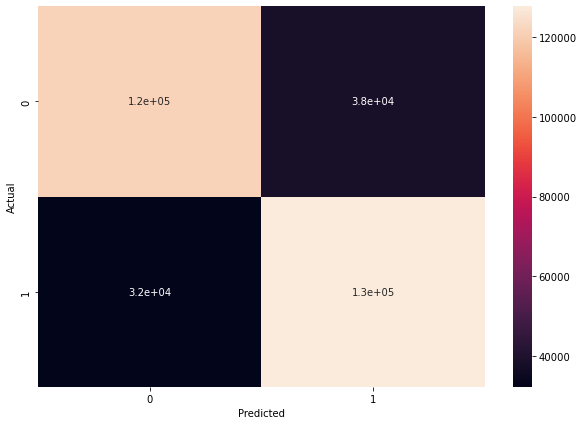

In [101]:
import seaborn as sn
import matplotlib.pyplot as plt
plt.figure(figsize = (10,7))
sn.heatmap(cm, annot = True)
plt.xlabel('Predicted')
plt.ylabel('Actual')

<h3> Saving the model</h3>

In [90]:
import pickle
filename = 'trained_model.sav'
pickle.dump(model, open(filename, 'wb'))

<h3> Using the saved model for future predictions</h3>

In [91]:
# load the saved model

loaded_model = pickle.load(open('trained_model.sav', 'rb'))

In [94]:
X_new = X_test[200]
print(y_test[200])

prediction = model.predict(X_new)
print(prediction)

if (prediction[0]== 0):
    print('Negative Tweet')
else:
    print('Positive Tweet')

0
[0]
Negative Tweet


In [97]:
X_new = X_test[100]
print(f'Actual value : {y_test[100]}')

prediction = loaded_model.predict(X_new)
print(f'Predicted value : {prediction}')

if (prediction[0]== 0):
    print('Negative Tweet')
else:
    print('Positive Tweet')

Actual value : 0
Predicted value : [0]
Negative Tweet
